# Objective Functions: A Simple Example with Matrix Factorisation.

### 6th October 2015 Neil D. Lawrence

### Modified by Mauricio A Álvarez, 1st October 2018

In last week's class we saw how we could load in a data set to pandas and use it for some simple data processing. We computed various probabilities on the data and I encouraged you to think about what sort of probabilities you need for prediction. This week we are going to take a slightly different tack. 

Broadly speaking there are two dominating approaches to machine learning problems. We started to consider the first approach last week: constructing models based on defining the relationship between variables using probabilities. This week we will consider the second approach: which involves defining an *objective function* and optimizing it. 

What do we mean by an objective function? An objective function could be an *error function*, a *cost function* or a *benefit* function. In evolutionary computing they are called *fitness* functions. But the idea is always the same. We write down a mathematical equation which is then optimized to do the learning. The equation should be a function of the *data* and our model *parameters*. We have a choice when optimizing, either minimize or maximize. To avoid confusion, in the optimization field, we always choose to minimize the function. If we have a function that we would like to maximize, we simply choose to minimize the negative of that function. 

So for this lab session, we are going to ignore probabilities, but don't worry, they will return! 

This week we are going to try and build a simple movie recommender system using an objective function. To do this, the first thing I'd like you to do is to install some software we've written for sharing information across google documents.

## Open Data Science Software

In Sheffield we have written a suite of software tools for 'Open Data Science'. Open data science is an approach to sharing code, models and data that should make it easier for companies, health professionals and scientists to gain access to data science techniques. For some background on open data science you can read [this blog post](http://inverseprobability.com/2014/07/01/open-data-science/). The first thing we will do this week is to download that suite of software. 

The software can be installed using

```python
pip install pods
```

from the command prompt where you can access your python installation.


## Download the MovieLens 100k Data

We are going to download the [MovieLens 100k](http://files.grouplens.org/datasets/movielens/ml-latest-small-README.html) Data. This is a public dataset that contains 100,000 ratings and 3,600 tag applications applied to 9,000 movies by 600 users. When you use a data set that someone has prepared you should always reference the data source to acknowledge the work that's been placed in. This particular dataset was collected by the [Grouplens Research group](https://grouplens.org/),  at the University of Minnesota. For example, if you were to use this dataset for writing a paper, the authors ask you that you acknowledge their work by citing the following paper:

F. Maxwell Harper and Joseph A. Konstan. 2015. The MovieLens Datasets: History and Context. ACM Transactions on Interactive Intelligent Systems (TiiS) 5 (4):1-19 [https://doi.org/10.1145/2827872](https://doi.org/10.1145/2827872)

In [1]:
import pods
import zipfile
import sys
import pandas as pd
import numpy as np

pods.util.download_url("http://files.grouplens.org/datasets/movielens/ml-latest-small.zip")
zip_console = zipfile.ZipFile('ml-latest-small.zip', 'r')
for name in zip_console.namelist():
           zip_console.extract(name, './')

[==============================]   0.933/0.933MB                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

### Assignment Question 1

Data ethics. If you find data available on the internet, can you simply use it without consequence? If you are given data by a fellow researcher can you publish that data on line? 

*5 marks*

#### Question 1 Answer

Write your answer to the question in this box.
1. No, I can't. Using the data from the Internet directly without any claim is illegal. We must respect the copyright of the original author.
2. No, I can't. The data belongs to the fellow researcher, so I can't use it without displaying the original producer's name and other essential information. 

## Recommender Systems

A recommender system aims to make suggestions for items (films, books, other commercial products) given what it knows about users' tastes. The recommendation engine needs to represent the *taste* of all the users and the *characteristics* of each object. 

A common way for organizing objects is to place related objects spatially close together. For example in a library we try and put books that are on related topics near to each other on the shelves. One system for doing this is known as [Dewey Decimal Classification](http://en.wikipedia.org/wiki/Dewey_Decimal_Classification). In the Dewey Decimal Classification system (which dates from 1876) each subject is given a number (in fact it's a decimal number). For example, the field of Natural Sciences and Mathematics is given numbers which start with 500. Subjects based on Computer Science are given numbers which start 004 and works on the 'mathematical principles' of Computer science are given the series 004.0151 (which we might store as 4.0151 on a Computer). Whilst it's a classification system, the books in the library are typically laid out in the same order as the numbers, so we might expect that neighbouring numbers represent books that are related in subject. That seems to be exactly what we want when also representing films. Could we somehow represent each film's subject according to a number? In a similar way we could then imagine representing users with a list of numbers that represent things that each user is interested in.

Actually a one dimensional representation of a subject can be very awkward. To see this, let's have a look at the Dewey Decimal Classification numbers for the 900s, which is listed as 'History and Geography'. We will focus on subjects in the 940s which can be found in this list from [Wikipedia](https://en.wikipedia.org/wiki/List_of_Dewey_Decimal_classes#Class_900_%E2%80%93_History_&_geography). Whilst the ordering for places is somewhat sensible, it is also rather arbitrary. In the 940s we have Europe listed from 940-949, Asia listed from 950-959 and Africa listed from 960-969. Whilst it's true that Asia borders Europe, Africa is also very close, and the history of the Roman Empire spreads into [Carthage](http://en.wikipedia.org/wiki/Carthage) and later on Egypt. This image from Wikipedia shows a map of the Cathaginian Empire which fell after fighting with Rome. 


<a title="By Javierfv1212 [Public domain], from Wikimedia Commons" href="https://commons.wikimedia.org/wiki/File:Carthaginianempire.PNG"><img width="512" alt="Carthaginianempire" src="https://upload.wikimedia.org/wikipedia/commons/thumb/9/9b/Carthaginianempire.PNG/512px-Carthaginianempire.PNG"></a>

We now need to make a decision about whether Roman Histories are European or African, ideally we'd like them to be somewhere between the two, but we can't place them there in the Dewey Decimal system because between Europe and Africa is Asia, which has less to do with the Roman Empire than either Europe or Africa. Of course the fact that we've used a map provides a clue as to what to do next. Libraries are actually laid out on floors, so what if we were to use the spatial lay out to organise the sujbects of the books in two dimensions. Books on Geography could be laid out according to where in the world they are referring to. 

Such complexities are very hard to encapsulate in one number, but inspired by the map examples we can start considering how we might lay out films in two dimensions. Similarly, we can consider laying out a map of people's interests. If the two maps correspond to one another, the map of people could reflect where they might want to live in 'subject space'. We can think of representing people's tastes as where they might best like to sit in the library to access easily the books they are most interested in.


## Inner Products for Representing Similarity

Ideas like the above are good for gaining intuitions about what we might want, but the one of the skills of data science is representing those ideas mathematically. Mathematical abstraction of a problem is one of the key ways in which we've been able to progress as a society. Understanding planetary motions, as well as those of the smallest molecule (to quote Laplace's [Philosophical Essay on Probabilities](http://books.google.co.uk/books?id=1YQPAAAAQAAJ&printsec=frontcover&source=gbs_ge_summary_r&cad=0#v=onepage&q&f=false)) needed to be done mathematically. The right mathematical model in machine learning can be slightly more elusive, because constructing it is a two stage process. 

1. We have to determine the right intuition for the system we want to represent. Notions such as 'subject' and 'interest' are not mathematically well defined, and even when we create a new interpretation of what they might mean, each interpretation may have its own weaknesses. 

2. Once we have our interpretation we can attempt to mathematically formalize it. In our library interpretation, that's what we need to do next. 

### The Library on an Infinite Plane

Let's imagine a library which stores all the items  we are interested in, not just books, but films and shopping items too. Such a library is likely to be very large, so we'll create it on an infinite two dimensional plane. This means we can use all the real numbers to represent the location of each item on the plane. For a two dimensional plane, we need to store the locations in a vector of numbers: we can decide that the $j$th item's location in the library is given by 
$$
\mathbf{v}_j = \begin{bmatrix} v_{j,1} \\ v_{j,2}\end{bmatrix},
$$
where $v_{j,1}$ represents the $j$th item's location in the East-West direction (or the $x$-axis) and $v_{j,2}$ represents the $j$th item's location in the North-South direction (or the $y$-axis). Now we need to specify the location where each user sits so that all the items that interest them are nearby: we can also represent the $i$th user's location with a vector 
$$
\mathbf{u}_i = \begin{bmatrix} u_{i,1} \\ u_{i,2}\end{bmatrix}.
$$
Finally, we need some way of recording a given user's affinity for a given item. This affinity might be the rating that the user gives the film. We can use $y_{i,j}$ to represent user $i$'s affinity for item $j$. 

For our film example we might imagine wanting to order films in a few ways. We could imagine organising films in the North-South direction as to how romantic they are. We could place the more romantic films further North and the less romantic films further South. For the East-West direction we could imagine ordering them according to how historic they are: we can imagine placing science fiction films to the East and historical drama to the West. In this case, fans of historical romances would be based in the North-West location, whilst fans of Science Fiction Action films might be located in the South-East (if we assume that 'Action' is the opposite of 'Romance', which is not necessarily the case). How do we lay out all these films? Have we got the right axes? In machine learning the answer is to 'let the data speak'. Use the data to try and obtain such a lay out. To do this we first need to obtain the data.

## Obtaining the Data

As mentioned before, the MovieLens dataset that we'll use has 100,000 ratings to 9,000 movies by 600 users. For now, we will only work with a subset of the dataset. In particular, we will randomly chose a particular number of users and extract the movies and ratings that the users gave to those movies. Read the code below and understand what it is doing.

**Before you run the code**, notice that `YourStudentID` in the first line is a variable that will specify the seed for the random number generator that will select a particular set of `nUsersInExample` users. Change the number that has been assigned by default to `YourStudentID` to the last three digits of your UCard number. All of you will have a different subset of users.

In [3]:
YourStudentID = 20032  # Include here the last three digits of your UCard number
nUsersInExample = 10 # The maximum number of Users we're going to analyse at one time

ratings = pd.read_csv("./ml-latest-small/ratings.csv")
# print(ratings)
"""
ratings is a DataFrame with four columns: userId, movieId, rating and tags. We
first want to identify how many unique users there are. We can use the unique 
method in pandas
"""
indexes_unique_users = ratings['userId'].unique()
n_users = indexes_unique_users.shape[0]
# print(n_users)
""" 
We randomly select 'nUsers' users with their ratings. We first fix the seed
of the random generator to make sure that we always get the same 'nUsers'
"""
np.random.seed(YourStudentID)
indexes_users = np.random.permutation(n_users)
my_batch_users = indexes_users[0:nUsersInExample]
# print(my_batch_users)
"""
We will use now the list of 'my_batch_users' to create a matrix Y. 
"""
# We need to make a list of the movies that these users have watched
list_movies_each_user = [[] for _ in range(nUsersInExample)]
list_ratings_each_user = [[] for _ in range(nUsersInExample)]
# print(list_ratings_each_user)
# Movies
list_movies = ratings['movieId'][ratings['userId'] == my_batch_users[0]].values
list_movies_each_user[0] = list_movies                    
# Ratings                      
list_ratings = ratings['rating'][ratings['userId'] == my_batch_users[0]].values
list_ratings_each_user[0] = list_ratings
# Users
n_each_user = list_movies.shape[0]
list_users = my_batch_users[0]*np.ones((1, n_each_user))
# print(list_ratings)

for i in range(1, nUsersInExample):
    # Movies
    local_list_per_user_movies = ratings['movieId'][ratings['userId'] == my_batch_users[i]].values
    list_movies_each_user[i] = local_list_per_user_movies
    list_movies = np.append(list_movies,local_list_per_user_movies)
    # Ratings                                 
    local_list_per_user_ratings = ratings['rating'][ratings['userId'] == my_batch_users[i]].values
    list_ratings_each_user[i] = local_list_per_user_ratings
    list_ratings = np.append(list_ratings, local_list_per_user_ratings)  
    # Users                                   
    n_each_user = local_list_per_user_movies.shape[0]                                                                               
    local_rep_user =  my_batch_users[i]*np.ones((1, n_each_user))    
    list_users = np.append(list_users, local_rep_user)
#     print(list_ratings)
# Let us first see how many unique movies have been rated
indexes_unique_movies = np.unique(list_movies)
n_movies = indexes_unique_movies.shape[0]
print('there are' ,n_movies ,'movies have been rated')
# As it is expected no all users have rated all movies. We will build a matrix Y 
# with NaN inputs and fill according to the data for each user 
temp = np.empty((n_movies,nUsersInExample,))
temp[:] = np.nan
Y_with_NaNs = pd.DataFrame(temp)
for i in range(nUsersInExample):
 local_movies = list_movies_each_user[i]
 ixs = np.in1d(indexes_unique_movies, local_movies)
 Y_with_NaNs.loc[ixs, i] = list_ratings_each_user[i]
#  print(Y_with_NaNs.loc[ixs,i])
Y_with_NaNs.index = indexes_unique_movies.tolist()
Y_with_NaNs.columns = my_batch_users.tolist()
# print(Y_with_NaNs.columns)
print(Y_with_NaNs)


there are 745 movies have been rated
        286  41   235  396  295  594  87   116  527  39 
1       NaN  NaN  NaN  5.0  NaN  NaN  NaN  NaN  NaN  NaN
2       NaN  NaN  NaN  NaN  NaN  4.0  NaN  NaN  4.0  NaN
3       NaN  NaN  NaN  NaN  NaN  4.0  NaN  3.5  NaN  NaN
6       4.5  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
7       3.5  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
10      NaN  NaN  2.0  NaN  NaN  NaN  NaN  NaN  NaN  NaN
11      NaN  NaN  4.0  NaN  NaN  5.0  NaN  NaN  NaN  NaN
17      NaN  NaN  NaN  NaN  NaN  4.0  NaN  NaN  NaN  NaN
18      NaN  NaN  NaN  NaN  3.5  NaN  NaN  NaN  NaN  NaN
21      NaN  NaN  4.0  NaN  NaN  NaN  NaN  NaN  NaN  NaN
25      NaN  NaN  5.0  NaN  NaN  NaN  NaN  NaN  NaN  NaN
28      NaN  NaN  NaN  NaN  NaN  4.5  NaN  NaN  NaN  NaN
29      NaN  NaN  NaN  NaN  5.0  NaN  NaN  NaN  NaN  NaN
30      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  NaN
32      NaN  NaN  4.0  NaN  NaN  NaN  NaN  NaN  NaN  3.0
34      NaN  NaN  4.0  NaN  NaN  NaN  NaN  NaN  5.0

### Assignment Question 2

Have a look at the matrix `Y_with_NaNs`. The movies data is now in a data frame which contains one column for each user rating the movie. There are some entries that contain 'NaN'. What does the 'NaN' mean in this context?

*5 marks*

#### Answer Question 2

'NaN' in those columns means empty. Those films haven't been rated by those users yet. For example, the 'NaN' in (1,286) means the user whose user number is 286 haven't rated the movie which has the number of 1.

Now we will convert our data structure into a form that is appropriate for processing. We will convert the `Y_with_NaNs` dataframe into a new dataframe which contains the user, the movie, and the rating using the following code

In [4]:
p_list_ratings = np.concatenate(list_ratings_each_user).ravel()
p_list_ratings_original = p_list_ratings.tolist()
mean_ratings_train = np.mean(p_list_ratings)
p_list_ratings =  p_list_ratings - mean_ratings_train # remove the mean
p_list_movies = np.concatenate(list_movies_each_user).ravel().tolist()
p_list_users = list_users.tolist()
Y = pd.DataFrame({'users': p_list_users, 'movies': p_list_movies, 'ratingsorig': p_list_ratings_original,'ratings':p_list_ratings.tolist()})
print(Y)

      users  movies  ratingsorig   ratings
0     286.0       6          4.5  0.772086
1     286.0       7          3.5 -0.227914
2     286.0      39          3.5 -0.227914
3     286.0      47          5.0  1.272086
4     286.0      70          3.0 -0.727914
5     286.0     110          5.0  1.272086
6     286.0     150          4.0  0.272086
7     286.0     158          3.0 -0.727914
8     286.0     165          4.0  0.272086
9     286.0     185          4.0  0.272086
10    286.0     296          5.0  1.272086
11    286.0     337          3.0 -0.727914
12    286.0     356          4.5  0.772086
13    286.0     364          5.0  1.272086
14    286.0     368          3.0 -0.727914
15    286.0     377          4.0  0.272086
16    286.0     454          4.0  0.272086
17    286.0     455          4.0  0.272086
18    286.0     500          3.5 -0.227914
19    286.0     508          4.5  0.772086
20    286.0     509          3.5 -0.227914
21    286.0     527          4.0  0.272086
22    286.0

### Assignment Question 3

The dataframes `Y_with_NaNs` and `Y` contain the same information but organised in a different way. Explain what is the difference. We have also included two columns for ratings in dataframe `Y`, `ratingsorig` and `ratings`. Explain
the difference. 

*10 marks*

#### Question 3 Answer

Write your answer to the question in this box.
1. Y_with_NaNs is structured on basis of the sequence of movie number, shows all movies in the form despite whether every user has rated or not. However, Y is structured based on movies which have been rated by selected users and dosen't show 'NaN', which is more clear. Besides, Y is construted based on the order of the user number of selected users.
2. 'Ratingorig' is a column containing the original ratings of each movies which are given by selected users, while 'ratings' is made up of figures which means 'original rating of one movie -(minus) the average rating of this movie'. 

## Measuring Similarity

We now need a measure for determining the similarity between the item and the user: how close the user is sitting to the item in the rooom if you like. We are going to use the inner product between the vector representing the item and the vector representing the user. 

An inner product (or [dot product](http://en.wikipedia.org/wiki/Dot_product)) between two vectors $\mathbf{a}$ and $\mathbf{b}$ is written as $\mathbf{a}\cdot\mathbf{b}$. Or in vector notation we sometimes write it as $\mathbf{a}^\top\mathbf{b}$. An inner product is simply the sume of the products of each element of the vector,
$$
\mathbf{a}^\top\mathbf{b} = \sum_{i} a_i b_i
$$
The inner product can be seen as a measure of similarity. The inner product gives us the cosine of the angle between the two vectors multiplied by their length. The smaller the angle between two vectors the larger the inner product. 
$$
\mathbf{a}^\top\mathbf{b} = |\mathbf{a}||\mathbf{b}| \cos(\theta)
$$
where $\theta$ is the angle between two vectors and $|\mathbf{a}|$ and $|\mathbf{b}|$ are the respective lengths of the two vectors.

Since we want each user to be sitting near each item, then we want the inner product to be large for any two items which are rated highly by that user. We can do this by trying to force the inner product $\mathbf{u}_i^\top\mathbf{v}_j$ to be similar to the rating given by the user, $y_{i,j}$. To ensure this we will use a least squares objective function for all user ratings.

## Objective Function

The error function (or objective function, or cost function) we will choose is known as 'sum of squares', we will aim to minimize the sum of squared squared error between the inner product of $\mathbf{u}_i$ and $\mathbf{v}_i$ and the observed score for the user/item pairing, given by $y_{i, j}$. 

The total objective function can be written as
$$
E(\mathbf{U}, \mathbf{V}) = \sum_{i,j} s_{i,j} (y_{i,j} - \mathbf{u}_i^\top \mathbf{v}_j)^2
$$
where $s_{i,j}$ is an *indicator* variable that is 1 if user $i$ has rated item $j$ and is zero otherwise. Here $\mathbf{U}$ is the matrix made up of all the vectors $\mathbf{u}$,
$$
\mathbf{U} = \begin{bmatrix} \mathbf{u}_1 \dots \mathbf{u}_n\end{bmatrix}^\top
$$
where we note that $i$th *row* of $\mathbf{U}$ contains the vector associated with the $i$th user and $n$ is the total number of users. This form of matrix is known as a *design matrix*. Similarly, we define the matrix
$$
\mathbf{V} = \begin{bmatrix} \mathbf{v}_1 \dots \mathbf{v}_m\end{bmatrix}^\top
$$
where again the $j$th row of $\mathbf{V}$ contains the vector associated with the $j$th item and $m$ is the total number of items in the data set.

## Objective Optimization

The idea is to mimimize this objective. A standard, simple, technique for minimizing an objective is *gradient descent* or *steepest descent*. In gradient descent we simply choose to update each parameter in the model by subtracting a multiple of the objective function's gradient with respect to the parameters. So for a parameter $u_{i,j}$ from the matrix $\mathbf{U}$ we would have an update as follows:
$$
u_{k,\ell} \leftarrow u_{k,\ell} - \eta \frac{\text{d} E(\mathbf{U}, \mathbf{V})}{\text{d}u_{k,\ell}} 
$$
where $\eta$ (which is pronounced *eta* in English) is a Greek letter representing the *learning rate*.  

We can compute the gradient of the objective function with respect to $u_{k,\ell}$ as
$$
\frac{\text{d}E(\mathbf{U}, \mathbf{V})}{\text{d}u_{k,\ell}} = -2 \sum_j s_{k,j}v_{j,\ell}(y_{k, j} - \mathbf{u}_k^\top\mathbf{v}_{j}). 
$$
Similarly each parameter $v_{i,j}$ needs to be updated according to its gradient. 


### Assignment Question 4

What is the gradient of the objective function with respect to $v_{k, \ell}$? Write your answer in the box below, and explain which differentiation techniques you used to get there. You will be expected to justify your answer in class by oral questioning. 

*15 marks*

#### Question 4 Answer

because z' (u0) = f ' (u0,v) = dv/du0 (assume v is a constant) 

so z' (v0) = f ' (u,v0) = dv0/du (assume u is a constant)

so $$
\frac{\text{d}E(\mathbf{U}, \mathbf{V})}{\text{d}v_{k,\ell}} = -2 \sum_j s_{k,j}u_{j,\ell}(y_{k, j} - \mathbf{v}_k^\top\mathbf{u}_{j}). 
$$

In [38]:
# Question 4 Code Answer

## Steepest Descent Algorithm

In the steepest descent algorithm we aim to minimize the objective function by subtacting the gradient of the objective function from the parameters. 

### Initialisation

To start with though, we need initial values for the matrix $\mathbf{U}$ and the matrix $\mathbf{V}$. Let's create them as `pandas` data frames and initialise them randomly with small values.

In [5]:
q = 2 # the dimension of our map of the 'library'
learn_rate = 0.01
U = pd.DataFrame(np.random.normal(size=(nUsersInExample, q))*0.001, index=my_batch_users)
V = pd.DataFrame(np.random.normal(size=(n_movies, q))*0.001, index=indexes_unique_movies)
print(U)
print(V)

            0         1
286 -0.000285  0.000058
41   0.000119 -0.000297
235 -0.000177 -0.001226
396  0.000223 -0.000940
295  0.000143 -0.000261
594  0.000124  0.001731
87  -0.000823  0.000171
116 -0.000823 -0.001024
527  0.001658 -0.000965
39   0.000007 -0.000530
               0         1
1      -0.000506  0.000240
2      -0.000747  0.001708
3      -0.000577 -0.000459
6       0.000370  0.000716
7       0.000620  0.001922
10     -0.001362  0.000316
11      0.000114 -0.000583
17      0.000665  0.000809
18     -0.001160 -0.001439
21     -0.000384  0.000131
25     -0.000824 -0.000344
28     -0.001155  0.002182
29     -0.001089 -0.001477
30     -0.000268  0.000492
32      0.000207  0.001385
34     -0.000149  0.000685
36      0.001782  0.002523
39     -0.001207  0.000998
44     -0.000997 -0.001435
45     -0.001437 -0.000165
46      0.000267  0.000146
47     -0.000253  0.003036
48     -0.000432 -0.000256
50     -0.000621  0.001486
60      0.000640  0.000854
62      0.001484 -0.000258
70     

Now that we have the initial values set, we can start the optimization. First we define a function for the gradient of the objective and the objective function itself.

In [50]:
def objective_gradient(Y, U, V):
    gU = pd.DataFrame(np.zeros((U.shape)), index=U.index)
    gV = pd.DataFrame(np.zeros((V.shape)), index=V.index)
    obj = 0.
    nrows = Y.shape[0]
    for i in range(nrows):
        row = Y.iloc[i]
        user = row['users']
        film = row['movies']
        rating = row['ratings']
        prediction = np.dot(U.loc[user], V.loc[film]) # vTu
        diff = prediction - rating # vTu - y
        obj += diff*diff
        gU.loc[user] += 2*diff*V.loc[film]
        gV.loc[film] += 2*diff*U.loc[user]
    return obj, gU, gV

Now we can write our simple optimisation route. This allows us to observe the objective function as the optimization proceeds.

In [9]:
iterations = 20
for i in range(iterations):
    obj, gU, gV = objective_gradient(Y, U, V)
    print("Iteration: ", i, "Objective function: ", obj)
    U -= learn_rate*gU
    V -= learn_rate*gV 
learn_rate = 0.02
for i in range(iterations):
    obj, gU, gV = objective_gradient(Y, U, V)
    print("Iteration: ", i, "Objective function: ", obj)
    U -= learn_rate*gU
    V -= learn_rate*gV 

Iteration:  0 Objective function:  1474.9809682709013
Iteration:  1 Objective function:  1474.9807135223637
Iteration:  2 Objective function:  1474.9803881534026
Iteration:  3 Objective function:  1474.9798635872562
Iteration:  4 Objective function:  1474.978928647401
Iteration:  5 Objective function:  1474.9771916031737
Iteration:  6 Objective function:  1474.9738980946108
Iteration:  7 Objective function:  1474.9675763044395
Iteration:  8 Objective function:  1474.9553369452829
Iteration:  9 Objective function:  1474.9314866429595
Iteration:  10 Objective function:  1474.8847759821213
Iteration:  11 Objective function:  1474.7929317818994
Iteration:  12 Objective function:  1474.611788299681
Iteration:  13 Objective function:  1474.2536901267345
Iteration:  14 Objective function:  1473.5446571457846
Iteration:  15 Objective function:  1472.1398294363914
Iteration:  16 Objective function:  1469.3583118276667
Iteration:  17 Objective function:  1463.8678273139997
Iteration:  18 Objecti

### Assignment Question 5

What happens as you increase the number of iterations? What happens if you increase the learning rate?

*10 marks*

#### Question 5 Answer

Write your answer to the question in this box.
1. After increasing the number of iterations, there will be more times of optimization and the figures for objective function will decrease.
2. After rising the learning rate, there will be the same times of optimization and the figures for objective function will derease.
3. However, these two ways are both likely to miss the minimum value.

In [42]:
# Question 5 Code Answer
iterations = 20
for i in range(iterations):
    obj, gU, gV = objective_gradient(Y, U, V)
    print("Iteration: ", i, "Objective function: ", obj)
    U -= learn_rate*gU
    V -= learn_rate*gV 
iterations = 40
for i in range(iterations):
    obj, gU, gV = objective_gradient(Y, U, V)
    print("Iteration: ", i, "Objective function: ", obj)
    U -= learn_rate*gU
    V -= learn_rate*gV 

Iteration:  0 Objective function:  161.4949214291728
Iteration:  1 Objective function:  150.99332469657477
Iteration:  2 Objective function:  142.60812839531846
Iteration:  3 Objective function:  135.77306727629852
Iteration:  4 Objective function:  129.88660292777166
Iteration:  5 Objective function:  124.65760804989391
Iteration:  6 Objective function:  120.03823894342453
Iteration:  7 Objective function:  116.050534476757
Iteration:  8 Objective function:  112.6745904795859
Iteration:  9 Objective function:  109.82124913930089
Iteration:  10 Objective function:  107.36223783626664
Iteration:  11 Objective function:  105.17587270723683
Iteration:  12 Objective function:  103.17702312468343
Iteration:  13 Objective function:  101.32402446006566
Iteration:  14 Objective function:  99.6101202503973
Iteration:  15 Objective function:  98.0487061954528
Iteration:  16 Objective function:  96.65832554458173
Iteration:  17 Objective function:  95.450948956288
Iteration:  18 Objective functio

## Making Predictions

Predictions can be made from the model of the appropriate rating for a given user, $i$, for a given film, $j$, by simply taking the inner product between their vectors $\mathbf{u}_i$ and $\mathbf{v}_j$. 

### Assignment Question 6

Create a function that provides the prediction of the ratings for the users in the dataset. Is the quality of the predictions affected by the number of iterations or the learning rate? The function should receive `Y`, `U` and `V` and return the predictions and the absolute error between the predictions and the actual rating given by the users. The predictions and the absolute error should be added as additional columns to the dataframe `Y`.

*15 marks*

In [52]:
pred = Y['prediction'] = 0
error = Y['error'] = 0
nrows = Y.shape[0]
for i in range(nrows):
        row = Y.iloc[i]
        user = row['users']
        film = row['movies']
        rating = row['ratings']
        pred = np.dot(U.loc[user], V.loc[film])
        error = abs(rating - pred)
        Y.loc[i,'prediction'] = pred
        Y.loc[i,'error'] = error
print(Y)
        

      users  movies  ratingsorig   ratings    prediction     error
0     286.0       6          4.5  0.772086 -6.402491e-08  0.772087
1     286.0       7          3.5 -0.227914 -6.565634e-08  0.227913
2     286.0      39          3.5 -0.227914  4.021691e-07  0.227914
3     286.0      47          5.0  1.272086  2.479445e-07  1.272086
4     286.0      70          3.0 -0.727914  3.324318e-07  0.727914
5     286.0     110          5.0  1.272086  3.865359e-07  1.272086
6     286.0     150          4.0  0.272086 -1.850594e-07  0.272087
7     286.0     158          3.0 -0.727914  5.795926e-08  0.727914
8     286.0     165          4.0  0.272086 -1.706432e-07  0.272087
9     286.0     185          4.0  0.272086  1.193098e-07  0.272086
10    286.0     296          5.0  1.272086  4.083892e-07  1.272086
11    286.0     337          3.0 -0.727914 -3.592702e-08  0.727913
12    286.0     356          4.5  0.772086 -1.959751e-08  0.772086
13    286.0     364          5.0  1.272086 -7.015388e-08  1.27

## Stochastic Gradient Descent or Robbins Monroe Algorithm

Stochastic gradient descent involves updating separating each gradient update according to each separate observation, rather than summing over them all. It is an approximate optimization method, but it has proven convergence under certain conditions and can be much faster in practice. It is used widely by internet companies for doing machine learning in practice. For example, Facebook's ad ranking algorithm uses stochastic gradient descent. 

### Assignment Question 7

Create a stochastic gradient descent version of the algorithm. Monitor the objective function after every 1000 updates to ensure that it is decreasing. When you have finished, plot the movie map and the user map in two dimensions (you can use the columns of the matrices $\mathbf{U}$ for the user map and the columns of $\mathbf{V}$ for the movie map). Provide three observations about these maps.

*25 marks*

Text(0.5,1,'Movie Map')

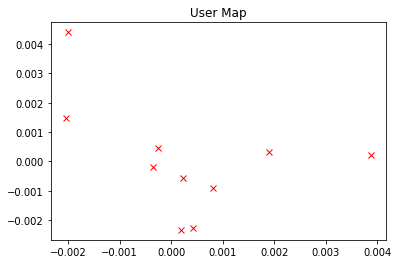

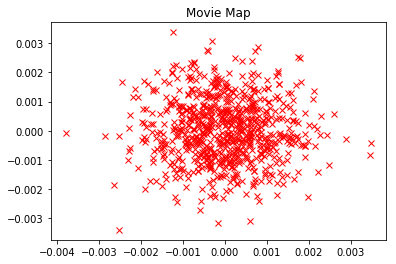

In [6]:
# Question 7 Code Answer
def stochastic_gradient(Y, U, V):
    gU = pd.DataFrame(np.zeros((U.shape)), index=U.index)
    gV = pd.DataFrame(np.zeros((V.shape)), index=V.index)
    obj = 0.
    nrows = Y.shape[0]
    import random as rd
    i = rd.randint(0,nrows-1)
    row = Y.iloc[i]
    user = row['users']
    film = row['movies']
    rating = row['ratings']
    prediction = np.dot(U.loc[user], V.loc[film]) # vTu
    diff = prediction - rating # vTu - y
    obj += diff*diff
    gU.loc[user] += 2*diff*V.loc[film]
    gV.loc[film] += 2*diff*U.loc[user]
    return obj, gU, gV
iterations = 4000
for i in range(iterations):
    obj, gU, gV = stochastic_gradient(Y, U, V)
    U -= learn_rate*gU
    V -= learn_rate*gV
import pylab as plt
plt.plot(U[0],U[1],'rx')
plt.title('User Map')
plt.figure()
plt.plot(V[0],V[1],'rx')
plt.title('Movie Map')

## Is Our Map Enough? Are Our Data Enough?

Is two dimensions really enough to capture the complexity of humans and their artforms? Perhaps we need even more dimensions to capture that complexity. Extending our books analogy further, consider how we should place books that have a historical timeframe as well as some geographical location. Do we really want books from the 2nd World War to sit alongside books from the Roman Empire? Books on the American invasion of Sicily in 1943 are perhaps less related to books about Carthage than those that study the Jewish Revolt from 66-70 (in the Roman Province of Judaea). So books that relate to subjects which are closer in time should be stored together. However, a student of rebellion against empire may also be interested in the relationship between the Jewish Revolt of 66-70 and the Indian Rebellion of 1857, nearly 1800 years later. Whilst the technologies are different, the psychology of the people is shared: a rebellious nation angainst their imperial masters, triggered by misrule with a religious and cultural background. To capture such complexities we would need further dimensions in our latent representation. But are further dimensions justified by the amount of data we have? Can we really understand the facets of a film that only has at most three or four ratings?

## Going Further

If you want to take this model further then you'll need more data. You can use again the MovieLens 100k data but increasing the number of users (for example, for the Steepest Descent Algorithm you can do this by modifying the variable `nUsersInExample` that was set as 10 before).

### Assignment Question 8

Use stochastic gradient descent to make a movie map for the MovieLens 100k data. Plot the map of the movies when you are finished.

*15 marks*

no. 0 objective function =  0.24911135834644724
no. 1 objective function =  1.0017786238593025
no. 2 objective function =  7.89054501294969e-07
no. 3 objective function =  0.2491107407592755
no. 4 objective function =  2.2473201093524966
no. 5 objective function =  0.2508858354913645
no. 6 objective function =  0.2491125980067783
no. 7 objective function =  1.0017790925850683
no. 8 objective function =  7.875201449136556e-07
no. 9 objective function =  2.247335262179115
no. 10 objective function =  7.902657216095948e-07
no. 11 objective function =  2.2473397972575704
no. 12 objective function =  1.001779276398803
no. 13 objective function =  0.2508890916772225
no. 14 objective function =  0.25088950524596704
no. 15 objective function =  6.2455557431115
no. 16 objective function =  1.001774840125252
no. 17 objective function =  3.9964403922501694
no. 18 objective function =  7.939350920509606e-07
no. 19 objective function =  3.9964521991498687
no. 20 objective function =  3.996436584979

no. 201 objective function =  2.2526650621222157
no. 202 objective function =  1.0017794577480341
no. 203 objective function =  7.90769713623414e-07
no. 204 objective function =  0.2508890063128768
no. 205 objective function =  0.2508901059344414
no. 206 objective function =  1.0017769962120662
no. 207 objective function =  0.24911416990128962
no. 208 objective function =  0.2508896004869014
no. 209 objective function =  2.2473319358586457
no. 210 objective function =  0.24911227150508886
no. 211 objective function =  7.898640958421273e-07
no. 212 objective function =  1.0017826064766262
no. 213 objective function =  2.25266789988661
no. 214 objective function =  1.0017824881850974
no. 215 objective function =  0.25088839362749643
no. 216 objective function =  2.2473337302308156
no. 217 objective function =  2.252666787579633
no. 218 objective function =  0.25089003043833114
no. 219 objective function =  0.24911459568135508
no. 220 objective function =  7.899589346929335e-07
no. 221 ob

no. 380 objective function =  0.998220356062477
no. 381 objective function =  0.2508892032910588
no. 382 objective function =  0.24911400136601242
no. 383 objective function =  1.001781565262792
no. 384 objective function =  0.24911256394091272
no. 385 objective function =  0.24911136880224816
no. 386 objective function =  7.85197386283791e-07
no. 387 objective function =  0.24911097123899306
no. 388 objective function =  2.252663920977351
no. 389 objective function =  0.24910851100130885
no. 390 objective function =  0.24911217444349965
no. 391 objective function =  0.24911146092639025
no. 392 objective function =  0.2508923985748221
no. 393 objective function =  0.2508938177909293
no. 394 objective function =  7.899074690637826e-07
no. 395 objective function =  0.24911104026156342
no. 396 objective function =  0.2508904457712653
no. 397 objective function =  0.2491093025950572
no. 398 objective function =  0.25088731832750566
no. 399 objective function =  7.894333578932608e-07
no. 40

no. 570 objective function =  0.2508878033219681
no. 571 objective function =  2.252670005943859
no. 572 objective function =  7.856285953942297e-07
no. 573 objective function =  0.9982195910117613
no. 574 objective function =  7.904229605327192e-07
no. 575 objective function =  7.872755108855645e-07
no. 576 objective function =  0.9982173906899638
no. 577 objective function =  0.2508902089217885
no. 578 objective function =  7.906193421041025e-07
no. 579 objective function =  0.2508879523043998
no. 580 objective function =  0.249111070455168
no. 581 objective function =  2.2526688381185185
no. 582 objective function =  7.907605817002927e-07
no. 583 objective function =  0.9982276815235724
no. 584 objective function =  7.932465288974851e-07
no. 585 objective function =  8.994666176679393
no. 586 objective function =  0.25089185262582486
no. 587 objective function =  0.2508904029100481
no. 588 objective function =  0.24911253908875286
no. 589 objective function =  0.2491129700308728
no.

no. 742 objective function =  7.916087974313997e-07
no. 743 objective function =  0.24911205157041924
no. 744 objective function =  1.0017822794639104
no. 745 objective function =  2.247331271003676
no. 746 objective function =  0.24911062838613976
no. 747 objective function =  2.2526706190357566
no. 748 objective function =  7.912025798176202e-07
no. 749 objective function =  0.25088988605204354
no. 750 objective function =  0.250890377581233
no. 751 objective function =  7.925736600818842e-07
no. 752 objective function =  0.25088818465902474
no. 753 objective function =  0.25089087291187173
no. 754 objective function =  0.2508902774268824
no. 755 objective function =  0.2508887136483388
no. 756 objective function =  2.247326321729166
no. 757 objective function =  3.9964352637407514
no. 758 objective function =  7.907034808766914e-07
no. 759 objective function =  6.245557524351699
no. 760 objective function =  0.25088958719429955
no. 761 objective function =  3.996443313523145
no. 762

no. 922 objective function =  0.2508903475985546
no. 923 objective function =  0.25088921357498534
no. 924 objective function =  0.2508893024799056
no. 925 objective function =  2.252665553772628
no. 926 objective function =  2.252666312569491
no. 927 objective function =  1.0017765343468386
no. 928 objective function =  0.24911168532337818
no. 929 objective function =  0.24910839533343976
no. 930 objective function =  0.2508929163314462
no. 931 objective function =  1.0017792907406646
no. 932 objective function =  0.2508883356884724
no. 933 objective function =  0.9982273783849573
no. 934 objective function =  7.906571611957418e-07
no. 935 objective function =  0.25089062701716003
no. 936 objective function =  0.24911327166514544
no. 937 objective function =  2.2473290027405235
no. 938 objective function =  0.25088972524873837
no. 939 objective function =  2.25266711150091
no. 940 objective function =  0.25089009645783605
no. 941 objective function =  2.252668251656338
no. 942 objecti

no. 1121 objective function =  0.250890039761406
no. 1122 objective function =  2.247333629026847
no. 1123 objective function =  0.24911278450830873
no. 1124 objective function =  2.2526705010317345
no. 1125 objective function =  7.904125995353283e-07
no. 1126 objective function =  0.2508887115571805
no. 1127 objective function =  0.24911298961968484
no. 1128 objective function =  2.2526667728591407
no. 1129 objective function =  0.25089210146767615
no. 1130 objective function =  0.2508927602924526
no. 1131 objective function =  7.9388248292164e-07
no. 1132 objective function =  0.24911134393510728
no. 1133 objective function =  0.24911130894746306
no. 1134 objective function =  0.250891196425883
no. 1135 objective function =  7.901045449043701e-07
no. 1136 objective function =  6.245564739867976
no. 1137 objective function =  7.887161643219424e-07
no. 1138 objective function =  3.996444666811842
no. 1139 objective function =  3.996440113708773
no. 1140 objective function =  1.00177914

no. 1289 objective function =  1.001776765064515
no. 1290 objective function =  0.24910875069144298
no. 1291 objective function =  2.252671657934478
no. 1292 objective function =  0.25088899874886095
no. 1293 objective function =  0.24911235456100403
no. 1294 objective function =  2.2526649163597243
no. 1295 objective function =  1.001780343104757
no. 1296 objective function =  7.899800114246155e-07
no. 1297 objective function =  0.2508887748822151
no. 1298 objective function =  0.24911102413450334
no. 1299 objective function =  7.955314740744686e-07
no. 1300 objective function =  0.2491127144390923
no. 1301 objective function =  8.994672780770605
no. 1302 objective function =  7.914446574907393e-07
no. 1303 objective function =  2.2526695866904665
no. 1304 objective function =  0.24911169064655395
no. 1305 objective function =  0.24911230860123715
no. 1306 objective function =  0.25088999826664304
no. 1307 objective function =  2.2526700739429226
no. 1308 objective function =  0.24911

no. 1455 objective function =  1.0017784800283542
no. 1456 objective function =  7.895100544635091e-07
no. 1457 objective function =  7.897463521531106e-07
no. 1458 objective function =  7.893419366092422e-07
no. 1459 objective function =  0.2508912440057769
no. 1460 objective function =  2.2473337030834295
no. 1461 objective function =  0.25089020973025294
no. 1462 objective function =  6.2455583407805415
no. 1463 objective function =  0.2491117183421561
no. 1464 objective function =  7.903446759206017e-07
no. 1465 objective function =  2.2526681144855987
no. 1466 objective function =  2.247334751116351
no. 1467 objective function =  0.24911266341775382
no. 1468 objective function =  0.25089097936151344
no. 1469 objective function =  2.252678439841204
no. 1470 objective function =  7.877887136697597e-07
no. 1471 objective function =  0.24911134079711167
no. 1472 objective function =  0.25088952718742275
no. 1473 objective function =  0.2508895060122086
no. 1474 objective function =  0

no. 1645 objective function =  2.2526609593521165
no. 1646 objective function =  0.2491118855005751
no. 1647 objective function =  0.2508847180278926
no. 1648 objective function =  1.0017783370505324
no. 1649 objective function =  1.0017789221193676
no. 1650 objective function =  0.25089019603938756
no. 1651 objective function =  2.2473296156204134
no. 1652 objective function =  7.863494468355407e-07
no. 1653 objective function =  0.2508904611836595
no. 1654 objective function =  2.247331472287937
no. 1655 objective function =  0.25089186280498793
no. 1656 objective function =  0.24911205895372324
no. 1657 objective function =  0.24911174596906954
no. 1658 objective function =  0.2508910374819003
no. 1659 objective function =  1.0017802244785552
no. 1660 objective function =  1.0017754516715602
no. 1661 objective function =  0.2491124013722138
no. 1662 objective function =  0.25089027156595994
no. 1663 objective function =  0.25089015952264804
no. 1664 objective function =  0.249109201

no. 1816 objective function =  0.24911193705825985
no. 1817 objective function =  0.24911091038907016
no. 1818 objective function =  0.25089134035745275
no. 1819 objective function =  0.24911153772311173
no. 1820 objective function =  0.24911035160004819
no. 1821 objective function =  2.2526670339238515
no. 1822 objective function =  6.245554942923176
no. 1823 objective function =  3.99644768103508
no. 1824 objective function =  0.2491145610008754
no. 1825 objective function =  0.2508918460129682
no. 1826 objective function =  1.0017774320926458
no. 1827 objective function =  2.2526728298628087
no. 1828 objective function =  0.24911219489683642
no. 1829 objective function =  2.252670950495041
no. 1830 objective function =  7.907747715004112e-07
no. 1831 objective function =  0.2508898316918826
no. 1832 objective function =  0.250889255149581
no. 1833 objective function =  0.2508892472715443
no. 1834 objective function =  8.9946759254307
no. 1835 objective function =  0.2508903821322618

no. 2010 objective function =  2.252665860682696
no. 2011 objective function =  7.924333374125815e-07
no. 2012 objective function =  0.25089081467782137
no. 2013 objective function =  1.0017772613693787
no. 2014 objective function =  0.2508901563666777
no. 2015 objective function =  0.24911118633442544
no. 2016 objective function =  0.24911188505471585
no. 2017 objective function =  0.2508878404088192
no. 2018 objective function =  2.252664962657729
no. 2019 objective function =  0.25089235075423627
no. 2020 objective function =  0.24911243323053053
no. 2021 objective function =  0.24911040903852127
no. 2022 objective function =  2.2526665403511865
no. 2023 objective function =  2.2473347335501113
no. 2024 objective function =  6.245539339999419
no. 2025 objective function =  7.900724096604264e-07
no. 2026 objective function =  0.2491120095762927
no. 2027 objective function =  0.25088984483956156
no. 2028 objective function =  0.25089135098108256
no. 2029 objective function =  0.249110

no. 2188 objective function =  7.88953714423293e-07
no. 2189 objective function =  0.2508899704303802
no. 2190 objective function =  0.2508916217033151
no. 2191 objective function =  3.996435134909358
no. 2192 objective function =  7.900894316458328e-07
no. 2193 objective function =  6.245555148155552
no. 2194 objective function =  7.88740868079554e-07
no. 2195 objective function =  0.25088990472238293
no. 2196 objective function =  7.949389905523397e-07
no. 2197 objective function =  0.25089119972152013
no. 2198 objective function =  7.913467808982032e-07
no. 2199 objective function =  7.928251179453214e-07
no. 2200 objective function =  0.24911294153902308
no. 2201 objective function =  7.925778900460806e-07
no. 2202 objective function =  0.250889177721935
no. 2203 objective function =  0.24911164957692888
no. 2204 objective function =  2.252669100135094
no. 2205 objective function =  0.24911217930005616
no. 2206 objective function =  2.2526664620259043
no. 2207 objective function = 

no. 2401 objective function =  0.9982266559425959
no. 2402 objective function =  0.25088940926141223
no. 2403 objective function =  0.24911203884843702
no. 2404 objective function =  7.928269909813065e-07
no. 2405 objective function =  2.252665787697539
no. 2406 objective function =  2.2526757603171363
no. 2407 objective function =  2.2526627628235762
no. 2408 objective function =  2.2473336917908284
no. 2409 objective function =  1.0017838519569722
no. 2410 objective function =  7.873001374624771e-07
no. 2411 objective function =  0.24911160703532428
no. 2412 objective function =  0.2508898102732317
no. 2413 objective function =  0.2491118300964972
no. 2414 objective function =  7.890456609797092e-07
no. 2415 objective function =  0.25089023942982425
no. 2416 objective function =  7.933110517565127e-07
no. 2417 objective function =  7.910528650237754e-07
no. 2418 objective function =  0.9982182063673508
no. 2419 objective function =  0.25088915118255967
no. 2420 objective function =  

no. 2605 objective function =  6.245563991043684
no. 2606 objective function =  0.24911142855625865
no. 2607 objective function =  2.252670988964749
no. 2608 objective function =  0.24911221940599834
no. 2609 objective function =  0.24910958235611463
no. 2610 objective function =  7.906499172335897e-07
no. 2611 objective function =  0.25088750635603185
no. 2612 objective function =  1.0017807368714085
no. 2613 objective function =  2.25266817936386
no. 2614 objective function =  0.25089066250717207
no. 2615 objective function =  2.2526626810781036
no. 2616 objective function =  1.0017810074671079
no. 2617 objective function =  2.247331811802165
no. 2618 objective function =  2.252674054230328
no. 2619 objective function =  6.24555491617155
no. 2620 objective function =  0.24911132697262062
no. 2621 objective function =  1.0017772291791758
no. 2622 objective function =  0.250888069297685
no. 2623 objective function =  0.24911141214940694
no. 2624 objective function =  0.2508895593898301

no. 2800 objective function =  0.2508915074243089
no. 2801 objective function =  7.906578413458807e-07
no. 2802 objective function =  3.9964417711115066
no. 2803 objective function =  0.25088966628521386
no. 2804 objective function =  0.25088981074557626
no. 2805 objective function =  0.2508879554175468
no. 2806 objective function =  0.25088989262361505
no. 2807 objective function =  2.247332049187708
no. 2808 objective function =  1.0017805615127253
no. 2809 objective function =  0.24911282785782274
no. 2810 objective function =  0.2508905868817357
no. 2811 objective function =  0.2508896307794721
no. 2812 objective function =  1.0017744117625933
no. 2813 objective function =  0.24911237283957793
no. 2814 objective function =  2.2526760164797555
no. 2815 objective function =  0.250888255494651
no. 2816 objective function =  7.930197703604197e-07
no. 2817 objective function =  2.2473248163638444
no. 2818 objective function =  0.2491130664644023
no. 2819 objective function =  0.25088805

no. 2977 objective function =  0.2508903924849062
no. 2978 objective function =  2.2473294174477183
no. 2979 objective function =  1.0017819278746483
no. 2980 objective function =  0.24911306520909446
no. 2981 objective function =  0.25088780015917966
no. 2982 objective function =  0.24911352083843194
no. 2983 objective function =  2.2473361908710903
no. 2984 objective function =  0.25088998769006604
no. 2985 objective function =  0.25088968046083765
no. 2986 objective function =  0.9982191109261634
no. 2987 objective function =  0.2508885836617227
no. 2988 objective function =  0.24911188435229809
no. 2989 objective function =  0.24911015659135677
no. 2990 objective function =  1.0017757065465394
no. 2991 objective function =  0.2508891071030955
no. 2992 objective function =  7.937698679302841e-07
no. 2993 objective function =  2.252663044330633
no. 2994 objective function =  0.24911100507122907
no. 2995 objective function =  0.25089216590783386
no. 2996 objective function =  2.252668

no. 3141 objective function =  0.25089095107497034
no. 3142 objective function =  0.2508886552850196
no. 3143 objective function =  2.2526826862976295
no. 3144 objective function =  0.24911187374562413
no. 3145 objective function =  2.2473360755987564
no. 3146 objective function =  0.9982168729303057
no. 3147 objective function =  7.92158545942172e-07
no. 3148 objective function =  1.0017784389324256
no. 3149 objective function =  1.001775461256858
no. 3150 objective function =  1.001780188823185
no. 3151 objective function =  0.2508902092162678
no. 3152 objective function =  8.994661547200744
no. 3153 objective function =  7.880351263753726e-07
no. 3154 objective function =  7.891647631287794e-07
no. 3155 objective function =  2.252668162472792
no. 3156 objective function =  0.24911367682447455
no. 3157 objective function =  1.0017793592478692
no. 3158 objective function =  0.2508898051357773
no. 3159 objective function =  0.2508892476317058
no. 3160 objective function =  2.2526706303

no. 3340 objective function =  1.001778465687352
no. 3341 objective function =  1.0017792830834007
no. 3342 objective function =  0.24911111026606367
no. 3343 objective function =  0.9982221936149704
no. 3344 objective function =  7.916598650801696e-07
no. 3345 objective function =  0.25088979044411924
no. 3346 objective function =  0.25088923000530144
no. 3347 objective function =  8.994665927936051
no. 3348 objective function =  0.9982186846021378
no. 3349 objective function =  0.24910994620615806
no. 3350 objective function =  0.2508905475558247
no. 3351 objective function =  2.2526831524179567
no. 3352 objective function =  2.2526684901889276
no. 3353 objective function =  0.2508903214588305
no. 3354 objective function =  0.25089112163667454
no. 3355 objective function =  3.996442201906882
no. 3356 objective function =  1.0017771226644197
no. 3357 objective function =  1.0017789561385624
no. 3358 objective function =  8.994663497532448
no. 3359 objective function =  2.2526572024761

no. 3516 objective function =  2.2526514925085723
no. 3517 objective function =  2.2526758943806673
no. 3518 objective function =  3.996444763860595
no. 3519 objective function =  0.9982266778453709
no. 3520 objective function =  0.2508923000511633
no. 3521 objective function =  0.24911507642155167
no. 3522 objective function =  2.2473429318843574
no. 3523 objective function =  0.25089047221905647
no. 3524 objective function =  6.245552543844823
no. 3525 objective function =  2.247338488194234
no. 3526 objective function =  0.2508886821742719
no. 3527 objective function =  0.2508901952774993
no. 3528 objective function =  0.24911015837047512
no. 3529 objective function =  1.001783011512178
no. 3530 objective function =  2.2526692214930395
no. 3531 objective function =  2.252663637162072
no. 3532 objective function =  2.252672795013774
no. 3533 objective function =  7.924982884411217e-07
no. 3534 objective function =  0.25088768440682074
no. 3535 objective function =  3.996443862422267


no. 3714 objective function =  7.929148702657962e-07
no. 3715 objective function =  0.2508904709625989
no. 3716 objective function =  0.24911112360047535
no. 3717 objective function =  0.2508898931890401
no. 3718 objective function =  3.9964420039165947
no. 3719 objective function =  7.898693570033874e-07
no. 3720 objective function =  0.9982240904749942
no. 3721 objective function =  0.2508891956373946
no. 3722 objective function =  0.25088987051404943
no. 3723 objective function =  0.25088894333700557
no. 3724 objective function =  0.24911165358750026
no. 3725 objective function =  0.9982244450081825
no. 3726 objective function =  1.0017777047607621
no. 3727 objective function =  0.9982207796872857
no. 3728 objective function =  7.897369839214957e-07
no. 3729 objective function =  1.0017789957274519
no. 3730 objective function =  0.9982222259079112
no. 3731 objective function =  0.2508906634508283
no. 3732 objective function =  0.2508926212553377
no. 3733 objective function =  0.2508

no. 3879 objective function =  0.2508899490835669
no. 3880 objective function =  0.24911218677636224
no. 3881 objective function =  2.252668557534945
no. 3882 objective function =  0.24911370930763443
no. 3883 objective function =  0.24911194680204818
no. 3884 objective function =  0.25088998159073583
no. 3885 objective function =  0.2508878910961012
no. 3886 objective function =  0.2508904176018837
no. 3887 objective function =  0.24911252853330992
no. 3888 objective function =  0.24911705705373535
no. 3889 objective function =  0.2491116454976153
no. 3890 objective function =  0.9982256460893152
no. 3891 objective function =  1.0017786592408802
no. 3892 objective function =  0.24911383236165224
no. 3893 objective function =  0.9982261339272831
no. 3894 objective function =  7.928284953071851e-07
no. 3895 objective function =  1.0017805276320397
no. 3896 objective function =  0.250889866947993
no. 3897 objective function =  0.25088846198834064
no. 3898 objective function =  0.25089001

no. 4058 objective function =  0.2508914199046609
no. 4059 objective function =  2.247337041396746
no. 4060 objective function =  0.25088984609515513
no. 4061 objective function =  1.001778402593277
no. 4062 objective function =  1.0017795098165068
no. 4063 objective function =  0.24911202953231026
no. 4064 objective function =  2.252671560440104
no. 4065 objective function =  0.9982275538982109
no. 4066 objective function =  0.24911223699880244
no. 4067 objective function =  1.0017835083459548
no. 4068 objective function =  0.2508898930639038
no. 4069 objective function =  2.2473320253720415
no. 4070 objective function =  2.2473345091001167
no. 4071 objective function =  1.0017680432741551
no. 4072 objective function =  0.9982174052883462
no. 4073 objective function =  0.24911137829035954
no. 4074 objective function =  7.867959182250564e-07
no. 4075 objective function =  0.2508884762137037
no. 4076 objective function =  0.250887562077591
no. 4077 objective function =  0.99822711827826

no. 4270 objective function =  3.996446014056211
no. 4271 objective function =  0.25088968053592514
no. 4272 objective function =  0.2508900554605644
no. 4273 objective function =  2.252666727825731
no. 4274 objective function =  8.994667752843377
no. 4275 objective function =  0.24911286543434036
no. 4276 objective function =  0.25088943519641177
no. 4277 objective function =  0.9982204202351584
no. 4278 objective function =  7.893557286179275e-07
no. 4279 objective function =  0.2491110681280346
no. 4280 objective function =  0.24911186079907227
no. 4281 objective function =  0.24911187430625928
no. 4282 objective function =  6.245564102195006
no. 4283 objective function =  0.25088985015449605
no. 4284 objective function =  2.2526671203937507
no. 4285 objective function =  1.0017822823139926
no. 4286 objective function =  1.0017769605262947
no. 4287 objective function =  2.247322364011453
no. 4288 objective function =  7.916456893009868e-07
no. 4289 objective function =  0.2508903052

no. 4440 objective function =  7.906930993792685e-07
no. 4441 objective function =  1.0017787106614737
no. 4442 objective function =  0.25089172288619693
no. 4443 objective function =  2.2473390286008836
no. 4444 objective function =  2.252670129257403
no. 4445 objective function =  0.24911300105678294
no. 4446 objective function =  7.898713384381921e-07
no. 4447 objective function =  7.904172573328503e-07
no. 4448 objective function =  1.001775951423596
no. 4449 objective function =  0.2491115781614786
no. 4450 objective function =  0.2508897857251329
no. 4451 objective function =  0.24910717188328615
no. 4452 objective function =  2.2473349355623786
no. 4453 objective function =  2.252663407283133
no. 4454 objective function =  0.2508901675658532
no. 4455 objective function =  7.921170538926767e-07
no. 4456 objective function =  0.2491114029065753
no. 4457 objective function =  1.0017743930637037
no. 4458 objective function =  0.24911158201972614
no. 4459 objective function =  0.2508

no. 4621 objective function =  0.9982230216055044
no. 4622 objective function =  7.889722694358405e-07
no. 4623 objective function =  2.2526682216727023
no. 4624 objective function =  1.0017785712100435
no. 4625 objective function =  0.24911095916241888
no. 4626 objective function =  1.001781226537915
no. 4627 objective function =  0.2508900324414776
no. 4628 objective function =  0.2508895103752205
no. 4629 objective function =  0.24911290978548423
no. 4630 objective function =  0.24911106218562307
no. 4631 objective function =  2.247339935924482
no. 4632 objective function =  0.2508880982540032
no. 4633 objective function =  2.2473268154384654
no. 4634 objective function =  2.252667792644935
no. 4635 objective function =  1.0017768113278291
no. 4636 objective function =  6.2455561061642815
no. 4637 objective function =  0.25089058273214077
no. 4638 objective function =  0.2491118867315168
no. 4639 objective function =  2.247335914032978
no. 4640 objective function =  0.25088978117391

no. 4808 objective function =  0.2508900859363956
no. 4809 objective function =  0.24910985669995117
no. 4810 objective function =  2.252665310787646
no. 4811 objective function =  0.2508885983202225
no. 4812 objective function =  0.9982232034754294
no. 4813 objective function =  0.2508902266158029
no. 4814 objective function =  0.24911130371844797
no. 4815 objective function =  6.245559953829291
no. 4816 objective function =  7.883022881723303e-07
no. 4817 objective function =  2.24733229678171
no. 4818 objective function =  0.24911156205591134
no. 4819 objective function =  2.2526662336713392
no. 4820 objective function =  1.0017773780409314
no. 4821 objective function =  6.245553119103982
no. 4822 objective function =  0.2508920633899003
no. 4823 objective function =  7.907191849279599e-07
no. 4824 objective function =  0.2491090640469822
no. 4825 objective function =  0.2508902304173759
no. 4826 objective function =  0.24910681726547074
no. 4827 objective function =  0.998216595226

no. 5019 objective function =  2.2473291179741834
no. 5020 objective function =  2.2526786280879305
no. 5021 objective function =  0.24911149792188175
no. 5022 objective function =  2.247337331168562
no. 5023 objective function =  0.2508905520738974
no. 5024 objective function =  2.2473396945936988
no. 5025 objective function =  0.2508893515984157
no. 5026 objective function =  1.0017789504520718
no. 5027 objective function =  1.0017795390314186
no. 5028 objective function =  0.2508922545230569
no. 5029 objective function =  0.250890579818919
no. 5030 objective function =  0.25089037665494524
no. 5031 objective function =  2.2526741444121527
no. 5032 objective function =  0.25088938885835177
no. 5033 objective function =  0.2508900647562529
no. 5034 objective function =  2.25266832651592
no. 5035 objective function =  2.2526639783684135
no. 5036 objective function =  0.25089011115232124
no. 5037 objective function =  0.25089106144782164
no. 5038 objective function =  7.94894586177477e-

no. 5201 objective function =  2.2526716349852136
no. 5202 objective function =  0.25089001147264534
no. 5203 objective function =  1.0017774636896555
no. 5204 objective function =  0.2508907437371182
no. 5205 objective function =  0.25088963546223503
no. 5206 objective function =  0.24911201411291264
no. 5207 objective function =  8.994663959520967
no. 5208 objective function =  2.2473300610593148
no. 5209 objective function =  0.2508909556875912
no. 5210 objective function =  6.245558353705131
no. 5211 objective function =  7.900534440181582e-07
no. 5212 objective function =  2.247335275832721
no. 5213 objective function =  2.252670454521935
no. 5214 objective function =  2.252668246381436
no. 5215 objective function =  0.2508896773853816
no. 5216 objective function =  0.24911078006167053
no. 5217 objective function =  0.2508883507390472
no. 5218 objective function =  2.2526670476196258
no. 5219 objective function =  0.24911243915365805
no. 5220 objective function =  0.24911081608169

no. 5402 objective function =  1.001778253218986
no. 5403 objective function =  7.899880332753201e-07
no. 5404 objective function =  0.2491119073959654
no. 5405 objective function =  0.9982223537569703
no. 5406 objective function =  0.2491118795554956
no. 5407 objective function =  0.2508900359415714
no. 5408 objective function =  1.0017773990603427
no. 5409 objective function =  0.2491130155664209
no. 5410 objective function =  0.24911088683664162
no. 5411 objective function =  0.24911265881524833
no. 5412 objective function =  2.2526657432394677
no. 5413 objective function =  0.25089026055884195
no. 5414 objective function =  6.24555741582502
no. 5415 objective function =  6.24554638347615
no. 5416 objective function =  0.25089056114232916
no. 5417 objective function =  0.2508902015196009
no. 5418 objective function =  0.2508899380667177
no. 5419 objective function =  0.250889451906298
no. 5420 objective function =  0.2491111929269108
no. 5421 objective function =  0.2491106517544938

no. 5576 objective function =  2.2526688832037114
no. 5577 objective function =  0.24911471528063694
no. 5578 objective function =  0.2491129281599943
no. 5579 objective function =  0.249110471656165
no. 5580 objective function =  7.848370620212378e-07
no. 5581 objective function =  0.2508896423619755
no. 5582 objective function =  2.2526703642327224
no. 5583 objective function =  0.24911052742842615
no. 5584 objective function =  0.25088838580605427
no. 5585 objective function =  1.0017833889787917
no. 5586 objective function =  1.0017808783116533
no. 5587 objective function =  2.2526682591440483
no. 5588 objective function =  7.915820724591404e-07
no. 5589 objective function =  0.24911191104512662
no. 5590 objective function =  0.24911231371332282
no. 5591 objective function =  0.24911087502420484
no. 5592 objective function =  1.0017734297401346
no. 5593 objective function =  2.2526682488742855
no. 5594 objective function =  2.2473306480277833
no. 5595 objective function =  1.001782

no. 5777 objective function =  0.2508890805507598
no. 5778 objective function =  0.25088912238271915
no. 5779 objective function =  2.252669793773652
no. 5780 objective function =  0.25088993557199774
no. 5781 objective function =  1.001781174459001
no. 5782 objective function =  0.2508897905852623
no. 5783 objective function =  0.2508908257472374
no. 5784 objective function =  0.998227050212526
no. 5785 objective function =  0.24911074980247394
no. 5786 objective function =  0.2508880571204294
no. 5787 objective function =  3.996450277140167
no. 5788 objective function =  1.001780140938185
no. 5789 objective function =  0.2508908163235771
no. 5790 objective function =  0.2508862389788151
no. 5791 objective function =  0.24911341691419117
no. 5792 objective function =  0.25089096850638004
no. 5793 objective function =  0.2508885393363802
no. 5794 objective function =  2.2526538135532155
no. 5795 objective function =  2.252666991905044
no. 5796 objective function =  2.247326762401303
no

no. 5978 objective function =  2.252672742000769
no. 5979 objective function =  2.252668840940517
no. 5980 objective function =  0.25088755354373515
no. 5981 objective function =  7.875408361729599e-07
no. 5982 objective function =  0.25088653525837923
no. 5983 objective function =  7.898767861479067e-07
no. 5984 objective function =  2.247332304796988
no. 5985 objective function =  2.247327513302527
no. 5986 objective function =  0.2508896383628249
no. 5987 objective function =  0.2508900627132918
no. 5988 objective function =  7.901443478153099e-07
no. 5989 objective function =  0.25088933051711065
no. 5990 objective function =  7.898192234596895e-07
no. 5991 objective function =  2.2473281172565676
no. 5992 objective function =  2.252670030252038
no. 5993 objective function =  0.24911163139267298
no. 5994 objective function =  0.25088805102815576
no. 5995 objective function =  2.252672337000285
no. 5996 objective function =  2.252663136116492
no. 5997 objective function =  0.9982244

no. 6152 objective function =  8.994668149356253
no. 6153 objective function =  0.2508898100566666
no. 6154 objective function =  0.250888536532734
no. 6155 objective function =  7.931389235157182e-07
no. 6156 objective function =  2.2473349842973533
no. 6157 objective function =  0.2508884234538227
no. 6158 objective function =  0.24911269310823556
no. 6159 objective function =  0.24911073922295093
no. 6160 objective function =  0.24911267438670914
no. 6161 objective function =  1.001780435109549
no. 6162 objective function =  2.2526736473371716
no. 6163 objective function =  7.887945254540387e-07
no. 6164 objective function =  7.913163570589714e-07
no. 6165 objective function =  2.2526698187082626
no. 6166 objective function =  0.9982238031168806
no. 6167 objective function =  2.2526620435679976
no. 6168 objective function =  7.887022927554476e-07
no. 6169 objective function =  2.252668150967743
no. 6170 objective function =  6.245540454105681
no. 6171 objective function =  0.2508901

no. 6321 objective function =  0.9982240598911775
no. 6322 objective function =  1.0017777846632685
no. 6323 objective function =  2.24733172048137
no. 6324 objective function =  0.2491127793687741
no. 6325 objective function =  0.25089059629759697
no. 6326 objective function =  0.25088884351978435
no. 6327 objective function =  0.2508930205317623
no. 6328 objective function =  2.247333132597578
no. 6329 objective function =  2.247334326912087
no. 6330 objective function =  0.2508894292490421
no. 6331 objective function =  0.2508881041405998
no. 6332 objective function =  0.2491105116118228
no. 6333 objective function =  0.24911309153507663
no. 6334 objective function =  2.2473310609468213
no. 6335 objective function =  0.24911050742583266
no. 6336 objective function =  2.247342849114314
no. 6337 objective function =  7.908514308383693e-07
no. 6338 objective function =  7.914129185043906e-07
no. 6339 objective function =  0.24911193695956588
no. 6340 objective function =  0.24911139946

no. 6526 objective function =  0.250889797051775
no. 6527 objective function =  2.2526720503111974
no. 6528 objective function =  0.25088828583923367
no. 6529 objective function =  0.24911058921523174
no. 6530 objective function =  7.878541759062629e-07
no. 6531 objective function =  0.25089083608207013
no. 6532 objective function =  0.24911080501299399
no. 6533 objective function =  0.24911069641089595
no. 6534 objective function =  0.9982210455836964
no. 6535 objective function =  0.250890974306593
no. 6536 objective function =  0.2508896085623459
no. 6537 objective function =  7.922204597573367e-07
no. 6538 objective function =  7.898423675939168e-07
no. 6539 objective function =  0.24911144932241308
no. 6540 objective function =  0.24911122694400936
no. 6541 objective function =  0.2491110654794888
no. 6542 objective function =  1.0017786472549373
no. 6543 objective function =  0.2491102123242948
no. 6544 objective function =  6.245562498833636
no. 6545 objective function =  0.9982

no. 6714 objective function =  0.25089029517598876
no. 6715 objective function =  0.25089077277450805
no. 6716 objective function =  1.0017804911347568
no. 6717 objective function =  0.24911336837324835
no. 6718 objective function =  2.2473409597786533
no. 6719 objective function =  2.25267385370955
no. 6720 objective function =  0.25088937639630593
no. 6721 objective function =  0.24911131443137663
no. 6722 objective function =  0.24910916660133928
no. 6723 objective function =  2.252668063510693
no. 6724 objective function =  2.2473327206908627
no. 6725 objective function =  1.0017772169090018
no. 6726 objective function =  0.24911193597041656
no. 6727 objective function =  0.2491109587916203
no. 6728 objective function =  2.252680564940363
no. 6729 objective function =  7.893770063214998e-07
no. 6730 objective function =  0.2508923366629721
no. 6731 objective function =  7.896118572903531e-07
no. 6732 objective function =  0.2508887325237232
no. 6733 objective function =  1.00177734

no. 6900 objective function =  0.2491119046997035
no. 6901 objective function =  2.2526747836300567
no. 6902 objective function =  2.2473350538042616
no. 6903 objective function =  2.2473323168089414
no. 6904 objective function =  0.24911251449693905
no. 6905 objective function =  1.0017800290818837
no. 6906 objective function =  0.2508914788451657
no. 6907 objective function =  7.895306266422255e-07
no. 6908 objective function =  0.9982218855861495
no. 6909 objective function =  2.2473348638543422
no. 6910 objective function =  0.9982230273212006
no. 6911 objective function =  0.2508945379187697
no. 6912 objective function =  6.245560896310625
no. 6913 objective function =  0.24910933367656676
no. 6914 objective function =  0.25088900283436616
no. 6915 objective function =  2.2526558563119834
no. 6916 objective function =  0.9982219075757893
no. 6917 objective function =  7.959072216181381e-07
no. 6918 objective function =  0.998221797943267
no. 6919 objective function =  0.9982161182

no. 7112 objective function =  0.25089075652412507
no. 7113 objective function =  7.960446113997332e-07
no. 7114 objective function =  0.25088894615211654
no. 7115 objective function =  2.247331416475416
no. 7116 objective function =  0.24911308804437965
no. 7117 objective function =  7.89213713485894e-07
no. 7118 objective function =  0.24911087381616845
no. 7119 objective function =  1.0017795186747362
no. 7120 objective function =  0.2508910003127508
no. 7121 objective function =  1.0017790838816383
no. 7122 objective function =  0.2508882136268781
no. 7123 objective function =  0.25089104134385093
no. 7124 objective function =  2.2473348866417444
no. 7125 objective function =  0.9982238500206777
no. 7126 objective function =  0.9982223152313561
no. 7127 objective function =  2.2526655468208054
no. 7128 objective function =  7.949034041452975e-07
no. 7129 objective function =  0.25089042137595685
no. 7130 objective function =  7.87857251212047e-07
no. 7131 objective function =  0.25

no. 7452 objective function =  0.2491136480266524
no. 7453 objective function =  7.903307449212827e-07
no. 7454 objective function =  0.2508881615080809
no. 7455 objective function =  2.2526629777224727
no. 7456 objective function =  0.25088980358167023
no. 7457 objective function =  1.0017792281130582
no. 7458 objective function =  2.252665226956458
no. 7459 objective function =  0.25088746043896143
no. 7460 objective function =  6.245555270948153
no. 7461 objective function =  2.247329833242576
no. 7462 objective function =  7.904691005776565e-07
no. 7463 objective function =  2.2473277134319347
no. 7464 objective function =  7.916776915194647e-07
no. 7465 objective function =  0.2508883377414369
no. 7466 objective function =  0.25088987320484846
no. 7467 objective function =  2.2526674014872374
no. 7468 objective function =  0.9982231127507925
no. 7469 objective function =  0.24911202727618803
no. 7470 objective function =  0.24910782432112205
no. 7471 objective function =  3.996449

no. 7644 objective function =  0.24911194193050148
no. 7645 objective function =  2.2473325117488785
no. 7646 objective function =  0.24911078731290567
no. 7647 objective function =  0.24911132712633252
no. 7648 objective function =  3.996444557426786
no. 7649 objective function =  7.900587394710851e-07
no. 7650 objective function =  0.25089016838608796
no. 7651 objective function =  8.994671486055966
no. 7652 objective function =  0.24911169792733767
no. 7653 objective function =  0.9982208119446938
no. 7654 objective function =  0.2508882457700524
no. 7655 objective function =  1.0017785272707163
no. 7656 objective function =  0.2508875746712402
no. 7657 objective function =  0.2491121665245936
no. 7658 objective function =  0.24911359216125792
no. 7659 objective function =  3.996438412531036
no. 7660 objective function =  0.9982188729182436
no. 7661 objective function =  0.25088979608818185
no. 7662 objective function =  0.250890348027981
no. 7663 objective function =  1.00178533556

no. 7858 objective function =  2.2526665843204032
no. 7859 objective function =  8.994667149903114
no. 7860 objective function =  0.2508897421455344
no. 7861 objective function =  0.25089003447727026
no. 7862 objective function =  0.2491114287250265
no. 7863 objective function =  7.929579660892258e-07
no. 7864 objective function =  1.0017785935299743
no. 7865 objective function =  6.2455659890761215
no. 7866 objective function =  0.24911225662243425
no. 7867 objective function =  0.25089032365743946
no. 7868 objective function =  2.252665149320533
no. 7869 objective function =  0.2491110792637237
no. 7870 objective function =  2.252676028522458
no. 7871 objective function =  2.2473385296765938
no. 7872 objective function =  0.24911013853794398
no. 7873 objective function =  7.944557527447005e-07
no. 7874 objective function =  0.2491113101677554
no. 7875 objective function =  7.903810163379548e-07
no. 7876 objective function =  0.25089125994305894
no. 7877 objective function =  0.249111

no. 8029 objective function =  0.2491137934609055
no. 8030 objective function =  7.88559379215158e-07
no. 8031 objective function =  0.250889760362917
no. 8032 objective function =  0.24911209283464067
no. 8033 objective function =  2.2473319115464667
no. 8034 objective function =  1.00177852228618
no. 8035 objective function =  0.2491088593616712
no. 8036 objective function =  0.2508896507733209
no. 8037 objective function =  0.250886584772981
no. 8038 objective function =  7.943426040929469e-07
no. 8039 objective function =  7.949047082359023e-07
no. 8040 objective function =  7.882696923591018e-07
no. 8041 objective function =  2.2526719719294204
no. 8042 objective function =  2.2526668538077477
no. 8043 objective function =  1.0017811878912508
no. 8044 objective function =  0.25089078647317836
no. 8045 objective function =  0.25089056713875085
no. 8046 objective function =  2.2473310427825592
no. 8047 objective function =  0.2491124469019412
no. 8048 objective function =  0.9982203

no. 8208 objective function =  2.25266127245786
no. 8209 objective function =  7.897768428005558e-07
no. 8210 objective function =  0.25089059287086646
no. 8211 objective function =  0.24911097469602783
no. 8212 objective function =  0.2491122717719009
no. 8213 objective function =  6.245551034535234
no. 8214 objective function =  7.890408882838253e-07
no. 8215 objective function =  7.842160024461807e-07
no. 8216 objective function =  3.9964381811489886
no. 8217 objective function =  0.24910967397610512
no. 8218 objective function =  0.2491111992518271
no. 8219 objective function =  0.9982226936432642
no. 8220 objective function =  2.247325828294594
no. 8221 objective function =  1.0017808075658472
no. 8222 objective function =  2.2473385737272173
no. 8223 objective function =  0.250890713673564
no. 8224 objective function =  0.24911257065105705
no. 8225 objective function =  0.2491116104161058
no. 8226 objective function =  0.25088958609401896
no. 8227 objective function =  1.00177680

no. 8424 objective function =  0.24911179818632398
no. 8425 objective function =  0.24911157147668567
no. 8426 objective function =  7.906813297726517e-07
no. 8427 objective function =  2.247327267321995
no. 8428 objective function =  7.911740849128009e-07
no. 8429 objective function =  7.899945697362524e-07
no. 8430 objective function =  3.9964442320118816
no. 8431 objective function =  0.2491104439293547
no. 8432 objective function =  0.2491108058253877
no. 8433 objective function =  2.2526669602752545
no. 8434 objective function =  1.0017801827964556
no. 8435 objective function =  0.2508875542209154
no. 8436 objective function =  0.24911074159956886
no. 8437 objective function =  0.9982227315423554
no. 8438 objective function =  0.25089329191738713
no. 8439 objective function =  0.2508912213250611
no. 8440 objective function =  7.898897314024044e-07
no. 8441 objective function =  0.2508932480882743
no. 8442 objective function =  2.247333713552989
no. 8443 objective function =  2.252

no. 8588 objective function =  0.2491110740576713
no. 8589 objective function =  0.250889936496067
no. 8590 objective function =  7.909691176284576e-07
no. 8591 objective function =  1.0017807289551326
no. 8592 objective function =  0.24911380232305616
no. 8593 objective function =  7.917008250972133e-07
no. 8594 objective function =  0.25088610043070186
no. 8595 objective function =  2.2526685004110383
no. 8596 objective function =  0.24910878325339544
no. 8597 objective function =  0.24911000250000342
no. 8598 objective function =  0.25089022658971244
no. 8599 objective function =  1.0017789192904547
no. 8600 objective function =  0.25088895083370477
no. 8601 objective function =  1.001776956746596
no. 8602 objective function =  7.87171909973904e-07
no. 8603 objective function =  0.25089075948949435
no. 8604 objective function =  0.24911315123107497
no. 8605 objective function =  2.2526684164441906
no. 8606 objective function =  0.2508903190066277
no. 8607 objective function =  0.249

no. 8785 objective function =  0.24911096760992388
no. 8786 objective function =  0.2508895868783791
no. 8787 objective function =  1.0017751609558163
no. 8788 objective function =  7.925944166046618e-07
no. 8789 objective function =  0.24911145871303103
no. 8790 objective function =  0.9982228491475987
no. 8791 objective function =  0.2508895960204557
no. 8792 objective function =  0.2508865391671271
no. 8793 objective function =  0.24911195358594534
no. 8794 objective function =  2.247329917407068
no. 8795 objective function =  0.25089064296621455
no. 8796 objective function =  0.24911063158450833
no. 8797 objective function =  0.24911074079852416
no. 8798 objective function =  2.247338252908502
no. 8799 objective function =  7.912407406954894e-07
no. 8800 objective function =  2.247332255111448
no. 8801 objective function =  7.866482198138314e-07
no. 8802 objective function =  2.2526664999182047
no. 8803 objective function =  0.25088904706200016
no. 8804 objective function =  0.2491

no. 9008 objective function =  0.25089092161312193
no. 9009 objective function =  0.2508896581736458
no. 9010 objective function =  0.2508909466231818
no. 9011 objective function =  0.25089398311315575
no. 9012 objective function =  6.24555810538174
no. 9013 objective function =  0.24911145603714155
no. 9014 objective function =  2.252666200715169
no. 9015 objective function =  0.9982187741506974
no. 9016 objective function =  0.2508890761839012
no. 9017 objective function =  7.900772537803457e-07
no. 9018 objective function =  0.24911202259806167
no. 9019 objective function =  0.2508903489160991
no. 9020 objective function =  7.885862820507465e-07
no. 9021 objective function =  0.24911046920988
no. 9022 objective function =  2.252667082611642
no. 9023 objective function =  0.2508889264206313
no. 9024 objective function =  7.893373727104413e-07
no. 9025 objective function =  7.911390063485303e-07
no. 9026 objective function =  0.2508890695911108
no. 9027 objective function =  2.2473305

no. 9240 objective function =  2.247336292897922
no. 9241 objective function =  0.24911218021457418
no. 9242 objective function =  0.2491115907393296
no. 9243 objective function =  0.250887893692933
no. 9244 objective function =  0.2508930355084306
no. 9245 objective function =  2.2526665291590806
no. 9246 objective function =  0.25089464772832654
no. 9247 objective function =  0.24911301036408026
no. 9248 objective function =  0.250891401986186
no. 9249 objective function =  0.2491109971449597
no. 9250 objective function =  7.893951863884139e-07
no. 9251 objective function =  1.0017775570945848
no. 9252 objective function =  0.24911142704236466
no. 9253 objective function =  2.252668575965322
no. 9254 objective function =  0.25089069002495973
no. 9255 objective function =  1.0017797515231908
no. 9256 objective function =  7.940284081960029e-07
no. 9257 objective function =  0.24911353446960696
no. 9258 objective function =  0.2508878296593723
no. 9259 objective function =  0.249111977

no. 9452 objective function =  0.24911174622945312
no. 9453 objective function =  7.914955336137746e-07
no. 9454 objective function =  0.24911258266820444
no. 9455 objective function =  1.0017791787111057
no. 9456 objective function =  6.245575520276423
no. 9457 objective function =  1.0017770491337536
no. 9458 objective function =  0.25089007008588876
no. 9459 objective function =  2.2473322585239353
no. 9460 objective function =  0.24911001389029944
no. 9461 objective function =  0.2508903997722417
no. 9462 objective function =  0.25088972572742546
no. 9463 objective function =  0.9982217399953208
no. 9464 objective function =  2.247339303167555
no. 9465 objective function =  0.2508856875820428
no. 9466 objective function =  1.0017809109112312
no. 9467 objective function =  0.24911138778787587
no. 9468 objective function =  0.24911117717544093
no. 9469 objective function =  0.24911132088078053
no. 9470 objective function =  0.2508866164652502
no. 9471 objective function =  0.24911114

no. 9623 objective function =  2.24733327347192
no. 9624 objective function =  1.0017793915735518
no. 9625 objective function =  0.2491114735341258
no. 9626 objective function =  0.2491109139316506
no. 9627 objective function =  7.905841827680834e-07
no. 9628 objective function =  7.897231411506228e-07
no. 9629 objective function =  0.2508903642417643
no. 9630 objective function =  6.245556442624553
no. 9631 objective function =  1.0017792272599433
no. 9632 objective function =  0.25089041128765116
no. 9633 objective function =  7.897584234696414e-07
no. 9634 objective function =  2.247332911561872
no. 9635 objective function =  1.0017790908214057
no. 9636 objective function =  0.2491106252001153
no. 9637 objective function =  0.9982297116080583
no. 9638 objective function =  7.931189262646544e-07
no. 9639 objective function =  2.2473296647823644
no. 9640 objective function =  2.2473335946593056
no. 9641 objective function =  2.2526660067637816
no. 9642 objective function =  6.24555668

no. 9825 objective function =  2.247341093017407
no. 9826 objective function =  0.24910699921558524
no. 9827 objective function =  2.2526678015990123
no. 9828 objective function =  0.9982165980305913
no. 9829 objective function =  2.252667520221507
no. 9830 objective function =  2.252670113266288
no. 9831 objective function =  1.00177932172735
no. 9832 objective function =  0.24910970577578415
no. 9833 objective function =  0.25088661791165334
no. 9834 objective function =  1.001779556653665
no. 9835 objective function =  7.910682117772322e-07
no. 9836 objective function =  0.2508901001291698
no. 9837 objective function =  0.24911062940630685
no. 9838 objective function =  0.25088910069630943
no. 9839 objective function =  0.2508897093646212
no. 9840 objective function =  0.24911274577008255
no. 9841 objective function =  1.001778984637531
no. 9842 objective function =  1.001780627865889
no. 9843 objective function =  0.2508903836828804
no. 9844 objective function =  2.2473324185762524

no. 9989 objective function =  0.24910927918683948
no. 9990 objective function =  2.2526651125091974
no. 9991 objective function =  6.245557259984406
no. 9992 objective function =  0.24911092262341025
no. 9993 objective function =  0.25089087619340783
no. 9994 objective function =  7.876970534640197e-07
no. 9995 objective function =  2.2473319001860506
no. 9996 objective function =  7.939184049342274e-07
no. 9997 objective function =  0.2491092586588238
no. 9998 objective function =  2.2473324747599257
no. 9999 objective function =  0.2491087922187684
no. 10000 objective function =  0.2508918532805146
no. 10001 objective function =  2.2473346611855125
no. 10002 objective function =  2.2526677713988437
no. 10003 objective function =  2.2473350783115187
no. 10004 objective function =  2.247332708830629
no. 10005 objective function =  7.893495812860617e-07
no. 10006 objective function =  2.252662791628406
no. 10007 objective function =  7.870523621113167e-07
no. 10008 objective function =

no. 10217 objective function =  0.2508906355029551
no. 10218 objective function =  0.25089059843876216
no. 10219 objective function =  0.2491116307565554
no. 10220 objective function =  2.247332485141088
no. 10221 objective function =  7.905513069871996e-07
no. 10222 objective function =  0.25088984476809223
no. 10223 objective function =  0.2508913353512294
no. 10224 objective function =  0.25089065012434214
no. 10225 objective function =  7.875093546610439e-07
no. 10226 objective function =  1.0017795624926342
no. 10227 objective function =  2.2473316395377663
no. 10228 objective function =  0.2491123004556983
no. 10229 objective function =  0.25089107662039994
no. 10230 objective function =  1.001778041323715
no. 10231 objective function =  2.2526595482351244
no. 10232 objective function =  6.245558544339692
no. 10233 objective function =  7.887570092691248e-07
no. 10234 objective function =  1.0017806188619602
no. 10235 objective function =  2.247329710902599
no. 10236 objective fu

no. 10430 objective function =  0.24911209729076475
no. 10431 objective function =  7.84133847091006e-07
no. 10432 objective function =  2.2526611695265437
no. 10433 objective function =  0.9982247150243765
no. 10434 objective function =  2.2473321804169077
no. 10435 objective function =  2.2526703233834993
no. 10436 objective function =  2.252669105498064
no. 10437 objective function =  0.24910846162642156
no. 10438 objective function =  0.24911202551199957
no. 10439 objective function =  2.2473333109669396
no. 10440 objective function =  0.2508910069018598
no. 10441 objective function =  0.24911097667122756
no. 10442 objective function =  0.2508898356161094
no. 10443 objective function =  0.25088956196666734
no. 10444 objective function =  0.2508888121232725
no. 10445 objective function =  2.252664412685434
no. 10446 objective function =  7.900459697820821e-07
no. 10447 objective function =  7.910885474387838e-07
no. 10448 objective function =  0.24911215675603793
no. 10449 objective

no. 10643 objective function =  0.2508872764261732
no. 10644 objective function =  2.252670297418718
no. 10645 objective function =  0.9982259714256837
no. 10646 objective function =  2.2526696544565112
no. 10647 objective function =  0.9982205293073126
no. 10648 objective function =  0.2508903573549202
no. 10649 objective function =  0.2508907816137724
no. 10650 objective function =  2.2526690496327406
no. 10651 objective function =  0.2508897289839989
no. 10652 objective function =  0.2491147017880902
no. 10653 objective function =  2.2473290372301915
no. 10654 objective function =  0.2508881252331793
no. 10655 objective function =  0.25088926186156063
no. 10656 objective function =  2.2526707056295106
no. 10657 objective function =  0.24911346969218864
no. 10658 objective function =  0.9982216027380861
no. 10659 objective function =  2.2526642661050063
no. 10660 objective function =  0.2491103250383107
no. 10661 objective function =  0.25088799799025535
no. 10662 objective function 

no. 10872 objective function =  7.873149201223703e-07
no. 10873 objective function =  0.24911511730254055
no. 10874 objective function =  0.2508888958058177
no. 10875 objective function =  0.2508901660318351
no. 10876 objective function =  1.001779691580605
no. 10877 objective function =  0.25088955160837134
no. 10878 objective function =  0.24911117107249856
no. 10879 objective function =  2.2473327729405135
no. 10880 objective function =  0.25088900069755815
no. 10881 objective function =  2.25266740200269
no. 10882 objective function =  7.854970180890404e-07
no. 10883 objective function =  2.247333625082332
no. 10884 objective function =  0.24911223836114768
no. 10885 objective function =  2.2473259525218454
no. 10886 objective function =  2.252670822038116
no. 10887 objective function =  0.2508879095520863
no. 10888 objective function =  2.2473338884075997
no. 10889 objective function =  0.24911107324812928
no. 10890 objective function =  0.2508887224376042
no. 10891 objective func

no. 11122 objective function =  7.87668953268526e-07
no. 11123 objective function =  0.9982231903429947
no. 11124 objective function =  2.2473374882170734
no. 11125 objective function =  2.2526683146226913
no. 11126 objective function =  0.25088626389074953
no. 11127 objective function =  6.24555032034262
no. 11128 objective function =  0.9982239357802217
no. 11129 objective function =  2.247331451972934
no. 11130 objective function =  0.250889559938759
no. 11131 objective function =  0.2508901582857627
no. 11132 objective function =  0.24911089064959532
no. 11133 objective function =  0.24911195156514696
no. 11134 objective function =  0.2508901327618824
no. 11135 objective function =  0.25089005584597723
no. 11136 objective function =  7.906712679174035e-07
no. 11137 objective function =  0.9982221097037431
no. 11138 objective function =  0.2508902536878856
no. 11139 objective function =  0.2508888314325495
no. 11140 objective function =  0.24911094760439492
no. 11141 objective funct

no. 11376 objective function =  1.0017756810878602
no. 11377 objective function =  6.245555418668181
no. 11378 objective function =  8.994659885427549
no. 11379 objective function =  1.0017798959041293
no. 11380 objective function =  0.2508881229493432
no. 11381 objective function =  0.25088967956966984
no. 11382 objective function =  2.2473330670363842
no. 11383 objective function =  2.247335338551822
no. 11384 objective function =  1.0017783987537499
no. 11385 objective function =  0.24911227448672288
no. 11386 objective function =  0.24911243045664566
no. 11387 objective function =  7.884880978930154e-07
no. 11388 objective function =  2.247333768060206
no. 11389 objective function =  7.945405177787538e-07
no. 11390 objective function =  0.2491103046239126
no. 11391 objective function =  0.25088813798411874
no. 11392 objective function =  2.247332943776427
no. 11393 objective function =  2.252674328489734
no. 11394 objective function =  0.24911137995689203
no. 11395 objective functi

no. 11615 objective function =  0.2491147876836098
no. 11616 objective function =  2.2526661710521183
no. 11617 objective function =  7.920733470773275e-07
no. 11618 objective function =  2.25266496910117
no. 11619 objective function =  7.912110442514008e-07
no. 11620 objective function =  2.2526645354114145
no. 11621 objective function =  1.0017786401998285
no. 11622 objective function =  0.25089020026169007
no. 11623 objective function =  0.25088869407575287
no. 11624 objective function =  8.994662155980611
no. 11625 objective function =  0.2508901756901414
no. 11626 objective function =  7.916961493359095e-07
no. 11627 objective function =  0.25089043832641555
no. 11628 objective function =  3.9964432022254788
no. 11629 objective function =  2.2473334765255584
no. 11630 objective function =  0.25089096406916583
no. 11631 objective function =  7.87158880674589e-07
no. 11632 objective function =  2.252666473489285
no. 11633 objective function =  1.0017782272773923
no. 11634 objective 

no. 11874 objective function =  6.245546624314511
no. 11875 objective function =  0.24911184356582133
no. 11876 objective function =  2.2526702294378746
no. 11877 objective function =  7.897403003936825e-07
no. 11878 objective function =  0.998222020214745
no. 11879 objective function =  7.910891897410151e-07
no. 11880 objective function =  2.252662344460529
no. 11881 objective function =  2.2526680560894743
no. 11882 objective function =  0.25088940770400253
no. 11883 objective function =  6.245551982751357
no. 11884 objective function =  0.2491119676064766
no. 11885 objective function =  0.2508900522491043
no. 11886 objective function =  0.9982282576457576
no. 11887 objective function =  7.891635219786597e-07
no. 11888 objective function =  0.25088871432963333
no. 11889 objective function =  2.2526680856245473
no. 11890 objective function =  0.2491103938431032
no. 11891 objective function =  0.24911033861558177
no. 11892 objective function =  7.919675100320406e-07
no. 11893 objective

no. 12040 objective function =  0.2508895513347075
no. 12041 objective function =  1.0017798670960114
no. 12042 objective function =  1.0017826093009443
no. 12043 objective function =  0.24911156929159847
no. 12044 objective function =  7.863085307410776e-07
no. 12045 objective function =  0.9982257527768985
no. 12046 objective function =  0.250888907630951
no. 12047 objective function =  0.24911158980249326
no. 12048 objective function =  0.2508902777511648
no. 12049 objective function =  0.24911238629709406
no. 12050 objective function =  1.0017855643419262
no. 12051 objective function =  0.250889053406492
no. 12052 objective function =  0.2508898844466308
no. 12053 objective function =  7.906601867020166e-07
no. 12054 objective function =  0.24911243962853524
no. 12055 objective function =  2.2526718101826004
no. 12056 objective function =  2.247337387315424
no. 12057 objective function =  2.247332768467827
no. 12058 objective function =  2.252664194652627
no. 12059 objective functi

no. 12266 objective function =  0.24911183096708675
no. 12267 objective function =  0.250888943494635
no. 12268 objective function =  7.869610238487725e-07
no. 12269 objective function =  2.247334403916621
no. 12270 objective function =  7.910611742307416e-07
no. 12271 objective function =  0.24911344992303391
no. 12272 objective function =  0.2508900388533721
no. 12273 objective function =  0.2508883656186045
no. 12274 objective function =  2.252672403800515
no. 12275 objective function =  0.25089051830679726
no. 12276 objective function =  7.921680787766693e-07
no. 12277 objective function =  2.2526690498944633
no. 12278 objective function =  0.25088935558147696
no. 12279 objective function =  0.25088904536538353
no. 12280 objective function =  2.2526671018067166
no. 12281 objective function =  0.25088971134261795
no. 12282 objective function =  0.2508953171270245
no. 12283 objective function =  2.2473331177480795
no. 12284 objective function =  0.24911675018436336
no. 12285 objectiv

no. 12487 objective function =  0.24911179426837712
no. 12488 objective function =  0.25089061286277387
no. 12489 objective function =  1.0017786439442042
no. 12490 objective function =  1.0017755247991569
no. 12491 objective function =  7.898413337169335e-07
no. 12492 objective function =  0.24911149956672549
no. 12493 objective function =  0.2508916187961998
no. 12494 objective function =  2.252667915784085
no. 12495 objective function =  2.2473342199485002
no. 12496 objective function =  0.2508899830711328
no. 12497 objective function =  8.994658234892452
no. 12498 objective function =  0.250888894624303
no. 12499 objective function =  6.245556248224254
no. 12500 objective function =  7.951539872120256e-07
no. 12501 objective function =  3.9964452684008114
no. 12502 objective function =  1.001775712664627
no. 12503 objective function =  7.921548841403086e-07
no. 12504 objective function =  7.891664341995223e-07
no. 12505 objective function =  2.252667295435389
no. 12506 objective fu

no. 12656 objective function =  7.968933433424568e-07
no. 12657 objective function =  0.25088916263933786
no. 12658 objective function =  7.916033769363786e-07
no. 12659 objective function =  0.2508940855740244
no. 12660 objective function =  0.24911110936074982
no. 12661 objective function =  7.89807128091656e-07
no. 12662 objective function =  7.938136845901599e-07
no. 12663 objective function =  1.0017825511633633
no. 12664 objective function =  2.2473296522698876
no. 12665 objective function =  0.2508905754895159
no. 12666 objective function =  1.0017770358711937
no. 12667 objective function =  7.910023504235709e-07
no. 12668 objective function =  0.24911039418772893
no. 12669 objective function =  7.912507034885275e-07
no. 12670 objective function =  2.2473385713602396
no. 12671 objective function =  7.956391704528337e-07
no. 12672 objective function =  3.9964436906449023
no. 12673 objective function =  0.25088920823267097
no. 12674 objective function =  0.24911186356778822
no. 12

no. 12860 objective function =  8.994663044022627
no. 12861 objective function =  0.9982242622708398
no. 12862 objective function =  0.25089051248641536
no. 12863 objective function =  0.2508899654205947
no. 12864 objective function =  6.245561213996204
no. 12865 objective function =  0.249111316367721
no. 12866 objective function =  0.9982228218272194
no. 12867 objective function =  0.2491119777388793
no. 12868 objective function =  2.2526666563408666
no. 12869 objective function =  0.25088828409531044
no. 12870 objective function =  0.24911232765990865
no. 12871 objective function =  7.919486878418445e-07
no. 12872 objective function =  2.247329537456404
no. 12873 objective function =  0.9982220081429908
no. 12874 objective function =  0.25089023002035327
no. 12875 objective function =  0.24911121954596807
no. 12876 objective function =  2.252670740796086
no. 12877 objective function =  0.2508900932270959
no. 12878 objective function =  0.2508918177437001
no. 12879 objective function

no. 13105 objective function =  0.24911099110291884
no. 13106 objective function =  2.2526688130482975
no. 13107 objective function =  0.25089150704413965
no. 13108 objective function =  0.2508921105606249
no. 13109 objective function =  0.2508880205201438
no. 13110 objective function =  7.903332191279415e-07
no. 13111 objective function =  0.25088905428207336
no. 13112 objective function =  0.2508885847014123
no. 13113 objective function =  0.2491117519833879
no. 13114 objective function =  0.2508904316915413
no. 13115 objective function =  7.915738838018001e-07
no. 13116 objective function =  0.24911169360576052
no. 13117 objective function =  6.2455501939307325
no. 13118 objective function =  0.2508883131138451
no. 13119 objective function =  0.25088992433965807
no. 13120 objective function =  2.252673106129349
no. 13121 objective function =  0.2508877869587098
no. 13122 objective function =  0.9982228163684734
no. 13123 objective function =  8.994668667136722
no. 13124 objective fu

no. 13300 objective function =  0.9982256951242933
no. 13301 objective function =  2.2473362450185155
no. 13302 objective function =  0.25088886214235834
no. 13303 objective function =  0.2508903393547356
no. 13304 objective function =  7.922835172064119e-07
no. 13305 objective function =  0.2508908143516725
no. 13306 objective function =  0.9982249061612174
no. 13307 objective function =  7.898562437551806e-07
no. 13308 objective function =  0.24911238260073545
no. 13309 objective function =  2.2526779272197452
no. 13310 objective function =  7.930624051565637e-07
no. 13311 objective function =  6.24554927356385
no. 13312 objective function =  2.252667578704397
no. 13313 objective function =  2.2526759829847363
no. 13314 objective function =  0.2508894826630554
no. 13315 objective function =  0.2508896118511675
no. 13316 objective function =  6.2455581985733195
no. 13317 objective function =  7.939193985259214e-07
no. 13318 objective function =  0.25089031613249285
no. 13319 objective

no. 13467 objective function =  2.252668931240136
no. 13468 objective function =  1.0017798345675408
no. 13469 objective function =  1.001779138408068
no. 13470 objective function =  2.252667012567305
no. 13471 objective function =  1.0017820928857801
no. 13472 objective function =  0.24911147316055385
no. 13473 objective function =  2.2526674984534485
no. 13474 objective function =  0.2491119558233508
no. 13475 objective function =  0.24911023060910073
no. 13476 objective function =  8.99466264958316
no. 13477 objective function =  6.24555414318233
no. 13478 objective function =  7.901455176241583e-07
no. 13479 objective function =  3.996450340564551
no. 13480 objective function =  6.245558012084774
no. 13481 objective function =  0.2508885331528493
no. 13482 objective function =  2.2473333531705832
no. 13483 objective function =  0.2508904034623449
no. 13484 objective function =  0.25088876868103943
no. 13485 objective function =  0.99822156944761
no. 13486 objective function =  2.24

no. 13671 objective function =  2.2473291279897007
no. 13672 objective function =  0.2491112027449351
no. 13673 objective function =  1.0017785311480514
no. 13674 objective function =  7.918170305862429e-07
no. 13675 objective function =  0.25088934617375264
no. 13676 objective function =  0.24911105479694404
no. 13677 objective function =  2.252670344093909
no. 13678 objective function =  2.2526681151318906
no. 13679 objective function =  2.2526755627099537
no. 13680 objective function =  0.2508883554523127
no. 13681 objective function =  0.2508967692841199
no. 13682 objective function =  0.25089536335046325
no. 13683 objective function =  2.252668649689156
no. 13684 objective function =  0.24911109041347987
no. 13685 objective function =  0.2491116502309934
no. 13686 objective function =  0.25089284012061885
no. 13687 objective function =  1.0017766473849095
no. 13688 objective function =  7.885020407913056e-07
no. 13689 objective function =  0.24911138471954736
no. 13690 objective f

no. 13888 objective function =  2.2526618791963973
no. 13889 objective function =  7.908105239151596e-07
no. 13890 objective function =  1.0017783336929045
no. 13891 objective function =  2.2473346292832503
no. 13892 objective function =  7.904311303508123e-07
no. 13893 objective function =  1.0017809930354917
no. 13894 objective function =  0.2508895609660789
no. 13895 objective function =  7.901490681807838e-07
no. 13896 objective function =  0.9982245015872093
no. 13897 objective function =  2.2526664669506737
no. 13898 objective function =  1.0017821406668503
no. 13899 objective function =  7.839745997094616e-07
no. 13900 objective function =  6.245555961945582
no. 13901 objective function =  2.247329209486246
no. 13902 objective function =  0.25089031338993867
no. 13903 objective function =  0.9982154355803401
no. 13904 objective function =  0.2508903719616585
no. 13905 objective function =  0.2491110162338082
no. 13906 objective function =  7.920094919228928e-07
no. 13907 objecti

no. 14092 objective function =  0.2508901965192095
no. 14093 objective function =  2.247334058690737
no. 14094 objective function =  0.9982244694190389
no. 14095 objective function =  0.25088853057418564
no. 14096 objective function =  0.2508909723786574
no. 14097 objective function =  0.9982257493288139
no. 14098 objective function =  0.2508903758326243
no. 14099 objective function =  0.9982205403284166
no. 14100 objective function =  0.24911073294498187
no. 14101 objective function =  0.2508903280250681
no. 14102 objective function =  0.25088975288624865
no. 14103 objective function =  0.2491114637895708
no. 14104 objective function =  0.2508902017130714
no. 14105 objective function =  0.2508897335087639
no. 14106 objective function =  0.2508894059792876
no. 14107 objective function =  0.2508909451638349
no. 14108 objective function =  8.994663460690441
no. 14109 objective function =  0.24911213382830552
no. 14110 objective function =  7.892371838270251e-07
no. 14111 objective functi

no. 14262 objective function =  2.252669164172495
no. 14263 objective function =  7.899241162528004e-07
no. 14264 objective function =  0.24910987724370048
no. 14265 objective function =  0.2508910569581746
no. 14266 objective function =  0.2491115449351102
no. 14267 objective function =  0.25089107196122074
no. 14268 objective function =  0.9982239002923449
no. 14269 objective function =  6.245547502304636
no. 14270 objective function =  2.2473377098684777
no. 14271 objective function =  8.994661150406731
no. 14272 objective function =  1.0017743239415926
no. 14273 objective function =  0.2508892942184196
no. 14274 objective function =  0.2491119507917561
no. 14275 objective function =  0.2491116629412488
no. 14276 objective function =  0.24911170953995668
no. 14277 objective function =  0.25088951256236475
no. 14278 objective function =  0.2491102541254847
no. 14279 objective function =  0.998222565156103
no. 14280 objective function =  7.957963310477369e-07
no. 14281 objective funct

no. 14467 objective function =  1.0017778388375504
no. 14468 objective function =  0.24911067354346117
no. 14469 objective function =  7.918356868118179e-07
no. 14470 objective function =  0.2491130479072113
no. 14471 objective function =  0.2491119691075478
no. 14472 objective function =  2.2526627634956453
no. 14473 objective function =  3.9964399396760277
no. 14474 objective function =  0.2491125380334398
no. 14475 objective function =  0.2508922974298683
no. 14476 objective function =  2.25266879786576
no. 14477 objective function =  7.881622866617877e-07
no. 14478 objective function =  6.245557697273409
no. 14479 objective function =  7.914586000115955e-07
no. 14480 objective function =  2.2526720645432294
no. 14481 objective function =  0.25089000103261216
no. 14482 objective function =  0.2508895789157491
no. 14483 objective function =  2.247329124164394
no. 14484 objective function =  0.2508895425407824
no. 14485 objective function =  0.2491126059032115
no. 14486 objective func

no. 14639 objective function =  0.2508926291846202
no. 14640 objective function =  0.24911202046847736
no. 14641 objective function =  0.25088980569601294
no. 14642 objective function =  0.24911222334338537
no. 14643 objective function =  1.0017775008217171
no. 14644 objective function =  0.2491107997368321
no. 14645 objective function =  0.2491128913442096
no. 14646 objective function =  0.25089412174052766
no. 14647 objective function =  2.2526701811408523
no. 14648 objective function =  7.884203118677137e-07
no. 14649 objective function =  1.001776912018014
no. 14650 objective function =  2.2526657940838284
no. 14651 objective function =  0.24911070192108078
no. 14652 objective function =  0.25088946773672427
no. 14653 objective function =  0.24911042549065915
no. 14654 objective function =  2.2526702020044875
no. 14655 objective function =  2.247335724193588
no. 14656 objective function =  0.25089249395589336
no. 14657 objective function =  0.2491120604742064
no. 14658 objective fu

no. 14868 objective function =  1.001781863425258
no. 14869 objective function =  0.24911249401900656
no. 14870 objective function =  2.252664892495934
no. 14871 objective function =  3.9964464415785828
no. 14872 objective function =  0.24911210899763647
no. 14873 objective function =  0.2508905374189344
no. 14874 objective function =  2.2526666813885527
no. 14875 objective function =  2.247338342245521
no. 14876 objective function =  2.247344178893722
no. 14877 objective function =  0.25089106144964773
no. 14878 objective function =  0.2508899962412543
no. 14879 objective function =  0.25089066168948776
no. 14880 objective function =  0.2491109125885797
no. 14881 objective function =  2.247334825437225
no. 14882 objective function =  0.24911123441075933
no. 14883 objective function =  2.252661430850121
no. 14884 objective function =  7.939610643476524e-07
no. 14885 objective function =  7.891247762323847e-07
no. 14886 objective function =  2.252666676045734
no. 14887 objective functio

no. 15115 objective function =  0.24911169038079017
no. 15116 objective function =  7.936028415721451e-07
no. 15117 objective function =  2.247335890595851
no. 15118 objective function =  0.24911138094651789
no. 15119 objective function =  0.25089046045641444
no. 15120 objective function =  0.24911161369929177
no. 15121 objective function =  6.245570551441103
no. 15122 objective function =  2.2473331668522967
no. 15123 objective function =  0.9982262757174706
no. 15124 objective function =  2.252670612916297
no. 15125 objective function =  7.876040766400358e-07
no. 15126 objective function =  0.25089052299453357
no. 15127 objective function =  0.2508865687535504
no. 15128 objective function =  3.996446263026152
no. 15129 objective function =  0.24911155768323315
no. 15130 objective function =  0.24911235021491027
no. 15131 objective function =  0.2491150398933723
no. 15132 objective function =  0.24911108476188892
no. 15133 objective function =  6.24555933608825
no. 15134 objective fun

no. 15386 objective function =  2.2473316527176257
no. 15387 objective function =  0.9982180085948588
no. 15388 objective function =  7.904575433570328e-07
no. 15389 objective function =  7.980949083197642e-07
no. 15390 objective function =  0.250892462812896
no. 15391 objective function =  0.24911092464837473
no. 15392 objective function =  0.24911123211447192
no. 15393 objective function =  2.247333042136395
no. 15394 objective function =  0.2508922513353761
no. 15395 objective function =  1.0017802453583509
no. 15396 objective function =  0.9982191334596686
no. 15397 objective function =  2.24733473602727
no. 15398 objective function =  0.2508872830700201
no. 15399 objective function =  7.914975731598898e-07
no. 15400 objective function =  0.2508897180855196
no. 15401 objective function =  1.001779564724513
no. 15402 objective function =  0.24911070994338208
no. 15403 objective function =  2.247330573822471
no. 15404 objective function =  8.994653133671267
no. 15405 objective functi

no. 15623 objective function =  1.0017805631400454
no. 15624 objective function =  0.2491115642267338
no. 15625 objective function =  0.2508908390343453
no. 15626 objective function =  0.24911076586525763
no. 15627 objective function =  8.994667028423654
no. 15628 objective function =  2.2526660490906107
no. 15629 objective function =  0.2508913056348987
no. 15630 objective function =  3.9964451538390917
no. 15631 objective function =  0.2508900113135045
no. 15632 objective function =  2.2526685492028995
no. 15633 objective function =  1.0017816307617053
no. 15634 objective function =  0.2508917777429595
no. 15635 objective function =  0.9982236445689089
no. 15636 objective function =  0.24911071901362422
no. 15637 objective function =  0.24911190041568526
no. 15638 objective function =  0.25089124114573014
no. 15639 objective function =  2.252669878878421
no. 15640 objective function =  1.0017773665186167
no. 15641 objective function =  2.25266189915308
no. 15642 objective function = 

no. 15819 objective function =  7.875511231947159e-07
no. 15820 objective function =  0.25088960659848286
no. 15821 objective function =  0.25088756411019
no. 15822 objective function =  2.2526672050662984
no. 15823 objective function =  0.24911317098769997
no. 15824 objective function =  0.25088970575954517
no. 15825 objective function =  0.2508880522246202
no. 15826 objective function =  7.906964394190711e-07
no. 15827 objective function =  0.24911424053099224
no. 15828 objective function =  0.2491144381118885
no. 15829 objective function =  0.25088851294563114
no. 15830 objective function =  0.9982237179979389
no. 15831 objective function =  1.001780216065224
no. 15832 objective function =  1.0017789544875166
no. 15833 objective function =  3.9964496431647087
no. 15834 objective function =  0.2491117896925121
no. 15835 objective function =  6.245554497781286
no. 15836 objective function =  0.2508880169803681
no. 15837 objective function =  1.0017746864842156
no. 15838 objective func

no. 16022 objective function =  1.0017810427037686
no. 16023 objective function =  0.25089013499866725
no. 16024 objective function =  0.2508887221794052
no. 16025 objective function =  0.25088798421704084
no. 16026 objective function =  0.24911235247452929
no. 16027 objective function =  6.245556303858061
no. 16028 objective function =  0.2508892378467751
no. 16029 objective function =  2.247326749999894
no. 16030 objective function =  7.909665331180795e-07
no. 16031 objective function =  2.2473315262020046
no. 16032 objective function =  2.252669948179878
no. 16033 objective function =  3.9964454338526334
no. 16034 objective function =  0.2491119108195424
no. 16035 objective function =  2.25266062505304
no. 16036 objective function =  0.25089051563883497
no. 16037 objective function =  0.2491130815056511
no. 16038 objective function =  2.2473321188007347
no. 16039 objective function =  0.25089035115825126
no. 16040 objective function =  7.908973806619102e-07
no. 16041 objective funct

no. 16198 objective function =  0.25089056872053894
no. 16199 objective function =  0.25088829992351747
no. 16200 objective function =  3.99643074356515
no. 16201 objective function =  0.24911537046186463
no. 16202 objective function =  0.25088902229024
no. 16203 objective function =  0.25089000096879116
no. 16204 objective function =  7.91138860747012e-07
no. 16205 objective function =  0.25089127763819064
no. 16206 objective function =  2.2526739146785713
no. 16207 objective function =  0.2508861418827306
no. 16208 objective function =  0.2508884437345903
no. 16209 objective function =  1.001780543122552
no. 16210 objective function =  0.2508907290787018
no. 16211 objective function =  0.2508906872784928
no. 16212 objective function =  0.25089006562169913
no. 16213 objective function =  0.25088968785311827
no. 16214 objective function =  1.0017805407348879
no. 16215 objective function =  0.24911142725776464
no. 16216 objective function =  0.24911181818562267
no. 16217 objective funct

no. 16426 objective function =  0.2508900085452919
no. 16427 objective function =  0.25088713443994887
no. 16428 objective function =  0.9982233842215211
no. 16429 objective function =  0.2491144285269447
no. 16430 objective function =  2.252663158415634
no. 16431 objective function =  2.2526736387379622
no. 16432 objective function =  7.901911909165989e-07
no. 16433 objective function =  1.0017790729008367
no. 16434 objective function =  0.25089248007986625
no. 16435 objective function =  2.2473344317046537
no. 16436 objective function =  2.252670813373874
no. 16437 objective function =  2.252672668202393
no. 16438 objective function =  0.24911278964220973
no. 16439 objective function =  0.2491125951551948
no. 16440 objective function =  0.9982213587879938
no. 16441 objective function =  0.25088878619131877
no. 16442 objective function =  7.917764721467006e-07
no. 16443 objective function =  7.905041776266743e-07
no. 16444 objective function =  3.9964423261339643
no. 16445 objective f

no. 16610 objective function =  2.247329124381306
no. 16611 objective function =  6.245547870455648
no. 16612 objective function =  0.2508901959478482
no. 16613 objective function =  0.25089012343519307
no. 16614 objective function =  0.25089208934565094
no. 16615 objective function =  0.24911216525174593
no. 16616 objective function =  0.2508907228907501
no. 16617 objective function =  0.25088899437817686
no. 16618 objective function =  2.2526692632353256
no. 16619 objective function =  2.2473359005186833
no. 16620 objective function =  2.252673349938516
no. 16621 objective function =  0.2491155098030769
no. 16622 objective function =  0.24911219874681695
no. 16623 objective function =  7.876070325659e-07
no. 16624 objective function =  7.908871848502968e-07
no. 16625 objective function =  1.001778617105754
no. 16626 objective function =  2.252674153162562
no. 16627 objective function =  0.250890036585867
no. 16628 objective function =  1.0017817991319335
no. 16629 objective function 

no. 16841 objective function =  2.252669749656853
no. 16842 objective function =  0.2508921208016531
no. 16843 objective function =  1.0017810028863656
no. 16844 objective function =  0.24911257388851127
no. 16845 objective function =  0.24910998150103955
no. 16846 objective function =  2.247324341613932
no. 16847 objective function =  0.9982212554580876
no. 16848 objective function =  0.2508934827988233
no. 16849 objective function =  2.2526649352396286
no. 16850 objective function =  2.2526692337497707
no. 16851 objective function =  2.247338323050914
no. 16852 objective function =  0.2508889464674704
no. 16853 objective function =  0.25089584789696306
no. 16854 objective function =  0.25089040171803273
no. 16855 objective function =  6.2455469162253365
no. 16856 objective function =  1.001780998738166
no. 16857 objective function =  0.25088753787236817
no. 16858 objective function =  1.001779771965421
no. 16859 objective function =  2.247334120195391
no. 16860 objective function =  

no. 17097 objective function =  0.24911184640545853
no. 17098 objective function =  0.2508894854527284
no. 17099 objective function =  1.0017800693099077
no. 17100 objective function =  0.2491134086851485
no. 17101 objective function =  3.9964425865918267
no. 17102 objective function =  0.2508898505650316
no. 17103 objective function =  0.24910965590310266
no. 17104 objective function =  0.24910727228738047
no. 17105 objective function =  2.2526679064018817
no. 17106 objective function =  0.2508916365025483
no. 17107 objective function =  0.25088917284566636
no. 17108 objective function =  0.24911264396806193
no. 17109 objective function =  0.2508905515229827
no. 17110 objective function =  0.2508907544479538
no. 17111 objective function =  1.0017813187243558
no. 17112 objective function =  1.001777834600513
no. 17113 objective function =  2.2473369616682106
no. 17114 objective function =  0.2491121755158553
no. 17115 objective function =  0.2491122606238439
no. 17116 objective functio

no. 17336 objective function =  0.2491120637420858
no. 17337 objective function =  0.25088902463812646
no. 17338 objective function =  0.2508898424354465
no. 17339 objective function =  0.24911129492821676
no. 17340 objective function =  2.2526724597476706
no. 17341 objective function =  0.2508907347787645
no. 17342 objective function =  0.25088911890550636
no. 17343 objective function =  2.252684503443523
no. 17344 objective function =  2.252673422440506
no. 17345 objective function =  2.252666559195947
no. 17346 objective function =  0.24910928536862412
no. 17347 objective function =  7.889176135122503e-07
no. 17348 objective function =  2.2473322343443063
no. 17349 objective function =  1.001779289495865
no. 17350 objective function =  0.2508889763802506
no. 17351 objective function =  0.25088968889862695
no. 17352 objective function =  0.2508897793269885
no. 17353 objective function =  1.0017780570205097
no. 17354 objective function =  2.252666446060444
no. 17355 objective function

no. 17521 objective function =  0.24911319298723836
no. 17522 objective function =  0.2508896501371145
no. 17523 objective function =  0.2508893515636372
no. 17524 objective function =  1.0017796639231948
no. 17525 objective function =  1.0017808600371025
no. 17526 objective function =  1.0017817596779677
no. 17527 objective function =  1.0017784766844442
no. 17528 objective function =  0.24911169891941568
no. 17529 objective function =  0.25088998996971246
no. 17530 objective function =  0.2508903679273611
no. 17531 objective function =  7.896380652703457e-07
no. 17532 objective function =  0.2508883349595704
no. 17533 objective function =  7.930042144922258e-07
no. 17534 objective function =  0.24910974680742087
no. 17535 objective function =  0.24910854569579075
no. 17536 objective function =  2.247333284552988
no. 17537 objective function =  2.2526644507121287
no. 17538 objective function =  1.0017862107595359
no. 17539 objective function =  3.9964376952416116
no. 17540 objective f

no. 17757 objective function =  0.25088988903412873
no. 17758 objective function =  0.9982196842010349
no. 17759 objective function =  1.001781132221575
no. 17760 objective function =  7.912107932610438e-07
no. 17761 objective function =  7.906787243954712e-07
no. 17762 objective function =  2.2473321767654197
no. 17763 objective function =  0.2508946828872981
no. 17764 objective function =  7.880046013317384e-07
no. 17765 objective function =  0.9982244464929209
no. 17766 objective function =  2.247334005626394
no. 17767 objective function =  2.247335452869391
no. 17768 objective function =  0.2508904181527152
no. 17769 objective function =  7.9004626031695e-07
no. 17770 objective function =  0.9982206399909089
no. 17771 objective function =  0.25089002129594745
no. 17772 objective function =  0.25088943268390074
no. 17773 objective function =  6.245561202730442
no. 17774 objective function =  0.2491106327445238
no. 17775 objective function =  0.25088895068514877
no. 17776 objective f

no. 17977 objective function =  2.2526666922785727
no. 17978 objective function =  2.2526721579301006
no. 17979 objective function =  0.25088983279980476
no. 17980 objective function =  0.2491105325250376
no. 17981 objective function =  1.0017782872198384
no. 17982 objective function =  0.2508903075901911
no. 17983 objective function =  0.25088874766972313
no. 17984 objective function =  1.001780959245465
no. 17985 objective function =  7.889162356735449e-07
no. 17986 objective function =  0.24911045475014032
no. 17987 objective function =  0.2508905319687699
no. 17988 objective function =  0.24911139699598125
no. 17989 objective function =  7.898122134262614e-07
no. 17990 objective function =  6.245567055695184
no. 17991 objective function =  2.252667569972943
no. 17992 objective function =  0.9982204313124334
no. 17993 objective function =  0.24910759234521648
no. 17994 objective function =  0.2508894658492673
no. 17995 objective function =  2.2473328434691546
no. 17996 objective fun

no. 18229 objective function =  2.247331562705258
no. 18230 objective function =  7.911791180598768e-07
no. 18231 objective function =  2.2526660646012227
no. 18232 objective function =  0.25088987921592587
no. 18233 objective function =  7.900868892473531e-07
no. 18234 objective function =  3.9964428051474674
no. 18235 objective function =  0.25089032012274926
no. 18236 objective function =  1.0017778755176785
no. 18237 objective function =  3.996436257308893
no. 18238 objective function =  1.0017825224036672
no. 18239 objective function =  7.91237093879801e-07
no. 18240 objective function =  7.89400579800263e-07
no. 18241 objective function =  0.24910820491297347
no. 18242 objective function =  2.252664880946953
no. 18243 objective function =  2.2473304856060152
no. 18244 objective function =  0.25089080707476047
no. 18245 objective function =  2.2526709526251207
no. 18246 objective function =  0.2508903416237289
no. 18247 objective function =  2.2526615529745926
no. 18248 objective 

no. 18506 objective function =  7.897439188419038e-07
no. 18507 objective function =  2.2473291748882027
no. 18508 objective function =  2.252676309991571
no. 18509 objective function =  7.930355311163574e-07
no. 18510 objective function =  0.2508876524555681
no. 18511 objective function =  7.880794392042087e-07
no. 18512 objective function =  0.2491114488331834
no. 18513 objective function =  0.25088735973500165
no. 18514 objective function =  7.901109677906754e-07
no. 18515 objective function =  0.25088871230852566
no. 18516 objective function =  0.2508878522248664
no. 18517 objective function =  0.24911190892213209
no. 18518 objective function =  0.2508890529417515
no. 18519 objective function =  1.0017808591267365
no. 18520 objective function =  0.9982220887801381
no. 18521 objective function =  8.994671985985851
no. 18522 objective function =  0.2508898175368772
no. 18523 objective function =  0.24911340019111633
no. 18524 objective function =  0.25089043471335193
no. 18525 object

no. 18690 objective function =  1.0017756642009943
no. 18691 objective function =  0.9982230808570126
no. 18692 objective function =  0.24910991343678598
no. 18693 objective function =  7.871406059994784e-07
no. 18694 objective function =  6.2455394060799785
no. 18695 objective function =  3.9964466341091254
no. 18696 objective function =  0.25088815350310306
no. 18697 objective function =  2.2526665004016753
no. 18698 objective function =  0.25088993757844286
no. 18699 objective function =  1.0017772536030556
no. 18700 objective function =  2.252669133220852
no. 18701 objective function =  2.2526657439682904
no. 18702 objective function =  0.249111263970951
no. 18703 objective function =  1.0017777513449744
no. 18704 objective function =  2.2526663751033915
no. 18705 objective function =  0.24911131740003217
no. 18706 objective function =  2.2526747511998337
no. 18707 objective function =  2.2526686125029887
no. 18708 objective function =  0.24911051972821094
no. 18709 objective funct

no. 18886 objective function =  2.2473492234588446
no. 18887 objective function =  0.25089480497864763
no. 18888 objective function =  0.2508896122647714
no. 18889 objective function =  0.25088867289337574
no. 18890 objective function =  7.879602230403135e-07
no. 18891 objective function =  0.2508856417307344
no. 18892 objective function =  0.2491119815581355
no. 18893 objective function =  0.24911344562355645
no. 18894 objective function =  0.2508892823050543
no. 18895 objective function =  0.25088979553286633
no. 18896 objective function =  2.2526638750459695
no. 18897 objective function =  0.24910979200890643
no. 18898 objective function =  0.24911089786432924
no. 18899 objective function =  0.2508897921473676
no. 18900 objective function =  2.2526712887531786
no. 18901 objective function =  0.25088942512387374
no. 18902 objective function =  8.994667638078324
no. 18903 objective function =  7.883426056081701e-07
no. 18904 objective function =  1.0017800437054836
no. 18905 objective

no. 19072 objective function =  0.25089268179873714
no. 19073 objective function =  2.2473319714941975
no. 19074 objective function =  0.2508897500842089
no. 19075 objective function =  0.2508893239294004
no. 19076 objective function =  0.24910991511480354
no. 19077 objective function =  0.24911142099665667
no. 19078 objective function =  2.247327352384047
no. 19079 objective function =  0.9982240590107698
no. 19080 objective function =  3.9964452067269387
no. 19081 objective function =  0.24910945014138156
no. 19082 objective function =  0.25088960636941104
no. 19083 objective function =  1.0017689077831295
no. 19084 objective function =  0.25088965509392036
no. 19085 objective function =  7.921773875973976e-07
no. 19086 objective function =  0.24911173992469704
no. 19087 objective function =  0.24911416100227543
no. 19088 objective function =  7.797086673526614e-07
no. 19089 objective function =  7.923869931652713e-07
no. 19090 objective function =  2.2473334694857288
no. 19091 objec

no. 19249 objective function =  7.915222287639467e-07
no. 19250 objective function =  0.2491114722179671
no. 19251 objective function =  2.252665398516658
no. 19252 objective function =  1.0017796968623767
no. 19253 objective function =  0.25089069246038626
no. 19254 objective function =  3.9964456550473932
no. 19255 objective function =  0.24911267648101457
no. 19256 objective function =  0.24911178473396528
no. 19257 objective function =  2.252674617117436
no. 19258 objective function =  2.2526643058845397
no. 19259 objective function =  0.2508902338868492
no. 19260 objective function =  0.24911171779669034
no. 19261 objective function =  2.252655773105593
no. 19262 objective function =  0.25088935922664485
no. 19263 objective function =  7.820086656800803e-07
no. 19264 objective function =  7.912723753731101e-07
no. 19265 objective function =  7.939498563177248e-07
no. 19266 objective function =  2.247330198763335
no. 19267 objective function =  0.24911058873305567
no. 19268 objecti

no. 19420 objective function =  0.25089059372394884
no. 19421 objective function =  2.2526668671740437
no. 19422 objective function =  2.247332672550395
no. 19423 objective function =  7.917164009907261e-07
no. 19424 objective function =  2.247338500325543
no. 19425 objective function =  2.252672694914049
no. 19426 objective function =  2.252671225242429
no. 19427 objective function =  0.2508906188054734
no. 19428 objective function =  2.247333048230663
no. 19429 objective function =  0.25088942933494435
no. 19430 objective function =  0.2508901493109357
no. 19431 objective function =  1.0017746726434147
no. 19432 objective function =  0.9982224936832805
no. 19433 objective function =  2.252670013446228
no. 19434 objective function =  2.2473328661081364
no. 19435 objective function =  0.24911164537688613
no. 19436 objective function =  0.24911134520468312
no. 19437 objective function =  7.880023261391165e-07
no. 19438 objective function =  1.001781844677005
no. 19439 objective function

no. 19608 objective function =  2.2473316063149396
no. 19609 objective function =  2.2526632513986367
no. 19610 objective function =  0.9982205940041868
no. 19611 objective function =  1.0017745656612653
no. 19612 objective function =  0.9982215229888254
no. 19613 objective function =  0.2508887061018801
no. 19614 objective function =  0.998223068000967
no. 19615 objective function =  7.915794652448688e-07
no. 19616 objective function =  2.2526738460938365
no. 19617 objective function =  2.247331225668933
no. 19618 objective function =  0.25089090488648386
no. 19619 objective function =  0.25088896541659905
no. 19620 objective function =  0.2508898684057688
no. 19621 objective function =  0.25088907637013896
no. 19622 objective function =  7.91006924657769e-07
no. 19623 objective function =  0.998223120357926
no. 19624 objective function =  3.9964449869203924
no. 19625 objective function =  0.9982228777455698
no. 19626 objective function =  2.2526653758063007
no. 19627 objective functi

no. 19770 objective function =  0.2508912668657492
no. 19771 objective function =  0.25088905116023175
no. 19772 objective function =  0.25088462185079186
no. 19773 objective function =  0.250889720601138
no. 19774 objective function =  2.2473234049473287
no. 19775 objective function =  0.2508898499989645
no. 19776 objective function =  2.2526673264097608
no. 19777 objective function =  6.245552005915879
no. 19778 objective function =  0.25088951863936754
no. 19779 objective function =  8.994665608157511
no. 19780 objective function =  0.25088610073227063
no. 19781 objective function =  8.994683785438657
no. 19782 objective function =  0.2508869623777132
no. 19783 objective function =  8.994656950398129
no. 19784 objective function =  0.24910780409722771
no. 19785 objective function =  0.2491125736136326
no. 19786 objective function =  0.250888401623924
no. 19787 objective function =  2.252671298708807
no. 19788 objective function =  2.247331578182615
no. 19789 objective function =  0.

no. 19949 objective function =  1.0017806041545205
no. 19950 objective function =  0.24911066532209258
no. 19951 objective function =  0.2508899235299695
no. 19952 objective function =  0.25089039662313517
no. 19953 objective function =  3.996452608562301
no. 19954 objective function =  0.2508900944080871
no. 19955 objective function =  0.24911055538910304
no. 19956 objective function =  0.9982222624275838
no. 19957 objective function =  6.245553781852754
no. 19958 objective function =  0.2508902926712855
no. 19959 objective function =  0.25089126381300514
no. 19960 objective function =  0.25088953237184575
no. 19961 objective function =  1.0017815233791738
no. 19962 objective function =  7.94140414849991e-07
no. 19963 objective function =  7.89898572467855e-07
no. 19964 objective function =  0.24911278628747258
no. 19965 objective function =  7.834979475937742e-07
no. 19966 objective function =  2.2473326337609705
no. 19967 objective function =  0.24911154459754456
no. 19968 objective

no. 20152 objective function =  0.2508900912854687
no. 20153 objective function =  0.25089148227267605
no. 20154 objective function =  2.2473453325939787
no. 20155 objective function =  0.25089017482922316
no. 20156 objective function =  0.2508895551586346
no. 20157 objective function =  0.24911266602174614
no. 20158 objective function =  0.2491119354013667
no. 20159 objective function =  0.24911240429279974
no. 20160 objective function =  2.252667497685785
no. 20161 objective function =  0.24911209218726152
no. 20162 objective function =  0.24911190147076487
no. 20163 objective function =  0.2491065857717774
no. 20164 objective function =  7.929681117578011e-07
no. 20165 objective function =  2.252669506266429
no. 20166 objective function =  2.252668252739036
no. 20167 objective function =  0.249111548155404
no. 20168 objective function =  1.0017828369283956
no. 20169 objective function =  0.24911358287783275
no. 20170 objective function =  1.0017787021331674
no. 20171 objective funct

no. 20329 objective function =  0.25089010295269787
no. 20330 objective function =  2.252663111916684
no. 20331 objective function =  2.2526728840226613
no. 20332 objective function =  3.996442196988651
no. 20333 objective function =  0.2491141334572392
no. 20334 objective function =  0.25088838058618335
no. 20335 objective function =  0.24911081006489558
no. 20336 objective function =  6.2455639880967535
no. 20337 objective function =  0.2508893352681672
no. 20338 objective function =  0.25088853473703215
no. 20339 objective function =  6.245558743587843
no. 20340 objective function =  8.994671492840476
no. 20341 objective function =  2.247335722293879
no. 20342 objective function =  0.2508877513813182
no. 20343 objective function =  6.245554344694988
no. 20344 objective function =  7.905893084695854e-07
no. 20345 objective function =  1.001780848825205
no. 20346 objective function =  0.2491120434048069
no. 20347 objective function =  0.24911061163518422
no. 20348 objective function =

no. 20514 objective function =  0.24911102279752367
no. 20515 objective function =  0.25088896982242564
no. 20516 objective function =  0.24911119107738797
no. 20517 objective function =  0.24911043995822782
no. 20518 objective function =  1.0017787091597206
no. 20519 objective function =  0.25088711099489286
no. 20520 objective function =  0.2508904315167846
no. 20521 objective function =  0.25088960505378033
no. 20522 objective function =  0.9982207943207556
no. 20523 objective function =  7.905960495364738e-07
no. 20524 objective function =  1.001777844519334
no. 20525 objective function =  0.2508873908463145
no. 20526 objective function =  2.2473376962191507
no. 20527 objective function =  0.25088987533076423
no. 20528 objective function =  2.2473338498072812
no. 20529 objective function =  0.25088970292699064
no. 20530 objective function =  0.2491114055296811
no. 20531 objective function =  0.24911152600399433
no. 20532 objective function =  7.917934412727854e-07
no. 20533 objecti

no. 20699 objective function =  0.24911289324503444
no. 20700 objective function =  0.24911079019606902
no. 20701 objective function =  0.2508889976149425
no. 20702 objective function =  0.2508897023044083
no. 20703 objective function =  7.883470761756586e-07
no. 20704 objective function =  7.903416167735157e-07
no. 20705 objective function =  3.996445616033452
no. 20706 objective function =  0.24911309992902045
no. 20707 objective function =  1.0017871373945406
no. 20708 objective function =  0.250892525295816
no. 20709 objective function =  0.9982240591932182
no. 20710 objective function =  0.2491135849149145
no. 20711 objective function =  1.0017792062433135
no. 20712 objective function =  1.0017781093853089
no. 20713 objective function =  0.24911227018664425
no. 20714 objective function =  0.24911151888503086
no. 20715 objective function =  2.2473358099879572
no. 20716 objective function =  0.24911046096265851
no. 20717 objective function =  7.902030967026642e-07
no. 20718 objectiv

no. 20896 objective function =  0.2508855030983539
no. 20897 objective function =  0.9982203409073441
no. 20898 objective function =  0.24911081570814278
no. 20899 objective function =  0.9982228766005148
no. 20900 objective function =  2.252679728632858
no. 20901 objective function =  2.252670536133174
no. 20902 objective function =  7.858331786678753e-07
no. 20903 objective function =  8.994650520129433
no. 20904 objective function =  7.903414650634712e-07
no. 20905 objective function =  7.893215610873644e-07
no. 20906 objective function =  0.25089089850100516
no. 20907 objective function =  7.892544745557343e-07
no. 20908 objective function =  2.2526678827882054
no. 20909 objective function =  2.2526660341664346
no. 20910 objective function =  0.25089000513468807
no. 20911 objective function =  1.0017776532098288
no. 20912 objective function =  2.25266438295139
no. 20913 objective function =  0.24911235733659962
no. 20914 objective function =  2.2473338259601343
no. 20915 objective 

no. 21104 objective function =  0.25089002543468725
no. 21105 objective function =  0.24911162183849897
no. 21106 objective function =  0.24911339345801362
no. 21107 objective function =  1.0017774943481934
no. 21108 objective function =  2.25267513815529
no. 21109 objective function =  0.25089055132666527
no. 21110 objective function =  0.24911253026765914
no. 21111 objective function =  0.2508897740737658
no. 21112 objective function =  0.24911371118500225
no. 21113 objective function =  8.99467528580155
no. 21114 objective function =  1.0017799017302005
no. 21115 objective function =  0.24911004231336048
no. 21116 objective function =  0.25089369467519795
no. 21117 objective function =  2.25266713409901
no. 21118 objective function =  0.24911268609363335
no. 21119 objective function =  0.9982237656621598
no. 21120 objective function =  0.24911185860467686
no. 21121 objective function =  2.2473328167169866
no. 21122 objective function =  0.24911112800853194
no. 21123 objective functi

no. 21299 objective function =  0.24911283111690188
no. 21300 objective function =  0.25088904241418386
no. 21301 objective function =  0.25088936722472016
no. 21302 objective function =  0.25088947080616647
no. 21303 objective function =  7.904586039101127e-07
no. 21304 objective function =  0.2508896392323745
no. 21305 objective function =  3.9964429136036275
no. 21306 objective function =  0.2508899588119422
no. 21307 objective function =  2.25267186322383
no. 21308 objective function =  0.25089052083342855
no. 21309 objective function =  2.252668751948388
no. 21310 objective function =  0.2508910046533652
no. 21311 objective function =  0.25088831191563526
no. 21312 objective function =  7.926787045198929e-07
no. 21313 objective function =  2.2526619839104263
no. 21314 objective function =  0.2508898108124698
no. 21315 objective function =  0.25088869854299056
no. 21316 objective function =  0.24911305967560665
no. 21317 objective function =  2.247327021198465
no. 21318 objective f

no. 21465 objective function =  0.25088953279861176
no. 21466 objective function =  0.25088947066347456
no. 21467 objective function =  0.25089119032697327
no. 21468 objective function =  0.2508891787109097
no. 21469 objective function =  7.912237677792249e-07
no. 21470 objective function =  2.252669300324391
no. 21471 objective function =  0.24910888485635346
no. 21472 objective function =  0.9982262169121112
no. 21473 objective function =  2.24733331978942
no. 21474 objective function =  0.25088931287208277
no. 21475 objective function =  6.245561800025494
no. 21476 objective function =  0.250888782631986
no. 21477 objective function =  0.2508906478518956
no. 21478 objective function =  7.866296466045657e-07
no. 21479 objective function =  1.0017756795409507
no. 21480 objective function =  0.24911114321329084
no. 21481 objective function =  0.2508904657948906
no. 21482 objective function =  0.24911026183934265
no. 21483 objective function =  0.9982186128123126
no. 21484 objective fun

no. 21634 objective function =  0.25088762448860047
no. 21635 objective function =  0.25088929602860066
no. 21636 objective function =  0.2491114643768662
no. 21637 objective function =  1.00177688981671
no. 21638 objective function =  0.2508898561187044
no. 21639 objective function =  6.2455558248640575
no. 21640 objective function =  0.9982225066033058
no. 21641 objective function =  2.2473372872409456
no. 21642 objective function =  7.921079284786328e-07
no. 21643 objective function =  2.2526675929541855
no. 21644 objective function =  0.250890151358615
no. 21645 objective function =  3.996445058527683
no. 21646 objective function =  0.2508918833779568
no. 21647 objective function =  2.2526652137893244
no. 21648 objective function =  2.252673017835028
no. 21649 objective function =  1.0017801950610739
no. 21650 objective function =  0.2491116282455262
no. 21651 objective function =  7.878048023027058e-07
no. 21652 objective function =  0.24911115527056032
no. 21653 objective functio

no. 21811 objective function =  2.252661057076988
no. 21812 objective function =  0.25089092040615724
no. 21813 objective function =  0.25089370639957653
no. 21814 objective function =  1.001780152200887
no. 21815 objective function =  1.0017780457831382
no. 21816 objective function =  7.903916384796042e-07
no. 21817 objective function =  6.245554792462782
no. 21818 objective function =  2.247317160871911
no. 21819 objective function =  0.24911260577701727
no. 21820 objective function =  0.25089500543063104
no. 21821 objective function =  0.250889765416501
no. 21822 objective function =  7.915112367566679e-07
no. 21823 objective function =  0.24911155957088466
no. 21824 objective function =  1.001781765393439
no. 21825 objective function =  0.2508887729700586
no. 21826 objective function =  0.24911102303532245
no. 21827 objective function =  3.9964453255466834
no. 21828 objective function =  1.0017761737923543
no. 21829 objective function =  1.0017803691028597
no. 21830 objective funct

no. 21974 objective function =  0.24911052691695978
no. 21975 objective function =  0.25089263058886885
no. 21976 objective function =  7.883237429196793e-07
no. 21977 objective function =  7.921845822088372e-07
no. 21978 objective function =  0.9982231751294508
no. 21979 objective function =  2.2526682374927223
no. 21980 objective function =  0.24911151584516766
no. 21981 objective function =  2.252671250304755
no. 21982 objective function =  0.24911152937067496
no. 21983 objective function =  2.247335269914839
no. 21984 objective function =  2.252665647267787
no. 21985 objective function =  2.252668147112298
no. 21986 objective function =  7.908294740986536e-07
no. 21987 objective function =  2.2473306672750946
no. 21988 objective function =  3.9964426842989336
no. 21989 objective function =  0.2508906837892929
no. 21990 objective function =  7.904748533499932e-07
no. 21991 objective function =  0.25089082913103655
no. 21992 objective function =  7.864617394503494e-07
no. 21993 objec

no. 22181 objective function =  2.2526677080600286
no. 22182 objective function =  0.2508900301493184
no. 22183 objective function =  8.99467362686764
no. 22184 objective function =  0.2491102032599344
no. 22185 objective function =  0.2508889303490868
no. 22186 objective function =  0.2508892461810488
no. 22187 objective function =  6.245554451322918
no. 22188 objective function =  0.25089173362009454
no. 22189 objective function =  0.2491101047952413
no. 22190 objective function =  2.252669517475864
no. 22191 objective function =  0.25088816582399
no. 22192 objective function =  1.0017847732477496
no. 22193 objective function =  0.250889125914417
no. 22194 objective function =  2.2526709399534846
no. 22195 objective function =  7.920478798232031e-07
no. 22196 objective function =  0.25088904817776364
no. 22197 objective function =  0.25088934196129903
no. 22198 objective function =  0.24911174360897473
no. 22199 objective function =  0.2508906828209968
no. 22200 objective function = 

no. 22354 objective function =  0.2508895537048195
no. 22355 objective function =  7.92771801051719e-07
no. 22356 objective function =  8.994662460401866
no. 22357 objective function =  2.2526600954082325
no. 22358 objective function =  7.909036123437145e-07
no. 22359 objective function =  2.2473365216627554
no. 22360 objective function =  7.918845696685326e-07
no. 22361 objective function =  1.001778858662043
no. 22362 objective function =  7.941805566393311e-07
no. 22363 objective function =  0.25089241387760153
no. 22364 objective function =  0.2508914564917222
no. 22365 objective function =  0.24911230291833894
no. 22366 objective function =  3.9964386900790783
no. 22367 objective function =  0.24911046240583276
no. 22368 objective function =  1.0017790258233197
no. 22369 objective function =  0.24910944002900087
no. 22370 objective function =  2.252680244227729
no. 22371 objective function =  3.9964444117542914
no. 22372 objective function =  0.249111557951024
no. 22373 objective 

no. 22534 objective function =  0.25089388662830525
no. 22535 objective function =  1.0017785972218756
no. 22536 objective function =  2.252670001085434
no. 22537 objective function =  0.24911253642112918
no. 22538 objective function =  0.2491099168985898
no. 22539 objective function =  0.2491117563667545
no. 22540 objective function =  2.2473337010561423
no. 22541 objective function =  0.24911037917001794
no. 22542 objective function =  7.870528502639247e-07
no. 22543 objective function =  0.2508892852247332
no. 22544 objective function =  0.25088798009085955
no. 22545 objective function =  0.9982241622974394
no. 22546 objective function =  0.24911253904135913
no. 22547 objective function =  2.252670867727465
no. 22548 objective function =  2.2526711695224395
no. 22549 objective function =  1.0017827448634091
no. 22550 objective function =  7.91395312356391e-07
no. 22551 objective function =  0.24911094725476543
no. 22552 objective function =  7.904979425577492e-07
no. 22553 objective

no. 22718 objective function =  2.252668840056523
no. 22719 objective function =  0.24911023893536974
no. 22720 objective function =  7.965188750208152e-07
no. 22721 objective function =  0.24911100410057155
no. 22722 objective function =  2.2526731614415967
no. 22723 objective function =  1.0017772846017172
no. 22724 objective function =  2.2526705432405834
no. 22725 objective function =  0.2508921325983435
no. 22726 objective function =  0.2508901913463337
no. 22727 objective function =  6.2455574920361006
no. 22728 objective function =  7.88657137621274e-07
no. 22729 objective function =  2.2526710024549237
no. 22730 objective function =  0.24911090193708701
no. 22731 objective function =  1.001778537422643
no. 22732 objective function =  2.247333069692417
no. 22733 objective function =  1.0017800838163877
no. 22734 objective function =  0.2491112814160627
no. 22735 objective function =  0.25088935120373757
no. 22736 objective function =  0.24911295689624013
no. 22737 objective func

no. 22932 objective function =  6.245548586071185
no. 22933 objective function =  1.0017760508653792
no. 22934 objective function =  0.24911151712124494
no. 22935 objective function =  2.2526672858168597
no. 22936 objective function =  0.25089132173337986
no. 22937 objective function =  0.2508881731043906
no. 22938 objective function =  0.2508890281386799
no. 22939 objective function =  2.2526529130110724
no. 22940 objective function =  2.2473247215635905
no. 22941 objective function =  2.2473321458841045
no. 22942 objective function =  0.25089182275950067
no. 22943 objective function =  2.252668449094701
no. 22944 objective function =  2.2526677137477242
no. 22945 objective function =  0.2508901376226127
no. 22946 objective function =  0.25088827207799547
no. 22947 objective function =  0.2508898767291956
no. 22948 objective function =  0.2508914709534091
no. 22949 objective function =  0.2508893640477449
no. 22950 objective function =  0.9982185978423795
no. 22951 objective function 

no. 23119 objective function =  0.24911213703983695
no. 23120 objective function =  0.24911106645608858
no. 23121 objective function =  0.24910858536384517
no. 23122 objective function =  0.24911019993044825
no. 23123 objective function =  2.252667552564214
no. 23124 objective function =  1.001780671216009
no. 23125 objective function =  0.25089269702476985
no. 23126 objective function =  2.247329190592954
no. 23127 objective function =  7.88165244349964e-07
no. 23128 objective function =  2.2526663364256523
no. 23129 objective function =  0.25088726639337966
no. 23130 objective function =  0.2491133074017432
no. 23131 objective function =  2.2473335882540475
no. 23132 objective function =  0.24910926361429847
no. 23133 objective function =  6.245558139249821
no. 23134 objective function =  0.25088970960596974
no. 23135 objective function =  0.2491110211083557
no. 23136 objective function =  7.893625729976606e-07
no. 23137 objective function =  2.2473360279893075
no. 23138 objective fu

no. 23291 objective function =  2.2526637607067386
no. 23292 objective function =  0.24911019729599695
no. 23293 objective function =  7.903368709895328e-07
no. 23294 objective function =  0.2491098593172761
no. 23295 objective function =  0.2508912994445354
no. 23296 objective function =  0.24911103955987848
no. 23297 objective function =  6.245550671125556
no. 23298 objective function =  0.24911206822065862
no. 23299 objective function =  1.0017786272397997
no. 23300 objective function =  0.24911104633527298
no. 23301 objective function =  7.950691435313234e-07
no. 23302 objective function =  0.2491150347666873
no. 23303 objective function =  7.878052788872386e-07
no. 23304 objective function =  2.2526744223620083
no. 23305 objective function =  2.2526700039547247
no. 23306 objective function =  0.25089081458155943
no. 23307 objective function =  0.2508882375736067
no. 23308 objective function =  0.25089174631785927
no. 23309 objective function =  0.25089334588814527
no. 23310 object

no. 23493 objective function =  0.25088974428123995
no. 23494 objective function =  0.2508882241011507
no. 23495 objective function =  1.0017807377713872
no. 23496 objective function =  7.928576417058844e-07
no. 23497 objective function =  0.24911124096964282
no. 23498 objective function =  2.2526625793922586
no. 23499 objective function =  0.24911148302102257
no. 23500 objective function =  1.001778826995582
no. 23501 objective function =  7.897861200256413e-07
no. 23502 objective function =  0.24911006658630444
no. 23503 objective function =  0.24911104409948645
no. 23504 objective function =  7.910177520168247e-07
no. 23505 objective function =  0.2508909299693368
no. 23506 objective function =  0.25089002617896616
no. 23507 objective function =  0.2491110960951736
no. 23508 objective function =  0.2508906824678637
no. 23509 objective function =  0.2508896715743983
no. 23510 objective function =  8.994668078282839
no. 23511 objective function =  2.2526700154168036
no. 23512 objectiv

no. 23685 objective function =  1.0017751938888815
no. 23686 objective function =  0.998223559009315
no. 23687 objective function =  1.0017819094442784
no. 23688 objective function =  0.2508901763119296
no. 23689 objective function =  0.2508899655868014
no. 23690 objective function =  2.252665565848035
no. 23691 objective function =  0.24911170861815807
no. 23692 objective function =  0.2508890740987654
no. 23693 objective function =  1.0017795182250266
no. 23694 objective function =  1.0017785944123452
no. 23695 objective function =  2.2526649393268854
no. 23696 objective function =  0.24910964034015784
no. 23697 objective function =  0.25088927829754964
no. 23698 objective function =  2.247334187163969
no. 23699 objective function =  0.25089028015359327
no. 23700 objective function =  2.2526674358595193
no. 23701 objective function =  2.252666541746469
no. 23702 objective function =  0.2508917199326075
no. 23703 objective function =  3.996449601631947
no. 23704 objective function =  

no. 23867 objective function =  1.0017758795391145
no. 23868 objective function =  0.2508907671160682
no. 23869 objective function =  0.2508898907402996
no. 23870 objective function =  0.2491102321144383
no. 23871 objective function =  1.001779993247861
no. 23872 objective function =  0.2491133855455612
no. 23873 objective function =  8.994662373453226
no. 23874 objective function =  0.9982234824021929
no. 23875 objective function =  2.252672493756845
no. 23876 objective function =  2.252670649828752
no. 23877 objective function =  0.25088770684517586
no. 23878 objective function =  0.24911199529240555
no. 23879 objective function =  0.2491103593468729
no. 23880 objective function =  0.24911037427412616
no. 23881 objective function =  2.2473360473691835
no. 23882 objective function =  0.24910981644470337
no. 23883 objective function =  1.0017787145185097
no. 23884 objective function =  0.25088909583566094
no. 23885 objective function =  2.247338113546714
no. 23886 objective function = 

no. 24041 objective function =  0.2491108739502162
no. 24042 objective function =  0.24910817610803035
no. 24043 objective function =  8.99466319000009
no. 24044 objective function =  0.2508908818776419
no. 24045 objective function =  7.861086689703203e-07
no. 24046 objective function =  0.24911167887054625
no. 24047 objective function =  0.25088944606811536
no. 24048 objective function =  2.252667368769781
no. 24049 objective function =  7.855383269666765e-07
no. 24050 objective function =  0.25088981947750094
no. 24051 objective function =  7.913891425112779e-07
no. 24052 objective function =  0.9982253722667164
no. 24053 objective function =  8.994675235979521
no. 24054 objective function =  7.894942552727943e-07
no. 24055 objective function =  2.252667713006371
no. 24056 objective function =  1.0017771302995475
no. 24057 objective function =  1.0017804608204453
no. 24058 objective function =  7.888079955039748e-07
no. 24059 objective function =  1.001778529096986
no. 24060 objectiv

no. 24241 objective function =  2.252669211305852
no. 24242 objective function =  0.25088940241273033
no. 24243 objective function =  0.2508872190003983
no. 24244 objective function =  2.252668545382635
no. 24245 objective function =  0.9982164662015722
no. 24246 objective function =  0.24911039510155983
no. 24247 objective function =  7.912380158573882e-07
no. 24248 objective function =  0.25088735204130636
no. 24249 objective function =  0.25088930105637836
no. 24250 objective function =  0.25088983156237127
no. 24251 objective function =  0.2508884455712507
no. 24252 objective function =  7.891471235378257e-07
no. 24253 objective function =  3.9964466894252966
no. 24254 objective function =  2.24733280230647
no. 24255 objective function =  2.2526659619802385
no. 24256 objective function =  1.0017807366395608
no. 24257 objective function =  1.001782297380925
no. 24258 objective function =  6.245563457567975
no. 24259 objective function =  0.249109671286001
no. 24260 objective functio

no. 24483 objective function =  2.2526654477285404
no. 24484 objective function =  0.2508903252740484
no. 24485 objective function =  0.2491113070136907
no. 24486 objective function =  0.2508892573526973
no. 24487 objective function =  0.24911298825880387
no. 24488 objective function =  0.9982214657632532
no. 24489 objective function =  0.24911102835617674
no. 24490 objective function =  0.25089077978158936
no. 24491 objective function =  0.24911250527042197
no. 24492 objective function =  2.2473376842273374
no. 24493 objective function =  2.252670981486513
no. 24494 objective function =  1.0017778158743424
no. 24495 objective function =  2.2526703778731236
no. 24496 objective function =  6.245553009643681
no. 24497 objective function =  7.892885997633869e-07
no. 24498 objective function =  2.24733061752148
no. 24499 objective function =  0.24911177151120434
no. 24500 objective function =  0.24911409174785695
no. 24501 objective function =  0.25089039540550284
no. 24502 objective funct

no. 24666 objective function =  0.24911160010466912
no. 24667 objective function =  2.2473332675198243
no. 24668 objective function =  0.24910948075212283
no. 24669 objective function =  0.25089146528928813
no. 24670 objective function =  6.245551597057686
no. 24671 objective function =  0.24911251073689245
no. 24672 objective function =  0.2491119705750395
no. 24673 objective function =  0.24911292559963652
no. 24674 objective function =  0.9982225255416314
no. 24675 objective function =  0.2508903785852161
no. 24676 objective function =  0.250889456238666
no. 24677 objective function =  2.2473349076236038
no. 24678 objective function =  0.2508918829307491
no. 24679 objective function =  0.25088780307064285
no. 24680 objective function =  2.252669531292178
no. 24681 objective function =  0.24911201960746265
no. 24682 objective function =  0.998223179669625
no. 24683 objective function =  2.2526691567147568
no. 24684 objective function =  7.872994745734744e-07
no. 24685 objective funct

no. 24836 objective function =  0.2491121990626161
no. 24837 objective function =  7.911170318415655e-07
no. 24838 objective function =  0.25089169045161075
no. 24839 objective function =  7.892339848925038e-07
no. 24840 objective function =  0.25089020030613973
no. 24841 objective function =  0.998223025438516
no. 24842 objective function =  0.24911241908370568
no. 24843 objective function =  0.9982199360803444
no. 24844 objective function =  2.25266922013774
no. 24845 objective function =  1.0017778361692853
no. 24846 objective function =  0.998220567075581
no. 24847 objective function =  0.2491121029219537
no. 24848 objective function =  0.25088908288936057
no. 24849 objective function =  0.2508866482107912
no. 24850 objective function =  0.2491124140925592
no. 24851 objective function =  0.24911274347203
no. 24852 objective function =  0.2508917575138079
no. 24853 objective function =  0.24911060979541258
no. 24854 objective function =  0.25088873865641764
no. 24855 objective funct

no. 25068 objective function =  2.247337613950211
no. 25069 objective function =  0.998228092816024
no. 25070 objective function =  0.9982250140420815
no. 25071 objective function =  7.914592702611094e-07
no. 25072 objective function =  0.2508872648728217
no. 25073 objective function =  7.901913558978614e-07
no. 25074 objective function =  2.252670254975267
no. 25075 objective function =  0.25088769357860596
no. 25076 objective function =  0.25088786736443514
no. 25077 objective function =  2.252674714017044
no. 25078 objective function =  2.2526653276102753
no. 25079 objective function =  8.99467621563254
no. 25080 objective function =  2.2473385546737648
no. 25081 objective function =  0.9982213386134758
no. 25082 objective function =  2.2526668141935855
no. 25083 objective function =  0.24911099394502795
no. 25084 objective function =  2.2473305241944135
no. 25085 objective function =  2.2526671834662584
no. 25086 objective function =  2.2526657342430827
no. 25087 objective function

no. 25239 objective function =  0.24910990410036113
no. 25240 objective function =  7.875598109801982e-07
no. 25241 objective function =  0.2508895011611096
no. 25242 objective function =  2.252673878294913
no. 25243 objective function =  8.994642994358196
no. 25244 objective function =  2.247334507345873
no. 25245 objective function =  0.24911163339526307
no. 25246 objective function =  8.994661196525195
no. 25247 objective function =  7.928306226233192e-07
no. 25248 objective function =  0.2508895308940586
no. 25249 objective function =  0.24911515702832862
no. 25250 objective function =  7.908538531480371e-07
no. 25251 objective function =  2.2526722237175294
no. 25252 objective function =  0.25089302826776605
no. 25253 objective function =  0.2508882927111068
no. 25254 objective function =  0.9982191411427047
no. 25255 objective function =  2.2473329066758123
no. 25256 objective function =  2.247330613730498
no. 25257 objective function =  2.2526671975285986
no. 25258 objective fun

no. 25430 objective function =  0.9982226442184187
no. 25431 objective function =  0.2508871849947062
no. 25432 objective function =  0.24911155761955778
no. 25433 objective function =  0.24911277259378423
no. 25434 objective function =  0.25088886535647764
no. 25435 objective function =  0.2508888032677522
no. 25436 objective function =  2.2526681148489707
no. 25437 objective function =  2.247333170913599
no. 25438 objective function =  3.9964376842894183
no. 25439 objective function =  0.24911253571302247
no. 25440 objective function =  0.24911302416899903
no. 25441 objective function =  0.2491119781344726
no. 25442 objective function =  2.252655372656013
no. 25443 objective function =  7.912925078533027e-07
no. 25444 objective function =  2.2526716877328723
no. 25445 objective function =  0.2508895292147356
no. 25446 objective function =  2.2473316477492404
no. 25447 objective function =  0.24911202057607232
no. 25448 objective function =  2.2473325836377804
no. 25449 objective func

no. 25613 objective function =  0.24911208822676442
no. 25614 objective function =  7.837686133961237e-07
no. 25615 objective function =  0.9982221214211314
no. 25616 objective function =  0.2508887313158666
no. 25617 objective function =  2.2526662419568186
no. 25618 objective function =  1.0017792394077907
no. 25619 objective function =  2.2526724274146304
no. 25620 objective function =  7.934766118543817e-07
no. 25621 objective function =  7.930809919189792e-07
no. 25622 objective function =  0.25088741856564006
no. 25623 objective function =  7.854376921639378e-07
no. 25624 objective function =  2.252671258104154
no. 25625 objective function =  0.25089148231366887
no. 25626 objective function =  0.2508904996725633
no. 25627 objective function =  0.2508891985028408
no. 25628 objective function =  0.24911148426229177
no. 25629 objective function =  2.247330532527492
no. 25630 objective function =  7.908807413224347e-07
no. 25631 objective function =  0.2508904239458913
no. 25632 obje

no. 25813 objective function =  0.2491112271150496
no. 25814 objective function =  8.994671384271415
no. 25815 objective function =  1.0017788881476941
no. 25816 objective function =  1.001776392329345
no. 25817 objective function =  2.252659785839589
no. 25818 objective function =  0.24911084908325415
no. 25819 objective function =  0.25088724051333594
no. 25820 objective function =  0.25088912309717576
no. 25821 objective function =  0.25089102095981636
no. 25822 objective function =  0.24911311194056518
no. 25823 objective function =  0.2508891153992533
no. 25824 objective function =  1.0017787482426272
no. 25825 objective function =  0.25089177947896824
no. 25826 objective function =  0.2508905142307569
no. 25827 objective function =  0.25088969407118283
no. 25828 objective function =  7.886551115134132e-07
no. 25829 objective function =  2.2526693289455153
no. 25830 objective function =  2.2473325993222186
no. 25831 objective function =  7.931766869998474e-07
no. 25832 objective f

no. 25987 objective function =  0.24911274485709045
no. 25988 objective function =  0.24911205294850522
no. 25989 objective function =  1.0017788214126002
no. 25990 objective function =  0.2491130543098118
no. 25991 objective function =  0.9982209420488777
no. 25992 objective function =  6.245547981033531
no. 25993 objective function =  0.250889929768095
no. 25994 objective function =  0.9982212449891658
no. 25995 objective function =  0.24911088105472579
no. 25996 objective function =  7.890125268205747e-07
no. 25997 objective function =  2.252666898589511
no. 25998 objective function =  0.2508908381509385
no. 25999 objective function =  0.2508900615734188
no. 26000 objective function =  7.88609749763349e-07
no. 26001 objective function =  7.893034088030946e-07
no. 26002 objective function =  2.247328933455508
no. 26003 objective function =  0.24911458586919008
no. 26004 objective function =  0.9982260393282181
no. 26005 objective function =  2.2526761654516245
no. 26006 objective fun

no. 26202 objective function =  0.2491130959288502
no. 26203 objective function =  0.24911087220133277
no. 26204 objective function =  7.87589776576392e-07
no. 26205 objective function =  0.2491106256515251
no. 26206 objective function =  0.2508899181718689
no. 26207 objective function =  0.2508886814632635
no. 26208 objective function =  0.24911597344356506
no. 26209 objective function =  2.252672297840384
no. 26210 objective function =  2.2526620463366522
no. 26211 objective function =  0.25088884375650056
no. 26212 objective function =  0.24911056672968793
no. 26213 objective function =  0.24911142919305787
no. 26214 objective function =  0.24911553686648713
no. 26215 objective function =  0.25088983163129214
no. 26216 objective function =  6.245553698341254
no. 26217 objective function =  2.252656564203125
no. 26218 objective function =  1.0017783019406232
no. 26219 objective function =  0.2508904619228445
no. 26220 objective function =  0.25088984077934073
no. 26221 objective func

no. 26446 objective function =  0.25089135810589663
no. 26447 objective function =  0.9982242734621748
no. 26448 objective function =  0.2508937619442813
no. 26449 objective function =  0.24911302963439053
no. 26450 objective function =  0.25089070899685767
no. 26451 objective function =  0.24910749219432762
no. 26452 objective function =  0.2491132192646018
no. 26453 objective function =  0.24911269762181398
no. 26454 objective function =  0.24911306652734863
no. 26455 objective function =  2.2526673627267875
no. 26456 objective function =  2.2526775339170806
no. 26457 objective function =  7.900243720331987e-07
no. 26458 objective function =  0.24911336481011145
no. 26459 objective function =  0.2508901166392931
no. 26460 objective function =  0.25088851218657965
no. 26461 objective function =  0.24911086548521205
no. 26462 objective function =  0.2508898848400384
no. 26463 objective function =  2.247334675334809
no. 26464 objective function =  2.2526731955023145
no. 26465 objective 

no. 26659 objective function =  7.916593179618819e-07
no. 26660 objective function =  2.2526659755935903
no. 26661 objective function =  2.2526717454661176
no. 26662 objective function =  2.252675516445197
no. 26663 objective function =  2.2526669740613166
no. 26664 objective function =  2.2526716424716136
no. 26665 objective function =  0.24910947877787537
no. 26666 objective function =  7.922993830562829e-07
no. 26667 objective function =  2.2526665157594157
no. 26668 objective function =  0.2508906010935345
no. 26669 objective function =  0.25088912745744046
no. 26670 objective function =  2.2473375682080996
no. 26671 objective function =  0.24911205050320673
no. 26672 objective function =  0.2508897122423991
no. 26673 objective function =  0.2491124278482244
no. 26674 objective function =  0.24911187204772736
no. 26675 objective function =  0.9982214296191761
no. 26676 objective function =  2.252670611563219
no. 26677 objective function =  1.001780043881683
no. 26678 objective func

no. 26860 objective function =  0.2508906486916384
no. 26861 objective function =  0.24911543224071112
no. 26862 objective function =  0.250890894459461
no. 26863 objective function =  0.2508892688613124
no. 26864 objective function =  0.2508879036696472
no. 26865 objective function =  0.2508900304247414
no. 26866 objective function =  7.858319389999142e-07
no. 26867 objective function =  0.24911143754186152
no. 26868 objective function =  7.914751805641123e-07
no. 26869 objective function =  7.93169136911051e-07
no. 26870 objective function =  0.24911143116580436
no. 26871 objective function =  0.2508897868807191
no. 26872 objective function =  8.994672422023248
no. 26873 objective function =  0.9982204397180501
no. 26874 objective function =  0.25089022374128067
no. 26875 objective function =  0.24911099876749968
no. 26876 objective function =  2.252664508947346
no. 26877 objective function =  8.994675290751461
no. 26878 objective function =  0.24911290431725752
no. 26879 objective f

no. 27060 objective function =  7.934704769647949e-07
no. 27061 objective function =  0.25089003855062214
no. 27062 objective function =  0.25088994319198843
no. 27063 objective function =  0.24910958002442687
no. 27064 objective function =  2.247338516341146
no. 27065 objective function =  0.25088904101826426
no. 27066 objective function =  0.9982227833958341
no. 27067 objective function =  0.25089092247427663
no. 27068 objective function =  2.2473338420302205
no. 27069 objective function =  0.25089138707548236
no. 27070 objective function =  0.24911016449022474
no. 27071 objective function =  0.2508890000458475
no. 27072 objective function =  0.2508888052000159
no. 27073 objective function =  0.25089254694932916
no. 27074 objective function =  0.25088945455286277
no. 27075 objective function =  8.99467853513144
no. 27076 objective function =  2.252666566707569
no. 27077 objective function =  0.25088614859497504
no. 27078 objective function =  0.2508901219486428
no. 27079 objective fu

no. 27234 objective function =  0.24910879272668007
no. 27235 objective function =  0.24911199039955564
no. 27236 objective function =  0.2508868595840143
no. 27237 objective function =  0.24911233692779147
no. 27238 objective function =  7.880633441876745e-07
no. 27239 objective function =  0.2491113935473807
no. 27240 objective function =  2.252667567036141
no. 27241 objective function =  0.24911280623446816
no. 27242 objective function =  0.2508908829368765
no. 27243 objective function =  3.99644444804857
no. 27244 objective function =  2.2526685337597736
no. 27245 objective function =  2.2526743584718028
no. 27246 objective function =  2.252667426428501
no. 27247 objective function =  2.252670881450156
no. 27248 objective function =  3.996437767387834
no. 27249 objective function =  0.2508904780279993
no. 27250 objective function =  1.0017803316230458
no. 27251 objective function =  0.25089031880129437
no. 27252 objective function =  0.25088672877941504
no. 27253 objective function

no. 27434 objective function =  0.2491146122857911
no. 27435 objective function =  2.2526685606719665
no. 27436 objective function =  0.2508889742754809
no. 27437 objective function =  1.0017808007830509
no. 27438 objective function =  2.2526687319174035
no. 27439 objective function =  0.25088913937068535
no. 27440 objective function =  0.2508904741416225
no. 27441 objective function =  2.252661152782185
no. 27442 objective function =  0.2508900141314444
no. 27443 objective function =  0.24911190103257397
no. 27444 objective function =  0.2508888080319485
no. 27445 objective function =  0.25088993935569925
no. 27446 objective function =  2.252660978094613
no. 27447 objective function =  7.888503412572566e-07
no. 27448 objective function =  0.2491125525669852
no. 27449 objective function =  0.2491115882099549
no. 27450 objective function =  2.252668824415824
no. 27451 objective function =  6.2455430447847355
no. 27452 objective function =  2.247332338258182
no. 27453 objective function 

no. 27607 objective function =  2.252669305622588
no. 27608 objective function =  7.881315695213619e-07
no. 27609 objective function =  1.0017805016745154
no. 27610 objective function =  0.24911183715914303
no. 27611 objective function =  1.0017675756846467
no. 27612 objective function =  7.907380041533272e-07
no. 27613 objective function =  0.2508930260250626
no. 27614 objective function =  0.24911177833054712
no. 27615 objective function =  1.001777272197214
no. 27616 objective function =  0.25088992085868617
no. 27617 objective function =  0.2508898112745584
no. 27618 objective function =  0.25088980994282256
no. 27619 objective function =  0.2508896054885062
no. 27620 objective function =  7.928396992215036e-07
no. 27621 objective function =  7.883694557800248e-07
no. 27622 objective function =  0.24911208014386235
no. 27623 objective function =  2.252656031943368
no. 27624 objective function =  0.24911134421880093
no. 27625 objective function =  0.24911036273568285
no. 27626 objec

no. 27781 objective function =  0.24911262236319257
no. 27782 objective function =  7.894540573696306e-07
no. 27783 objective function =  0.24910913782258096
no. 27784 objective function =  2.2526688489134794
no. 27785 objective function =  7.882813142427364e-07
no. 27786 objective function =  3.9964452879741597
no. 27787 objective function =  0.249111551182759
no. 27788 objective function =  0.24911107314695405
no. 27789 objective function =  0.2508894538704824
no. 27790 objective function =  1.0017749685329354
no. 27791 objective function =  8.994665384079537
no. 27792 objective function =  3.996446517274801
no. 27793 objective function =  0.25089110585450597
no. 27794 objective function =  0.24911235595563497
no. 27795 objective function =  0.24911042023708035
no. 27796 objective function =  7.897809916217044e-07
no. 27797 objective function =  0.2508897149908877
no. 27798 objective function =  0.2508875374614856
no. 27799 objective function =  0.24911229915541036
no. 27800 objectiv

no. 27966 objective function =  0.2508911428983887
no. 27967 objective function =  0.24911274294728813
no. 27968 objective function =  0.24911212245294143
no. 27969 objective function =  0.25088965344956254
no. 27970 objective function =  0.2491087439874093
no. 27971 objective function =  8.99466006568304
no. 27972 objective function =  0.9982234394898606
no. 27973 objective function =  0.25088878222184824
no. 27974 objective function =  7.907675345715574e-07
no. 27975 objective function =  0.25088951287673417
no. 27976 objective function =  0.9982237982056877
no. 27977 objective function =  0.2508899300520587
no. 27978 objective function =  7.905737685170737e-07
no. 27979 objective function =  2.2526514993272695
no. 27980 objective function =  0.25089198961186354
no. 27981 objective function =  0.2508898177975889
no. 27982 objective function =  2.2526667996800787
no. 27983 objective function =  0.24911099338510592
no. 27984 objective function =  1.001775699811977
no. 27985 objective f

no. 28165 objective function =  0.24911054325756335
no. 28166 objective function =  0.24910950276138508
no. 28167 objective function =  0.24911117476293707
no. 28168 objective function =  0.2491122478154769
no. 28169 objective function =  0.9982238093109517
no. 28170 objective function =  0.9982211532952533
no. 28171 objective function =  2.2526680953626257
no. 28172 objective function =  0.24911214344895535
no. 28173 objective function =  1.0017799813610817
no. 28174 objective function =  0.2508879650694228
no. 28175 objective function =  3.9964431619626293
no. 28176 objective function =  2.247334137974783
no. 28177 objective function =  2.252664927233415
no. 28178 objective function =  7.914748045854905e-07
no. 28179 objective function =  0.2491118519679838
no. 28180 objective function =  0.25088969611605216
no. 28181 objective function =  6.245560407497783
no. 28182 objective function =  0.2508907459941223
no. 28183 objective function =  0.2491123213471086
no. 28184 objective functi

no. 28331 objective function =  0.2508896830507256
no. 28332 objective function =  2.252668316326242
no. 28333 objective function =  0.24911225675756735
no. 28334 objective function =  0.24911146880614635
no. 28335 objective function =  0.25089135162189224
no. 28336 objective function =  2.2473335029323693
no. 28337 objective function =  0.9982241790678076
no. 28338 objective function =  0.2491113144754337
no. 28339 objective function =  0.24911125555113436
no. 28340 objective function =  7.911010175190847e-07
no. 28341 objective function =  0.9982294944025888
no. 28342 objective function =  6.245561707635552
no. 28343 objective function =  1.0017801956622678
no. 28344 objective function =  6.245533045111383
no. 28345 objective function =  1.0017778588705704
no. 28346 objective function =  2.247335813734782
no. 28347 objective function =  1.0017778458348268
no. 28348 objective function =  0.9982257062295097
no. 28349 objective function =  0.9982217711772202
no. 28350 objective function

no. 28501 objective function =  2.2526640208367192
no. 28502 objective function =  2.2473348427778452
no. 28503 objective function =  0.25088938565756275
no. 28504 objective function =  0.2508861739900645
no. 28505 objective function =  0.2508888828224812
no. 28506 objective function =  6.2455605519493265
no. 28507 objective function =  7.912069175003638e-07
no. 28508 objective function =  0.24911113029237092
no. 28509 objective function =  0.9982243127438671
no. 28510 objective function =  2.2526634312250513
no. 28511 objective function =  7.910809369341586e-07
no. 28512 objective function =  0.2508903097819556
no. 28513 objective function =  2.2526722133126347
no. 28514 objective function =  2.2526678601758188
no. 28515 objective function =  0.25088974102794276
no. 28516 objective function =  2.247332730131208
no. 28517 objective function =  2.2473266122210633
no. 28518 objective function =  2.2526678547321977
no. 28519 objective function =  2.252668619054177
no. 28520 objective func

no. 28663 objective function =  0.998222802884482
no. 28664 objective function =  0.25089107092556623
no. 28665 objective function =  7.973289750950145e-07
no. 28666 objective function =  2.2526765101931137
no. 28667 objective function =  0.9982217113111616
no. 28668 objective function =  0.25089007413276104
no. 28669 objective function =  2.2473257827471746
no. 28670 objective function =  0.2508884004063071
no. 28671 objective function =  1.0017818389194693
no. 28672 objective function =  7.956694755544618e-07
no. 28673 objective function =  0.25089093854289346
no. 28674 objective function =  0.25088913703806726
no. 28675 objective function =  0.2508897331750506
no. 28676 objective function =  0.9982290724046129
no. 28677 objective function =  0.24911055765673074
no. 28678 objective function =  0.2508909700466061
no. 28679 objective function =  1.00177831690971
no. 28680 objective function =  0.2508894122528789
no. 28681 objective function =  2.2526699536173997
no. 28682 objective fun

no. 28840 objective function =  0.2491109897303483
no. 28841 objective function =  0.25089064270792916
no. 28842 objective function =  0.24911063252495386
no. 28843 objective function =  2.252653027771149
no. 28844 objective function =  2.252664876120266
no. 28845 objective function =  0.2508916516528015
no. 28846 objective function =  2.247335357027229
no. 28847 objective function =  0.24911233994716905
no. 28848 objective function =  0.9982182075645104
no. 28849 objective function =  8.994670595259183
no. 28850 objective function =  7.923463178370275e-07
no. 28851 objective function =  0.25088882721308914
no. 28852 objective function =  0.24911177711535396
no. 28853 objective function =  0.2508930949165463
no. 28854 objective function =  0.24911360412024086
no. 28855 objective function =  2.2526654527057475
no. 28856 objective function =  0.24910957752346866
no. 28857 objective function =  7.921740856167013e-07
no. 28858 objective function =  0.25088878801167386
no. 28859 objective f

no. 29032 objective function =  0.9982190939911165
no. 29033 objective function =  6.245552120530834
no. 29034 objective function =  2.2526744688910587
no. 29035 objective function =  0.250889556070011
no. 29036 objective function =  2.252679148643829
no. 29037 objective function =  7.896965635953469e-07
no. 29038 objective function =  0.24911351610489935
no. 29039 objective function =  2.252665263821711
no. 29040 objective function =  0.9982224892330815
no. 29041 objective function =  0.2508896988486762
no. 29042 objective function =  0.2508897936429641
no. 29043 objective function =  1.0017683861103872
no. 29044 objective function =  0.9982263770563493
no. 29045 objective function =  0.2508900054943852
no. 29046 objective function =  0.24910773879688414
no. 29047 objective function =  2.252667097606828
no. 29048 objective function =  2.2473327138593313
no. 29049 objective function =  0.2491114481872279
no. 29050 objective function =  2.247334237343314
no. 29051 objective function =  

no. 29204 objective function =  0.2508898450654495
no. 29205 objective function =  0.25088837924740165
no. 29206 objective function =  0.24911193682745628
no. 29207 objective function =  0.25089005552765864
no. 29208 objective function =  0.24911406193400132
no. 29209 objective function =  0.2508900923864643
no. 29210 objective function =  2.247328487255712
no. 29211 objective function =  2.24733744646363
no. 29212 objective function =  0.2508889917946004
no. 29213 objective function =  0.24910970895357498
no. 29214 objective function =  0.2508909407632233
no. 29215 objective function =  0.24911090416172813
no. 29216 objective function =  2.247335129686877
no. 29217 objective function =  0.9982272282128923
no. 29218 objective function =  0.24911017364259352
no. 29219 objective function =  0.24911497195287302
no. 29220 objective function =  0.25089087379349295
no. 29221 objective function =  6.245546530858584
no. 29222 objective function =  1.0017769920797326
no. 29223 objective functio

no. 29396 objective function =  0.9982218309522816
no. 29397 objective function =  0.2491113172789937
no. 29398 objective function =  0.9982243812675233
no. 29399 objective function =  8.99466751023993
no. 29400 objective function =  0.9982177105818272
no. 29401 objective function =  0.24910886908895308
no. 29402 objective function =  0.2508898071771524
no. 29403 objective function =  7.907512569709539e-07
no. 29404 objective function =  0.24911234791286888
no. 29405 objective function =  0.25088910822791205
no. 29406 objective function =  2.252662432713464
no. 29407 objective function =  0.9982214614370234
no. 29408 objective function =  0.2508900876514895
no. 29409 objective function =  0.9982219121645486
no. 29410 objective function =  0.2508896504109033
no. 29411 objective function =  2.252665598946593
no. 29412 objective function =  6.2455533599445605
no. 29413 objective function =  7.885619860980847e-07
no. 29414 objective function =  6.245545312797505
no. 29415 objective functio

no. 29557 objective function =  0.2508887411959875
no. 29558 objective function =  2.2526693353988128
no. 29559 objective function =  0.24911262187423075
no. 29560 objective function =  2.2526645596319423
no. 29561 objective function =  0.25089001602598066
no. 29562 objective function =  7.894955150325927e-07
no. 29563 objective function =  2.2526695120636653
no. 29564 objective function =  1.0017740787074625
no. 29565 objective function =  2.252672265011475
no. 29566 objective function =  0.2508905178289481
no. 29567 objective function =  1.00177763862587
no. 29568 objective function =  0.24911123354170137
no. 29569 objective function =  0.2491099107722893
no. 29570 objective function =  3.996446467167511
no. 29571 objective function =  2.252680632808423
no. 29572 objective function =  2.2473377355435447
no. 29573 objective function =  6.2455589057600545
no. 29574 objective function =  7.956424926250952e-07
no. 29575 objective function =  2.2473274432728845
no. 29576 objective functio

no. 29753 objective function =  2.252669655001058
no. 29754 objective function =  6.245544736170831
no. 29755 objective function =  2.252674919938757
no. 29756 objective function =  3.99645330386623
no. 29757 objective function =  0.2508886863520573
no. 29758 objective function =  0.24910910468278918
no. 29759 objective function =  1.0017805936454
no. 29760 objective function =  0.25088941770352624
no. 29761 objective function =  2.24732971294226
no. 29762 objective function =  6.245559681749879
no. 29763 objective function =  0.24910873896070526
no. 29764 objective function =  0.9982213406852322
no. 29765 objective function =  2.2473341577850325
no. 29766 objective function =  7.918422727392496e-07
no. 29767 objective function =  1.001779310419519
no. 29768 objective function =  0.2491118099575416
no. 29769 objective function =  2.2526682797174047
no. 29770 objective function =  7.894587293503158e-07
no. 29771 objective function =  2.25266547610241
no. 29772 objective function =  0.25

no. 29950 objective function =  0.9982263413989738
no. 29951 objective function =  0.2508889402497729
no. 29952 objective function =  0.2508906342263082
no. 29953 objective function =  3.9964440768417346
no. 29954 objective function =  0.24911106861938176
no. 29955 objective function =  3.9964457522676655
no. 29956 objective function =  0.24911280624649684
no. 29957 objective function =  0.9982241015245903
no. 29958 objective function =  0.9982213884310098
no. 29959 objective function =  0.2508894534856077
no. 29960 objective function =  1.0017803280924933
no. 29961 objective function =  0.2508888753313492
no. 29962 objective function =  2.252670344703308
no. 29963 objective function =  2.252661041819301
no. 29964 objective function =  0.25088948016478696
no. 29965 objective function =  0.25088997505386235
no. 29966 objective function =  6.245562397586248
no. 29967 objective function =  0.25088883541925844
no. 29968 objective function =  0.25088998530443524
no. 29969 objective function

no. 30116 objective function =  7.919516464005734e-07
no. 30117 objective function =  0.24911636941043536
no. 30118 objective function =  0.2508901811593698
no. 30119 objective function =  0.24911169828691074
no. 30120 objective function =  0.24911623887698572
no. 30121 objective function =  1.0017788252782551
no. 30122 objective function =  0.24911155817083516
no. 30123 objective function =  0.2491114991267788
no. 30124 objective function =  2.2473434169546915
no. 30125 objective function =  2.247333784811011
no. 30126 objective function =  2.2473373885367227
no. 30127 objective function =  0.2508906558993809
no. 30128 objective function =  7.921359915248284e-07
no. 30129 objective function =  2.2473289460761743
no. 30130 objective function =  0.2508913432758526
no. 30131 objective function =  0.25089111192557917
no. 30132 objective function =  7.882297257312957e-07
no. 30133 objective function =  0.24911175755900264
no. 30134 objective function =  7.90965361331128e-07
no. 30135 objec

no. 30280 objective function =  2.2473362245877047
no. 30281 objective function =  7.892343634474435e-07
no. 30282 objective function =  7.910239022747303e-07
no. 30283 objective function =  3.9964413066311284
no. 30284 objective function =  0.25088962524375463
no. 30285 objective function =  0.2508895488034066
no. 30286 objective function =  0.9982242246374575
no. 30287 objective function =  7.918886893602828e-07
no. 30288 objective function =  0.9982227933999983
no. 30289 objective function =  1.0017781137758555
no. 30290 objective function =  1.0017802943631184
no. 30291 objective function =  0.25089011765187313
no. 30292 objective function =  2.2526691748801593
no. 30293 objective function =  0.2508883609634508
no. 30294 objective function =  0.25088798347842056
no. 30295 objective function =  7.912483441284668e-07
no. 30296 objective function =  7.902862550031087e-07
no. 30297 objective function =  0.2508898417838099
no. 30298 objective function =  6.245545394155606
no. 30299 obje

no. 30447 objective function =  0.9982216826770822
no. 30448 objective function =  0.250889605468284
no. 30449 objective function =  7.922707582871386e-07
no. 30450 objective function =  0.2508905978194474
no. 30451 objective function =  0.2508892017201183
no. 30452 objective function =  1.0017771622605998
no. 30453 objective function =  2.252667170926249
no. 30454 objective function =  7.896147024787906e-07
no. 30455 objective function =  0.2508857308409867
no. 30456 objective function =  0.2508909621490539
no. 30457 objective function =  7.932615491922207e-07
no. 30458 objective function =  0.25088967412919494
no. 30459 objective function =  3.9964426206257864
no. 30460 objective function =  0.2508891284216596
no. 30461 objective function =  0.9982209850898494
no. 30462 objective function =  0.24911030375051466
no. 30463 objective function =  0.24910833609198693
no. 30464 objective function =  0.2508917034011328
no. 30465 objective function =  0.9982219253915166
no. 30466 objective f

no. 30624 objective function =  7.912866077282714e-07
no. 30625 objective function =  2.252666520905465
no. 30626 objective function =  8.99466085224579
no. 30627 objective function =  0.2491107363447055
no. 30628 objective function =  0.24911311244993603
no. 30629 objective function =  0.24911084534011219
no. 30630 objective function =  7.921753501745652e-07
no. 30631 objective function =  0.249113053467055
no. 30632 objective function =  0.2491139980630439
no. 30633 objective function =  0.24911353007542208
no. 30634 objective function =  0.2508884141668782
no. 30635 objective function =  0.25089290164842076
no. 30636 objective function =  2.252668945876562
no. 30637 objective function =  0.25089075451126897
no. 30638 objective function =  0.2508903497977749
no. 30639 objective function =  0.24911174877448158
no. 30640 objective function =  0.25088970666100807
no. 30641 objective function =  0.24911353515451126
no. 30642 objective function =  0.24911001271857744
no. 30643 objective f

no. 30808 objective function =  0.2491122327214677
no. 30809 objective function =  0.24910985862337362
no. 30810 objective function =  6.245541094636647
no. 30811 objective function =  7.894477108147737e-07
no. 30812 objective function =  0.25089000155927627
no. 30813 objective function =  0.24911093386059263
no. 30814 objective function =  0.9982255093370678
no. 30815 objective function =  0.2508896379212376
no. 30816 objective function =  0.24911311454345778
no. 30817 objective function =  0.24910888319856042
no. 30818 objective function =  0.25088835156423395
no. 30819 objective function =  0.24911157786418017
no. 30820 objective function =  0.25088975021994864
no. 30821 objective function =  8.9946678333648
no. 30822 objective function =  0.24911325476775012
no. 30823 objective function =  7.857987062139926e-07
no. 30824 objective function =  0.25088930008698984
no. 30825 objective function =  0.24911219249070582
no. 30826 objective function =  6.245558206922672
no. 30827 objective

no. 31002 objective function =  0.2508908022056852
no. 31003 objective function =  3.996448850058609
no. 31004 objective function =  0.2508893298987446
no. 31005 objective function =  8.994664394235846
no. 31006 objective function =  0.2508890897651671
no. 31007 objective function =  0.24911268522992164
no. 31008 objective function =  0.2508906640519967
no. 31009 objective function =  7.86597178635441e-07
no. 31010 objective function =  0.249110984753763
no. 31011 objective function =  7.892106359321579e-07
no. 31012 objective function =  8.994672820878954
no. 31013 objective function =  1.001778504881252
no. 31014 objective function =  0.24910996410270964
no. 31015 objective function =  7.921319919973812e-07
no. 31016 objective function =  0.9982253752043317
no. 31017 objective function =  2.252668508044549
no. 31018 objective function =  0.9982239878559684
no. 31019 objective function =  7.915957206099152e-07
no. 31020 objective function =  0.24910969014375747
no. 31021 objective fun

no. 31166 objective function =  0.2508864066873717
no. 31167 objective function =  7.8999777351196e-07
no. 31168 objective function =  1.0017796056579071
no. 31169 objective function =  0.2508901763340312
no. 31170 objective function =  2.2473332135485675
no. 31171 objective function =  0.24911330106253135
no. 31172 objective function =  0.2508893267715272
no. 31173 objective function =  7.903973642537347e-07
no. 31174 objective function =  0.2491075953334495
no. 31175 objective function =  1.0017806819566362
no. 31176 objective function =  2.2526652592656413
no. 31177 objective function =  0.24911205993538024
no. 31178 objective function =  2.2526756539060404
no. 31179 objective function =  1.001775213519423
no. 31180 objective function =  0.2508905900592742
no. 31181 objective function =  7.870680147109756e-07
no. 31182 objective function =  2.252673547655706
no. 31183 objective function =  7.915157149703165e-07
no. 31184 objective function =  6.2455616463586905
no. 31185 objective f

no. 31367 objective function =  0.2508902341539756
no. 31368 objective function =  2.2473287080406723
no. 31369 objective function =  2.2526726731185573
no. 31370 objective function =  7.911386891903958e-07
no. 31371 objective function =  0.9982194175730762
no. 31372 objective function =  0.24911037584805354
no. 31373 objective function =  2.252668557539925
no. 31374 objective function =  2.252666822299188
no. 31375 objective function =  0.9982211275251536
no. 31376 objective function =  2.247328878078307
no. 31377 objective function =  0.2508922946081261
no. 31378 objective function =  2.2526674713865553
no. 31379 objective function =  6.2455619851323965
no. 31380 objective function =  2.252668014873067
no. 31381 objective function =  2.252668799338076
no. 31382 objective function =  0.2508903540068171
no. 31383 objective function =  2.2526682145676467
no. 31384 objective function =  0.2508902161414462
no. 31385 objective function =  0.24911048160224758
no. 31386 objective function = 

no. 31534 objective function =  0.25089025092606176
no. 31535 objective function =  0.2491130789940514
no. 31536 objective function =  7.920527590003305e-07
no. 31537 objective function =  0.24911175228544435
no. 31538 objective function =  0.25089211404634004
no. 31539 objective function =  1.0017778103079285
no. 31540 objective function =  0.250889898006737
no. 31541 objective function =  2.2473334939439087
no. 31542 objective function =  0.2508901936837543
no. 31543 objective function =  0.24911181290321482
no. 31544 objective function =  6.245573560376182
no. 31545 objective function =  8.994664921984608
no. 31546 objective function =  2.2473340265696207
no. 31547 objective function =  7.896744158858908e-07
no. 31548 objective function =  3.996443806936593
no. 31549 objective function =  2.247333183185836
no. 31550 objective function =  0.25088842579129494
no. 31551 objective function =  2.2473346630516677
no. 31552 objective function =  0.2508908691110327
no. 31553 objective funct

no. 31700 objective function =  0.25089010450444477
no. 31701 objective function =  7.894831439122695e-07
no. 31702 objective function =  2.247330443742209
no. 31703 objective function =  7.915510134997644e-07
no. 31704 objective function =  2.252653944753567
no. 31705 objective function =  2.247334600267911
no. 31706 objective function =  0.2508901608876029
no. 31707 objective function =  0.25089042309181886
no. 31708 objective function =  0.2508923068854615
no. 31709 objective function =  0.25088918410217037
no. 31710 objective function =  0.2508898772672525
no. 31711 objective function =  7.884918399459642e-07
no. 31712 objective function =  7.921154937815778e-07
no. 31713 objective function =  6.245561023913583
no. 31714 objective function =  0.2508910111924635
no. 31715 objective function =  0.2508893972702444
no. 31716 objective function =  2.2473435638770223
no. 31717 objective function =  0.9982228847263952
no. 31718 objective function =  7.901459885516079e-07
no. 31719 objecti

no. 31901 objective function =  0.2508894204569042
no. 31902 objective function =  2.2526692318006125
no. 31903 objective function =  7.876671321327045e-07
no. 31904 objective function =  0.2508904986895006
no. 31905 objective function =  0.25089016919413965
no. 31906 objective function =  7.909352963055569e-07
no. 31907 objective function =  1.0017803549065267
no. 31908 objective function =  0.25089079596877084
no. 31909 objective function =  0.2508892802189258
no. 31910 objective function =  2.252667395384118
no. 31911 objective function =  0.2508909440217923
no. 31912 objective function =  0.2508904558752502
no. 31913 objective function =  2.2526644565252143
no. 31914 objective function =  1.0017799536857195
no. 31915 objective function =  2.2473351973931184
no. 31916 objective function =  0.25088811891965296
no. 31917 objective function =  0.9982196781818483
no. 31918 objective function =  2.2473304797081863
no. 31919 objective function =  2.247330650061125
no. 31920 objective func

no. 32067 objective function =  3.9964437722796915
no. 32068 objective function =  0.2508893671832197
no. 32069 objective function =  7.879509815488011e-07
no. 32070 objective function =  1.0017777802223267
no. 32071 objective function =  0.2508885451943734
no. 32072 objective function =  0.2491151869038468
no. 32073 objective function =  1.001776994967845
no. 32074 objective function =  2.24732444697197
no. 32075 objective function =  0.2508905180092425
no. 32076 objective function =  2.2526664852147364
no. 32077 objective function =  0.24910944222050121
no. 32078 objective function =  2.2526696416298027
no. 32079 objective function =  0.25088952997793895
no. 32080 objective function =  2.2526682078690454
no. 32081 objective function =  7.905197849796138e-07
no. 32082 objective function =  8.99465908261234
no. 32083 objective function =  1.001777585078661
no. 32084 objective function =  7.927390085843653e-07
no. 32085 objective function =  0.24911211580960274
no. 32086 objective funct

no. 32249 objective function =  7.909258020835175e-07
no. 32250 objective function =  2.252670786870313
no. 32251 objective function =  0.2508901187099044
no. 32252 objective function =  0.2508918651298923
no. 32253 objective function =  0.2491120685951922
no. 32254 objective function =  0.250890229649082
no. 32255 objective function =  0.2508917582497514
no. 32256 objective function =  7.912623385084517e-07
no. 32257 objective function =  7.9034828518331e-07
no. 32258 objective function =  2.252674315380981
no. 32259 objective function =  2.252668340872538
no. 32260 objective function =  0.2491124317927177
no. 32261 objective function =  0.24911046285483335
no. 32262 objective function =  1.0017750423241014
no. 32263 objective function =  0.24911646864712741
no. 32264 objective function =  0.25088869899265287
no. 32265 objective function =  0.24911019446866153
no. 32266 objective function =  0.2508895765369588
no. 32267 objective function =  2.2526702456520065
no. 32268 objective func

no. 32412 objective function =  0.24911165364168206
no. 32413 objective function =  6.245552908467968
no. 32414 objective function =  0.2508929314851735
no. 32415 objective function =  0.24910945337554652
no. 32416 objective function =  0.2508898701846259
no. 32417 objective function =  0.2508900850648723
no. 32418 objective function =  0.25089172714081703
no. 32419 objective function =  2.2473267611531558
no. 32420 objective function =  1.0017806444824546
no. 32421 objective function =  7.906134078820672e-07
no. 32422 objective function =  2.252667742116042
no. 32423 objective function =  2.252670293868572
no. 32424 objective function =  0.24911138675199362
no. 32425 objective function =  0.25089206063863523
no. 32426 objective function =  2.2526650062205302
no. 32427 objective function =  6.245556054983659
no. 32428 objective function =  6.245544687413057
no. 32429 objective function =  0.24911131614043683
no. 32430 objective function =  7.884619957958365e-07
no. 32431 objective func

no. 32609 objective function =  0.2508916511583809
no. 32610 objective function =  0.24911161948677024
no. 32611 objective function =  0.2508899084951096
no. 32612 objective function =  8.994669183179505
no. 32613 objective function =  2.2526686436296086
no. 32614 objective function =  0.24911230419276514
no. 32615 objective function =  0.24911307439286973
no. 32616 objective function =  2.2526664207786764
no. 32617 objective function =  2.252664718632571
no. 32618 objective function =  0.24911124969154178
no. 32619 objective function =  0.2491134256492774
no. 32620 objective function =  1.0017764295953213
no. 32621 objective function =  0.2508873585840624
no. 32622 objective function =  0.2508887091953425
no. 32623 objective function =  7.919243419476554e-07
no. 32624 objective function =  2.2526720111200804
no. 32625 objective function =  1.001778744155598
no. 32626 objective function =  1.0017801815506495
no. 32627 objective function =  1.00177642731833
no. 32628 objective function 

no. 32802 objective function =  0.25089030075800295
no. 32803 objective function =  1.0017749900495896
no. 32804 objective function =  0.25089136000789625
no. 32805 objective function =  0.2508904350408337
no. 32806 objective function =  0.2508875733745888
no. 32807 objective function =  0.2508895352591902
no. 32808 objective function =  0.24911169401234187
no. 32809 objective function =  7.951118575216614e-07
no. 32810 objective function =  0.25089013817524464
no. 32811 objective function =  2.2473293150031135
no. 32812 objective function =  0.25089056258826076
no. 32813 objective function =  0.2508909532613712
no. 32814 objective function =  8.994670959318695
no. 32815 objective function =  2.2526585748315733
no. 32816 objective function =  0.2491109527113933
no. 32817 objective function =  1.0017833512314693
no. 32818 objective function =  0.2508898188664283
no. 32819 objective function =  1.0017799183449454
no. 32820 objective function =  0.24911013645858915
no. 32821 objective fun

no. 32970 objective function =  0.2508919319636886
no. 32971 objective function =  7.911487045595503e-07
no. 32972 objective function =  2.2526687702106227
no. 32973 objective function =  1.0017774604639598
no. 32974 objective function =  2.2526601809296753
no. 32975 objective function =  1.001780986116011
no. 32976 objective function =  8.994672226108397
no. 32977 objective function =  7.960742078303622e-07
no. 32978 objective function =  7.919937226608593e-07
no. 32979 objective function =  0.25088863470889117
no. 32980 objective function =  0.2491112992466081
no. 32981 objective function =  0.25088905929195143
no. 32982 objective function =  2.2473318519931076
no. 32983 objective function =  6.245542732771958
no. 32984 objective function =  2.247329426602857
no. 32985 objective function =  0.2508900865843868
no. 32986 objective function =  2.2526653892659683
no. 32987 objective function =  0.25088782496747225
no. 32988 objective function =  8.994677544533367
no. 32989 objective func

no. 33151 objective function =  0.2491087484942726
no. 33152 objective function =  2.252667043489044
no. 33153 objective function =  2.252665615973186
no. 33154 objective function =  1.0017795672037069
no. 33155 objective function =  0.2508897911167068
no. 33156 objective function =  6.2455540357687385
no. 33157 objective function =  7.912720936609146e-07
no. 33158 objective function =  6.24556360753355
no. 33159 objective function =  0.24911095320167273
no. 33160 objective function =  2.24732581546812
no. 33161 objective function =  8.994667350632641
no. 33162 objective function =  0.2491081858792071
no. 33163 objective function =  3.9964463304447553
no. 33164 objective function =  0.24911204952669186
no. 33165 objective function =  2.25266775916405
no. 33166 objective function =  6.245555151382044
no. 33167 objective function =  2.252666225114007
no. 33168 objective function =  1.0017801199484315
no. 33169 objective function =  7.913280600921631e-07
no. 33170 objective function =  1.

no. 33327 objective function =  0.9982183127188631
no. 33328 objective function =  2.2526728838877723
no. 33329 objective function =  0.25088962646203455
no. 33330 objective function =  2.2526749963812085
no. 33331 objective function =  7.8982340325187e-07
no. 33332 objective function =  6.245561466541597
no. 33333 objective function =  0.25088683953065577
no. 33334 objective function =  0.25089012406735056
no. 33335 objective function =  0.24911099819376067
no. 33336 objective function =  0.24911249628811458
no. 33337 objective function =  0.249109985041589
no. 33338 objective function =  2.252670840316898
no. 33339 objective function =  2.24733409815575
no. 33340 objective function =  0.2508886580442372
no. 33341 objective function =  6.24554082388576
no. 33342 objective function =  0.2508882732080262
no. 33343 objective function =  0.25088997286336195
no. 33344 objective function =  0.24911315858987557
no. 33345 objective function =  7.901886940944128e-07
no. 33346 objective functio

no. 33510 objective function =  0.9982238532971928
no. 33511 objective function =  2.252666784961743
no. 33512 objective function =  1.0017796309440792
no. 33513 objective function =  1.0017823066379845
no. 33514 objective function =  0.25089020894486636
no. 33515 objective function =  0.2491107342746115
no. 33516 objective function =  0.24911193220892838
no. 33517 objective function =  0.2508891935135858
no. 33518 objective function =  0.2491128326547214
no. 33519 objective function =  6.245544047927688
no. 33520 objective function =  7.890373794617801e-07
no. 33521 objective function =  7.898098934745586e-07
no. 33522 objective function =  0.25089010140157914
no. 33523 objective function =  0.25088826588951607
no. 33524 objective function =  0.25088893413395646
no. 33525 objective function =  0.24911176077282382
no. 33526 objective function =  0.24910988530745268
no. 33527 objective function =  0.9982182996102749
no. 33528 objective function =  0.2508908394562324
no. 33529 objective 

no. 33694 objective function =  0.9982214285538953
no. 33695 objective function =  0.24911088545176377
no. 33696 objective function =  0.24910855435946586
no. 33697 objective function =  0.2508901874495194
no. 33698 objective function =  1.0017785033981934
no. 33699 objective function =  7.875652844887332e-07
no. 33700 objective function =  8.994668263408238
no. 33701 objective function =  1.001771778230527
no. 33702 objective function =  6.245556880126585
no. 33703 objective function =  2.25268270652351
no. 33704 objective function =  0.25088685561528173
no. 33705 objective function =  0.24910809113393137
no. 33706 objective function =  2.2526686729102527
no. 33707 objective function =  0.2508872724635905
no. 33708 objective function =  0.2508890147878611
no. 33709 objective function =  0.25089144227751087
no. 33710 objective function =  7.844313076366304e-07
no. 33711 objective function =  0.25088936427769826
no. 33712 objective function =  2.2526697983046486
no. 33713 objective func

no. 33875 objective function =  0.24911058331303834
no. 33876 objective function =  1.0017797853089068
no. 33877 objective function =  0.24911477080652003
no. 33878 objective function =  0.25088874143067946
no. 33879 objective function =  0.24911049124393034
no. 33880 objective function =  7.904278340591886e-07
no. 33881 objective function =  0.2491139131383573
no. 33882 objective function =  0.9982237894770819
no. 33883 objective function =  2.2473341299308296
no. 33884 objective function =  6.245554073673138
no. 33885 objective function =  1.0017838689658594
no. 33886 objective function =  7.913121333266605e-07
no. 33887 objective function =  0.2508907188493835
no. 33888 objective function =  7.894305360019414e-07
no. 33889 objective function =  0.24911251968695622
no. 33890 objective function =  2.252668956700721
no. 33891 objective function =  0.2508912901619031
no. 33892 objective function =  0.2508883951231607
no. 33893 objective function =  2.247332253907478
no. 33894 objective 

no. 34068 objective function =  0.2491115967458453
no. 34069 objective function =  2.2526588442425175
no. 34070 objective function =  0.998222602983473
no. 34071 objective function =  0.24911124807269494
no. 34072 objective function =  0.24911150004445673
no. 34073 objective function =  2.2473357475050584
no. 34074 objective function =  0.2508900397607475
no. 34075 objective function =  7.871361467544604e-07
no. 34076 objective function =  0.24911230357504666
no. 34077 objective function =  0.250891530445371
no. 34078 objective function =  1.0017755550704888
no. 34079 objective function =  0.24911180539873687
no. 34080 objective function =  7.918784813752724e-07
no. 34081 objective function =  6.2455474979530585
no. 34082 objective function =  0.2508909946133097
no. 34083 objective function =  0.24910957895836783
no. 34084 objective function =  0.2508894861297164
no. 34085 objective function =  6.245541628069298
no. 34086 objective function =  0.24911125942517287
no. 34087 objective fu

no. 34261 objective function =  0.9982214548816325
no. 34262 objective function =  7.903722330104331e-07
no. 34263 objective function =  0.24911157688195426
no. 34264 objective function =  0.25088929710853974
no. 34265 objective function =  2.24732800492455
no. 34266 objective function =  7.876785226332549e-07
no. 34267 objective function =  0.25088868492350247
no. 34268 objective function =  2.2473332999330604
no. 34269 objective function =  7.927496315350652e-07
no. 34270 objective function =  7.89900987967692e-07
no. 34271 objective function =  0.2508903473331532
no. 34272 objective function =  0.24910991834003787
no. 34273 objective function =  7.915762940795987e-07
no. 34274 objective function =  0.2508860054958963
no. 34275 objective function =  0.25089019010372987
no. 34276 objective function =  2.252667185899118
no. 34277 objective function =  0.2508878987313252
no. 34278 objective function =  0.9982211784215159
no. 34279 objective function =  1.001778550660728
no. 34280 object

no. 34423 objective function =  0.250890671000848
no. 34424 objective function =  0.24911154649742978
no. 34425 objective function =  0.2508890516654033
no. 34426 objective function =  0.2491115426993214
no. 34427 objective function =  0.25088923003157293
no. 34428 objective function =  0.2508898077490217
no. 34429 objective function =  0.2508895079799961
no. 34430 objective function =  7.914927679661773e-07
no. 34431 objective function =  2.2526669760351488
no. 34432 objective function =  7.917311117545694e-07
no. 34433 objective function =  2.2526723990140125
no. 34434 objective function =  0.24911201048706674
no. 34435 objective function =  0.24911122517606304
no. 34436 objective function =  2.25266540636707
no. 34437 objective function =  0.24911366918961195
no. 34438 objective function =  0.24911310522640645
no. 34439 objective function =  0.2491117628653561
no. 34440 objective function =  2.2473350975414514
no. 34441 objective function =  0.2491121780256777
no. 34442 objective fu

no. 34611 objective function =  0.25089145443124916
no. 34612 objective function =  2.2526650174025704
no. 34613 objective function =  0.2508892654065446
no. 34614 objective function =  7.913804358380014e-07
no. 34615 objective function =  0.25089169497752956
no. 34616 objective function =  3.9964505135159794
no. 34617 objective function =  0.24910851045545657
no. 34618 objective function =  7.928378679423461e-07
no. 34619 objective function =  2.252665130628881
no. 34620 objective function =  0.2508905720344506
no. 34621 objective function =  0.24911197389257078
no. 34622 objective function =  0.25088783395621084
no. 34623 objective function =  0.2508901633473361
no. 34624 objective function =  7.832246619886892e-07
no. 34625 objective function =  7.916729313798255e-07
no. 34626 objective function =  7.940337349795382e-07
no. 34627 objective function =  0.25088982254528536
no. 34628 objective function =  0.2508902310291168
no. 34629 objective function =  7.904942211257268e-07
no. 3463

no. 34794 objective function =  6.245544608061321
no. 34795 objective function =  0.25089014862808307
no. 34796 objective function =  0.25089098255516656
no. 34797 objective function =  7.937530049144594e-07
no. 34798 objective function =  2.2526668866280337
no. 34799 objective function =  0.2491118796220012
no. 34800 objective function =  7.89655206885328e-07
no. 34801 objective function =  0.25089229848960093
no. 34802 objective function =  1.0017827983476837
no. 34803 objective function =  0.2491122656064323
no. 34804 objective function =  2.2526768149027427
no. 34805 objective function =  0.2508888473057096
no. 34806 objective function =  2.247331970279698
no. 34807 objective function =  7.912843596368146e-07
no. 34808 objective function =  2.247335796134298
no. 34809 objective function =  2.252672546304911
no. 34810 objective function =  0.25089469844083084
no. 34811 objective function =  1.0017766131892796
no. 34812 objective function =  6.245556097342933
no. 34813 objective func

no. 34978 objective function =  6.245550065090825
no. 34979 objective function =  2.2473334304334154
no. 34980 objective function =  0.25088935197338597
no. 34981 objective function =  0.2508879908181769
no. 34982 objective function =  0.2508872673887862
no. 34983 objective function =  2.2526638758197266
no. 34984 objective function =  7.892768819198022e-07
no. 34985 objective function =  2.2526706637313185
no. 34986 objective function =  0.9982215142201173
no. 34987 objective function =  2.2526733242496206
no. 34988 objective function =  2.252662369572683
no. 34989 objective function =  2.2526691475353626
no. 34990 objective function =  0.2508906015810591
no. 34991 objective function =  0.2508891970795781
no. 34992 objective function =  0.2508907418917359
no. 34993 objective function =  2.2473304301668287
no. 34994 objective function =  0.25088704214547364
no. 34995 objective function =  0.2491113270406171
no. 34996 objective function =  0.25088930470021137
no. 34997 objective functio

no. 35163 objective function =  2.2526747119967467
no. 35164 objective function =  0.25089005978488654
no. 35165 objective function =  2.2526703185096038
no. 35166 objective function =  7.884198001927149e-07
no. 35167 objective function =  0.24911005316292667
no. 35168 objective function =  6.245559201616141
no. 35169 objective function =  0.9982234017285944
no. 35170 objective function =  0.24911159773264094
no. 35171 objective function =  2.247340791735603
no. 35172 objective function =  0.2491109194969397
no. 35173 objective function =  0.24911090499496086
no. 35174 objective function =  0.250891297074707
no. 35175 objective function =  0.2508875348146565
no. 35176 objective function =  2.252668675792717
no. 35177 objective function =  0.25089107784860215
no. 35178 objective function =  0.24911314481610128
no. 35179 objective function =  0.25088903702773563
no. 35180 objective function =  0.25088970100175384
no. 35181 objective function =  2.2526675737969297
no. 35182 objective func

no. 35325 objective function =  0.25089352742569776
no. 35326 objective function =  2.247335460836523
no. 35327 objective function =  2.252657038620766
no. 35328 objective function =  0.25089102438042366
no. 35329 objective function =  0.9982211749219514
no. 35330 objective function =  8.994661008916282
no. 35331 objective function =  2.2473321279361564
no. 35332 objective function =  2.252668067965913
no. 35333 objective function =  0.25089051937127765
no. 35334 objective function =  6.245559407126716
no. 35335 objective function =  0.24911183469221496
no. 35336 objective function =  2.2526648052397036
no. 35337 objective function =  0.25088967036213844
no. 35338 objective function =  8.994664534185663
no. 35339 objective function =  0.25088973394751846
no. 35340 objective function =  0.24911390867543967
no. 35341 objective function =  0.24911025058671357
no. 35342 objective function =  0.25089078192313335
no. 35343 objective function =  6.245547010743187
no. 35344 objective function 

no. 35500 objective function =  7.899732868725296e-07
no. 35501 objective function =  7.908375895496712e-07
no. 35502 objective function =  0.25089250503691884
no. 35503 objective function =  7.885484000934757e-07
no. 35504 objective function =  1.001781947826291
no. 35505 objective function =  0.9982219829032493
no. 35506 objective function =  0.2508879123766618
no. 35507 objective function =  0.25089131896889916
no. 35508 objective function =  0.2508898690875839
no. 35509 objective function =  0.2508900579613566
no. 35510 objective function =  0.2508892251338103
no. 35511 objective function =  7.896130579063396e-07
no. 35512 objective function =  2.252660898257396
no. 35513 objective function =  2.2473339667117385
no. 35514 objective function =  6.245556151078425
no. 35515 objective function =  0.9982211444332801
no. 35516 objective function =  0.24911315242246596
no. 35517 objective function =  2.2473331108640955
no. 35518 objective function =  0.25088674683979045
no. 35519 objectiv

no. 35679 objective function =  0.2491114775598515
no. 35680 objective function =  0.2508908727670371
no. 35681 objective function =  0.25089054438332076
no. 35682 objective function =  0.25089210530179384
no. 35683 objective function =  0.9982228222675729
no. 35684 objective function =  0.25088851155995834
no. 35685 objective function =  1.0017810750800442
no. 35686 objective function =  2.2526605217475217
no. 35687 objective function =  7.898129049258815e-07
no. 35688 objective function =  0.25089058750131893
no. 35689 objective function =  0.9982209886357464
no. 35690 objective function =  0.9982244397935534
no. 35691 objective function =  1.0017811629759183
no. 35692 objective function =  0.2491123951464656
no. 35693 objective function =  2.2526643538559634
no. 35694 objective function =  6.245553782867616
no. 35695 objective function =  6.245559852408258
no. 35696 objective function =  7.907436559235147e-07
no. 35697 objective function =  0.24911081729702897
no. 35698 objective fu

no. 35847 objective function =  0.24911249047958797
no. 35848 objective function =  0.2508887100422113
no. 35849 objective function =  0.24911252364569755
no. 35850 objective function =  0.24911138515957734
no. 35851 objective function =  7.899000942563387e-07
no. 35852 objective function =  3.9964455913783103
no. 35853 objective function =  0.9982206645130911
no. 35854 objective function =  0.25089028887424714
no. 35855 objective function =  0.24911050122745684
no. 35856 objective function =  2.2473266293045557
no. 35857 objective function =  1.0017794711550234
no. 35858 objective function =  0.25089024819497957
no. 35859 objective function =  0.998211360762254
no. 35860 objective function =  7.886226494426275e-07
no. 35861 objective function =  1.0017792873787437
no. 35862 objective function =  2.25267117594293
no. 35863 objective function =  1.0017780118174124
no. 35864 objective function =  0.25088919247568775
no. 35865 objective function =  2.2473359387374368
no. 35866 objective f

no. 36007 objective function =  2.247331199622292
no. 36008 objective function =  8.994658793113333
no. 36009 objective function =  2.252671925001238
no. 36010 objective function =  0.25089005699862804
no. 36011 objective function =  2.2473348055354148
no. 36012 objective function =  0.24911304051559166
no. 36013 objective function =  2.2526675827596767
no. 36014 objective function =  0.2508906423209251
no. 36015 objective function =  7.903563186190225e-07
no. 36016 objective function =  2.2473251033051787
no. 36017 objective function =  0.249112941318642
no. 36018 objective function =  0.2491101358625678
no. 36019 objective function =  7.864724336489392e-07
no. 36020 objective function =  0.2508921976889456
no. 36021 objective function =  6.245558476760863
no. 36022 objective function =  0.25088848374375566
no. 36023 objective function =  1.0017864254317135
no. 36024 objective function =  2.2526616685132597
no. 36025 objective function =  0.24911325197909392
no. 36026 objective functi

no. 36188 objective function =  7.935724678248222e-07
no. 36189 objective function =  1.0017826670059065
no. 36190 objective function =  0.25088790936911937
no. 36191 objective function =  1.0017783902766122
no. 36192 objective function =  0.24911447457881536
no. 36193 objective function =  0.998219086366876
no. 36194 objective function =  1.0017826478712084
no. 36195 objective function =  1.0017755511138162
no. 36196 objective function =  0.25088995520709223
no. 36197 objective function =  8.99465627760759
no. 36198 objective function =  0.2491129605308893
no. 36199 objective function =  0.2508914607753619
no. 36200 objective function =  0.9982158832398101
no. 36201 objective function =  7.918727084600228e-07
no. 36202 objective function =  0.24911182312584393
no. 36203 objective function =  2.2526756739581417
no. 36204 objective function =  0.24911030131354195
no. 36205 objective function =  0.2491107782370275
no. 36206 objective function =  0.24911182301211346
no. 36207 objective fu

no. 36361 objective function =  2.2526719749944637
no. 36362 objective function =  0.24910872953099417
no. 36363 objective function =  0.24911239367933338
no. 36364 objective function =  7.898424392672581e-07
no. 36365 objective function =  2.2473317782580597
no. 36366 objective function =  1.0017802614450086
no. 36367 objective function =  0.24911279812576168
no. 36368 objective function =  2.252660879922558
no. 36369 objective function =  6.245555586143888
no. 36370 objective function =  0.24911068659925467
no. 36371 objective function =  0.2508918193085654
no. 36372 objective function =  2.2526689721903996
no. 36373 objective function =  2.2526723627734646
no. 36374 objective function =  2.2526495931806134
no. 36375 objective function =  0.25088691692181037
no. 36376 objective function =  1.001784812989805
no. 36377 objective function =  3.9964446780011897
no. 36378 objective function =  0.2491125427268327
no. 36379 objective function =  1.001782054099814
no. 36380 objective functio

no. 36550 objective function =  8.99467119578372
no. 36551 objective function =  0.2508907396277767
no. 36552 objective function =  2.2473245293211406
no. 36553 objective function =  7.917853006281322e-07
no. 36554 objective function =  6.245562584390054
no. 36555 objective function =  0.25088780389384885
no. 36556 objective function =  7.90925690929326e-07
no. 36557 objective function =  0.24911302363243748
no. 36558 objective function =  0.25089079234710515
no. 36559 objective function =  0.25088914310174565
no. 36560 objective function =  0.24911220881571303
no. 36561 objective function =  0.9982259061135152
no. 36562 objective function =  0.250888962958605
no. 36563 objective function =  0.9982128094294647
no. 36564 objective function =  7.869939017387065e-07
no. 36565 objective function =  1.0017784611568816
no. 36566 objective function =  0.998223392555803
no. 36567 objective function =  0.2491125942132364
no. 36568 objective function =  1.0017796157485732
no. 36569 objective fun

no. 36740 objective function =  0.25088705157580954
no. 36741 objective function =  2.2526646683643268
no. 36742 objective function =  0.2508919015885678
no. 36743 objective function =  0.24911462753888625
no. 36744 objective function =  2.2526676019097542
no. 36745 objective function =  0.2508886322166097
no. 36746 objective function =  2.252661261822448
no. 36747 objective function =  0.2508899626329544
no. 36748 objective function =  0.2508911408633918
no. 36749 objective function =  1.0017801042573145
no. 36750 objective function =  0.25088882979136384
no. 36751 objective function =  2.247339188043515
no. 36752 objective function =  1.0017817524173027
no. 36753 objective function =  2.2526597056062174
no. 36754 objective function =  0.25089052162765
no. 36755 objective function =  1.0017782695233595
no. 36756 objective function =  7.885496534221549e-07
no. 36757 objective function =  8.994677551867225
no. 36758 objective function =  2.2473361160105396
no. 36759 objective function =

no. 36913 objective function =  0.25089142166330275
no. 36914 objective function =  0.2491122487588512
no. 36915 objective function =  6.245544627201495
no. 36916 objective function =  0.2508890472032967
no. 36917 objective function =  2.252663038457636
no. 36918 objective function =  1.001782954154756
no. 36919 objective function =  0.2491099387655095
no. 36920 objective function =  3.996447583660562
no. 36921 objective function =  0.24910982365311102
no. 36922 objective function =  2.2473319735467587
no. 36923 objective function =  2.2473339855369967
no. 36924 objective function =  0.9982233390646713
no. 36925 objective function =  2.252670457401747
no. 36926 objective function =  0.2508909216606392
no. 36927 objective function =  0.2491129967306084
no. 36928 objective function =  0.24911113977989985
no. 36929 objective function =  1.001774504866655
no. 36930 objective function =  2.2526657204773692
no. 36931 objective function =  7.949361501970153e-07
no. 36932 objective function = 

no. 37073 objective function =  2.252673742548016
no. 37074 objective function =  2.2526655856554187
no. 37075 objective function =  0.25088572964412875
no. 37076 objective function =  1.00178264760433
no. 37077 objective function =  0.25089104489797015
no. 37078 objective function =  0.2508885779297221
no. 37079 objective function =  0.25088977741468693
no. 37080 objective function =  0.2508884248831815
no. 37081 objective function =  2.2526689963366127
no. 37082 objective function =  7.932031300125487e-07
no. 37083 objective function =  0.25088907879125705
no. 37084 objective function =  0.25088977057186673
no. 37085 objective function =  3.9964482722923385
no. 37086 objective function =  8.99467071839648
no. 37087 objective function =  0.2508890851730814
no. 37088 objective function =  2.247334963492981
no. 37089 objective function =  7.891358286690911e-07
no. 37090 objective function =  0.2508905589259437
no. 37091 objective function =  0.24911173170850573
no. 37092 objective funct

no. 37250 objective function =  7.897623548984442e-07
no. 37251 objective function =  0.2508897885297591
no. 37252 objective function =  2.2473307597300773
no. 37253 objective function =  7.903932733112909e-07
no. 37254 objective function =  2.252650782199901
no. 37255 objective function =  0.2508892334888648
no. 37256 objective function =  0.25089056084945444
no. 37257 objective function =  8.994665292627005
no. 37258 objective function =  0.2491116004564063
no. 37259 objective function =  0.9982208339997437
no. 37260 objective function =  0.25089169401488537
no. 37261 objective function =  0.2491112511735728
no. 37262 objective function =  0.2508881750513936
no. 37263 objective function =  2.2526738953467467
no. 37264 objective function =  1.0017766067505838
no. 37265 objective function =  7.919893421606945e-07
no. 37266 objective function =  0.2508896408910863
no. 37267 objective function =  2.2526572456673875
no. 37268 objective function =  0.24910971803328366
no. 37269 objective f

no. 37430 objective function =  2.252668177010583
no. 37431 objective function =  1.0017841313910838
no. 37432 objective function =  2.2473355120633665
no. 37433 objective function =  2.2526673671246966
no. 37434 objective function =  6.245548017203008
no. 37435 objective function =  0.25088869363772326
no. 37436 objective function =  1.0017790445139658
no. 37437 objective function =  0.998227251389971
no. 37438 objective function =  0.24911029760682182
no. 37439 objective function =  2.247330991812274
no. 37440 objective function =  3.99643113294578
no. 37441 objective function =  7.903472225612359e-07
no. 37442 objective function =  0.2508887375964674
no. 37443 objective function =  7.912632128761957e-07
no. 37444 objective function =  0.2508915735285179
no. 37445 objective function =  0.2508880302252934
no. 37446 objective function =  2.2526655559645263
no. 37447 objective function =  0.25088700245890283
no. 37448 objective function =  0.9982216690238103
no. 37449 objective function

no. 37616 objective function =  7.896277685992406e-07
no. 37617 objective function =  0.25089052210083873
no. 37618 objective function =  2.2526656860109875
no. 37619 objective function =  0.9982211435539697
no. 37620 objective function =  7.890862463757695e-07
no. 37621 objective function =  0.24911343963493254
no. 37622 objective function =  0.2508891666506739
no. 37623 objective function =  7.930246362209241e-07
no. 37624 objective function =  2.2473315018693
no. 37625 objective function =  0.250892459896644
no. 37626 objective function =  0.25088914385109296
no. 37627 objective function =  0.25088991075842904
no. 37628 objective function =  0.25089008414112535
no. 37629 objective function =  2.252663935883491
no. 37630 objective function =  0.9982200243077358
no. 37631 objective function =  2.252651716124487
no. 37632 objective function =  0.2508916273835111
no. 37633 objective function =  6.245552295517621
no. 37634 objective function =  0.24911157964748348
no. 37635 objective fun

no. 37800 objective function =  0.2508882227205814
no. 37801 objective function =  7.863500602881446e-07
no. 37802 objective function =  0.24911510235497458
no. 37803 objective function =  7.824338491725131e-07
no. 37804 objective function =  0.2508889577674561
no. 37805 objective function =  0.2491112854636869
no. 37806 objective function =  2.2473214484164767
no. 37807 objective function =  7.900202779265608e-07
no. 37808 objective function =  0.24911417803986682
no. 37809 objective function =  2.2526670885405147
no. 37810 objective function =  0.24911152636317926
no. 37811 objective function =  2.247335049016943
no. 37812 objective function =  7.878345517608399e-07
no. 37813 objective function =  0.2491112990362453
no. 37814 objective function =  7.853043730133772e-07
no. 37815 objective function =  0.24911276105433408
no. 37816 objective function =  2.247331994253104
no. 37817 objective function =  0.24911212423058268
no. 37818 objective function =  0.24911204768826198
no. 37819 ob

no. 37968 objective function =  3.9964334530034704
no. 37969 objective function =  2.2526645742756575
no. 37970 objective function =  0.2491100863481594
no. 37971 objective function =  7.889376562424783e-07
no. 37972 objective function =  0.249113702457201
no. 37973 objective function =  0.24911060785213196
no. 37974 objective function =  0.9982263612744345
no. 37975 objective function =  0.2508904754760933
no. 37976 objective function =  0.9982234212735435
no. 37977 objective function =  0.25089171291950335
no. 37978 objective function =  7.892084875845689e-07
no. 37979 objective function =  0.24910921003157485
no. 37980 objective function =  0.2491111576000079
no. 37981 objective function =  2.2526771129374183
no. 37982 objective function =  0.25089051581331523
no. 37983 objective function =  1.0017829978559938
no. 37984 objective function =  0.2491121840338322
no. 37985 objective function =  1.0017772641036258
no. 37986 objective function =  0.25088493731684575
no. 37987 objective f

no. 38131 objective function =  0.24911167751135918
no. 38132 objective function =  2.2526682038174903
no. 38133 objective function =  2.25267127021483
no. 38134 objective function =  2.247325355165773
no. 38135 objective function =  0.2491109786935969
no. 38136 objective function =  2.252669156745521
no. 38137 objective function =  0.9982300716463328
no. 38138 objective function =  0.2491115234595519
no. 38139 objective function =  1.0017799517637518
no. 38140 objective function =  0.24911041290381353
no. 38141 objective function =  2.2473357747712885
no. 38142 objective function =  7.93971012788675e-07
no. 38143 objective function =  2.2526678888791274
no. 38144 objective function =  3.9964364559674275
no. 38145 objective function =  0.2508917716560896
no. 38146 objective function =  2.2526742408558262
no. 38147 objective function =  1.0017668971382807
no. 38148 objective function =  1.0017806412643502
no. 38149 objective function =  7.892652896568385e-07
no. 38150 objective function

no. 38299 objective function =  0.24910994922326649
no. 38300 objective function =  7.912810937387146e-07
no. 38301 objective function =  0.250888867629595
no. 38302 objective function =  2.2473330386198214
no. 38303 objective function =  2.2526663895397143
no. 38304 objective function =  0.25088971803376203
no. 38305 objective function =  0.25088996226826865
no. 38306 objective function =  1.0017807758295607
no. 38307 objective function =  2.247335159651859
no. 38308 objective function =  0.9982230225847003
no. 38309 objective function =  0.24911343063968408
no. 38310 objective function =  7.876934621171496e-07
no. 38311 objective function =  0.2508917388475743
no. 38312 objective function =  0.9982231159002977
no. 38313 objective function =  7.982134816207191e-07
no. 38314 objective function =  2.2526680507509163
no. 38315 objective function =  1.0017829990455955
no. 38316 objective function =  0.2491141170653056
no. 38317 objective function =  2.252673426230522
no. 38318 objective f

no. 38466 objective function =  0.2508890062186106
no. 38467 objective function =  0.2508897979351648
no. 38468 objective function =  0.2508913438210369
no. 38469 objective function =  2.247347277938229
no. 38470 objective function =  2.247328078664058
no. 38471 objective function =  3.9964463970164865
no. 38472 objective function =  0.24911057590348024
no. 38473 objective function =  0.24910531306539452
no. 38474 objective function =  7.92013844201684e-07
no. 38475 objective function =  0.24911181641646263
no. 38476 objective function =  0.25088927453376875
no. 38477 objective function =  0.24911237513117582
no. 38478 objective function =  0.25088836135847287
no. 38479 objective function =  2.252670762336098
no. 38480 objective function =  0.2491083707837795
no. 38481 objective function =  7.903686723810427e-07
no. 38482 objective function =  7.883658935240433e-07
no. 38483 objective function =  0.25089008516326455
no. 38484 objective function =  1.0017780009660868
no. 38485 objective

no. 38637 objective function =  0.2508901022342259
no. 38638 objective function =  2.2473194320843635
no. 38639 objective function =  0.24911108951089922
no. 38640 objective function =  2.252649419408309
no. 38641 objective function =  2.252665734091218
no. 38642 objective function =  0.24911036934061667
no. 38643 objective function =  0.2491112517440527
no. 38644 objective function =  0.2508911813686672
no. 38645 objective function =  0.25088938480305667
no. 38646 objective function =  7.91787595750424e-07
no. 38647 objective function =  2.247336835186506
no. 38648 objective function =  0.24911214867412548
no. 38649 objective function =  6.245558618192815
no. 38650 objective function =  2.2473366609222314
no. 38651 objective function =  2.2526681059528326
no. 38652 objective function =  0.2491114634943078
no. 38653 objective function =  0.2508898996547247
no. 38654 objective function =  2.2526673949494835
no. 38655 objective function =  0.2508885972611817
no. 38656 objective function 

no. 38816 objective function =  0.2508879198266229
no. 38817 objective function =  1.0017765833035888
no. 38818 objective function =  0.2508860631442622
no. 38819 objective function =  7.916585930694025e-07
no. 38820 objective function =  2.2526627203219585
no. 38821 objective function =  2.2526691264487306
no. 38822 objective function =  0.24911178715668614
no. 38823 objective function =  6.245546010312218
no. 38824 objective function =  0.24911350545917263
no. 38825 objective function =  0.2508896320522351
no. 38826 objective function =  6.245542209591059
no. 38827 objective function =  7.907751670102704e-07
no. 38828 objective function =  0.24911114153089603
no. 38829 objective function =  2.2473385900335012
no. 38830 objective function =  0.2508910030037946
no. 38831 objective function =  7.91357253091071e-07
no. 38832 objective function =  0.2491103883255557
no. 38833 objective function =  0.2508893404986436
no. 38834 objective function =  7.904403493762188e-07
no. 38835 objective

no. 39002 objective function =  0.9982216767595808
no. 39003 objective function =  2.2526679087863273
no. 39004 objective function =  0.25089026622047833
no. 39005 objective function =  0.24911242649644133
no. 39006 objective function =  0.2508908549649447
no. 39007 objective function =  2.24732801012684
no. 39008 objective function =  0.2491099610039589
no. 39009 objective function =  0.25088556897092196
no. 39010 objective function =  2.252671222170465
no. 39011 objective function =  0.2491129215203745
no. 39012 objective function =  2.2526634609443943
no. 39013 objective function =  2.252668865262459
no. 39014 objective function =  0.24911398936780788
no. 39015 objective function =  7.912533710586352e-07
no. 39016 objective function =  0.2491115082808787
no. 39017 objective function =  2.2473428629064105
no. 39018 objective function =  0.9982221721158526
no. 39019 objective function =  0.24911114632039866
no. 39020 objective function =  0.9982262134423477
no. 39021 objective functio

no. 39167 objective function =  6.245553631484583
no. 39168 objective function =  7.92276096371111e-07
no. 39169 objective function =  0.2508918164234419
no. 39170 objective function =  0.24911336129508196
no. 39171 objective function =  0.24911325655872868
no. 39172 objective function =  0.24911285889961712
no. 39173 objective function =  2.252669687328433
no. 39174 objective function =  0.9982215148984447
no. 39175 objective function =  2.2526756023321948
no. 39176 objective function =  7.880572955696165e-07
no. 39177 objective function =  0.9982307626485359
no. 39178 objective function =  0.2508901326094219
no. 39179 objective function =  2.247332823665882
no. 39180 objective function =  0.24911053952505055
no. 39181 objective function =  0.2508898564904448
no. 39182 objective function =  2.2473306964432287
no. 39183 objective function =  2.2526689119694128
no. 39184 objective function =  0.2508926219476603
no. 39185 objective function =  2.24733716776197
no. 39186 objective functio

no. 39345 objective function =  2.25267379816291
no. 39346 objective function =  2.2526720326202243
no. 39347 objective function =  2.247332299808226
no. 39348 objective function =  7.890538954866672e-07
no. 39349 objective function =  0.2508888828234953
no. 39350 objective function =  0.25089066850127273
no. 39351 objective function =  2.2526710064355133
no. 39352 objective function =  0.2508916457590554
no. 39353 objective function =  0.24910966601962906
no. 39354 objective function =  0.2491124834872027
no. 39355 objective function =  0.2508906608669157
no. 39356 objective function =  2.252669387026261
no. 39357 objective function =  6.245557591408274
no. 39358 objective function =  0.24911182958612704
no. 39359 objective function =  7.91263352559698e-07
no. 39360 objective function =  2.2526642200272256
no. 39361 objective function =  8.99466486366897
no. 39362 objective function =  2.2526761444623267
no. 39363 objective function =  0.24911165493986318
no. 39364 objective function 

no. 39511 objective function =  0.25088968703449865
no. 39512 objective function =  0.2508895491092418
no. 39513 objective function =  0.998212332332001
no. 39514 objective function =  0.9982131841748626
no. 39515 objective function =  7.917570353231181e-07
no. 39516 objective function =  6.2455546804841084
no. 39517 objective function =  2.2473328472005725
no. 39518 objective function =  0.2508914485556276
no. 39519 objective function =  7.938372440218306e-07
no. 39520 objective function =  0.2491119274651432
no. 39521 objective function =  0.9982210600686381
no. 39522 objective function =  7.960748291724968e-07
no. 39523 objective function =  2.2473570101323506
no. 39524 objective function =  0.24911088999309924
no. 39525 objective function =  2.247335736854437
no. 39526 objective function =  2.2526681192043556
no. 39527 objective function =  7.91398070628813e-07
no. 39528 objective function =  0.2508898914927693
no. 39529 objective function =  0.2508900373487769
no. 39530 objective 

no. 39679 objective function =  1.0017755532793704
no. 39680 objective function =  7.926097241744296e-07
no. 39681 objective function =  0.24911197677702893
no. 39682 objective function =  0.24911114039900054
no. 39683 objective function =  0.9982245742765478
no. 39684 objective function =  2.2526759007469397
no. 39685 objective function =  7.895038534537626e-07
no. 39686 objective function =  2.2526779025824366
no. 39687 objective function =  2.2526649483367422
no. 39688 objective function =  0.2508936600653508
no. 39689 objective function =  0.2508880288274796
no. 39690 objective function =  1.0017776458807082
no. 39691 objective function =  0.998219825576077
no. 39692 objective function =  0.2508904218205651
no. 39693 objective function =  0.24911198692218683
no. 39694 objective function =  0.24911150253941114
no. 39695 objective function =  0.24911162775829673
no. 39696 objective function =  0.2508886441996245
no. 39697 objective function =  0.9982208344140281
no. 39698 objective f

no. 39868 objective function =  3.996447722096947
no. 39869 objective function =  0.24911175039194333
no. 39870 objective function =  0.2508904816930222
no. 39871 objective function =  2.247331398438176
no. 39872 objective function =  1.0017787481016502
no. 39873 objective function =  0.24911101304643177
no. 39874 objective function =  0.25089019651195954
no. 39875 objective function =  7.924932825081797e-07
no. 39876 objective function =  2.25266552529232
no. 39877 objective function =  0.2508895456611374
no. 39878 objective function =  7.852631247785215e-07
no. 39879 objective function =  2.2526706386881923
no. 39880 objective function =  0.24911340925195938
no. 39881 objective function =  2.24733548851858
no. 39882 objective function =  2.252672875313571
no. 39883 objective function =  1.0017818732250163
no. 39884 objective function =  0.25088952727643393
no. 39885 objective function =  1.0017787172332575
no. 39886 objective function =  2.25266933044049
no. 39887 objective function 

no. 40056 objective function =  0.24911162286525834
no. 40057 objective function =  0.25088797721419775
no. 40058 objective function =  2.2473338481510736
no. 40059 objective function =  0.24911257651669388
no. 40060 objective function =  1.0017818548574429
no. 40061 objective function =  3.9964447946324504
no. 40062 objective function =  0.2491139269960816
no. 40063 objective function =  0.25089102740458685
no. 40064 objective function =  2.252665200135707
no. 40065 objective function =  1.0017795515636845
no. 40066 objective function =  6.245552919251532
no. 40067 objective function =  2.2526677800089603
no. 40068 objective function =  7.884198774325467e-07
no. 40069 objective function =  0.25089005941473774
no. 40070 objective function =  0.2508902343493841
no. 40071 objective function =  0.24911635105676724
no. 40072 objective function =  2.2473320703213555
no. 40073 objective function =  7.90866442982323e-07
no. 40074 objective function =  0.24911269221465002
no. 40075 objective f

no. 40218 objective function =  7.896983479849802e-07
no. 40219 objective function =  7.913413604632418e-07
no. 40220 objective function =  7.900850614646159e-07
no. 40221 objective function =  8.994662367526233
no. 40222 objective function =  0.25088975771710614
no. 40223 objective function =  1.0017787696715306
no. 40224 objective function =  0.25088959873469835
no. 40225 objective function =  0.24911416498181815
no. 40226 objective function =  1.0017785567966435
no. 40227 objective function =  0.249111636710558
no. 40228 objective function =  0.2508893495368242
no. 40229 objective function =  2.252672820842776
no. 40230 objective function =  6.245556029734318
no. 40231 objective function =  1.0017741637096012
no. 40232 objective function =  2.252668058192802
no. 40233 objective function =  2.252671714684485
no. 40234 objective function =  0.2508886873128852
no. 40235 objective function =  0.24911060365394994
no. 40236 objective function =  2.2473273236699742
no. 40237 objective func

no. 40407 objective function =  0.9982210645778042
no. 40408 objective function =  0.9982259401131937
no. 40409 objective function =  0.25089447601826564
no. 40410 objective function =  0.2491115345733062
no. 40411 objective function =  7.869654355848919e-07
no. 40412 objective function =  0.24911172182900787
no. 40413 objective function =  0.25088484144686074
no. 40414 objective function =  0.24911063720767027
no. 40415 objective function =  1.0017816104423238
no. 40416 objective function =  0.24911088999042572
no. 40417 objective function =  0.9982250394788796
no. 40418 objective function =  2.252664201813691
no. 40419 objective function =  0.2508896754798557
no. 40420 objective function =  2.25266613165311
no. 40421 objective function =  0.25089085202307443
no. 40422 objective function =  0.25089330981393587
no. 40423 objective function =  7.947387717908904e-07
no. 40424 objective function =  2.2526678571777383
no. 40425 objective function =  6.245531016579548
no. 40426 objective fu

no. 40604 objective function =  2.2526666627475738
no. 40605 objective function =  2.247333278080549
no. 40606 objective function =  2.2526662764883647
no. 40607 objective function =  7.893127675602779e-07
no. 40608 objective function =  0.24911100055702037
no. 40609 objective function =  7.89824130280765e-07
no. 40610 objective function =  0.2508909192575798
no. 40611 objective function =  0.9982328279077138
no. 40612 objective function =  0.24911231345057616
no. 40613 objective function =  0.2508900095664305
no. 40614 objective function =  7.906728353994574e-07
no. 40615 objective function =  2.247334120327766
no. 40616 objective function =  2.2473434334632887
no. 40617 objective function =  7.902978055407062e-07
no. 40618 objective function =  2.252668088587374
no. 40619 objective function =  1.0017774314596761
no. 40620 objective function =  2.252671043013248
no. 40621 objective function =  0.2508907903672284
no. 40622 objective function =  2.2473306961122206
no. 40623 objective fu

no. 40790 objective function =  2.252660422931489
no. 40791 objective function =  0.25088873384845256
no. 40792 objective function =  0.24911086115442974
no. 40793 objective function =  0.25089267286966066
no. 40794 objective function =  0.25089115018142166
no. 40795 objective function =  2.247329243534938
no. 40796 objective function =  0.25088781345153377
no. 40797 objective function =  0.2491115451679153
no. 40798 objective function =  2.2526691250587962
no. 40799 objective function =  0.25089181088760687
no. 40800 objective function =  0.9982205892190732
no. 40801 objective function =  0.24910947225497249
no. 40802 objective function =  7.908753415268183e-07
no. 40803 objective function =  0.2508902196266844
no. 40804 objective function =  0.2491112537772389
no. 40805 objective function =  7.875881570041063e-07
no. 40806 objective function =  0.24911546937221393
no. 40807 objective function =  3.9964452735874025
no. 40808 objective function =  0.25088922665458796
no. 40809 objectiv

no. 40983 objective function =  0.2508901491227348
no. 40984 objective function =  3.996440210402583
no. 40985 objective function =  0.24910673316617515
no. 40986 objective function =  2.247334094995206
no. 40987 objective function =  2.2473497156032716
no. 40988 objective function =  1.0017841207486664
no. 40989 objective function =  7.910860348244066e-07
no. 40990 objective function =  2.252669291717346
no. 40991 objective function =  0.2508909034968302
no. 40992 objective function =  7.921680207003152e-07
no. 40993 objective function =  0.25089171704564195
no. 40994 objective function =  0.25088900712741674
no. 40995 objective function =  2.2526674258022696
no. 40996 objective function =  2.2526667496540664
no. 40997 objective function =  8.994664401820362
no. 40998 objective function =  0.24911143320943352
no. 40999 objective function =  0.9982200088417476
no. 41000 objective function =  0.25088938354744256
no. 41001 objective function =  2.2473335570447257
no. 41002 objective func

no. 41159 objective function =  1.001780131733632
no. 41160 objective function =  2.247336500278591
no. 41161 objective function =  1.0017783775583533
no. 41162 objective function =  6.245555437585196
no. 41163 objective function =  0.24911067610991527
no. 41164 objective function =  7.939665560207045e-07
no. 41165 objective function =  2.2526704851340065
no. 41166 objective function =  0.24911019373480275
no. 41167 objective function =  7.902274513473542e-07
no. 41168 objective function =  0.9982237701970508
no. 41169 objective function =  2.252668326182661
no. 41170 objective function =  0.2491115705357844
no. 41171 objective function =  2.2526764605886735
no. 41172 objective function =  0.25088781923202713
no. 41173 objective function =  0.2508888896937598
no. 41174 objective function =  2.252660878587577
no. 41175 objective function =  0.9982205256639111
no. 41176 objective function =  0.2508903079606223
no. 41177 objective function =  0.2508900860935843
no. 41178 objective functio

no. 41345 objective function =  0.25089057149829597
no. 41346 objective function =  1.0017785255383747
no. 41347 objective function =  2.2526696845734357
no. 41348 objective function =  7.909508489964948e-07
no. 41349 objective function =  6.2455528311643995
no. 41350 objective function =  0.24911479516925472
no. 41351 objective function =  0.2508908792227989
no. 41352 objective function =  0.2491130519753161
no. 41353 objective function =  2.2473334997076866
no. 41354 objective function =  2.252665533001744
no. 41355 objective function =  0.24911136764086567
no. 41356 objective function =  0.2508888621963921
no. 41357 objective function =  2.2473370300211046
no. 41358 objective function =  0.2508907340879617
no. 41359 objective function =  0.250888999876047
no. 41360 objective function =  0.24911183790638514
no. 41361 objective function =  0.2508898514880469
no. 41362 objective function =  2.2526679929900317
no. 41363 objective function =  0.24911054022811466
no. 41364 objective funct

no. 41534 objective function =  0.25089107035874963
no. 41535 objective function =  0.2508906824330768
no. 41536 objective function =  0.9982207535955404
no. 41537 objective function =  7.904319418024797e-07
no. 41538 objective function =  0.24911162454693989
no. 41539 objective function =  0.24911280908829558
no. 41540 objective function =  7.913887093051464e-07
no. 41541 objective function =  2.2526650869663074
no. 41542 objective function =  0.2508900642409167
no. 41543 objective function =  1.0017818236926497
no. 41544 objective function =  7.897256163409379e-07
no. 41545 objective function =  0.24911247902227304
no. 41546 objective function =  0.2508899037486714
no. 41547 objective function =  1.0017807115670763
no. 41548 objective function =  0.2508894905048007
no. 41549 objective function =  0.24911256672543872
no. 41550 objective function =  2.2526788998545184
no. 41551 objective function =  0.24911183336586676
no. 41552 objective function =  2.252662795506388
no. 41553 objecti

no. 41694 objective function =  0.2508877688897417
no. 41695 objective function =  0.25089007167630434
no. 41696 objective function =  2.247333045552571
no. 41697 objective function =  0.2491121708996259
no. 41698 objective function =  0.2508897651015445
no. 41699 objective function =  1.0017782480981197
no. 41700 objective function =  0.9982209231554928
no. 41701 objective function =  0.998220421691
no. 41702 objective function =  0.2491124984474541
no. 41703 objective function =  1.001775028784146
no. 41704 objective function =  0.2491099918553361
no. 41705 objective function =  2.25266796461149
no. 41706 objective function =  0.24910849572082647
no. 41707 objective function =  7.868380686787477e-07
no. 41708 objective function =  0.24911153028327182
no. 41709 objective function =  2.2473356717567783
no. 41710 objective function =  7.89601249658992e-07
no. 41711 objective function =  1.0017786934922241
no. 41712 objective function =  2.252649970199905
no. 41713 objective function =  

no. 41857 objective function =  0.24911155265778673
no. 41858 objective function =  0.24911068489709698
no. 41859 objective function =  0.25088662032293535
no. 41860 objective function =  2.2526710961194443
no. 41861 objective function =  1.001781725828057
no. 41862 objective function =  0.9982252849507971
no. 41863 objective function =  2.2526675741326896
no. 41864 objective function =  0.24911252461581343
no. 41865 objective function =  7.882870541443964e-07
no. 41866 objective function =  0.25088983902302847
no. 41867 objective function =  2.2473322568137606
no. 41868 objective function =  2.2473347603110483
no. 41869 objective function =  0.998214200832629
no. 41870 objective function =  0.24911105709459333
no. 41871 objective function =  2.2526691849314537
no. 41872 objective function =  1.0017729860830413
no. 41873 objective function =  7.907458557234469e-07
no. 41874 objective function =  0.25088854797695376
no. 41875 objective function =  0.250889717136048
no. 41876 objective f

no. 42042 objective function =  7.855060301084976e-07
no. 42043 objective function =  2.2526740845033326
no. 42044 objective function =  6.245553969092631
no. 42045 objective function =  2.2526704463894585
no. 42046 objective function =  2.247332424510145
no. 42047 objective function =  1.0017771500714296
no. 42048 objective function =  0.2508906709745357
no. 42049 objective function =  7.903927818504366e-07
no. 42050 objective function =  0.2508885946622754
no. 42051 objective function =  0.2508896369836221
no. 42052 objective function =  0.25089134816660685
no. 42053 objective function =  0.2491100196277428
no. 42054 objective function =  0.24911123436609828
no. 42055 objective function =  0.25088875059530746
no. 42056 objective function =  1.001776059124676
no. 42057 objective function =  0.2508876580008099
no. 42058 objective function =  2.2526666556512422
no. 42059 objective function =  2.252667509985207
no. 42060 objective function =  0.24911254027691018
no. 42061 objective funct

no. 42230 objective function =  2.2526660822074507
no. 42231 objective function =  0.25089017546437925
no. 42232 objective function =  2.252670005256949
no. 42233 objective function =  2.2473147938977855
no. 42234 objective function =  0.25089052751554797
no. 42235 objective function =  7.905986804992166e-07
no. 42236 objective function =  0.2508874273461978
no. 42237 objective function =  0.25088790223493834
no. 42238 objective function =  7.967346971832389e-07
no. 42239 objective function =  7.901957550814861e-07
no. 42240 objective function =  1.0017782505599402
no. 42241 objective function =  7.889830066578147e-07
no. 42242 objective function =  7.896132350867806e-07
no. 42243 objective function =  8.994678361222814
no. 42244 objective function =  0.2508912425970254
no. 42245 objective function =  0.24911200212506485
no. 42246 objective function =  2.247331800751663
no. 42247 objective function =  0.2508891185966242
no. 42248 objective function =  0.24911199040846532
no. 42249 obje

no. 42423 objective function =  0.25089138818326456
no. 42424 objective function =  0.2508894112751149
no. 42425 objective function =  6.2455530260190635
no. 42426 objective function =  0.25089084766247155
no. 42427 objective function =  7.90401923428714e-07
no. 42428 objective function =  0.25088987333446283
no. 42429 objective function =  2.252673369913827
no. 42430 objective function =  7.866027447749568e-07
no. 42431 objective function =  7.904018989549117e-07
no. 42432 objective function =  2.2526704414045824
no. 42433 objective function =  2.2526659272354985
no. 42434 objective function =  0.25088877855548464
no. 42435 objective function =  2.2526688389671783
no. 42436 objective function =  0.24911242075242426
no. 42437 objective function =  0.9982229877404664
no. 42438 objective function =  0.2508894304187855
no. 42439 objective function =  6.245548527128508
no. 42440 objective function =  0.2508901738751737
no. 42441 objective function =  0.2508901021887542
no. 42442 objective 

no. 42594 objective function =  0.24911113966164158
no. 42595 objective function =  0.2508922524021464
no. 42596 objective function =  0.250892787104936
no. 42597 objective function =  0.24911053398957653
no. 42598 objective function =  7.900472684780877e-07
no. 42599 objective function =  0.24911188432383105
no. 42600 objective function =  2.2526631971869566
no. 42601 objective function =  0.24911077811398968
no. 42602 objective function =  0.24911266039389418
no. 42603 objective function =  2.252665162577728
no. 42604 objective function =  2.247335700391398
no. 42605 objective function =  0.2508883748836968
no. 42606 objective function =  0.249109841678257
no. 42607 objective function =  0.24911103928924352
no. 42608 objective function =  2.2526706219770105
no. 42609 objective function =  8.994658840250995
no. 42610 objective function =  2.25267009442696
no. 42611 objective function =  7.934010971977165e-07
no. 42612 objective function =  0.25088880060704527
no. 42613 objective funct

no. 42754 objective function =  2.2526731931338255
no. 42755 objective function =  1.0017772933868974
no. 42756 objective function =  0.2508895139894703
no. 42757 objective function =  0.2508864521785763
no. 42758 objective function =  0.2491109079679708
no. 42759 objective function =  2.247337860178535
no. 42760 objective function =  0.25089112282614756
no. 42761 objective function =  7.947639297475282e-07
no. 42762 objective function =  0.2508894921581899
no. 42763 objective function =  7.906876203354626e-07
no. 42764 objective function =  2.252668897552696
no. 42765 objective function =  0.2508912694956373
no. 42766 objective function =  0.25089010316432037
no. 42767 objective function =  0.2491120701367028
no. 42768 objective function =  1.0017824685278387
no. 42769 objective function =  0.24911135670473114
no. 42770 objective function =  0.25089091662835683
no. 42771 objective function =  0.25088820188090305
no. 42772 objective function =  0.24911110334299608
no. 42773 objective f

no. 42937 objective function =  2.2473368276387524
no. 42938 objective function =  0.2491087521618677
no. 42939 objective function =  2.2526750626647525
no. 42940 objective function =  1.001777988839709
no. 42941 objective function =  3.9964482819131626
no. 42942 objective function =  0.24911158325500782
no. 42943 objective function =  2.247336716612198
no. 42944 objective function =  0.24911306474778452
no. 42945 objective function =  0.250890078345837
no. 42946 objective function =  0.250888593074739
no. 42947 objective function =  2.2526687056960664
no. 42948 objective function =  0.25089139890274437
no. 42949 objective function =  3.9964385462002565
no. 42950 objective function =  0.2508898228627221
no. 42951 objective function =  1.0017776031715868
no. 42952 objective function =  7.90282514982306e-07
no. 42953 objective function =  6.245550337755395
no. 42954 objective function =  0.2508912958264645
no. 42955 objective function =  2.2526704528626644
no. 42956 objective function = 

no. 43097 objective function =  0.24911266509501032
no. 43098 objective function =  0.25088936969107256
no. 43099 objective function =  2.2526785707961596
no. 43100 objective function =  0.2508911520852348
no. 43101 objective function =  2.2526698126051987
no. 43102 objective function =  7.913557426915678e-07
no. 43103 objective function =  0.2491096273496143
no. 43104 objective function =  0.25089061762801956
no. 43105 objective function =  1.0017753647985161
no. 43106 objective function =  7.863105717675014e-07
no. 43107 objective function =  2.2473360642549065
no. 43108 objective function =  0.24911213745684962
no. 43109 objective function =  1.001780521425397
no. 43110 objective function =  7.903006955345462e-07
no. 43111 objective function =  0.24911339314622521
no. 43112 objective function =  0.24911581696711924
no. 43113 objective function =  2.247337528479036
no. 43114 objective function =  2.247329086464909
no. 43115 objective function =  2.2526747182838807
no. 43116 objective

no. 43292 objective function =  0.24911065817622013
no. 43293 objective function =  6.245567212215498
no. 43294 objective function =  2.247338091390856
no. 43295 objective function =  0.25089022836027475
no. 43296 objective function =  0.24910982872712445
no. 43297 objective function =  0.25088981926587245
no. 43298 objective function =  7.926846565550602e-07
no. 43299 objective function =  7.938453494178928e-07
no. 43300 objective function =  0.2508900189491173
no. 43301 objective function =  0.24911398294510384
no. 43302 objective function =  0.24911129385959002
no. 43303 objective function =  0.2508875988203361
no. 43304 objective function =  2.2473292892711396
no. 43305 objective function =  0.2508913466270211
no. 43306 objective function =  0.25088756402406226
no. 43307 objective function =  0.24911246463228756
no. 43308 objective function =  0.24911217620621037
no. 43309 objective function =  0.24911189608453202
no. 43310 objective function =  7.919255634604954e-07
no. 43311 obje

no. 43486 objective function =  2.2473300811320547
no. 43487 objective function =  0.2491083914608156
no. 43488 objective function =  0.25088836577032175
no. 43489 objective function =  0.2508883906818014
no. 43490 objective function =  7.86333383199007e-07
no. 43491 objective function =  0.24911221789560553
no. 43492 objective function =  2.2526685223767253
no. 43493 objective function =  0.24911230412538155
no. 43494 objective function =  0.2491107951930315
no. 43495 objective function =  0.24911199711219412
no. 43496 objective function =  2.2526707657233094
no. 43497 objective function =  0.25088586611046276
no. 43498 objective function =  2.2473328588425128
no. 43499 objective function =  0.2508896450365617
no. 43500 objective function =  7.915072882361042e-07
no. 43501 objective function =  7.909570409872982e-07
no. 43502 objective function =  0.25089066626241974
no. 43503 objective function =  2.2473296544801205
no. 43504 objective function =  2.252669219729777
no. 43505 objectiv

no. 43680 objective function =  7.870182321780974e-07
no. 43681 objective function =  0.2491111287927916
no. 43682 objective function =  2.2473451789842884
no. 43683 objective function =  1.0017818366531002
no. 43684 objective function =  0.25089050072163005
no. 43685 objective function =  0.2508902805721916
no. 43686 objective function =  7.927959840519251e-07
no. 43687 objective function =  0.24911286924667383
no. 43688 objective function =  7.90585195454082e-07
no. 43689 objective function =  0.2508909195806418
no. 43690 objective function =  2.25266428665985
no. 43691 objective function =  1.001778462381235
no. 43692 objective function =  0.9982201115470944
no. 43693 objective function =  0.24910895751045506
no. 43694 objective function =  2.2526737286142287
no. 43695 objective function =  2.2526675780916268
no. 43696 objective function =  0.2508929598402576
no. 43697 objective function =  0.24911113753285435
no. 43698 objective function =  0.2508899733559254
no. 43699 objective fu

no. 43845 objective function =  2.2473297920247597
no. 43846 objective function =  7.904189501471841e-07
no. 43847 objective function =  7.917162757034305e-07
no. 43848 objective function =  0.2508903604935728
no. 43849 objective function =  7.918748665192401e-07
no. 43850 objective function =  2.2526662313865073
no. 43851 objective function =  2.2473334722814835
no. 43852 objective function =  0.25088822786398024
no. 43853 objective function =  0.2508898051303687
no. 43854 objective function =  0.24911455744036876
no. 43855 objective function =  7.926040838177864e-07
no. 43856 objective function =  0.2508901055164374
no. 43857 objective function =  0.24911145082401626
no. 43858 objective function =  0.2508883629132204
no. 43859 objective function =  0.25089082216413805
no. 43860 objective function =  1.0017835589314976
no. 43861 objective function =  0.25089247607422627
no. 43862 objective function =  0.2491142974115296
no. 43863 objective function =  2.2526694090849357
no. 43864 obje

no. 44018 objective function =  0.25088566172261106
no. 44019 objective function =  0.24911200845032005
no. 44020 objective function =  0.24911077081684985
no. 44021 objective function =  2.2473313054026636
no. 44022 objective function =  0.24911315249649546
no. 44023 objective function =  0.9982186145669832
no. 44024 objective function =  1.0017778447599024
no. 44025 objective function =  0.2508872875460291
no. 44026 objective function =  0.2508906623533311
no. 44027 objective function =  0.25088589514569654
no. 44028 objective function =  7.889503673056615e-07
no. 44029 objective function =  1.001777436057896
no. 44030 objective function =  8.994667145315592
no. 44031 objective function =  0.24911206467682695
no. 44032 objective function =  1.0017823410687021
no. 44033 objective function =  0.25088943348098736
no. 44034 objective function =  0.9982246288714868
no. 44035 objective function =  0.25089028686918563
no. 44036 objective function =  2.2526686057186662
no. 44037 objective fu

no. 44188 objective function =  2.2473354011278173
no. 44189 objective function =  0.2508895048911152
no. 44190 objective function =  2.2473291076756956
no. 44191 objective function =  0.2508896995687879
no. 44192 objective function =  0.9982299088365456
no. 44193 objective function =  0.9982228887208402
no. 44194 objective function =  0.24910885149651682
no. 44195 objective function =  6.245551569946769
no. 44196 objective function =  7.913164838197869e-07
no. 44197 objective function =  0.2491085019479732
no. 44198 objective function =  2.247334235771036
no. 44199 objective function =  0.2491119657830717
no. 44200 objective function =  0.25089131480509774
no. 44201 objective function =  0.25089065742799915
no. 44202 objective function =  1.0017721423198103
no. 44203 objective function =  0.24911172182621502
no. 44204 objective function =  2.2526665017163077
no. 44205 objective function =  2.252668303377066
no. 44206 objective function =  0.2508887824417443
no. 44207 objective functio

no. 44360 objective function =  0.24911419893952821
no. 44361 objective function =  7.896641839111702e-07
no. 44362 objective function =  0.2508899629175688
no. 44363 objective function =  0.2508903446299478
no. 44364 objective function =  2.2473307674599834
no. 44365 objective function =  1.0017793560001023
no. 44366 objective function =  0.25089015234667245
no. 44367 objective function =  3.996443763051432
no. 44368 objective function =  7.886680895646829e-07
no. 44369 objective function =  7.957001975224857e-07
no. 44370 objective function =  0.24911177065436899
no. 44371 objective function =  0.25089164359186517
no. 44372 objective function =  2.2473395753827208
no. 44373 objective function =  2.2526723516862233
no. 44374 objective function =  0.25089081194891144
no. 44375 objective function =  1.0017753498363133
no. 44376 objective function =  7.907690185122182e-07
no. 44377 objective function =  0.9982187392429099
no. 44378 objective function =  0.24910898984784938
no. 44379 obje

no. 44546 objective function =  0.24911226637719236
no. 44547 objective function =  0.25089019154901476
no. 44548 objective function =  1.0017780481116338
no. 44549 objective function =  2.2473323602561095
no. 44550 objective function =  0.25089151361060974
no. 44551 objective function =  7.905046473870907e-07
no. 44552 objective function =  0.9982205985703018
no. 44553 objective function =  0.2508899170637888
no. 44554 objective function =  0.2508888585457645
no. 44555 objective function =  0.249114408310291
no. 44556 objective function =  2.2526712047198085
no. 44557 objective function =  1.001775761287075
no. 44558 objective function =  0.9982245227106579
no. 44559 objective function =  0.2508883844217926
no. 44560 objective function =  0.25089062391329375
no. 44561 objective function =  0.9982251965998518
no. 44562 objective function =  0.25089015715996615
no. 44563 objective function =  2.252668129516479
no. 44564 objective function =  7.867409952734018e-07
no. 44565 objective fun

no. 44735 objective function =  3.9964456372561497
no. 44736 objective function =  0.25088844449530073
no. 44737 objective function =  0.25089294487262875
no. 44738 objective function =  0.25089218030797816
no. 44739 objective function =  0.24911131994167057
no. 44740 objective function =  2.2526701652949956
no. 44741 objective function =  1.0017780562920453
no. 44742 objective function =  0.2508934862695285
no. 44743 objective function =  0.24911339932394888
no. 44744 objective function =  0.25089019150536335
no. 44745 objective function =  0.24911142748667003
no. 44746 objective function =  7.890517704463983e-07
no. 44747 objective function =  0.24911168940866454
no. 44748 objective function =  1.001782035469368
no. 44749 objective function =  2.252668549565007
no. 44750 objective function =  7.921701751981179e-07
no. 44751 objective function =  0.24911309353696093
no. 44752 objective function =  0.24911291948470862
no. 44753 objective function =  1.0017688364415696
no. 44754 objecti

no. 44904 objective function =  0.2508893778017987
no. 44905 objective function =  0.24911109341080215
no. 44906 objective function =  1.0017796966130366
no. 44907 objective function =  7.926229436062877e-07
no. 44908 objective function =  0.24910986801266416
no. 44909 objective function =  0.24911290505348158
no. 44910 objective function =  0.25088990202960393
no. 44911 objective function =  2.247332795579561
no. 44912 objective function =  0.2508867005090827
no. 44913 objective function =  0.9982215641395232
no. 44914 objective function =  7.946811458169219e-07
no. 44915 objective function =  0.25088984466247044
no. 44916 objective function =  0.24911270922008272
no. 44917 objective function =  2.24734218533398
no. 44918 objective function =  2.252670761103716
no. 44919 objective function =  0.2508898568152015
no. 44920 objective function =  0.2508933032954682
no. 44921 objective function =  0.2491098420442715
no. 44922 objective function =  0.25089014058384973
no. 44923 objective fu

no. 45095 objective function =  0.249112140194285
no. 45096 objective function =  2.2473312912879635
no. 45097 objective function =  0.2491119217604211
no. 45098 objective function =  0.2508897397182505
no. 45099 objective function =  0.24911472885097857
no. 45100 objective function =  3.99645262773592
no. 45101 objective function =  2.2526673091548015
no. 45102 objective function =  1.0017805178608823
no. 45103 objective function =  8.994664815719437
no. 45104 objective function =  0.9982251550740823
no. 45105 objective function =  0.2508894044125434
no. 45106 objective function =  0.9982224214085389
no. 45107 objective function =  0.24911206661429106
no. 45108 objective function =  7.900331505871693e-07
no. 45109 objective function =  0.25089089941377546
no. 45110 objective function =  2.2526675407501755
no. 45111 objective function =  1.0017772968831025
no. 45112 objective function =  1.001780500300225
no. 45113 objective function =  2.2526678926936605
no. 45114 objective function =

no. 45272 objective function =  0.24911079237482006
no. 45273 objective function =  2.252672978237961
no. 45274 objective function =  0.25088854790920034
no. 45275 objective function =  2.2526555933041896
no. 45276 objective function =  0.24910944861367668
no. 45277 objective function =  0.2491116151877335
no. 45278 objective function =  1.0017773771335317
no. 45279 objective function =  0.998225076987341
no. 45280 objective function =  0.9982228729965428
no. 45281 objective function =  2.2526692480141035
no. 45282 objective function =  7.942640997791321e-07
no. 45283 objective function =  0.2508890504835108
no. 45284 objective function =  0.25089014071512333
no. 45285 objective function =  2.2526697384619316
no. 45286 objective function =  0.2508909104450712
no. 45287 objective function =  2.2526699516867086
no. 45288 objective function =  0.9982229820539273
no. 45289 objective function =  0.2508890169941243
no. 45290 objective function =  0.2508920123030567
no. 45291 objective functi

no. 45458 objective function =  0.24910962324779726
no. 45459 objective function =  2.247329247295968
no. 45460 objective function =  7.968392886384007e-07
no. 45461 objective function =  0.25088924217154035
no. 45462 objective function =  0.24911197669037236
no. 45463 objective function =  0.24911220434437084
no. 45464 objective function =  0.24911123969328788
no. 45465 objective function =  0.2508849538643964
no. 45466 objective function =  0.2508898368663183
no. 45467 objective function =  0.24911166186446396
no. 45468 objective function =  0.998223831679047
no. 45469 objective function =  0.250890485778564
no. 45470 objective function =  0.2508916974032801
no. 45471 objective function =  0.249113776713272
no. 45472 objective function =  8.994663439547534
no. 45473 objective function =  2.2526719738454424
no. 45474 objective function =  0.25088998637326554
no. 45475 objective function =  0.25088982889201333
no. 45476 objective function =  2.2526665292257513
no. 45477 objective funct

no. 45641 objective function =  7.888936648664475e-07
no. 45642 objective function =  2.252668692541882
no. 45643 objective function =  6.245548946098999
no. 45644 objective function =  2.252663826828754
no. 45645 objective function =  0.25088765498946297
no. 45646 objective function =  7.903692465823166e-07
no. 45647 objective function =  0.25088984639668416
no. 45648 objective function =  0.24911125298361483
no. 45649 objective function =  1.0017745306556043
no. 45650 objective function =  2.247327186377482
no. 45651 objective function =  0.25089034394372606
no. 45652 objective function =  2.25267220783554
no. 45653 objective function =  6.2455549864592355
no. 45654 objective function =  2.247330257405246
no. 45655 objective function =  8.994678176956612
no. 45656 objective function =  2.247332348446188
no. 45657 objective function =  2.252667770851602
no. 45658 objective function =  6.245557361651971
no. 45659 objective function =  2.2473389788206135
no. 45660 objective function =  

no. 45820 objective function =  0.2508931469471071
no. 45821 objective function =  0.24911252525850716
no. 45822 objective function =  0.24911205916475443
no. 45823 objective function =  0.25089049980997435
no. 45824 objective function =  0.24911103653518057
no. 45825 objective function =  0.2491077042427944
no. 45826 objective function =  0.24911195917058526
no. 45827 objective function =  0.250889356055505
no. 45828 objective function =  0.9982250896736804
no. 45829 objective function =  0.9982238498751055
no. 45830 objective function =  8.99466662410971
no. 45831 objective function =  7.93943866133305e-07
no. 45832 objective function =  8.994671705179833
no. 45833 objective function =  3.9964453104248143
no. 45834 objective function =  8.994665521943391
no. 45835 objective function =  2.2473380681853627
no. 45836 objective function =  1.0017770744492938
no. 45837 objective function =  0.9982227414370838
no. 45838 objective function =  3.996446345083472
no. 45839 objective function =

no. 46007 objective function =  0.2491114840926861
no. 46008 objective function =  2.25266959296087
no. 46009 objective function =  2.2473409899400782
no. 46010 objective function =  1.0017802088050776
no. 46011 objective function =  0.2508920574871649
no. 46012 objective function =  1.0017801162407676
no. 46013 objective function =  8.994658705475056
no. 46014 objective function =  0.24911066779894006
no. 46015 objective function =  1.001779741784676
no. 46016 objective function =  0.25088806329575114
no. 46017 objective function =  0.998221164991472
no. 46018 objective function =  0.25089013696684426
no. 46019 objective function =  2.2526655958890407
no. 46020 objective function =  0.24911248690256504
no. 46021 objective function =  6.245553746798322
no. 46022 objective function =  0.24911220833935993
no. 46023 objective function =  0.2491109522903006
no. 46024 objective function =  7.950658743915237e-07
no. 46025 objective function =  0.9982247714623141
no. 46026 objective function 

no. 46168 objective function =  1.001777950283545
no. 46169 objective function =  7.928124459229138e-07
no. 46170 objective function =  0.24911158860466837
no. 46171 objective function =  7.905211724577224e-07
no. 46172 objective function =  2.2526664107338905
no. 46173 objective function =  8.994677890550285
no. 46174 objective function =  7.908725752822109e-07
no. 46175 objective function =  2.2473243691156872
no. 46176 objective function =  0.25089121253962815
no. 46177 objective function =  0.25089112249085976
no. 46178 objective function =  0.2508898735251857
no. 46179 objective function =  2.2526702478437755
no. 46180 objective function =  1.0017789281721308
no. 46181 objective function =  0.2508929014325224
no. 46182 objective function =  6.2455591525404826
no. 46183 objective function =  7.916415849616536e-07
no. 46184 objective function =  7.904085640913179e-07
no. 46185 objective function =  2.2526691093329347
no. 46186 objective function =  3.9964129590930386
no. 46187 objec

no. 46329 objective function =  2.25266913095633
no. 46330 objective function =  0.25088901912869244
no. 46331 objective function =  0.25088850380911226
no. 46332 objective function =  2.2473265616489524
no. 46333 objective function =  0.24910801877707842
no. 46334 objective function =  0.25088970134248656
no. 46335 objective function =  2.2526656321825604
no. 46336 objective function =  0.24911120652993402
no. 46337 objective function =  2.2473319874336615
no. 46338 objective function =  0.25088948944454137
no. 46339 objective function =  6.245550340604701
no. 46340 objective function =  0.2508869934005769
no. 46341 objective function =  0.25088975201829455
no. 46342 objective function =  0.25088904839492226
no. 46343 objective function =  0.24911095051459267
no. 46344 objective function =  0.25089822397412875
no. 46345 objective function =  0.2491118097289121
no. 46346 objective function =  0.25089121140719656
no. 46347 objective function =  7.900555114557154e-07
no. 46348 objective 

no. 46507 objective function =  7.907011766265302e-07
no. 46508 objective function =  2.252665845287818
no. 46509 objective function =  2.2473286889289237
no. 46510 objective function =  2.2526711917119693
no. 46511 objective function =  0.24911062011830853
no. 46512 objective function =  2.2526639290001507
no. 46513 objective function =  0.2508897722433873
no. 46514 objective function =  7.908453366196955e-07
no. 46515 objective function =  6.24556320678241
no. 46516 objective function =  2.2526669495443232
no. 46517 objective function =  0.24911148238165098
no. 46518 objective function =  0.250889235611629
no. 46519 objective function =  0.24911184988174728
no. 46520 objective function =  6.245545851728057
no. 46521 objective function =  7.901756003878186e-07
no. 46522 objective function =  2.2526652216066823
no. 46523 objective function =  0.24911144855406897
no. 46524 objective function =  7.925750473999932e-07
no. 46525 objective function =  0.25088992788644066
no. 46526 objective

no. 46680 objective function =  0.24911119041347832
no. 46681 objective function =  0.25088852710903625
no. 46682 objective function =  0.24911085816272682
no. 46683 objective function =  6.245554509106309
no. 46684 objective function =  0.24911051171448326
no. 46685 objective function =  0.2491162900994097
no. 46686 objective function =  0.24911015829819827
no. 46687 objective function =  2.2473408076350005
no. 46688 objective function =  0.25089060291691506
no. 46689 objective function =  2.2526690123426283
no. 46690 objective function =  0.2508898901009955
no. 46691 objective function =  6.245560926627188
no. 46692 objective function =  1.0017810837480505
no. 46693 objective function =  0.24911378794704156
no. 46694 objective function =  7.92562661368893e-07
no. 46695 objective function =  0.2508893462901664
no. 46696 objective function =  2.25265595617954
no. 46697 objective function =  0.24911123008548236
no. 46698 objective function =  6.245558309391647
no. 46699 objective functi

no. 46849 objective function =  2.2526732615043983
no. 46850 objective function =  2.2473309444407814
no. 46851 objective function =  0.24911238352603077
no. 46852 objective function =  6.24555734266509
no. 46853 objective function =  2.2473332440030274
no. 46854 objective function =  8.99466332955275
no. 46855 objective function =  0.2491157090435382
no. 46856 objective function =  2.2473398816265293
no. 46857 objective function =  1.0017793843504397
no. 46858 objective function =  0.24911434983132397
no. 46859 objective function =  7.934747464385435e-07
no. 46860 objective function =  0.24911180182182785
no. 46861 objective function =  0.24911265588330897
no. 46862 objective function =  2.2473419422340593
no. 46863 objective function =  2.252660063329579
no. 46864 objective function =  0.2491126578545005
no. 46865 objective function =  0.2508895690080138
no. 46866 objective function =  0.24910758635648192
no. 46867 objective function =  7.897242511483348e-07
no. 46868 objective funct

no. 47023 objective function =  0.24911306106348105
no. 47024 objective function =  2.2526690121253097
no. 47025 objective function =  0.25088626973496886
no. 47026 objective function =  7.939176772306968e-07
no. 47027 objective function =  0.2491097889018992
no. 47028 objective function =  7.922030362395222e-07
no. 47029 objective function =  0.25089044353104156
no. 47030 objective function =  0.2508904121964366
no. 47031 objective function =  2.247321657396187
no. 47032 objective function =  0.2508915642572902
no. 47033 objective function =  0.2491127581039275
no. 47034 objective function =  8.994667383737655
no. 47035 objective function =  0.24910957273364165
no. 47036 objective function =  0.2508877888169808
no. 47037 objective function =  7.863841821061991e-07
no. 47038 objective function =  7.887664879695319e-07
no. 47039 objective function =  0.9982221212366238
no. 47040 objective function =  0.2508892024701794
no. 47041 objective function =  0.9982224844405179
no. 47042 objecti

no. 47182 objective function =  0.9982224027773523
no. 47183 objective function =  2.2473334254995776
no. 47184 objective function =  2.2526811020670787
no. 47185 objective function =  0.24911096314096948
no. 47186 objective function =  8.994667669204103
no. 47187 objective function =  0.24911129953957634
no. 47188 objective function =  2.247324212072037
no. 47189 objective function =  2.252669084922328
no. 47190 objective function =  0.2508918775000568
no. 47191 objective function =  2.252661653270294
no. 47192 objective function =  0.2491099789546924
no. 47193 objective function =  0.24911104815227939
no. 47194 objective function =  0.2491117769829966
no. 47195 objective function =  3.996446367265663
no. 47196 objective function =  0.24911239368953522
no. 47197 objective function =  1.0017782218413
no. 47198 objective function =  0.25088879652819024
no. 47199 objective function =  1.001782038134286
no. 47200 objective function =  0.25089283076955304
no. 47201 objective function =  2.

no. 47343 objective function =  2.252669726084374
no. 47344 objective function =  0.2491104231472216
no. 47345 objective function =  0.2491112636143619
no. 47346 objective function =  2.2473306644659337
no. 47347 objective function =  0.2508895004264696
no. 47348 objective function =  0.2491140859036978
no. 47349 objective function =  0.2508876916085291
no. 47350 objective function =  0.24911137538886774
no. 47351 objective function =  0.25088910516648577
no. 47352 objective function =  0.24911228362485086
no. 47353 objective function =  2.2526722967365163
no. 47354 objective function =  0.250890468921377
no. 47355 objective function =  2.2473309254725953
no. 47356 objective function =  0.24911350362225554
no. 47357 objective function =  2.2526714708528512
no. 47358 objective function =  0.25088971491408085
no. 47359 objective function =  2.252665085067941
no. 47360 objective function =  7.811556845311638e-07
no. 47361 objective function =  0.24911116302011335
no. 47362 objective funct

no. 47520 objective function =  2.2526621570753638
no. 47521 objective function =  0.9982224891713705
no. 47522 objective function =  0.2508906127742113
no. 47523 objective function =  0.250886469210967
no. 47524 objective function =  0.24911215569882747
no. 47525 objective function =  7.891804262815688e-07
no. 47526 objective function =  3.9964404229575763
no. 47527 objective function =  0.24911024182836725
no. 47528 objective function =  0.2508956969089519
no. 47529 objective function =  0.2491110036649431
no. 47530 objective function =  0.2508901053008268
no. 47531 objective function =  0.249112302661285
no. 47532 objective function =  3.9964502663872277
no. 47533 objective function =  0.24911221156560356
no. 47534 objective function =  2.247342664271249
no. 47535 objective function =  8.994670781262675
no. 47536 objective function =  7.902372944410107e-07
no. 47537 objective function =  2.2473258554753524
no. 47538 objective function =  0.25089116902762815
no. 47539 objective funct

no. 47705 objective function =  1.0017732723928523
no. 47706 objective function =  2.2473351811547277
no. 47707 objective function =  0.250890130465085
no. 47708 objective function =  2.2526728030493337
no. 47709 objective function =  1.001778721546706
no. 47710 objective function =  0.25089075261289606
no. 47711 objective function =  0.24911202566696908
no. 47712 objective function =  2.247333084692153
no. 47713 objective function =  0.2508896913068924
no. 47714 objective function =  2.2526577477396588
no. 47715 objective function =  7.99543442378304e-07
no. 47716 objective function =  2.25268217325537
no. 47717 objective function =  2.2473329377888804
no. 47718 objective function =  7.884413891582693e-07
no. 47719 objective function =  2.252673992064011
no. 47720 objective function =  7.87150458264792e-07
no. 47721 objective function =  7.906772101070585e-07
no. 47722 objective function =  1.0017744962873196
no. 47723 objective function =  0.24911428815202408
no. 47724 objective func

no. 47879 objective function =  0.2508897079045889
no. 47880 objective function =  2.24733367343541
no. 47881 objective function =  0.9982204537586665
no. 47882 objective function =  2.247328854372556
no. 47883 objective function =  0.2508886064914877
no. 47884 objective function =  0.998225605434362
no. 47885 objective function =  7.918200424399863e-07
no. 47886 objective function =  7.878026212185809e-07
no. 47887 objective function =  0.2508901914945331
no. 47888 objective function =  2.2526696771117436
no. 47889 objective function =  0.25089117268802924
no. 47890 objective function =  0.25088765287967224
no. 47891 objective function =  0.25089146857542594
no. 47892 objective function =  0.25088950518143105
no. 47893 objective function =  0.9982220605496355
no. 47894 objective function =  7.858564372309012e-07
no. 47895 objective function =  3.9964389873845945
no. 47896 objective function =  2.2526673142326112
no. 47897 objective function =  0.24911088478767338
no. 47898 objective f

no. 48055 objective function =  0.9982214781595693
no. 48056 objective function =  0.24910967705639683
no. 48057 objective function =  0.2508865845199288
no. 48058 objective function =  0.24911652524065137
no. 48059 objective function =  0.9982293761131767
no. 48060 objective function =  2.2473260565643325
no. 48061 objective function =  2.24733130021117
no. 48062 objective function =  1.0017748343651547
no. 48063 objective function =  0.25088761672785304
no. 48064 objective function =  0.2508884448650315
no. 48065 objective function =  0.9982231985964624
no. 48066 objective function =  0.25089024421590844
no. 48067 objective function =  0.24911073101678669
no. 48068 objective function =  1.0017928707723793
no. 48069 objective function =  7.910736158187584e-07
no. 48070 objective function =  2.2526616824242
no. 48071 objective function =  7.900456741092275e-07
no. 48072 objective function =  0.24911217785426906
no. 48073 objective function =  2.2526708178131987
no. 48074 objective func

no. 48236 objective function =  2.247338016045163
no. 48237 objective function =  0.2508894225707124
no. 48238 objective function =  0.25089083077725366
no. 48239 objective function =  3.9964496155834306
no. 48240 objective function =  0.25088989648472787
no. 48241 objective function =  2.247333457757446
no. 48242 objective function =  0.249110440999794
no. 48243 objective function =  0.2508899084965296
no. 48244 objective function =  0.9982264954150044
no. 48245 objective function =  0.2491104329015834
no. 48246 objective function =  0.24911446435769927
no. 48247 objective function =  0.2491165876500303
no. 48248 objective function =  2.2473398003228007
no. 48249 objective function =  0.2491110394789584
no. 48250 objective function =  0.2508918318440935
no. 48251 objective function =  2.252667305905275
no. 48252 objective function =  1.0017752571084437
no. 48253 objective function =  0.24911158527077779
no. 48254 objective function =  0.24911389302643427
no. 48255 objective function =

no. 48402 objective function =  2.2526645372264045
no. 48403 objective function =  0.2508899661015289
no. 48404 objective function =  2.252668344968004
no. 48405 objective function =  1.0017814334342219
no. 48406 objective function =  2.2526718538600274
no. 48407 objective function =  1.0017789255331735
no. 48408 objective function =  0.2508909108554231
no. 48409 objective function =  0.24910754530504425
no. 48410 objective function =  0.24911209077224683
no. 48411 objective function =  0.9982209018872163
no. 48412 objective function =  0.9982212630439505
no. 48413 objective function =  2.2526610797806677
no. 48414 objective function =  7.903776536826111e-07
no. 48415 objective function =  7.869373479165482e-07
no. 48416 objective function =  1.0017805311688641
no. 48417 objective function =  0.2491104192835208
no. 48418 objective function =  6.245527469197437
no. 48419 objective function =  7.9053957808303e-07
no. 48420 objective function =  0.2491114316866736
no. 48421 objective func

no. 48572 objective function =  6.245555617477674
no. 48573 objective function =  1.00178005590762
no. 48574 objective function =  0.9982250404827744
no. 48575 objective function =  2.247333793822163
no. 48576 objective function =  0.24911387678059063
no. 48577 objective function =  1.0017805390922145
no. 48578 objective function =  0.2491114186433658
no. 48579 objective function =  0.9982262955375706
no. 48580 objective function =  2.252667006050347
no. 48581 objective function =  0.25089020410384627
no. 48582 objective function =  2.252675724798671
no. 48583 objective function =  1.0017799309682192
no. 48584 objective function =  0.24911515547694363
no. 48585 objective function =  7.893709398121279e-07
no. 48586 objective function =  2.252669236062661
no. 48587 objective function =  1.0017802617309859
no. 48588 objective function =  0.2508890893510954
no. 48589 objective function =  0.25088941548396126
no. 48590 objective function =  0.2508904534746171
no. 48591 objective function = 

no. 48735 objective function =  0.24910996977265365
no. 48736 objective function =  0.249111349197998
no. 48737 objective function =  7.892796786582823e-07
no. 48738 objective function =  2.252672072672718
no. 48739 objective function =  1.001777102651041
no. 48740 objective function =  8.994662194746372
no. 48741 objective function =  7.891527936456605e-07
no. 48742 objective function =  1.001780073682664
no. 48743 objective function =  0.2508891576343368
no. 48744 objective function =  0.2508932985678786
no. 48745 objective function =  1.0017862310441135
no. 48746 objective function =  0.25089027784796203
no. 48747 objective function =  0.24911333740959535
no. 48748 objective function =  2.2526692170531857
no. 48749 objective function =  6.245546122218317
no. 48750 objective function =  1.0017778930380237
no. 48751 objective function =  6.245549756422872
no. 48752 objective function =  1.001778735672066
no. 48753 objective function =  0.24911075166217536
no. 48754 objective function 

no. 48914 objective function =  0.2508884944633657
no. 48915 objective function =  0.25088977865316886
no. 48916 objective function =  0.2491131270520015
no. 48917 objective function =  0.2491119875879368
no. 48918 objective function =  0.9982230569872024
no. 48919 objective function =  0.2491104921676016
no. 48920 objective function =  0.9982216253894107
no. 48921 objective function =  2.2526726579818472
no. 48922 objective function =  3.996434347447596
no. 48923 objective function =  1.001778250886057
no. 48924 objective function =  0.9982232220291752
no. 48925 objective function =  2.252666117851876
no. 48926 objective function =  2.2526644972054886
no. 48927 objective function =  0.2491115867816478
no. 48928 objective function =  1.0017791099005326
no. 48929 objective function =  0.24910829276196678
no. 48930 objective function =  1.0017781685880673
no. 48931 objective function =  6.245552789919324
no. 48932 objective function =  7.836855694351664e-07
no. 48933 objective function =

no. 49086 objective function =  1.0017771451180426
no. 49087 objective function =  0.24911136683670665
no. 49088 objective function =  0.2508911433152348
no. 49089 objective function =  0.25089148956557894
no. 49090 objective function =  0.24910935400631756
no. 49091 objective function =  1.0017791427314473
no. 49092 objective function =  1.0017837463687356
no. 49093 objective function =  7.914101991601927e-07
no. 49094 objective function =  2.247340358821675
no. 49095 objective function =  0.2508914368777869
no. 49096 objective function =  7.914870469242284e-07
no. 49097 objective function =  0.24910833440629507
no. 49098 objective function =  0.25089088308923463
no. 49099 objective function =  0.24910969521367213
no. 49100 objective function =  0.24911096415727504
no. 49101 objective function =  0.25089138701395086
no. 49102 objective function =  2.2526703801176433
no. 49103 objective function =  0.24911109773907225
no. 49104 objective function =  2.247331912081276
no. 49105 objectiv

no. 49252 objective function =  0.2508916638733176
no. 49253 objective function =  2.247346931976744
no. 49254 objective function =  0.2508905987848456
no. 49255 objective function =  0.24911167995920028
no. 49256 objective function =  0.9982251133133566
no. 49257 objective function =  0.2508808400170646
no. 49258 objective function =  0.2508885695666433
no. 49259 objective function =  2.2526640530696147
no. 49260 objective function =  2.247339345176534
no. 49261 objective function =  7.952991212903561e-07
no. 49262 objective function =  1.0017800046354561
no. 49263 objective function =  0.2508908283630904
no. 49264 objective function =  1.0017765625584
no. 49265 objective function =  7.884460816628845e-07
no. 49266 objective function =  0.2508899321821602
no. 49267 objective function =  2.2473338171309796
no. 49268 objective function =  3.9964446106371354
no. 49269 objective function =  7.904725705746364e-07
no. 49270 objective function =  1.0017780313575015
no. 49271 objective functi

no. 49445 objective function =  2.2526749757053226
no. 49446 objective function =  0.2508905047226561
no. 49447 objective function =  0.25089292085058307
no. 49448 objective function =  1.0017772391050022
no. 49449 objective function =  0.2491104768423493
no. 49450 objective function =  0.25088872680648217
no. 49451 objective function =  1.001777479462409
no. 49452 objective function =  0.9982230377114948
no. 49453 objective function =  3.996440149407113
no. 49454 objective function =  0.25089120110576896
no. 49455 objective function =  0.24911180305129427
no. 49456 objective function =  0.2508909775267821
no. 49457 objective function =  0.9982224302671682
no. 49458 objective function =  2.2526658282789693
no. 49459 objective function =  3.996440391938556
no. 49460 objective function =  0.9982217967680713
no. 49461 objective function =  0.2508911067541223
no. 49462 objective function =  0.25088951034892487
no. 49463 objective function =  0.2508913868135899
no. 49464 objective function 

no. 49625 objective function =  0.24911227552342027
no. 49626 objective function =  1.001780895708579
no. 49627 objective function =  0.2491109550197149
no. 49628 objective function =  0.2508902817065036
no. 49629 objective function =  7.901736677213305e-07
no. 49630 objective function =  0.24911167145177895
no. 49631 objective function =  0.9982302655670419
no. 49632 objective function =  0.24911248332905345
no. 49633 objective function =  0.24911203963762402
no. 49634 objective function =  0.24911187743338825
no. 49635 objective function =  2.2526630537572947
no. 49636 objective function =  0.2508905119026917
no. 49637 objective function =  0.2508903415715915
no. 49638 objective function =  1.001775549513267
no. 49639 objective function =  7.930859462465053e-07
no. 49640 objective function =  0.25088990986967036
no. 49641 objective function =  1.001776440382025
no. 49642 objective function =  0.250890711018128
no. 49643 objective function =  0.2508898193441422
no. 49644 objective fun

no. 49804 objective function =  0.25089449766826655
no. 49805 objective function =  0.24911014218050245
no. 49806 objective function =  0.24911196656293064
no. 49807 objective function =  0.25088953332357317
no. 49808 objective function =  0.24911310157622688
no. 49809 objective function =  0.25088904329757544
no. 49810 objective function =  2.252667902595218
no. 49811 objective function =  6.24555296236585
no. 49812 objective function =  2.2526679959729567
no. 49813 objective function =  2.2526680797574095
no. 49814 objective function =  0.24910633848858488
no. 49815 objective function =  2.252667128145595
no. 49816 objective function =  0.2508902147940838
no. 49817 objective function =  0.24911097012862243
no. 49818 objective function =  0.2508900895095615
no. 49819 objective function =  0.2491128618012371
no. 49820 objective function =  2.2526749040614478
no. 49821 objective function =  2.252664092747013
no. 49822 objective function =  7.92508472720783e-07
no. 49823 objective functi

no. 49997 objective function =  7.906234540051779e-07
no. 49998 objective function =  0.25088891782318057
no. 49999 objective function =  0.24911306289397292
no. 50000 objective function =  0.25088968774289416
no. 50001 objective function =  2.252664754446252
no. 50002 objective function =  0.249120514250518
no. 50003 objective function =  6.245524977155638
no. 50004 objective function =  0.2508902625785854
no. 50005 objective function =  0.250888398712878
no. 50006 objective function =  7.886981825898776e-07
no. 50007 objective function =  2.247326511704254
no. 50008 objective function =  0.250889847261081
no. 50009 objective function =  0.24911340347370542
no. 50010 objective function =  0.25089147504303877
no. 50011 objective function =  0.2508903873727078
no. 50012 objective function =  2.25266443435576
no. 50013 objective function =  0.2508881747501054
no. 50014 objective function =  0.2491125515595216
no. 50015 objective function =  0.2508872700705783
no. 50016 objective function

no. 50180 objective function =  0.24911250834052195
no. 50181 objective function =  2.2473286827064585
no. 50182 objective function =  0.2508913583213177
no. 50183 objective function =  0.2491116871302992
no. 50184 objective function =  2.247336461138215
no. 50185 objective function =  0.24911171753911324
no. 50186 objective function =  1.0017822602858097
no. 50187 objective function =  0.25088681947688324
no. 50188 objective function =  0.24911199940221226
no. 50189 objective function =  2.2526661151655336
no. 50190 objective function =  0.2508894023670299
no. 50191 objective function =  0.25088897115114
no. 50192 objective function =  0.2508900930412269
no. 50193 objective function =  0.2491118139216799
no. 50194 objective function =  2.2526693367820756
no. 50195 objective function =  0.24911218967268506
no. 50196 objective function =  0.25089033490081025
no. 50197 objective function =  0.25089011363014163
no. 50198 objective function =  0.2508901365956006
no. 50199 objective functio

no. 50355 objective function =  2.2526673655365603
no. 50356 objective function =  2.247335213782647
no. 50357 objective function =  0.998230478226176
no. 50358 objective function =  0.2491110500127486
no. 50359 objective function =  2.252677454850897
no. 50360 objective function =  0.24911197835956406
no. 50361 objective function =  2.2473414875494315
no. 50362 objective function =  2.247334257556497
no. 50363 objective function =  0.24911254839103683
no. 50364 objective function =  0.2508909561870331
no. 50365 objective function =  2.252671614293246
no. 50366 objective function =  0.24911202071034103
no. 50367 objective function =  0.2508900335984517
no. 50368 objective function =  2.2473426024473553
no. 50369 objective function =  7.927883485364512e-07
no. 50370 objective function =  7.901660269016507e-07
no. 50371 objective function =  0.24911221115476867
no. 50372 objective function =  0.24911082379762167
no. 50373 objective function =  0.2491114646586721
no. 50374 objective funct

no. 50521 objective function =  0.2491097861330067
no. 50522 objective function =  0.25089282597730483
no. 50523 objective function =  7.885681138087332e-07
no. 50524 objective function =  2.252672396489127
no. 50525 objective function =  0.2491112713642521
no. 50526 objective function =  0.2508900503027754
no. 50527 objective function =  0.25089179725985306
no. 50528 objective function =  2.2526681542353484
no. 50529 objective function =  0.2491132149120968
no. 50530 objective function =  0.9982281490837672
no. 50531 objective function =  0.2508897383391248
no. 50532 objective function =  2.2526528147291422
no. 50533 objective function =  0.9982192178081608
no. 50534 objective function =  1.001781144865229
no. 50535 objective function =  0.2491104793531987
no. 50536 objective function =  0.2508898712698088
no. 50537 objective function =  0.9982213021028162
no. 50538 objective function =  0.2508912776368215
no. 50539 objective function =  0.2508887807868812
no. 50540 objective function

no. 50709 objective function =  0.24911277535772353
no. 50710 objective function =  0.25088930652709557
no. 50711 objective function =  7.873196371568921e-07
no. 50712 objective function =  0.25089126695254405
no. 50713 objective function =  0.2508893919957955
no. 50714 objective function =  0.25088954114598716
no. 50715 objective function =  2.247332569486047
no. 50716 objective function =  0.9982231730700898
no. 50717 objective function =  2.247328146255306
no. 50718 objective function =  7.907611935157367e-07
no. 50719 objective function =  2.2526671075639855
no. 50720 objective function =  2.247333368506968
no. 50721 objective function =  7.96396075409469e-07
no. 50722 objective function =  0.2491115254066053
no. 50723 objective function =  0.25089041257534045
no. 50724 objective function =  0.24911181961579704
no. 50725 objective function =  0.24911048790227738
no. 50726 objective function =  0.25089039163124643
no. 50727 objective function =  2.2526711052617974
no. 50728 objectiv

no. 50871 objective function =  0.9982216012007896
no. 50872 objective function =  0.25088959313400017
no. 50873 objective function =  0.24911656654319567
no. 50874 objective function =  0.25089283451309524
no. 50875 objective function =  3.9964443863369277
no. 50876 objective function =  0.25089000019860097
no. 50877 objective function =  0.2508910891710805
no. 50878 objective function =  0.24911091179462527
no. 50879 objective function =  0.2508911144962948
no. 50880 objective function =  1.0017763935892547
no. 50881 objective function =  1.001773889876939
no. 50882 objective function =  0.998220783063626
no. 50883 objective function =  0.9982225206105818
no. 50884 objective function =  2.252669781211783
no. 50885 objective function =  0.9982218539383043
no. 50886 objective function =  1.0017776956961078
no. 50887 objective function =  0.2508901167215228
no. 50888 objective function =  0.25088901264100977
no. 50889 objective function =  0.24911099051110588
no. 50890 objective functio

no. 51057 objective function =  0.2508887599440555
no. 51058 objective function =  2.2473309330347213
no. 51059 objective function =  1.0017790404197124
no. 51060 objective function =  0.24910919889104066
no. 51061 objective function =  2.2526653567086767
no. 51062 objective function =  2.2526555086394207
no. 51063 objective function =  0.24911084680228104
no. 51064 objective function =  7.88524379109051e-07
no. 51065 objective function =  1.0017791696623435
no. 51066 objective function =  2.2526687939092325
no. 51067 objective function =  0.9982240301245227
no. 51068 objective function =  2.25267314574298
no. 51069 objective function =  7.921637604529427e-07
no. 51070 objective function =  2.252667211047574
no. 51071 objective function =  7.860722260790828e-07
no. 51072 objective function =  2.2526680529183114
no. 51073 objective function =  1.001779300647003
no. 51074 objective function =  2.252668081922062
no. 51075 objective function =  0.25088787956542175
no. 51076 objective funct

no. 51228 objective function =  7.904213512092706e-07
no. 51229 objective function =  2.252666243164755
no. 51230 objective function =  0.2508870466447333
no. 51231 objective function =  0.998223297281228
no. 51232 objective function =  2.252669532996443
no. 51233 objective function =  7.912319461867314e-07
no. 51234 objective function =  7.900810218740634e-07
no. 51235 objective function =  0.25089039817318554
no. 51236 objective function =  7.919576118795076e-07
no. 51237 objective function =  0.2508898516283093
no. 51238 objective function =  0.24911315085018645
no. 51239 objective function =  0.25088894647641585
no. 51240 objective function =  1.0017776894928085
no. 51241 objective function =  2.247334430599046
no. 51242 objective function =  7.887222819387298e-07
no. 51243 objective function =  0.2508864110568201
no. 51244 objective function =  0.9982240911172134
no. 51245 objective function =  0.2491120614029538
no. 51246 objective function =  7.950989219327901e-07
no. 51247 obje

no. 51408 objective function =  0.25088861669320084
no. 51409 objective function =  1.0017811146572912
no. 51410 objective function =  2.247332503792066
no. 51411 objective function =  0.9982197524049292
no. 51412 objective function =  1.001779733818166
no. 51413 objective function =  0.24911131344188306
no. 51414 objective function =  0.2508878177188032
no. 51415 objective function =  7.918851941146384e-07
no. 51416 objective function =  7.906927259825475e-07
no. 51417 objective function =  0.24911175723040138
no. 51418 objective function =  8.994661057513811
no. 51419 objective function =  0.25089135530914863
no. 51420 objective function =  0.2508908362199259
no. 51421 objective function =  0.25088859366442556
no. 51422 objective function =  7.892793266323082e-07
no. 51423 objective function =  2.247332733604466
no. 51424 objective function =  0.25088954076999836
no. 51425 objective function =  0.24911229238642374
no. 51426 objective function =  0.2508904081409549
no. 51427 objective

no. 51585 objective function =  7.901002147667437e-07
no. 51586 objective function =  0.24911310354114272
no. 51587 objective function =  0.24911418284497797
no. 51588 objective function =  0.25088791398984395
no. 51589 objective function =  1.001780372970306
no. 51590 objective function =  0.250887778902085
no. 51591 objective function =  0.250891679337873
no. 51592 objective function =  0.24911152747703397
no. 51593 objective function =  7.898197154319576e-07
no. 51594 objective function =  2.2526641237156317
no. 51595 objective function =  0.25089159097739416
no. 51596 objective function =  8.994656694178882
no. 51597 objective function =  0.25089103309122057
no. 51598 objective function =  0.24910979246907977
no. 51599 objective function =  2.247328350328416
no. 51600 objective function =  0.250890863678348
no. 51601 objective function =  1.0017855341597999
no. 51602 objective function =  0.25089229681576974
no. 51603 objective function =  2.2473274158212377
no. 51604 objective fun

no. 51745 objective function =  0.25089309647836594
no. 51746 objective function =  0.2508937513330113
no. 51747 objective function =  2.2526744670751
no. 51748 objective function =  3.9964330257572227
no. 51749 objective function =  0.24911152035814538
no. 51750 objective function =  6.245540435944803
no. 51751 objective function =  2.2526621465922445
no. 51752 objective function =  6.245545216620913
no. 51753 objective function =  0.2491113109370084
no. 51754 objective function =  0.25089186992749796
no. 51755 objective function =  8.994676972206173
no. 51756 objective function =  2.2526739236414706
no. 51757 objective function =  0.25088675786046377
no. 51758 objective function =  1.0017804783118993
no. 51759 objective function =  0.2491131161322105
no. 51760 objective function =  1.0017811823202452
no. 51761 objective function =  0.25089176509530414
no. 51762 objective function =  0.25089011615440326
no. 51763 objective function =  0.2491112115397226
no. 51764 objective function = 

no. 51931 objective function =  0.9982204032337714
no. 51932 objective function =  3.996449568838031
no. 51933 objective function =  2.252665875341951
no. 51934 objective function =  7.914819250315144e-07
no. 51935 objective function =  2.2526665757006143
no. 51936 objective function =  0.24911038310839625
no. 51937 objective function =  2.247330428142224
no. 51938 objective function =  7.89194752945282e-07
no. 51939 objective function =  2.2526625917155685
no. 51940 objective function =  0.25089032067588857
no. 51941 objective function =  0.25088897587238834
no. 51942 objective function =  6.245545044079712
no. 51943 objective function =  0.25089004366012524
no. 51944 objective function =  0.24911222144363498
no. 51945 objective function =  0.24911506318615292
no. 51946 objective function =  8.994663426902775
no. 51947 objective function =  0.24911231549179527
no. 51948 objective function =  0.24911384322320626
no. 51949 objective function =  3.9964413932373115
no. 51950 objective fun

no. 52096 objective function =  0.24910986762194232
no. 52097 objective function =  2.2526652843055843
no. 52098 objective function =  0.2508911394669361
no. 52099 objective function =  0.24911202159492
no. 52100 objective function =  7.875762395073909e-07
no. 52101 objective function =  0.25089164816804593
no. 52102 objective function =  2.2526686234093343
no. 52103 objective function =  1.0017778183567032
no. 52104 objective function =  2.2473297027329617
no. 52105 objective function =  0.24911170009271114
no. 52106 objective function =  2.2526694280579806
no. 52107 objective function =  7.914003355384821e-07
no. 52108 objective function =  0.25088906572997494
no. 52109 objective function =  0.24911029675579555
no. 52110 objective function =  1.0017814067249167
no. 52111 objective function =  6.245566562917998
no. 52112 objective function =  2.247326576604095
no. 52113 objective function =  2.2526662935004222
no. 52114 objective function =  1.0017753941828105
no. 52115 objective func

no. 52286 objective function =  0.2491116053228675
no. 52287 objective function =  2.252667700248459
no. 52288 objective function =  0.250889755652881
no. 52289 objective function =  2.2473398581950335
no. 52290 objective function =  0.25089034218954087
no. 52291 objective function =  3.9964634233469067
no. 52292 objective function =  1.0017846358600655
no. 52293 objective function =  7.967951563068276e-07
no. 52294 objective function =  2.2473361461831027
no. 52295 objective function =  0.2508898556432427
no. 52296 objective function =  0.24911257071120563
no. 52297 objective function =  0.2491122977117305
no. 52298 objective function =  0.25089041748178237
no. 52299 objective function =  2.2526679540253123
no. 52300 objective function =  1.0017792302156643
no. 52301 objective function =  0.24911113407761626
no. 52302 objective function =  7.914115676263075e-07
no. 52303 objective function =  1.0017743399325039
no. 52304 objective function =  7.915695570639672e-07
no. 52305 objective 

no. 52460 objective function =  0.24911208219953335
no. 52461 objective function =  2.2526763153533773
no. 52462 objective function =  0.2508869693654991
no. 52463 objective function =  0.25088985337040876
no. 52464 objective function =  0.2491117262981146
no. 52465 objective function =  0.25088976858130235
no. 52466 objective function =  0.24910992317894767
no. 52467 objective function =  0.24911091131756585
no. 52468 objective function =  7.92553956137667e-07
no. 52469 objective function =  2.252674344092215
no. 52470 objective function =  2.247330500175307
no. 52471 objective function =  0.2508898400694172
no. 52472 objective function =  2.247314751987002
no. 52473 objective function =  2.2526675847698225
no. 52474 objective function =  1.0017859773767983
no. 52475 objective function =  2.2473332731322206
no. 52476 objective function =  0.9982200433452758
no. 52477 objective function =  0.2508895969724927
no. 52478 objective function =  0.2508911642422684
no. 52479 objective functio

no. 52655 objective function =  0.24911143936833383
no. 52656 objective function =  0.24911065404103966
no. 52657 objective function =  2.252666972720563
no. 52658 objective function =  0.2508909412553722
no. 52659 objective function =  0.25088963987704677
no. 52660 objective function =  0.9982202575770857
no. 52661 objective function =  0.24911296456302875
no. 52662 objective function =  1.0017782518169185
no. 52663 objective function =  2.2526644064653505
no. 52664 objective function =  7.921402798252748e-07
no. 52665 objective function =  6.2455566563569995
no. 52666 objective function =  0.25089019207131946
no. 52667 objective function =  0.2508900661088316
no. 52668 objective function =  0.25089004216994165
no. 52669 objective function =  6.245562123394238
no. 52670 objective function =  6.245550651865764
no. 52671 objective function =  1.0017801527354357
no. 52672 objective function =  1.001775249583001
no. 52673 objective function =  1.0017797302900877
no. 52674 objective functi

no. 52832 objective function =  0.25088937496603303
no. 52833 objective function =  7.911122326705074e-07
no. 52834 objective function =  0.25089057131034403
no. 52835 objective function =  2.2526685640383723
no. 52836 objective function =  2.247327052286155
no. 52837 objective function =  1.0017879790508482
no. 52838 objective function =  0.9982214753473395
no. 52839 objective function =  0.2508898535465294
no. 52840 objective function =  0.2508898474470457
no. 52841 objective function =  2.2526699404161845
no. 52842 objective function =  2.2526682926710477
no. 52843 objective function =  0.2508902439576902
no. 52844 objective function =  2.2526640080421765
no. 52845 objective function =  1.0017778893824796
no. 52846 objective function =  2.2473349071764646
no. 52847 objective function =  0.2491125828831727
no. 52848 objective function =  0.2508899623569112
no. 52849 objective function =  0.2508913098949205
no. 52850 objective function =  7.86660617450898e-07
no. 52851 objective funct

no. 53030 objective function =  0.249110698418187
no. 53031 objective function =  2.2473373452004064
no. 53032 objective function =  2.2526702873148863
no. 53033 objective function =  1.0017801671132085
no. 53034 objective function =  0.25089058992736823
no. 53035 objective function =  0.24911732010319215
no. 53036 objective function =  0.25089027951466164
no. 53037 objective function =  0.2508894966524011
no. 53038 objective function =  0.24911147615790338
no. 53039 objective function =  0.9982228365041387
no. 53040 objective function =  2.2526671341649336
no. 53041 objective function =  0.25089021953970364
no. 53042 objective function =  0.24911174668408892
no. 53043 objective function =  2.2473381958570604
no. 53044 objective function =  0.25089174462485736
no. 53045 objective function =  2.252674172993021
no. 53046 objective function =  0.2508897014821041
no. 53047 objective function =  3.99645288692858
no. 53048 objective function =  0.24911082051618447
no. 53049 objective functio

no. 53209 objective function =  2.2473293864297634
no. 53210 objective function =  7.894939880796377e-07
no. 53211 objective function =  2.247333026342317
no. 53212 objective function =  0.2491116083990587
no. 53213 objective function =  7.90420389289755e-07
no. 53214 objective function =  0.25088913894002796
no. 53215 objective function =  0.24911342581235052
no. 53216 objective function =  7.902737327661018e-07
no. 53217 objective function =  0.2508905446362676
no. 53218 objective function =  0.25089094482453367
no. 53219 objective function =  2.247340026609514
no. 53220 objective function =  0.24911193959295097
no. 53221 objective function =  0.2508877070214797
no. 53222 objective function =  7.906636208576578e-07
no. 53223 objective function =  0.2508899740922212
no. 53224 objective function =  0.2491093966208505
no. 53225 objective function =  0.24911320825018485
no. 53226 objective function =  6.245558656072293
no. 53227 objective function =  7.895264047539981e-07
no. 53228 objec

no. 53384 objective function =  0.2508900395099044
no. 53385 objective function =  2.247338612063088
no. 53386 objective function =  1.0017798959463269
no. 53387 objective function =  0.24911087519001435
no. 53388 objective function =  0.25088949300041935
no. 53389 objective function =  7.904711375908068e-07
no. 53390 objective function =  7.935423125324866e-07
no. 53391 objective function =  0.2508911982966135
no. 53392 objective function =  1.0017689750939243
no. 53393 objective function =  1.001780459497197
no. 53394 objective function =  1.0017838784666873
no. 53395 objective function =  0.9982222719955395
no. 53396 objective function =  1.0017793780117932
no. 53397 objective function =  0.24911212693424
no. 53398 objective function =  0.24911322811063408
no. 53399 objective function =  0.25089103510925176
no. 53400 objective function =  7.921039297161716e-07
no. 53401 objective function =  7.927562360108591e-07
no. 53402 objective function =  7.921707257742549e-07
no. 53403 object

no. 53571 objective function =  2.252663070668206
no. 53572 objective function =  0.25088908768586676
no. 53573 objective function =  0.2508872794731305
no. 53574 objective function =  7.905731918078465e-07
no. 53575 objective function =  7.939705873189907e-07
no. 53576 objective function =  7.895184674029321e-07
no. 53577 objective function =  0.2491114255753864
no. 53578 objective function =  1.0017814258610058
no. 53579 objective function =  0.24911124741529175
no. 53580 objective function =  7.889490321077717e-07
no. 53581 objective function =  0.25088866458731357
no. 53582 objective function =  0.9982223277929445
no. 53583 objective function =  0.25089088143198884
no. 53584 objective function =  0.2508906996858296
no. 53585 objective function =  6.245555170067515
no. 53586 objective function =  0.25089167675376695
no. 53587 objective function =  0.2508890043341097
no. 53588 objective function =  0.2508892737577005
no. 53589 objective function =  0.2508878286583841
no. 53590 object

no. 53756 objective function =  0.24911255849752445
no. 53757 objective function =  0.24911249682511669
no. 53758 objective function =  0.24911218805961097
no. 53759 objective function =  7.914228806701406e-07
no. 53760 objective function =  1.0017775674356366
no. 53761 objective function =  0.2508826847609793
no. 53762 objective function =  2.2473393024551718
no. 53763 objective function =  0.2508899730788546
no. 53764 objective function =  0.2508908233480445
no. 53765 objective function =  0.2508898794021933
no. 53766 objective function =  0.24911080666347243
no. 53767 objective function =  2.2473342753074728
no. 53768 objective function =  2.2473389259381737
no. 53769 objective function =  0.24910723768634319
no. 53770 objective function =  0.9982233785849328
no. 53771 objective function =  1.0017792231186458
no. 53772 objective function =  0.24911268424829897
no. 53773 objective function =  6.245545539074963
no. 53774 objective function =  0.25088951573265184
no. 53775 objective fu

no. 53935 objective function =  1.001768640796418
no. 53936 objective function =  8.994666139993926
no. 53937 objective function =  0.24911214469834778
no. 53938 objective function =  2.2473272665014687
no. 53939 objective function =  0.2491064674813481
no. 53940 objective function =  2.2473332118307363
no. 53941 objective function =  0.9982278433879196
no. 53942 objective function =  0.25088976303432386
no. 53943 objective function =  7.918176893295303e-07
no. 53944 objective function =  0.9982180682089236
no. 53945 objective function =  0.2508899329565664
no. 53946 objective function =  0.2491117603440013
no. 53947 objective function =  0.998218890063699
no. 53948 objective function =  0.998220162529246
no. 53949 objective function =  2.2526675998550574
no. 53950 objective function =  2.252671705989542
no. 53951 objective function =  0.2491123554281266
no. 53952 objective function =  0.24911162791216343
no. 53953 objective function =  0.998219712407641
no. 53954 objective function = 

no. 54103 objective function =  2.252666015117478
no. 54104 objective function =  3.9964408545878736
no. 54105 objective function =  2.252671096548588
no. 54106 objective function =  0.2508912777396187
no. 54107 objective function =  0.2508898739525643
no. 54108 objective function =  2.247349663807768
no. 54109 objective function =  7.904106538962818e-07
no. 54110 objective function =  2.2526688323179056
no. 54111 objective function =  2.2526687988035894
no. 54112 objective function =  2.252671346470975
no. 54113 objective function =  0.24911217071565414
no. 54114 objective function =  2.2526611768480542
no. 54115 objective function =  0.24911194412180576
no. 54116 objective function =  6.245553612928207
no. 54117 objective function =  2.252663703705622
no. 54118 objective function =  2.252669815176959
no. 54119 objective function =  2.247340409396224
no. 54120 objective function =  0.2508897849090174
no. 54121 objective function =  0.2508871090294202
no. 54122 objective function =  2.

no. 54279 objective function =  0.24911017676462505
no. 54280 objective function =  7.906534283454708e-07
no. 54281 objective function =  0.25089008212397185
no. 54282 objective function =  0.25088898971601226
no. 54283 objective function =  0.24911123088344794
no. 54284 objective function =  7.926550546506207e-07
no. 54285 objective function =  0.2508903852850329
no. 54286 objective function =  0.250888244174055
no. 54287 objective function =  0.9982224302239795
no. 54288 objective function =  0.24911082444942617
no. 54289 objective function =  0.25089183060108833
no. 54290 objective function =  7.906113701698737e-07
no. 54291 objective function =  0.2508875983975247
no. 54292 objective function =  2.2526715875964536
no. 54293 objective function =  2.2473294253875014
no. 54294 objective function =  1.001773323418885
no. 54295 objective function =  0.24911029189540662
no. 54296 objective function =  1.0017815566441592
no. 54297 objective function =  2.2473192052345596
no. 54298 objecti

no. 54441 objective function =  0.25088948863534744
no. 54442 objective function =  0.2491115098139175
no. 54443 objective function =  0.24911165203290683
no. 54444 objective function =  0.2508921170188798
no. 54445 objective function =  0.2508900939731407
no. 54446 objective function =  2.247328036246917
no. 54447 objective function =  0.2508889209128923
no. 54448 objective function =  2.2526699255843017
no. 54449 objective function =  0.25088979455969795
no. 54450 objective function =  0.2508883798899918
no. 54451 objective function =  0.2491114382002743
no. 54452 objective function =  7.909283416763468e-07
no. 54453 objective function =  0.25088943552706583
no. 54454 objective function =  1.0017784841551436
no. 54455 objective function =  1.0017793298169602
no. 54456 objective function =  0.9982187301274197
no. 54457 objective function =  2.2473311239843037
no. 54458 objective function =  0.25089021497898717
no. 54459 objective function =  8.994662162683833
no. 54460 objective funct

no. 54620 objective function =  7.875165758569366e-07
no. 54621 objective function =  0.25089040846937355
no. 54622 objective function =  2.247334819431951
no. 54623 objective function =  6.2455533376316055
no. 54624 objective function =  0.2508893585878004
no. 54625 objective function =  0.24911020645033985
no. 54626 objective function =  0.2491123739509686
no. 54627 objective function =  0.24911311587571913
no. 54628 objective function =  7.87437631181453e-07
no. 54629 objective function =  2.2473254152268733
no. 54630 objective function =  7.914429643563504e-07
no. 54631 objective function =  0.25089110697790906
no. 54632 objective function =  2.25267382120311
no. 54633 objective function =  0.9982219627884369
no. 54634 objective function =  7.911644118900611e-07
no. 54635 objective function =  7.917896961949288e-07
no. 54636 objective function =  8.994667497560663
no. 54637 objective function =  2.2526735913873206
no. 54638 objective function =  0.24911438303422795
no. 54639 object

no. 54792 objective function =  2.2526597811479023
no. 54793 objective function =  7.878153171493582e-07
no. 54794 objective function =  7.884282140187004e-07
no. 54795 objective function =  2.247330552133905
no. 54796 objective function =  2.247332890956682
no. 54797 objective function =  0.2508890014682062
no. 54798 objective function =  0.24911203750176514
no. 54799 objective function =  0.2491086865518096
no. 54800 objective function =  0.25088845677295446
no. 54801 objective function =  1.001780282416557
no. 54802 objective function =  0.25088870346072767
no. 54803 objective function =  8.994657512438774
no. 54804 objective function =  0.24911103669718196
no. 54805 objective function =  7.901377123837553e-07
no. 54806 objective function =  7.913165495835961e-07
no. 54807 objective function =  3.996456318030292
no. 54808 objective function =  6.245549937848891
no. 54809 objective function =  0.2508886406573884
no. 54810 objective function =  0.249109743150502
no. 54811 objective fu

no. 54980 objective function =  1.001784814434133
no. 54981 objective function =  2.252667839471571
no. 54982 objective function =  1.0017813839830698
no. 54983 objective function =  0.9982244574209441
no. 54984 objective function =  6.24554289382449
no. 54985 objective function =  2.2526686634453315
no. 54986 objective function =  0.9982272676151953
no. 54987 objective function =  2.2526661234222467
no. 54988 objective function =  2.2526690634321223
no. 54989 objective function =  2.247333534492439
no. 54990 objective function =  0.24911268625985328
no. 54991 objective function =  0.25088793781499824
no. 54992 objective function =  2.252665635290498
no. 54993 objective function =  0.2491107398655774
no. 54994 objective function =  0.25088790511018544
no. 54995 objective function =  0.2491117350798657
no. 54996 objective function =  1.0017829564531013
no. 54997 objective function =  8.994657131590017
no. 54998 objective function =  0.2508920319831289
no. 54999 objective function =  1.0

no. 55155 objective function =  0.24911446028286885
no. 55156 objective function =  0.24911196735487107
no. 55157 objective function =  0.25089204454569924
no. 55158 objective function =  0.9982261359931377
no. 55159 objective function =  2.2473328418309118
no. 55160 objective function =  2.2526710523387132
no. 55161 objective function =  0.24911133683140138
no. 55162 objective function =  7.891642950029913e-07
no. 55163 objective function =  0.998222097518422
no. 55164 objective function =  0.2508891069003922
no. 55165 objective function =  0.2491100929808561
no. 55166 objective function =  0.25089102916020894
no. 55167 objective function =  0.25088565532070267
no. 55168 objective function =  0.25088888538617976
no. 55169 objective function =  0.2508894311353144
no. 55170 objective function =  7.894673322857821e-07
no. 55171 objective function =  0.25089079440740986
no. 55172 objective function =  0.2508900521379896
no. 55173 objective function =  2.247336078365743
no. 55174 objective

no. 55324 objective function =  1.0017815419693912
no. 55325 objective function =  0.9982173564496789
no. 55326 objective function =  1.0017791227417407
no. 55327 objective function =  7.946621168782134e-07
no. 55328 objective function =  0.2491128558708807
no. 55329 objective function =  0.2508900084623738
no. 55330 objective function =  2.247334435375203
no. 55331 objective function =  0.2508917394391858
no. 55332 objective function =  2.2473316853316043
no. 55333 objective function =  7.924528167824006e-07
no. 55334 objective function =  0.2508900653219879
no. 55335 objective function =  2.2526657018378855
no. 55336 objective function =  1.0017786194205212
no. 55337 objective function =  0.2508894698924276
no. 55338 objective function =  1.0017784407613177
no. 55339 objective function =  0.2491107722106474
no. 55340 objective function =  0.2508900298735759
no. 55341 objective function =  0.24911130242820667
no. 55342 objective function =  7.911604033651384e-07
no. 55343 objective fu

no. 55489 objective function =  0.24911005009096202
no. 55490 objective function =  0.24911191107703384
no. 55491 objective function =  0.25089029225467474
no. 55492 objective function =  0.25088839036996846
no. 55493 objective function =  2.252666743265669
no. 55494 objective function =  1.0017774830539476
no. 55495 objective function =  6.245570004986591
no. 55496 objective function =  0.25089232799193417
no. 55497 objective function =  0.24911157152052354
no. 55498 objective function =  0.25088946144296875
no. 55499 objective function =  7.949026706360339e-07
no. 55500 objective function =  7.788288473503361e-07
no. 55501 objective function =  0.2508902697104531
no. 55502 objective function =  0.2491107184287091
no. 55503 objective function =  0.25088995511738327
no. 55504 objective function =  0.24911095125894117
no. 55505 objective function =  0.24911385286735604
no. 55506 objective function =  2.2526675935026854
no. 55507 objective function =  0.250890404456208
no. 55508 objectiv

no. 55670 objective function =  0.250890168390994
no. 55671 objective function =  0.25088762684742166
no. 55672 objective function =  6.245563014468836
no. 55673 objective function =  0.24911470954187298
no. 55674 objective function =  0.24911338901413627
no. 55675 objective function =  1.00177409575762
no. 55676 objective function =  2.2473359618549194
no. 55677 objective function =  0.2491101842279032
no. 55678 objective function =  7.92394930290662e-07
no. 55679 objective function =  7.896926173569063e-07
no. 55680 objective function =  2.252663383172344
no. 55681 objective function =  0.24911221809657985
no. 55682 objective function =  2.2473463277537777
no. 55683 objective function =  0.24911147728088268
no. 55684 objective function =  0.25089091468443064
no. 55685 objective function =  8.994663856531593
no. 55686 objective function =  0.24911114745970314
no. 55687 objective function =  6.245554724638829
no. 55688 objective function =  0.25088906438081154
no. 55689 objective funct

no. 55843 objective function =  0.25088870681832326
no. 55844 objective function =  7.892867481488062e-07
no. 55845 objective function =  0.25089031480521684
no. 55846 objective function =  2.252661525358669
no. 55847 objective function =  0.25089021050670046
no. 55848 objective function =  0.24910687448005495
no. 55849 objective function =  8.994672137401222
no. 55850 objective function =  0.2491137745247696
no. 55851 objective function =  7.894926939313148e-07
no. 55852 objective function =  2.252669276677282
no. 55853 objective function =  2.252669315718977
no. 55854 objective function =  3.9964402853325174
no. 55855 objective function =  1.0017797268149162
no. 55856 objective function =  2.247336820526714
no. 55857 objective function =  1.0017784627754285
no. 55858 objective function =  2.2473307652511325
no. 55859 objective function =  2.252678701742011
no. 55860 objective function =  0.25088964574621925
no. 55861 objective function =  7.891803619693003e-07
no. 55862 objective fun

no. 56020 objective function =  0.2491135917976739
no. 56021 objective function =  2.2526723522426977
no. 56022 objective function =  0.25089249508286154
no. 56023 objective function =  2.247331920477298
no. 56024 objective function =  7.897223104540723e-07
no. 56025 objective function =  0.24911081004060545
no. 56026 objective function =  2.247341011387127
no. 56027 objective function =  7.89242263081671e-07
no. 56028 objective function =  0.2508901623302342
no. 56029 objective function =  1.0017809740043127
no. 56030 objective function =  7.90540072328472e-07
no. 56031 objective function =  0.2508913841650524
no. 56032 objective function =  2.252668768950447
no. 56033 objective function =  0.250890037033811
no. 56034 objective function =  0.2508886056057668
no. 56035 objective function =  0.998221384976122
no. 56036 objective function =  0.25089148988057236
no. 56037 objective function =  2.2473404258973706
no. 56038 objective function =  7.862013032880255e-07
no. 56039 objective fun

no. 56195 objective function =  0.2508934430486956
no. 56196 objective function =  0.9982219058148755
no. 56197 objective function =  0.2508890195548161
no. 56198 objective function =  0.25089036618732174
no. 56199 objective function =  0.24911008084869804
no. 56200 objective function =  2.2473312634975566
no. 56201 objective function =  7.871637299218669e-07
no. 56202 objective function =  2.2526697236260382
no. 56203 objective function =  0.25089157502827836
no. 56204 objective function =  0.9982262823474505
no. 56205 objective function =  1.001780365888944
no. 56206 objective function =  8.994666187449516
no. 56207 objective function =  0.24910714272913084
no. 56208 objective function =  2.252669081708387
no. 56209 objective function =  7.928682511688953e-07
no. 56210 objective function =  0.2491100244997866
no. 56211 objective function =  0.2491113476291693
no. 56212 objective function =  0.9982235240763123
no. 56213 objective function =  0.9982263239512386
no. 56214 objective func

no. 56369 objective function =  2.2526660427697554
no. 56370 objective function =  1.0017785739223055
no. 56371 objective function =  0.2491099079534653
no. 56372 objective function =  0.24911163208863432
no. 56373 objective function =  0.9982222567755688
no. 56374 objective function =  2.252666346303439
no. 56375 objective function =  3.996448657082136
no. 56376 objective function =  0.24911159812764147
no. 56377 objective function =  0.24911278079814403
no. 56378 objective function =  0.2491118954253415
no. 56379 objective function =  0.250892214404433
no. 56380 objective function =  2.2526655678004786
no. 56381 objective function =  3.996476681601033
no. 56382 objective function =  2.2473252103202497
no. 56383 objective function =  0.2491123087800061
no. 56384 objective function =  2.2473327605905427
no. 56385 objective function =  0.9982205589053287
no. 56386 objective function =  2.2473383384615633
no. 56387 objective function =  0.25088991516066345
no. 56388 objective function = 

no. 56531 objective function =  7.903126482521925e-07
no. 56532 objective function =  2.252662095710182
no. 56533 objective function =  0.9982226925005179
no. 56534 objective function =  3.996440240576538
no. 56535 objective function =  1.0017819502403391
no. 56536 objective function =  2.2473299972653167
no. 56537 objective function =  1.0017785221712154
no. 56538 objective function =  7.920921682912935e-07
no. 56539 objective function =  2.2526722908571766
no. 56540 objective function =  7.900673737973867e-07
no. 56541 objective function =  0.24911244933104293
no. 56542 objective function =  6.245555616704023
no. 56543 objective function =  7.918404231181209e-07
no. 56544 objective function =  0.2508893395337059
no. 56545 objective function =  0.24910973436392142
no. 56546 objective function =  0.24911185681968703
no. 56547 objective function =  1.0017776658003317
no. 56548 objective function =  0.2491107990692351
no. 56549 objective function =  7.922222134530083e-07
no. 56550 object

no. 56714 objective function =  2.247346610596725
no. 56715 objective function =  0.250889203309604
no. 56716 objective function =  0.25088997915770356
no. 56717 objective function =  0.2508908902428744
no. 56718 objective function =  2.2526611013144633
no. 56719 objective function =  0.2491106080533586
no. 56720 objective function =  2.2473325171449994
no. 56721 objective function =  7.906051542920337e-07
no. 56722 objective function =  2.2526799572441387
no. 56723 objective function =  7.897164586275326e-07
no. 56724 objective function =  0.2508902029120565
no. 56725 objective function =  0.24911086216874587
no. 56726 objective function =  7.895053180693215e-07
no. 56727 objective function =  0.24911121663456393
no. 56728 objective function =  1.0017747101713883
no. 56729 objective function =  0.250889904431121
no. 56730 objective function =  0.2508900704266444
no. 56731 objective function =  1.0017812514940505
no. 56732 objective function =  0.2491058354769182
no. 56733 objective fu

no. 56908 objective function =  1.0017785740315068
no. 56909 objective function =  0.2508911732288323
no. 56910 objective function =  2.2526674636003894
no. 56911 objective function =  2.2526718925673013
no. 56912 objective function =  0.2508893723095618
no. 56913 objective function =  2.252671048901209
no. 56914 objective function =  2.252680039274283
no. 56915 objective function =  2.2526694954863142
no. 56916 objective function =  0.2491110823848856
no. 56917 objective function =  0.24911337975072545
no. 56918 objective function =  2.2473316027658394
no. 56919 objective function =  0.2508888894598363
no. 56920 objective function =  0.250888967385815
no. 56921 objective function =  0.2508904573909477
no. 56922 objective function =  2.247331264094557
no. 56923 objective function =  0.24911335967233644
no. 56924 objective function =  2.2526669806969895
no. 56925 objective function =  0.24910943868447924
no. 56926 objective function =  0.2508904765723461
no. 56927 objective function =  

no. 57094 objective function =  0.25089246818406197
no. 57095 objective function =  2.2526664862116004
no. 57096 objective function =  0.24910906736010385
no. 57097 objective function =  0.2508903736721579
no. 57098 objective function =  0.24911147525864125
no. 57099 objective function =  0.24911268223041677
no. 57100 objective function =  2.252646089544327
no. 57101 objective function =  0.25089044092282925
no. 57102 objective function =  0.24911455442784602
no. 57103 objective function =  0.25089065879492267
no. 57104 objective function =  0.2508890866008903
no. 57105 objective function =  2.2526586147906515
no. 57106 objective function =  7.929098195791741e-07
no. 57107 objective function =  0.24911132917067957
no. 57108 objective function =  6.245552603593762
no. 57109 objective function =  2.247333619102525
no. 57110 objective function =  1.0017771268323938
no. 57111 objective function =  1.001785581382088
no. 57112 objective function =  2.252667358600959
no. 57113 objective funct

no. 57289 objective function =  3.996442580653938
no. 57290 objective function =  0.2491119349217216
no. 57291 objective function =  0.2508905910390404
no. 57292 objective function =  1.001783677889763
no. 57293 objective function =  2.2473318067809434
no. 57294 objective function =  0.9982231221362375
no. 57295 objective function =  1.0017814053640186
no. 57296 objective function =  0.2508892940137255
no. 57297 objective function =  0.9982095861837852
no. 57298 objective function =  8.994675870064148
no. 57299 objective function =  2.252673882593532
no. 57300 objective function =  7.901722378726265e-07
no. 57301 objective function =  0.249112213658063
no. 57302 objective function =  0.2491107791984735
no. 57303 objective function =  1.00177644002672
no. 57304 objective function =  0.250885070081325
no. 57305 objective function =  2.2526667523999837
no. 57306 objective function =  2.2526674388252865
no. 57307 objective function =  0.25088905658848654
no. 57308 objective function =  0.2

no. 57467 objective function =  2.2526558795266896
no. 57468 objective function =  2.252678764341307
no. 57469 objective function =  2.2526730668709383
no. 57470 objective function =  2.2526721192328916
no. 57471 objective function =  3.996451271113492
no. 57472 objective function =  0.24911117853411852
no. 57473 objective function =  2.2526753686724303
no. 57474 objective function =  0.24911306591590454
no. 57475 objective function =  0.2508883297169052
no. 57476 objective function =  7.922948400234727e-07
no. 57477 objective function =  7.893329982376876e-07
no. 57478 objective function =  1.001779389989128
no. 57479 objective function =  0.24911003031594262
no. 57480 objective function =  7.906699099278816e-07
no. 57481 objective function =  0.25089002895431783
no. 57482 objective function =  2.2526611296632923
no. 57483 objective function =  8.994668253130657
no. 57484 objective function =  0.24911240915452554
no. 57485 objective function =  0.24910990821678622
no. 57486 objective 

no. 57649 objective function =  0.24911298680234636
no. 57650 objective function =  0.25088924048687217
no. 57651 objective function =  0.24911171378001803
no. 57652 objective function =  6.2455526705889035
no. 57653 objective function =  7.912749299231819e-07
no. 57654 objective function =  0.24911237951884807
no. 57655 objective function =  2.2526732137519807
no. 57656 objective function =  0.24911044404647514
no. 57657 objective function =  0.2491114466268652
no. 57658 objective function =  7.904271024700198e-07
no. 57659 objective function =  0.2508882081580458
no. 57660 objective function =  0.9982143822801725
no. 57661 objective function =  0.24911307635364888
no. 57662 objective function =  0.2508914193963415
no. 57663 objective function =  0.2491124720002146
no. 57664 objective function =  1.0017774462443718
no. 57665 objective function =  0.9982247327432773
no. 57666 objective function =  2.247332786651607
no. 57667 objective function =  0.24911029705568158
no. 57668 objective

no. 57818 objective function =  0.25088862196517026
no. 57819 objective function =  0.25089013792876175
no. 57820 objective function =  2.252671800807208
no. 57821 objective function =  1.0017768909241511
no. 57822 objective function =  0.24911108042459862
no. 57823 objective function =  0.2491096908370929
no. 57824 objective function =  0.2508898615438277
no. 57825 objective function =  0.25088987839929827
no. 57826 objective function =  0.24911061463841383
no. 57827 objective function =  0.2508909126869964
no. 57828 objective function =  2.2526773141598126
no. 57829 objective function =  0.25089267025267653
no. 57830 objective function =  0.25089082857695527
no. 57831 objective function =  0.25088962858705566
no. 57832 objective function =  0.9982255474507917
no. 57833 objective function =  0.2491101466423144
no. 57834 objective function =  8.99467672796876
no. 57835 objective function =  0.9982230170019419
no. 57836 objective function =  2.247337042076697
no. 57837 objective functio

no. 57991 objective function =  0.2508897682387468
no. 57992 objective function =  2.2473335028167853
no. 57993 objective function =  7.875491955383335e-07
no. 57994 objective function =  2.2473277331146955
no. 57995 objective function =  7.896472799386651e-07
no. 57996 objective function =  0.25088647460696517
no. 57997 objective function =  0.24911048963476323
no. 57998 objective function =  0.2508910810573542
no. 57999 objective function =  0.24911019799728368
no. 58000 objective function =  0.24911215333992137
no. 58001 objective function =  1.0017768570289567
no. 58002 objective function =  0.2508929773178347
no. 58003 objective function =  0.2508891740983332
no. 58004 objective function =  0.25088951564841855
no. 58005 objective function =  2.2473377370144645
no. 58006 objective function =  0.25088768745462137
no. 58007 objective function =  2.24733635082453
no. 58008 objective function =  1.0017795533667413
no. 58009 objective function =  1.0017812773132337
no. 58010 objective f

no. 58170 objective function =  7.891495049960662e-07
no. 58171 objective function =  0.2491108327351764
no. 58172 objective function =  7.891852870620096e-07
no. 58173 objective function =  2.2526770354963515
no. 58174 objective function =  0.24911101511229433
no. 58175 objective function =  0.2508901189301664
no. 58176 objective function =  0.25088861533612383
no. 58177 objective function =  0.25088806287436116
no. 58178 objective function =  0.9982250828558825
no. 58179 objective function =  2.252667489803196
no. 58180 objective function =  7.874130211548123e-07
no. 58181 objective function =  0.25088907135784116
no. 58182 objective function =  0.2491141386054634
no. 58183 objective function =  6.245557866536513
no. 58184 objective function =  2.252660056533391
no. 58185 objective function =  0.9982213074641506
no. 58186 objective function =  8.994668389513855
no. 58187 objective function =  2.2526678463950645
no. 58188 objective function =  0.2491118282123722
no. 58189 objective fu

no. 58337 objective function =  2.2526673045421615
no. 58338 objective function =  0.2508912270623708
no. 58339 objective function =  2.2473329389256134
no. 58340 objective function =  0.2508931633517294
no. 58341 objective function =  0.2508893619139999
no. 58342 objective function =  0.2508901056991921
no. 58343 objective function =  7.911272746940488e-07
no. 58344 objective function =  6.245569886340108
no. 58345 objective function =  7.933172857793367e-07
no. 58346 objective function =  0.9982223954187379
no. 58347 objective function =  0.24911375688688842
no. 58348 objective function =  0.25089141355199124
no. 58349 objective function =  2.252667405707668
no. 58350 objective function =  6.24555707907565
no. 58351 objective function =  0.998224275502543
no. 58352 objective function =  6.2455565747830075
no. 58353 objective function =  0.24911230607909243
no. 58354 objective function =  0.2508899855999525
no. 58355 objective function =  7.893755009594539e-07
no. 58356 objective func

no. 58518 objective function =  2.247323478730398
no. 58519 objective function =  2.252666446719174
no. 58520 objective function =  0.9982225699942471
no. 58521 objective function =  7.889245606771238e-07
no. 58522 objective function =  0.25088921405420866
no. 58523 objective function =  7.891037778842006e-07
no. 58524 objective function =  0.24910824807047752
no. 58525 objective function =  0.2491115143479103
no. 58526 objective function =  0.2508908048215668
no. 58527 objective function =  3.996437949718545
no. 58528 objective function =  7.84500048702286e-07
no. 58529 objective function =  0.25089220676657675
no. 58530 objective function =  2.2526746419817387
no. 58531 objective function =  1.0017788737993887
no. 58532 objective function =  0.24911308203684446
no. 58533 objective function =  0.24911711426290184
no. 58534 objective function =  0.25089005301975437
no. 58535 objective function =  2.247334272691517
no. 58536 objective function =  0.25088973845394347
no. 58537 objective 

no. 58715 objective function =  0.249108223342413
no. 58716 objective function =  2.2526679271333188
no. 58717 objective function =  2.2526658805605178
no. 58718 objective function =  2.247343544157198
no. 58719 objective function =  0.2508900690621693
no. 58720 objective function =  6.245553892560826
no. 58721 objective function =  0.24911029707734267
no. 58722 objective function =  0.25088654582855713
no. 58723 objective function =  0.9982210437072764
no. 58724 objective function =  0.2491122384005557
no. 58725 objective function =  0.24910937568248526
no. 58726 objective function =  2.2473387831883054
no. 58727 objective function =  0.2508899392186202
no. 58728 objective function =  7.91844656640699e-07
no. 58729 objective function =  0.25089424859484233
no. 58730 objective function =  1.0017783907782882
no. 58731 objective function =  2.2473347809285547
no. 58732 objective function =  7.952219608448024e-07
no. 58733 objective function =  0.25089160823497547
no. 58734 objective func

no. 58906 objective function =  1.0017808412144602
no. 58907 objective function =  3.9964461324853713
no. 58908 objective function =  2.25268496312064
no. 58909 objective function =  0.25088934344520025
no. 58910 objective function =  7.927093607148896e-07
no. 58911 objective function =  0.249111963374741
no. 58912 objective function =  0.2491127142384937
no. 58913 objective function =  7.900600036599848e-07
no. 58914 objective function =  0.2508904588283343
no. 58915 objective function =  0.24911274939808647
no. 58916 objective function =  1.001778126005262
no. 58917 objective function =  0.24911168069058415
no. 58918 objective function =  0.25089246572944174
no. 58919 objective function =  2.2473303024895954
no. 58920 objective function =  2.2473336294820982
no. 58921 objective function =  0.9982226928702979
no. 58922 objective function =  7.901716489927193e-07
no. 58923 objective function =  2.2473282063069098
no. 58924 objective function =  2.252669133649887
no. 58925 objective fun

no. 59097 objective function =  2.252668247829527
no. 59098 objective function =  3.9964543209722923
no. 59099 objective function =  7.867024135829037e-07
no. 59100 objective function =  2.25265989974735
no. 59101 objective function =  3.9964601295257314
no. 59102 objective function =  1.0017800549645293
no. 59103 objective function =  0.2491093281928195
no. 59104 objective function =  0.25089246500254986
no. 59105 objective function =  1.0017729033755631
no. 59106 objective function =  0.24911263330432898
no. 59107 objective function =  0.25088988053665956
no. 59108 objective function =  0.2491120899242255
no. 59109 objective function =  0.25088946872790413
no. 59110 objective function =  0.2508881923180743
no. 59111 objective function =  3.996444493261208
no. 59112 objective function =  0.25088986329182417
no. 59113 objective function =  0.2508896308727802
no. 59114 objective function =  7.903702798713431e-07
no. 59115 objective function =  2.2526694791010375
no. 59116 objective func

no. 59288 objective function =  7.802062859184838e-07
no. 59289 objective function =  2.247327740553439
no. 59290 objective function =  7.901215042978463e-07
no. 59291 objective function =  2.2473316076391425
no. 59292 objective function =  0.2491106299704218
no. 59293 objective function =  3.9964404209063007
no. 59294 objective function =  2.2526693195906047
no. 59295 objective function =  0.2491115003065807
no. 59296 objective function =  0.9982218269760975
no. 59297 objective function =  7.894877371574885e-07
no. 59298 objective function =  0.24911313390164427
no. 59299 objective function =  1.0017772341418278
no. 59300 objective function =  7.891787128390044e-07
no. 59301 objective function =  0.2508896510414038
no. 59302 objective function =  0.24911378777193646
no. 59303 objective function =  0.25088940222319056
no. 59304 objective function =  7.909892021455356e-07
no. 59305 objective function =  0.2508898874589873
no. 59306 objective function =  0.2508906863232251
no. 59307 obje

no. 59479 objective function =  0.25088967805650614
no. 59480 objective function =  0.2508885490103685
no. 59481 objective function =  0.24911157503941814
no. 59482 objective function =  0.250891590388603
no. 59483 objective function =  0.25089108692345313
no. 59484 objective function =  0.25089016420552473
no. 59485 objective function =  6.2455686922760325
no. 59486 objective function =  7.965307342166007e-07
no. 59487 objective function =  0.24911144587292527
no. 59488 objective function =  0.25089066063504345
no. 59489 objective function =  0.25089379179646837
no. 59490 objective function =  0.25089087625670964
no. 59491 objective function =  0.2508901450978247
no. 59492 objective function =  7.935796626466719e-07
no. 59493 objective function =  0.2491110545312342
no. 59494 objective function =  0.24911188688226407
no. 59495 objective function =  0.9982194675305229
no. 59496 objective function =  0.2508863519377102
no. 59497 objective function =  0.9982222775022377
no. 59498 objecti

no. 59659 objective function =  7.890083241864767e-07
no. 59660 objective function =  0.25089165988077894
no. 59661 objective function =  2.2473336806868813
no. 59662 objective function =  0.24910988558295857
no. 59663 objective function =  0.25088837114860413
no. 59664 objective function =  0.249111499108506
no. 59665 objective function =  2.2526646227734823
no. 59666 objective function =  0.2491074987239084
no. 59667 objective function =  0.24911204120666372
no. 59668 objective function =  0.24910678107937467
no. 59669 objective function =  0.25089515485242037
no. 59670 objective function =  7.86979709300681e-07
no. 59671 objective function =  2.252669118495156
no. 59672 objective function =  0.24911120903078493
no. 59673 objective function =  7.896304151141415e-07
no. 59674 objective function =  0.2508897635012097
no. 59675 objective function =  0.25089149927165927
no. 59676 objective function =  2.2473350411547974
no. 59677 objective function =  0.24911345290532685
no. 59678 object

no. 59854 objective function =  0.2491169019084975
no. 59855 objective function =  7.906492221726744e-07
no. 59856 objective function =  2.25266708081058
no. 59857 objective function =  0.9982219887842069
no. 59858 objective function =  0.24911100788163684
no. 59859 objective function =  2.2526712230270185
no. 59860 objective function =  0.25088984350703053
no. 59861 objective function =  0.2508908336077456
no. 59862 objective function =  2.252668610655472
no. 59863 objective function =  0.2508902531636821
no. 59864 objective function =  7.910768905469135e-07
no. 59865 objective function =  0.249111398492186
no. 59866 objective function =  6.245543908877146
no. 59867 objective function =  2.2526615034724675
no. 59868 objective function =  0.24911268033094078
no. 59869 objective function =  6.245543262303378
no. 59870 objective function =  8.994666565288615
no. 59871 objective function =  2.2473333205750006
no. 59872 objective function =  0.2508920281821539
no. 59873 objective function 

no. 60048 objective function =  0.25089296376380155
no. 60049 objective function =  0.25088832446471665
no. 60050 objective function =  0.250890121229651
no. 60051 objective function =  0.24911066929933431
no. 60052 objective function =  8.994669474315462
no. 60053 objective function =  8.994662915461998
no. 60054 objective function =  7.840263543504863e-07
no. 60055 objective function =  0.24911118666106738
no. 60056 objective function =  2.2526719597447378
no. 60057 objective function =  0.2508912108969227
no. 60058 objective function =  0.2491131845130102
no. 60059 objective function =  0.25088939151683015
no. 60060 objective function =  1.0017850150458703
no. 60061 objective function =  2.247334701386424
no. 60062 objective function =  7.899784874512482e-07
no. 60063 objective function =  8.994664952312581
no. 60064 objective function =  0.25089085689262
no. 60065 objective function =  0.25089143599284425
no. 60066 objective function =  0.2491114761895708
no. 60067 objective functi

no. 60209 objective function =  0.2508884903814295
no. 60210 objective function =  0.25088699349168325
no. 60211 objective function =  1.0017733282646768
no. 60212 objective function =  7.92767575852839e-07
no. 60213 objective function =  0.24911210839817674
no. 60214 objective function =  2.252668404190227
no. 60215 objective function =  0.2491095867580389
no. 60216 objective function =  0.25088900633109157
no. 60217 objective function =  0.25089297397254023
no. 60218 objective function =  2.252670279227544
no. 60219 objective function =  0.25088918245682745
no. 60220 objective function =  2.2526663556362947
no. 60221 objective function =  7.884730562787262e-07
no. 60222 objective function =  2.2473367931730297
no. 60223 objective function =  0.24911321848403395
no. 60224 objective function =  8.994688893896207
no. 60225 objective function =  7.885349289266139e-07
no. 60226 objective function =  0.2508904481109635
no. 60227 objective function =  7.982944491344678e-07
no. 60228 objecti

no. 60384 objective function =  1.0017781371467709
no. 60385 objective function =  2.25266710095564
no. 60386 objective function =  0.24911052913154524
no. 60387 objective function =  2.252668826819368
no. 60388 objective function =  0.24911127558451376
no. 60389 objective function =  0.9982213326231858
no. 60390 objective function =  0.24911376892561332
no. 60391 objective function =  0.24911242353907492
no. 60392 objective function =  0.25089105043294985
no. 60393 objective function =  2.247330203836534
no. 60394 objective function =  0.2508928145048976
no. 60395 objective function =  0.25089006150798515
no. 60396 objective function =  0.2508883275513467
no. 60397 objective function =  1.001782270626897
no. 60398 objective function =  2.247328778868207
no. 60399 objective function =  6.245553053879173
no. 60400 objective function =  0.25088993101358703
no. 60401 objective function =  1.0017783833328715
no. 60402 objective function =  0.250889647526488
no. 60403 objective function =  

no. 60559 objective function =  0.24911296343319933
no. 60560 objective function =  0.25089067425286526
no. 60561 objective function =  0.25088731938620223
no. 60562 objective function =  2.2526667200585675
no. 60563 objective function =  0.24910918580827393
no. 60564 objective function =  0.25088963638831346
no. 60565 objective function =  0.24911132210071876
no. 60566 objective function =  0.24911100196411742
no. 60567 objective function =  0.2508915980121491
no. 60568 objective function =  2.2473329088842813
no. 60569 objective function =  0.2491124759712147
no. 60570 objective function =  7.905364196555489e-07
no. 60571 objective function =  0.2508893258913604
no. 60572 objective function =  2.2473334715327398
no. 60573 objective function =  0.25089103811938557
no. 60574 objective function =  2.2473332581754297
no. 60575 objective function =  0.24911134188430611
no. 60576 objective function =  0.24911298421827419
no. 60577 objective function =  0.24911005901458125
no. 60578 objecti

no. 60725 objective function =  0.24911472273970006
no. 60726 objective function =  2.2526684316827734
no. 60727 objective function =  1.0017728020848098
no. 60728 objective function =  0.24911386466823912
no. 60729 objective function =  0.25089270694786775
no. 60730 objective function =  0.2491120579686433
no. 60731 objective function =  1.0017806550679835
no. 60732 objective function =  0.2508900847920519
no. 60733 objective function =  0.2508886520612337
no. 60734 objective function =  0.2491124359983666
no. 60735 objective function =  0.25088969840238257
no. 60736 objective function =  0.9982246777643347
no. 60737 objective function =  0.9982263484012774
no. 60738 objective function =  0.24911476721283607
no. 60739 objective function =  2.252667799846509
no. 60740 objective function =  1.0017795724097671
no. 60741 objective function =  2.2473285977339756
no. 60742 objective function =  0.2508899840606548
no. 60743 objective function =  0.24911056765131412
no. 60744 objective functi

no. 60910 objective function =  7.792418914295948e-07
no. 60911 objective function =  0.2508901943316852
no. 60912 objective function =  0.2491113537383584
no. 60913 objective function =  7.928652497051088e-07
no. 60914 objective function =  0.9982202062873724
no. 60915 objective function =  6.245544591431961
no. 60916 objective function =  0.2508904965286518
no. 60917 objective function =  2.247337858566241
no. 60918 objective function =  0.2508898150152298
no. 60919 objective function =  0.9982255818475633
no. 60920 objective function =  0.24911176923686837
no. 60921 objective function =  0.25089027918165674
no. 60922 objective function =  0.2508895685045274
no. 60923 objective function =  0.2508910271718647
no. 60924 objective function =  6.245582582068691
no. 60925 objective function =  2.2526498842340428
no. 60926 objective function =  0.2508871989902829
no. 60927 objective function =  0.25089018665868046
no. 60928 objective function =  7.891924558750519e-07
no. 60929 objective fu

no. 61109 objective function =  0.9982220418967653
no. 61110 objective function =  0.998217092368581
no. 61111 objective function =  7.928340869723975e-07
no. 61112 objective function =  0.24911141054162497
no. 61113 objective function =  0.25089173473878756
no. 61114 objective function =  2.252658143999098
no. 61115 objective function =  0.2508869926196113
no. 61116 objective function =  0.2508853500714904
no. 61117 objective function =  2.2473259460091364
no. 61118 objective function =  0.24911198966587658
no. 61119 objective function =  7.871191764421517e-07
no. 61120 objective function =  2.2526676504253755
no. 61121 objective function =  0.2508903976409615
no. 61122 objective function =  0.250891908929966
no. 61123 objective function =  2.247325592754512
no. 61124 objective function =  0.24911118316137923
no. 61125 objective function =  7.904778684995947e-07
no. 61126 objective function =  0.25089007164182997
no. 61127 objective function =  0.25089181820589734
no. 61128 objective 

no. 61284 objective function =  1.0017813203090336
no. 61285 objective function =  1.0017783817022579
no. 61286 objective function =  2.252681483209716
no. 61287 objective function =  2.252666287342437
no. 61288 objective function =  7.889915542048671e-07
no. 61289 objective function =  0.2508920468318183
no. 61290 objective function =  1.0017835384184708
no. 61291 objective function =  1.0017915691957446
no. 61292 objective function =  0.2508897545484956
no. 61293 objective function =  0.24911057851715773
no. 61294 objective function =  0.25088924853042494
no. 61295 objective function =  0.2508871687335885
no. 61296 objective function =  7.915030011348179e-07
no. 61297 objective function =  2.2473350341930747
no. 61298 objective function =  7.93149232326809e-07
no. 61299 objective function =  0.24911306035730643
no. 61300 objective function =  2.247333426046713
no. 61301 objective function =  0.24911363107415957
no. 61302 objective function =  0.25089011284509016
no. 61303 objective f

no. 61481 objective function =  7.954492285270572e-07
no. 61482 objective function =  0.24911064866213295
no. 61483 objective function =  0.2491138323590933
no. 61484 objective function =  7.882067073695985e-07
no. 61485 objective function =  0.25088841716347415
no. 61486 objective function =  0.25088837751896953
no. 61487 objective function =  2.247332185659513
no. 61488 objective function =  0.24911390390242208
no. 61489 objective function =  0.25089060050869566
no. 61490 objective function =  7.873321796907347e-07
no. 61491 objective function =  0.25088966664622064
no. 61492 objective function =  0.25088995261858843
no. 61493 objective function =  2.247335587073841
no. 61494 objective function =  0.250888245701583
no. 61495 objective function =  7.891960402558589e-07
no. 61496 objective function =  7.91831786892221e-07
no. 61497 objective function =  7.925977575660503e-07
no. 61498 objective function =  7.91327253934638e-07
no. 61499 objective function =  2.2526679857760876
no. 6150

no. 61641 objective function =  2.2473321106156567
no. 61642 objective function =  7.898305089045682e-07
no. 61643 objective function =  3.996444694201928
no. 61644 objective function =  0.25089359314696047
no. 61645 objective function =  7.913100736919899e-07
no. 61646 objective function =  2.252665110928986
no. 61647 objective function =  3.9964458793316466
no. 61648 objective function =  0.2491116560981769
no. 61649 objective function =  0.24911128490578074
no. 61650 objective function =  0.25088857854942376
no. 61651 objective function =  7.949495529601867e-07
no. 61652 objective function =  0.25088980786425763
no. 61653 objective function =  0.9982273494709591
no. 61654 objective function =  0.24911036296079675
no. 61655 objective function =  2.247328984968197
no. 61656 objective function =  0.9982223712344886
no. 61657 objective function =  6.245560316174231
no. 61658 objective function =  2.2473317460709508
no. 61659 objective function =  7.859304216130605e-07
no. 61660 objectiv

no. 61834 objective function =  0.2491126918790701
no. 61835 objective function =  0.25088946754604885
no. 61836 objective function =  0.2508906665463958
no. 61837 objective function =  0.24910951641086065
no. 61838 objective function =  0.25088945037352656
no. 61839 objective function =  7.888238248776052e-07
no. 61840 objective function =  7.964163589748429e-07
no. 61841 objective function =  0.9982275541365528
no. 61842 objective function =  0.9982153811731694
no. 61843 objective function =  0.24910760489258524
no. 61844 objective function =  2.2526688582212806
no. 61845 objective function =  0.2491124504480778
no. 61846 objective function =  2.2473334581194835
no. 61847 objective function =  0.24911135880782403
no. 61848 objective function =  0.2491134998631243
no. 61849 objective function =  7.839318534627287e-07
no. 61850 objective function =  2.2473383683086268
no. 61851 objective function =  0.2491139201622362
no. 61852 objective function =  8.994673026067648
no. 61853 objectiv

no. 62013 objective function =  2.25265544691534
no. 62014 objective function =  7.919260998243967e-07
no. 62015 objective function =  2.2526658484810254
no. 62016 objective function =  0.25089094429476666
no. 62017 objective function =  0.2508907931000701
no. 62018 objective function =  0.2508909937399636
no. 62019 objective function =  2.252663077257663
no. 62020 objective function =  0.2491125642551028
no. 62021 objective function =  0.24911070536940544
no. 62022 objective function =  0.2508913802184123
no. 62023 objective function =  0.24910889361813687
no. 62024 objective function =  0.24911127820267914
no. 62025 objective function =  2.2473309274462094
no. 62026 objective function =  2.252679995545076
no. 62027 objective function =  0.24911216092921798
no. 62028 objective function =  2.247333396336097
no. 62029 objective function =  7.937525854543769e-07
no. 62030 objective function =  2.252667728860603
no. 62031 objective function =  0.2508947480478934
no. 62032 objective functi

no. 62212 objective function =  2.2526649174304167
no. 62213 objective function =  0.2508886394164286
no. 62214 objective function =  0.24910885488820486
no. 62215 objective function =  7.915967888986244e-07
no. 62216 objective function =  0.24911266184174152
no. 62217 objective function =  0.2508879976527404
no. 62218 objective function =  0.25088870867185875
no. 62219 objective function =  0.2508890834954201
no. 62220 objective function =  0.9982188076052588
no. 62221 objective function =  0.9982230983942495
no. 62222 objective function =  1.0017829647091463
no. 62223 objective function =  1.0017819469428901
no. 62224 objective function =  0.2508892352628281
no. 62225 objective function =  0.2508919503495552
no. 62226 objective function =  2.2526699513309545
no. 62227 objective function =  0.9982224727143516
no. 62228 objective function =  0.2491143613583471
no. 62229 objective function =  2.2526774094742734
no. 62230 objective function =  2.247331716927625
no. 62231 objective functi

no. 62408 objective function =  0.24911219478618135
no. 62409 objective function =  0.25088998733263046
no. 62410 objective function =  0.2508901244579333
no. 62411 objective function =  2.252665327305756
no. 62412 objective function =  1.0017829423580873
no. 62413 objective function =  0.2508890286930455
no. 62414 objective function =  1.001779216907794
no. 62415 objective function =  2.2526666347538966
no. 62416 objective function =  0.24911146823741917
no. 62417 objective function =  0.2508905980653482
no. 62418 objective function =  0.24911097263800708
no. 62419 objective function =  7.972018961860163e-07
no. 62420 objective function =  7.922101928213811e-07
no. 62421 objective function =  2.2526631885659216
no. 62422 objective function =  2.252668438272897
no. 62423 objective function =  0.24911157944212323
no. 62424 objective function =  0.2508929527169372
no. 62425 objective function =  1.0017786700875888
no. 62426 objective function =  2.2473319298844223
no. 62427 objective fun

no. 62569 objective function =  0.2508893484765038
no. 62570 objective function =  0.25089249065212876
no. 62571 objective function =  0.2508895705633472
no. 62572 objective function =  2.252665705397974
no. 62573 objective function =  0.24910963256123264
no. 62574 objective function =  6.245555217086691
no. 62575 objective function =  6.245548828339445
no. 62576 objective function =  7.903799812513875e-07
no. 62577 objective function =  0.2508911649521619
no. 62578 objective function =  7.911928373755018e-07
no. 62579 objective function =  6.245555790011873
no. 62580 objective function =  0.9982232729505363
no. 62581 objective function =  0.250890010708169
no. 62582 objective function =  2.252668939184413
no. 62583 objective function =  0.2508874814596438
no. 62584 objective function =  0.25089171391754217
no. 62585 objective function =  7.983903178365265e-07
no. 62586 objective function =  0.2508913692689198
no. 62587 objective function =  1.0017793154149435
no. 62588 objective funct

no. 62764 objective function =  2.2526738878819246
no. 62765 objective function =  0.25089193756366046
no. 62766 objective function =  2.2473292914658085
no. 62767 objective function =  2.2473259448456444
no. 62768 objective function =  2.2473375822753336
no. 62769 objective function =  1.0017811493001307
no. 62770 objective function =  6.245563624644163
no. 62771 objective function =  2.24733080903013
no. 62772 objective function =  0.9982237565517856
no. 62773 objective function =  0.25088978270097895
no. 62774 objective function =  7.907049661000295e-07
no. 62775 objective function =  1.001777857808582
no. 62776 objective function =  1.0017796590104986
no. 62777 objective function =  0.2508882690284259
no. 62778 objective function =  0.2508901590343509
no. 62779 objective function =  0.2491104770668138
no. 62780 objective function =  0.2491117330210408
no. 62781 objective function =  0.2491111432473957
no. 62782 objective function =  0.9982269821408545
no. 62783 objective function =

no. 62926 objective function =  2.252669943136132
no. 62927 objective function =  2.2526675041981195
no. 62928 objective function =  7.924021299837761e-07
no. 62929 objective function =  0.25088714466947365
no. 62930 objective function =  2.252663943708137
no. 62931 objective function =  1.0017864233305447
no. 62932 objective function =  7.888799180574255e-07
no. 62933 objective function =  0.2508898106429061
no. 62934 objective function =  0.24910743882646463
no. 62935 objective function =  0.2491108646289049
no. 62936 objective function =  7.944444492569123e-07
no. 62937 objective function =  8.011043841103315e-07
no. 62938 objective function =  7.99434238280994e-07
no. 62939 objective function =  2.2526631378247055
no. 62940 objective function =  2.252668168980722
no. 62941 objective function =  0.2508881061186253
no. 62942 objective function =  0.24911103434347678
no. 62943 objective function =  0.2491102303588565
no. 62944 objective function =  0.2508859931485583
no. 62945 objecti

no. 63090 objective function =  0.249110567509142
no. 63091 objective function =  0.250889204446171
no. 63092 objective function =  3.9964392304694547
no. 63093 objective function =  0.25089354448191664
no. 63094 objective function =  7.913518986770988e-07
no. 63095 objective function =  7.92317147931787e-07
no. 63096 objective function =  0.2508887463550186
no. 63097 objective function =  2.252675766003925
no. 63098 objective function =  0.25088994423805605
no. 63099 objective function =  0.998221685826729
no. 63100 objective function =  0.2508885988840372
no. 63101 objective function =  0.24911118302350502
no. 63102 objective function =  0.25088928458924104
no. 63103 objective function =  0.2491139213935266
no. 63104 objective function =  6.2455442281450635
no. 63105 objective function =  0.25089352486761385
no. 63106 objective function =  0.2491113922599853
no. 63107 objective function =  0.24911522480950574
no. 63108 objective function =  0.2508894259689621
no. 63109 objective func

no. 63291 objective function =  0.25088891647036965
no. 63292 objective function =  7.924295023234318e-07
no. 63293 objective function =  7.914360488015272e-07
no. 63294 objective function =  0.2508904221696274
no. 63295 objective function =  0.24911160360386808
no. 63296 objective function =  7.896983785264091e-07
no. 63297 objective function =  2.247330530550342
no. 63298 objective function =  0.9982223542194799
no. 63299 objective function =  0.25088947707613996
no. 63300 objective function =  0.24911186336381486
no. 63301 objective function =  7.892139528017463e-07
no. 63302 objective function =  1.0017875395210563
no. 63303 objective function =  3.9964487903099517
no. 63304 objective function =  0.2508892549765704
no. 63305 objective function =  2.2526626346402097
no. 63306 objective function =  0.24911111559218227
no. 63307 objective function =  0.25089060168622146
no. 63308 objective function =  2.252667335695488
no. 63309 objective function =  2.2526729064341366
no. 63310 objec

no. 63483 objective function =  2.247337936527845
no. 63484 objective function =  0.9982185878443426
no. 63485 objective function =  2.2526697751002946
no. 63486 objective function =  0.9982215537839452
no. 63487 objective function =  2.2526735099547923
no. 63488 objective function =  0.2491091559625651
no. 63489 objective function =  2.247340637565248
no. 63490 objective function =  0.25088926365544856
no. 63491 objective function =  2.2526622211044796
no. 63492 objective function =  2.247326795492946
no. 63493 objective function =  2.2526617824155246
no. 63494 objective function =  0.2491107719993926
no. 63495 objective function =  2.2526689314758332
no. 63496 objective function =  0.2491125285547162
no. 63497 objective function =  7.92736414157147e-07
no. 63498 objective function =  0.2508898751774
no. 63499 objective function =  0.24911185425388413
no. 63500 objective function =  2.2473314393719983
no. 63501 objective function =  0.9982262085149652
no. 63502 objective function =  0

no. 63659 objective function =  1.0017680712017494
no. 63660 objective function =  1.001778554372449
no. 63661 objective function =  0.25088773994962005
no. 63662 objective function =  0.25088969183832144
no. 63663 objective function =  0.24911227721433812
no. 63664 objective function =  0.2508920091869914
no. 63665 objective function =  7.903287980661127e-07
no. 63666 objective function =  7.886885901758702e-07
no. 63667 objective function =  7.968646852151459e-07
no. 63668 objective function =  2.252660886976593
no. 63669 objective function =  0.24911236178817617
no. 63670 objective function =  0.24911069024882498
no. 63671 objective function =  2.252668274089138
no. 63672 objective function =  0.2491156699843256
no. 63673 objective function =  0.25089022767817964
no. 63674 objective function =  6.2455489500727515
no. 63675 objective function =  2.252667840649345
no. 63676 objective function =  7.905746322204562e-07
no. 63677 objective function =  7.86859292670834e-07
no. 63678 objec

no. 63828 objective function =  0.2491113056044884
no. 63829 objective function =  7.917463940489672e-07
no. 63830 objective function =  0.2491120200872271
no. 63831 objective function =  7.929375681712863e-07
no. 63832 objective function =  1.0017779694541793
no. 63833 objective function =  2.252668835013826
no. 63834 objective function =  0.9982352040422581
no. 63835 objective function =  0.24911310215367752
no. 63836 objective function =  0.2508909326913354
no. 63837 objective function =  7.876428227850405e-07
no. 63838 objective function =  0.9982201844940292
no. 63839 objective function =  2.247327814949097
no. 63840 objective function =  0.250890053261242
no. 63841 objective function =  0.25088863729444194
no. 63842 objective function =  2.2473345314127897
no. 63843 objective function =  0.25088879870832353
no. 63844 objective function =  2.2473332351038415
no. 63845 objective function =  1.0017821834453555
no. 63846 objective function =  0.24911243284706913
no. 63847 objective f

no. 64004 objective function =  1.001782331854659
no. 64005 objective function =  0.9982274090441903
no. 64006 objective function =  2.2526666315742117
no. 64007 objective function =  0.24911244373372798
no. 64008 objective function =  0.24911114229105277
no. 64009 objective function =  0.2508907518720928
no. 64010 objective function =  0.24911293480886856
no. 64011 objective function =  2.247332951107537
no. 64012 objective function =  0.2508920315991942
no. 64013 objective function =  2.2473262717250377
no. 64014 objective function =  7.900611543880356e-07
no. 64015 objective function =  1.001780104332407
no. 64016 objective function =  2.247331790487071
no. 64017 objective function =  2.252664293037832
no. 64018 objective function =  0.24911141727605726
no. 64019 objective function =  2.2526699865187316
no. 64020 objective function =  0.2508882852718541
no. 64021 objective function =  0.25089053761628
no. 64022 objective function =  0.9982232984706524
no. 64023 objective function = 

no. 64172 objective function =  2.2526665296390376
no. 64173 objective function =  0.25089152269552867
no. 64174 objective function =  7.915807374754217e-07
no. 64175 objective function =  0.25089043084099677
no. 64176 objective function =  0.2508884954385862
no. 64177 objective function =  2.252668799967634
no. 64178 objective function =  2.252661236421752
no. 64179 objective function =  0.24911318826818926
no. 64180 objective function =  7.929000193996556e-07
no. 64181 objective function =  7.89074586732606e-07
no. 64182 objective function =  1.0017791659010449
no. 64183 objective function =  2.2473452501759694
no. 64184 objective function =  0.25088919255460307
no. 64185 objective function =  2.247321426874453
no. 64186 objective function =  0.9982215387911411
no. 64187 objective function =  7.909127368173343e-07
no. 64188 objective function =  0.24911046814597343
no. 64189 objective function =  7.999903774268741e-07
no. 64190 objective function =  0.2491123306852432
no. 64191 objec

no. 64358 objective function =  0.24911414078837277
no. 64359 objective function =  1.0017788676494856
no. 64360 objective function =  1.001776078903354
no. 64361 objective function =  0.24911363447987445
no. 64362 objective function =  2.2473325157609456
no. 64363 objective function =  7.883223541729125e-07
no. 64364 objective function =  1.0017914154445118
no. 64365 objective function =  7.874430561207056e-07
no. 64366 objective function =  0.2491090586294313
no. 64367 objective function =  7.797953020167079e-07
no. 64368 objective function =  2.2526688546574727
no. 64369 objective function =  0.2508900887008449
no. 64370 objective function =  6.245569207459628
no. 64371 objective function =  2.2526699031169337
no. 64372 objective function =  2.2526688524476297
no. 64373 objective function =  2.2526727706915146
no. 64374 objective function =  2.247337447079408
no. 64375 objective function =  0.24911209309621835
no. 64376 objective function =  2.2526673810012117
no. 64377 objective fu

no. 64551 objective function =  2.247331248889127
no. 64552 objective function =  2.2526712016093136
no. 64553 objective function =  7.905903970912657e-07
no. 64554 objective function =  2.252668101786244
no. 64555 objective function =  0.2508895471713338
no. 64556 objective function =  7.88225862920977e-07
no. 64557 objective function =  2.2526654010759857
no. 64558 objective function =  0.2508901678641462
no. 64559 objective function =  6.245560995436244
no. 64560 objective function =  0.24910892561912817
no. 64561 objective function =  0.25089146110939997
no. 64562 objective function =  6.245558189880876
no. 64563 objective function =  0.25089017393925445
no. 64564 objective function =  1.0017717737310423
no. 64565 objective function =  0.2508907581274913
no. 64566 objective function =  7.919538758912972e-07
no. 64567 objective function =  0.25088912680238845
no. 64568 objective function =  7.992583572140078e-07
no. 64569 objective function =  0.9982226606604732
no. 64570 objective 

no. 64711 objective function =  0.25088860672364216
no. 64712 objective function =  0.2508898367195029
no. 64713 objective function =  0.25088887065096505
no. 64714 objective function =  0.24911138957375545
no. 64715 objective function =  0.25088800056057203
no. 64716 objective function =  0.24911155938773805
no. 64717 objective function =  2.2526688582070307
no. 64718 objective function =  1.0017778099378705
no. 64719 objective function =  3.9964296101761687
no. 64720 objective function =  2.252667265032959
no. 64721 objective function =  2.25265750569426
no. 64722 objective function =  0.9982206990600206
no. 64723 objective function =  0.24911008386292202
no. 64724 objective function =  1.0017822357383266
no. 64725 objective function =  0.9982180167231781
no. 64726 objective function =  0.2491101689265505
no. 64727 objective function =  1.0017810551860207
no. 64728 objective function =  0.2491105236140001
no. 64729 objective function =  2.247332125408234
no. 64730 objective function 

no. 64878 objective function =  0.249110774890673
no. 64879 objective function =  0.2508922980367337
no. 64880 objective function =  2.252664268815054
no. 64881 objective function =  0.24911260172895022
no. 64882 objective function =  0.2508913771545017
no. 64883 objective function =  6.245551699750457
no. 64884 objective function =  0.24911049635138646
no. 64885 objective function =  2.247337423233292
no. 64886 objective function =  0.24911122179598819
no. 64887 objective function =  0.9982199486097701
no. 64888 objective function =  1.001777813966239
no. 64889 objective function =  0.25089114234691356
no. 64890 objective function =  0.2508875434877964
no. 64891 objective function =  2.2526731570932474
no. 64892 objective function =  7.929444553114868e-07
no. 64893 objective function =  2.2526692290981156
no. 64894 objective function =  2.252665558144118
no. 64895 objective function =  0.2508896830772406
no. 64896 objective function =  2.252668354638388
no. 64897 objective function = 

no. 65045 objective function =  7.878520953923648e-07
no. 65046 objective function =  0.25088808429398707
no. 65047 objective function =  0.25089494815038393
no. 65048 objective function =  0.24911410017442387
no. 65049 objective function =  0.2508894790756738
no. 65050 objective function =  2.24733486681168
no. 65051 objective function =  2.252671393349241
no. 65052 objective function =  7.912768266891149e-07
no. 65053 objective function =  7.895103733459364e-07
no. 65054 objective function =  0.2508884024133925
no. 65055 objective function =  0.9982211060534846
no. 65056 objective function =  3.9964457605429047
no. 65057 objective function =  0.25089156536579377
no. 65058 objective function =  0.24911167146069776
no. 65059 objective function =  0.2491116245835839
no. 65060 objective function =  0.2508899622061482
no. 65061 objective function =  0.25089245505429814
no. 65062 objective function =  0.25089262334163365
no. 65063 objective function =  0.24911133880543218
no. 65064 objecti

no. 65222 objective function =  2.252670292035179
no. 65223 objective function =  7.875539655612119e-07
no. 65224 objective function =  2.2473377019271057
no. 65225 objective function =  0.249117772147941
no. 65226 objective function =  7.898196708833175e-07
no. 65227 objective function =  0.25088836080212795
no. 65228 objective function =  6.245537044512049
no. 65229 objective function =  0.25088911641647266
no. 65230 objective function =  7.90223893764844e-07
no. 65231 objective function =  0.25089246091138734
no. 65232 objective function =  0.24911148106969616
no. 65233 objective function =  0.25089384782949914
no. 65234 objective function =  0.9982193577472105
no. 65235 objective function =  0.2491084414516918
no. 65236 objective function =  7.916994482222763e-07
no. 65237 objective function =  0.9982214553616072
no. 65238 objective function =  2.252662821379706
no. 65239 objective function =  0.25088899549551613
no. 65240 objective function =  0.24911302477615885
no. 65241 objecti

no. 65392 objective function =  0.24911142239397438
no. 65393 objective function =  7.93118722336491e-07
no. 65394 objective function =  0.25089049383730344
no. 65395 objective function =  2.252674692567534
no. 65396 objective function =  0.2508909854535438
no. 65397 objective function =  1.0017812916769435
no. 65398 objective function =  0.2508890830899351
no. 65399 objective function =  1.0017766212524393
no. 65400 objective function =  0.25089242568043396
no. 65401 objective function =  0.2491120202450295
no. 65402 objective function =  2.252668922926364
no. 65403 objective function =  2.2526610053851406
no. 65404 objective function =  1.0017797250844116
no. 65405 objective function =  7.911398556887665e-07
no. 65406 objective function =  2.24731161772676
no. 65407 objective function =  2.252666114366339
no. 65408 objective function =  1.001779888048284
no. 65409 objective function =  0.25089021625367797
no. 65410 objective function =  0.249111819903708
no. 65411 objective function 

no. 65556 objective function =  6.245552654226699
no. 65557 objective function =  7.914945026864135e-07
no. 65558 objective function =  0.250890400461807
no. 65559 objective function =  0.24911137718818355
no. 65560 objective function =  0.24911020644438525
no. 65561 objective function =  0.24911229840037233
no. 65562 objective function =  0.2508895783212722
no. 65563 objective function =  0.2508891759219646
no. 65564 objective function =  1.001773993404674
no. 65565 objective function =  0.9982233600603166
no. 65566 objective function =  7.931145923114172e-07
no. 65567 objective function =  7.888139546562188e-07
no. 65568 objective function =  2.2473443412109377
no. 65569 objective function =  6.245550683011953
no. 65570 objective function =  0.24910910256119614
no. 65571 objective function =  0.24911184550382479
no. 65572 objective function =  0.25089064115857573
no. 65573 objective function =  2.252666180771723
no. 65574 objective function =  0.2491114078908735
no. 65575 objective f

no. 65733 objective function =  0.24911247000174377
no. 65734 objective function =  2.2526665037341935
no. 65735 objective function =  3.9964283210415554
no. 65736 objective function =  1.0017817118255365
no. 65737 objective function =  2.252661890584145
no. 65738 objective function =  0.25088961734917753
no. 65739 objective function =  0.25088721485441606
no. 65740 objective function =  7.966497919760732e-07
no. 65741 objective function =  0.2491112043600835
no. 65742 objective function =  2.247339658029726
no. 65743 objective function =  6.245555673062916
no. 65744 objective function =  7.944575299919568e-07
no. 65745 objective function =  0.2508873411614791
no. 65746 objective function =  6.245553351067126
no. 65747 objective function =  8.99465767937579
no. 65748 objective function =  0.24911347466782846
no. 65749 objective function =  7.909618390339673e-07
no. 65750 objective function =  0.2508910416816412
no. 65751 objective function =  7.874776330430323e-07
no. 65752 objective f

no. 65898 objective function =  0.24911261803026016
no. 65899 objective function =  2.2473261498591044
no. 65900 objective function =  2.2473299229404664
no. 65901 objective function =  7.858746677397459e-07
no. 65902 objective function =  0.24911245767458406
no. 65903 objective function =  2.252669608248479
no. 65904 objective function =  0.24911093725476033
no. 65905 objective function =  0.25088810632046854
no. 65906 objective function =  0.2508901517987199
no. 65907 objective function =  0.24911090243585352
no. 65908 objective function =  2.247336147822093
no. 65909 objective function =  7.836664432028772e-07
no. 65910 objective function =  2.247317278833347
no. 65911 objective function =  2.252660705904431
no. 65912 objective function =  7.920065192234789e-07
no. 65913 objective function =  0.2491121009350669
no. 65914 objective function =  0.2508896859146815
no. 65915 objective function =  7.910975535522798e-07
no. 65916 objective function =  7.904900158102833e-07
no. 65917 objec

no. 66081 objective function =  7.870832964350214e-07
no. 66082 objective function =  0.9982232389321773
no. 66083 objective function =  2.2473371085217737
no. 66084 objective function =  7.898442069645426e-07
no. 66085 objective function =  0.24910972560249486
no. 66086 objective function =  0.25088769074800993
no. 66087 objective function =  7.869592376783516e-07
no. 66088 objective function =  2.2526716110013165
no. 66089 objective function =  6.245557969522517
no. 66090 objective function =  0.24911310190659774
no. 66091 objective function =  0.24911125156773678
no. 66092 objective function =  0.25088807449167977
no. 66093 objective function =  3.996441735077753
no. 66094 objective function =  6.245552855150725
no. 66095 objective function =  7.876289757929094e-07
no. 66096 objective function =  6.245558826651063
no. 66097 objective function =  0.24911188759540298
no. 66098 objective function =  7.907515399460837e-07
no. 66099 objective function =  7.895222356032722e-07
no. 66100 o

no. 66274 objective function =  0.24911237636378067
no. 66275 objective function =  7.907918599565046e-07
no. 66276 objective function =  0.24911162814688487
no. 66277 objective function =  0.25089325665320267
no. 66278 objective function =  2.252668147057283
no. 66279 objective function =  0.25089152453926694
no. 66280 objective function =  0.2508875235935246
no. 66281 objective function =  0.25088951312245084
no. 66282 objective function =  0.25089091589301415
no. 66283 objective function =  2.252669170965496
no. 66284 objective function =  2.252665331422032
no. 66285 objective function =  0.25089179813600476
no. 66286 objective function =  0.25089066911490304
no. 66287 objective function =  0.998221684122339
no. 66288 objective function =  0.24911279922759672
no. 66289 objective function =  6.245575024901683
no. 66290 objective function =  2.2526663407208622
no. 66291 objective function =  0.25089178619200936
no. 66292 objective function =  0.2508905817573073
no. 66293 objective fun

no. 66459 objective function =  0.2508892048431466
no. 66460 objective function =  2.2473257045797523
no. 66461 objective function =  2.25266113654372
no. 66462 objective function =  0.2508883363230486
no. 66463 objective function =  0.2508892794998178
no. 66464 objective function =  0.24911113637279375
no. 66465 objective function =  2.247335336878163
no. 66466 objective function =  0.24911168924201813
no. 66467 objective function =  0.24911170095659466
no. 66468 objective function =  7.980996881564176e-07
no. 66469 objective function =  0.24911241647074744
no. 66470 objective function =  7.909299016806859e-07
no. 66471 objective function =  0.24911297613175346
no. 66472 objective function =  0.25089248583579926
no. 66473 objective function =  2.2473366616472075
no. 66474 objective function =  2.252664949921658
no. 66475 objective function =  0.2508909822057111
no. 66476 objective function =  7.880985348336435e-07
no. 66477 objective function =  7.895353478178418e-07
no. 66478 objecti

no. 66638 objective function =  0.25088895623132496
no. 66639 objective function =  0.2491108435161348
no. 66640 objective function =  0.25089017332954927
no. 66641 objective function =  0.2508873226192192
no. 66642 objective function =  0.24911399145723953
no. 66643 objective function =  1.0017753117514099
no. 66644 objective function =  7.872384195037383e-07
no. 66645 objective function =  1.001778200801958
no. 66646 objective function =  7.9103343403001e-07
no. 66647 objective function =  0.24911179921989507
no. 66648 objective function =  0.24911213901190538
no. 66649 objective function =  7.937812594981942e-07
no. 66650 objective function =  0.250892074841813
no. 66651 objective function =  0.24911233539077923
no. 66652 objective function =  0.2508914301798206
no. 66653 objective function =  0.2508906106584286
no. 66654 objective function =  0.24911143168591884
no. 66655 objective function =  0.25089063929784694
no. 66656 objective function =  2.247332199721661
no. 66657 objective

no. 66808 objective function =  2.2473250166857284
no. 66809 objective function =  2.247334315518394
no. 66810 objective function =  7.869921801038298e-07
no. 66811 objective function =  0.9982259891025196
no. 66812 objective function =  2.247323908637004
no. 66813 objective function =  7.909965664043994e-07
no. 66814 objective function =  2.2526672013361972
no. 66815 objective function =  0.2508920122246957
no. 66816 objective function =  0.2491105413403219
no. 66817 objective function =  1.0017817364330894
no. 66818 objective function =  0.24911182986424932
no. 66819 objective function =  0.9982242911926013
no. 66820 objective function =  7.897480623657372e-07
no. 66821 objective function =  0.2508917770113976
no. 66822 objective function =  0.2491097955639882
no. 66823 objective function =  1.0017808418768102
no. 66824 objective function =  7.899155464252533e-07
no. 66825 objective function =  2.2473256557849335
no. 66826 objective function =  0.24911076184220782
no. 66827 objective

no. 66976 objective function =  7.866289570769585e-07
no. 66977 objective function =  2.2526656350321104
no. 66978 objective function =  0.24911223811738326
no. 66979 objective function =  0.2508913286885321
no. 66980 objective function =  7.943214561752714e-07
no. 66981 objective function =  2.2473373759432818
no. 66982 objective function =  2.2473349025000875
no. 66983 objective function =  0.9982219114536438
no. 66984 objective function =  7.917118468196251e-07
no. 66985 objective function =  0.2508899679566172
no. 66986 objective function =  0.2508900373195397
no. 66987 objective function =  0.24911444162332444
no. 66988 objective function =  2.2526722805979222
no. 66989 objective function =  0.24911122429421664
no. 66990 objective function =  0.25089312035937306
no. 66991 objective function =  7.90198934232146e-07
no. 66992 objective function =  1.0017743663816416
no. 66993 objective function =  0.2508932818276752
no. 66994 objective function =  0.24911347162756084
no. 66995 objec

no. 67151 objective function =  1.0017787067397599
no. 67152 objective function =  2.252659142265986
no. 67153 objective function =  0.9982199864468122
no. 67154 objective function =  0.2508899849071207
no. 67155 objective function =  2.2526666672113635
no. 67156 objective function =  0.25088840121131695
no. 67157 objective function =  2.25266774995244
no. 67158 objective function =  0.25088785091328647
no. 67159 objective function =  2.2473326723710136
no. 67160 objective function =  3.9964463245623674
no. 67161 objective function =  0.25088889425435323
no. 67162 objective function =  2.2473447686528085
no. 67163 objective function =  2.2473364372141975
no. 67164 objective function =  1.001781770675615
no. 67165 objective function =  8.994657148827665
no. 67166 objective function =  0.24911177908109342
no. 67167 objective function =  3.9964443351001933
no. 67168 objective function =  0.2491131098148277
no. 67169 objective function =  2.252669299127949
no. 67170 objective function =  0

no. 67340 objective function =  0.25089082581329675
no. 67341 objective function =  0.24911119300357248
no. 67342 objective function =  0.2508901039082256
no. 67343 objective function =  0.2508927031934966
no. 67344 objective function =  2.252676605056422
no. 67345 objective function =  7.884671367566291e-07
no. 67346 objective function =  1.001779163168698
no. 67347 objective function =  7.943119138768393e-07
no. 67348 objective function =  0.24911297152623335
no. 67349 objective function =  0.25089129930904386
no. 67350 objective function =  0.2508899201103952
no. 67351 objective function =  3.9964536177844687
no. 67352 objective function =  2.247331389803897
no. 67353 objective function =  0.2508889357674373
no. 67354 objective function =  3.9964479460522653
no. 67355 objective function =  0.24911214404629353
no. 67356 objective function =  7.911457082596018e-07
no. 67357 objective function =  0.2508880351037892
no. 67358 objective function =  0.2491081216367609
no. 67359 objective 

no. 67502 objective function =  1.0017770847926946
no. 67503 objective function =  7.901215760646628e-07
no. 67504 objective function =  0.24911190593404609
no. 67505 objective function =  0.2508917071471326
no. 67506 objective function =  2.2526701694948144
no. 67507 objective function =  2.2526625582168247
no. 67508 objective function =  0.998227582807981
no. 67509 objective function =  0.25088987607688473
no. 67510 objective function =  7.900138220336505e-07
no. 67511 objective function =  7.900481651303508e-07
no. 67512 objective function =  2.2526672834978303
no. 67513 objective function =  0.2508900292046937
no. 67514 objective function =  2.2526759110608126
no. 67515 objective function =  2.247330716219099
no. 67516 objective function =  2.2473337742214463
no. 67517 objective function =  0.25089052482848606
no. 67518 objective function =  2.2526717989577847
no. 67519 objective function =  0.24911357108479787
no. 67520 objective function =  7.908150365821418e-07
no. 67521 objecti

no. 67667 objective function =  0.25088584609180653
no. 67668 objective function =  0.2508899672715949
no. 67669 objective function =  0.24910964894519522
no. 67670 objective function =  0.25088865754525747
no. 67671 objective function =  2.2526676295414054
no. 67672 objective function =  2.2526758470602486
no. 67673 objective function =  1.0017790912366127
no. 67674 objective function =  2.2526713536500127
no. 67675 objective function =  0.9982215912571217
no. 67676 objective function =  3.9964451847990565
no. 67677 objective function =  7.912766114876293e-07
no. 67678 objective function =  6.245548296907466
no. 67679 objective function =  0.2508904861211665
no. 67680 objective function =  2.252665465400998
no. 67681 objective function =  2.2473270320225454
no. 67682 objective function =  2.2526663946509835
no. 67683 objective function =  0.25088970377489916
no. 67684 objective function =  2.2526678597051903
no. 67685 objective function =  0.24911199398749795
no. 67686 objective funct

no. 67856 objective function =  0.2508906555617872
no. 67857 objective function =  8.994695761564687
no. 67858 objective function =  7.919281562601992e-07
no. 67859 objective function =  2.2526666540537224
no. 67860 objective function =  2.247334202717693
no. 67861 objective function =  2.2526714898609175
no. 67862 objective function =  0.24910994255618493
no. 67863 objective function =  0.25088811137625483
no. 67864 objective function =  1.0017762617046588
no. 67865 objective function =  2.2473334741250826
no. 67866 objective function =  7.916831429765099e-07
no. 67867 objective function =  0.9982233790531122
no. 67868 objective function =  0.998223271286752
no. 67869 objective function =  2.252646847124601
no. 67870 objective function =  0.24911227760130078
no. 67871 objective function =  0.24911118320805498
no. 67872 objective function =  0.2508867606785422
no. 67873 objective function =  0.25088974144483467
no. 67874 objective function =  0.24910934666296092
no. 67875 objective fun

no. 68039 objective function =  6.245559312776423
no. 68040 objective function =  7.895559180135364e-07
no. 68041 objective function =  8.994679866119766
no. 68042 objective function =  0.24911279223458851
no. 68043 objective function =  0.24911136475848566
no. 68044 objective function =  0.9982305353249371
no. 68045 objective function =  2.2473305995107022
no. 68046 objective function =  2.2526666049400585
no. 68047 objective function =  2.252667484103983
no. 68048 objective function =  7.854070492263311e-07
no. 68049 objective function =  0.24911108951149508
no. 68050 objective function =  0.24911315687707916
no. 68051 objective function =  2.2526656494075965
no. 68052 objective function =  1.0017817733214605
no. 68053 objective function =  0.25089281106994943
no. 68054 objective function =  0.25089084967822206
no. 68055 objective function =  7.89930176581151e-07
no. 68056 objective function =  0.2508881613724416
no. 68057 objective function =  2.252666332346444
no. 68058 objective f

no. 68205 objective function =  2.2526629951854384
no. 68206 objective function =  0.24910721089224694
no. 68207 objective function =  0.24911316342066472
no. 68208 objective function =  1.0017911415396128
no. 68209 objective function =  2.2526652971661685
no. 68210 objective function =  7.902756840112023e-07
no. 68211 objective function =  2.2526724296376424
no. 68212 objective function =  2.2526618629900397
no. 68213 objective function =  0.2491109148574323
no. 68214 objective function =  0.24910873775852163
no. 68215 objective function =  7.883751790700985e-07
no. 68216 objective function =  7.900906181890456e-07
no. 68217 objective function =  0.25088986960502757
no. 68218 objective function =  0.2508940449854938
no. 68219 objective function =  0.25088947735141987
no. 68220 objective function =  7.900885693648073e-07
no. 68221 objective function =  2.2473200371245605
no. 68222 objective function =  0.24910918513150812
no. 68223 objective function =  0.2491104978170792
no. 68224 obj

no. 68388 objective function =  0.24911359439556885
no. 68389 objective function =  0.25088760323931
no. 68390 objective function =  2.2526658849286516
no. 68391 objective function =  0.250888086424509
no. 68392 objective function =  0.25088903566471943
no. 68393 objective function =  0.9982300048517938
no. 68394 objective function =  0.24911124754425218
no. 68395 objective function =  2.247334808827227
no. 68396 objective function =  7.89055006329973e-07
no. 68397 objective function =  2.2526624747369586
no. 68398 objective function =  0.25089103152013853
no. 68399 objective function =  1.0017790392788775
no. 68400 objective function =  2.252665259054082
no. 68401 objective function =  0.25089094155827196
no. 68402 objective function =  2.2473306971493794
no. 68403 objective function =  0.2491111301075118
no. 68404 objective function =  0.998223739809041
no. 68405 objective function =  0.998221818406021
no. 68406 objective function =  1.0017849908569263
no. 68407 objective function = 

no. 68554 objective function =  2.2526649542839867
no. 68555 objective function =  0.2491118124216336
no. 68556 objective function =  0.25089080863852187
no. 68557 objective function =  7.939313035560955e-07
no. 68558 objective function =  2.2473366928147707
no. 68559 objective function =  1.0017763326546603
no. 68560 objective function =  7.906290857425326e-07
no. 68561 objective function =  2.252665285114986
no. 68562 objective function =  0.24911085644903483
no. 68563 objective function =  0.2508930139077984
no. 68564 objective function =  0.24911177074151905
no. 68565 objective function =  6.245552530792086
no. 68566 objective function =  2.252671118799068
no. 68567 objective function =  2.252665870042351
no. 68568 objective function =  7.906706408631503e-07
no. 68569 objective function =  0.25088978329864325
no. 68570 objective function =  0.9982236196620043
no. 68571 objective function =  0.250888188309535
no. 68572 objective function =  0.25089132186084173
no. 68573 objective fu

no. 68737 objective function =  0.25089028000050034
no. 68738 objective function =  2.2526670138061964
no. 68739 objective function =  2.252668158337198
no. 68740 objective function =  0.24911159017538256
no. 68741 objective function =  0.25088944761399345
no. 68742 objective function =  2.247320671845145
no. 68743 objective function =  0.2508889250960703
no. 68744 objective function =  0.2508901087371972
no. 68745 objective function =  0.25088892797816315
no. 68746 objective function =  2.2526666898873433
no. 68747 objective function =  0.2508901203583645
no. 68748 objective function =  0.9982225357760268
no. 68749 objective function =  0.2491127757831242
no. 68750 objective function =  0.2508890557355886
no. 68751 objective function =  6.245548115879955
no. 68752 objective function =  2.2473404572473643
no. 68753 objective function =  7.912486605173361e-07
no. 68754 objective function =  0.25088891602159663
no. 68755 objective function =  0.2491104478428594
no. 68756 objective functi

no. 68902 objective function =  0.2508911719947467
no. 68903 objective function =  0.24911087782788383
no. 68904 objective function =  0.25088934033783594
no. 68905 objective function =  3.996454359513686
no. 68906 objective function =  0.24911470955322634
no. 68907 objective function =  0.2508896260904826
no. 68908 objective function =  2.252668974875258
no. 68909 objective function =  0.998224266056221
no. 68910 objective function =  2.252662544766586
no. 68911 objective function =  0.24911541782115262
no. 68912 objective function =  0.24911028177579417
no. 68913 objective function =  0.2508917406565463
no. 68914 objective function =  7.911115362174513e-07
no. 68915 objective function =  2.2526616056556694
no. 68916 objective function =  0.2491099470994324
no. 68917 objective function =  0.250888466810702
no. 68918 objective function =  7.948582457301825e-07
no. 68919 objective function =  3.996456047765305
no. 68920 objective function =  0.250890589284488
no. 68921 objective functio

no. 69075 objective function =  7.889861108395227e-07
no. 69076 objective function =  1.001778584410457
no. 69077 objective function =  0.9982208010756162
no. 69078 objective function =  1.0017782100952421
no. 69079 objective function =  3.996454884315871
no. 69080 objective function =  1.0017794228650763
no. 69081 objective function =  1.0017778693946595
no. 69082 objective function =  0.2491145748295008
no. 69083 objective function =  0.2508858573208269
no. 69084 objective function =  0.250891054026171
no. 69085 objective function =  2.2526621300327565
no. 69086 objective function =  0.9982189258897108
no. 69087 objective function =  0.2508905231209456
no. 69088 objective function =  2.247339464901185
no. 69089 objective function =  0.25088839426264314
no. 69090 objective function =  1.0017771909194122
no. 69091 objective function =  0.24910708693142566
no. 69092 objective function =  2.2526656482256264
no. 69093 objective function =  0.24911166839821372
no. 69094 objective function 

no. 69256 objective function =  0.24911241718367008
no. 69257 objective function =  0.2508908947504415
no. 69258 objective function =  0.2491122486362736
no. 69259 objective function =  2.2473335088694126
no. 69260 objective function =  7.846769649565712e-07
no. 69261 objective function =  2.2473315779407708
no. 69262 objective function =  0.25088934939334423
no. 69263 objective function =  0.2491098922172146
no. 69264 objective function =  8.99467364939559
no. 69265 objective function =  0.24911106383628143
no. 69266 objective function =  2.2473239640083595
no. 69267 objective function =  2.2473288021938416
no. 69268 objective function =  0.25088860530703305
no. 69269 objective function =  0.2491109573726274
no. 69270 objective function =  0.25088936817545526
no. 69271 objective function =  2.24732377616232
no. 69272 objective function =  2.2526640982714814
no. 69273 objective function =  7.883203719778522e-07
no. 69274 objective function =  0.2491120867934244
no. 69275 objective func

no. 69428 objective function =  0.2508904949485544
no. 69429 objective function =  1.001778790853525
no. 69430 objective function =  0.9982236926913778
no. 69431 objective function =  0.25088969302060954
no. 69432 objective function =  2.252669398420888
no. 69433 objective function =  7.902086341164012e-07
no. 69434 objective function =  0.24911395437072584
no. 69435 objective function =  2.252671772429881
no. 69436 objective function =  0.25089343015657284
no. 69437 objective function =  1.001780833730999
no. 69438 objective function =  0.9982202724400293
no. 69439 objective function =  7.947194913999596e-07
no. 69440 objective function =  6.2455510339880975
no. 69441 objective function =  7.905428392249731e-07
no. 69442 objective function =  7.890485457895037e-07
no. 69443 objective function =  0.25088946559142855
no. 69444 objective function =  0.25089051802580914
no. 69445 objective function =  1.0017797909829598
no. 69446 objective function =  6.245560216126785
no. 69447 objective

no. 69607 objective function =  0.2508861951674621
no. 69608 objective function =  0.24911004262392597
no. 69609 objective function =  0.249112052998832
no. 69610 objective function =  0.24911007180885733
no. 69611 objective function =  1.0017796481735923
no. 69612 objective function =  2.252672780863007
no. 69613 objective function =  0.9982245443763447
no. 69614 objective function =  1.001786960603897
no. 69615 objective function =  0.24911052243623205
no. 69616 objective function =  2.2473407167658372
no. 69617 objective function =  2.2526610330954107
no. 69618 objective function =  0.2508928256181748
no. 69619 objective function =  2.2473321035525275
no. 69620 objective function =  0.250889993005058
no. 69621 objective function =  7.900870352718068e-07
no. 69622 objective function =  0.2508896690898261
no. 69623 objective function =  0.24911277531325246
no. 69624 objective function =  0.250892722319449
no. 69625 objective function =  0.25088855430826545
no. 69626 objective function

no. 69789 objective function =  0.2508902825214055
no. 69790 objective function =  0.25088856449038105
no. 69791 objective function =  0.25089154044223505
no. 69792 objective function =  0.2491114421690357
no. 69793 objective function =  1.0017796528859404
no. 69794 objective function =  0.25088981644239705
no. 69795 objective function =  2.2526683423913685
no. 69796 objective function =  2.2473332762772245
no. 69797 objective function =  0.25089034581281555
no. 69798 objective function =  0.9982206915882795
no. 69799 objective function =  0.24910121813804734
no. 69800 objective function =  0.2508903167402697
no. 69801 objective function =  0.250889966020865
no. 69802 objective function =  0.2508913986510296
no. 69803 objective function =  0.25089201811394496
no. 69804 objective function =  0.9982243372900291
no. 69805 objective function =  1.0017787846150863
no. 69806 objective function =  7.896919771124149e-07
no. 69807 objective function =  2.247331901585405
no. 69808 objective func

no. 69964 objective function =  0.2491126325925905
no. 69965 objective function =  6.245555478854888
no. 69966 objective function =  6.245558695482088
no. 69967 objective function =  1.0017808052229
no. 69968 objective function =  7.905353794030267e-07
no. 69969 objective function =  0.25089253690497426
no. 69970 objective function =  0.2508895262989221
no. 69971 objective function =  0.24911098557756073
no. 69972 objective function =  2.2526624700568973
no. 69973 objective function =  0.2508881828281847
no. 69974 objective function =  1.0017797031614082
no. 69975 objective function =  2.247333409386847
no. 69976 objective function =  0.25089042221252195
no. 69977 objective function =  1.001778642354953
no. 69978 objective function =  0.25088933726913104
no. 69979 objective function =  0.25089072817925795
no. 69980 objective function =  1.001780992567631
no. 69981 objective function =  0.25089011558552154
no. 69982 objective function =  8.994672350863189
no. 69983 objective function = 

no. 70128 objective function =  0.249113081522637
no. 70129 objective function =  0.24911188914829882
no. 70130 objective function =  0.2508847373023591
no. 70131 objective function =  0.998217422686615
no. 70132 objective function =  2.252671508593995
no. 70133 objective function =  0.25088915432533687
no. 70134 objective function =  2.2526760437584805
no. 70135 objective function =  7.891848262972964e-07
no. 70136 objective function =  2.252681601040835
no. 70137 objective function =  0.25089287674746275
no. 70138 objective function =  0.2508905825756155
no. 70139 objective function =  2.2473294772550982
no. 70140 objective function =  2.252677264273544
no. 70141 objective function =  0.25089015244051727
no. 70142 objective function =  1.0017793911284778
no. 70143 objective function =  2.2526595019684774
no. 70144 objective function =  2.2526681653666616
no. 70145 objective function =  0.24910682122552846
no. 70146 objective function =  8.994662215122359
no. 70147 objective function 

no. 70314 objective function =  7.903795552174303e-07
no. 70315 objective function =  3.9964437037288736
no. 70316 objective function =  0.2491114242454522
no. 70317 objective function =  0.2508929853569196
no. 70318 objective function =  0.2508898988448995
no. 70319 objective function =  0.2508911747886268
no. 70320 objective function =  2.252668953031009
no. 70321 objective function =  7.897751749783938e-07
no. 70322 objective function =  2.252668624474499
no. 70323 objective function =  2.2473236588208882
no. 70324 objective function =  7.900395715672011e-07
no. 70325 objective function =  0.2508923627329421
no. 70326 objective function =  0.2508892764290866
no. 70327 objective function =  0.2508910885662443
no. 70328 objective function =  2.25267310261497
no. 70329 objective function =  0.25089048459697016
no. 70330 objective function =  0.2508897305475958
no. 70331 objective function =  0.25089032104389775
no. 70332 objective function =  0.25089012994489557
no. 70333 objective fun

no. 70485 objective function =  0.24911181049922704
no. 70486 objective function =  0.25089045059958326
no. 70487 objective function =  1.0017751944697513
no. 70488 objective function =  2.24732822378973
no. 70489 objective function =  0.24911159555396772
no. 70490 objective function =  8.009428194200922e-07
no. 70491 objective function =  0.24911169226633653
no. 70492 objective function =  0.25088752100134337
no. 70493 objective function =  7.897429047639857e-07
no. 70494 objective function =  2.252668178964445
no. 70495 objective function =  7.947878046874144e-07
no. 70496 objective function =  0.998221952226027
no. 70497 objective function =  0.25088996028651317
no. 70498 objective function =  0.24911147561141775
no. 70499 objective function =  0.25088984734916053
no. 70500 objective function =  0.9982230699906748
no. 70501 objective function =  2.2526801493182806
no. 70502 objective function =  0.2508890854306427
no. 70503 objective function =  7.948085325928153e-07
no. 70504 objec

no. 70663 objective function =  0.250889294023712
no. 70664 objective function =  0.2508898220591012
no. 70665 objective function =  0.24911277781146393
no. 70666 objective function =  2.25266571603226
no. 70667 objective function =  3.9964522579297497
no. 70668 objective function =  7.905619710503872e-07
no. 70669 objective function =  0.2508867130933772
no. 70670 objective function =  0.24911054633421953
no. 70671 objective function =  2.2473394507223245
no. 70672 objective function =  1.0017769956159046
no. 70673 objective function =  2.252670924693534
no. 70674 objective function =  0.25088972917539676
no. 70675 objective function =  0.25088944806389757
no. 70676 objective function =  7.915647259360878e-07
no. 70677 objective function =  0.24911155790506226
no. 70678 objective function =  2.2526667124601456
no. 70679 objective function =  0.9982184173224568
no. 70680 objective function =  7.889797310449023e-07
no. 70681 objective function =  1.0017792833814905
no. 70682 objective f

no. 70824 objective function =  0.9982184951703466
no. 70825 objective function =  0.25088975795253987
no. 70826 objective function =  3.9964442558396387
no. 70827 objective function =  0.2491119743766588
no. 70828 objective function =  1.0017781126407188
no. 70829 objective function =  2.2526751141007155
no. 70830 objective function =  0.2508901996185513
no. 70831 objective function =  0.9982220796009208
no. 70832 objective function =  1.0017746287717566
no. 70833 objective function =  0.25089351603132515
no. 70834 objective function =  0.9982315788394205
no. 70835 objective function =  0.25089011942700135
no. 70836 objective function =  0.2491116352194407
no. 70837 objective function =  0.24911119147912514
no. 70838 objective function =  7.953097330558845e-07
no. 70839 objective function =  7.901548812707276e-07
no. 70840 objective function =  2.2473376091606347
no. 70841 objective function =  0.2491116639257147
no. 70842 objective function =  1.0017764223583194
no. 70843 objective f

no. 71000 objective function =  0.9982199307057363
no. 71001 objective function =  0.99822152887986
no. 71002 objective function =  7.902034580195636e-07
no. 71003 objective function =  0.249110419742236
no. 71004 objective function =  1.0017788969034498
no. 71005 objective function =  0.25089197462483437
no. 71006 objective function =  2.252675952402036
no. 71007 objective function =  0.25088979397312455
no. 71008 objective function =  1.0017806569911116
no. 71009 objective function =  1.0017733458121798
no. 71010 objective function =  0.24911175109450195
no. 71011 objective function =  7.898504643716188e-07
no. 71012 objective function =  0.9982212965843005
no. 71013 objective function =  1.0017763595063554
no. 71014 objective function =  0.25089164283951987
no. 71015 objective function =  0.2491110831599955
no. 71016 objective function =  0.25089064720654514
no. 71017 objective function =  0.2508904007203709
no. 71018 objective function =  2.2526699735665465
no. 71019 objective func

no. 71175 objective function =  7.951814828660855e-07
no. 71176 objective function =  0.25088883939192735
no. 71177 objective function =  2.252672945806522
no. 71178 objective function =  7.901942021315376e-07
no. 71179 objective function =  0.25088764242839434
no. 71180 objective function =  0.2491109743503573
no. 71181 objective function =  0.24911262938841555
no. 71182 objective function =  2.252645410545446
no. 71183 objective function =  7.90094648222662e-07
no. 71184 objective function =  2.2473327716942095
no. 71185 objective function =  1.0017841825185279
no. 71186 objective function =  7.902986143489609e-07
no. 71187 objective function =  0.2508902324920876
no. 71188 objective function =  0.9982246150514082
no. 71189 objective function =  2.2526842921533765
no. 71190 objective function =  7.889985303557303e-07
no. 71191 objective function =  2.252665925641919
no. 71192 objective function =  0.25088997657751183
no. 71193 objective function =  0.2508887304242361
no. 71194 object

no. 71348 objective function =  2.247332140177159
no. 71349 objective function =  0.2508895380930961
no. 71350 objective function =  0.24911389382201302
no. 71351 objective function =  2.2526678632128836
no. 71352 objective function =  0.25088989072635676
no. 71353 objective function =  1.001780114730587
no. 71354 objective function =  0.2508891051618121
no. 71355 objective function =  0.25088748617102247
no. 71356 objective function =  0.25088828935440594
no. 71357 objective function =  0.2491106104089535
no. 71358 objective function =  7.91234907274158e-07
no. 71359 objective function =  0.2491110502072003
no. 71360 objective function =  0.25089456801766563
no. 71361 objective function =  0.24911277090599745
no. 71362 objective function =  0.2508901003713622
no. 71363 objective function =  0.2508895896322303
no. 71364 objective function =  0.2491091815421699
no. 71365 objective function =  0.250889506858967
no. 71366 objective function =  0.25088787300607124
no. 71367 objective funct

no. 71525 objective function =  2.252667951731467
no. 71526 objective function =  2.24733220100975
no. 71527 objective function =  0.24911180922538903
no. 71528 objective function =  2.247329877855109
no. 71529 objective function =  0.2508906244603635
no. 71530 objective function =  2.2473363931054133
no. 71531 objective function =  0.24911234347571565
no. 71532 objective function =  2.2473372129984392
no. 71533 objective function =  0.2508879874074183
no. 71534 objective function =  2.252673319656109
no. 71535 objective function =  0.24910708730737943
no. 71536 objective function =  0.24911087336958784
no. 71537 objective function =  0.25089347813328083
no. 71538 objective function =  2.2473371845739853
no. 71539 objective function =  2.2526818817905245
no. 71540 objective function =  1.0017788611447171
no. 71541 objective function =  6.245552728265517
no. 71542 objective function =  0.2491126099599042
no. 71543 objective function =  7.892189120561597e-07
no. 71544 objective function 

no. 71696 objective function =  2.252665834485493
no. 71697 objective function =  0.2491118870188317
no. 71698 objective function =  1.0017753834060728
no. 71699 objective function =  0.2508907848901519
no. 71700 objective function =  7.930511804875677e-07
no. 71701 objective function =  0.24911248051170265
no. 71702 objective function =  1.0017800542596915
no. 71703 objective function =  7.846711154636044e-07
no. 71704 objective function =  2.2526703318041976
no. 71705 objective function =  0.998226209442189
no. 71706 objective function =  0.2508895413004532
no. 71707 objective function =  0.24911122334311972
no. 71708 objective function =  1.001779658937537
no. 71709 objective function =  2.247344457371099
no. 71710 objective function =  0.24911249884148412
no. 71711 objective function =  7.901042229312341e-07
no. 71712 objective function =  2.2473378896306637
no. 71713 objective function =  1.0017803248079948
no. 71714 objective function =  0.9982216748474666
no. 71715 objective fun

no. 71876 objective function =  0.2508888507407476
no. 71877 objective function =  0.2491099998195624
no. 71878 objective function =  2.247323148885019
no. 71879 objective function =  0.24911008697502576
no. 71880 objective function =  2.2526691015298117
no. 71881 objective function =  1.0017745485843284
no. 71882 objective function =  0.2508898276301879
no. 71883 objective function =  0.2508929175639792
no. 71884 objective function =  7.893926194905646e-07
no. 71885 objective function =  7.92471647356496e-07
no. 71886 objective function =  0.24911164624380944
no. 71887 objective function =  2.2473404696914026
no. 71888 objective function =  2.247341270110548
no. 71889 objective function =  7.909414096096751e-07
no. 71890 objective function =  2.252668593886895
no. 71891 objective function =  0.2491125754897504
no. 71892 objective function =  0.2491107408295339
no. 71893 objective function =  7.894971704821678e-07
no. 71894 objective function =  7.889533922103234e-07
no. 71895 objectiv

no. 72051 objective function =  2.2473360898124417
no. 72052 objective function =  0.2508932330300356
no. 72053 objective function =  7.922485343544147e-07
no. 72054 objective function =  0.24911047074186718
no. 72055 objective function =  2.2526762777447913
no. 72056 objective function =  0.25089156225585807
no. 72057 objective function =  0.2508856551815989
no. 72058 objective function =  7.888464842786834e-07
no. 72059 objective function =  0.2508903725301324
no. 72060 objective function =  0.2508899322224321
no. 72061 objective function =  2.2526687966999703
no. 72062 objective function =  0.2491106928204642
no. 72063 objective function =  3.9964738376888076
no. 72064 objective function =  3.99644841602427
no. 72065 objective function =  0.24910962315531024
no. 72066 objective function =  1.001782722237446
no. 72067 objective function =  2.247327159339971
no. 72068 objective function =  2.247333196834615
no. 72069 objective function =  2.252672257221438
no. 72070 objective function

no. 72230 objective function =  0.2508886635999565
no. 72231 objective function =  2.2526671172678494
no. 72232 objective function =  2.2473340056713633
no. 72233 objective function =  2.2526686343409703
no. 72234 objective function =  0.2508879627856949
no. 72235 objective function =  7.922307076956976e-07
no. 72236 objective function =  7.878434078371558e-07
no. 72237 objective function =  0.2508900067833586
no. 72238 objective function =  7.883960965331803e-07
no. 72239 objective function =  0.25089243593173266
no. 72240 objective function =  7.912881753654953e-07
no. 72241 objective function =  2.2473390042272956
no. 72242 objective function =  0.25089001726321697
no. 72243 objective function =  7.89569818674529e-07
no. 72244 objective function =  0.2491098988646375
no. 72245 objective function =  0.25089166796000445
no. 72246 objective function =  0.25089128609140454
no. 72247 objective function =  0.24911114067277576
no. 72248 objective function =  1.0017771874978267
no. 72249 ob

no. 72396 objective function =  0.24910942446241244
no. 72397 objective function =  7.924862917558401e-07
no. 72398 objective function =  2.2473337150061274
no. 72399 objective function =  7.90263518755038e-07
no. 72400 objective function =  2.247336516006779
no. 72401 objective function =  0.25088849154253506
no. 72402 objective function =  0.2491116394565085
no. 72403 objective function =  0.2491082082358459
no. 72404 objective function =  0.24911325470137285
no. 72405 objective function =  2.2526681966930067
no. 72406 objective function =  1.0017802923104555
no. 72407 objective function =  2.252667827360832
no. 72408 objective function =  2.2473295783446785
no. 72409 objective function =  0.24910996957657788
no. 72410 objective function =  0.2491117711468941
no. 72411 objective function =  0.2508908758708862
no. 72412 objective function =  1.001759380073363
no. 72413 objective function =  0.25089080338958625
no. 72414 objective function =  7.904585514686891e-07
no. 72415 objective f

no. 72565 objective function =  0.24911511294875666
no. 72566 objective function =  8.994669807025646
no. 72567 objective function =  2.25266413817126
no. 72568 objective function =  1.0017860438225783
no. 72569 objective function =  2.2526720555155024
no. 72570 objective function =  0.2508899327197667
no. 72571 objective function =  0.24911059285837847
no. 72572 objective function =  2.2473404911761476
no. 72573 objective function =  2.252665146122268
no. 72574 objective function =  0.2508885791727814
no. 72575 objective function =  0.2508914925375715
no. 72576 objective function =  0.24911251316063168
no. 72577 objective function =  0.2508907135839547
no. 72578 objective function =  8.994675403718169
no. 72579 objective function =  0.24911026841741282
no. 72580 objective function =  2.252675743965178
no. 72581 objective function =  0.25089005150934857
no. 72582 objective function =  2.252666130969582
no. 72583 objective function =  8.99465628902017
no. 72584 objective function =  0.2

no. 72735 objective function =  0.2508934725075776
no. 72736 objective function =  0.99822222480705
no. 72737 objective function =  0.24911147960519217
no. 72738 objective function =  0.2508944016566
no. 72739 objective function =  7.939311335473404e-07
no. 72740 objective function =  0.2508932047347485
no. 72741 objective function =  0.2491121124783939
no. 72742 objective function =  0.9982207849238232
no. 72743 objective function =  0.24911017818874762
no. 72744 objective function =  0.24911280943532493
no. 72745 objective function =  8.994645599253568
no. 72746 objective function =  0.25088878633452244
no. 72747 objective function =  2.2473324129860335
no. 72748 objective function =  2.2526680054761496
no. 72749 objective function =  1.0017801563275623
no. 72750 objective function =  0.2508907883656845
no. 72751 objective function =  0.2491097650115211
no. 72752 objective function =  0.24911021673961942
no. 72753 objective function =  2.2473302567523095
no. 72754 objective function 

no. 72914 objective function =  0.25089021172052556
no. 72915 objective function =  7.856579790770634e-07
no. 72916 objective function =  0.9982179076219072
no. 72917 objective function =  0.25088984492264926
no. 72918 objective function =  2.2526598824167365
no. 72919 objective function =  2.2473290624819295
no. 72920 objective function =  2.2526783292534316
no. 72921 objective function =  0.24911278054537375
no. 72922 objective function =  0.2508902249677786
no. 72923 objective function =  0.2491121377927711
no. 72924 objective function =  0.25088967795973716
no. 72925 objective function =  0.25088906342817036
no. 72926 objective function =  0.25089067628084083
no. 72927 objective function =  1.0017780052776735
no. 72928 objective function =  7.930108632973936e-07
no. 72929 objective function =  0.24911330282675334
no. 72930 objective function =  0.9982257641236915
no. 72931 objective function =  1.0017801131707327
no. 72932 objective function =  0.24911196328142485
no. 72933 objecti

no. 73088 objective function =  2.25266886343395
no. 73089 objective function =  8.994651774465254
no. 73090 objective function =  2.2473379410228613
no. 73091 objective function =  7.9011382283493e-07
no. 73092 objective function =  2.252658382316433
no. 73093 objective function =  6.245556455700323
no. 73094 objective function =  0.9982225426646144
no. 73095 objective function =  7.946499989892239e-07
no. 73096 objective function =  0.24911252398245437
no. 73097 objective function =  0.250890084318206
no. 73098 objective function =  0.25089023056321974
no. 73099 objective function =  0.2508841595263575
no. 73100 objective function =  0.24911135041297877
no. 73101 objective function =  0.2508903106044298
no. 73102 objective function =  2.2526868393070525
no. 73103 objective function =  7.915243642236179e-07
no. 73104 objective function =  7.967163697172323e-07
no. 73105 objective function =  2.252678266417626
no. 73106 objective function =  0.9982264446691244
no. 73107 objective funct

no. 73281 objective function =  0.24911291126817456
no. 73282 objective function =  0.24911034818412164
no. 73283 objective function =  0.25088922814869824
no. 73284 objective function =  0.24911229843623253
no. 73285 objective function =  7.922353479160938e-07
no. 73286 objective function =  0.250890192128149
no. 73287 objective function =  0.9982223266372929
no. 73288 objective function =  2.2526711007870106
no. 73289 objective function =  1.001783752193142
no. 73290 objective function =  3.9964470042492044
no. 73291 objective function =  0.25088212948243566
no. 73292 objective function =  0.24911038813711933
no. 73293 objective function =  0.24911300262354913
no. 73294 objective function =  2.2526708706057716
no. 73295 objective function =  2.2526787956358416
no. 73296 objective function =  2.2526707254395633
no. 73297 objective function =  2.247341751885892
no. 73298 objective function =  0.24910979350898568
no. 73299 objective function =  0.24911102493437473
no. 73300 objective fu

no. 73469 objective function =  0.2491131901764076
no. 73470 objective function =  0.25089060807394725
no. 73471 objective function =  7.907567681580664e-07
no. 73472 objective function =  1.001778663779901
no. 73473 objective function =  0.2508921166777874
no. 73474 objective function =  0.250889287046261
no. 73475 objective function =  1.0017792472251954
no. 73476 objective function =  0.24911152201770587
no. 73477 objective function =  1.0017782659084942
no. 73478 objective function =  0.250889593162758
no. 73479 objective function =  0.2491124717688228
no. 73480 objective function =  0.250889670486991
no. 73481 objective function =  0.250889577130796
no. 73482 objective function =  2.2526695224212108
no. 73483 objective function =  7.849512289193432e-07
no. 73484 objective function =  1.0017789032439264
no. 73485 objective function =  0.2491108163646985
no. 73486 objective function =  1.0017840869776455
no. 73487 objective function =  1.0017785970334814
no. 73488 objective function

no. 73648 objective function =  6.245524674092658
no. 73649 objective function =  0.2491157680442968
no. 73650 objective function =  7.89278522520961e-07
no. 73651 objective function =  1.0017763890762665
no. 73652 objective function =  0.25089002522565695
no. 73653 objective function =  2.2526687766100397
no. 73654 objective function =  7.931854873900288e-07
no. 73655 objective function =  6.245550669946335
no. 73656 objective function =  0.24910823119009276
no. 73657 objective function =  1.0017743504254788
no. 73658 objective function =  1.001776881357931
no. 73659 objective function =  0.2491119895001638
no. 73660 objective function =  2.247330134419533
no. 73661 objective function =  0.250888710432302
no. 73662 objective function =  7.911208322271751e-07
no. 73663 objective function =  0.24911368205765436
no. 73664 objective function =  7.879202774902242e-07
no. 73665 objective function =  0.2508899482096118
no. 73666 objective function =  0.2508899673175063
no. 73667 objective fu

no. 73825 objective function =  0.24911135438107784
no. 73826 objective function =  0.25088985878083836
no. 73827 objective function =  7.893636492591449e-07
no. 73828 objective function =  1.0017773962541432
no. 73829 objective function =  2.252668947036559
no. 73830 objective function =  0.24911252547770696
no. 73831 objective function =  7.926673855709183e-07
no. 73832 objective function =  7.905042044402993e-07
no. 73833 objective function =  7.926984488249272e-07
no. 73834 objective function =  0.24911254832165775
no. 73835 objective function =  0.9982170131225386
no. 73836 objective function =  7.93380932517837e-07
no. 73837 objective function =  1.0017781085403823
no. 73838 objective function =  2.247329076924135
no. 73839 objective function =  1.0017800945739996
no. 73840 objective function =  0.24911179617967785
no. 73841 objective function =  2.2526646042669873
no. 73842 objective function =  0.2508869620479076
no. 73843 objective function =  0.24911197903691484
no. 73844 obj

no. 74009 objective function =  0.24910827335106062
no. 74010 objective function =  2.2473318200034105
no. 74011 objective function =  0.2491144600635783
no. 74012 objective function =  1.0017790741508903
no. 74013 objective function =  0.25088873357024744
no. 74014 objective function =  0.2508915780706693
no. 74015 objective function =  0.24911441668642823
no. 74016 objective function =  0.24911333776441485
no. 74017 objective function =  0.25089116668249617
no. 74018 objective function =  7.921426972560277e-07
no. 74019 objective function =  7.908492862618886e-07
no. 74020 objective function =  0.2508928121995673
no. 74021 objective function =  0.250890404266624
no. 74022 objective function =  0.24910761393970868
no. 74023 objective function =  0.2508864777275284
no. 74024 objective function =  0.2508892439072709
no. 74025 objective function =  2.24733123681974
no. 74026 objective function =  0.24911331182919177
no. 74027 objective function =  0.25089027930654534
no. 74028 objective 

no. 74196 objective function =  0.2491095731445344
no. 74197 objective function =  0.2508884523300814
no. 74198 objective function =  0.2491114365675548
no. 74199 objective function =  7.916390037023684e-07
no. 74200 objective function =  0.24911245350356584
no. 74201 objective function =  8.994669492467011
no. 74202 objective function =  0.2508904649839054
no. 74203 objective function =  2.252665651291631
no. 74204 objective function =  0.9982221126221154
no. 74205 objective function =  1.0017793092846203
no. 74206 objective function =  1.0017713449401253
no. 74207 objective function =  1.0017789381655933
no. 74208 objective function =  0.2508897154455286
no. 74209 objective function =  7.879533748302592e-07
no. 74210 objective function =  0.25088847778383744
no. 74211 objective function =  2.252663131916734
no. 74212 objective function =  1.0017810153413702
no. 74213 objective function =  3.9964247922645706
no. 74214 objective function =  7.878116800005662e-07
no. 74215 objective fun

no. 74365 objective function =  2.252681014798922
no. 74366 objective function =  0.2491093489732298
no. 74367 objective function =  0.250890571076511
no. 74368 objective function =  2.2526699805955377
no. 74369 objective function =  0.2508890043321425
no. 74370 objective function =  0.25088890862449675
no. 74371 objective function =  6.245549606697152
no. 74372 objective function =  1.0017774288155101
no. 74373 objective function =  6.245544735844201
no. 74374 objective function =  0.9982160270810212
no. 74375 objective function =  0.24911044185520717
no. 74376 objective function =  7.901221915611982e-07
no. 74377 objective function =  1.0017778182451458
no. 74378 objective function =  2.2526629430665968
no. 74379 objective function =  0.24911129389632877
no. 74380 objective function =  0.25089429231690413
no. 74381 objective function =  7.908005356805055e-07
no. 74382 objective function =  1.0017750981942868
no. 74383 objective function =  0.24911282532820964
no. 74384 objective func

no. 74532 objective function =  7.909355393004748e-07
no. 74533 objective function =  3.996446712961004
no. 74534 objective function =  2.2473320245884585
no. 74535 objective function =  2.2473396206531917
no. 74536 objective function =  1.0017793736982474
no. 74537 objective function =  2.2526696104899004
no. 74538 objective function =  1.0017753227331976
no. 74539 objective function =  0.25089373025401374
no. 74540 objective function =  0.25088872781889837
no. 74541 objective function =  0.2508899088300901
no. 74542 objective function =  0.25088997364964905
no. 74543 objective function =  0.9982207227535466
no. 74544 objective function =  7.915258122799475e-07
no. 74545 objective function =  1.001786678119513
no. 74546 objective function =  7.913800131762442e-07
no. 74547 objective function =  0.2508898130013195
no. 74548 objective function =  1.0017767978212138
no. 74549 objective function =  2.24733124297256
no. 74550 objective function =  0.25088778187837724
no. 74551 objective fu

no. 74709 objective function =  2.252656828065402
no. 74710 objective function =  7.887945915007227e-07
no. 74711 objective function =  0.250889021933671
no. 74712 objective function =  1.0017793289558066
no. 74713 objective function =  7.840636939128795e-07
no. 74714 objective function =  0.2508938732553708
no. 74715 objective function =  2.252659707528452
no. 74716 objective function =  1.001775773740167
no. 74717 objective function =  0.24911107356527973
no. 74718 objective function =  0.2508934335267233
no. 74719 objective function =  2.2526714806891044
no. 74720 objective function =  0.2508878794129802
no. 74721 objective function =  0.2508909128593613
no. 74722 objective function =  3.9964397984842677
no. 74723 objective function =  0.2508886335582068
no. 74724 objective function =  7.827299267068885e-07
no. 74725 objective function =  0.9982148543798853
no. 74726 objective function =  2.2526691255826554
no. 74727 objective function =  0.2508899645661745
no. 74728 objective funct

no. 74873 objective function =  0.25089305509108073
no. 74874 objective function =  0.24911384162675443
no. 74875 objective function =  0.24911140322860917
no. 74876 objective function =  0.2491114473386883
no. 74877 objective function =  0.2508879199499156
no. 74878 objective function =  6.245553199404297
no. 74879 objective function =  0.25088751110005497
no. 74880 objective function =  3.9964444299528545
no. 74881 objective function =  0.25089051768666343
no. 74882 objective function =  0.24911468942624918
no. 74883 objective function =  7.896519517564918e-07
no. 74884 objective function =  0.9982194529312587
no. 74885 objective function =  0.2491121641135687
no. 74886 objective function =  0.24911134445695501
no. 74887 objective function =  7.911239584642757e-07
no. 74888 objective function =  2.2473357064652713
no. 74889 objective function =  8.994678373706682
no. 74890 objective function =  2.247335759845647
no. 74891 objective function =  7.877270590491703e-07
no. 74892 objectiv

no. 75052 objective function =  2.2473384403449805
no. 75053 objective function =  0.2508903502893245
no. 75054 objective function =  2.247331242231347
no. 75055 objective function =  2.252669301827048
no. 75056 objective function =  0.24910951408276394
no. 75057 objective function =  7.904157007491376e-07
no. 75058 objective function =  0.2508883946638743
no. 75059 objective function =  2.247329647865132
no. 75060 objective function =  1.001777510392172
no. 75061 objective function =  2.2526672041499483
no. 75062 objective function =  0.25088948708565967
no. 75063 objective function =  2.2526640567939795
no. 75064 objective function =  0.2508905992507608
no. 75065 objective function =  2.252661722688534
no. 75066 objective function =  2.2526693121509958
no. 75067 objective function =  7.914532358178866e-07
no. 75068 objective function =  7.886289029905462e-07
no. 75069 objective function =  0.24911044659721532
no. 75070 objective function =  0.2491160022901485
no. 75071 objective func

no. 75224 objective function =  0.24910931071698805
no. 75225 objective function =  0.25088785085627974
no. 75226 objective function =  0.2508895741024198
no. 75227 objective function =  0.2508889941684155
no. 75228 objective function =  1.001779224254236
no. 75229 objective function =  0.24911026370595404
no. 75230 objective function =  2.252673310521608
no. 75231 objective function =  7.890237404193684e-07
no. 75232 objective function =  2.2473287504906776
no. 75233 objective function =  0.24911349563313154
no. 75234 objective function =  7.85071966283899e-07
no. 75235 objective function =  0.9982239958595337
no. 75236 objective function =  7.906913625725916e-07
no. 75237 objective function =  7.917458162895868e-07
no. 75238 objective function =  2.2526694754993133
no. 75239 objective function =  0.25088701633661076
no. 75240 objective function =  2.252671049913489
no. 75241 objective function =  7.915040328825311e-07
no. 75242 objective function =  7.902047623856195e-07
no. 75243 ob

no. 75400 objective function =  0.24911127234099423
no. 75401 objective function =  1.0017819559528844
no. 75402 objective function =  8.99465141009658
no. 75403 objective function =  0.9982236509263304
no. 75404 objective function =  7.905958036485108e-07
no. 75405 objective function =  7.891232366850975e-07
no. 75406 objective function =  0.2508894465427581
no. 75407 objective function =  0.25088933989909923
no. 75408 objective function =  6.2455478480946605
no. 75409 objective function =  0.2508937835256029
no. 75410 objective function =  7.931009188059235e-07
no. 75411 objective function =  0.9982241395844395
no. 75412 objective function =  0.2491124885030986
no. 75413 objective function =  1.0017747586365509
no. 75414 objective function =  1.0017787717405275
no. 75415 objective function =  2.2473345452785725
no. 75416 objective function =  2.2526835656879016
no. 75417 objective function =  1.0017776654148611
no. 75418 objective function =  0.2508905561463337
no. 75419 objective fu

no. 75562 objective function =  0.24911340221910094
no. 75563 objective function =  0.9982222078514108
no. 75564 objective function =  1.0017790511012117
no. 75565 objective function =  6.245553535213431
no. 75566 objective function =  7.913065477488826e-07
no. 75567 objective function =  0.24911526876151183
no. 75568 objective function =  2.2526667958278295
no. 75569 objective function =  0.24910737292553636
no. 75570 objective function =  7.910569600529409e-07
no. 75571 objective function =  0.25088968109298615
no. 75572 objective function =  2.2473280215443054
no. 75573 objective function =  7.886646181703447e-07
no. 75574 objective function =  0.24911050111430047
no. 75575 objective function =  0.2508905398508585
no. 75576 objective function =  0.25088913241062666
no. 75577 objective function =  7.902176897996709e-07
no. 75578 objective function =  7.92781083057049e-07
no. 75579 objective function =  2.252668745669802
no. 75580 objective function =  7.8680611942027e-07
no. 75581 ob

no. 75722 objective function =  2.2526679189711114
no. 75723 objective function =  8.99468004348291
no. 75724 objective function =  2.2526728425032725
no. 75725 objective function =  0.2508894165168167
no. 75726 objective function =  1.001777015841984
no. 75727 objective function =  2.252670796181206
no. 75728 objective function =  2.25265992277474
no. 75729 objective function =  2.2526680816474887
no. 75730 objective function =  0.25089076830277995
no. 75731 objective function =  7.903630484921816e-07
no. 75732 objective function =  7.845891612090562e-07
no. 75733 objective function =  0.24911416236953454
no. 75734 objective function =  0.25089006885384413
no. 75735 objective function =  0.9982268270139891
no. 75736 objective function =  0.249112332456713
no. 75737 objective function =  0.24911572569022106
no. 75738 objective function =  2.247337396737951
no. 75739 objective function =  7.90765457293354e-07
no. 75740 objective function =  0.2508929637471595
no. 75741 objective functio

no. 75887 objective function =  0.24911151278296004
no. 75888 objective function =  0.25089107336335414
no. 75889 objective function =  2.2526676358182236
no. 75890 objective function =  0.9982230643536616
no. 75891 objective function =  0.24911399809483095
no. 75892 objective function =  0.25088992647625635
no. 75893 objective function =  0.2508881494334856
no. 75894 objective function =  0.2491111946563602
no. 75895 objective function =  2.2473298145040768
no. 75896 objective function =  2.2526601041679166
no. 75897 objective function =  2.247338043817303
no. 75898 objective function =  0.2508898099445307
no. 75899 objective function =  0.2491103092302024
no. 75900 objective function =  0.24910987204742766
no. 75901 objective function =  7.880291032150086e-07
no. 75902 objective function =  0.2508910918430611
no. 75903 objective function =  0.2508899386830491
no. 75904 objective function =  7.89600471905298e-07
no. 75905 objective function =  2.2526637516832095
no. 75906 objective fu

no. 76055 objective function =  7.954617225768431e-07
no. 76056 objective function =  2.2526681765141054
no. 76057 objective function =  0.25088903649389344
no. 76058 objective function =  1.0017849357021176
no. 76059 objective function =  0.9982194429571951
no. 76060 objective function =  2.247325046912906
no. 76061 objective function =  2.2526663818285937
no. 76062 objective function =  7.936714385442994e-07
no. 76063 objective function =  0.2508937377114481
no. 76064 objective function =  0.998222694015998
no. 76065 objective function =  1.0017820513204954
no. 76066 objective function =  0.2491105042127857
no. 76067 objective function =  2.252671169161652
no. 76068 objective function =  7.885501743045793e-07
no. 76069 objective function =  0.2508922609930128
no. 76070 objective function =  7.961967377801389e-07
no. 76071 objective function =  0.250888728859696
no. 76072 objective function =  0.2508917140531322
no. 76073 objective function =  0.25088731851063323
no. 76074 objective f

no. 76222 objective function =  0.2508890767542606
no. 76223 objective function =  0.2508872773510244
no. 76224 objective function =  0.24911211158833058
no. 76225 objective function =  0.24911145233204926
no. 76226 objective function =  0.24911349882858125
no. 76227 objective function =  1.0017772074449962
no. 76228 objective function =  7.897904416276015e-07
no. 76229 objective function =  0.25088827092641847
no. 76230 objective function =  1.0017790888712177
no. 76231 objective function =  7.906928619476366e-07
no. 76232 objective function =  8.994665729021055
no. 76233 objective function =  1.0017771621256162
no. 76234 objective function =  2.2526675118419686
no. 76235 objective function =  7.94867446600636e-07
no. 76236 objective function =  1.0017772732537291
no. 76237 objective function =  0.2508909322117768
no. 76238 objective function =  0.25088825805158815
no. 76239 objective function =  0.25088935340611157
no. 76240 objective function =  0.24911068307162398
no. 76241 objecti

no. 76400 objective function =  0.24911147273149423
no. 76401 objective function =  0.24911328728636592
no. 76402 objective function =  2.2473307578226747
no. 76403 objective function =  2.247333104274081
no. 76404 objective function =  2.2526618311471
no. 76405 objective function =  7.940560385324716e-07
no. 76406 objective function =  7.909617105654153e-07
no. 76407 objective function =  2.2526661841800744
no. 76408 objective function =  2.252663383188209
no. 76409 objective function =  0.2508896501917007
no. 76410 objective function =  1.0017823485841502
no. 76411 objective function =  0.2491130035418986
no. 76412 objective function =  0.24911225496861378
no. 76413 objective function =  0.24911242308998108
no. 76414 objective function =  0.25088766644651467
no. 76415 objective function =  0.2491112539069242
no. 76416 objective function =  2.2526717204497713
no. 76417 objective function =  2.247334607386533
no. 76418 objective function =  0.24911012196151058
no. 76419 objective funct

no. 76563 objective function =  0.24911052057363559
no. 76564 objective function =  0.25088938320041615
no. 76565 objective function =  0.2491123811968762
no. 76566 objective function =  1.0017830992026329
no. 76567 objective function =  7.860872133869977e-07
no. 76568 objective function =  0.25088968239561993
no. 76569 objective function =  1.0017775539639815
no. 76570 objective function =  0.250885496394161
no. 76571 objective function =  7.931923720755695e-07
no. 76572 objective function =  0.24911082047918126
no. 76573 objective function =  1.0017788667876844
no. 76574 objective function =  0.2508886939067242
no. 76575 objective function =  2.247334661326774
no. 76576 objective function =  6.245582606728394
no. 76577 objective function =  2.25266962758432
no. 76578 objective function =  3.996442626070448
no. 76579 objective function =  1.001780002268831
no. 76580 objective function =  8.994667875306332
no. 76581 objective function =  7.926380026628121e-07
no. 76582 objective functi

no. 76733 objective function =  0.9982198501991031
no. 76734 objective function =  0.2508887209295427
no. 76735 objective function =  0.2508900233045092
no. 76736 objective function =  0.25088875579472175
no. 76737 objective function =  0.2508897927295216
no. 76738 objective function =  1.0017791285008268
no. 76739 objective function =  0.25089113756913173
no. 76740 objective function =  1.0017804955329306
no. 76741 objective function =  0.25088953586437224
no. 76742 objective function =  0.250892420401377
no. 76743 objective function =  2.2473312035967763
no. 76744 objective function =  7.923090586064329e-07
no. 76745 objective function =  1.0017807136386576
no. 76746 objective function =  0.24910962267155298
no. 76747 objective function =  0.2491126462960874
no. 76748 objective function =  0.25089035698646805
no. 76749 objective function =  0.9982229323581554
no. 76750 objective function =  0.25088850134643914
no. 76751 objective function =  0.2508896455543628
no. 76752 objective fun

no. 76893 objective function =  0.24911071554007494
no. 76894 objective function =  0.24911154184732467
no. 76895 objective function =  0.250889842990333
no. 76896 objective function =  0.25088898686117583
no. 76897 objective function =  1.0017759766105518
no. 76898 objective function =  0.24911210453810922
no. 76899 objective function =  8.994658223614653
no. 76900 objective function =  0.25089126985399623
no. 76901 objective function =  7.907970139307445e-07
no. 76902 objective function =  0.24911297879842806
no. 76903 objective function =  0.9982210027756718
no. 76904 objective function =  7.911197203146686e-07
no. 76905 objective function =  0.2508897663653575
no. 76906 objective function =  2.252674406679998
no. 76907 objective function =  7.896168935346147e-07
no. 76908 objective function =  0.2491114900313679
no. 76909 objective function =  0.2508911576785979
no. 76910 objective function =  7.904131885856015e-07
no. 76911 objective function =  6.245544640078377
no. 76912 objecti

no. 77077 objective function =  0.2491125068927825
no. 77078 objective function =  0.9982218783071484
no. 77079 objective function =  0.2508907866779735
no. 77080 objective function =  1.0017818786305974
no. 77081 objective function =  2.2473321420443844
no. 77082 objective function =  0.24911305817828222
no. 77083 objective function =  7.921412623531492e-07
no. 77084 objective function =  2.252668603927521
no. 77085 objective function =  1.001777301831005
no. 77086 objective function =  7.913705023903371e-07
no. 77087 objective function =  1.001780719004749
no. 77088 objective function =  0.2508887326728911
no. 77089 objective function =  0.2508890609182189
no. 77090 objective function =  0.24911174852126952
no. 77091 objective function =  2.24732516947478
no. 77092 objective function =  0.9982245250884924
no. 77093 objective function =  0.24910989066352063
no. 77094 objective function =  0.9982260179088843
no. 77095 objective function =  2.247337050197627
no. 77096 objective function

no. 77248 objective function =  0.25088826234003403
no. 77249 objective function =  2.252666947943811
no. 77250 objective function =  0.2508920446293904
no. 77251 objective function =  0.24911168861617716
no. 77252 objective function =  0.2508884049217826
no. 77253 objective function =  2.247331338317747
no. 77254 objective function =  0.24911055322723544
no. 77255 objective function =  0.2508926406035815
no. 77256 objective function =  2.2526715912969006
no. 77257 objective function =  2.2526699336188987
no. 77258 objective function =  0.2508895769320764
no. 77259 objective function =  0.2508900243516565
no. 77260 objective function =  0.25088994026556455
no. 77261 objective function =  0.24911104922730054
no. 77262 objective function =  0.25088981926425385
no. 77263 objective function =  2.252666304613116
no. 77264 objective function =  0.25089074212323653
no. 77265 objective function =  7.881671868378833e-07
no. 77266 objective function =  0.249112229480613
no. 77267 objective funct

no. 77415 objective function =  1.0017746526312792
no. 77416 objective function =  0.2508897063095353
no. 77417 objective function =  0.2508912871772784
no. 77418 objective function =  7.918626767434728e-07
no. 77419 objective function =  0.2508912791507806
no. 77420 objective function =  7.907746866335788e-07
no. 77421 objective function =  0.25089064795648774
no. 77422 objective function =  8.994653551982301
no. 77423 objective function =  0.24910991279522304
no. 77424 objective function =  0.24911327878550577
no. 77425 objective function =  2.2526623510018524
no. 77426 objective function =  0.9982216648896797
no. 77427 objective function =  7.848714804585262e-07
no. 77428 objective function =  0.250889837576679
no. 77429 objective function =  7.92474888116492e-07
no. 77430 objective function =  0.2508897933007046
no. 77431 objective function =  7.922431769327886e-07
no. 77432 objective function =  7.914204436139231e-07
no. 77433 objective function =  0.24911294008088924
no. 77434 ob

no. 77580 objective function =  0.25089058458727986
no. 77581 objective function =  0.9982218865915793
no. 77582 objective function =  0.9982186694237605
no. 77583 objective function =  3.996455154464459
no. 77584 objective function =  0.24911006526596083
no. 77585 objective function =  7.892202274862413e-07
no. 77586 objective function =  2.2526677650170357
no. 77587 objective function =  0.24911183852336083
no. 77588 objective function =  0.2508914393438724
no. 77589 objective function =  0.25089037295392025
no. 77590 objective function =  0.2508902759655489
no. 77591 objective function =  1.0017781350770025
no. 77592 objective function =  2.247333073412536
no. 77593 objective function =  1.001775217867286
no. 77594 objective function =  0.249111001359216
no. 77595 objective function =  2.247338429209397
no. 77596 objective function =  7.947585859483903e-07
no. 77597 objective function =  6.245527850963058
no. 77598 objective function =  0.24911152658940156
no. 77599 objective functi

no. 77742 objective function =  2.247334654141386
no. 77743 objective function =  2.2526694068051096
no. 77744 objective function =  7.946134144374127e-07
no. 77745 objective function =  0.2508930562196235
no. 77746 objective function =  0.25089037660863006
no. 77747 objective function =  1.0017750414403181
no. 77748 objective function =  0.24911040901128992
no. 77749 objective function =  2.2526604271555164
no. 77750 objective function =  0.25089084594826316
no. 77751 objective function =  0.24910891656470935
no. 77752 objective function =  2.2473346993127152
no. 77753 objective function =  0.24911100640913558
no. 77754 objective function =  0.9982265368905089
no. 77755 objective function =  2.2473210263146095
no. 77756 objective function =  0.2508903912941622
no. 77757 objective function =  7.931278679556746e-07
no. 77758 objective function =  0.2491091524397419
no. 77759 objective function =  0.24910885634497978
no. 77760 objective function =  7.882816970259975e-07
no. 77761 objecti

no. 77912 objective function =  0.25088527192674903
no. 77913 objective function =  8.994670879905106
no. 77914 objective function =  0.24911165302198238
no. 77915 objective function =  0.24910814921927674
no. 77916 objective function =  7.92300456112152e-07
no. 77917 objective function =  0.2508886822212758
no. 77918 objective function =  1.0017788841630793
no. 77919 objective function =  0.2508892445827122
no. 77920 objective function =  1.0017782464931024
no. 77921 objective function =  0.25088973235139017
no. 77922 objective function =  0.24910741840253947
no. 77923 objective function =  0.24911011180783413
no. 77924 objective function =  0.249113209381655
no. 77925 objective function =  0.24910663770254357
no. 77926 objective function =  2.252664531074486
no. 77927 objective function =  0.2491113744773968
no. 77928 objective function =  0.2491123729928407
no. 77929 objective function =  0.25088919358097916
no. 77930 objective function =  0.2491116605507024
no. 77931 objective func

no. 78076 objective function =  7.907034730695162e-07
no. 78077 objective function =  7.880027140450101e-07
no. 78078 objective function =  0.998221193769117
no. 78079 objective function =  2.252669715009426
no. 78080 objective function =  2.247333530053195
no. 78081 objective function =  0.2508890792393654
no. 78082 objective function =  2.252670559198391
no. 78083 objective function =  0.2508896740802807
no. 78084 objective function =  0.2508881906941502
no. 78085 objective function =  0.25088967932238615
no. 78086 objective function =  2.25266016019524
no. 78087 objective function =  0.24911175131200192
no. 78088 objective function =  0.2491150061947161
no. 78089 objective function =  1.0017806942613168
no. 78090 objective function =  1.0017776198439534
no. 78091 objective function =  7.930864418942608e-07
no. 78092 objective function =  0.24911245323459205
no. 78093 objective function =  6.245561162151766
no. 78094 objective function =  2.2526732316854554
no. 78095 objective functi

no. 78251 objective function =  1.0017708479702419
no. 78252 objective function =  3.9964353291540395
no. 78253 objective function =  1.001779857115679
no. 78254 objective function =  7.910193218090341e-07
no. 78255 objective function =  7.937033379264374e-07
no. 78256 objective function =  0.2508889212811744
no. 78257 objective function =  0.24911034842300103
no. 78258 objective function =  0.24911196927148924
no. 78259 objective function =  0.25089002579681463
no. 78260 objective function =  2.2526666912823408
no. 78261 objective function =  6.245546065938623
no. 78262 objective function =  0.24910838865723742
no. 78263 objective function =  6.245548051115027
no. 78264 objective function =  3.9964475326770903
no. 78265 objective function =  7.91652714947874e-07
no. 78266 objective function =  2.2473345032880485
no. 78267 objective function =  0.2491109750609057
no. 78268 objective function =  0.25088975670799574
no. 78269 objective function =  2.2473311152740036
no. 78270 objective f

no. 78433 objective function =  2.252674708726933
no. 78434 objective function =  2.247339891866487
no. 78435 objective function =  0.2508901633849553
no. 78436 objective function =  2.25266781465967
no. 78437 objective function =  0.24911302468263974
no. 78438 objective function =  0.24911035267114293
no. 78439 objective function =  7.971365553556764e-07
no. 78440 objective function =  0.2508898791014924
no. 78441 objective function =  8.994678223368878
no. 78442 objective function =  0.2508897393192767
no. 78443 objective function =  0.2491131491670135
no. 78444 objective function =  1.0017777439253555
no. 78445 objective function =  1.0017810440951114
no. 78446 objective function =  0.25088826135660974
no. 78447 objective function =  3.99645183798326
no. 78448 objective function =  2.247331496283023
no. 78449 objective function =  8.057747536563465e-07
no. 78450 objective function =  0.2508894379861139
no. 78451 objective function =  0.2508938521749804
no. 78452 objective function =

no. 78607 objective function =  0.2508886315918425
no. 78608 objective function =  2.2473363168828917
no. 78609 objective function =  0.25088897820056566
no. 78610 objective function =  0.2508898695302098
no. 78611 objective function =  2.2473288975913186
no. 78612 objective function =  2.2473344614425836
no. 78613 objective function =  2.2526610465600223
no. 78614 objective function =  1.0017792543879533
no. 78615 objective function =  2.2526689960327975
no. 78616 objective function =  0.2508899821253755
no. 78617 objective function =  1.001772572585793
no. 78618 objective function =  7.921335269289387e-07
no. 78619 objective function =  0.2491119321908033
no. 78620 objective function =  7.862377662871613e-07
no. 78621 objective function =  2.2526664514045094
no. 78622 objective function =  2.2526686940091127
no. 78623 objective function =  0.2508950204170065
no. 78624 objective function =  2.25266192572022
no. 78625 objective function =  0.9982256463223376
no. 78626 objective functio

no. 78799 objective function =  7.878393821477825e-07
no. 78800 objective function =  0.2508872340818943
no. 78801 objective function =  0.25089022528150134
no. 78802 objective function =  6.245531444905207
no. 78803 objective function =  7.916227918778506e-07
no. 78804 objective function =  3.9964417602034894
no. 78805 objective function =  2.252662880629849
no. 78806 objective function =  0.24911862659220926
no. 78807 objective function =  0.9982210163503858
no. 78808 objective function =  8.994672386505691
no. 78809 objective function =  2.252670420234004
no. 78810 objective function =  0.24911222394128496
no. 78811 objective function =  1.001780164679611
no. 78812 objective function =  1.0017766681328268
no. 78813 objective function =  1.0017721212052408
no. 78814 objective function =  7.908627814778039e-07
no. 78815 objective function =  0.24911204075340493
no. 78816 objective function =  7.95908532982618e-07
no. 78817 objective function =  0.24911363514980728
no. 78818 objective 

no. 78991 objective function =  0.9982217596531655
no. 78992 objective function =  0.24910369843677047
no. 78993 objective function =  1.0017786843551886
no. 78994 objective function =  0.2508893552597918
no. 78995 objective function =  0.24911087425043282
no. 78996 objective function =  0.25088955246570954
no. 78997 objective function =  0.25089415033711265
no. 78998 objective function =  0.2508893549966962
no. 78999 objective function =  2.2526675369595837
no. 79000 objective function =  7.893943195443684e-07
no. 79001 objective function =  1.0017826843443922
no. 79002 objective function =  0.24911186196621463
no. 79003 objective function =  2.25266953001803
no. 79004 objective function =  0.24911071252066583
no. 79005 objective function =  3.996453745191264
no. 79006 objective function =  1.0017798310526485
no. 79007 objective function =  0.2491112331142886
no. 79008 objective function =  7.903196183357111e-07
no. 79009 objective function =  0.2508886216629909
no. 79010 objective fu

no. 79178 objective function =  7.902114367073405e-07
no. 79179 objective function =  0.24911248296127605
no. 79180 objective function =  7.942965778305768e-07
no. 79181 objective function =  0.25089091510043876
no. 79182 objective function =  0.24911132341734343
no. 79183 objective function =  2.2526615896008484
no. 79184 objective function =  0.2508873323665829
no. 79185 objective function =  2.252668688733873
no. 79186 objective function =  0.249109969612296
no. 79187 objective function =  7.883206701112266e-07
no. 79188 objective function =  1.0017756151405581
no. 79189 objective function =  0.2508888624724458
no. 79190 objective function =  0.25089123128179636
no. 79191 objective function =  2.2473332867046616
no. 79192 objective function =  2.252668069637416
no. 79193 objective function =  1.001777885755774
no. 79194 objective function =  0.25088916553076673
no. 79195 objective function =  3.9964356224043454
no. 79196 objective function =  0.24910992604149515
no. 79197 objective 

no. 79357 objective function =  0.2508886831261806
no. 79358 objective function =  2.252674986849583
no. 79359 objective function =  2.2526682368671698
no. 79360 objective function =  2.247335861643749
no. 79361 objective function =  0.24911244841662028
no. 79362 objective function =  0.9982242526812612
no. 79363 objective function =  0.249112768132099
no. 79364 objective function =  0.2508902568385236
no. 79365 objective function =  0.2491110946570278
no. 79366 objective function =  3.9964436235847374
no. 79367 objective function =  0.998221551415843
no. 79368 objective function =  0.2508887558641865
no. 79369 objective function =  0.24910837266357766
no. 79370 objective function =  0.24911156405972518
no. 79371 objective function =  0.2491094811752865
no. 79372 objective function =  2.247338809202668
no. 79373 objective function =  0.2508900248195967
no. 79374 objective function =  7.912628411542486e-07
no. 79375 objective function =  7.911079756843764e-07
no. 79376 objective functio

no. 79542 objective function =  7.920264960852671e-07
no. 79543 objective function =  0.2508898077751453
no. 79544 objective function =  0.2508898451326689
no. 79545 objective function =  0.24911434820128517
no. 79546 objective function =  0.250889655178831
no. 79547 objective function =  1.0017814616072724
no. 79548 objective function =  2.247332963087756
no. 79549 objective function =  2.2526652380897594
no. 79550 objective function =  6.245538375204171
no. 79551 objective function =  7.85208118589539e-07
no. 79552 objective function =  7.859470060524923e-07
no. 79553 objective function =  0.2508904917838055
no. 79554 objective function =  0.2508901032318887
no. 79555 objective function =  0.25089021069548917
no. 79556 objective function =  7.860999585869757e-07
no. 79557 objective function =  1.0017816897289729
no. 79558 objective function =  8.994665193559817
no. 79559 objective function =  2.2473321218287152
no. 79560 objective function =  1.0017788050198801
no. 79561 objective fu

no. 79711 objective function =  2.2526614572054795
no. 79712 objective function =  2.2473330348185234
no. 79713 objective function =  0.9982179964427299
no. 79714 objective function =  2.2473411467955025
no. 79715 objective function =  0.25088428765775417
no. 79716 objective function =  0.9982236032890079
no. 79717 objective function =  1.001778399699973
no. 79718 objective function =  0.24910794809489722
no. 79719 objective function =  0.25089329566638
no. 79720 objective function =  1.0017770768806336
no. 79721 objective function =  0.2508895656322837
no. 79722 objective function =  2.2473286073366965
no. 79723 objective function =  0.250887613703517
no. 79724 objective function =  0.25088974592421764
no. 79725 objective function =  2.2526682331908487
no. 79726 objective function =  2.252667401157274
no. 79727 objective function =  0.24911505992344785
no. 79728 objective function =  7.903203590167162e-07
no. 79729 objective function =  0.2508859406016351
no. 79730 objective function 

no. 79876 objective function =  7.905057320411181e-07
no. 79877 objective function =  0.24911151677828863
no. 79878 objective function =  6.245569177509275
no. 79879 objective function =  2.247336663042198
no. 79880 objective function =  2.2473259685922202
no. 79881 objective function =  2.252667345872004
no. 79882 objective function =  0.2491111447134355
no. 79883 objective function =  0.2508879743949218
no. 79884 objective function =  0.25089220739093115
no. 79885 objective function =  2.252663584964347
no. 79886 objective function =  0.24911413792916667
no. 79887 objective function =  2.252665015464995
no. 79888 objective function =  0.2508911432540224
no. 79889 objective function =  2.247333303424183
no. 79890 objective function =  1.0017792559307277
no. 79891 objective function =  2.2473271015261855
no. 79892 objective function =  0.2508898971036496
no. 79893 objective function =  1.0017823919201545
no. 79894 objective function =  0.9982220970943141
no. 79895 objective function = 

no. 80051 objective function =  0.25088965602623925
no. 80052 objective function =  0.25088955854014733
no. 80053 objective function =  1.0017798419436608
no. 80054 objective function =  0.9982224197683074
no. 80055 objective function =  0.2508899456529997
no. 80056 objective function =  7.896804981467076e-07
no. 80057 objective function =  2.25266738771859
no. 80058 objective function =  2.2473223226130967
no. 80059 objective function =  6.245541339151387
no. 80060 objective function =  0.250890297481151
no. 80061 objective function =  1.0017792566540082
no. 80062 objective function =  2.252673128164623
no. 80063 objective function =  0.2508909979968695
no. 80064 objective function =  2.2526626270135015
no. 80065 objective function =  0.24911017843557498
no. 80066 objective function =  0.2508895259900032
no. 80067 objective function =  0.2508900554164621
no. 80068 objective function =  0.2508942303747003
no. 80069 objective function =  7.908065837652365e-07
no. 80070 objective functio

no. 80231 objective function =  8.994657078732816
no. 80232 objective function =  0.2491114295144837
no. 80233 objective function =  7.917536971091006e-07
no. 80234 objective function =  1.0017804819815788
no. 80235 objective function =  0.25088914831685216
no. 80236 objective function =  2.2473335937351253
no. 80237 objective function =  0.24911330940849777
no. 80238 objective function =  2.2473381794574325
no. 80239 objective function =  7.88444716975998e-07
no. 80240 objective function =  0.25088565237611565
no. 80241 objective function =  2.252666019224254
no. 80242 objective function =  0.2508882553394369
no. 80243 objective function =  7.891166292374101e-07
no. 80244 objective function =  7.902380150107756e-07
no. 80245 objective function =  2.252667046417615
no. 80246 objective function =  0.2508899537159236
no. 80247 objective function =  1.0017876800430452
no. 80248 objective function =  1.0017793484747566
no. 80249 objective function =  7.947307988203946e-07
no. 80250 objecti

no. 80408 objective function =  0.25088860230075977
no. 80409 objective function =  0.2508915593748445
no. 80410 objective function =  2.2526653673042483
no. 80411 objective function =  1.0017779518577001
no. 80412 objective function =  0.249110517914697
no. 80413 objective function =  0.2508895768584441
no. 80414 objective function =  3.9964355231226434
no. 80415 objective function =  1.0017789412846103
no. 80416 objective function =  7.898968785258091e-07
no. 80417 objective function =  2.2526733292850727
no. 80418 objective function =  1.0017792458217507
no. 80419 objective function =  2.25266971481582
no. 80420 objective function =  7.878298475736563e-07
no. 80421 objective function =  7.917438042994006e-07
no. 80422 objective function =  0.2508911888331081
no. 80423 objective function =  7.916273217901722e-07
no. 80424 objective function =  0.2508899464933499
no. 80425 objective function =  7.914943513220276e-07
no. 80426 objective function =  1.0017687950598746
no. 80427 objectiv

no. 80590 objective function =  0.9982201296275246
no. 80591 objective function =  2.247332617108324
no. 80592 objective function =  2.2526671909244
no. 80593 objective function =  1.001779960769968
no. 80594 objective function =  0.9982210679478266
no. 80595 objective function =  0.24910829186956684
no. 80596 objective function =  0.24911191512869638
no. 80597 objective function =  3.9964653626676245
no. 80598 objective function =  0.24911294198675618
no. 80599 objective function =  0.2508876395073411
no. 80600 objective function =  0.24911036049698243
no. 80601 objective function =  1.001778605161048
no. 80602 objective function =  0.24911049233797963
no. 80603 objective function =  0.2508913088348901
no. 80604 objective function =  0.24911105768788455
no. 80605 objective function =  7.905158953591738e-07
no. 80606 objective function =  2.247330860369744
no. 80607 objective function =  2.247331991695978
no. 80608 objective function =  1.0017796612305072
no. 80609 objective function =

no. 80775 objective function =  0.2508879685062495
no. 80776 objective function =  0.24911107469451613
no. 80777 objective function =  0.2491103393179737
no. 80778 objective function =  7.889887728273822e-07
no. 80779 objective function =  0.25088994906463885
no. 80780 objective function =  0.2508859387058036
no. 80781 objective function =  0.9982234396071321
no. 80782 objective function =  0.24910800094018812
no. 80783 objective function =  0.2508894558511079
no. 80784 objective function =  0.2491115330078548
no. 80785 objective function =  0.25088766037723886
no. 80786 objective function =  2.2473272559545627
no. 80787 objective function =  1.0017784267604386
no. 80788 objective function =  1.0017767691480242
no. 80789 objective function =  0.24910717821343167
no. 80790 objective function =  8.994655193709788
no. 80791 objective function =  2.252657202816436
no. 80792 objective function =  0.24911221232539288
no. 80793 objective function =  2.2526682256518944
no. 80794 objective func

no. 80942 objective function =  0.2508943571492268
no. 80943 objective function =  0.2491121913712187
no. 80944 objective function =  8.994666045165163
no. 80945 objective function =  0.2508910043937625
no. 80946 objective function =  2.2526559238867416
no. 80947 objective function =  0.9982206718117325
no. 80948 objective function =  2.247337572096793
no. 80949 objective function =  0.2508911735516367
no. 80950 objective function =  2.252671814630601
no. 80951 objective function =  2.2473301296357135
no. 80952 objective function =  2.252672511781746
no. 80953 objective function =  7.94971902857334e-07
no. 80954 objective function =  2.2473346961068636
no. 80955 objective function =  0.25088950390631537
no. 80956 objective function =  0.25089359024800856
no. 80957 objective function =  0.2491119492262117
no. 80958 objective function =  0.25088810135266937
no. 80959 objective function =  0.24911407589295112
no. 80960 objective function =  0.249110548935729
no. 80961 objective function =

no. 81110 objective function =  1.0017776180272113
no. 81111 objective function =  2.2473307730755296
no. 81112 objective function =  0.2508894231252397
no. 81113 objective function =  0.9982207832597139
no. 81114 objective function =  7.854844352120857e-07
no. 81115 objective function =  2.2473350446724356
no. 81116 objective function =  0.24911064213267714
no. 81117 objective function =  1.0017797222993519
no. 81118 objective function =  2.2473299724004314
no. 81119 objective function =  0.24911300837761416
no. 81120 objective function =  0.25089254631151753
no. 81121 objective function =  0.2491109720573236
no. 81122 objective function =  2.252669925652884
no. 81123 objective function =  0.24911380163721536
no. 81124 objective function =  6.245554462095109
no. 81125 objective function =  0.250890247382068
no. 81126 objective function =  1.0017810475855473
no. 81127 objective function =  1.001776907444927
no. 81128 objective function =  0.2508907456298669
no. 81129 objective function

no. 81275 objective function =  2.2473344377253173
no. 81276 objective function =  0.25088979206634443
no. 81277 objective function =  2.252669901514148
no. 81278 objective function =  0.2508889530815583
no. 81279 objective function =  2.2473101393445183
no. 81280 objective function =  0.25088959004089867
no. 81281 objective function =  0.24911151177223653
no. 81282 objective function =  0.998223553095819
no. 81283 objective function =  0.24910913300067156
no. 81284 objective function =  0.2508936352394894
no. 81285 objective function =  2.2473342707063337
no. 81286 objective function =  1.001781896972545
no. 81287 objective function =  7.899045003764669e-07
no. 81288 objective function =  1.0017792416616433
no. 81289 objective function =  7.839061131144877e-07
no. 81290 objective function =  0.24911228805383143
no. 81291 objective function =  0.249111920892388
no. 81292 objective function =  1.0017747665858567
no. 81293 objective function =  2.247336432503373
no. 81294 objective funct

no. 81441 objective function =  0.9982222414331494
no. 81442 objective function =  0.25088780594322174
no. 81443 objective function =  7.889130956462078e-07
no. 81444 objective function =  0.2491114392539102
no. 81445 objective function =  0.25088994999658204
no. 81446 objective function =  0.2508937783581229
no. 81447 objective function =  3.996442530298208
no. 81448 objective function =  0.25089099108153745
no. 81449 objective function =  1.0017792075090803
no. 81450 objective function =  0.250886789834842
no. 81451 objective function =  6.245558648785113
no. 81452 objective function =  8.99466180949067
no. 81453 objective function =  0.2491098119368651
no. 81454 objective function =  0.24911284979251885
no. 81455 objective function =  1.0017784484866077
no. 81456 objective function =  0.2508892998631219
no. 81457 objective function =  0.2491116189344177
no. 81458 objective function =  2.2473264392519723
no. 81459 objective function =  7.911319426240397e-07
no. 81460 objective functi

no. 81601 objective function =  7.905249366594493e-07
no. 81602 objective function =  1.0017795800702314
no. 81603 objective function =  0.25088527854127673
no. 81604 objective function =  0.24911148394257532
no. 81605 objective function =  7.925435698235749e-07
no. 81606 objective function =  0.250890264060067
no. 81607 objective function =  0.2491128854863987
no. 81608 objective function =  2.252670306433171
no. 81609 objective function =  0.24911132286400972
no. 81610 objective function =  6.245553219583282
no. 81611 objective function =  0.9982211599180381
no. 81612 objective function =  0.2508893914224473
no. 81613 objective function =  0.2508900456339904
no. 81614 objective function =  0.24910666873526854
no. 81615 objective function =  7.894890675453709e-07
no. 81616 objective function =  7.927736430602648e-07
no. 81617 objective function =  0.2491120080398186
no. 81618 objective function =  0.24910964172320155
no. 81619 objective function =  0.25088942557931637
no. 81620 object

no. 81777 objective function =  0.2508897456522724
no. 81778 objective function =  2.2473335781850783
no. 81779 objective function =  6.245554587814922
no. 81780 objective function =  0.24911292302029897
no. 81781 objective function =  0.2491103405059119
no. 81782 objective function =  3.996444118623524
no. 81783 objective function =  1.001779885074211
no. 81784 objective function =  0.24911330493990536
no. 81785 objective function =  0.25089127966099545
no. 81786 objective function =  0.2508892458838447
no. 81787 objective function =  3.9964436933584953
no. 81788 objective function =  1.0017770077060677
no. 81789 objective function =  7.922685172240582e-07
no. 81790 objective function =  0.25089121165109857
no. 81791 objective function =  2.2526702492954085
no. 81792 objective function =  2.2526454561112783
no. 81793 objective function =  2.2473423325175066
no. 81794 objective function =  2.2526683412283464
no. 81795 objective function =  1.0017806637379425
no. 81796 objective functio

no. 81941 objective function =  0.24910899826507735
no. 81942 objective function =  2.247332920044312
no. 81943 objective function =  0.24911219761252953
no. 81944 objective function =  0.9982221616428124
no. 81945 objective function =  0.2508903502997856
no. 81946 objective function =  0.24911153605684824
no. 81947 objective function =  0.2508903739826181
no. 81948 objective function =  0.9982254358383474
no. 81949 objective function =  0.9982241546490994
no. 81950 objective function =  0.2508883585716937
no. 81951 objective function =  7.911807261356435e-07
no. 81952 objective function =  0.2508876303561714
no. 81953 objective function =  0.24911031294175023
no. 81954 objective function =  1.0017749943139906
no. 81955 objective function =  2.2526670653839367
no. 81956 objective function =  0.2508876482475489
no. 81957 objective function =  0.25089034574871794
no. 81958 objective function =  2.252669292502183
no. 81959 objective function =  2.252673050367386
no. 81960 objective functi

no. 82116 objective function =  1.0017752990089224
no. 82117 objective function =  2.2526719436733886
no. 82118 objective function =  0.24911199500439965
no. 82119 objective function =  3.9964600189945294
no. 82120 objective function =  7.937858908595195e-07
no. 82121 objective function =  0.24911083164904116
no. 82122 objective function =  1.0017806847770472
no. 82123 objective function =  0.2508901983862983
no. 82124 objective function =  7.889890770389649e-07
no. 82125 objective function =  0.25088849665378543
no. 82126 objective function =  7.907366482786222e-07
no. 82127 objective function =  2.2473314746405797
no. 82128 objective function =  0.25089017130720664
no. 82129 objective function =  6.245550973610981
no. 82130 objective function =  2.247335646095561
no. 82131 objective function =  2.2473385792464766
no. 82132 objective function =  0.24910193439699688
no. 82133 objective function =  0.2508900486230652
no. 82134 objective function =  0.2508911594499237
no. 82135 objective

no. 82303 objective function =  0.24911088171248474
no. 82304 objective function =  0.24911030066098153
no. 82305 objective function =  2.2526692319128716
no. 82306 objective function =  0.25089251023695514
no. 82307 objective function =  1.001779465232736
no. 82308 objective function =  0.2508896609852284
no. 82309 objective function =  0.998223097084906
no. 82310 objective function =  0.25089001531287997
no. 82311 objective function =  0.25088794221037186
no. 82312 objective function =  0.9982199296475451
no. 82313 objective function =  1.0017768435211252
no. 82314 objective function =  2.2526701345668987
no. 82315 objective function =  0.2491111430310978
no. 82316 objective function =  1.0017825047334035
no. 82317 objective function =  0.2491128853227187
no. 82318 objective function =  0.998229259557153
no. 82319 objective function =  3.9964114066631824
no. 82320 objective function =  0.2508896399153162
no. 82321 objective function =  8.994660341792597
no. 82322 objective function =

no. 82491 objective function =  7.896373598413897e-07
no. 82492 objective function =  0.24911001497306476
no. 82493 objective function =  2.2526677326154445
no. 82494 objective function =  0.250888846654699
no. 82495 objective function =  2.252670017976488
no. 82496 objective function =  0.2491110987823457
no. 82497 objective function =  2.2526670555478416
no. 82498 objective function =  2.2473320678289177
no. 82499 objective function =  0.2508925468388925
no. 82500 objective function =  7.905096545861284e-07
no. 82501 objective function =  0.24910903056358624
no. 82502 objective function =  0.24911275282761736
no. 82503 objective function =  2.25266779840388
no. 82504 objective function =  0.2508875610197362
no. 82505 objective function =  2.2526722644675963
no. 82506 objective function =  2.2526623985803247
no. 82507 objective function =  0.24911223436783292
no. 82508 objective function =  0.25088577378637616
no. 82509 objective function =  0.25089008613004393
no. 82510 objective fun

no. 82676 objective function =  0.24910907788832323
no. 82677 objective function =  0.24911115521848753
no. 82678 objective function =  0.2491108834895214
no. 82679 objective function =  0.2508890419115583
no. 82680 objective function =  0.25089210422017916
no. 82681 objective function =  7.90477349122225e-07
no. 82682 objective function =  0.2508898666786169
no. 82683 objective function =  0.25088955966046284
no. 82684 objective function =  0.9982226311166601
no. 82685 objective function =  2.252662534670315
no. 82686 objective function =  0.2491111381891537
no. 82687 objective function =  0.2508918453099429
no. 82688 objective function =  2.2526734269396167
no. 82689 objective function =  6.245558369373423
no. 82690 objective function =  2.2526594737898464
no. 82691 objective function =  2.247326391124634
no. 82692 objective function =  0.24911264176540665
no. 82693 objective function =  0.2491112549066266
no. 82694 objective function =  0.24911223260750623
no. 82695 objective functi

no. 82844 objective function =  0.24911143174005237
no. 82845 objective function =  2.252671440989841
no. 82846 objective function =  0.2491121296871693
no. 82847 objective function =  1.0017737334543866
no. 82848 objective function =  3.9964289129097743
no. 82849 objective function =  7.847314497907504e-07
no. 82850 objective function =  2.2473268250236416
no. 82851 objective function =  2.252665278097031
no. 82852 objective function =  0.2508892849926738
no. 82853 objective function =  7.894055587868494e-07
no. 82854 objective function =  1.0017743194084188
no. 82855 objective function =  2.252670276672037
no. 82856 objective function =  1.0017808620030981
no. 82857 objective function =  0.25089062219243796
no. 82858 objective function =  0.2491118815738097
no. 82859 objective function =  2.252670167883257
no. 82860 objective function =  2.2473355545593248
no. 82861 objective function =  0.25089146620217556
no. 82862 objective function =  0.24911280284159204
no. 82863 objective funct

no. 83006 objective function =  1.0017789547601441
no. 83007 objective function =  0.9982266452492968
no. 83008 objective function =  1.001776635755057
no. 83009 objective function =  2.252662727950158
no. 83010 objective function =  0.2491141153669683
no. 83011 objective function =  3.9964466154422773
no. 83012 objective function =  0.25089032306092995
no. 83013 objective function =  0.998216357931412
no. 83014 objective function =  7.874621959597152e-07
no. 83015 objective function =  7.898122429147339e-07
no. 83016 objective function =  0.2491118330582957
no. 83017 objective function =  0.24910985421273146
no. 83018 objective function =  2.247339754857752
no. 83019 objective function =  0.9982330953825427
no. 83020 objective function =  0.2508897751188845
no. 83021 objective function =  0.25088872275197427
no. 83022 objective function =  0.25089307301968217
no. 83023 objective function =  0.24911254379891168
no. 83024 objective function =  2.2526689148064225
no. 83025 objective func

no. 83192 objective function =  0.25089005773741885
no. 83193 objective function =  2.2526700739995222
no. 83194 objective function =  0.2508896362540283
no. 83195 objective function =  7.924612653449205e-07
no. 83196 objective function =  2.252671080059279
no. 83197 objective function =  7.9454979102198e-07
no. 83198 objective function =  0.2508874758659324
no. 83199 objective function =  7.873686071680896e-07
no. 83200 objective function =  1.0017797539148896
no. 83201 objective function =  0.2491116373651901
no. 83202 objective function =  0.24910924215971492
no. 83203 objective function =  0.25089029967619675
no. 83204 objective function =  2.252667744807056
no. 83205 objective function =  7.925307663389214e-07
no. 83206 objective function =  0.2508913787886376
no. 83207 objective function =  1.0017810828529226
no. 83208 objective function =  1.0017784838197394
no. 83209 objective function =  7.893418064463457e-07
no. 83210 objective function =  0.24911260466770044
no. 83211 object

no. 83380 objective function =  0.24911141743573711
no. 83381 objective function =  0.2508899694290046
no. 83382 objective function =  0.25089095394845184
no. 83383 objective function =  7.932629021136384e-07
no. 83384 objective function =  2.2526695352974007
no. 83385 objective function =  0.25088856243561286
no. 83386 objective function =  0.2508887322109424
no. 83387 objective function =  7.892696608590448e-07
no. 83388 objective function =  0.2508883295463285
no. 83389 objective function =  1.0017806738904649
no. 83390 objective function =  0.24911182406159982
no. 83391 objective function =  0.2508887352002805
no. 83392 objective function =  7.894613006599533e-07
no. 83393 objective function =  2.2473291081980538
no. 83394 objective function =  0.9982172505624198
no. 83395 objective function =  0.25089030601983003
no. 83396 objective function =  7.914051139204388e-07
no. 83397 objective function =  2.2526601099698538
no. 83398 objective function =  0.9982271441441608
no. 83399 obje

no. 83545 objective function =  0.250888751854652
no. 83546 objective function =  0.2508870979521356
no. 83547 objective function =  3.99644238930463
no. 83548 objective function =  0.25088965203863506
no. 83549 objective function =  0.99822339294389
no. 83550 objective function =  2.2526703785930744
no. 83551 objective function =  1.0017773655939044
no. 83552 objective function =  1.0017744422264803
no. 83553 objective function =  0.25089226093672595
no. 83554 objective function =  2.2526674622531178
no. 83555 objective function =  0.24910862780705245
no. 83556 objective function =  0.24911167627611494
no. 83557 objective function =  2.2526779931901846
no. 83558 objective function =  0.25088856317060493
no. 83559 objective function =  0.24911151496571568
no. 83560 objective function =  2.2473323769454785
no. 83561 objective function =  2.252672944445349
no. 83562 objective function =  0.9982209311324869
no. 83563 objective function =  0.24910923906728943
no. 83564 objective function =

no. 83710 objective function =  0.2491116003819325
no. 83711 objective function =  0.2508892356783819
no. 83712 objective function =  0.24911301419453027
no. 83713 objective function =  7.888756953556106e-07
no. 83714 objective function =  7.894859114271783e-07
no. 83715 objective function =  0.2508902635795881
no. 83716 objective function =  0.24911619188049888
no. 83717 objective function =  0.24911223000953334
no. 83718 objective function =  6.245555262892328
no. 83719 objective function =  2.247335451499005
no. 83720 objective function =  0.2491084309458422
no. 83721 objective function =  2.2526571412921514
no. 83722 objective function =  0.2508898819527075
no. 83723 objective function =  3.9964370262908155
no. 83724 objective function =  0.2491111400557608
no. 83725 objective function =  2.247336381710732
no. 83726 objective function =  0.2491114371858971
no. 83727 objective function =  0.998221087537637
no. 83728 objective function =  0.250890211974057
no. 83729 objective functio

no. 83886 objective function =  0.24910942444690123
no. 83887 objective function =  8.994657255824707
no. 83888 objective function =  0.2508878034855266
no. 83889 objective function =  0.2508900262051721
no. 83890 objective function =  0.25089229476452224
no. 83891 objective function =  0.24910940318064267
no. 83892 objective function =  2.247329547734197
no. 83893 objective function =  0.24911279506488423
no. 83894 objective function =  0.25089001272276107
no. 83895 objective function =  7.904371494030464e-07
no. 83896 objective function =  7.950661372506546e-07
no. 83897 objective function =  7.977977268803035e-07
no. 83898 objective function =  0.9982182979671319
no. 83899 objective function =  0.2508890648853969
no. 83900 objective function =  1.0017817771115463
no. 83901 objective function =  0.2508911832865142
no. 83902 objective function =  0.2508923687793991
no. 83903 objective function =  0.24911133370082425
no. 83904 objective function =  0.2508906397850218
no. 83905 objectiv

no. 84045 objective function =  0.2508964600450275
no. 84046 objective function =  0.2491119584189573
no. 84047 objective function =  0.2491127073334179
no. 84048 objective function =  2.2526637486433145
no. 84049 objective function =  2.252674160503549
no. 84050 objective function =  0.2508901033411019
no. 84051 objective function =  0.250889006817988
no. 84052 objective function =  0.2491115978978366
no. 84053 objective function =  0.24911167758343797
no. 84054 objective function =  0.9982327472088165
no. 84055 objective function =  0.9982231872144721
no. 84056 objective function =  0.2491119246949675
no. 84057 objective function =  0.25089151879669097
no. 84058 objective function =  2.252668740180257
no. 84059 objective function =  2.252669209043467
no. 84060 objective function =  2.2526655220600715
no. 84061 objective function =  0.25089163549273635
no. 84062 objective function =  0.24911183099656461
no. 84063 objective function =  7.891695229923356e-07
no. 84064 objective function

no. 84212 objective function =  0.9982173602272959
no. 84213 objective function =  7.896846623338103e-07
no. 84214 objective function =  0.24911438981760564
no. 84215 objective function =  7.893297834423502e-07
no. 84216 objective function =  0.2508944291267306
no. 84217 objective function =  0.2508880640806291
no. 84218 objective function =  0.2508917633502543
no. 84219 objective function =  7.912914932630249e-07
no. 84220 objective function =  2.2526751702083585
no. 84221 objective function =  0.25088853023573027
no. 84222 objective function =  0.25088758391432225
no. 84223 objective function =  0.2491117324160792
no. 84224 objective function =  0.9982215155757815
no. 84225 objective function =  0.25089062381530236
no. 84226 objective function =  2.2526746307000964
no. 84227 objective function =  2.252655469894514
no. 84228 objective function =  2.247333736901111
no. 84229 objective function =  0.24911188499186138
no. 84230 objective function =  0.25089192601285015
no. 84231 objectiv

no. 84386 objective function =  2.2473341618281553
no. 84387 objective function =  0.2508898607520091
no. 84388 objective function =  0.24911384651629456
no. 84389 objective function =  6.245552444428405
no. 84390 objective function =  0.25088945959707765
no. 84391 objective function =  1.001774682539677
no. 84392 objective function =  8.994649660249786
no. 84393 objective function =  2.252667721909007
no. 84394 objective function =  0.2491102770368434
no. 84395 objective function =  0.24911223886340184
no. 84396 objective function =  2.252668747603605
no. 84397 objective function =  7.886565137535519e-07
no. 84398 objective function =  0.24911122089791993
no. 84399 objective function =  0.24911337702791783
no. 84400 objective function =  7.912918923186143e-07
no. 84401 objective function =  7.920941340391704e-07
no. 84402 objective function =  0.25089013338008465
no. 84403 objective function =  0.2508877740128785
no. 84404 objective function =  7.943016386205756e-07
no. 84405 objectiv

no. 84549 objective function =  0.2508908233009649
no. 84550 objective function =  7.935417891413281e-07
no. 84551 objective function =  0.24911071253116526
no. 84552 objective function =  2.247331898672745
no. 84553 objective function =  0.25089016939376135
no. 84554 objective function =  0.9982210111684302
no. 84555 objective function =  0.2508875959164741
no. 84556 objective function =  0.25089020023342845
no. 84557 objective function =  2.2526693476270805
no. 84558 objective function =  7.934033294616592e-07
no. 84559 objective function =  6.245546084945948
no. 84560 objective function =  0.25089221124312366
no. 84561 objective function =  0.24911196369560448
no. 84562 objective function =  0.2508921158965048
no. 84563 objective function =  7.93504393189732e-07
no. 84564 objective function =  2.2526655952112966
no. 84565 objective function =  0.9982300729555398
no. 84566 objective function =  0.25088968080893054
no. 84567 objective function =  1.0017801140653348
no. 84568 objective

no. 84723 objective function =  2.252668863130631
no. 84724 objective function =  7.904565093854926e-07
no. 84725 objective function =  2.2473320183663357
no. 84726 objective function =  2.2526785887542027
no. 84727 objective function =  0.998223529571038
no. 84728 objective function =  0.998217641046721
no. 84729 objective function =  0.2508905065706556
no. 84730 objective function =  0.2491127908506547
no. 84731 objective function =  0.24911132314619194
no. 84732 objective function =  1.0017812751696884
no. 84733 objective function =  3.9964514662962727
no. 84734 objective function =  1.0017803072078768
no. 84735 objective function =  0.9982209172843854
no. 84736 objective function =  7.946417719594194e-07
no. 84737 objective function =  0.2508904082961085
no. 84738 objective function =  6.245559910858266
no. 84739 objective function =  0.24910947047630355
no. 84740 objective function =  0.24911410891032218
no. 84741 objective function =  7.952307467646279e-07
no. 84742 objective fun

no. 84897 objective function =  2.2526664794909403
no. 84898 objective function =  8.994661777005538
no. 84899 objective function =  0.24911548944332038
no. 84900 objective function =  0.24911234673678254
no. 84901 objective function =  7.909701694018559e-07
no. 84902 objective function =  1.001776178465164
no. 84903 objective function =  0.2508893015123166
no. 84904 objective function =  7.960821159110721e-07
no. 84905 objective function =  0.2508920903274597
no. 84906 objective function =  7.895795145464278e-07
no. 84907 objective function =  2.252662042128151
no. 84908 objective function =  0.2491110700379502
no. 84909 objective function =  0.2508941586793387
no. 84910 objective function =  0.24911217820633935
no. 84911 objective function =  0.249110387757545
no. 84912 objective function =  0.2508867507815933
no. 84913 objective function =  2.252670138382237
no. 84914 objective function =  6.245553147682383
no. 84915 objective function =  0.25088931508693935
no. 84916 objective func

no. 85062 objective function =  1.0017780933675011
no. 85063 objective function =  2.2526745673745627
no. 85064 objective function =  0.9982171001272594
no. 85065 objective function =  0.2491117163610725
no. 85066 objective function =  2.2526704503109074
no. 85067 objective function =  0.24911102899494886
no. 85068 objective function =  2.247335778061903
no. 85069 objective function =  0.24911556377854685
no. 85070 objective function =  0.25089354846928985
no. 85071 objective function =  0.25088953014836546
no. 85072 objective function =  0.2491116810581947
no. 85073 objective function =  1.0017790801143482
no. 85074 objective function =  0.24911113104527027
no. 85075 objective function =  1.0017794104134161
no. 85076 objective function =  2.247333413114894
no. 85077 objective function =  0.24911211561995655
no. 85078 objective function =  2.2526718273425677
no. 85079 objective function =  0.24910970153970818
no. 85080 objective function =  0.2508883454622607
no. 85081 objective functi

no. 85234 objective function =  0.25089006806212616
no. 85235 objective function =  0.9982281422808106
no. 85236 objective function =  7.9202336010446e-07
no. 85237 objective function =  0.2508898668589005
no. 85238 objective function =  0.24911149174724392
no. 85239 objective function =  0.2508898215944782
no. 85240 objective function =  0.2508909493520133
no. 85241 objective function =  0.2508924779489772
no. 85242 objective function =  0.2508889121716553
no. 85243 objective function =  7.87556304360778e-07
no. 85244 objective function =  0.2508875639901271
no. 85245 objective function =  2.2526706894673922
no. 85246 objective function =  0.9982209225115627
no. 85247 objective function =  0.25089187684274966
no. 85248 objective function =  0.2508893968762153
no. 85249 objective function =  0.2508918782689663
no. 85250 objective function =  0.24911203042187816
no. 85251 objective function =  2.2526663809910197
no. 85252 objective function =  0.24911084692784288
no. 85253 objective fun

no. 85396 objective function =  0.24911048309696548
no. 85397 objective function =  2.247339919292575
no. 85398 objective function =  2.2473367689692885
no. 85399 objective function =  7.903401019751609e-07
no. 85400 objective function =  0.24911086771652646
no. 85401 objective function =  1.0017774886719
no. 85402 objective function =  7.878759095066725e-07
no. 85403 objective function =  2.2473402916790395
no. 85404 objective function =  2.252675107789727
no. 85405 objective function =  0.2508890530189473
no. 85406 objective function =  2.247335294690615
no. 85407 objective function =  0.24911020214823643
no. 85408 objective function =  8.99466436180407
no. 85409 objective function =  1.0017776899245348
no. 85410 objective function =  0.2491097972794154
no. 85411 objective function =  2.247333501549991
no. 85412 objective function =  0.25089062519627964
no. 85413 objective function =  0.2491126619236848
no. 85414 objective function =  7.847322993447858e-07
no. 85415 objective functio

no. 85569 objective function =  0.25089351417157635
no. 85570 objective function =  6.245543032862966
no. 85571 objective function =  2.2526773666109206
no. 85572 objective function =  0.2508899744277002
no. 85573 objective function =  2.2526678405350715
no. 85574 objective function =  0.24910480507910762
no. 85575 objective function =  7.909789723393735e-07
no. 85576 objective function =  7.944172637558365e-07
no. 85577 objective function =  0.2508923959670801
no. 85578 objective function =  0.9982262043015181
no. 85579 objective function =  3.99643314433781
no. 85580 objective function =  0.2508907021780694
no. 85581 objective function =  2.2526689399224016
no. 85582 objective function =  0.24910982942187151
no. 85583 objective function =  2.252686177307746
no. 85584 objective function =  0.2508897771273988
no. 85585 objective function =  2.2526518278752383
no. 85586 objective function =  7.852540759809043e-07
no. 85587 objective function =  7.899169882106219e-07
no. 85588 objective 

no. 85732 objective function =  2.2473357984347984
no. 85733 objective function =  2.252663015726917
no. 85734 objective function =  2.2473267033898336
no. 85735 objective function =  0.24911294483696184
no. 85736 objective function =  0.25088961634009066
no. 85737 objective function =  1.001771499457103
no. 85738 objective function =  0.2508902172601296
no. 85739 objective function =  0.250889897864941
no. 85740 objective function =  3.9964453362267185
no. 85741 objective function =  0.25088770929567017
no. 85742 objective function =  6.245551462933542
no. 85743 objective function =  0.25088867608404497
no. 85744 objective function =  0.24911232113717846
no. 85745 objective function =  7.906065737512693e-07
no. 85746 objective function =  0.24911207773478813
no. 85747 objective function =  1.0017761712093958
no. 85748 objective function =  2.247329457142536
no. 85749 objective function =  7.915488780622974e-07
no. 85750 objective function =  0.25089096160113783
no. 85751 objective fun

no. 85892 objective function =  0.250889290510184
no. 85893 objective function =  7.882558642439114e-07
no. 85894 objective function =  0.24911161670039772
no. 85895 objective function =  1.0017794140508298
no. 85896 objective function =  0.2508900957212004
no. 85897 objective function =  2.252669639483186
no. 85898 objective function =  0.2508893966892089
no. 85899 objective function =  0.25089042308297677
no. 85900 objective function =  3.99644903361629
no. 85901 objective function =  0.25089062019182196
no. 85902 objective function =  0.2508868889570168
no. 85903 objective function =  7.97172051053661e-07
no. 85904 objective function =  7.927561201651648e-07
no. 85905 objective function =  0.24911265341740924
no. 85906 objective function =  2.252667740774293
no. 85907 objective function =  0.24911090710161404
no. 85908 objective function =  0.2508896448479514
no. 85909 objective function =  0.24911301605952352
no. 85910 objective function =  0.24911060758807452
no. 85911 objective f

no. 86066 objective function =  2.247332875114404
no. 86067 objective function =  2.2473758857216595
no. 86068 objective function =  0.2508885641828714
no. 86069 objective function =  0.250892307275422
no. 86070 objective function =  2.2526746966447924
no. 86071 objective function =  1.0017804457665205
no. 86072 objective function =  6.245553769339492
no. 86073 objective function =  0.25089066422080797
no. 86074 objective function =  0.24910942615955756
no. 86075 objective function =  0.24911111623364862
no. 86076 objective function =  7.888898720143735e-07
no. 86077 objective function =  0.24911194730503794
no. 86078 objective function =  0.25088704250658667
no. 86079 objective function =  1.0017785547433788
no. 86080 objective function =  0.9982260586529244
no. 86081 objective function =  7.912119809725816e-07
no. 86082 objective function =  0.2491107658488403
no. 86083 objective function =  0.25089061392301865
no. 86084 objective function =  0.2491098103041317
no. 86085 objective fu

no. 86228 objective function =  0.25088918205538435
no. 86229 objective function =  0.2508886315032324
no. 86230 objective function =  1.0017787558842088
no. 86231 objective function =  0.25089067793342984
no. 86232 objective function =  7.882548203765868e-07
no. 86233 objective function =  0.2508872984357528
no. 86234 objective function =  0.24911285485294402
no. 86235 objective function =  2.25267673461427
no. 86236 objective function =  2.2473392450179706
no. 86237 objective function =  2.2526691490111856
no. 86238 objective function =  2.25266947476821
no. 86239 objective function =  0.25089018671353497
no. 86240 objective function =  0.9982281748502163
no. 86241 objective function =  0.2491116289037749
no. 86242 objective function =  0.24911228995555268
no. 86243 objective function =  2.2526855108925687
no. 86244 objective function =  0.2508904751979499
no. 86245 objective function =  0.25089106176596626
no. 86246 objective function =  7.899778757876152e-07
no. 86247 objective fun

no. 86417 objective function =  2.2526726990174084
no. 86418 objective function =  0.24911317665560762
no. 86419 objective function =  0.24910952223999938
no. 86420 objective function =  2.25266299013469
no. 86421 objective function =  1.0017802928631865
no. 86422 objective function =  0.9982233448741166
no. 86423 objective function =  0.9982233721544407
no. 86424 objective function =  0.2508896520644626
no. 86425 objective function =  7.90328849532979e-07
no. 86426 objective function =  0.2491109110820855
no. 86427 objective function =  6.2455553266235855
no. 86428 objective function =  7.879281921304576e-07
no. 86429 objective function =  7.923823124388702e-07
no. 86430 objective function =  6.24554746804756
no. 86431 objective function =  7.965391167876809e-07
no. 86432 objective function =  8.99466986082979
no. 86433 objective function =  0.2491137669013339
no. 86434 objective function =  2.2526719359310445
no. 86435 objective function =  0.2508911568619452
no. 86436 objective func

no. 86581 objective function =  1.0017814871696602
no. 86582 objective function =  1.0017788258916136
no. 86583 objective function =  0.24911183666449702
no. 86584 objective function =  0.2508907091067203
no. 86585 objective function =  2.252666576516782
no. 86586 objective function =  0.25089291634369937
no. 86587 objective function =  7.89745678399125e-07
no. 86588 objective function =  7.918071995164112e-07
no. 86589 objective function =  0.24911207245868167
no. 86590 objective function =  0.2508900306962731
no. 86591 objective function =  0.9982181571010843
no. 86592 objective function =  7.79505336585318e-07
no. 86593 objective function =  0.25089107407147254
no. 86594 objective function =  0.24911437444889373
no. 86595 objective function =  0.24911163777998102
no. 86596 objective function =  0.25089066338214455
no. 86597 objective function =  1.001779005602759
no. 86598 objective function =  0.2508927840952389
no. 86599 objective function =  1.0017788387439734
no. 86600 objective

no. 86746 objective function =  1.0017817206183515
no. 86747 objective function =  0.25089231816007196
no. 86748 objective function =  0.998227141396315
no. 86749 objective function =  7.942277731768035e-07
no. 86750 objective function =  0.24911327410698508
no. 86751 objective function =  2.247332551494254
no. 86752 objective function =  7.900804461694469e-07
no. 86753 objective function =  0.2508894691539473
no. 86754 objective function =  0.24910993426541814
no. 86755 objective function =  1.001781309111177
no. 86756 objective function =  7.900038304725069e-07
no. 86757 objective function =  6.245551827347652
no. 86758 objective function =  0.2508901110689484
no. 86759 objective function =  0.9982216460308281
no. 86760 objective function =  2.2526650060847415
no. 86761 objective function =  0.2491114347424924
no. 86762 objective function =  2.2473338563117626
no. 86763 objective function =  0.9982242127572852
no. 86764 objective function =  0.2508912281900017
no. 86765 objective fun

no. 86920 objective function =  1.0017775713294101
no. 86921 objective function =  2.2473375667328725
no. 86922 objective function =  0.250889497157528
no. 86923 objective function =  0.250888328568194
no. 86924 objective function =  0.2508896455565323
no. 86925 objective function =  1.0017717929622054
no. 86926 objective function =  0.2491094753653366
no. 86927 objective function =  0.2508904758964089
no. 86928 objective function =  0.9982226315047908
no. 86929 objective function =  1.0017795564782312
no. 86930 objective function =  2.2473143307634498
no. 86931 objective function =  1.001780836932186
no. 86932 objective function =  0.24911281304261187
no. 86933 objective function =  0.24911104645376747
no. 86934 objective function =  0.24911312484611747
no. 86935 objective function =  0.9982211232766977
no. 86936 objective function =  7.885425271652405e-07
no. 86937 objective function =  0.2508909387412182
no. 86938 objective function =  0.2491122642439433
no. 86939 objective function

no. 87082 objective function =  2.247317164763732
no. 87083 objective function =  7.937238932058155e-07
no. 87084 objective function =  1.0017785069036782
no. 87085 objective function =  0.2508874824756063
no. 87086 objective function =  2.2526743083344503
no. 87087 objective function =  0.2491099232705992
no. 87088 objective function =  2.247331571614805
no. 87089 objective function =  7.90261791134136e-07
no. 87090 objective function =  7.90308580577741e-07
no. 87091 objective function =  3.996454831363842
no. 87092 objective function =  0.24911179982051743
no. 87093 objective function =  0.2508845549131032
no. 87094 objective function =  0.25088556584592653
no. 87095 objective function =  0.25088929534000504
no. 87096 objective function =  0.25089072116023287
no. 87097 objective function =  2.252673198785217
no. 87098 objective function =  0.2508867060727655
no. 87099 objective function =  0.24911184256381153
no. 87100 objective function =  2.252668534266566
no. 87101 objective func

no. 87263 objective function =  6.245547356291377
no. 87264 objective function =  0.2491079546683947
no. 87265 objective function =  7.897304374022079e-07
no. 87266 objective function =  2.252656047191352
no. 87267 objective function =  0.2491137319633652
no. 87268 objective function =  7.870893620859694e-07
no. 87269 objective function =  2.2526707977809726
no. 87270 objective function =  0.24911042997508484
no. 87271 objective function =  0.25089295918943694
no. 87272 objective function =  2.24733921768453
no. 87273 objective function =  7.89444092382121e-07
no. 87274 objective function =  2.252665193536417
no. 87275 objective function =  0.24911084692863084
no. 87276 objective function =  0.24911125005702295
no. 87277 objective function =  0.9982221979636324
no. 87278 objective function =  7.959300417896776e-07
no. 87279 objective function =  6.2455555282488024
no. 87280 objective function =  1.001786377346416
no. 87281 objective function =  2.2526752910855414
no. 87282 objective fu

no. 87424 objective function =  0.2508899403209852
no. 87425 objective function =  7.935385878971431e-07
no. 87426 objective function =  6.24558068648255
no. 87427 objective function =  0.24911107246211164
no. 87428 objective function =  0.25089066905567486
no. 87429 objective function =  0.2491119354691514
no. 87430 objective function =  0.24910592296109674
no. 87431 objective function =  0.250890331573945
no. 87432 objective function =  0.24911229823189857
no. 87433 objective function =  0.2491131640746597
no. 87434 objective function =  0.24911343267622538
no. 87435 objective function =  2.252657309816296
no. 87436 objective function =  6.245546609840932
no. 87437 objective function =  0.24911214600010864
no. 87438 objective function =  7.931793940584363e-07
no. 87439 objective function =  7.883893297925372e-07
no. 87440 objective function =  2.2526605233820653
no. 87441 objective function =  1.0017859494948995
no. 87442 objective function =  2.2526661179157945
no. 87443 objective f

no. 87590 objective function =  2.252666622795424
no. 87591 objective function =  0.25089000721786064
no. 87592 objective function =  2.2473387485564045
no. 87593 objective function =  2.252670660837836
no. 87594 objective function =  6.245553004435058
no. 87595 objective function =  0.250888557091249
no. 87596 objective function =  0.9982256621482692
no. 87597 objective function =  0.2508910070422875
no. 87598 objective function =  2.2526682253099053
no. 87599 objective function =  0.9982242680183449
no. 87600 objective function =  7.91040513120688e-07
no. 87601 objective function =  2.247332526059595
no. 87602 objective function =  8.994669438883037
no. 87603 objective function =  7.905826779913593e-07
no. 87604 objective function =  2.252671859974709
no. 87605 objective function =  0.9982197934648002
no. 87606 objective function =  2.247329236140091
no. 87607 objective function =  1.0017797495451435
no. 87608 objective function =  0.25089004499760553
no. 87609 objective function =  

no. 87775 objective function =  0.2508903838351664
no. 87776 objective function =  2.2526753368102583
no. 87777 objective function =  0.2508898828076053
no. 87778 objective function =  0.24911186570075064
no. 87779 objective function =  1.001782951733295
no. 87780 objective function =  1.001781726536121
no. 87781 objective function =  0.25089104236551363
no. 87782 objective function =  0.24911540877981633
no. 87783 objective function =  0.250887310711359
no. 87784 objective function =  8.006963368297245e-07
no. 87785 objective function =  7.88899809528619e-07
no. 87786 objective function =  0.9982278895781644
no. 87787 objective function =  0.2508926673231893
no. 87788 objective function =  1.0017808289758328
no. 87789 objective function =  2.252677894348968
no. 87790 objective function =  0.2491145945775884
no. 87791 objective function =  2.2473310834165834
no. 87792 objective function =  2.252671863881746
no. 87793 objective function =  2.2473318823058155
no. 87794 objective function

no. 87951 objective function =  2.252662950258176
no. 87952 objective function =  2.247333122456523
no. 87953 objective function =  6.245550466158566
no. 87954 objective function =  7.887684114332695e-07
no. 87955 objective function =  0.24911096392667548
no. 87956 objective function =  7.866326062070305e-07
no. 87957 objective function =  0.24911183257329855
no. 87958 objective function =  0.2508894799286241
no. 87959 objective function =  2.2473518874693283
no. 87960 objective function =  0.25089001967055086
no. 87961 objective function =  0.24911336075430693
no. 87962 objective function =  0.2508907465517019
no. 87963 objective function =  0.2508912437170009
no. 87964 objective function =  0.25089215303292556
no. 87965 objective function =  0.25089012579914954
no. 87966 objective function =  2.2526534491050185
no. 87967 objective function =  7.896166808591289e-07
no. 87968 objective function =  0.25088880564738325
no. 87969 objective function =  1.0017807944798884
no. 87970 objectiv

no. 88111 objective function =  0.24910843195069676
no. 88112 objective function =  0.2508914820812198
no. 88113 objective function =  7.928102688705797e-07
no. 88114 objective function =  2.2473378299265225
no. 88115 objective function =  0.25088570666903465
no. 88116 objective function =  0.2508888342041643
no. 88117 objective function =  1.0017736703917703
no. 88118 objective function =  0.24911104823697441
no. 88119 objective function =  0.25088662102424164
no. 88120 objective function =  0.25089048190695296
no. 88121 objective function =  6.245555686210798
no. 88122 objective function =  0.9982252317952081
no. 88123 objective function =  0.24910863189436938
no. 88124 objective function =  0.2491146473114315
no. 88125 objective function =  1.0017793819962102
no. 88126 objective function =  7.914642386362012e-07
no. 88127 objective function =  0.2508874659373338
no. 88128 objective function =  7.866543509406012e-07
no. 88129 objective function =  0.2491101544695285
no. 88130 objecti

no. 88292 objective function =  2.252665234702095
no. 88293 objective function =  7.912882497569653e-07
no. 88294 objective function =  0.2491093994747189
no. 88295 objective function =  0.2508918558327243
no. 88296 objective function =  8.994669534189498
no. 88297 objective function =  2.2526645412397244
no. 88298 objective function =  0.2508897160598342
no. 88299 objective function =  0.250889707046177
no. 88300 objective function =  0.25089104855752
no. 88301 objective function =  0.24911148707194095
no. 88302 objective function =  7.935006986278153e-07
no. 88303 objective function =  0.99822390214097
no. 88304 objective function =  2.252671327652755
no. 88305 objective function =  0.2508901543227133
no. 88306 objective function =  0.2508867796436619
no. 88307 objective function =  0.24911047834454927
no. 88308 objective function =  2.2526643235979096
no. 88309 objective function =  2.2473353879961353
no. 88310 objective function =  7.915699951864028e-07
no. 88311 objective function

no. 88455 objective function =  0.25089009065229934
no. 88456 objective function =  0.24911119777171484
no. 88457 objective function =  0.25088967883072044
no. 88458 objective function =  0.250889288307409
no. 88459 objective function =  0.2508884080979159
no. 88460 objective function =  0.9982152654427687
no. 88461 objective function =  0.998221038151073
no. 88462 objective function =  2.2526694728076935
no. 88463 objective function =  2.247326071172868
no. 88464 objective function =  0.24911168168333275
no. 88465 objective function =  1.0017807659032718
no. 88466 objective function =  7.889953112294344e-07
no. 88467 objective function =  0.24911045927698008
no. 88468 objective function =  6.24555092221136
no. 88469 objective function =  0.24911149037744992
no. 88470 objective function =  2.2526633488859757
no. 88471 objective function =  0.25089030229658726
no. 88472 objective function =  1.0017785695544972
no. 88473 objective function =  0.2508883483798193
no. 88474 objective functi

no. 88636 objective function =  7.924858420804506e-07
no. 88637 objective function =  0.24910999015003155
no. 88638 objective function =  2.2473408443945115
no. 88639 objective function =  0.250890561840382
no. 88640 objective function =  2.2473342413814614
no. 88641 objective function =  2.247334387839315
no. 88642 objective function =  2.2473321548441767
no. 88643 objective function =  0.2508932830943
no. 88644 objective function =  2.25266696539708
no. 88645 objective function =  0.25089058674342274
no. 88646 objective function =  1.0017785455973478
no. 88647 objective function =  2.252668894097945
no. 88648 objective function =  0.24911863472083406
no. 88649 objective function =  0.2491074987099253
no. 88650 objective function =  0.24911072018610184
no. 88651 objective function =  0.2491103570016612
no. 88652 objective function =  0.2508901175609862
no. 88653 objective function =  2.2526693883478934
no. 88654 objective function =  0.2508902113242818
no. 88655 objective function =  

no. 88818 objective function =  0.2508897424815609
no. 88819 objective function =  2.247332325222924
no. 88820 objective function =  1.0017789734821818
no. 88821 objective function =  0.24911588697834153
no. 88822 objective function =  0.24911444772230723
no. 88823 objective function =  3.996439519114652
no. 88824 objective function =  1.0017797956738153
no. 88825 objective function =  2.252667480354765
no. 88826 objective function =  0.25089029875594376
no. 88827 objective function =  2.2526655342276296
no. 88828 objective function =  0.2491136991121952
no. 88829 objective function =  0.2508946968719254
no. 88830 objective function =  1.0017813985230146
no. 88831 objective function =  0.2508900156122196
no. 88832 objective function =  7.905614491156616e-07
no. 88833 objective function =  2.252669908255707
no. 88834 objective function =  0.25088922676027847
no. 88835 objective function =  0.2508858527397325
no. 88836 objective function =  0.25088678004965864
no. 88837 objective functio

no. 88983 objective function =  6.245553324788188
no. 88984 objective function =  2.2473313091178144
no. 88985 objective function =  2.2526667984026956
no. 88986 objective function =  0.25089076212387085
no. 88987 objective function =  0.24911143997461768
no. 88988 objective function =  0.25089383601108445
no. 88989 objective function =  2.247334395981071
no. 88990 objective function =  2.2526696613585107
no. 88991 objective function =  2.247336074436403
no. 88992 objective function =  2.2526686588553533
no. 88993 objective function =  7.903870406998451e-07
no. 88994 objective function =  0.24911279570992106
no. 88995 objective function =  7.909251156537852e-07
no. 88996 objective function =  0.25089025287425
no. 88997 objective function =  0.24911374124039679
no. 88998 objective function =  0.24911192166107043
no. 88999 objective function =  2.252666278319755
no. 89000 objective function =  1.0017791509187606
no. 89001 objective function =  2.2526647673159466
no. 89002 objective funct

no. 89144 objective function =  7.902759779011974e-07
no. 89145 objective function =  0.24911155533477117
no. 89146 objective function =  0.2508903716702895
no. 89147 objective function =  0.2508899805849422
no. 89148 objective function =  0.25089042770919384
no. 89149 objective function =  7.905687483260013e-07
no. 89150 objective function =  0.2508921476019118
no. 89151 objective function =  2.247333243288948
no. 89152 objective function =  2.2473396592047052
no. 89153 objective function =  0.25089053320448546
no. 89154 objective function =  0.24911266965389245
no. 89155 objective function =  0.2508890645463787
no. 89156 objective function =  0.24911122263250815
no. 89157 objective function =  2.2526648909464373
no. 89158 objective function =  0.2508890565078433
no. 89159 objective function =  0.2508906064422795
no. 89160 objective function =  7.90717617558034e-07
no. 89161 objective function =  0.25088832000657074
no. 89162 objective function =  0.2508903208416806
no. 89163 objectiv

no. 89305 objective function =  2.247327597567895
no. 89306 objective function =  2.2526755712680355
no. 89307 objective function =  0.2491107141734415
no. 89308 objective function =  7.900862569278024e-07
no. 89309 objective function =  7.913747398885733e-07
no. 89310 objective function =  0.25089540158990575
no. 89311 objective function =  0.25088904279499774
no. 89312 objective function =  1.0017767368382398
no. 89313 objective function =  0.25088978396029327
no. 89314 objective function =  0.24911422608851855
no. 89315 objective function =  0.25089013608008437
no. 89316 objective function =  2.252667484433594
no. 89317 objective function =  1.0017793068601848
no. 89318 objective function =  2.2473268264851214
no. 89319 objective function =  0.2491123378160472
no. 89320 objective function =  0.9982225807687374
no. 89321 objective function =  0.2508889508595948
no. 89322 objective function =  2.2526772537685473
no. 89323 objective function =  2.2473359826120687
no. 89324 objective fu

no. 89491 objective function =  1.0017832563063922
no. 89492 objective function =  0.25089033031906827
no. 89493 objective function =  0.2508887462022591
no. 89494 objective function =  2.2526629131540674
no. 89495 objective function =  0.25088881314764466
no. 89496 objective function =  2.2526652403269614
no. 89497 objective function =  7.930354437664393e-07
no. 89498 objective function =  0.2508923269240042
no. 89499 objective function =  0.2508879147209643
no. 89500 objective function =  7.91200173295845e-07
no. 89501 objective function =  0.25089122172706285
no. 89502 objective function =  0.24911315392478575
no. 89503 objective function =  0.2491106275180977
no. 89504 objective function =  6.245538381644675
no. 89505 objective function =  0.24911313875294916
no. 89506 objective function =  2.2473246533084614
no. 89507 objective function =  2.2526679783453005
no. 89508 objective function =  0.24911035519949623
no. 89509 objective function =  1.001766120319428
no. 89510 objective fu

no. 89679 objective function =  2.247337011348472
no. 89680 objective function =  2.2526604270130783
no. 89681 objective function =  0.25089035707621077
no. 89682 objective function =  0.2508905883408056
no. 89683 objective function =  7.892634327299591e-07
no. 89684 objective function =  0.2508901438248754
no. 89685 objective function =  7.911934908559605e-07
no. 89686 objective function =  2.252662699752668
no. 89687 objective function =  2.247330705777654
no. 89688 objective function =  0.25088612446261194
no. 89689 objective function =  0.24911110131814307
no. 89690 objective function =  0.24911199164130882
no. 89691 objective function =  7.906504703884928e-07
no. 89692 objective function =  1.0017789107049082
no. 89693 objective function =  0.25089103012460023
no. 89694 objective function =  0.2508932093456982
no. 89695 objective function =  7.905352582296414e-07
no. 89696 objective function =  0.24911038596860532
no. 89697 objective function =  8.994658812644564
no. 89698 objecti

no. 89841 objective function =  0.25089139178492426
no. 89842 objective function =  0.249110395810406
no. 89843 objective function =  0.99822596474362
no. 89844 objective function =  8.994675506910516
no. 89845 objective function =  1.001779919243978
no. 89846 objective function =  0.25088945780135424
no. 89847 objective function =  0.2508897364825139
no. 89848 objective function =  0.2508911246142173
no. 89849 objective function =  2.2526709776963267
no. 89850 objective function =  0.24911060349600037
no. 89851 objective function =  7.850551399674941e-07
no. 89852 objective function =  1.0017789661985061
no. 89853 objective function =  2.247334130615309
no. 89854 objective function =  0.2508899089271797
no. 89855 objective function =  0.25089080823891935
no. 89856 objective function =  2.247343178243542
no. 89857 objective function =  0.25088930667123965
no. 89858 objective function =  7.956665286369905e-07
no. 89859 objective function =  7.940282916812289e-07
no. 89860 objective func

no. 90005 objective function =  0.25089046081063043
no. 90006 objective function =  0.250888075490975
no. 90007 objective function =  0.25089003095041246
no. 90008 objective function =  0.2508910665928909
no. 90009 objective function =  0.2491110695975842
no. 90010 objective function =  0.25088916566109326
no. 90011 objective function =  2.2473350108519115
no. 90012 objective function =  0.250889301810979
no. 90013 objective function =  7.925703810116238e-07
no. 90014 objective function =  0.24911004965050443
no. 90015 objective function =  0.24911024269916607
no. 90016 objective function =  2.252665746714677
no. 90017 objective function =  2.2526688270931974
no. 90018 objective function =  7.892428111383255e-07
no. 90019 objective function =  2.2526713549782307
no. 90020 objective function =  0.25089053696564995
no. 90021 objective function =  0.25089110056303104
no. 90022 objective function =  7.901357820917963e-07
no. 90023 objective function =  0.2491152146052844
no. 90024 objectiv

no. 90196 objective function =  2.252665804138059
no. 90197 objective function =  0.24911173762711986
no. 90198 objective function =  0.2508945001011778
no. 90199 objective function =  0.2491106121694431
no. 90200 objective function =  7.933954631613737e-07
no. 90201 objective function =  0.24910764297518034
no. 90202 objective function =  0.24911156082267027
no. 90203 objective function =  2.252667536415431
no. 90204 objective function =  7.897191220871558e-07
no. 90205 objective function =  2.247337696818599
no. 90206 objective function =  7.843835135365617e-07
no. 90207 objective function =  0.24911409820897848
no. 90208 objective function =  1.0017794400333222
no. 90209 objective function =  6.2455583983227125
no. 90210 objective function =  7.933114451518531e-07
no. 90211 objective function =  2.247333387354093
no. 90212 objective function =  0.24911568965200342
no. 90213 objective function =  2.2526556677407132
no. 90214 objective function =  1.001779261922547
no. 90215 objective

no. 90369 objective function =  1.001779798609438
no. 90370 objective function =  0.2508907093800902
no. 90371 objective function =  6.245576337525965
no. 90372 objective function =  0.24911184757185098
no. 90373 objective function =  0.24911459835356733
no. 90374 objective function =  0.2508858794173975
no. 90375 objective function =  2.2473292732745316
no. 90376 objective function =  0.24911245645439548
no. 90377 objective function =  0.2508891386725858
no. 90378 objective function =  0.2491094668930293
no. 90379 objective function =  0.25088887648950237
no. 90380 objective function =  0.2508882438130325
no. 90381 objective function =  1.0017756102830233
no. 90382 objective function =  6.245541021317677
no. 90383 objective function =  1.0017783737653116
no. 90384 objective function =  2.2526677257348506
no. 90385 objective function =  7.887653787069046e-07
no. 90386 objective function =  2.252658698182916
no. 90387 objective function =  0.24911188896358286
no. 90388 objective functio

no. 90537 objective function =  8.994658824155133
no. 90538 objective function =  0.24911136704097855
no. 90539 objective function =  7.917854238969148e-07
no. 90540 objective function =  0.250889695768768
no. 90541 objective function =  0.25089044771396335
no. 90542 objective function =  0.2508878166939694
no. 90543 objective function =  0.249111262914751
no. 90544 objective function =  0.249111665597217
no. 90545 objective function =  0.9982190929491191
no. 90546 objective function =  0.2508907467492976
no. 90547 objective function =  0.2508889929690655
no. 90548 objective function =  1.001779781948181
no. 90549 objective function =  0.24911521858057134
no. 90550 objective function =  7.916285700021669e-07
no. 90551 objective function =  0.9982303735750513
no. 90552 objective function =  0.2508890815220561
no. 90553 objective function =  2.2526687367835674
no. 90554 objective function =  0.2508915252550535
no. 90555 objective function =  0.2508913949334236
no. 90556 objective functio

no. 90711 objective function =  0.24911060360820755
no. 90712 objective function =  0.24910878069955178
no. 90713 objective function =  2.247333779530683
no. 90714 objective function =  0.25088817116852385
no. 90715 objective function =  7.921996659005274e-07
no. 90716 objective function =  1.0017802096830408
no. 90717 objective function =  2.247330105745924
no. 90718 objective function =  2.2473369975310638
no. 90719 objective function =  2.2473296096158615
no. 90720 objective function =  0.2491104039816988
no. 90721 objective function =  1.001783953158388
no. 90722 objective function =  1.0017800280912095
no. 90723 objective function =  0.24911037512768502
no. 90724 objective function =  0.25089260091982496
no. 90725 objective function =  2.2526610203528556
no. 90726 objective function =  2.2526596428838648
no. 90727 objective function =  7.942164242122231e-07
no. 90728 objective function =  8.994671067036734
no. 90729 objective function =  2.2473330494603205
no. 90730 objective func

no. 90896 objective function =  0.25089028723689
no. 90897 objective function =  7.915271286586283e-07
no. 90898 objective function =  0.250891268917248
no. 90899 objective function =  0.25088920514295415
no. 90900 objective function =  7.918916701386626e-07
no. 90901 objective function =  7.90212940098065e-07
no. 90902 objective function =  1.0017743082024761
no. 90903 objective function =  0.25089046303659374
no. 90904 objective function =  2.2473242377180345
no. 90905 objective function =  0.25088924533357115
no. 90906 objective function =  0.24911459145419382
no. 90907 objective function =  7.893451757820699e-07
no. 90908 objective function =  0.2508890647350828
no. 90909 objective function =  6.245566475064332
no. 90910 objective function =  0.24910714158313543
no. 90911 objective function =  7.909330145837949e-07
no. 90912 objective function =  2.247330185595446
no. 90913 objective function =  0.2491105295884464
no. 90914 objective function =  7.945167567078072e-07
no. 90915 obje

no. 91087 objective function =  0.24911234001159757
no. 91088 objective function =  8.994637274933933
no. 91089 objective function =  7.930288387624447e-07
no. 91090 objective function =  0.2508925595449673
no. 91091 objective function =  7.937603323623516e-07
no. 91092 objective function =  0.9982222153886624
no. 91093 objective function =  2.247332536423675
no. 91094 objective function =  7.94507739795446e-07
no. 91095 objective function =  0.2508919309190663
no. 91096 objective function =  7.911377294349686e-07
no. 91097 objective function =  2.252670267036556
no. 91098 objective function =  0.25089244627622875
no. 91099 objective function =  0.2491143306455089
no. 91100 objective function =  0.249112680700254
no. 91101 objective function =  0.2508904880767671
no. 91102 objective function =  1.0017786693783235
no. 91103 objective function =  0.249112079625401
no. 91104 objective function =  0.25088981908295294
no. 91105 objective function =  2.2526708542072185
no. 91106 objective fu

no. 91257 objective function =  0.25088963763456834
no. 91258 objective function =  1.0017711905394866
no. 91259 objective function =  0.24911241293874353
no. 91260 objective function =  1.0017742535073197
no. 91261 objective function =  0.2508915143670665
no. 91262 objective function =  3.9964491808461684
no. 91263 objective function =  0.2508901409599611
no. 91264 objective function =  0.25089052333190537
no. 91265 objective function =  0.25088934563220816
no. 91266 objective function =  0.25088683536051537
no. 91267 objective function =  0.998223078388919
no. 91268 objective function =  0.25088890268782515
no. 91269 objective function =  0.25088679113683127
no. 91270 objective function =  6.245552628087752
no. 91271 objective function =  0.2508893288005576
no. 91272 objective function =  0.2491119351661379
no. 91273 objective function =  6.245553299642144
no. 91274 objective function =  2.252670017212115
no. 91275 objective function =  2.2526694827001417
no. 91276 objective function

no. 91421 objective function =  7.935854032898502e-07
no. 91422 objective function =  7.920263576062146e-07
no. 91423 objective function =  2.2526686790107284
no. 91424 objective function =  0.24910991354435447
no. 91425 objective function =  2.2526771892932196
no. 91426 objective function =  0.2508922522564991
no. 91427 objective function =  0.24911166293860934
no. 91428 objective function =  2.2526696510972855
no. 91429 objective function =  0.9982197999518927
no. 91430 objective function =  2.247354425322813
no. 91431 objective function =  1.001780020657617
no. 91432 objective function =  0.25088996640519035
no. 91433 objective function =  8.994661282778475
no. 91434 objective function =  0.2508868663567827
no. 91435 objective function =  0.2508898941489691
no. 91436 objective function =  0.24911235797492504
no. 91437 objective function =  7.878659897659097e-07
no. 91438 objective function =  2.2526615139770323
no. 91439 objective function =  6.245556323400231
no. 91440 objective fu

no. 91615 objective function =  0.2508900940718061
no. 91616 objective function =  3.9964613473377226
no. 91617 objective function =  0.2491121412775318
no. 91618 objective function =  2.2526662432004643
no. 91619 objective function =  2.2526778687279814
no. 91620 objective function =  2.252648307866773
no. 91621 objective function =  1.001782581759402
no. 91622 objective function =  7.866219101878356e-07
no. 91623 objective function =  0.2491119851224188
no. 91624 objective function =  0.24911240325828016
no. 91625 objective function =  0.250888999396492
no. 91626 objective function =  2.2526687846726063
no. 91627 objective function =  0.9982222798095998
no. 91628 objective function =  7.907391592863496e-07
no. 91629 objective function =  0.9982232708472913
no. 91630 objective function =  1.0017795919201384
no. 91631 objective function =  7.895506221531549e-07
no. 91632 objective function =  1.0017836720723141
no. 91633 objective function =  2.2473332194966056
no. 91634 objective func

no. 91790 objective function =  7.918083649215999e-07
no. 91791 objective function =  2.252668302570059
no. 91792 objective function =  0.24911053873197395
no. 91793 objective function =  0.250890774716576
no. 91794 objective function =  2.2473451577510386
no. 91795 objective function =  1.0017766711485538
no. 91796 objective function =  0.24910988194870284
no. 91797 objective function =  0.250889347366717
no. 91798 objective function =  2.247337433798537
no. 91799 objective function =  8.994664273089631
no. 91800 objective function =  7.900729616846138e-07
no. 91801 objective function =  0.2508865896798901
no. 91802 objective function =  2.2526681589433823
no. 91803 objective function =  0.24910937877854686
no. 91804 objective function =  0.24911376909532765
no. 91805 objective function =  0.2491046423501552
no. 91806 objective function =  2.2526680104477754
no. 91807 objective function =  7.915835653050649e-07
no. 91808 objective function =  1.0017784553637101
no. 91809 objective fun

no. 91975 objective function =  0.25089009063261447
no. 91976 objective function =  0.24911241754457406
no. 91977 objective function =  0.24911328084645062
no. 91978 objective function =  0.24910976477663657
no. 91979 objective function =  2.247331843897223
no. 91980 objective function =  0.24911037670946368
no. 91981 objective function =  0.25088974763243965
no. 91982 objective function =  0.25088956864900797
no. 91983 objective function =  1.0017863274347978
no. 91984 objective function =  0.25088698930082104
no. 91985 objective function =  7.895490203381268e-07
no. 91986 objective function =  7.901443081270769e-07
no. 91987 objective function =  7.936975682981877e-07
no. 91988 objective function =  0.25089125637591864
no. 91989 objective function =  7.894766652811475e-07
no. 91990 objective function =  0.25089012720899156
no. 91991 objective function =  2.252673893417229
no. 91992 objective function =  0.9982258349474441
no. 91993 objective function =  0.25089068452551744
no. 91994 

no. 92144 objective function =  7.930975474683697e-07
no. 92145 objective function =  0.24911317821266782
no. 92146 objective function =  0.2508900571002061
no. 92147 objective function =  0.250892591371905
no. 92148 objective function =  7.906959965087974e-07
no. 92149 objective function =  1.0017787007062608
no. 92150 objective function =  1.0017803075336678
no. 92151 objective function =  2.2473335647768056
no. 92152 objective function =  7.874909907845827e-07
no. 92153 objective function =  0.24911176275833036
no. 92154 objective function =  8.994657759701841
no. 92155 objective function =  0.24911170607144323
no. 92156 objective function =  0.2508879041782822
no. 92157 objective function =  7.827159135717928e-07
no. 92158 objective function =  0.25088936169327825
no. 92159 objective function =  0.24911240565455434
no. 92160 objective function =  0.9982242711692912
no. 92161 objective function =  0.9982216990359756
no. 92162 objective function =  0.25088991290715396
no. 92163 objec

no. 92321 objective function =  0.9982215569478242
no. 92322 objective function =  0.24911153576949757
no. 92323 objective function =  2.2526688201959337
no. 92324 objective function =  0.2508890327014553
no. 92325 objective function =  8.994669556193138
no. 92326 objective function =  0.2508891397048773
no. 92327 objective function =  0.25088835496189527
no. 92328 objective function =  1.0017808781715145
no. 92329 objective function =  0.2508901894367588
no. 92330 objective function =  1.001781462989669
no. 92331 objective function =  1.0017779156237399
no. 92332 objective function =  7.951304379035183e-07
no. 92333 objective function =  0.24911195210036222
no. 92334 objective function =  0.2508904797246002
no. 92335 objective function =  2.2473341581860957
no. 92336 objective function =  2.2473332979963567
no. 92337 objective function =  0.25089175947168124
no. 92338 objective function =  2.2473326084948804
no. 92339 objective function =  0.25088907362356505
no. 92340 objective funct

no. 92502 objective function =  0.24911165442501165
no. 92503 objective function =  2.2526616039004317
no. 92504 objective function =  7.899891354236847e-07
no. 92505 objective function =  0.24911259251116072
no. 92506 objective function =  7.952779297745425e-07
no. 92507 objective function =  2.2473370859340775
no. 92508 objective function =  0.2508899208392531
no. 92509 objective function =  0.2491105897550369
no. 92510 objective function =  0.24911267876668092
no. 92511 objective function =  0.24911611686818957
no. 92512 objective function =  0.9982192704794924
no. 92513 objective function =  2.247329644468373
no. 92514 objective function =  8.994665619431194
no. 92515 objective function =  0.249112872128761
no. 92516 objective function =  2.252653274692213
no. 92517 objective function =  0.2508922725847047
no. 92518 objective function =  2.2473385266385786
no. 92519 objective function =  0.24910796919748932
no. 92520 objective function =  0.24911438812485423
no. 92521 objective fun

no. 92680 objective function =  7.8686170596838e-07
no. 92681 objective function =  2.252667749652313
no. 92682 objective function =  0.2491106198299332
no. 92683 objective function =  0.2508901596191723
no. 92684 objective function =  0.25088862402498113
no. 92685 objective function =  0.9982220389398191
no. 92686 objective function =  2.2473362896029596
no. 92687 objective function =  2.2526704552270376
no. 92688 objective function =  2.252664925389495
no. 92689 objective function =  0.24911003424507525
no. 92690 objective function =  0.2508901944194408
no. 92691 objective function =  2.2526641498719844
no. 92692 objective function =  0.250891293087762
no. 92693 objective function =  0.25089021450539445
no. 92694 objective function =  1.0017811166909152
no. 92695 objective function =  8.99466452974898
no. 92696 objective function =  2.247337577275378
no. 92697 objective function =  2.2473307182348154
no. 92698 objective function =  0.25089169366724084
no. 92699 objective function =  

no. 92851 objective function =  0.25088684505894066
no. 92852 objective function =  0.2508875020260838
no. 92853 objective function =  0.25088994996667763
no. 92854 objective function =  7.965909460211281e-07
no. 92855 objective function =  0.25088973597855546
no. 92856 objective function =  7.899601868810255e-07
no. 92857 objective function =  1.0017828172481424
no. 92858 objective function =  1.0017784764474595
no. 92859 objective function =  7.854530906880877e-07
no. 92860 objective function =  7.890872156861662e-07
no. 92861 objective function =  7.915486771485078e-07
no. 92862 objective function =  0.24911224958637646
no. 92863 objective function =  0.9982256903491933
no. 92864 objective function =  0.24911016842078534
no. 92865 objective function =  2.247346519527705
no. 92866 objective function =  1.0017771825368076
no. 92867 objective function =  0.25088982698443785
no. 92868 objective function =  2.252653791206676
no. 92869 objective function =  0.2508847315597688
no. 92870 ob

no. 93011 objective function =  0.2508887472804793
no. 93012 objective function =  2.2526745731514173
no. 93013 objective function =  1.0017778010624558
no. 93014 objective function =  2.252655928214481
no. 93015 objective function =  0.2508897679119336
no. 93016 objective function =  0.25089085547356804
no. 93017 objective function =  1.00178557638631
no. 93018 objective function =  0.24911064802695848
no. 93019 objective function =  1.0017766806685036
no. 93020 objective function =  2.2473442307074976
no. 93021 objective function =  7.945900807232256e-07
no. 93022 objective function =  2.2526768996661577
no. 93023 objective function =  0.2508888375766696
no. 93024 objective function =  7.850582347568128e-07
no. 93025 objective function =  7.915967393144196e-07
no. 93026 objective function =  0.24911153655837853
no. 93027 objective function =  0.2508901624683488
no. 93028 objective function =  0.25088964412906006
no. 93029 objective function =  6.24555876338488
no. 93030 objective fun

no. 93179 objective function =  0.24911121878993003
no. 93180 objective function =  1.0017763493341845
no. 93181 objective function =  0.25088960816359124
no. 93182 objective function =  0.25089073809683277
no. 93183 objective function =  0.2508882485400535
no. 93184 objective function =  0.24911169646890333
no. 93185 objective function =  0.24911143684167325
no. 93186 objective function =  0.25089130956311173
no. 93187 objective function =  0.2508900205568619
no. 93188 objective function =  0.9982217979250518
no. 93189 objective function =  2.252659224309817
no. 93190 objective function =  0.24911277641463475
no. 93191 objective function =  0.24910811741336014
no. 93192 objective function =  0.24911156562112557
no. 93193 objective function =  0.24911164735081842
no. 93194 objective function =  0.25088978801935297
no. 93195 objective function =  0.24911135020127342
no. 93196 objective function =  0.9982227153543118
no. 93197 objective function =  0.2491107859809307
no. 93198 objective 

no. 93355 objective function =  1.0017801251861689
no. 93356 objective function =  0.2508904649565283
no. 93357 objective function =  0.24911128063772095
no. 93358 objective function =  1.0017817453471274
no. 93359 objective function =  0.25089448316004737
no. 93360 objective function =  7.881846863198006e-07
no. 93361 objective function =  7.927209096122622e-07
no. 93362 objective function =  0.2508935464988038
no. 93363 objective function =  3.996447266424747
no. 93364 objective function =  0.2491118225599856
no. 93365 objective function =  0.9982260715087409
no. 93366 objective function =  0.2508894803444881
no. 93367 objective function =  0.25088931562356764
no. 93368 objective function =  0.24910701023025966
no. 93369 objective function =  0.2508818228540054
no. 93370 objective function =  0.9982187948273296
no. 93371 objective function =  1.0017767818017511
no. 93372 objective function =  0.2508897142892352
no. 93373 objective function =  1.001783809208975
no. 93374 objective fun

no. 93545 objective function =  0.24911294174691867
no. 93546 objective function =  0.2491100440156485
no. 93547 objective function =  2.247345182419901
no. 93548 objective function =  0.25088997777601946
no. 93549 objective function =  1.0017752117321181
no. 93550 objective function =  7.935603569956673e-07
no. 93551 objective function =  8.994665066412013
no. 93552 objective function =  2.2473239744794737
no. 93553 objective function =  0.250890053968853
no. 93554 objective function =  2.2526662459906284
no. 93555 objective function =  0.2508926916839193
no. 93556 objective function =  2.2526664144202844
no. 93557 objective function =  2.2473330275583114
no. 93558 objective function =  8.994666152644514
no. 93559 objective function =  0.2508901250874212
no. 93560 objective function =  0.2508896890449183
no. 93561 objective function =  0.2491091028628353
no. 93562 objective function =  0.2508889156982995
no. 93563 objective function =  2.2473318907034225
no. 93564 objective function =

no. 93716 objective function =  0.25088461943544477
no. 93717 objective function =  7.910219550497372e-07
no. 93718 objective function =  2.2473265351019864
no. 93719 objective function =  2.2526670412494267
no. 93720 objective function =  0.25089105022456676
no. 93721 objective function =  0.24911303668928184
no. 93722 objective function =  2.25266916784752
no. 93723 objective function =  0.249113821241441
no. 93724 objective function =  1.0017791389000772
no. 93725 objective function =  2.2526625805440585
no. 93726 objective function =  1.0017910491371402
no. 93727 objective function =  1.0017782952719652
no. 93728 objective function =  0.2508900615779854
no. 93729 objective function =  0.24910938795485466
no. 93730 objective function =  1.0017665979944521
no. 93731 objective function =  0.2508906658993534
no. 93732 objective function =  0.2508907761569185
no. 93733 objective function =  0.24911056300986867
no. 93734 objective function =  0.24911094305920392
no. 93735 objective funct

no. 93887 objective function =  0.24911324320628744
no. 93888 objective function =  0.2508888039433257
no. 93889 objective function =  0.2491098225884928
no. 93890 objective function =  0.24910974303183755
no. 93891 objective function =  0.2508868436447198
no. 93892 objective function =  0.2508894580963856
no. 93893 objective function =  0.2508842523734415
no. 93894 objective function =  2.2526686906085738
no. 93895 objective function =  7.901941046141008e-07
no. 93896 objective function =  0.2508889814360592
no. 93897 objective function =  3.996444969102897
no. 93898 objective function =  0.24911093691883077
no. 93899 objective function =  0.24911057351639845
no. 93900 objective function =  7.909925826635248e-07
no. 93901 objective function =  2.247336820717512
no. 93902 objective function =  2.2473285756620323
no. 93903 objective function =  8.994668770568225
no. 93904 objective function =  0.24911079819057877
no. 93905 objective function =  7.908408339454728e-07
no. 93906 objective 

no. 94064 objective function =  0.25088997642771266
no. 94065 objective function =  7.883240929553891e-07
no. 94066 objective function =  2.247333661967117
no. 94067 objective function =  0.24911222105976893
no. 94068 objective function =  6.245542535446514
no. 94069 objective function =  0.2508930900348211
no. 94070 objective function =  2.2526782753289614
no. 94071 objective function =  2.252668434612925
no. 94072 objective function =  0.2491156888447167
no. 94073 objective function =  0.2508906676242351
no. 94074 objective function =  7.905999176659297e-07
no. 94075 objective function =  3.99644537923185
no. 94076 objective function =  1.001776810407621
no. 94077 objective function =  0.24911176478088687
no. 94078 objective function =  2.2526640840199197
no. 94079 objective function =  0.25088837492168964
no. 94080 objective function =  0.24911038079628298
no. 94081 objective function =  0.25088931903068334
no. 94082 objective function =  0.24911291765136587
no. 94083 objective func

no. 94241 objective function =  0.9982221768210578
no. 94242 objective function =  0.2508912983892824
no. 94243 objective function =  0.25088910169958006
no. 94244 objective function =  6.2455573967411775
no. 94245 objective function =  2.2526742250199256
no. 94246 objective function =  2.2473369455133896
no. 94247 objective function =  0.24911056433072445
no. 94248 objective function =  0.24911468711221862
no. 94249 objective function =  0.24911038115546452
no. 94250 objective function =  0.24911154590063966
no. 94251 objective function =  0.250890455407232
no. 94252 objective function =  2.252669142000861
no. 94253 objective function =  0.25088902116761125
no. 94254 objective function =  0.9982224696097194
no. 94255 objective function =  0.2508893650265288
no. 94256 objective function =  0.24911297501827337
no. 94257 objective function =  2.2526694696316567
no. 94258 objective function =  1.0017740979540615
no. 94259 objective function =  0.24910767521636562
no. 94260 objective funct

no. 94419 objective function =  1.0017796320440993
no. 94420 objective function =  6.2455547439284524
no. 94421 objective function =  0.25088783829894407
no. 94422 objective function =  2.2526691060483794
no. 94423 objective function =  0.25089066653720526
no. 94424 objective function =  2.247327586741159
no. 94425 objective function =  0.9982200833425128
no. 94426 objective function =  0.24911228718670228
no. 94427 objective function =  1.0017794274729472
no. 94428 objective function =  2.247336127322443
no. 94429 objective function =  0.2491111163545345
no. 94430 objective function =  0.2508894396615839
no. 94431 objective function =  7.904002912328168e-07
no. 94432 objective function =  0.2508909836453405
no. 94433 objective function =  2.252661002030035
no. 94434 objective function =  0.2508906123200861
no. 94435 objective function =  7.927806339711991e-07
no. 94436 objective function =  1.0017743406571245
no. 94437 objective function =  2.2473612364387163
no. 94438 objective funct

no. 94583 objective function =  7.860015267219716e-07
no. 94584 objective function =  0.9982212816847271
no. 94585 objective function =  0.2508903413465129
no. 94586 objective function =  0.2491124871437698
no. 94587 objective function =  7.906412211193296e-07
no. 94588 objective function =  0.2508893506460927
no. 94589 objective function =  0.2508897225837491
no. 94590 objective function =  2.252669483232928
no. 94591 objective function =  2.2473365025513723
no. 94592 objective function =  0.24911510712127913
no. 94593 objective function =  0.2508897693034148
no. 94594 objective function =  0.24911071484856237
no. 94595 objective function =  0.25089036219557875
no. 94596 objective function =  1.0017757837489867
no. 94597 objective function =  0.2508895874345353
no. 94598 objective function =  0.24911137997699914
no. 94599 objective function =  2.2526721818727493
no. 94600 objective function =  2.252662636948906
no. 94601 objective function =  0.25088757805356005
no. 94602 objective fu

no. 94750 objective function =  0.24911252614527646
no. 94751 objective function =  6.245561367537065
no. 94752 objective function =  2.2473311464403474
no. 94753 objective function =  3.9964439475523372
no. 94754 objective function =  0.25089131905352813
no. 94755 objective function =  2.252667939052703
no. 94756 objective function =  0.25088517038724417
no. 94757 objective function =  1.0017815168428894
no. 94758 objective function =  7.894017064574741e-07
no. 94759 objective function =  7.906418674663796e-07
no. 94760 objective function =  6.245540007306251
no. 94761 objective function =  0.24911204433128312
no. 94762 objective function =  0.2508893352596854
no. 94763 objective function =  1.001777916147736
no. 94764 objective function =  7.891837481379017e-07
no. 94765 objective function =  0.2508870378033818
no. 94766 objective function =  0.2508874708396674
no. 94767 objective function =  0.24911177857682118
no. 94768 objective function =  1.0017795568512757
no. 94769 objective f

no. 94915 objective function =  0.2508904227132352
no. 94916 objective function =  7.924926913547611e-07
no. 94917 objective function =  1.0017770348595543
no. 94918 objective function =  2.252668579481524
no. 94919 objective function =  0.25089009766428516
no. 94920 objective function =  0.24911034546835983
no. 94921 objective function =  1.0017813029052116
no. 94922 objective function =  2.2526680377523234
no. 94923 objective function =  1.001776335204746
no. 94924 objective function =  0.2508910299612193
no. 94925 objective function =  2.2473341731089502
no. 94926 objective function =  0.25089049690078297
no. 94927 objective function =  0.24911598761074283
no. 94928 objective function =  0.2508921056172205
no. 94929 objective function =  7.903067698444153e-07
no. 94930 objective function =  0.2491097340471124
no. 94931 objective function =  0.25088970728646204
no. 94932 objective function =  7.906383984898344e-07
no. 94933 objective function =  0.24910715652640708
no. 94934 objectiv

no. 95085 objective function =  1.001780961081392
no. 95086 objective function =  0.24911351070951793
no. 95087 objective function =  2.247330941857923
no. 95088 objective function =  2.2526682979057235
no. 95089 objective function =  2.247322362463085
no. 95090 objective function =  0.24910890224727852
no. 95091 objective function =  0.25088919316089575
no. 95092 objective function =  1.0017696179802877
no. 95093 objective function =  1.0017765311770328
no. 95094 objective function =  0.9982226997052669
no. 95095 objective function =  0.24910846220020602
no. 95096 objective function =  0.2508893383015124
no. 95097 objective function =  0.2508895924263096
no. 95098 objective function =  0.2508876140995716
no. 95099 objective function =  0.24911146471016957
no. 95100 objective function =  0.2508907012513845
no. 95101 objective function =  7.896747699339812e-07
no. 95102 objective function =  0.2491119518665954
no. 95103 objective function =  1.0017759333821235
no. 95104 objective functi

no. 95275 objective function =  7.905201709991958e-07
no. 95276 objective function =  0.2508941590861304
no. 95277 objective function =  2.2526722494011997
no. 95278 objective function =  0.24911451623123335
no. 95279 objective function =  0.2508925920895371
no. 95280 objective function =  0.9982162390000658
no. 95281 objective function =  0.25089018963466186
no. 95282 objective function =  0.2491113207532903
no. 95283 objective function =  0.2491082162355891
no. 95284 objective function =  0.24911168136069575
no. 95285 objective function =  0.9982200476997982
no. 95286 objective function =  1.0017820765097307
no. 95287 objective function =  0.9982216629166053
no. 95288 objective function =  2.252661926214627
no. 95289 objective function =  0.2508927768603712
no. 95290 objective function =  0.25088952658233776
no. 95291 objective function =  0.24911198457575254
no. 95292 objective function =  0.24911171497772697
no. 95293 objective function =  0.2508917784012979
no. 95294 objective fun

no. 95438 objective function =  2.2473309826891397
no. 95439 objective function =  1.001785258947557
no. 95440 objective function =  2.252655398084323
no. 95441 objective function =  0.24911113007160574
no. 95442 objective function =  0.24911156300423665
no. 95443 objective function =  0.2491111996411905
no. 95444 objective function =  0.24911335880525262
no. 95445 objective function =  2.2526743113132905
no. 95446 objective function =  0.2508900784169574
no. 95447 objective function =  0.24911232158624644
no. 95448 objective function =  2.247345598028248
no. 95449 objective function =  0.2508884770887394
no. 95450 objective function =  0.25088992133720417
no. 95451 objective function =  7.906453253578666e-07
no. 95452 objective function =  7.880954767006371e-07
no. 95453 objective function =  1.0017788867653243
no. 95454 objective function =  0.25089014898803186
no. 95455 objective function =  0.24910897008981686
no. 95456 objective function =  7.967808048359593e-07
no. 95457 objectiv

no. 95615 objective function =  0.24911132620499385
no. 95616 objective function =  2.252665104660413
no. 95617 objective function =  2.247332930922176
no. 95618 objective function =  0.2508870408049726
no. 95619 objective function =  0.24911052091016977
no. 95620 objective function =  0.24911152037322942
no. 95621 objective function =  0.24911190023569213
no. 95622 objective function =  2.24733322496874
no. 95623 objective function =  8.994656370289352
no. 95624 objective function =  2.25265901823367
no. 95625 objective function =  0.2508892509624845
no. 95626 objective function =  1.0017787841408357
no. 95627 objective function =  7.903874283389073e-07
no. 95628 objective function =  2.247328765044689
no. 95629 objective function =  0.2508900192906884
no. 95630 objective function =  0.2508896894391973
no. 95631 objective function =  0.24911149388426468
no. 95632 objective function =  0.25089243262620103
no. 95633 objective function =  0.9982217844567812
no. 95634 objective function =

no. 95775 objective function =  0.25089114338939605
no. 95776 objective function =  2.247337215402942
no. 95777 objective function =  2.2473428850486115
no. 95778 objective function =  1.001774820105589
no. 95779 objective function =  0.2508900447403831
no. 95780 objective function =  1.00178081698236
no. 95781 objective function =  0.2491080348245254
no. 95782 objective function =  1.0017802128706819
no. 95783 objective function =  2.252660496120033
no. 95784 objective function =  2.247333104737858
no. 95785 objective function =  0.2508903199054689
no. 95786 objective function =  0.249111574430823
no. 95787 objective function =  0.24911106827357166
no. 95788 objective function =  0.24911222358845472
no. 95789 objective function =  7.925291208309264e-07
no. 95790 objective function =  0.2491072011269827
no. 95791 objective function =  0.2508891001039191
no. 95792 objective function =  7.899353943094012e-07
no. 95793 objective function =  1.001763530598922
no. 95794 objective function =

no. 95943 objective function =  2.247329534294266
no. 95944 objective function =  0.25088790896979085
no. 95945 objective function =  7.947378352931599e-07
no. 95946 objective function =  2.2526706338765488
no. 95947 objective function =  7.997762051157014e-07
no. 95948 objective function =  0.25088872551294716
no. 95949 objective function =  0.2508868867014714
no. 95950 objective function =  2.252668415185496
no. 95951 objective function =  2.2526698427620886
no. 95952 objective function =  0.2508884675424827
no. 95953 objective function =  0.9982272351959327
no. 95954 objective function =  7.952841265824151e-07
no. 95955 objective function =  0.2508879867827414
no. 95956 objective function =  0.2491114124961457
no. 95957 objective function =  0.24911045686268715
no. 95958 objective function =  0.24911094863992622
no. 95959 objective function =  7.910247257210013e-07
no. 95960 objective function =  0.25089470715543444
no. 95961 objective function =  0.2508825770515686
no. 95962 object

no. 96127 objective function =  0.24911213635817353
no. 96128 objective function =  1.0017776596689552
no. 96129 objective function =  3.996443457219757
no. 96130 objective function =  2.2526621416900006
no. 96131 objective function =  7.870021452405225e-07
no. 96132 objective function =  1.0017790628350043
no. 96133 objective function =  1.0017778213935986
no. 96134 objective function =  0.2508867466432539
no. 96135 objective function =  0.2508889854787401
no. 96136 objective function =  2.252667983402588
no. 96137 objective function =  0.25088999979059035
no. 96138 objective function =  1.0017820029939053
no. 96139 objective function =  3.9964389548935104
no. 96140 objective function =  0.2491100672837322
no. 96141 objective function =  0.9982134222672157
no. 96142 objective function =  0.24911305253466545
no. 96143 objective function =  7.916134195617119e-07
no. 96144 objective function =  0.24911198207713095
no. 96145 objective function =  2.247335056867947
no. 96146 objective func

no. 96302 objective function =  0.2508911838769411
no. 96303 objective function =  0.2508868365365671
no. 96304 objective function =  2.2526595572020582
no. 96305 objective function =  2.2526712043162305
no. 96306 objective function =  0.24911348630110244
no. 96307 objective function =  0.25088847638070766
no. 96308 objective function =  0.24911158388340704
no. 96309 objective function =  7.909747197372653e-07
no. 96310 objective function =  0.2508900254808963
no. 96311 objective function =  2.247328049855939
no. 96312 objective function =  7.917508483449372e-07
no. 96313 objective function =  2.2473298623416427
no. 96314 objective function =  2.2473225179641165
no. 96315 objective function =  0.24911150889929326
no. 96316 objective function =  7.905836757499224e-07
no. 96317 objective function =  0.25089240357121184
no. 96318 objective function =  7.894668153816201e-07
no. 96319 objective function =  1.0017785828736772
no. 96320 objective function =  2.2526699871473044
no. 96321 objec

no. 96467 objective function =  0.2508897626249305
no. 96468 objective function =  0.2508917400291711
no. 96469 objective function =  6.245555162622078
no. 96470 objective function =  3.996432795655126
no. 96471 objective function =  0.24910855218710254
no. 96472 objective function =  0.2508909045614914
no. 96473 objective function =  7.920562574049872e-07
no. 96474 objective function =  7.800464934850047e-07
no. 96475 objective function =  0.25089213282802003
no. 96476 objective function =  0.2508893993731714
no. 96477 objective function =  0.24910937668567865
no. 96478 objective function =  0.2508886990423934
no. 96479 objective function =  2.252663791768413
no. 96480 objective function =  0.24911080440009772
no. 96481 objective function =  2.247332837706436
no. 96482 objective function =  0.9982207321813881
no. 96483 objective function =  7.916731183520678e-07
no. 96484 objective function =  0.9982222820261754
no. 96485 objective function =  1.0017787460855547
no. 96486 objective fu

no. 96650 objective function =  0.2491105942925454
no. 96651 objective function =  0.24911103030476606
no. 96652 objective function =  0.24911154537566801
no. 96653 objective function =  7.934630958633353e-07
no. 96654 objective function =  2.252661487901151
no. 96655 objective function =  2.2473256399420167
no. 96656 objective function =  2.2526553696101494
no. 96657 objective function =  0.24911107342136954
no. 96658 objective function =  0.25089061722151834
no. 96659 objective function =  0.24910979577498002
no. 96660 objective function =  0.9982250476170181
no. 96661 objective function =  0.25088933867608476
no. 96662 objective function =  1.001779680899374
no. 96663 objective function =  0.25089110896212746
no. 96664 objective function =  1.0017847796921748
no. 96665 objective function =  2.2526554389987865
no. 96666 objective function =  7.886932480943972e-07
no. 96667 objective function =  0.24911347751403765
no. 96668 objective function =  2.2526713117241903
no. 96669 objective

no. 96814 objective function =  0.2508893620696979
no. 96815 objective function =  0.25089442157035147
no. 96816 objective function =  0.24911322859558166
no. 96817 objective function =  0.2508906954772115
no. 96818 objective function =  0.25088905750383345
no. 96819 objective function =  1.0017799645323389
no. 96820 objective function =  3.996454867092021
no. 96821 objective function =  1.0017743221448252
no. 96822 objective function =  0.25088981084362755
no. 96823 objective function =  0.24911233518334913
no. 96824 objective function =  2.2473511315256416
no. 96825 objective function =  2.2473316050094314
no. 96826 objective function =  7.902831542278408e-07
no. 96827 objective function =  0.25088998032034154
no. 96828 objective function =  0.2508906212370774
no. 96829 objective function =  0.24911132990383647
no. 96830 objective function =  1.0017788566656067
no. 96831 objective function =  7.913646114181547e-07
no. 96832 objective function =  0.250890928963704
no. 96833 objective 

no. 96991 objective function =  2.247334230832828
no. 96992 objective function =  8.994659895915472
no. 96993 objective function =  0.24911075204751806
no. 96994 objective function =  0.2508917933114199
no. 96995 objective function =  2.252673027142022
no. 96996 objective function =  0.2491092056160595
no. 96997 objective function =  0.9982249216838998
no. 96998 objective function =  0.9982333946414428
no. 96999 objective function =  6.245578099984591
no. 97000 objective function =  1.001780051761195
no. 97001 objective function =  1.0017717388134206
no. 97002 objective function =  7.795492076115677e-07
no. 97003 objective function =  0.24911077317524288
no. 97004 objective function =  8.003745353454722e-07
no. 97005 objective function =  0.2508893563064138
no. 97006 objective function =  2.2526725846903783
no. 97007 objective function =  0.25089082611106556
no. 97008 objective function =  0.25089126478921725
no. 97009 objective function =  7.88223065769124e-07
no. 97010 objective func

no. 97168 objective function =  2.2526663200433066
no. 97169 objective function =  1.0017787356589136
no. 97170 objective function =  1.0017834162824943
no. 97171 objective function =  0.2491144250997464
no. 97172 objective function =  0.25088924560398235
no. 97173 objective function =  0.24911171619409866
no. 97174 objective function =  2.2473362023214793
no. 97175 objective function =  7.905605720545159e-07
no. 97176 objective function =  0.25088979043714843
no. 97177 objective function =  0.24911027376967468
no. 97178 objective function =  2.247331571308762
no. 97179 objective function =  0.25088875087621804
no. 97180 objective function =  0.2508890187860322
no. 97181 objective function =  0.25088987149386704
no. 97182 objective function =  2.2473312009878432
no. 97183 objective function =  0.2508896918018507
no. 97184 objective function =  0.24911124534384893
no. 97185 objective function =  2.2526684549443337
no. 97186 objective function =  0.25089630969513876
no. 97187 objective f

no. 97329 objective function =  0.24911539622179132
no. 97330 objective function =  0.25088923281036724
no. 97331 objective function =  2.2526688999839446
no. 97332 objective function =  0.2508859947037435
no. 97333 objective function =  0.2508905448921459
no. 97334 objective function =  0.9982217285500317
no. 97335 objective function =  2.2526665079765826
no. 97336 objective function =  0.2491124605314022
no. 97337 objective function =  7.895414711284932e-07
no. 97338 objective function =  0.24911157829085864
no. 97339 objective function =  2.247332617425835
no. 97340 objective function =  0.25089144195285695
no. 97341 objective function =  0.250889990011215
no. 97342 objective function =  0.25088751732937375
no. 97343 objective function =  0.2508903474917048
no. 97344 objective function =  0.2491114829790712
no. 97345 objective function =  0.2508904867049028
no. 97346 objective function =  0.2508880621536133
no. 97347 objective function =  1.0017799073562186
no. 97348 objective funct

no. 97508 objective function =  6.245536490507365
no. 97509 objective function =  1.0017816257298877
no. 97510 objective function =  0.2508891355565487
no. 97511 objective function =  0.24911139667042892
no. 97512 objective function =  0.9982198180542469
no. 97513 objective function =  2.2526685497811605
no. 97514 objective function =  1.001781301934724
no. 97515 objective function =  0.2508841115054152
no. 97516 objective function =  2.2526647284680466
no. 97517 objective function =  0.2508898767614946
no. 97518 objective function =  0.24911075340030706
no. 97519 objective function =  0.250894070445019
no. 97520 objective function =  3.996428756908701
no. 97521 objective function =  7.943910205562177e-07
no. 97522 objective function =  0.25088993990440883
no. 97523 objective function =  2.2473356887184
no. 97524 objective function =  0.2508896058442831
no. 97525 objective function =  0.2508872601118721
no. 97526 objective function =  7.928344336623696e-07
no. 97527 objective function 

no. 97692 objective function =  0.24911237950171664
no. 97693 objective function =  0.2491127824337276
no. 97694 objective function =  0.2508895519054399
no. 97695 objective function =  0.2508903035253006
no. 97696 objective function =  0.24911056290650438
no. 97697 objective function =  0.25089109336652726
no. 97698 objective function =  0.2508902613987569
no. 97699 objective function =  0.2508916743550679
no. 97700 objective function =  0.2508907623672347
no. 97701 objective function =  1.0017748463467877
no. 97702 objective function =  2.252668884485079
no. 97703 objective function =  1.0017755506819217
no. 97704 objective function =  0.25089094816867985
no. 97705 objective function =  0.24911342282744087
no. 97706 objective function =  2.247325313734771
no. 97707 objective function =  0.25088926878853307
no. 97708 objective function =  0.25089105259102584
no. 97709 objective function =  2.252659880803571
no. 97710 objective function =  0.24911151618851152
no. 97711 objective functi

no. 97853 objective function =  7.927710169436559e-07
no. 97854 objective function =  2.247331523086235
no. 97855 objective function =  7.904010767932968e-07
no. 97856 objective function =  0.2508877606317441
no. 97857 objective function =  0.9982217787075307
no. 97858 objective function =  0.2491119175994626
no. 97859 objective function =  2.252668567254109
no. 97860 objective function =  2.2526672090675595
no. 97861 objective function =  1.0017708732384867
no. 97862 objective function =  0.24911155931723644
no. 97863 objective function =  8.994664690935315
no. 97864 objective function =  2.252667245997875
no. 97865 objective function =  1.0017794982326902
no. 97866 objective function =  0.2508912445589113
no. 97867 objective function =  0.2508899419148481
no. 97868 objective function =  1.0017813652235341
no. 97869 objective function =  0.9982272713455228
no. 97870 objective function =  2.2526675532910887
no. 97871 objective function =  0.24911199071221102
no. 97872 objective functio

no. 98042 objective function =  7.954238741061944e-07
no. 98043 objective function =  2.252663330666362
no. 98044 objective function =  0.9982137510143262
no. 98045 objective function =  0.25088992937257576
no. 98046 objective function =  2.2473320889421
no. 98047 objective function =  2.2526677029286755
no. 98048 objective function =  2.247340451050229
no. 98049 objective function =  2.2526531745042764
no. 98050 objective function =  2.252668139498295
no. 98051 objective function =  2.2526707347372996
no. 98052 objective function =  6.245536766492751
no. 98053 objective function =  2.247330820386451
no. 98054 objective function =  0.24911123538193333
no. 98055 objective function =  3.9964424256309585
no. 98056 objective function =  0.2508884161104536
no. 98057 objective function =  1.0017774061790183
no. 98058 objective function =  0.24910961189781006
no. 98059 objective function =  0.998231304341836
no. 98060 objective function =  0.24911107056406256
no. 98061 objective function =  3

no. 98226 objective function =  0.25088974608620634
no. 98227 objective function =  0.2508889984396851
no. 98228 objective function =  2.2473313717297576
no. 98229 objective function =  1.0017731300905393
no. 98230 objective function =  0.2491120045851901
no. 98231 objective function =  0.24911116903666267
no. 98232 objective function =  0.25089004182587177
no. 98233 objective function =  7.940612327310493e-07
no. 98234 objective function =  7.931014148391007e-07
no. 98235 objective function =  0.24911188142089713
no. 98236 objective function =  2.247332700573409
no. 98237 objective function =  0.2508878160499098
no. 98238 objective function =  6.245562635658575
no. 98239 objective function =  1.0017805255453196
no. 98240 objective function =  0.2508892347238614
no. 98241 objective function =  1.0017719732706238
no. 98242 objective function =  0.25089043392639815
no. 98243 objective function =  0.24911240736729484
no. 98244 objective function =  0.2508903478001721
no. 98245 objective f

no. 98391 objective function =  0.24911279066605865
no. 98392 objective function =  1.0017793566237692
no. 98393 objective function =  7.901658804191922e-07
no. 98394 objective function =  0.2508907217926347
no. 98395 objective function =  2.247333252814938
no. 98396 objective function =  7.941764058966584e-07
no. 98397 objective function =  2.2526683779944467
no. 98398 objective function =  0.2508894913031262
no. 98399 objective function =  0.250890911793658
no. 98400 objective function =  0.25088946376725413
no. 98401 objective function =  0.25089022182282184
no. 98402 objective function =  2.2526665030449897
no. 98403 objective function =  7.933566594230259e-07
no. 98404 objective function =  0.2508891904458013
no. 98405 objective function =  2.2526758061785306
no. 98406 objective function =  2.252661274815961
no. 98407 objective function =  6.245555564495398
no. 98408 objective function =  3.9964462768468922
no. 98409 objective function =  0.2508878036087354
no. 98410 objective fun

no. 98573 objective function =  2.247318682465016
no. 98574 objective function =  0.9982242404708661
no. 98575 objective function =  0.24910928740951016
no. 98576 objective function =  0.25089157499354253
no. 98577 objective function =  7.880400978203334e-07
no. 98578 objective function =  7.90163910234563e-07
no. 98579 objective function =  0.25089003894516976
no. 98580 objective function =  7.908372548840723e-07
no. 98581 objective function =  0.25089039174604666
no. 98582 objective function =  6.245534846061667
no. 98583 objective function =  0.2508868770468394
no. 98584 objective function =  2.2526638458462136
no. 98585 objective function =  0.2508864131948975
no. 98586 objective function =  0.25089000055910343
no. 98587 objective function =  7.915194820263632e-07
no. 98588 objective function =  0.2508924073335082
no. 98589 objective function =  2.247341250408803
no. 98590 objective function =  1.0017763253219247
no. 98591 objective function =  7.893746824355315e-07
no. 98592 objec

no. 98738 objective function =  2.252665844359375
no. 98739 objective function =  1.0017784925469047
no. 98740 objective function =  0.2508924365776245
no. 98741 objective function =  0.2508892765419636
no. 98742 objective function =  0.2491122248957264
no. 98743 objective function =  1.0017785069389098
no. 98744 objective function =  7.902960668139299e-07
no. 98745 objective function =  2.247341023312315
no. 98746 objective function =  0.2508903251937363
no. 98747 objective function =  0.9982239033647152
no. 98748 objective function =  0.24911070512435973
no. 98749 objective function =  0.2508904188224859
no. 98750 objective function =  0.2508908980165144
no. 98751 objective function =  0.25089014917721936
no. 98752 objective function =  0.250890076435081
no. 98753 objective function =  2.2526617792189563
no. 98754 objective function =  7.985260774606497e-07
no. 98755 objective function =  1.0017748176648529
no. 98756 objective function =  3.996449798481167
no. 98757 objective functio

no. 98910 objective function =  3.9964441717119725
no. 98911 objective function =  7.906970553292999e-07
no. 98912 objective function =  0.2508853913424841
no. 98913 objective function =  7.917330510121628e-07
no. 98914 objective function =  0.25089239851447487
no. 98915 objective function =  2.252669851088272
no. 98916 objective function =  1.001775289537361
no. 98917 objective function =  0.24910809380065607
no. 98918 objective function =  7.897930535725657e-07
no. 98919 objective function =  2.24732282832875
no. 98920 objective function =  7.880363505687683e-07
no. 98921 objective function =  2.2526697040964616
no. 98922 objective function =  0.24911010355739618
no. 98923 objective function =  2.2526679010589175
no. 98924 objective function =  2.252661493952112
no. 98925 objective function =  0.9982235960694209
no. 98926 objective function =  0.2508897275546579
no. 98927 objective function =  0.2491163229632917
no. 98928 objective function =  7.903374079014457e-07
no. 98929 objectiv

no. 99070 objective function =  2.2526598205070623
no. 99071 objective function =  0.2491098228374308
no. 99072 objective function =  0.24911485898982183
no. 99073 objective function =  0.2508901697412016
no. 99074 objective function =  1.0017838060677053
no. 99075 objective function =  0.25088895744639717
no. 99076 objective function =  7.901450954873639e-07
no. 99077 objective function =  0.25089012789223175
no. 99078 objective function =  0.2508930513445224
no. 99079 objective function =  0.2491125083292945
no. 99080 objective function =  2.252686526721918
no. 99081 objective function =  7.912050492185435e-07
no. 99082 objective function =  0.25089067442189183
no. 99083 objective function =  0.25088708172217733
no. 99084 objective function =  2.2473392621647976
no. 99085 objective function =  2.247326857620254
no. 99086 objective function =  7.878582798962511e-07
no. 99087 objective function =  0.24911335559717376
no. 99088 objective function =  2.247341966796424
no. 99089 objective

no. 99253 objective function =  0.2508896845393603
no. 99254 objective function =  0.2508878588037034
no. 99255 objective function =  2.2526644459105936
no. 99256 objective function =  0.2508913806532303
no. 99257 objective function =  6.245554956941728
no. 99258 objective function =  0.24911124017947292
no. 99259 objective function =  2.2526645641306953
no. 99260 objective function =  8.994675511185603
no. 99261 objective function =  0.25088975461299945
no. 99262 objective function =  0.2508900575926375
no. 99263 objective function =  2.252668292776131
no. 99264 objective function =  3.9964473286737476
no. 99265 objective function =  0.25088883907081055
no. 99266 objective function =  0.9982222708065892
no. 99267 objective function =  2.247333234604579
no. 99268 objective function =  0.2508920758244179
no. 99269 objective function =  2.2526711137006874
no. 99270 objective function =  0.25088754617757586
no. 99271 objective function =  7.906696127693412e-07
no. 99272 objective function

no. 99427 objective function =  0.24910841381452434
no. 99428 objective function =  7.895290014984686e-07
no. 99429 objective function =  1.001787374545918
no. 99430 objective function =  2.252664125702081
no. 99431 objective function =  3.9964472669400153
no. 99432 objective function =  0.24911165457405166
no. 99433 objective function =  1.0017808696122499
no. 99434 objective function =  2.2473199217367212
no. 99435 objective function =  0.24911160211059777
no. 99436 objective function =  2.2526687403651673
no. 99437 objective function =  2.247334005084028
no. 99438 objective function =  0.2508880081892487
no. 99439 objective function =  0.25088664017646506
no. 99440 objective function =  0.2508930539791538
no. 99441 objective function =  0.25089041532129797
no. 99442 objective function =  0.25089184424110555
no. 99443 objective function =  0.24911163794880284
no. 99444 objective function =  0.25088919316768593
no. 99445 objective function =  6.24555047136976
no. 99446 objective funct

no. 99603 objective function =  2.2526681537889446
no. 99604 objective function =  0.2491126879698254
no. 99605 objective function =  3.9964430715019206
no. 99606 objective function =  0.25088882196875917
no. 99607 objective function =  0.24910985976177286
no. 99608 objective function =  0.2508891784124102
no. 99609 objective function =  2.252664839764837
no. 99610 objective function =  0.24911017237084634
no. 99611 objective function =  2.252670325173195
no. 99612 objective function =  7.963739892829247e-07
no. 99613 objective function =  0.25088947855897203
no. 99614 objective function =  0.25088692866157086
no. 99615 objective function =  1.0017690940092008
no. 99616 objective function =  0.2508901565709298
no. 99617 objective function =  1.0017799644105145
no. 99618 objective function =  6.245547976591142
no. 99619 objective function =  7.875500571082133e-07
no. 99620 objective function =  0.2508890436194023
no. 99621 objective function =  0.24911018624250536
no. 99622 objective fu

no. 99787 objective function =  0.2508895935776487
no. 99788 objective function =  2.252657950449762
no. 99789 objective function =  0.2508856427360351
no. 99790 objective function =  0.25088955339372326
no. 99791 objective function =  0.24911028273926158
no. 99792 objective function =  1.0017753495958017
no. 99793 objective function =  2.2473193252391375
no. 99794 objective function =  3.9964237732806573
no. 99795 objective function =  2.2526601318989252
no. 99796 objective function =  2.252662892022643
no. 99797 objective function =  0.24910826531266142
no. 99798 objective function =  2.2526790359967785
no. 99799 objective function =  7.924030019294163e-07
no. 99800 objective function =  2.2526702290901865
no. 99801 objective function =  0.9982207522690051
no. 99802 objective function =  0.2491102836021537
no. 99803 objective function =  2.247331628547364
no. 99804 objective function =  0.2509037071117147
no. 99805 objective function =  2.2526660972149037
no. 99806 objective function

no. 99962 objective function =  0.250889216235159
no. 99963 objective function =  7.878047850424289e-07
no. 99964 objective function =  2.2526707607673653
no. 99965 objective function =  0.2508899338282613
no. 99966 objective function =  2.252667599010437
no. 99967 objective function =  7.971035762724314e-07
no. 99968 objective function =  0.2508897474631893
no. 99969 objective function =  0.24911257724244606
no. 99970 objective function =  2.252664143575021
no. 99971 objective function =  3.9964442137126133
no. 99972 objective function =  0.2508898976655056
no. 99973 objective function =  7.880416683377685e-07
no. 99974 objective function =  1.0017797066591343
no. 99975 objective function =  0.24911178678779708
no. 99976 objective function =  6.245553579636988
no. 99977 objective function =  2.2526667346794054
no. 99978 objective function =  0.9982175952269849
no. 99979 objective function =  1.0017736980852006
no. 99980 objective function =  2.247334323592598
no. 99981 objective funct

no. 100148 objective function =  0.24910849531980786
no. 100149 objective function =  6.245558727238471
no. 100150 objective function =  2.252645763979263
no. 100151 objective function =  0.25088777565160714
no. 100152 objective function =  1.0017801601106515
no. 100153 objective function =  0.2491107720356062
no. 100154 objective function =  2.247336036494191
no. 100155 objective function =  0.24911177163703915
no. 100156 objective function =  0.2508896551998026
no. 100157 objective function =  7.938560730483984e-07
no. 100158 objective function =  1.0017792042272538
no. 100159 objective function =  1.0017798306894798
no. 100160 objective function =  2.2526695867295006
no. 100161 objective function =  6.245567154718324
no. 100162 objective function =  0.24911173306642567
no. 100163 objective function =  2.2473390345727435
no. 100164 objective function =  0.24911359749463285
no. 100165 objective function =  7.905183603177686e-07
no. 100166 objective function =  0.24910753108776335
no. 

no. 100330 objective function =  7.91122702418831e-07
no. 100331 objective function =  0.9982269876511007
no. 100332 objective function =  7.976085084312926e-07
no. 100333 objective function =  0.2508917890903996
no. 100334 objective function =  7.877112783189174e-07
no. 100335 objective function =  0.24911129626847245
no. 100336 objective function =  0.2508846995811634
no. 100337 objective function =  2.247337826488598
no. 100338 objective function =  2.252671159354348
no. 100339 objective function =  0.24911321420795846
no. 100340 objective function =  0.25088996864015983
no. 100341 objective function =  0.2508934597898972
no. 100342 objective function =  2.252670243421771
no. 100343 objective function =  2.2526692067681235
no. 100344 objective function =  0.25088865198342514
no. 100345 objective function =  7.938344214989934e-07
no. 100346 objective function =  2.252669021788381
no. 100347 objective function =  7.940195520267112e-07
no. 100348 objective function =  2.247338851071244

no. 100500 objective function =  7.903481409135068e-07
no. 100501 objective function =  6.2455598231958716
no. 100502 objective function =  7.905592691451126e-07
no. 100503 objective function =  6.245562650440558
no. 100504 objective function =  7.900428307287222e-07
no. 100505 objective function =  0.25088785163430166
no. 100506 objective function =  0.24911179567170563
no. 100507 objective function =  7.962243608205463e-07
no. 100508 objective function =  2.2473324544263735
no. 100509 objective function =  0.2508868414848388
no. 100510 objective function =  0.2491128567199911
no. 100511 objective function =  0.25088936923721905
no. 100512 objective function =  0.24910804568907804
no. 100513 objective function =  2.252670641074925
no. 100514 objective function =  0.2508903667001526
no. 100515 objective function =  0.2508918482547361
no. 100516 objective function =  8.994671891560873
no. 100517 objective function =  0.25088878012584936
no. 100518 objective function =  0.250886039732659

no. 100669 objective function =  2.252675118733405
no. 100670 objective function =  0.24910271066230597
no. 100671 objective function =  1.0017829785799266
no. 100672 objective function =  0.2508903133042217
no. 100673 objective function =  2.2473328495323117
no. 100674 objective function =  0.24911231301599676
no. 100675 objective function =  0.2508897997510658
no. 100676 objective function =  0.24911293551328703
no. 100677 objective function =  0.24911179821002893
no. 100678 objective function =  7.907403401524419e-07
no. 100679 objective function =  7.929545430930194e-07
no. 100680 objective function =  0.24910773161310362
no. 100681 objective function =  7.849840496682699e-07
no. 100682 objective function =  2.252674002846333
no. 100683 objective function =  2.2526701000223586
no. 100684 objective function =  7.904134062348451e-07
no. 100685 objective function =  7.846571728302329e-07
no. 100686 objective function =  0.24911013315674296
no. 100687 objective function =  2.2473342492

no. 100845 objective function =  2.2526709557559665
no. 100846 objective function =  2.2526587495772197
no. 100847 objective function =  2.252666420216922
no. 100848 objective function =  2.2526697912580853
no. 100849 objective function =  0.25088920939148196
no. 100850 objective function =  0.25088968058677924
no. 100851 objective function =  3.996448090904101
no. 100852 objective function =  7.901733145309738e-07
no. 100853 objective function =  0.2491112183004558
no. 100854 objective function =  7.91183114435887e-07
no. 100855 objective function =  0.2508890331419896
no. 100856 objective function =  6.245554603687387
no. 100857 objective function =  0.24911139884936243
no. 100858 objective function =  0.25089000941406175
no. 100859 objective function =  0.2491101356221115
no. 100860 objective function =  2.252667075973503
no. 100861 objective function =  0.2508888885402323
no. 100862 objective function =  0.24911064762169993
no. 100863 objective function =  2.2473332842824383
no. 10

no. 101015 objective function =  0.25088901807689434
no. 101016 objective function =  0.25088839406428076
no. 101017 objective function =  1.0017819552574945
no. 101018 objective function =  2.247340563511062
no. 101019 objective function =  7.889549117550299e-07
no. 101020 objective function =  0.9982231525373301
no. 101021 objective function =  0.2508916325919239
no. 101022 objective function =  0.24911140816793986
no. 101023 objective function =  1.0017836637682225
no. 101024 objective function =  2.2526694246154153
no. 101025 objective function =  2.2473323788769988
no. 101026 objective function =  7.891146653870097e-07
no. 101027 objective function =  1.0017790731810465
no. 101028 objective function =  3.996442680235075
no. 101029 objective function =  2.252668028276843
no. 101030 objective function =  0.2508905595963938
no. 101031 objective function =  0.9982219784275203
no. 101032 objective function =  0.24911172310930343
no. 101033 objective function =  0.25089180023167246
no. 

no. 101184 objective function =  2.247332702759192
no. 101185 objective function =  2.247328392086148
no. 101186 objective function =  0.24911396940403638
no. 101187 objective function =  0.2491121835773976
no. 101188 objective function =  0.24910692718333216
no. 101189 objective function =  0.25089031368302744
no. 101190 objective function =  0.9982224928002275
no. 101191 objective function =  1.0017782708088034
no. 101192 objective function =  2.2526687054200036
no. 101193 objective function =  2.247354137298602
no. 101194 objective function =  0.25089020953274194
no. 101195 objective function =  7.91468762012806e-07
no. 101196 objective function =  2.252672703440695
no. 101197 objective function =  2.2526648902444095
no. 101198 objective function =  0.24910824488709998
no. 101199 objective function =  7.887198711706973e-07
no. 101200 objective function =  0.2491141565227879
no. 101201 objective function =  2.2473259318647596
no. 101202 objective function =  1.0017771533121664
no. 10

no. 101353 objective function =  1.001779222146468
no. 101354 objective function =  6.245574110778326
no. 101355 objective function =  0.2491128215734956
no. 101356 objective function =  0.2491118180510696
no. 101357 objective function =  0.2508908332383274
no. 101358 objective function =  0.25089233576220193
no. 101359 objective function =  7.904057661735286e-07
no. 101360 objective function =  0.24911110471618828
no. 101361 objective function =  0.25089003321321734
no. 101362 objective function =  0.24911091841334077
no. 101363 objective function =  7.90278438410398e-07
no. 101364 objective function =  2.2526650790554026
no. 101365 objective function =  0.24911300102148307
no. 101366 objective function =  0.9982310498556118
no. 101367 objective function =  0.25088797228114307
no. 101368 objective function =  0.25089000617379503
no. 101369 objective function =  0.2491112560523676
no. 101370 objective function =  0.2508891659951371
no. 101371 objective function =  0.2491105533852669
no

no. 101523 objective function =  1.0017809089551586
no. 101524 objective function =  2.2526686902526087
no. 101525 objective function =  6.245534603900326
no. 101526 objective function =  0.25089228043440526
no. 101527 objective function =  0.24911047475931022
no. 101528 objective function =  0.2491126724309312
no. 101529 objective function =  0.25089032258698096
no. 101530 objective function =  0.2508904100659631
no. 101531 objective function =  0.9982192350156619
no. 101532 objective function =  2.2473350924598834
no. 101533 objective function =  2.252671210659995
no. 101534 objective function =  0.2491126801879408
no. 101535 objective function =  0.24911117482702547
no. 101536 objective function =  0.2508887750220907
no. 101537 objective function =  0.2508902733230309
no. 101538 objective function =  0.25089167573900495
no. 101539 objective function =  0.24911169923814633
no. 101540 objective function =  0.2508885325742682
no. 101541 objective function =  2.247326409281059
no. 10154

no. 101705 objective function =  0.2508903163120904
no. 101706 objective function =  2.2526573027866896
no. 101707 objective function =  2.2526700809112414
no. 101708 objective function =  0.2508904068836001
no. 101709 objective function =  3.9964523854725114
no. 101710 objective function =  2.247330782593888
no. 101711 objective function =  0.24911101828888021
no. 101712 objective function =  0.2491123308733266
no. 101713 objective function =  1.0017754641791674
no. 101714 objective function =  0.24911063480359966
no. 101715 objective function =  0.25088837840097616
no. 101716 objective function =  0.2508867892747481
no. 101717 objective function =  0.2508889894478411
no. 101718 objective function =  0.2508932606715852
no. 101719 objective function =  7.915117932121583e-07
no. 101720 objective function =  0.25088901540092773
no. 101721 objective function =  0.25089006446677786
no. 101722 objective function =  7.865694230741711e-07
no. 101723 objective function =  0.24911024372373902
n

no. 101874 objective function =  0.2508936244768645
no. 101875 objective function =  0.25089037902875155
no. 101876 objective function =  6.245566397930674
no. 101877 objective function =  7.967832797583969e-07
no. 101878 objective function =  0.9982242191840162
no. 101879 objective function =  0.2508894408438985
no. 101880 objective function =  1.0017784083917964
no. 101881 objective function =  7.82830796458283e-07
no. 101882 objective function =  6.245554116140965
no. 101883 objective function =  2.247330668818897
no. 101884 objective function =  0.24911145548474858
no. 101885 objective function =  6.2455538547740215
no. 101886 objective function =  0.24911142186866078
no. 101887 objective function =  0.2508906449266771
no. 101888 objective function =  6.245556612246596
no. 101889 objective function =  2.2473293774416656
no. 101890 objective function =  7.895630820546248e-07
no. 101891 objective function =  7.934878590482653e-07
no. 101892 objective function =  0.24911120752947483
n

no. 102058 objective function =  2.247324357094949
no. 102059 objective function =  0.24911241778443713
no. 102060 objective function =  0.25088830402437695
no. 102061 objective function =  2.252665169844824
no. 102062 objective function =  0.25088866678279564
no. 102063 objective function =  1.0017805821411307
no. 102064 objective function =  0.2491118873613783
no. 102065 objective function =  0.2508880944402038
no. 102066 objective function =  0.25089358892870217
no. 102067 objective function =  6.24556920818154
no. 102068 objective function =  0.2508915974893952
no. 102069 objective function =  1.0017755380520388
no. 102070 objective function =  2.252661978582998
no. 102071 objective function =  7.909352770013818e-07
no. 102072 objective function =  2.2526593992184587
no. 102073 objective function =  1.0017787753489509
no. 102074 objective function =  2.252666202028312
no. 102075 objective function =  2.2526716088477334
no. 102076 objective function =  7.891045966886875e-07
no. 1020

no. 102227 objective function =  0.25088997718510575
no. 102228 objective function =  1.0017766971341069
no. 102229 objective function =  1.0017791896851436
no. 102230 objective function =  7.949706735346465e-07
no. 102231 objective function =  0.24911339456220472
no. 102232 objective function =  0.25089082053595446
no. 102233 objective function =  0.2508903150120055
no. 102234 objective function =  2.2526631488730273
no. 102235 objective function =  7.948223592989158e-07
no. 102236 objective function =  2.247320146251574
no. 102237 objective function =  0.24911225836089396
no. 102238 objective function =  8.994672518555838
no. 102239 objective function =  0.25089071905054916
no. 102240 objective function =  7.894621154269868e-07
no. 102241 objective function =  0.25088593123502645
no. 102242 objective function =  8.994651353264798
no. 102243 objective function =  0.24911093020415973
no. 102244 objective function =  1.0017808814071774
no. 102245 objective function =  2.2526592221322828

no. 102399 objective function =  0.2508912774357212
no. 102400 objective function =  2.24733344406623
no. 102401 objective function =  0.24911035709580928
no. 102402 objective function =  7.911096841861734e-07
no. 102403 objective function =  7.895351797342826e-07
no. 102404 objective function =  0.2508872870709062
no. 102405 objective function =  2.252665640645334
no. 102406 objective function =  7.927423734023838e-07
no. 102407 objective function =  0.24911016254067303
no. 102408 objective function =  2.2526681975654053
no. 102409 objective function =  1.001784920526537
no. 102410 objective function =  2.2526651401319904
no. 102411 objective function =  0.9982242434345856
no. 102412 objective function =  2.2526720383687557
no. 102413 objective function =  0.25089118783624254
no. 102414 objective function =  0.9982168931760781
no. 102415 objective function =  1.001778743550622
no. 102416 objective function =  0.2508895243914803
no. 102417 objective function =  1.0017757859618923
no. 1

no. 102562 objective function =  2.2526607677945854
no. 102563 objective function =  0.25088984481010657
no. 102564 objective function =  0.2508929683642809
no. 102565 objective function =  0.24911466999037926
no. 102566 objective function =  2.252669660946227
no. 102567 objective function =  0.2491105506011686
no. 102568 objective function =  0.25088841366352566
no. 102569 objective function =  2.2473354801275014
no. 102570 objective function =  2.252667182757222
no. 102571 objective function =  2.247331979033143
no. 102572 objective function =  3.9964174480279198
no. 102573 objective function =  0.24911175970061383
no. 102574 objective function =  2.252665751583476
no. 102575 objective function =  7.903984688669792e-07
no. 102576 objective function =  0.2491113557520017
no. 102577 objective function =  0.2508892932863464
no. 102578 objective function =  0.2508897371656111
no. 102579 objective function =  2.247348964201159
no. 102580 objective function =  6.245545571427487
no. 102581 

no. 102723 objective function =  0.25088593706315976
no. 102724 objective function =  0.24911222669043306
no. 102725 objective function =  0.24911135644218843
no. 102726 objective function =  2.2526635343759223
no. 102727 objective function =  0.24911639019384652
no. 102728 objective function =  2.247331106020061
no. 102729 objective function =  0.2508871912727334
no. 102730 objective function =  2.252663092760425
no. 102731 objective function =  7.863852492752772e-07
no. 102732 objective function =  7.875741406359241e-07
no. 102733 objective function =  2.2526686586128872
no. 102734 objective function =  2.2473349300753807
no. 102735 objective function =  0.25089157994006034
no. 102736 objective function =  0.2508850290466199
no. 102737 objective function =  0.250891242167355
no. 102738 objective function =  2.2526660965192944
no. 102739 objective function =  7.887161352460846e-07
no. 102740 objective function =  0.25088751044931124
no. 102741 objective function =  1.001783315074367
n

no. 102897 objective function =  0.25089113251666634
no. 102898 objective function =  7.890711397424404e-07
no. 102899 objective function =  7.907600715514466e-07
no. 102900 objective function =  0.2508893092658019
no. 102901 objective function =  7.910763738786347e-07
no. 102902 objective function =  0.24911142087408059
no. 102903 objective function =  2.2473332961004497
no. 102904 objective function =  2.2473294659132517
no. 102905 objective function =  2.2526650531862686
no. 102906 objective function =  0.9982222424464948
no. 102907 objective function =  0.25088995250767165
no. 102908 objective function =  7.900857011914555e-07
no. 102909 objective function =  0.25088892900657045
no. 102910 objective function =  0.2508911075844997
no. 102911 objective function =  7.887082247202934e-07
no. 102912 objective function =  0.2491109598773761
no. 102913 objective function =  0.2508891303169261
no. 102914 objective function =  0.25088983642281626
no. 102915 objective function =  7.899817416

no. 103076 objective function =  1.0017791352230399
no. 103077 objective function =  0.24911176462515244
no. 103078 objective function =  0.25089228259423296
no. 103079 objective function =  6.2455486403203055
no. 103080 objective function =  0.25089018706486993
no. 103081 objective function =  6.245537515167699
no. 103082 objective function =  2.2526683319201672
no. 103083 objective function =  0.24911475396401148
no. 103084 objective function =  1.0017797179352645
no. 103085 objective function =  2.252679092598338
no. 103086 objective function =  0.24911178321502278
no. 103087 objective function =  1.0017802344012081
no. 103088 objective function =  2.252668014432129
no. 103089 objective function =  2.2473256764471006
no. 103090 objective function =  3.99644321501596
no. 103091 objective function =  2.24734277084989
no. 103092 objective function =  0.25088641402949363
no. 103093 objective function =  7.906126630311603e-07
no. 103094 objective function =  0.2508886086620261
no. 103095

no. 103241 objective function =  2.252667297784184
no. 103242 objective function =  0.24911067695839506
no. 103243 objective function =  0.9982236730907584
no. 103244 objective function =  2.2473362278258646
no. 103245 objective function =  1.0017737756743825
no. 103246 objective function =  0.2508897766761155
no. 103247 objective function =  7.896522639944699e-07
no. 103248 objective function =  2.2526681909669315
no. 103249 objective function =  0.9982135998164546
no. 103250 objective function =  0.25088867335145
no. 103251 objective function =  1.0017852251885326
no. 103252 objective function =  2.252669329914355
no. 103253 objective function =  0.24911154845689215
no. 103254 objective function =  0.24911275370510877
no. 103255 objective function =  6.2455469010134665
no. 103256 objective function =  2.2473303474891653
no. 103257 objective function =  0.2508894779194001
no. 103258 objective function =  2.2526767327952104
no. 103259 objective function =  0.24911418470524843
no. 10326

no. 103400 objective function =  0.2508896888576988
no. 103401 objective function =  2.2473493366588486
no. 103402 objective function =  0.2491135556969176
no. 103403 objective function =  2.252668632327371
no. 103404 objective function =  0.24911093641450108
no. 103405 objective function =  2.2473315333315513
no. 103406 objective function =  0.25088953701278366
no. 103407 objective function =  0.9982279931928342
no. 103408 objective function =  2.2473363046389068
no. 103409 objective function =  0.2491077058661744
no. 103410 objective function =  0.25089805449885944
no. 103411 objective function =  2.252670315939689
no. 103412 objective function =  8.994668821662982
no. 103413 objective function =  0.25088961272054233
no. 103414 objective function =  7.922911395356949e-07
no. 103415 objective function =  0.9982241405894661
no. 103416 objective function =  0.2508899303040296
no. 103417 objective function =  1.0017794368400663
no. 103418 objective function =  0.25089396775680733
no. 103

no. 103575 objective function =  0.2508930804276397
no. 103576 objective function =  1.0017763936419626
no. 103577 objective function =  0.25088800066068834
no. 103578 objective function =  7.908296972078005e-07
no. 103579 objective function =  2.25266468754478
no. 103580 objective function =  1.0017785998214683
no. 103581 objective function =  0.24911149499716603
no. 103582 objective function =  1.0017805184226627
no. 103583 objective function =  7.886214267310083e-07
no. 103584 objective function =  0.25088943722465407
no. 103585 objective function =  0.24911140881643806
no. 103586 objective function =  7.818149007224138e-07
no. 103587 objective function =  2.2526683890096617
no. 103588 objective function =  0.24911167344893959
no. 103589 objective function =  0.25089024652934705
no. 103590 objective function =  0.24911257584701402
no. 103591 objective function =  0.2491111731622029
no. 103592 objective function =  0.9982227407949625
no. 103593 objective function =  0.249111309747240

no. 103734 objective function =  0.2491125997096233
no. 103735 objective function =  0.2508896954754843
no. 103736 objective function =  0.2508893887770489
no. 103737 objective function =  1.001777990939631
no. 103738 objective function =  0.2508899847247062
no. 103739 objective function =  1.0017792395926268
no. 103740 objective function =  0.24911099328643482
no. 103741 objective function =  2.252680848346706
no. 103742 objective function =  7.855061511752657e-07
no. 103743 objective function =  0.9982198013828268
no. 103744 objective function =  2.2473318062264998
no. 103745 objective function =  0.9982244391803194
no. 103746 objective function =  7.889370795934926e-07
no. 103747 objective function =  0.2491107673501354
no. 103748 objective function =  1.0017795232659705
no. 103749 objective function =  6.245555194899874
no. 103750 objective function =  0.9982270947398003
no. 103751 objective function =  7.956883793140161e-07
no. 103752 objective function =  0.25088953643747225
no. 

no. 103892 objective function =  0.2508896145060758
no. 103893 objective function =  0.25088572287516975
no. 103894 objective function =  7.89225338767498e-07
no. 103895 objective function =  0.2508891579674896
no. 103896 objective function =  7.891132288025964e-07
no. 103897 objective function =  2.247335441779242
no. 103898 objective function =  3.9964532497685163
no. 103899 objective function =  2.247335850447832
no. 103900 objective function =  0.25088973015758026
no. 103901 objective function =  2.2526627789288094
no. 103902 objective function =  0.25089061041514077
no. 103903 objective function =  7.908042704450285e-07
no. 103904 objective function =  2.2526694409941905
no. 103905 objective function =  2.2473250010035746
no. 103906 objective function =  0.25089047060287334
no. 103907 objective function =  2.247337268484749
no. 103908 objective function =  0.25089252481869045
no. 103909 objective function =  0.249112646736927
no. 103910 objective function =  0.24910924282361369
no

no. 104051 objective function =  0.2491108168331806
no. 104052 objective function =  0.24910619546060792
no. 104053 objective function =  2.252624864186266
no. 104054 objective function =  3.9964524125711747
no. 104055 objective function =  7.903731575187383e-07
no. 104056 objective function =  0.25089208060738877
no. 104057 objective function =  2.247338391173533
no. 104058 objective function =  0.25088988655745176
no. 104059 objective function =  0.2491150863731891
no. 104060 objective function =  2.252665051651349
no. 104061 objective function =  6.245570649856153
no. 104062 objective function =  0.2508884343275159
no. 104063 objective function =  0.2508902944975617
no. 104064 objective function =  0.9982210368453545
no. 104065 objective function =  0.2508916062180035
no. 104066 objective function =  1.0017786193275957
no. 104067 objective function =  0.2491128370201831
no. 104068 objective function =  0.24911430103055116
no. 104069 objective function =  3.9964557617439396
no. 10407

no. 104219 objective function =  0.2508906646112621
no. 104220 objective function =  0.2508916614136851
no. 104221 objective function =  0.24911400516016244
no. 104222 objective function =  7.915240255897371e-07
no. 104223 objective function =  7.913769199621314e-07
no. 104224 objective function =  0.25089180407399253
no. 104225 objective function =  2.2526671187052947
no. 104226 objective function =  6.245550894859763
no. 104227 objective function =  1.0017799454267473
no. 104228 objective function =  7.946966131176227e-07
no. 104229 objective function =  2.252674096765408
no. 104230 objective function =  0.24911177018426053
no. 104231 objective function =  0.9982253016620992
no. 104232 objective function =  0.25088915647677673
no. 104233 objective function =  1.0017809030511886
no. 104234 objective function =  0.2491111129847727
no. 104235 objective function =  2.2526671993297387
no. 104236 objective function =  0.24911208803246748
no. 104237 objective function =  2.2526677994127273


no. 104400 objective function =  7.878572492870339e-07
no. 104401 objective function =  1.0017851338683847
no. 104402 objective function =  0.25089081523892315
no. 104403 objective function =  1.0017795198133024
no. 104404 objective function =  2.2526711160247004
no. 104405 objective function =  2.25267581031487
no. 104406 objective function =  0.250889186328188
no. 104407 objective function =  3.9964484131607203
no. 104408 objective function =  0.25089175400981906
no. 104409 objective function =  2.2526619555521448
no. 104410 objective function =  0.25088977865904794
no. 104411 objective function =  0.24910795999108554
no. 104412 objective function =  1.0017793630620377
no. 104413 objective function =  1.0017765324844912
no. 104414 objective function =  7.915776492359074e-07
no. 104415 objective function =  0.2491146556854913
no. 104416 objective function =  0.2491080164195193
no. 104417 objective function =  2.252664423509097
no. 104418 objective function =  2.247330361988066
no. 104

no. 104562 objective function =  6.245533972568205
no. 104563 objective function =  2.2526646307341642
no. 104564 objective function =  7.969234180465796e-07
no. 104565 objective function =  0.25089067332729353
no. 104566 objective function =  0.2508900865560632
no. 104567 objective function =  2.2526652372343916
no. 104568 objective function =  0.25088941521072716
no. 104569 objective function =  1.001787569436374
no. 104570 objective function =  2.247336541963326
no. 104571 objective function =  8.994660875589892
no. 104572 objective function =  2.252657229525764
no. 104573 objective function =  0.24911803617575665
no. 104574 objective function =  1.0017745680482493
no. 104575 objective function =  0.24911264683639409
no. 104576 objective function =  0.25089072996559914
no. 104577 objective function =  0.2508898031736276
no. 104578 objective function =  8.9946642720964
no. 104579 objective function =  0.2508913520398726
no. 104580 objective function =  0.25088640893730874
no. 104581 

no. 104737 objective function =  7.945111486620056e-07
no. 104738 objective function =  0.2491112089493613
no. 104739 objective function =  0.2508946552738869
no. 104740 objective function =  7.829937478090755e-07
no. 104741 objective function =  2.2473337567308684
no. 104742 objective function =  7.856296108556204e-07
no. 104743 objective function =  0.24911088302845047
no. 104744 objective function =  0.2491111761392305
no. 104745 objective function =  2.2526639274097757
no. 104746 objective function =  0.25089053845638615
no. 104747 objective function =  0.2508911474070264
no. 104748 objective function =  7.902370453097737e-07
no. 104749 objective function =  1.0017792554662157
no. 104750 objective function =  0.2491110180627824
no. 104751 objective function =  0.25088383579191764
no. 104752 objective function =  2.247331148078005
no. 104753 objective function =  2.252666566206345
no. 104754 objective function =  0.9982213182964892
no. 104755 objective function =  0.2491102203668985

no. 104910 objective function =  7.938186505412532e-07
no. 104911 objective function =  2.2473494502350673
no. 104912 objective function =  0.25089074880018947
no. 104913 objective function =  0.24911257967117964
no. 104914 objective function =  0.9982309003546236
no. 104915 objective function =  6.245555823144732
no. 104916 objective function =  2.252667861901908
no. 104917 objective function =  0.249111577398997
no. 104918 objective function =  2.2526679475264095
no. 104919 objective function =  6.2455538475710775
no. 104920 objective function =  0.9982159454085382
no. 104921 objective function =  0.25089081770674304
no. 104922 objective function =  0.24911073492773678
no. 104923 objective function =  7.835049998425103e-07
no. 104924 objective function =  0.2491136548521719
no. 104925 objective function =  0.24911405044046941
no. 104926 objective function =  7.839086385818585e-07
no. 104927 objective function =  7.854254693030027e-07
no. 104928 objective function =  7.891097615580382

no. 105089 objective function =  0.24910956579970697
no. 105090 objective function =  2.2473330395547646
no. 105091 objective function =  0.2508914835587616
no. 105092 objective function =  0.2508924487674113
no. 105093 objective function =  0.250891935139414
no. 105094 objective function =  2.2526676825139607
no. 105095 objective function =  2.252665914564735
no. 105096 objective function =  0.24911129338283383
no. 105097 objective function =  0.2508904339134002
no. 105098 objective function =  0.2508887605580546
no. 105099 objective function =  0.9982260240025094
no. 105100 objective function =  7.937141120967689e-07
no. 105101 objective function =  0.9982210859347143
no. 105102 objective function =  0.9982267023036413
no. 105103 objective function =  3.996464332863211
no. 105104 objective function =  6.245536304102394
no. 105105 objective function =  0.25089183007865845
no. 105106 objective function =  0.25088927740084216
no. 105107 objective function =  0.2508884412514109
no. 10510

no. 105260 objective function =  7.907940500967752e-07
no. 105261 objective function =  0.2508898638540704
no. 105262 objective function =  0.24910970911413072
no. 105263 objective function =  0.9982238740231744
no. 105264 objective function =  0.9982231510878193
no. 105265 objective function =  2.2526734410600957
no. 105266 objective function =  2.2473312064658035
no. 105267 objective function =  1.001776605583355
no. 105268 objective function =  0.25088843858180787
no. 105269 objective function =  2.2473222669956496
no. 105270 objective function =  0.24911016372376155
no. 105271 objective function =  0.24911156288302266
no. 105272 objective function =  2.2526677714185683
no. 105273 objective function =  0.25088812899214147
no. 105274 objective function =  0.2508895345604904
no. 105275 objective function =  0.24911307003723235
no. 105276 objective function =  2.2526466581823934
no. 105277 objective function =  0.2508907305884566
no. 105278 objective function =  2.252664910171845
no. 1

no. 105419 objective function =  0.25089063184388455
no. 105420 objective function =  7.894151185568101e-07
no. 105421 objective function =  0.25088961649256525
no. 105422 objective function =  1.0017754703486605
no. 105423 objective function =  0.24911141212587387
no. 105424 objective function =  2.247333108465383
no. 105425 objective function =  1.0017792878067282
no. 105426 objective function =  0.24911209249533506
no. 105427 objective function =  0.25089080168726063
no. 105428 objective function =  1.0017775314247457
no. 105429 objective function =  6.2455636576621325
no. 105430 objective function =  0.2491102146742392
no. 105431 objective function =  0.2508902565543635
no. 105432 objective function =  2.2526740945174657
no. 105433 objective function =  0.2491120923303867
no. 105434 objective function =  0.2508899365425179
no. 105435 objective function =  2.2473174018563524
no. 105436 objective function =  8.017320278451406e-07
no. 105437 objective function =  7.913075778627184e-07

no. 105599 objective function =  0.9982163374050442
no. 105600 objective function =  2.2473324999571807
no. 105601 objective function =  0.9982220814106152
no. 105602 objective function =  2.247330804394964
no. 105603 objective function =  0.2508899086424021
no. 105604 objective function =  0.2508888384217852
no. 105605 objective function =  2.252668183892432
no. 105606 objective function =  0.2508889054474074
no. 105607 objective function =  0.25089216732999237
no. 105608 objective function =  7.922779271135742e-07
no. 105609 objective function =  2.247330394040016
no. 105610 objective function =  2.247333202283189
no. 105611 objective function =  1.00177922876756
no. 105612 objective function =  0.25089169467759814
no. 105613 objective function =  1.0017812127204213
no. 105614 objective function =  2.2473242430680616
no. 105615 objective function =  0.24911172586266322
no. 105616 objective function =  0.2508897852225283
no. 105617 objective function =  0.2508912140436727
no. 105618 o

no. 105771 objective function =  3.9964423826331945
no. 105772 objective function =  0.2491106210083214
no. 105773 objective function =  1.0017744542125442
no. 105774 objective function =  0.2508876450413521
no. 105775 objective function =  1.001786081232797
no. 105776 objective function =  2.252667361893438
no. 105777 objective function =  0.2491071381101093
no. 105778 objective function =  0.25088961108455526
no. 105779 objective function =  0.25088567925494076
no. 105780 objective function =  1.0017824360204912
no. 105781 objective function =  0.2491117190810151
no. 105782 objective function =  0.2508899463806824
no. 105783 objective function =  7.915959473765474e-07
no. 105784 objective function =  0.24910915016504137
no. 105785 objective function =  0.24911134099742774
no. 105786 objective function =  6.245561723154757
no. 105787 objective function =  0.2491111347832967
no. 105788 objective function =  0.2508898744701086
no. 105789 objective function =  1.0017783072868351
no. 1057

no. 105929 objective function =  0.9982228663000469
no. 105930 objective function =  2.252665070513907
no. 105931 objective function =  0.24911178482942803
no. 105932 objective function =  2.2526660101671308
no. 105933 objective function =  0.25089060887203085
no. 105934 objective function =  7.905678190632311e-07
no. 105935 objective function =  0.2508897333591791
no. 105936 objective function =  0.24911239807166888
no. 105937 objective function =  0.2508892254137227
no. 105938 objective function =  0.2508917275727846
no. 105939 objective function =  0.250889024890117
no. 105940 objective function =  7.890187640592184e-07
no. 105941 objective function =  2.247343801849003
no. 105942 objective function =  0.25088854558213575
no. 105943 objective function =  2.2526678818494927
no. 105944 objective function =  0.25089093303362225
no. 105945 objective function =  0.25088683032696263
no. 105946 objective function =  0.2491128384811622
no. 105947 objective function =  0.2491135442525897
no.

no. 106101 objective function =  1.0017795146697686
no. 106102 objective function =  1.0017821520368695
no. 106103 objective function =  2.2473344685929986
no. 106104 objective function =  0.24910936468062764
no. 106105 objective function =  0.24910835683398716
no. 106106 objective function =  0.24911178006562662
no. 106107 objective function =  0.2508893416746286
no. 106108 objective function =  0.25088824457676656
no. 106109 objective function =  2.252666011546276
no. 106110 objective function =  2.2526672036924578
no. 106111 objective function =  1.001782523957299
no. 106112 objective function =  2.247325658595664
no. 106113 objective function =  1.001778739390336
no. 106114 objective function =  2.247334410297557
no. 106115 objective function =  0.24911105339977155
no. 106116 objective function =  0.25089337357081876
no. 106117 objective function =  0.24911366238033564
no. 106118 objective function =  0.2508915500502994
no. 106119 objective function =  6.245531948550112
no. 106120 

no. 106277 objective function =  0.24910968032074748
no. 106278 objective function =  0.2508924210502812
no. 106279 objective function =  7.920426222928142e-07
no. 106280 objective function =  0.2491118506379846
no. 106281 objective function =  2.2526570816945735
no. 106282 objective function =  7.916134336942962e-07
no. 106283 objective function =  0.24911298822151187
no. 106284 objective function =  0.24911178212623686
no. 106285 objective function =  6.245568238401511
no. 106286 objective function =  0.24911088675256812
no. 106287 objective function =  1.0017832771215722
no. 106288 objective function =  0.250891272407795
no. 106289 objective function =  0.2508888941607544
no. 106290 objective function =  0.24911432116249094
no. 106291 objective function =  2.2526730996329554
no. 106292 objective function =  0.24910884874715222
no. 106293 objective function =  0.2491128477713387
no. 106294 objective function =  0.2508971127756261
no. 106295 objective function =  0.2509003552813562
no

no. 106444 objective function =  1.0017811773645506
no. 106445 objective function =  7.948822695915074e-07
no. 106446 objective function =  2.2526656972055057
no. 106447 objective function =  2.252670765072333
no. 106448 objective function =  0.25089026530188435
no. 106449 objective function =  7.915477010385144e-07
no. 106450 objective function =  0.24911202165307345
no. 106451 objective function =  1.0017849873689126
no. 106452 objective function =  2.252672633826129
no. 106453 objective function =  0.2508906416511706
no. 106454 objective function =  7.887700658361231e-07
no. 106455 objective function =  2.25267089924131
no. 106456 objective function =  2.2473322532060003
no. 106457 objective function =  2.2473367603396284
no. 106458 objective function =  0.2508889025514743
no. 106459 objective function =  0.2508945387921439
no. 106460 objective function =  8.994652558939908
no. 106461 objective function =  0.25088658918196033
no. 106462 objective function =  0.24911428565740618
no. 

no. 106625 objective function =  0.24911081878299426
no. 106626 objective function =  7.937282152578101e-07
no. 106627 objective function =  8.99467226705921
no. 106628 objective function =  2.252665745886375
no. 106629 objective function =  2.252667422026375
no. 106630 objective function =  0.2491131125073849
no. 106631 objective function =  1.0017762959385321
no. 106632 objective function =  0.2508900156466897
no. 106633 objective function =  0.2508861468244051
no. 106634 objective function =  0.2508925757557178
no. 106635 objective function =  0.24911222875505287
no. 106636 objective function =  2.252667049332194
no. 106637 objective function =  0.2491073974414078
no. 106638 objective function =  0.25088972515957697
no. 106639 objective function =  2.252673480674819
no. 106640 objective function =  0.24911138327662516
no. 106641 objective function =  0.2508900688913241
no. 106642 objective function =  0.2508902462109871
no. 106643 objective function =  1.0017729624247202
no. 106644 

no. 106802 objective function =  0.25089211664640787
no. 106803 objective function =  3.9964601134818425
no. 106804 objective function =  7.905174626472626e-07
no. 106805 objective function =  6.245545181797478
no. 106806 objective function =  1.0017687311392103
no. 106807 objective function =  2.252668809755156
no. 106808 objective function =  0.2508893310312845
no. 106809 objective function =  3.9964600914307926
no. 106810 objective function =  0.24911335488591133
no. 106811 objective function =  0.24910948671142533
no. 106812 objective function =  0.24910784042730874
no. 106813 objective function =  1.001779067522963
no. 106814 objective function =  0.998225023991832
no. 106815 objective function =  7.94934351549521e-07
no. 106816 objective function =  0.250892045402117
no. 106817 objective function =  0.249114004453275
no. 106818 objective function =  0.2508898826508251
no. 106819 objective function =  0.24911356335496615
no. 106820 objective function =  1.0017800078908214
no. 1068

no. 106962 objective function =  3.996439969288648
no. 106963 objective function =  8.994663294533186
no. 106964 objective function =  2.2526910547117214
no. 106965 objective function =  7.899524973165164e-07
no. 106966 objective function =  0.25088923074474445
no. 106967 objective function =  0.25088830257888806
no. 106968 objective function =  0.24911064011303097
no. 106969 objective function =  1.001780337045349
no. 106970 objective function =  0.9982218664952861
no. 106971 objective function =  0.24911383574952314
no. 106972 objective function =  7.870698459869693e-07
no. 106973 objective function =  0.24911194111314972
no. 106974 objective function =  2.247329675327099
no. 106975 objective function =  0.24911135015235758
no. 106976 objective function =  8.99466623488616
no. 106977 objective function =  2.247331322098419
no. 106978 objective function =  7.935700055352611e-07
no. 106979 objective function =  0.24911185852812942
no. 106980 objective function =  7.890648289302775e-07


no. 107129 objective function =  7.858810218413987e-07
no. 107130 objective function =  2.2526595243675005
no. 107131 objective function =  0.25088971432944035
no. 107132 objective function =  2.24732633060521
no. 107133 objective function =  0.2508896229990651
no. 107134 objective function =  0.25089001812609624
no. 107135 objective function =  0.24911333221840717
no. 107136 objective function =  2.2473292226479558
no. 107137 objective function =  2.2526755312130176
no. 107138 objective function =  0.24910558897681803
no. 107139 objective function =  7.924951024395759e-07
no. 107140 objective function =  7.912254026298129e-07
no. 107141 objective function =  1.0017804947657778
no. 107142 objective function =  0.24911669249576768
no. 107143 objective function =  7.859989557430382e-07
no. 107144 objective function =  0.9982205966273898
no. 107145 objective function =  0.2508890117296911
no. 107146 objective function =  0.24910978432714131
no. 107147 objective function =  7.9185972265488

no. 107295 objective function =  1.0017818773377078
no. 107296 objective function =  0.2508887862642536
no. 107297 objective function =  1.001785442727594
no. 107298 objective function =  2.252660133369117
no. 107299 objective function =  7.889788210103214e-07
no. 107300 objective function =  0.2508910394751025
no. 107301 objective function =  8.994686899527677
no. 107302 objective function =  0.2491117429938693
no. 107303 objective function =  0.25088986813959435
no. 107304 objective function =  0.25089371543224626
no. 107305 objective function =  0.25089115725700967
no. 107306 objective function =  7.907760411794505e-07
no. 107307 objective function =  2.2526683306156308
no. 107308 objective function =  7.825724328939998e-07
no. 107309 objective function =  0.24911298582197156
no. 107310 objective function =  0.250888753508647
no. 107311 objective function =  0.2491100200378313
no. 107312 objective function =  2.252683521455946
no. 107313 objective function =  7.952804304371258e-07
n

no. 107475 objective function =  7.941133064054068e-07
no. 107476 objective function =  2.2526706639345546
no. 107477 objective function =  0.24910876083272132
no. 107478 objective function =  3.9964424459172014
no. 107479 objective function =  0.25088990034575354
no. 107480 objective function =  0.24910974596751395
no. 107481 objective function =  0.9982218401914227
no. 107482 objective function =  2.252668053630839
no. 107483 objective function =  0.24911711395667407
no. 107484 objective function =  0.24911096353547676
no. 107485 objective function =  0.9982227224993151
no. 107486 objective function =  3.996440471017387
no. 107487 objective function =  7.890204324996081e-07
no. 107488 objective function =  0.2508919976276741
no. 107489 objective function =  2.247340255329928
no. 107490 objective function =  0.2508898764781688
no. 107491 objective function =  0.9982205555332694
no. 107492 objective function =  0.2508903080796665
no. 107493 objective function =  0.24911107859089476
no.

no. 107635 objective function =  0.2508939128088212
no. 107636 objective function =  2.252662880998974
no. 107637 objective function =  0.24911149782964304
no. 107638 objective function =  2.2526683421079485
no. 107639 objective function =  7.911958727031705e-07
no. 107640 objective function =  0.2508900681106163
no. 107641 objective function =  0.2508881301868861
no. 107642 objective function =  7.913886486692282e-07
no. 107643 objective function =  1.0017762176675313
no. 107644 objective function =  1.001781388139513
no. 107645 objective function =  0.9982181862208331
no. 107646 objective function =  0.24910600001824296
no. 107647 objective function =  7.907931408198411e-07
no. 107648 objective function =  2.252672810000891
no. 107649 objective function =  0.24911112329392532
no. 107650 objective function =  0.25088812863270527
no. 107651 objective function =  2.247342315543781
no. 107652 objective function =  0.2508905768517322
no. 107653 objective function =  1.001785856200883
no. 

no. 107817 objective function =  0.25088869579661605
no. 107818 objective function =  0.25088995619704385
no. 107819 objective function =  0.24911110981877446
no. 107820 objective function =  0.2508915540987059
no. 107821 objective function =  0.2508932235745737
no. 107822 objective function =  0.25088892666679136
no. 107823 objective function =  2.2473359710673737
no. 107824 objective function =  2.252660130784508
no. 107825 objective function =  0.2491076950744321
no. 107826 objective function =  0.2491138762118012
no. 107827 objective function =  0.249110203789627
no. 107828 objective function =  0.24911390494845237
no. 107829 objective function =  0.25089033620661805
no. 107830 objective function =  0.2508915202303523
no. 107831 objective function =  8.155106759464256e-07
no. 107832 objective function =  1.0017665071781854
no. 107833 objective function =  0.2508910641017933
no. 107834 objective function =  2.2526535623267736
no. 107835 objective function =  2.247333446130375
no. 10

no. 108006 objective function =  0.25089099426736367
no. 108007 objective function =  1.0017816030794755
no. 108008 objective function =  0.25089043334771943
no. 108009 objective function =  7.990168796132931e-07
no. 108010 objective function =  2.2526638486825785
no. 108011 objective function =  2.2473206454845047
no. 108012 objective function =  6.245554876487886
no. 108013 objective function =  0.2491133619258607
no. 108014 objective function =  0.24911424828182735
no. 108015 objective function =  0.24911209888576558
no. 108016 objective function =  6.245552081398804
no. 108017 objective function =  2.2526667416421464
no. 108018 objective function =  2.2526858042048636
no. 108019 objective function =  2.2526516289741076
no. 108020 objective function =  0.25088718519785713
no. 108021 objective function =  2.2526743182670956
no. 108022 objective function =  0.25088976062426294
no. 108023 objective function =  7.984675843511483e-07
no. 108024 objective function =  0.9982197179810117
no

no. 108172 objective function =  2.252668597221004
no. 108173 objective function =  0.24911047319947835
no. 108174 objective function =  0.2508926290261725
no. 108175 objective function =  0.24911438126599678
no. 108176 objective function =  0.250884773920145
no. 108177 objective function =  0.25089072909989396
no. 108178 objective function =  0.25089175755982246
no. 108179 objective function =  0.25088775627225723
no. 108180 objective function =  2.2526701461335636
no. 108181 objective function =  2.247329486266352
no. 108182 objective function =  0.2508886469508785
no. 108183 objective function =  0.25089067922874536
no. 108184 objective function =  0.25089021682304324
no. 108185 objective function =  0.25088975228456606
no. 108186 objective function =  0.25089422870647005
no. 108187 objective function =  7.84824850308696e-07
no. 108188 objective function =  0.25088700951016635
no. 108189 objective function =  0.249111565179115
no. 108190 objective function =  0.2508914196105932
no. 

no. 108353 objective function =  7.902858894399678e-07
no. 108354 objective function =  0.2508901029826017
no. 108355 objective function =  0.9982198459973047
no. 108356 objective function =  2.2473406116912304
no. 108357 objective function =  0.2508915639568537
no. 108358 objective function =  0.25088641128867173
no. 108359 objective function =  0.250890142685595
no. 108360 objective function =  0.2508894083086102
no. 108361 objective function =  0.25088685564929497
no. 108362 objective function =  0.2508905226293287
no. 108363 objective function =  0.24911061715502517
no. 108364 objective function =  0.25088691229210175
no. 108365 objective function =  0.24911199844522677
no. 108366 objective function =  0.24910798029022405
no. 108367 objective function =  8.994662677436411
no. 108368 objective function =  2.2526692749980533
no. 108369 objective function =  2.247329915526781
no. 108370 objective function =  2.252666609000136
no. 108371 objective function =  2.2473319391373385
no. 108

no. 108528 objective function =  7.78615477000927e-07
no. 108529 objective function =  2.25265752095315
no. 108530 objective function =  2.2526668056176855
no. 108531 objective function =  7.901511126164524e-07
no. 108532 objective function =  0.25089090236389755
no. 108533 objective function =  2.247329593441126
no. 108534 objective function =  2.252659035754046
no. 108535 objective function =  0.2508937204206153
no. 108536 objective function =  2.2473287577433094
no. 108537 objective function =  0.2508876995008001
no. 108538 objective function =  7.884797819855344e-07
no. 108539 objective function =  0.2491106764525255
no. 108540 objective function =  0.24911177077442107
no. 108541 objective function =  0.24911014250255728
no. 108542 objective function =  0.25088997912891
no. 108543 objective function =  0.2508905727262913
no. 108544 objective function =  3.9964378255308906
no. 108545 objective function =  7.953641137752162e-07
no. 108546 objective function =  2.2473333411455862
no. 

no. 108694 objective function =  6.245551862753176
no. 108695 objective function =  0.9982227703523151
no. 108696 objective function =  1.0017793966477115
no. 108697 objective function =  0.25089043170357306
no. 108698 objective function =  0.9982283100227479
no. 108699 objective function =  0.24911282743868893
no. 108700 objective function =  0.24911284376635534
no. 108701 objective function =  2.2526636988724364
no. 108702 objective function =  0.2491099265562553
no. 108703 objective function =  7.906128558219071e-07
no. 108704 objective function =  0.25088939338827654
no. 108705 objective function =  0.25089010397889466
no. 108706 objective function =  2.2473347659477354
no. 108707 objective function =  0.2508918169868874
no. 108708 objective function =  0.249108898324804
no. 108709 objective function =  2.252669167665781
no. 108710 objective function =  0.2508898664023518
no. 108711 objective function =  2.247344198022172
no. 108712 objective function =  0.24911164970837046
no. 108

no. 108879 objective function =  2.2473300865599177
no. 108880 objective function =  0.2491124036678267
no. 108881 objective function =  2.2526666844630534
no. 108882 objective function =  0.25089194234121265
no. 108883 objective function =  0.25089131382525764
no. 108884 objective function =  7.794985120865641e-07
no. 108885 objective function =  0.24910798789466948
no. 108886 objective function =  0.2508907384747804
no. 108887 objective function =  0.24911168340165685
no. 108888 objective function =  2.247334027647843
no. 108889 objective function =  0.9982241748188152
no. 108890 objective function =  0.2491119733600081
no. 108891 objective function =  7.889438025047786e-07
no. 108892 objective function =  2.2473458032760214
no. 108893 objective function =  0.25088657906749534
no. 108894 objective function =  0.2508926756697231
no. 108895 objective function =  0.25089088373772883
no. 108896 objective function =  2.252672611023322
no. 108897 objective function =  0.998227787977134
no.

no. 109053 objective function =  0.25089000868600914
no. 109054 objective function =  0.24910914144152924
no. 109055 objective function =  2.247337278668762
no. 109056 objective function =  1.001779115049548
no. 109057 objective function =  1.0017773109121642
no. 109058 objective function =  0.2508890688528142
no. 109059 objective function =  0.24911140724312236
no. 109060 objective function =  2.252660701184948
no. 109061 objective function =  0.2508894380638229
no. 109062 objective function =  2.252669481305259
no. 109063 objective function =  2.2526736572848622
no. 109064 objective function =  0.2508860906667319
no. 109065 objective function =  1.0017789983525311
no. 109066 objective function =  0.24911648355488492
no. 109067 objective function =  0.2508879856099067
no. 109068 objective function =  1.0017786601047771
no. 109069 objective function =  2.252666907665752
no. 109070 objective function =  0.2508943721634036
no. 109071 objective function =  0.2508904569604656
no. 109072 ob

no. 109228 objective function =  0.24911193859694908
no. 109229 objective function =  7.942343710155234e-07
no. 109230 objective function =  7.939487782105669e-07
no. 109231 objective function =  3.9964793747912544
no. 109232 objective function =  0.25088964407467684
no. 109233 objective function =  0.24911244263959137
no. 109234 objective function =  0.2508897722963553
no. 109235 objective function =  2.247336092747642
no. 109236 objective function =  0.2508907373280445
no. 109237 objective function =  2.2526659140667276
no. 109238 objective function =  6.245555978770683
no. 109239 objective function =  0.24911441639429563
no. 109240 objective function =  0.9982240306630037
no. 109241 objective function =  2.247334511190921
no. 109242 objective function =  2.2473188245813778
no. 109243 objective function =  7.891491694564732e-07
no. 109244 objective function =  2.252667141576734
no. 109245 objective function =  1.0017702612109471
no. 109246 objective function =  0.24910869120295417
no

no. 109399 objective function =  0.9982243019813419
no. 109400 objective function =  1.0017783804205285
no. 109401 objective function =  7.877674729950623e-07
no. 109402 objective function =  2.2526722994022315
no. 109403 objective function =  2.252666249234139
no. 109404 objective function =  0.25089065547424144
no. 109405 objective function =  0.24910982205621554
no. 109406 objective function =  0.2508907179109576
no. 109407 objective function =  7.898979042331948e-07
no. 109408 objective function =  0.24911128901746565
no. 109409 objective function =  2.2473320304456306
no. 109410 objective function =  0.24911102608145244
no. 109411 objective function =  0.998225368841433
no. 109412 objective function =  0.250889310291081
no. 109413 objective function =  0.24911438949344966
no. 109414 objective function =  0.25089082442142
no. 109415 objective function =  0.24911072859072445
no. 109416 objective function =  7.909559922911753e-07
no. 109417 objective function =  7.912041236996353e-07

no. 109566 objective function =  0.24911093010188137
no. 109567 objective function =  0.25089059429167204
no. 109568 objective function =  3.996426571065432
no. 109569 objective function =  2.252668708089714
no. 109570 objective function =  0.9982236353591755
no. 109571 objective function =  8.994667327285773
no. 109572 objective function =  1.0017782544746658
no. 109573 objective function =  0.24911010783399357
no. 109574 objective function =  7.904273589165595e-07
no. 109575 objective function =  0.25088725329186373
no. 109576 objective function =  0.2491125247849911
no. 109577 objective function =  1.001767730212106
no. 109578 objective function =  7.966163659457956e-07
no. 109579 objective function =  0.24911180237650152
no. 109580 objective function =  0.24911813775360428
no. 109581 objective function =  7.911559460139834e-07
no. 109582 objective function =  0.25089093459003015
no. 109583 objective function =  2.252657645585188
no. 109584 objective function =  1.0017783473151387
n

no. 109728 objective function =  0.9982232577758962
no. 109729 objective function =  2.247337634627787
no. 109730 objective function =  2.2526625677804764
no. 109731 objective function =  2.2473850806450026
no. 109732 objective function =  0.25088996367047184
no. 109733 objective function =  0.9982195851075631
no. 109734 objective function =  0.2508895182938172
no. 109735 objective function =  0.24911256953491087
no. 109736 objective function =  2.2473318230922157
no. 109737 objective function =  0.25088949539160343
no. 109738 objective function =  0.2508894099519706
no. 109739 objective function =  2.252664310909575
no. 109740 objective function =  3.996442525414555
no. 109741 objective function =  0.2508915431657028
no. 109742 objective function =  2.2473294530720347
no. 109743 objective function =  1.0017760820146488
no. 109744 objective function =  0.2508934076980799
no. 109745 objective function =  7.906049653826547e-07
no. 109746 objective function =  2.2526707688002405
no. 10974

no. 109894 objective function =  7.915833181245985e-07
no. 109895 objective function =  2.247351090422521
no. 109896 objective function =  0.2508901392218635
no. 109897 objective function =  0.25089032780983317
no. 109898 objective function =  0.9982291978013798
no. 109899 objective function =  0.25089272090446346
no. 109900 objective function =  2.247318906055958
no. 109901 objective function =  0.24911181851790756
no. 109902 objective function =  0.24911316886199833
no. 109903 objective function =  0.25088995257686836
no. 109904 objective function =  0.2491139803753486
no. 109905 objective function =  0.2491124121847617
no. 109906 objective function =  0.250890442283595
no. 109907 objective function =  2.2526734476360812
no. 109908 objective function =  2.252672396387433
no. 109909 objective function =  7.975137048602482e-07
no. 109910 objective function =  1.0017717526923688
no. 109911 objective function =  2.2526674070556143
no. 109912 objective function =  0.9982205192062048
no. 1

no. 110063 objective function =  6.245562704199837
no. 110064 objective function =  0.25088762975176926
no. 110065 objective function =  0.25089236811387877
no. 110066 objective function =  2.2526656121865325
no. 110067 objective function =  0.250888737151757
no. 110068 objective function =  0.24911204684018118
no. 110069 objective function =  1.0017733907943371
no. 110070 objective function =  7.926832985923512e-07
no. 110071 objective function =  1.0017810594637695
no. 110072 objective function =  0.25089009534175327
no. 110073 objective function =  0.25088993785111646
no. 110074 objective function =  2.25266911389812
no. 110075 objective function =  0.2508918083885467
no. 110076 objective function =  2.247328960145399
no. 110077 objective function =  0.24911113497876475
no. 110078 objective function =  0.24911099570735606
no. 110079 objective function =  2.2473347870672775
no. 110080 objective function =  1.0017790448113715
no. 110081 objective function =  1.0017952798632042
no. 110

no. 110230 objective function =  2.2526545617290004
no. 110231 objective function =  0.9982205587015177
no. 110232 objective function =  0.24911166608598254
no. 110233 objective function =  7.891624840397513e-07
no. 110234 objective function =  0.25089116400919836
no. 110235 objective function =  2.2473343562784924
no. 110236 objective function =  0.24911222736147523
no. 110237 objective function =  1.0017749811526495
no. 110238 objective function =  0.9982297820456906
no. 110239 objective function =  0.9982236979390824
no. 110240 objective function =  0.24911060631405998
no. 110241 objective function =  7.826914014950504e-07
no. 110242 objective function =  2.2526688179343504
no. 110243 objective function =  6.245554030831803
no. 110244 objective function =  0.2491121780699323
no. 110245 objective function =  0.9982226403400675
no. 110246 objective function =  8.994658845671614
no. 110247 objective function =  2.252667519778099
no. 110248 objective function =  0.2508851595954956
no. 1

no. 110397 objective function =  2.252666208296139
no. 110398 objective function =  0.24911175156248008
no. 110399 objective function =  2.252664838148528
no. 110400 objective function =  2.252658685606856
no. 110401 objective function =  7.933856440313309e-07
no. 110402 objective function =  1.0017756516709897
no. 110403 objective function =  2.252671056735105
no. 110404 objective function =  0.2508902414488926
no. 110405 objective function =  7.88903032228083e-07
no. 110406 objective function =  0.24911170982410116
no. 110407 objective function =  0.25088882432298004
no. 110408 objective function =  0.9982214090397613
no. 110409 objective function =  2.252677767212437
no. 110410 objective function =  0.2508917144196252
no. 110411 objective function =  0.24911264242604794
no. 110412 objective function =  0.25088857495510014
no. 110413 objective function =  2.2473321554747425
no. 110414 objective function =  0.24911372744986163
no. 110415 objective function =  0.2508956093939388
no. 11

no. 110561 objective function =  0.2508888338661079
no. 110562 objective function =  2.252669037638061
no. 110563 objective function =  0.24911172716858704
no. 110564 objective function =  1.001779085852392
no. 110565 objective function =  0.25089087329417836
no. 110566 objective function =  2.2473354121605045
no. 110567 objective function =  1.0017765124648286
no. 110568 objective function =  6.245555057793851
no. 110569 objective function =  0.25088469387388773
no. 110570 objective function =  0.250898295656303
no. 110571 objective function =  0.25088960587527387
no. 110572 objective function =  0.25088808932504975
no. 110573 objective function =  0.2491095964950778
no. 110574 objective function =  2.2473134952956237
no. 110575 objective function =  0.25088420539272094
no. 110576 objective function =  0.2508902236681722
no. 110577 objective function =  2.2526699665276486
no. 110578 objective function =  0.2508951984970109
no. 110579 objective function =  7.956905577005407e-07
no. 110

no. 110737 objective function =  2.2526687962842287
no. 110738 objective function =  0.25088911459663965
no. 110739 objective function =  2.252670160253825
no. 110740 objective function =  7.908227645713e-07
no. 110741 objective function =  0.25088858174777195
no. 110742 objective function =  0.24911207924836376
no. 110743 objective function =  0.25089008088445314
no. 110744 objective function =  3.996450908079651
no. 110745 objective function =  2.2526701510868476
no. 110746 objective function =  0.24911220030693648
no. 110747 objective function =  2.2473310640140083
no. 110748 objective function =  1.001781210895746
no. 110749 objective function =  2.252670281293728
no. 110750 objective function =  0.2508907366224147
no. 110751 objective function =  0.24911184125023528
no. 110752 objective function =  0.25088956874021073
no. 110753 objective function =  2.252675743829626
no. 110754 objective function =  2.2473243011532746
no. 110755 objective function =  2.2473100269499713
no. 110756

no. 110905 objective function =  0.25088866464487297
no. 110906 objective function =  1.0017770546502487
no. 110907 objective function =  2.2473240308896223
no. 110908 objective function =  7.865044806957398e-07
no. 110909 objective function =  1.0017789556671137
no. 110910 objective function =  0.24911085981290026
no. 110911 objective function =  7.910883926667046e-07
no. 110912 objective function =  2.2473340273669704
no. 110913 objective function =  0.24911216409786557
no. 110914 objective function =  1.0017742657042963
no. 110915 objective function =  0.25089106699904606
no. 110916 objective function =  2.2526652924534005
no. 110917 objective function =  1.0017793244187467
no. 110918 objective function =  0.9982200852566165
no. 110919 objective function =  8.994696588054461
no. 110920 objective function =  7.905441589768143e-07
no. 110921 objective function =  0.250889920365448
no. 110922 objective function =  7.865254245795099e-07
no. 110923 objective function =  0.250889506080219

no. 111068 objective function =  2.2526662763119654
no. 111069 objective function =  2.247329329479875
no. 111070 objective function =  7.911778743647189e-07
no. 111071 objective function =  0.25088906632877406
no. 111072 objective function =  2.252667445588856
no. 111073 objective function =  1.0017766410028843
no. 111074 objective function =  2.2526660791130335
no. 111075 objective function =  2.252681894783455
no. 111076 objective function =  2.247308030437754
no. 111077 objective function =  0.2508869778043977
no. 111078 objective function =  7.8860251191186e-07
no. 111079 objective function =  0.24911065981123726
no. 111080 objective function =  0.2508899589260482
no. 111081 objective function =  0.2508887386169277
no. 111082 objective function =  0.2508876804016769
no. 111083 objective function =  0.24911457717316268
no. 111084 objective function =  2.2473371148958474
no. 111085 objective function =  0.2508875653095734
no. 111086 objective function =  2.2473398405830465
no. 11108

no. 111238 objective function =  0.25088874032104685
no. 111239 objective function =  2.2526698418170463
no. 111240 objective function =  2.2526695273488366
no. 111241 objective function =  0.25088984063251524
no. 111242 objective function =  2.2473462339023524
no. 111243 objective function =  1.0017805034295908
no. 111244 objective function =  2.2473337477656954
no. 111245 objective function =  0.2508937911208432
no. 111246 objective function =  0.25088681304614036
no. 111247 objective function =  0.24910816926353985
no. 111248 objective function =  0.25089043229180547
no. 111249 objective function =  0.24911312059783988
no. 111250 objective function =  0.2491140044229868
no. 111251 objective function =  0.24911055089748085
no. 111252 objective function =  0.24911119930880501
no. 111253 objective function =  1.0017797031143543
no. 111254 objective function =  7.954066829203339e-07
no. 111255 objective function =  0.249112985670761
no. 111256 objective function =  0.24911105903032793
n

no. 111407 objective function =  0.25089116896437813
no. 111408 objective function =  0.25089113293733184
no. 111409 objective function =  2.252667108751733
no. 111410 objective function =  2.2473345280740022
no. 111411 objective function =  7.910662948592393e-07
no. 111412 objective function =  0.24911209878738408
no. 111413 objective function =  0.2508864946577951
no. 111414 objective function =  0.25089148565298436
no. 111415 objective function =  0.24911107579665037
no. 111416 objective function =  0.2508893376402616
no. 111417 objective function =  0.9982212822964058
no. 111418 objective function =  2.252667674703555
no. 111419 objective function =  0.25088613907048585
no. 111420 objective function =  0.25089487925776444
no. 111421 objective function =  0.2508888560645638
no. 111422 objective function =  0.24911224044313143
no. 111423 objective function =  0.9982261983032026
no. 111424 objective function =  1.0017798679607972
no. 111425 objective function =  2.252662480801971
no. 

no. 111576 objective function =  0.2491136696116849
no. 111577 objective function =  2.24733303130062
no. 111578 objective function =  0.24911181603784627
no. 111579 objective function =  6.245566770500901
no. 111580 objective function =  0.24911098590680503
no. 111581 objective function =  0.2491136455789493
no. 111582 objective function =  0.25088629818337377
no. 111583 objective function =  0.9982250904806486
no. 111584 objective function =  1.0017781118784357
no. 111585 objective function =  0.25089244378364994
no. 111586 objective function =  0.25089041306724785
no. 111587 objective function =  0.2508902304082759
no. 111588 objective function =  0.24911183313239252
no. 111589 objective function =  0.9982253101010108
no. 111590 objective function =  0.2508901396703547
no. 111591 objective function =  0.9982143015879348
no. 111592 objective function =  0.24911162836294626
no. 111593 objective function =  6.245552169996155
no. 111594 objective function =  0.2491100484905701
no. 11159

no. 111757 objective function =  0.2508898580050024
no. 111758 objective function =  0.2508881194628107
no. 111759 objective function =  0.2508876890696423
no. 111760 objective function =  0.24911118353573816
no. 111761 objective function =  0.2508908134100401
no. 111762 objective function =  7.994538961854409e-07
no. 111763 objective function =  6.24559023707162
no. 111764 objective function =  2.2526562440461424
no. 111765 objective function =  0.24911229982996833
no. 111766 objective function =  2.2473486331410415
no. 111767 objective function =  0.25088948589861665
no. 111768 objective function =  0.25088697027525964
no. 111769 objective function =  0.24911247217503038
no. 111770 objective function =  0.25088980106978626
no. 111771 objective function =  0.24911100691932697
no. 111772 objective function =  2.247333105807226
no. 111773 objective function =  0.2508894398149988
no. 111774 objective function =  0.2508904486265464
no. 111775 objective function =  0.249111583146133
no. 11

no. 111943 objective function =  1.0017821532005615
no. 111944 objective function =  1.0017820617676194
no. 111945 objective function =  0.25088877966221607
no. 111946 objective function =  2.2526687850816303
no. 111947 objective function =  0.2491153198707343
no. 111948 objective function =  0.2508896595327207
no. 111949 objective function =  2.247337369859948
no. 111950 objective function =  2.247340181156641
no. 111951 objective function =  0.25089006084142473
no. 111952 objective function =  2.2473214051159234
no. 111953 objective function =  7.895257372356807e-07
no. 111954 objective function =  1.001779404855364
no. 111955 objective function =  0.24910708849797278
no. 111956 objective function =  6.2455610569462
no. 111957 objective function =  8.994651246887324
no. 111958 objective function =  0.9982160653885545
no. 111959 objective function =  0.2508890542855628
no. 111960 objective function =  0.24911017827145449
no. 111961 objective function =  2.247335082734243
no. 111962 ob

no. 112109 objective function =  0.25089076910064345
no. 112110 objective function =  7.866541562781812e-07
no. 112111 objective function =  2.2473341491440086
no. 112112 objective function =  0.9982212031728646
no. 112113 objective function =  0.2491093721109711
no. 112114 objective function =  2.2473342487399957
no. 112115 objective function =  7.918050910850281e-07
no. 112116 objective function =  7.908434257595272e-07
no. 112117 objective function =  7.919013757308309e-07
no. 112118 objective function =  2.252659859288724
no. 112119 objective function =  0.2508919388891822
no. 112120 objective function =  0.25089004680455085
no. 112121 objective function =  2.2526710826088627
no. 112122 objective function =  0.2508912176598002
no. 112123 objective function =  1.0017761486033387
no. 112124 objective function =  0.25089263193152145
no. 112125 objective function =  6.245557066586319
no. 112126 objective function =  7.90094676943749e-07
no. 112127 objective function =  0.25089045355116

no. 112271 objective function =  0.2491117261733031
no. 112272 objective function =  0.25088921257383
no. 112273 objective function =  2.247330356997371
no. 112274 objective function =  0.2508906864227493
no. 112275 objective function =  0.9982213944899256
no. 112276 objective function =  0.24911264667228042
no. 112277 objective function =  0.2508861426343782
no. 112278 objective function =  6.245566696064913
no. 112279 objective function =  0.24911033750193903
no. 112280 objective function =  0.9982195638157645
no. 112281 objective function =  2.2526653131930168
no. 112282 objective function =  2.252670708108017
no. 112283 objective function =  0.24911145250348884
no. 112284 objective function =  1.0017789481126416
no. 112285 objective function =  0.2508920491480872
no. 112286 objective function =  0.24911261212945823
no. 112287 objective function =  0.24911075588337672
no. 112288 objective function =  0.2491127581705776
no. 112289 objective function =  0.24911263799711506
no. 112290 

no. 112448 objective function =  0.24911381871027127
no. 112449 objective function =  3.996443046615397
no. 112450 objective function =  2.2526657020601735
no. 112451 objective function =  0.9982258501713257
no. 112452 objective function =  7.926034205158559e-07
no. 112453 objective function =  0.2491118924198725
no. 112454 objective function =  7.921470648181632e-07
no. 112455 objective function =  0.25088958092531444
no. 112456 objective function =  0.24911093765673076
no. 112457 objective function =  0.2491105011860079
no. 112458 objective function =  0.24910919037682872
no. 112459 objective function =  0.9982211642422035
no. 112460 objective function =  7.895951077155877e-07
no. 112461 objective function =  0.24911122611514253
no. 112462 objective function =  7.835456385821153e-07
no. 112463 objective function =  0.249111437369467
no. 112464 objective function =  0.250889915298223
no. 112465 objective function =  0.25089034229010304
no. 112466 objective function =  0.99822108201463

no. 112614 objective function =  0.24911179203823658
no. 112615 objective function =  0.25089069767096045
no. 112616 objective function =  7.931257500137578e-07
no. 112617 objective function =  2.2526695464375988
no. 112618 objective function =  0.25089012815420314
no. 112619 objective function =  0.9982201281151876
no. 112620 objective function =  0.2491096838612732
no. 112621 objective function =  0.2508889930852411
no. 112622 objective function =  0.24911287693467166
no. 112623 objective function =  0.2491129666725904
no. 112624 objective function =  0.25089048935741626
no. 112625 objective function =  3.9964436031242965
no. 112626 objective function =  0.2491132779282114
no. 112627 objective function =  0.25088797076582375
no. 112628 objective function =  7.832608456201165e-07
no. 112629 objective function =  7.946900779932579e-07
no. 112630 objective function =  0.2508909125478189
no. 112631 objective function =  0.2491126783652312
no. 112632 objective function =  2.25266797145430

no. 112789 objective function =  0.2508890006870233
no. 112790 objective function =  6.245559376855464
no. 112791 objective function =  0.24911175546472228
no. 112792 objective function =  0.2508902681072746
no. 112793 objective function =  0.24911126395240804
no. 112794 objective function =  0.9982309018558693
no. 112795 objective function =  7.937926861073876e-07
no. 112796 objective function =  0.250889780607829
no. 112797 objective function =  2.2473398652595247
no. 112798 objective function =  2.247312338835078
no. 112799 objective function =  2.2526641665636227
no. 112800 objective function =  2.247334996559239
no. 112801 objective function =  0.25088957467277817
no. 112802 objective function =  2.252666695073196
no. 112803 objective function =  0.24911207337709126
no. 112804 objective function =  0.24910336084227208
no. 112805 objective function =  7.835121537663399e-07
no. 112806 objective function =  2.2473393800517645
no. 112807 objective function =  7.928418688234034e-07
no.

no. 112953 objective function =  2.252660742215544
no. 112954 objective function =  0.24911030955917743
no. 112955 objective function =  0.2508903679405265
no. 112956 objective function =  1.0017717297135715
no. 112957 objective function =  2.2526685142890734
no. 112958 objective function =  0.25089260520754264
no. 112959 objective function =  2.252655182739627
no. 112960 objective function =  0.2508896862051075
no. 112961 objective function =  0.24911014928620479
no. 112962 objective function =  7.898757566672502e-07
no. 112963 objective function =  0.25088919882765187
no. 112964 objective function =  2.252651341523846
no. 112965 objective function =  0.25088972216637623
no. 112966 objective function =  2.2526738928575694
no. 112967 objective function =  2.252661828433785
no. 112968 objective function =  2.2526755962826246
no. 112969 objective function =  2.2473244336013973
no. 112970 objective function =  7.955316309731932e-07
no. 112971 objective function =  0.24911148495150973
no. 

no. 113126 objective function =  2.252668582876911
no. 113127 objective function =  6.245544741034881
no. 113128 objective function =  0.2508896192736046
no. 113129 objective function =  2.252659193508366
no. 113130 objective function =  8.994666226745933
no. 113131 objective function =  2.252673463610132
no. 113132 objective function =  6.245549559709418
no. 113133 objective function =  0.25089436130700193
no. 113134 objective function =  0.24911090170195785
no. 113135 objective function =  0.25089072369683096
no. 113136 objective function =  7.905419211264574e-07
no. 113137 objective function =  2.2526689390136045
no. 113138 objective function =  1.0017815575598086
no. 113139 objective function =  2.2526653621881207
no. 113140 objective function =  2.247330638526732
no. 113141 objective function =  1.0017787251352646
no. 113142 objective function =  7.90515523801211e-07
no. 113143 objective function =  0.2508978555967156
no. 113144 objective function =  2.2473337026111095
no. 113145 

no. 113284 objective function =  7.897250635120031e-07
no. 113285 objective function =  0.2508901203148393
no. 113286 objective function =  1.0017833421734892
no. 113287 objective function =  7.913556311700791e-07
no. 113288 objective function =  7.924289009230877e-07
no. 113289 objective function =  0.24911264845105888
no. 113290 objective function =  0.24911049984074365
no. 113291 objective function =  2.2473166500464
no. 113292 objective function =  2.2526746297491695
no. 113293 objective function =  0.2508875352646656
no. 113294 objective function =  0.24911090470263575
no. 113295 objective function =  1.0017782740460293
no. 113296 objective function =  8.994671398186538
no. 113297 objective function =  2.2526729857861003
no. 113298 objective function =  0.2491173404900096
no. 113299 objective function =  7.946835063580952e-07
no. 113300 objective function =  0.9982245477736517
no. 113301 objective function =  0.24911135691123165
no. 113302 objective function =  2.2526654907440395


no. 113462 objective function =  1.0017800618531174
no. 113463 objective function =  0.24911121839476805
no. 113464 objective function =  2.2526619564816883
no. 113465 objective function =  0.24911336218240088
no. 113466 objective function =  0.24911183692519462
no. 113467 objective function =  0.2508897475567332
no. 113468 objective function =  0.2491118838700881
no. 113469 objective function =  2.2526710140823596
no. 113470 objective function =  0.25088936698192854
no. 113471 objective function =  0.2508904986284587
no. 113472 objective function =  6.24555449731431
no. 113473 objective function =  6.245563741798448
no. 113474 objective function =  0.25089012132765376
no. 113475 objective function =  7.901055664429029e-07
no. 113476 objective function =  0.9982217412661292
no. 113477 objective function =  1.0017791949407049
no. 113478 objective function =  7.907808494163766e-07
no. 113479 objective function =  0.25088999809209556
no. 113480 objective function =  7.921909952659382e-07


no. 113622 objective function =  0.2508920048315232
no. 113623 objective function =  0.2508907422699026
no. 113624 objective function =  0.2508893110219259
no. 113625 objective function =  7.79822131146051e-07
no. 113626 objective function =  6.2455583430071355
no. 113627 objective function =  2.252671910621586
no. 113628 objective function =  0.24911113479458646
no. 113629 objective function =  2.2526704680058347
no. 113630 objective function =  7.886103884371364e-07
no. 113631 objective function =  2.252669039506582
no. 113632 objective function =  2.2526642471233447
no. 113633 objective function =  0.2508912500470679
no. 113634 objective function =  0.24911526100315018
no. 113635 objective function =  2.252664066249288
no. 113636 objective function =  2.252663411053816
no. 113637 objective function =  0.249112236027832
no. 113638 objective function =  8.99467171552738
no. 113639 objective function =  0.24911130005578758
no. 113640 objective function =  0.24910920919906357
no. 113641

no. 113793 objective function =  2.2473343456719213
no. 113794 objective function =  0.2491110429966053
no. 113795 objective function =  1.0017798264473703
no. 113796 objective function =  0.2508902839336868
no. 113797 objective function =  2.25265464407067
no. 113798 objective function =  0.24911250606876756
no. 113799 objective function =  0.25088703486421793
no. 113800 objective function =  8.99466660626905
no. 113801 objective function =  0.25088933341871716
no. 113802 objective function =  2.2526628726156437
no. 113803 objective function =  0.24911163466562514
no. 113804 objective function =  0.24911030451070618
no. 113805 objective function =  0.2491113279529904
no. 113806 objective function =  2.2526713993759255
no. 113807 objective function =  0.249112158375613
no. 113808 objective function =  0.25088756200752155
no. 113809 objective function =  0.2491034731768196
no. 113810 objective function =  0.25089238834488004
no. 113811 objective function =  0.25088983104750523
no. 11381

no. 113980 objective function =  0.25088872044153415
no. 113981 objective function =  7.7802394588068e-07
no. 113982 objective function =  0.25088940946084826
no. 113983 objective function =  2.2526740240496514
no. 113984 objective function =  0.2508918387451802
no. 113985 objective function =  2.252663651257088
no. 113986 objective function =  7.881729612841648e-07
no. 113987 objective function =  0.2508876397977092
no. 113988 objective function =  2.252667439018084
no. 113989 objective function =  0.25088995452692125
no. 113990 objective function =  0.25089086169458347
no. 113991 objective function =  0.2508905835905657
no. 113992 objective function =  0.25089013129137944
no. 113993 objective function =  2.2526681062915426
no. 113994 objective function =  2.247328601011236
no. 113995 objective function =  0.998227854455771
no. 113996 objective function =  2.252670602388722
no. 113997 objective function =  1.0017898470839157
no. 113998 objective function =  0.2508880680759786
no. 1139

no. 114142 objective function =  2.247351951803493
no. 114143 objective function =  2.247332319668779
no. 114144 objective function =  0.2508905815472869
no. 114145 objective function =  0.250887656937761
no. 114146 objective function =  0.9982099229221663
no. 114147 objective function =  6.245561719491178
no. 114148 objective function =  0.99822389574364
no. 114149 objective function =  2.2473336452864996
no. 114150 objective function =  0.2491114070761962
no. 114151 objective function =  2.2526819382668473
no. 114152 objective function =  1.0017773625339872
no. 114153 objective function =  0.2508919263662051
no. 114154 objective function =  0.24911037750684775
no. 114155 objective function =  0.2508898291605706
no. 114156 objective function =  2.247326117443159
no. 114157 objective function =  0.25088936219335495
no. 114158 objective function =  0.2508894485256664
no. 114159 objective function =  1.001779777886496
no. 114160 objective function =  1.0017709651313131
no. 114161 objecti

no. 114314 objective function =  0.2508905837061
no. 114315 objective function =  0.9982144746615066
no. 114316 objective function =  0.24911182937916168
no. 114317 objective function =  7.926663800398804e-07
no. 114318 objective function =  0.25088710227174765
no. 114319 objective function =  6.245552269384638
no. 114320 objective function =  2.2526678276631684
no. 114321 objective function =  0.9982201840687539
no. 114322 objective function =  0.2508915207080278
no. 114323 objective function =  0.24911137914005924
no. 114324 objective function =  7.871551580016344e-07
no. 114325 objective function =  7.904221605687087e-07
no. 114326 objective function =  2.2473348265924034
no. 114327 objective function =  0.25088971654326514
no. 114328 objective function =  2.252663581781726
no. 114329 objective function =  6.245547237449287
no. 114330 objective function =  1.0017819575918228
no. 114331 objective function =  0.25088547378146253
no. 114332 objective function =  0.9982201877396523
no. 

no. 114484 objective function =  1.0017740726479425
no. 114485 objective function =  0.24911255289711753
no. 114486 objective function =  2.2526675576715434
no. 114487 objective function =  7.88678603602536e-07
no. 114488 objective function =  0.2508901321025311
no. 114489 objective function =  0.2508856350430477
no. 114490 objective function =  0.2508928787821408
no. 114491 objective function =  0.2491169546493786
no. 114492 objective function =  2.2526703628828586
no. 114493 objective function =  0.2491138619757582
no. 114494 objective function =  0.9982150480683571
no. 114495 objective function =  2.2473345727352907
no. 114496 objective function =  7.967497693547521e-07
no. 114497 objective function =  0.2508903744033714
no. 114498 objective function =  2.2526642817638898
no. 114499 objective function =  0.250888986413708
no. 114500 objective function =  3.9964200102174727
no. 114501 objective function =  0.2508905610576839
no. 114502 objective function =  2.247333113218105
no. 1145

no. 114644 objective function =  0.2508897181365459
no. 114645 objective function =  2.252659079795227
no. 114646 objective function =  7.881540694142051e-07
no. 114647 objective function =  0.24911738729487443
no. 114648 objective function =  0.25088949282159895
no. 114649 objective function =  7.895414799040939e-07
no. 114650 objective function =  7.846652850794035e-07
no. 114651 objective function =  0.24910660542579596
no. 114652 objective function =  7.904565973394766e-07
no. 114653 objective function =  0.24911202422414622
no. 114654 objective function =  0.25089089862765174
no. 114655 objective function =  1.0017795579198143
no. 114656 objective function =  0.25089359482603935
no. 114657 objective function =  2.2473285931859017
no. 114658 objective function =  1.0017777517156632
no. 114659 objective function =  2.2473511967959667
no. 114660 objective function =  0.2508885600893691
no. 114661 objective function =  2.252663782573588
no. 114662 objective function =  0.2491094862499

no. 114826 objective function =  0.24911207261646542
no. 114827 objective function =  6.245558521062682
no. 114828 objective function =  7.876888431246104e-07
no. 114829 objective function =  0.24910988511454704
no. 114830 objective function =  0.249110340203929
no. 114831 objective function =  0.2491117354241393
no. 114832 objective function =  2.2473311746964275
no. 114833 objective function =  7.897647510230331e-07
no. 114834 objective function =  7.852660429538349e-07
no. 114835 objective function =  2.24733247727554
no. 114836 objective function =  0.25089005552364246
no. 114837 objective function =  0.250891005214162
no. 114838 objective function =  0.9982235929374158
no. 114839 objective function =  1.0017784541127417
no. 114840 objective function =  0.24911031923616522
no. 114841 objective function =  1.0017808798560874
no. 114842 objective function =  7.900315806061522e-07
no. 114843 objective function =  0.2491088327266166
no. 114844 objective function =  0.24911324945778754


no. 114989 objective function =  2.247333721059255
no. 114990 objective function =  0.25089153314218393
no. 114991 objective function =  7.796124477937432e-07
no. 114992 objective function =  1.0017804173701952
no. 114993 objective function =  8.002984491876621e-07
no. 114994 objective function =  2.2526562635787992
no. 114995 objective function =  0.24912120761144232
no. 114996 objective function =  3.9964434796156247
no. 114997 objective function =  1.0017737325442695
no. 114998 objective function =  1.001780062422085
no. 114999 objective function =  0.24911423403450947
no. 115000 objective function =  0.24911196865704943
no. 115001 objective function =  0.25089050048133643
no. 115002 objective function =  7.884374058839309e-07
no. 115003 objective function =  0.24910945703635132
no. 115004 objective function =  0.25088935832604564
no. 115005 objective function =  0.9982087028520784
no. 115006 objective function =  0.2508890840592081
no. 115007 objective function =  0.249107776318685

no. 115153 objective function =  7.900855371548331e-07
no. 115154 objective function =  0.2508851115524166
no. 115155 objective function =  0.24910921758017154
no. 115156 objective function =  6.24555971888942
no. 115157 objective function =  0.25089075658223736
no. 115158 objective function =  2.2526759351067343
no. 115159 objective function =  1.001782818435469
no. 115160 objective function =  2.2526701367667594
no. 115161 objective function =  2.2526724849129987
no. 115162 objective function =  1.0017743855908392
no. 115163 objective function =  2.2526643304622853
no. 115164 objective function =  0.9982255318950523
no. 115165 objective function =  7.876897182410114e-07
no. 115166 objective function =  0.2508895265160411
no. 115167 objective function =  2.247336435020295
no. 115168 objective function =  0.25089073084293645
no. 115169 objective function =  2.2526629107380853
no. 115170 objective function =  0.99822313817938
no. 115171 objective function =  8.026367913085442e-07
no. 11

no. 115335 objective function =  7.908950080070146e-07
no. 115336 objective function =  0.25089384334590803
no. 115337 objective function =  2.252661719490249
no. 115338 objective function =  0.2491110457374844
no. 115339 objective function =  0.25089195662075453
no. 115340 objective function =  0.24911157570683845
no. 115341 objective function =  0.2508882983219072
no. 115342 objective function =  0.2491111002569702
no. 115343 objective function =  2.2473399604147026
no. 115344 objective function =  0.2508904725679085
no. 115345 objective function =  7.897187331909889e-07
no. 115346 objective function =  2.247329197586499
no. 115347 objective function =  0.25089043661240673
no. 115348 objective function =  0.2508904720875419
no. 115349 objective function =  0.24911298049533318
no. 115350 objective function =  0.24910911730827642
no. 115351 objective function =  2.2473393730209
no. 115352 objective function =  1.001781007673962
no. 115353 objective function =  0.2491127490059019
no. 11

no. 115509 objective function =  0.25089160142857575
no. 115510 objective function =  0.2508915255176605
no. 115511 objective function =  7.89205206448543e-07
no. 115512 objective function =  0.25089018682900244
no. 115513 objective function =  2.2526666112031535
no. 115514 objective function =  0.25088996963174687
no. 115515 objective function =  2.247334611246072
no. 115516 objective function =  0.9982253596676
no. 115517 objective function =  7.889766452324523e-07
no. 115518 objective function =  0.2491103306907793
no. 115519 objective function =  3.9964417760866975
no. 115520 objective function =  2.2473303017013313
no. 115521 objective function =  6.245544527072971
no. 115522 objective function =  7.942254247585405e-07
no. 115523 objective function =  0.2508877980921617
no. 115524 objective function =  0.2508914178183058
no. 115525 objective function =  2.247333345485613
no. 115526 objective function =  0.2508864948180948
no. 115527 objective function =  0.2491120912387359
no. 115

no. 115675 objective function =  7.891620680734216e-07
no. 115676 objective function =  1.0017809472300758
no. 115677 objective function =  0.24911157712258455
no. 115678 objective function =  0.25089068479285226
no. 115679 objective function =  2.252668517984636
no. 115680 objective function =  0.2508891390603821
no. 115681 objective function =  0.9982180720945529
no. 115682 objective function =  0.25089080286056936
no. 115683 objective function =  1.0017705697458925
no. 115684 objective function =  2.247325228094276
no. 115685 objective function =  7.935495294378869e-07
no. 115686 objective function =  0.24911226550520418
no. 115687 objective function =  0.24911227692121993
no. 115688 objective function =  0.24911336894541772
no. 115689 objective function =  6.245556688995984
no. 115690 objective function =  0.24910957631381309
no. 115691 objective function =  2.2526606479421636
no. 115692 objective function =  2.2526712887983718
no. 115693 objective function =  6.245554331314106
no.

no. 115845 objective function =  0.25089149656316967
no. 115846 objective function =  0.24911103629834982
no. 115847 objective function =  0.2508899522651358
no. 115848 objective function =  7.928804501904881e-07
no. 115849 objective function =  1.0017755433348352
no. 115850 objective function =  3.996433510716806
no. 115851 objective function =  2.2526657378775368
no. 115852 objective function =  0.2508891160135973
no. 115853 objective function =  2.247331288095408
no. 115854 objective function =  7.956863679703435e-07
no. 115855 objective function =  0.9982184886499239
no. 115856 objective function =  7.983574483575326e-07
no. 115857 objective function =  7.888575777994188e-07
no. 115858 objective function =  6.245556182357833
no. 115859 objective function =  0.24911159740735905
no. 115860 objective function =  2.252684044873624
no. 115861 objective function =  2.252666979425656
no. 115862 objective function =  0.24911201148661813
no. 115863 objective function =  0.24911083788459573


no. 116004 objective function =  0.25089182150532074
no. 116005 objective function =  0.2491119083973588
no. 116006 objective function =  0.24911149244324732
no. 116007 objective function =  2.252672567441455
no. 116008 objective function =  0.2508894669196735
no. 116009 objective function =  7.904070513807075e-07
no. 116010 objective function =  2.247335460846038
no. 116011 objective function =  7.96449959580201e-07
no. 116012 objective function =  0.25088816756372173
no. 116013 objective function =  2.2526670299309037
no. 116014 objective function =  2.247332715144653
no. 116015 objective function =  7.95864007789241e-07
no. 116016 objective function =  7.862984724966471e-07
no. 116017 objective function =  7.932488859026865e-07
no. 116018 objective function =  2.2526677170517426
no. 116019 objective function =  0.24911133356825402
no. 116020 objective function =  7.890567311424033e-07
no. 116021 objective function =  0.25089283226215525
no. 116022 objective function =  1.00177982568

no. 116173 objective function =  1.0017756830919649
no. 116174 objective function =  0.2491114738755905
no. 116175 objective function =  2.2526646965681856
no. 116176 objective function =  0.2508877189666636
no. 116177 objective function =  0.2508901338859387
no. 116178 objective function =  2.252674166887986
no. 116179 objective function =  0.2508909168981343
no. 116180 objective function =  0.2491121334913552
no. 116181 objective function =  2.25266649890667
no. 116182 objective function =  0.2491117943120622
no. 116183 objective function =  2.252665166028486
no. 116184 objective function =  0.2508898867999859
no. 116185 objective function =  2.25266931171237
no. 116186 objective function =  6.245545302888958
no. 116187 objective function =  0.2508894044615459
no. 116188 objective function =  0.2491114105642109
no. 116189 objective function =  7.939147252538054e-07
no. 116190 objective function =  2.252668938097538
no. 116191 objective function =  7.911223810585342e-07
no. 116192 obj

no. 116357 objective function =  0.2508901941407868
no. 116358 objective function =  0.24911026717731136
no. 116359 objective function =  7.938601437876334e-07
no. 116360 objective function =  0.2491112834903043
no. 116361 objective function =  0.2508910330374715
no. 116362 objective function =  6.245552653998982
no. 116363 objective function =  2.2526714815824915
no. 116364 objective function =  0.2508871304290484
no. 116365 objective function =  3.996403528182841
no. 116366 objective function =  0.2508887799678351
no. 116367 objective function =  1.0017702805004027
no. 116368 objective function =  0.25089062605216605
no. 116369 objective function =  0.2508902498063107
no. 116370 objective function =  0.9982315815548783
no. 116371 objective function =  7.897403036224105e-07
no. 116372 objective function =  2.2526690709250032
no. 116373 objective function =  0.9982239560641298
no. 116374 objective function =  0.25088888447538055
no. 116375 objective function =  0.2508885810037431
no. 1

no. 116530 objective function =  0.24911518116142228
no. 116531 objective function =  7.94153650753082e-07
no. 116532 objective function =  2.247323797492336
no. 116533 objective function =  0.9982269971968515
no. 116534 objective function =  0.9982324470859997
no. 116535 objective function =  0.9982240817121802
no. 116536 objective function =  0.9982214642356239
no. 116537 objective function =  1.0017700264517009
no. 116538 objective function =  7.993182976044928e-07
no. 116539 objective function =  7.886912454331721e-07
no. 116540 objective function =  2.2526819407189818
no. 116541 objective function =  0.9982220375620078
no. 116542 objective function =  0.24911099070479226
no. 116543 objective function =  0.25088493636586245
no. 116544 objective function =  0.24910354435108864
no. 116545 objective function =  0.2491120096235002
no. 116546 objective function =  2.2473354204467193
no. 116547 objective function =  0.24911156346596253
no. 116548 objective function =  0.24910991554116202

no. 116697 objective function =  7.892011596300458e-07
no. 116698 objective function =  0.9982201934959808
no. 116699 objective function =  0.2491079729725889
no. 116700 objective function =  1.001776310414159
no. 116701 objective function =  2.252669271895446
no. 116702 objective function =  7.903425666935592e-07
no. 116703 objective function =  2.252670271689795
no. 116704 objective function =  3.996434766879646
no. 116705 objective function =  0.25088825877557985
no. 116706 objective function =  0.2508898317541492
no. 116707 objective function =  0.2491134585151295
no. 116708 objective function =  6.2455446043840155
no. 116709 objective function =  0.24911169569013658
no. 116710 objective function =  2.2526679359759925
no. 116711 objective function =  0.2508919346625297
no. 116712 objective function =  2.2473342235417464
no. 116713 objective function =  0.9982161368833234
no. 116714 objective function =  2.2526679747091465
no. 116715 objective function =  0.2508892003637208
no. 1167

no. 116862 objective function =  2.2473366953732166
no. 116863 objective function =  0.25088964966531174
no. 116864 objective function =  2.247333637414953
no. 116865 objective function =  7.917123316221738e-07
no. 116866 objective function =  0.25088832668179284
no. 116867 objective function =  0.2508886038080385
no. 116868 objective function =  0.25089082971880594
no. 116869 objective function =  0.24911326925911337
no. 116870 objective function =  6.245557105238036
no. 116871 objective function =  7.924753451026919e-07
no. 116872 objective function =  0.25089108523049036
no. 116873 objective function =  2.2526612497441447
no. 116874 objective function =  0.2508906355288817
no. 116875 objective function =  0.25088987038847504
no. 116876 objective function =  1.001782416754671
no. 116877 objective function =  2.2526675440601798
no. 116878 objective function =  2.252664833942117
no. 116879 objective function =  0.2508942800931007
no. 116880 objective function =  2.2473299421902726
no. 

no. 117044 objective function =  0.250888214216496
no. 117045 objective function =  0.24910752594526336
no. 117046 objective function =  0.2491120733530076
no. 117047 objective function =  0.2491112475922916
no. 117048 objective function =  0.2491129775001297
no. 117049 objective function =  1.00177881943372
no. 117050 objective function =  6.245552642060441
no. 117051 objective function =  0.2508903866279712
no. 117052 objective function =  7.903208207464735e-07
no. 117053 objective function =  1.001778961893111
no. 117054 objective function =  0.2508889318094564
no. 117055 objective function =  0.2508909435149268
no. 117056 objective function =  2.247329152429745
no. 117057 objective function =  0.24911146287763103
no. 117058 objective function =  0.9982264229866317
no. 117059 objective function =  2.247333362431674
no. 117060 objective function =  0.2491125528544255
no. 117061 objective function =  0.2491132075902978
no. 117062 objective function =  2.2473322393140522
no. 117063 obj

no. 117202 objective function =  2.2526692647614475
no. 117203 objective function =  1.001780569763149
no. 117204 objective function =  7.896207085054603e-07
no. 117205 objective function =  2.2526720714168036
no. 117206 objective function =  1.0017808759471092
no. 117207 objective function =  0.25088998564733606
no. 117208 objective function =  0.2491146048526015
no. 117209 objective function =  0.24911147004159626
no. 117210 objective function =  0.998216679052607
no. 117211 objective function =  2.2526664142355797
no. 117212 objective function =  1.0017756718271522
no. 117213 objective function =  2.247337479511761
no. 117214 objective function =  0.2508897382566474
no. 117215 objective function =  2.2473390172394234
no. 117216 objective function =  1.0017777605533589
no. 117217 objective function =  2.252671331206249
no. 117218 objective function =  0.2508878019176175
no. 117219 objective function =  0.25088961192569836
no. 117220 objective function =  8.994652156926135
no. 117221 

no. 117365 objective function =  2.2526646609145646
no. 117366 objective function =  7.870360920409696e-07
no. 117367 objective function =  0.2491133820942776
no. 117368 objective function =  1.0017777542449393
no. 117369 objective function =  0.24911132608455258
no. 117370 objective function =  0.2491127833466643
no. 117371 objective function =  0.9982305683563658
no. 117372 objective function =  0.25088976489265524
no. 117373 objective function =  2.252664901820449
no. 117374 objective function =  0.24911390293008823
no. 117375 objective function =  7.926960112485569e-07
no. 117376 objective function =  2.2473397867652483
no. 117377 objective function =  2.2526758393799864
no. 117378 objective function =  0.25089022123848337
no. 117379 objective function =  2.247332804575784
no. 117380 objective function =  0.9982197809032811
no. 117381 objective function =  2.252664878819043
no. 117382 objective function =  3.9964465630440182
no. 117383 objective function =  0.2491140946070066
no. 1

no. 117533 objective function =  0.24910671218592811
no. 117534 objective function =  0.2508889098228261
no. 117535 objective function =  1.0017824578004522
no. 117536 objective function =  0.9982240406188583
no. 117537 objective function =  0.24911095422365157
no. 117538 objective function =  2.2473368740419057
no. 117539 objective function =  2.2526772712654735
no. 117540 objective function =  2.2526704632444257
no. 117541 objective function =  7.949921457256353e-07
no. 117542 objective function =  2.25266076021541
no. 117543 objective function =  0.24911210333272749
no. 117544 objective function =  7.907316378874037e-07
no. 117545 objective function =  0.2491105813133866
no. 117546 objective function =  2.25266766146377
no. 117547 objective function =  0.24911150056590972
no. 117548 objective function =  1.0017784073721503
no. 117549 objective function =  0.2491108130843805
no. 117550 objective function =  7.898139002597654e-07
no. 117551 objective function =  0.2491114640710661
no.

no. 117698 objective function =  7.879132302041881e-07
no. 117699 objective function =  6.245562328112653
no. 117700 objective function =  2.247335460373171
no. 117701 objective function =  2.25267377129543
no. 117702 objective function =  2.2526584519408495
no. 117703 objective function =  1.0017793133944712
no. 117704 objective function =  3.9964554570335897
no. 117705 objective function =  0.24911545967949042
no. 117706 objective function =  2.2473347916987314
no. 117707 objective function =  7.892757498435475e-07
no. 117708 objective function =  0.24910933299473081
no. 117709 objective function =  0.2491094012203541
no. 117710 objective function =  0.24910813535811008
no. 117711 objective function =  7.901588206027243e-07
no. 117712 objective function =  7.926874732661998e-07
no. 117713 objective function =  2.252664626421829
no. 117714 objective function =  0.2508894148066268
no. 117715 objective function =  0.24911163121065477
no. 117716 objective function =  1.00178017060529
no.

no. 117866 objective function =  0.9982174443078337
no. 117867 objective function =  0.25088952167531686
no. 117868 objective function =  0.2508892911681237
no. 117869 objective function =  1.001784642436766
no. 117870 objective function =  8.994680123399478
no. 117871 objective function =  7.885538468744081e-07
no. 117872 objective function =  0.2508890214039543
no. 117873 objective function =  0.25089239807462127
no. 117874 objective function =  0.24911166209247126
no. 117875 objective function =  0.24911099870959613
no. 117876 objective function =  0.2508910529803255
no. 117877 objective function =  0.9982238668175274
no. 117878 objective function =  2.2526683567706924
no. 117879 objective function =  0.25089136579078536
no. 117880 objective function =  0.24911377447799837
no. 117881 objective function =  1.0017752906002029
no. 117882 objective function =  0.9982206582052949
no. 117883 objective function =  1.0017776495238642
no. 117884 objective function =  3.9964322193489443
no. 1

no. 118047 objective function =  0.25089145538481444
no. 118048 objective function =  0.25089186438205563
no. 118049 objective function =  2.2473319792930355
no. 118050 objective function =  0.25088968823658014
no. 118051 objective function =  2.25267154291673
no. 118052 objective function =  0.25088724361670117
no. 118053 objective function =  3.996433773847204
no. 118054 objective function =  0.2491105574894323
no. 118055 objective function =  1.0017731902701328
no. 118056 objective function =  0.24910997358193773
no. 118057 objective function =  0.2491118234888544
no. 118058 objective function =  0.25088933639468985
no. 118059 objective function =  0.2508886200267968
no. 118060 objective function =  0.25088864874637945
no. 118061 objective function =  0.2508902023029823
no. 118062 objective function =  0.2508896533809683
no. 118063 objective function =  0.24911326639212525
no. 118064 objective function =  7.928656701920072e-07
no. 118065 objective function =  0.25089068277090754
no.

no. 118212 objective function =  0.2491108506726294
no. 118213 objective function =  2.2526841822172297
no. 118214 objective function =  2.2473311071808206
no. 118215 objective function =  0.2508880774420683
no. 118216 objective function =  2.252669709728794
no. 118217 objective function =  0.24911213968265836
no. 118218 objective function =  2.2526716137375087
no. 118219 objective function =  0.24911103453092678
no. 118220 objective function =  0.249108707948193
no. 118221 objective function =  1.001763085880815
no. 118222 objective function =  0.25089000462629896
no. 118223 objective function =  7.902358637593638e-07
no. 118224 objective function =  7.844759103387335e-07
no. 118225 objective function =  2.252662689896037
no. 118226 objective function =  6.245555458533474
no. 118227 objective function =  0.2508912910250225
no. 118228 objective function =  0.24911215284756186
no. 118229 objective function =  2.2526680940705055
no. 118230 objective function =  0.2508851862513232
no. 118

no. 118377 objective function =  0.9982216328901646
no. 118378 objective function =  0.25088875854662446
no. 118379 objective function =  2.2526665892787263
no. 118380 objective function =  7.94076768178506e-07
no. 118381 objective function =  1.0017826970803283
no. 118382 objective function =  0.2491115312959732
no. 118383 objective function =  2.252667033486803
no. 118384 objective function =  0.24911640074475058
no. 118385 objective function =  0.2508892352725766
no. 118386 objective function =  0.9982296624518078
no. 118387 objective function =  0.2508939510753631
no. 118388 objective function =  0.24911012175651934
no. 118389 objective function =  7.918652703990425e-07
no. 118390 objective function =  2.24733333071153
no. 118391 objective function =  0.2508899865994962
no. 118392 objective function =  0.25089209073454055
no. 118393 objective function =  0.24910989300041958
no. 118394 objective function =  0.2491128154244209
no. 118395 objective function =  0.2508907319752773
no. 1

no. 118538 objective function =  7.882861612956152e-07
no. 118539 objective function =  7.899793324331549e-07
no. 118540 objective function =  0.25088798496806103
no. 118541 objective function =  0.2491110648309619
no. 118542 objective function =  0.25089098683562183
no. 118543 objective function =  0.25089012313281517
no. 118544 objective function =  0.24911205953998825
no. 118545 objective function =  6.245547827659298
no. 118546 objective function =  0.998225863391918
no. 118547 objective function =  7.904199616596309e-07
no. 118548 objective function =  1.0017786776471729
no. 118549 objective function =  0.9982207580567413
no. 118550 objective function =  6.245560018253013
no. 118551 objective function =  2.252662206377681
no. 118552 objective function =  0.9982214196648529
no. 118553 objective function =  0.25088914487797837
no. 118554 objective function =  0.2491087400452058
no. 118555 objective function =  0.250888722890075
no. 118556 objective function =  0.25089173837352385
no

no. 118701 objective function =  0.25088831333506484
no. 118702 objective function =  7.897981014751042e-07
no. 118703 objective function =  0.25088906101392183
no. 118704 objective function =  0.25089005769546563
no. 118705 objective function =  0.25089013993185283
no. 118706 objective function =  0.9982211173543455
no. 118707 objective function =  7.922599309753481e-07
no. 118708 objective function =  3.9964496556145446
no. 118709 objective function =  0.2508894656022959
no. 118710 objective function =  0.25089132512693985
no. 118711 objective function =  0.2491132472273737
no. 118712 objective function =  0.25088806844059763
no. 118713 objective function =  7.941241113684086e-07
no. 118714 objective function =  7.954634739948963e-07
no. 118715 objective function =  2.24733540290682
no. 118716 objective function =  2.2526706139494443
no. 118717 objective function =  0.2508898521902153
no. 118718 objective function =  2.2526666190969142
no. 118719 objective function =  7.9530606228949

no. 118887 objective function =  0.2508899803999421
no. 118888 objective function =  8.994678401493204
no. 118889 objective function =  0.2508950800464138
no. 118890 objective function =  0.25089146668045026
no. 118891 objective function =  8.99464003925705
no. 118892 objective function =  2.252668606313823
no. 118893 objective function =  0.25089174873419806
no. 118894 objective function =  3.996431488244038
no. 118895 objective function =  7.920365471222273e-07
no. 118896 objective function =  0.2491121088225111
no. 118897 objective function =  1.0017744207341621
no. 118898 objective function =  2.25266738933552
no. 118899 objective function =  3.9964408122678865
no. 118900 objective function =  2.2526717718242204
no. 118901 objective function =  0.2508891943275582
no. 118902 objective function =  7.904603407358429e-07
no. 118903 objective function =  2.252674299665602
no. 118904 objective function =  7.890351502454586e-07
no. 118905 objective function =  0.2508912089510562
no. 11890

no. 119050 objective function =  7.901617628960567e-07
no. 119051 objective function =  0.9982220344367361
no. 119052 objective function =  0.24911177960984623
no. 119053 objective function =  0.2491105246197631
no. 119054 objective function =  2.2526781467491337
no. 119055 objective function =  7.894916241840842e-07
no. 119056 objective function =  0.25089114699642695
no. 119057 objective function =  7.902887215623594e-07
no. 119058 objective function =  2.2526754289634314
no. 119059 objective function =  2.2473352321768374
no. 119060 objective function =  2.2473263429468227
no. 119061 objective function =  2.252668081437253
no. 119062 objective function =  7.916022293015092e-07
no. 119063 objective function =  2.252678422688697
no. 119064 objective function =  0.24910904799872632
no. 119065 objective function =  0.2508867443908791
no. 119066 objective function =  1.0017855211043294
no. 119067 objective function =  2.2526609051320166
no. 119068 objective function =  0.2491107028345054

no. 119220 objective function =  7.834692335863636e-07
no. 119221 objective function =  0.9982231670953059
no. 119222 objective function =  0.24911127578626854
no. 119223 objective function =  0.9982220986422751
no. 119224 objective function =  2.252670692877115
no. 119225 objective function =  0.2508892018389378
no. 119226 objective function =  7.89265730718728e-07
no. 119227 objective function =  2.252671482612969
no. 119228 objective function =  1.0017667674613588
no. 119229 objective function =  0.2508901564383459
no. 119230 objective function =  0.2508901185326321
no. 119231 objective function =  0.25088993857435493
no. 119232 objective function =  7.869642030022716e-07
no. 119233 objective function =  2.2473347568665125
no. 119234 objective function =  1.001784273989402
no. 119235 objective function =  0.2508891774484967
no. 119236 objective function =  0.9982234103604675
no. 119237 objective function =  2.2473172151947796
no. 119238 objective function =  2.2526665952225255
no. 1

no. 119380 objective function =  0.25088966892269776
no. 119381 objective function =  0.24910901287009468
no. 119382 objective function =  0.2508897509824833
no. 119383 objective function =  0.2508900104258038
no. 119384 objective function =  7.952936139452457e-07
no. 119385 objective function =  7.88014097599897e-07
no. 119386 objective function =  0.25088794458350483
no. 119387 objective function =  0.2491091022627913
no. 119388 objective function =  7.970772600349285e-07
no. 119389 objective function =  0.24910977341686708
no. 119390 objective function =  2.2526678555615756
no. 119391 objective function =  0.25088677547639643
no. 119392 objective function =  2.25267165798875
no. 119393 objective function =  0.24911162804816483
no. 119394 objective function =  0.2508896584112625
no. 119395 objective function =  0.2491115276784456
no. 119396 objective function =  1.0017756428829103
no. 119397 objective function =  7.915868621046923e-07
no. 119398 objective function =  0.99822113104044

no. 119537 objective function =  7.930148781433355e-07
no. 119538 objective function =  2.252659009981997
no. 119539 objective function =  0.24911510677107926
no. 119540 objective function =  2.2473323227118365
no. 119541 objective function =  1.0017789052335062
no. 119542 objective function =  0.99822811065665
no. 119543 objective function =  0.2491127309471492
no. 119544 objective function =  2.252665806377284
no. 119545 objective function =  2.247333578016507
no. 119546 objective function =  2.252663139578275
no. 119547 objective function =  2.252673653145413
no. 119548 objective function =  2.2526692437568285
no. 119549 objective function =  3.99644675989285
no. 119550 objective function =  0.2508917129803591
no. 119551 objective function =  7.843179976572594e-07
no. 119552 objective function =  7.954503554654161e-07
no. 119553 objective function =  2.247331130090593
no. 119554 objective function =  0.24911085638577637
no. 119555 objective function =  0.2508900907909054
no. 119556 

no. 119710 objective function =  7.913763182548452e-07
no. 119711 objective function =  0.2508888604374653
no. 119712 objective function =  6.245564793675479
no. 119713 objective function =  1.0017820179232548
no. 119714 objective function =  6.245580121048351
no. 119715 objective function =  2.2473290569881375
no. 119716 objective function =  2.2526686168819023
no. 119717 objective function =  6.245562565183505
no. 119718 objective function =  0.250893607807565
no. 119719 objective function =  0.25088980823447066
no. 119720 objective function =  7.860159934548835e-07
no. 119721 objective function =  0.25088979503210906
no. 119722 objective function =  1.0017805000743987
no. 119723 objective function =  0.25088834432194496
no. 119724 objective function =  0.2508908736531913
no. 119725 objective function =  2.2526604122940066
no. 119726 objective function =  7.901384294787734e-07
no. 119727 objective function =  0.24911286402777832
no. 119728 objective function =  2.2473306594196796
no.

no. 119883 objective function =  7.873311727605057e-07
no. 119884 objective function =  0.24911217554061663
no. 119885 objective function =  0.24911221230781966
no. 119886 objective function =  0.25089106041708176
no. 119887 objective function =  6.245572213347245
no. 119888 objective function =  0.2491109495006428
no. 119889 objective function =  7.914114422410704e-07
no. 119890 objective function =  0.2491110084106944
no. 119891 objective function =  0.2508843287045512
no. 119892 objective function =  0.25088986330341
no. 119893 objective function =  0.2508954476621864
no. 119894 objective function =  2.2526644508617246
no. 119895 objective function =  0.24911336883225205
no. 119896 objective function =  2.252669063689805
no. 119897 objective function =  0.24911036922838167
no. 119898 objective function =  0.250890701549713
no. 119899 objective function =  1.0017797109101068
no. 119900 objective function =  2.247333354318525
no. 119901 objective function =  0.24911344797756405
no. 11

no. 120059 objective function =  2.252668158359016
no. 120060 objective function =  0.24911092692169245
no. 120061 objective function =  3.996433394207179
no. 120062 objective function =  2.252667935501358
no. 120063 objective function =  2.2526654667868753
no. 120064 objective function =  8.994666795852268
no. 120065 objective function =  2.2526691943603057
no. 120066 objective function =  0.2508909487742434
no. 120067 objective function =  2.2473197290252163
no. 120068 objective function =  0.25089178669821804
no. 120069 objective function =  0.2508900774055405
no. 120070 objective function =  2.247335660284347
no. 120071 objective function =  0.2508879137557528
no. 120072 objective function =  1.001775089809381
no. 120073 objective function =  0.24911165601899818
no. 120074 objective function =  2.252681643246245
no. 120075 objective function =  7.930468155420472e-07
no. 120076 objective function =  0.2491111693051616
no. 120077 objective function =  0.2508946199861202
no. 120078 ob

no. 120238 objective function =  2.2526640858162357
no. 120239 objective function =  0.2491130308489133
no. 120240 objective function =  2.2526666165679408
no. 120241 objective function =  0.2508922055467653
no. 120242 objective function =  0.9982170126791272
no. 120243 objective function =  0.25089013086311923
no. 120244 objective function =  7.891421819791881e-07
no. 120245 objective function =  0.998224637696899
no. 120246 objective function =  1.001775704659889
no. 120247 objective function =  0.24911289583408072
no. 120248 objective function =  0.24911163011321932
no. 120249 objective function =  0.2491144240234697
no. 120250 objective function =  2.247332158975453
no. 120251 objective function =  6.245541495331086
no. 120252 objective function =  0.25089253268717565
no. 120253 objective function =  1.0017878126298234
no. 120254 objective function =  3.996434697023531
no. 120255 objective function =  7.894099174086843e-07
no. 120256 objective function =  0.25088598724385464
no. 12

no. 120417 objective function =  1.0017722173432135
no. 120418 objective function =  2.2473402982514954
no. 120419 objective function =  0.2508902318698116
no. 120420 objective function =  0.2508882772660602
no. 120421 objective function =  0.2508895647572132
no. 120422 objective function =  7.930308467880151e-07
no. 120423 objective function =  0.2508874469124781
no. 120424 objective function =  0.9982075716028479
no. 120425 objective function =  2.2473341497230113
no. 120426 objective function =  0.25089042171185594
no. 120427 objective function =  0.2508904274625601
no. 120428 objective function =  3.9964460478860233
no. 120429 objective function =  0.24910993571861026
no. 120430 objective function =  2.252674402361078
no. 120431 objective function =  1.001778321587318
no. 120432 objective function =  0.249116560878174
no. 120433 objective function =  7.896328586623428e-07
no. 120434 objective function =  2.252672149893339
no. 120435 objective function =  0.25088933840129696
no. 120

no. 120593 objective function =  0.25088911566895694
no. 120594 objective function =  0.24911412957011375
no. 120595 objective function =  0.9982226222493013
no. 120596 objective function =  2.2526785633633857
no. 120597 objective function =  0.2508904741593709
no. 120598 objective function =  8.994677571750719
no. 120599 objective function =  0.2508921358317696
no. 120600 objective function =  1.0017773548708662
no. 120601 objective function =  0.2508884725681328
no. 120602 objective function =  2.2526697011649577
no. 120603 objective function =  7.915874407382866e-07
no. 120604 objective function =  7.874028351382532e-07
no. 120605 objective function =  0.24911182495761525
no. 120606 objective function =  0.2508917060743978
no. 120607 objective function =  0.24911147255947869
no. 120608 objective function =  2.25266779386193
no. 120609 objective function =  0.25088984756483035
no. 120610 objective function =  0.2508924625009766
no. 120611 objective function =  2.2526724557073226
no. 

no. 120750 objective function =  2.247334428818465
no. 120751 objective function =  2.2526689760299385
no. 120752 objective function =  7.901545575657112e-07
no. 120753 objective function =  2.252675044738702
no. 120754 objective function =  2.2526681104639166
no. 120755 objective function =  2.2473304479444347
no. 120756 objective function =  0.24911150538859955
no. 120757 objective function =  7.955049862256906e-07
no. 120758 objective function =  0.2508898455446566
no. 120759 objective function =  3.9964421595316617
no. 120760 objective function =  7.894500351621992e-07
no. 120761 objective function =  0.24911079790161367
no. 120762 objective function =  7.899933662443505e-07
no. 120763 objective function =  2.2473386478763833
no. 120764 objective function =  0.25089147134248024
no. 120765 objective function =  1.0017780541520045
no. 120766 objective function =  2.2526689416951893
no. 120767 objective function =  7.892827659499894e-07
no. 120768 objective function =  0.2491141301941

no. 120914 objective function =  7.901246194480543e-07
no. 120915 objective function =  7.953748807826417e-07
no. 120916 objective function =  0.9982228063956073
no. 120917 objective function =  2.2526706754831833
no. 120918 objective function =  0.24910954149506892
no. 120919 objective function =  7.865713169863139e-07
no. 120920 objective function =  2.2526720146835038
no. 120921 objective function =  1.0017798054580123
no. 120922 objective function =  0.25088981985964764
no. 120923 objective function =  3.9964463372477415
no. 120924 objective function =  0.9982216013766536
no. 120925 objective function =  7.855103237322795e-07
no. 120926 objective function =  0.24911055772260932
no. 120927 objective function =  7.909456466980454e-07
no. 120928 objective function =  0.2491115355779279
no. 120929 objective function =  7.911037060290671e-07
no. 120930 objective function =  7.886338052853082e-07
no. 120931 objective function =  3.996438415150625
no. 120932 objective function =  0.249110

no. 121088 objective function =  1.001778836086904
no. 121089 objective function =  0.2508899789052016
no. 121090 objective function =  8.994659767628955
no. 121091 objective function =  2.247342688237529
no. 121092 objective function =  0.24911078202924486
no. 121093 objective function =  0.2508907153323378
no. 121094 objective function =  0.25088439186829176
no. 121095 objective function =  0.9982215181486728
no. 121096 objective function =  2.2473362009903224
no. 121097 objective function =  0.24910935996623834
no. 121098 objective function =  1.0017811085724293
no. 121099 objective function =  2.252665639777066
no. 121100 objective function =  0.25088892325857043
no. 121101 objective function =  0.24910979634111743
no. 121102 objective function =  0.25088977385240224
no. 121103 objective function =  0.2491129724481048
no. 121104 objective function =  0.25089017143469255
no. 121105 objective function =  2.2526570968525603
no. 121106 objective function =  2.2526679668229854
no. 12110

no. 121266 objective function =  7.915828808266179e-07
no. 121267 objective function =  0.24911155412090566
no. 121268 objective function =  2.2526767264321843
no. 121269 objective function =  0.25088949456622406
no. 121270 objective function =  0.25089065140089256
no. 121271 objective function =  2.2473323267923053
no. 121272 objective function =  0.25089187442758115
no. 121273 objective function =  0.24910983563137434
no. 121274 objective function =  0.9982194210133799
no. 121275 objective function =  0.9982248105968838
no. 121276 objective function =  7.926226124525309e-07
no. 121277 objective function =  0.250891366048319
no. 121278 objective function =  7.89567942882135e-07
no. 121279 objective function =  1.0017812572042437
no. 121280 objective function =  6.245558603268849
no. 121281 objective function =  0.25089158282649415
no. 121282 objective function =  0.25089073938466966
no. 121283 objective function =  0.24911179170507072
no. 121284 objective function =  0.249109617179918

no. 121424 objective function =  7.929282361153758e-07
no. 121425 objective function =  0.24911207367213964
no. 121426 objective function =  7.90161962838598e-07
no. 121427 objective function =  0.2508914483098294
no. 121428 objective function =  0.2508893725268282
no. 121429 objective function =  2.252668608953564
no. 121430 objective function =  0.2508928970709836
no. 121431 objective function =  0.25088935898107195
no. 121432 objective function =  0.2491119058739341
no. 121433 objective function =  7.923570170415521e-07
no. 121434 objective function =  2.2526672441683817
no. 121435 objective function =  0.24911290535527278
no. 121436 objective function =  1.0017785000226673
no. 121437 objective function =  0.9982369643877028
no. 121438 objective function =  2.252672715773068
no. 121439 objective function =  7.884668141579869e-07
no. 121440 objective function =  2.252667306987481
no. 121441 objective function =  0.9982209019452688
no. 121442 objective function =  0.998220023827701
no

no. 121589 objective function =  0.2491143365959801
no. 121590 objective function =  2.252666678060391
no. 121591 objective function =  0.9982167994271287
no. 121592 objective function =  3.99641861304829
no. 121593 objective function =  0.2508888441420148
no. 121594 objective function =  0.24910553133023844
no. 121595 objective function =  2.2526572444893036
no. 121596 objective function =  1.0017768137287997
no. 121597 objective function =  0.2508890663625055
no. 121598 objective function =  0.25089007627954124
no. 121599 objective function =  2.247327882679314
no. 121600 objective function =  2.2473340046052868
no. 121601 objective function =  7.87563448906765e-07
no. 121602 objective function =  0.9982159759700167
no. 121603 objective function =  2.2473351447578946
no. 121604 objective function =  0.9982208627940816
no. 121605 objective function =  2.2526656121493063
no. 121606 objective function =  7.860628544100208e-07
no. 121607 objective function =  2.2526726770774403
no. 12160

no. 121763 objective function =  0.2508885075779601
no. 121764 objective function =  0.24911255352971692
no. 121765 objective function =  2.2473334634137365
no. 121766 objective function =  0.2491102556495072
no. 121767 objective function =  1.0017832822714412
no. 121768 objective function =  6.24555639651196
no. 121769 objective function =  1.0017783211357978
no. 121770 objective function =  0.2508891267580196
no. 121771 objective function =  1.001779275064581
no. 121772 objective function =  0.250890491567331
no. 121773 objective function =  2.2526697229014006
no. 121774 objective function =  2.2526718300067072
no. 121775 objective function =  0.25088506020500767
no. 121776 objective function =  0.2508896639520145
no. 121777 objective function =  0.2491103169905196
no. 121778 objective function =  0.24911147322311492
no. 121779 objective function =  7.886678924998136e-07
no. 121780 objective function =  0.25089078015463534
no. 121781 objective function =  0.2508903470621853
no. 12178

no. 121953 objective function =  0.24911404659420444
no. 121954 objective function =  0.2508902396469303
no. 121955 objective function =  2.2473345108726086
no. 121956 objective function =  6.245550096172686
no. 121957 objective function =  0.2491126179557999
no. 121958 objective function =  0.2508882039662535
no. 121959 objective function =  2.2526740854164267
no. 121960 objective function =  0.2491083213376524
no. 121961 objective function =  0.25089026636503636
no. 121962 objective function =  0.2491058662540293
no. 121963 objective function =  0.2491104904506741
no. 121964 objective function =  2.2526676098897043
no. 121965 objective function =  2.2526770624269443
no. 121966 objective function =  0.2508889620625043
no. 121967 objective function =  0.2508904459529818
no. 121968 objective function =  1.001778356492858
no. 121969 objective function =  0.998219797224754
no. 121970 objective function =  0.24911168008613455
no. 121971 objective function =  0.25089151928344045
no. 121972 

no. 122117 objective function =  2.2473339023997587
no. 122118 objective function =  0.249111396925503
no. 122119 objective function =  1.0017786058297395
no. 122120 objective function =  7.903197029958254e-07
no. 122121 objective function =  0.2508910153008543
no. 122122 objective function =  3.9964473112393657
no. 122123 objective function =  2.2526683357469968
no. 122124 objective function =  2.247334296680997
no. 122125 objective function =  0.2508899173137498
no. 122126 objective function =  0.2491101597464242
no. 122127 objective function =  0.24911819507439545
no. 122128 objective function =  7.988197043337164e-07
no. 122129 objective function =  0.2508899562310981
no. 122130 objective function =  0.9982213433416043
no. 122131 objective function =  7.898271045222273e-07
no. 122132 objective function =  0.25089029904526
no. 122133 objective function =  2.247337194241901
no. 122134 objective function =  0.25089025715082514
no. 122135 objective function =  2.2473323137921533
no. 12

no. 122281 objective function =  6.24555635314122
no. 122282 objective function =  0.25089114479082225
no. 122283 objective function =  0.25089096060461724
no. 122284 objective function =  2.2526751708691966
no. 122285 objective function =  6.245552533830992
no. 122286 objective function =  2.2526713046643048
no. 122287 objective function =  2.2473321781999713
no. 122288 objective function =  0.9982206253842838
no. 122289 objective function =  1.001777944796762
no. 122290 objective function =  8.994661798978514
no. 122291 objective function =  0.250886522118991
no. 122292 objective function =  0.25088881228236176
no. 122293 objective function =  0.2491140427965196
no. 122294 objective function =  0.25089062819749064
no. 122295 objective function =  2.2526634970616177
no. 122296 objective function =  0.2508931123964772
no. 122297 objective function =  2.252662790916771
no. 122298 objective function =  2.247328230368807
no. 122299 objective function =  2.2526629055157232
no. 122300 objec

no. 122441 objective function =  7.883574489070212e-07
no. 122442 objective function =  7.895355373456507e-07
no. 122443 objective function =  0.24911072028966946
no. 122444 objective function =  0.2491120141761712
no. 122445 objective function =  2.247342768544008
no. 122446 objective function =  0.25089184200829695
no. 122447 objective function =  8.994656874724193
no. 122448 objective function =  6.2455605377563606
no. 122449 objective function =  8.994671535848026
no. 122450 objective function =  0.9982269155619332
no. 122451 objective function =  7.982012158410146e-07
no. 122452 objective function =  0.25089237041498125
no. 122453 objective function =  0.2508900030997987
no. 122454 objective function =  0.2508899026360107
no. 122455 objective function =  0.24911354438516112
no. 122456 objective function =  0.2491121064683672
no. 122457 objective function =  7.917548464585061e-07
no. 122458 objective function =  8.99466820675004
no. 122459 objective function =  0.2508895437699572
n

no. 122618 objective function =  0.9982219909321571
no. 122619 objective function =  0.2491134923584879
no. 122620 objective function =  2.2473340308708796
no. 122621 objective function =  2.2526687356646655
no. 122622 objective function =  0.9982315691246725
no. 122623 objective function =  0.24910943976991237
no. 122624 objective function =  2.2473330623072028
no. 122625 objective function =  1.001779629878608
no. 122626 objective function =  2.2473372595557417
no. 122627 objective function =  7.893825654907484e-07
no. 122628 objective function =  1.0017761295492347
no. 122629 objective function =  0.2491091655415161
no. 122630 objective function =  0.2508906046246533
no. 122631 objective function =  7.931547133529288e-07
no. 122632 objective function =  0.24911139192355156
no. 122633 objective function =  2.252679792950349
no. 122634 objective function =  0.25089573984179026
no. 122635 objective function =  0.2508906644556643
no. 122636 objective function =  0.24911354090723792
no. 

no. 122778 objective function =  2.2526698047643525
no. 122779 objective function =  0.9982270493199482
no. 122780 objective function =  0.9982245548488269
no. 122781 objective function =  2.2473302633607997
no. 122782 objective function =  0.25088895153551816
no. 122783 objective function =  2.2473303564281006
no. 122784 objective function =  0.9982261297504726
no. 122785 objective function =  0.9982234134859937
no. 122786 objective function =  1.0017672988566195
no. 122787 objective function =  0.9982256091522407
no. 122788 objective function =  2.2526692285119836
no. 122789 objective function =  0.9982249763987174
no. 122790 objective function =  2.2473418696945373
no. 122791 objective function =  0.24911129188199865
no. 122792 objective function =  0.249111394139752
no. 122793 objective function =  8.994666550893333
no. 122794 objective function =  0.2508884892664603
no. 122795 objective function =  1.001779079911891
no. 122796 objective function =  1.0017791378364957
no. 122797 ob

no. 122964 objective function =  2.24734042247159
no. 122965 objective function =  0.24911009741207427
no. 122966 objective function =  0.2508869807423852
no. 122967 objective function =  7.889935721576792e-07
no. 122968 objective function =  1.0017774214497634
no. 122969 objective function =  0.24911185920191
no. 122970 objective function =  0.25089012838548097
no. 122971 objective function =  7.8434355972496e-07
no. 122972 objective function =  0.2508913088495124
no. 122973 objective function =  7.939150342132017e-07
no. 122974 objective function =  0.24911143574596203
no. 122975 objective function =  0.24911167789624772
no. 122976 objective function =  2.252658983018535
no. 122977 objective function =  2.252662204558655
no. 122978 objective function =  0.25088981428295287
no. 122979 objective function =  2.2473316458200827
no. 122980 objective function =  7.879780338733726e-07
no. 122981 objective function =  0.2508908960992296
no. 122982 objective function =  3.996440128530422
no. 

no. 123145 objective function =  0.250893837692949
no. 123146 objective function =  0.9982198781173317
no. 123147 objective function =  0.998227453157263
no. 123148 objective function =  0.24911126573329892
no. 123149 objective function =  7.841361094835224e-07
no. 123150 objective function =  0.24910714965478406
no. 123151 objective function =  0.25088854622612633
no. 123152 objective function =  0.2508909220787579
no. 123153 objective function =  0.2508875050590739
no. 123154 objective function =  2.2526707814959623
no. 123155 objective function =  2.2526822646812756
no. 123156 objective function =  1.0017806403794198
no. 123157 objective function =  7.910524413272089e-07
no. 123158 objective function =  2.252677889019057
no. 123159 objective function =  2.2526859487167195
no. 123160 objective function =  0.25088663374244413
no. 123161 objective function =  2.247329065187441
no. 123162 objective function =  6.245525463535303
no. 123163 objective function =  0.2491126816327465
no. 123

no. 123327 objective function =  2.252667615603158
no. 123328 objective function =  0.9982238307408763
no. 123329 objective function =  2.2526751797121194
no. 123330 objective function =  0.25088945351093483
no. 123331 objective function =  7.950017458948613e-07
no. 123332 objective function =  7.894524343659402e-07
no. 123333 objective function =  0.998227335650169
no. 123334 objective function =  1.0017802975737253
no. 123335 objective function =  0.250887354077063
no. 123336 objective function =  1.0017877123669685
no. 123337 objective function =  0.2508872800017611
no. 123338 objective function =  2.2526819488085614
no. 123339 objective function =  0.9982239825878748
no. 123340 objective function =  0.2491177472318037
no. 123341 objective function =  7.95463996422968e-07
no. 123342 objective function =  2.247319995833862
no. 123343 objective function =  0.24911100625207938
no. 123344 objective function =  7.963931541576282e-07
no. 123345 objective function =  1.0017774919414009
no.

no. 123496 objective function =  0.25089055127362553
no. 123497 objective function =  1.0017784796713007
no. 123498 objective function =  0.2508899375185815
no. 123499 objective function =  0.24911542131957687
no. 123500 objective function =  6.245545230103887
no. 123501 objective function =  2.252669533062658
no. 123502 objective function =  0.2508897404979764
no. 123503 objective function =  0.2508894631093108
no. 123504 objective function =  0.24911209798289502
no. 123505 objective function =  0.2508904757954633
no. 123506 objective function =  7.898707305213948e-07
no. 123507 objective function =  6.245550628391473
no. 123508 objective function =  0.25089046028169876
no. 123509 objective function =  0.2508884554585009
no. 123510 objective function =  2.252664564532773
no. 123511 objective function =  3.9964409597532176
no. 123512 objective function =  0.2508900396632476
no. 123513 objective function =  7.916563291826509e-07
no. 123514 objective function =  2.2473296208845155
no. 12

no. 123657 objective function =  0.2491129889759529
no. 123658 objective function =  0.9982231253553034
no. 123659 objective function =  2.2526708163065523
no. 123660 objective function =  7.91370348280772e-07
no. 123661 objective function =  0.2508893381239731
no. 123662 objective function =  0.24911149558558393
no. 123663 objective function =  0.24911184232517833
no. 123664 objective function =  0.249114878679984
no. 123665 objective function =  2.252667254094387
no. 123666 objective function =  2.2526620564028748
no. 123667 objective function =  1.0017838328278836
no. 123668 objective function =  2.252666447523817
no. 123669 objective function =  0.9982302305063779
no. 123670 objective function =  0.998221369391731
no. 123671 objective function =  0.2508915812562878
no. 123672 objective function =  0.25088899476484366
no. 123673 objective function =  7.900100146714345e-07
no. 123674 objective function =  0.25089040323980144
no. 123675 objective function =  7.907187544610584e-07
no. 

no. 123821 objective function =  0.2491043111411755
no. 123822 objective function =  7.915289919582418e-07
no. 123823 objective function =  0.24911145476015648
no. 123824 objective function =  2.252665035712495
no. 123825 objective function =  0.24911112485653022
no. 123826 objective function =  0.2508928863568958
no. 123827 objective function =  7.900062347144077e-07
no. 123828 objective function =  1.0017802837316452
no. 123829 objective function =  7.900225409785796e-07
no. 123830 objective function =  0.2508905864145655
no. 123831 objective function =  7.874402344947489e-07
no. 123832 objective function =  0.25088826403012665
no. 123833 objective function =  0.2508918042117825
no. 123834 objective function =  6.245576989788117
no. 123835 objective function =  0.2491123594592218
no. 123836 objective function =  2.2473405528080295
no. 123837 objective function =  2.2526670751200877
no. 123838 objective function =  1.0017883355852937
no. 123839 objective function =  0.2508905257460452

no. 123982 objective function =  2.2526625144601886
no. 123983 objective function =  0.2508903656994231
no. 123984 objective function =  0.249111960363293
no. 123985 objective function =  0.2508848538135906
no. 123986 objective function =  0.25088988781107807
no. 123987 objective function =  2.252671805999869
no. 123988 objective function =  0.2508862560188297
no. 123989 objective function =  7.898531992843392e-07
no. 123990 objective function =  2.2473378216426485
no. 123991 objective function =  0.2508901464898361
no. 123992 objective function =  0.250889029697425
no. 123993 objective function =  0.24911171482347197
no. 123994 objective function =  0.2508918697884635
no. 123995 objective function =  2.2473553493604257
no. 123996 objective function =  0.24911155744495533
no. 123997 objective function =  7.84000900684633e-07
no. 123998 objective function =  2.2526643401476485
no. 123999 objective function =  0.25088805249937485
no. 124000 objective function =  7.851798935569986e-07
no.

no. 124139 objective function =  0.2491091945573687
no. 124140 objective function =  0.25089063391783417
no. 124141 objective function =  8.994669622689688
no. 124142 objective function =  2.247336428110567
no. 124143 objective function =  6.245548661851802
no. 124144 objective function =  0.2491043586538281
no. 124145 objective function =  0.25089387853022027
no. 124146 objective function =  1.0017792076231584
no. 124147 objective function =  2.252665698653036
no. 124148 objective function =  2.252663737544908
no. 124149 objective function =  0.2508927640879074
no. 124150 objective function =  2.2526698847600177
no. 124151 objective function =  7.910382423597764e-07
no. 124152 objective function =  0.24911253187712382
no. 124153 objective function =  2.252669454008844
no. 124154 objective function =  2.252664029066526
no. 124155 objective function =  0.2508880504778123
no. 124156 objective function =  0.25088859206688136
no. 124157 objective function =  2.252676476108947
no. 124158 ob

no. 124304 objective function =  7.953590570726698e-07
no. 124305 objective function =  7.92198275768417e-07
no. 124306 objective function =  2.247340219161008
no. 124307 objective function =  0.25089011250066046
no. 124308 objective function =  7.907107854461318e-07
no. 124309 objective function =  0.24911184610158857
no. 124310 objective function =  7.91197675306624e-07
no. 124311 objective function =  1.001772393529365
no. 124312 objective function =  0.9982214136664418
no. 124313 objective function =  8.994663009554273
no. 124314 objective function =  0.2508909515431235
no. 124315 objective function =  3.996458375454132
no. 124316 objective function =  1.001775931268413
no. 124317 objective function =  0.25088907732826843
no. 124318 objective function =  0.24911079602167088
no. 124319 objective function =  0.2508929619625659
no. 124320 objective function =  7.885700919539431e-07
no. 124321 objective function =  2.2526777936524884
no. 124322 objective function =  2.2526652452130427


no. 124463 objective function =  0.2508903135837465
no. 124464 objective function =  0.2508922854547696
no. 124465 objective function =  6.245529760389619
no. 124466 objective function =  0.25088915287963975
no. 124467 objective function =  0.250890615738716
no. 124468 objective function =  1.001776852355163
no. 124469 objective function =  1.0017785556271317
no. 124470 objective function =  2.247338825704436
no. 124471 objective function =  7.926480738016924e-07
no. 124472 objective function =  7.917182773796876e-07
no. 124473 objective function =  3.9964481896745596
no. 124474 objective function =  0.25088864157650814
no. 124475 objective function =  0.2508901851868337
no. 124476 objective function =  0.2508891198621017
no. 124477 objective function =  1.001780144931715
no. 124478 objective function =  0.24911165183360653
no. 124479 objective function =  7.941288479490139e-07
no. 124480 objective function =  0.24911053355062518
no. 124481 objective function =  7.859207026549172e-07
n

no. 124622 objective function =  2.2526608018514898
no. 124623 objective function =  0.24911409580860033
no. 124624 objective function =  0.2508892389493073
no. 124625 objective function =  0.25088740441112706
no. 124626 objective function =  7.869638359031023e-07
no. 124627 objective function =  0.25089154079648746
no. 124628 objective function =  0.25088969111032905
no. 124629 objective function =  0.25088923642086025
no. 124630 objective function =  7.866995001541738e-07
no. 124631 objective function =  0.2491114389407982
no. 124632 objective function =  0.25089050937158763
no. 124633 objective function =  0.24911609783524893
no. 124634 objective function =  0.24911326999443353
no. 124635 objective function =  0.25089026875616954
no. 124636 objective function =  0.24911083369294953
no. 124637 objective function =  2.2526611031836112
no. 124638 objective function =  8.994667555453926
no. 124639 objective function =  0.2508899853170156
no. 124640 objective function =  0.25089020078893

no. 124806 objective function =  7.923974175946684e-07
no. 124807 objective function =  0.24911344150997575
no. 124808 objective function =  0.25089280714664464
no. 124809 objective function =  6.245517592523805
no. 124810 objective function =  7.928816810636958e-07
no. 124811 objective function =  2.2526696038107814
no. 124812 objective function =  7.953870100380816e-07
no. 124813 objective function =  0.25089369202798034
no. 124814 objective function =  0.24910991525979312
no. 124815 objective function =  7.890584825442124e-07
no. 124816 objective function =  2.252668953733667
no. 124817 objective function =  2.2526621648805514
no. 124818 objective function =  0.2508911501857916
no. 124819 objective function =  0.9982281501880683
no. 124820 objective function =  1.001774669041761
no. 124821 objective function =  0.24911236371796103
no. 124822 objective function =  2.2526798747900214
no. 124823 objective function =  0.24911150144917643
no. 124824 objective function =  2.25266699081876

no. 124969 objective function =  0.9982222978177725
no. 124970 objective function =  6.245555212886118
no. 124971 objective function =  2.2526684497390623
no. 124972 objective function =  0.24911147910758694
no. 124973 objective function =  0.24911108969365256
no. 124974 objective function =  6.245557613159292
no. 124975 objective function =  1.0017825793465924
no. 124976 objective function =  1.0017782009650316
no. 124977 objective function =  0.24911105469852746
no. 124978 objective function =  1.0017729156350252
no. 124979 objective function =  0.24910949481411052
no. 124980 objective function =  6.245553589162278
no. 124981 objective function =  2.247340058994063
no. 124982 objective function =  6.24555798218601
no. 124983 objective function =  3.9964244028178437
no. 124984 objective function =  7.884019991946591e-07
no. 124985 objective function =  0.25089116800152783
no. 124986 objective function =  2.2526708325218454
no. 124987 objective function =  0.2508897284370653
no. 124988

no. 125131 objective function =  0.24911099714127286
no. 125132 objective function =  0.2508933726679709
no. 125133 objective function =  7.937081454841735e-07
no. 125134 objective function =  0.24911232666948718
no. 125135 objective function =  0.2508886489574924
no. 125136 objective function =  0.24911463131003939
no. 125137 objective function =  7.899066738031307e-07
no. 125138 objective function =  0.2491121331639166
no. 125139 objective function =  8.99465196521346
no. 125140 objective function =  0.2491107669363283
no. 125141 objective function =  2.2526731918347114
no. 125142 objective function =  1.0017843622601723
no. 125143 objective function =  3.9964411546237217
no. 125144 objective function =  2.2526661871275975
no. 125145 objective function =  6.2455537684492075
no. 125146 objective function =  2.252673690241923
no. 125147 objective function =  0.24911752618362504
no. 125148 objective function =  1.0017818888458734
no. 125149 objective function =  2.252667639590992
no. 12

no. 125298 objective function =  0.25089271842307326
no. 125299 objective function =  3.9964201681907516
no. 125300 objective function =  3.9964478167593436
no. 125301 objective function =  0.25088773588997937
no. 125302 objective function =  3.9964323997574085
no. 125303 objective function =  2.2526731758309078
no. 125304 objective function =  0.25088986114992007
no. 125305 objective function =  0.2508903665339712
no. 125306 objective function =  2.252678889350674
no. 125307 objective function =  3.996450410033471
no. 125308 objective function =  0.9982215939043751
no. 125309 objective function =  0.25088996096391747
no. 125310 objective function =  0.24911133478148106
no. 125311 objective function =  3.996450944517885
no. 125312 objective function =  2.2473374580982073
no. 125313 objective function =  0.9982200095762622
no. 125314 objective function =  0.24911531535474338
no. 125315 objective function =  0.24911356814488758
no. 125316 objective function =  1.0017798572599388
no. 1253

no. 125464 objective function =  7.790471200307709e-07
no. 125465 objective function =  2.252672466977993
no. 125466 objective function =  0.24910883392739583
no. 125467 objective function =  0.2508889193688448
no. 125468 objective function =  0.9982233272949337
no. 125469 objective function =  2.252668415220104
no. 125470 objective function =  0.25088927048361576
no. 125471 objective function =  0.25089133803944014
no. 125472 objective function =  0.25089011951716755
no. 125473 objective function =  0.24911501443512762
no. 125474 objective function =  0.9982269089249776
no. 125475 objective function =  7.899893708268334e-07
no. 125476 objective function =  0.2508892251405411
no. 125477 objective function =  0.25088971714681907
no. 125478 objective function =  2.252661018206262
no. 125479 objective function =  2.2473287641633757
no. 125480 objective function =  0.25089028209765246
no. 125481 objective function =  0.24911235451693955
no. 125482 objective function =  0.2491112613793743
n

no. 125626 objective function =  7.895863897273893e-07
no. 125627 objective function =  2.247344137650513
no. 125628 objective function =  0.9982278524665357
no. 125629 objective function =  2.24732508339431
no. 125630 objective function =  0.25088915838236137
no. 125631 objective function =  0.25088954346558484
no. 125632 objective function =  0.25089106695645513
no. 125633 objective function =  7.897650955238286e-07
no. 125634 objective function =  0.2508839025602917
no. 125635 objective function =  1.0017760173801562
no. 125636 objective function =  0.25089006424200105
no. 125637 objective function =  1.001783557013844
no. 125638 objective function =  0.25089020645554416
no. 125639 objective function =  6.245546755386217
no. 125640 objective function =  7.844312373094496e-07
no. 125641 objective function =  0.24911318440225622
no. 125642 objective function =  0.24911215262714081
no. 125643 objective function =  0.2491109327494681
no. 125644 objective function =  0.2491122441521771
n

no. 125789 objective function =  0.24911323344704672
no. 125790 objective function =  7.878896935445553e-07
no. 125791 objective function =  0.9982314890764095
no. 125792 objective function =  2.247329067245367
no. 125793 objective function =  7.894771949897365e-07
no. 125794 objective function =  0.250890896122948
no. 125795 objective function =  0.2508911410494662
no. 125796 objective function =  0.2508906936745907
no. 125797 objective function =  0.24911211710245862
no. 125798 objective function =  2.2526507602473638
no. 125799 objective function =  0.24911121988072307
no. 125800 objective function =  2.2526608490952644
no. 125801 objective function =  7.868195816191818e-07
no. 125802 objective function =  1.0017870240771127
no. 125803 objective function =  7.918196887546958e-07
no. 125804 objective function =  0.24911264876293782
no. 125805 objective function =  0.9982237597134478
no. 125806 objective function =  7.898905995768192e-07
no. 125807 objective function =  0.249112769085

no. 125949 objective function =  2.2473308313418205
no. 125950 objective function =  2.2526891572457752
no. 125951 objective function =  2.252660402533496
no. 125952 objective function =  0.25088925168340964
no. 125953 objective function =  2.252674550392766
no. 125954 objective function =  7.91103600760154e-07
no. 125955 objective function =  2.252669749450044
no. 125956 objective function =  0.24911619917840644
no. 125957 objective function =  7.892377284875117e-07
no. 125958 objective function =  0.2508903954681233
no. 125959 objective function =  2.2473348971282
no. 125960 objective function =  2.252671033441908
no. 125961 objective function =  2.252680474672727
no. 125962 objective function =  0.2491155114574485
no. 125963 objective function =  0.25089030103114246
no. 125964 objective function =  0.9982222764253235
no. 125965 objective function =  2.2526707173649814
no. 125966 objective function =  7.926207095994578e-07
no. 125967 objective function =  0.24911079711669779
no. 1259

no. 126113 objective function =  0.25089395368881906
no. 126114 objective function =  0.24911095466374206
no. 126115 objective function =  2.2526637847072153
no. 126116 objective function =  1.001775576311053
no. 126117 objective function =  0.24911405756230837
no. 126118 objective function =  2.2526681804368076
no. 126119 objective function =  7.953284785957703e-07
no. 126120 objective function =  0.24911331006077192
no. 126121 objective function =  1.0017760866260166
no. 126122 objective function =  0.24911157246655466
no. 126123 objective function =  0.2491159665597345
no. 126124 objective function =  0.2508880484811476
no. 126125 objective function =  7.901372538249113e-07
no. 126126 objective function =  2.2526682807312004
no. 126127 objective function =  0.2508887600992556
no. 126128 objective function =  0.24911117719838344
no. 126129 objective function =  1.0017782772411774
no. 126130 objective function =  1.0017798191017016
no. 126131 objective function =  0.2508898039204571
n

no. 126271 objective function =  0.25088759658498794
no. 126272 objective function =  2.2526679467636783
no. 126273 objective function =  0.2508895895460586
no. 126274 objective function =  0.24911086443510752
no. 126275 objective function =  2.2526601612202426
no. 126276 objective function =  2.252670650277376
no. 126277 objective function =  0.25089121225726124
no. 126278 objective function =  7.895310007375779e-07
no. 126279 objective function =  0.25089252447218674
no. 126280 objective function =  2.2526649145395248
no. 126281 objective function =  2.24733517345475
no. 126282 objective function =  7.888482875141662e-07
no. 126283 objective function =  0.25089035941910026
no. 126284 objective function =  0.24910785031790522
no. 126285 objective function =  0.25088806119586027
no. 126286 objective function =  1.001777483405328
no. 126287 objective function =  0.24910415217203488
no. 126288 objective function =  0.2508898270484871
no. 126289 objective function =  0.24910975246648387
n

no. 126449 objective function =  0.9982165768618121
no. 126450 objective function =  0.25089036490736394
no. 126451 objective function =  0.25088881705212734
no. 126452 objective function =  0.250888827696164
no. 126453 objective function =  0.25088948362944735
no. 126454 objective function =  0.24911198472558133
no. 126455 objective function =  2.252666133619674
no. 126456 objective function =  0.25089028978243394
no. 126457 objective function =  0.9982196566111392
no. 126458 objective function =  0.9982177072852005
no. 126459 objective function =  0.25088943549876325
no. 126460 objective function =  0.24911458387727506
no. 126461 objective function =  0.998228418555253
no. 126462 objective function =  0.2491128493599903
no. 126463 objective function =  0.2508906272489813
no. 126464 objective function =  0.24911168434807585
no. 126465 objective function =  2.2526649834276804
no. 126466 objective function =  0.25088705195771027
no. 126467 objective function =  0.2508873650441871
no. 12

no. 126614 objective function =  0.25089057439487533
no. 126615 objective function =  0.25088683845377036
no. 126616 objective function =  0.9982214288320005
no. 126617 objective function =  0.9982239434304294
no. 126618 objective function =  0.2491092819318345
no. 126619 objective function =  0.250889244065061
no. 126620 objective function =  7.938410196126126e-07
no. 126621 objective function =  1.0017856951975075
no. 126622 objective function =  7.846259311335069e-07
no. 126623 objective function =  0.24911116612614148
no. 126624 objective function =  2.2526611876829388
no. 126625 objective function =  2.2526704391365375
no. 126626 objective function =  7.900366149459931e-07
no. 126627 objective function =  2.252664865051285
no. 126628 objective function =  2.252661667317627
no. 126629 objective function =  0.25088802733525384
no. 126630 objective function =  0.2508912325005066
no. 126631 objective function =  1.00178311519645
no. 126632 objective function =  7.929012253356281e-07
n

no. 126794 objective function =  2.252650340742338
no. 126795 objective function =  0.2508914038452724
no. 126796 objective function =  2.25268208491682
no. 126797 objective function =  0.2508895672978316
no. 126798 objective function =  7.915585017665982e-07
no. 126799 objective function =  0.2508912093876563
no. 126800 objective function =  0.9982250696682574
no. 126801 objective function =  1.0017771957928465
no. 126802 objective function =  0.25089208567844945
no. 126803 objective function =  0.2508898437445472
no. 126804 objective function =  0.25088838585057205
no. 126805 objective function =  1.0017775505746516
no. 126806 objective function =  1.0017792926208942
no. 126807 objective function =  0.24910542298308352
no. 126808 objective function =  0.2491132839247237
no. 126809 objective function =  0.24911301509450448
no. 126810 objective function =  0.2508902773014746
no. 126811 objective function =  3.996436308236625
no. 126812 objective function =  0.2508882654211622
no. 12681

no. 126976 objective function =  2.247329138627905
no. 126977 objective function =  2.25267169684578
no. 126978 objective function =  2.2526801093034226
no. 126979 objective function =  0.25089005288872973
no. 126980 objective function =  2.2526593128802554
no. 126981 objective function =  1.0017818535538363
no. 126982 objective function =  6.245532535043787
no. 126983 objective function =  8.994658343898807
no. 126984 objective function =  0.24911061985464872
no. 126985 objective function =  0.2491096587387345
no. 126986 objective function =  1.0017901230587758
no. 126987 objective function =  0.24911567778115676
no. 126988 objective function =  3.9964419560228084
no. 126989 objective function =  8.99466923120808
no. 126990 objective function =  2.2526707399278267
no. 126991 objective function =  7.904560889411149e-07
no. 126992 objective function =  6.245556621292041
no. 126993 objective function =  1.0017765394842686
no. 126994 objective function =  7.940865598145643e-07
no. 126995 

no. 127145 objective function =  2.25266585619274
no. 127146 objective function =  0.250885611591445
no. 127147 objective function =  0.24910929254180153
no. 127148 objective function =  0.2508903654930152
no. 127149 objective function =  0.2508905857666956
no. 127150 objective function =  0.24910905818334428
no. 127151 objective function =  0.2508910520697843
no. 127152 objective function =  2.2526764093829255
no. 127153 objective function =  0.2508904132975359
no. 127154 objective function =  0.2508901798797011
no. 127155 objective function =  7.902702992515564e-07
no. 127156 objective function =  0.24911073955421922
no. 127157 objective function =  7.950157101222923e-07
no. 127158 objective function =  7.894407644610892e-07
no. 127159 objective function =  0.25088665398767435
no. 127160 objective function =  0.24910849744267896
no. 127161 objective function =  2.252660793086788
no. 127162 objective function =  0.24910583639562575
no. 127163 objective function =  0.249111799285414
no

no. 127305 objective function =  0.24911268082791993
no. 127306 objective function =  2.2526671525517927
no. 127307 objective function =  3.996448196822011
no. 127308 objective function =  1.0017786148433019
no. 127309 objective function =  7.883747693703739e-07
no. 127310 objective function =  2.25266905601571
no. 127311 objective function =  2.2526633072840276
no. 127312 objective function =  0.2508872059178096
no. 127313 objective function =  0.24910948271516709
no. 127314 objective function =  0.2508884145111221
no. 127315 objective function =  2.252672670533625
no. 127316 objective function =  0.24910969883662967
no. 127317 objective function =  7.915659694013203e-07
no. 127318 objective function =  2.247330728381721
no. 127319 objective function =  0.24911132506614783
no. 127320 objective function =  2.252670033101323
no. 127321 objective function =  0.2508883036786898
no. 127322 objective function =  0.2508900989812843
no. 127323 objective function =  0.9982222326461094
no. 1273

no. 127465 objective function =  0.2491133875139461
no. 127466 objective function =  7.868452458966259e-07
no. 127467 objective function =  0.2491091006787492
no. 127468 objective function =  0.24911023343238511
no. 127469 objective function =  0.2491173373957724
no. 127470 objective function =  7.912906175455356e-07
no. 127471 objective function =  0.24911026111607273
no. 127472 objective function =  0.2491109586742349
no. 127473 objective function =  0.2491118220977847
no. 127474 objective function =  2.247331726286676
no. 127475 objective function =  0.24911221201395703
no. 127476 objective function =  0.25088914500718834
no. 127477 objective function =  0.2508904768536976
no. 127478 objective function =  0.2508887119287573
no. 127479 objective function =  6.245549576185129
no. 127480 objective function =  2.2526726778717894
no. 127481 objective function =  1.0017823490695867
no. 127482 objective function =  2.2526729105375516
no. 127483 objective function =  0.25089169530378064
no.

no. 127649 objective function =  0.24911078702694797
no. 127650 objective function =  6.2455531758684675
no. 127651 objective function =  2.2526731567860288
no. 127652 objective function =  7.985196045669626e-07
no. 127653 objective function =  0.24911338492650892
no. 127654 objective function =  2.24733730407814
no. 127655 objective function =  2.252683600628421
no. 127656 objective function =  2.2526615625554727
no. 127657 objective function =  0.2491117787269831
no. 127658 objective function =  2.252673220654742
no. 127659 objective function =  2.2526586936694044
no. 127660 objective function =  7.899246126267968e-07
no. 127661 objective function =  0.2508921946876715
no. 127662 objective function =  0.24911459490576296
no. 127663 objective function =  0.24911157440333706
no. 127664 objective function =  3.996441579319696
no. 127665 objective function =  0.2508896211896769
no. 127666 objective function =  0.25089041982507604
no. 127667 objective function =  0.9982257434916507
no. 12

no. 127825 objective function =  0.2508896780040959
no. 127826 objective function =  0.25088919092823697
no. 127827 objective function =  0.2508886680222052
no. 127828 objective function =  0.24911393472775017
no. 127829 objective function =  0.2508909604908976
no. 127830 objective function =  2.247344591919435
no. 127831 objective function =  2.252668507000529
no. 127832 objective function =  1.0017806396084297
no. 127833 objective function =  0.9982216940574222
no. 127834 objective function =  0.2491111160563774
no. 127835 objective function =  1.0017799139382044
no. 127836 objective function =  0.99822280334624
no. 127837 objective function =  0.25089266952139033
no. 127838 objective function =  0.24911153410377251
no. 127839 objective function =  2.2473305091648133
no. 127840 objective function =  0.24911086014649722
no. 127841 objective function =  2.252670328177308
no. 127842 objective function =  0.2508913551119534
no. 127843 objective function =  2.2526739235401574
no. 127844 o

no. 127998 objective function =  0.2508873774814909
no. 127999 objective function =  2.2473278689154186
no. 128000 objective function =  2.2526691734185733
no. 128001 objective function =  0.24911363760623123
no. 128002 objective function =  7.877525357929564e-07
no. 128003 objective function =  0.25088956437400434
no. 128004 objective function =  2.252672388512501
no. 128005 objective function =  1.001779916923091
no. 128006 objective function =  0.25088620178485216
no. 128007 objective function =  2.2473146414634884
no. 128008 objective function =  3.996450139379753
no. 128009 objective function =  7.90360343748256e-07
no. 128010 objective function =  6.245550010033466
no. 128011 objective function =  0.2508866315368427
no. 128012 objective function =  0.2508901654464758
no. 128013 objective function =  7.915453775892023e-07
no. 128014 objective function =  0.25088981985892717
no. 128015 objective function =  0.2508898357636254
no. 128016 objective function =  2.252653091946349
no. 1

no. 128182 objective function =  1.0017766442896296
no. 128183 objective function =  2.2526668424459246
no. 128184 objective function =  7.912137986079152e-07
no. 128185 objective function =  1.001772417194914
no. 128186 objective function =  2.2526700751967352
no. 128187 objective function =  0.25088959827941887
no. 128188 objective function =  0.24911308952702563
no. 128189 objective function =  0.250890493620342
no. 128190 objective function =  1.0017802457154208
no. 128191 objective function =  0.2508904542068871
no. 128192 objective function =  0.25089022316033094
no. 128193 objective function =  2.2526654313978587
no. 128194 objective function =  2.247331442353635
no. 128195 objective function =  1.0017759239459156
no. 128196 objective function =  0.2491152758036817
no. 128197 objective function =  0.250888485206851
no. 128198 objective function =  3.9964427731403056
no. 128199 objective function =  0.2508850227887407
no. 128200 objective function =  7.914417820604934e-07
no. 128

no. 128351 objective function =  2.2526695316238383
no. 128352 objective function =  0.24910157787502618
no. 128353 objective function =  0.24910999759784694
no. 128354 objective function =  0.2508892392829329
no. 128355 objective function =  7.912492944466002e-07
no. 128356 objective function =  0.2508875627307539
no. 128357 objective function =  1.0017817302623484
no. 128358 objective function =  0.25088709428008865
no. 128359 objective function =  0.25088955516341904
no. 128360 objective function =  2.252671332338504
no. 128361 objective function =  2.252667050849567
no. 128362 objective function =  2.2473316725054073
no. 128363 objective function =  0.24911184340586845
no. 128364 objective function =  0.2491122113670306
no. 128365 objective function =  2.2473363411670593
no. 128366 objective function =  0.24911220038074916
no. 128367 objective function =  6.245557659660276
no. 128368 objective function =  2.2473329061900085
no. 128369 objective function =  0.2508920467307242
no. 12

no. 128508 objective function =  7.926735830996718e-07
no. 128509 objective function =  2.2526663925608954
no. 128510 objective function =  2.24733535398812
no. 128511 objective function =  0.25088775765541954
no. 128512 objective function =  0.2508888725075582
no. 128513 objective function =  0.24911186634003954
no. 128514 objective function =  7.809133295752221e-07
no. 128515 objective function =  2.252669365945928
no. 128516 objective function =  2.252670910406805
no. 128517 objective function =  6.2455529012648165
no. 128518 objective function =  0.25089315234580034
no. 128519 objective function =  3.996436277591293
no. 128520 objective function =  7.850053750722018e-07
no. 128521 objective function =  0.2508884134550488
no. 128522 objective function =  6.245538761754466
no. 128523 objective function =  0.9982255435162857
no. 128524 objective function =  2.252668020784382
no. 128525 objective function =  0.24911200698495767
no. 128526 objective function =  0.25088912997719476
no. 1

no. 128682 objective function =  0.2491158287707562
no. 128683 objective function =  2.2473370082154576
no. 128684 objective function =  0.25088906726313753
no. 128685 objective function =  0.249112794403926
no. 128686 objective function =  0.25088822614986267
no. 128687 objective function =  0.9982214908068399
no. 128688 objective function =  0.24911581268489977
no. 128689 objective function =  0.24911354398088165
no. 128690 objective function =  1.001778065694556
no. 128691 objective function =  0.2491124452981687
no. 128692 objective function =  2.2526785963979163
no. 128693 objective function =  0.2491102399392958
no. 128694 objective function =  0.9982203704595036
no. 128695 objective function =  0.24911540801398702
no. 128696 objective function =  0.25089067279071414
no. 128697 objective function =  0.2508890571531651
no. 128698 objective function =  0.24910963634706723
no. 128699 objective function =  0.9982160541044715
no. 128700 objective function =  0.25088911402579955
no. 12

no. 128861 objective function =  0.9982202927277881
no. 128862 objective function =  1.0017797226626546
no. 128863 objective function =  0.25088997156159665
no. 128864 objective function =  7.891722240874599e-07
no. 128865 objective function =  7.894975708432271e-07
no. 128866 objective function =  0.2491104451814963
no. 128867 objective function =  2.2526767633829197
no. 128868 objective function =  0.9982208161089194
no. 128869 objective function =  2.252657358177925
no. 128870 objective function =  1.001779572883312
no. 128871 objective function =  0.25088793724344866
no. 128872 objective function =  0.24911069155141818
no. 128873 objective function =  0.24911273163120906
no. 128874 objective function =  0.25088906730102706
no. 128875 objective function =  0.25088938680560113
no. 128876 objective function =  0.25088760642311114
no. 128877 objective function =  0.2491101891687075
no. 128878 objective function =  0.24911217658048143
no. 128879 objective function =  2.252663011116176
n

no. 129020 objective function =  0.25089110572818507
no. 129021 objective function =  0.24910918210298807
no. 129022 objective function =  2.2473418858542953
no. 129023 objective function =  7.921798827234431e-07
no. 129024 objective function =  2.2473239251897112
no. 129025 objective function =  7.905769915559179e-07
no. 129026 objective function =  1.001779894210911
no. 129027 objective function =  0.25089017901431826
no. 129028 objective function =  2.252674976213836
no. 129029 objective function =  0.24911396948505102
no. 129030 objective function =  0.25089145929257717
no. 129031 objective function =  7.924258792659407e-07
no. 129032 objective function =  0.25089007649766915
no. 129033 objective function =  1.0017763556040948
no. 129034 objective function =  2.252673232254329
no. 129035 objective function =  0.2508906584551203
no. 129036 objective function =  0.9982215575676809
no. 129037 objective function =  2.252672621802162
no. 129038 objective function =  0.2508888286399513
n

no. 129182 objective function =  3.9964449712351526
no. 129183 objective function =  0.25088284985566395
no. 129184 objective function =  0.24911172100466847
no. 129185 objective function =  2.247336097018745
no. 129186 objective function =  0.25088944862669854
no. 129187 objective function =  1.0017781430895674
no. 129188 objective function =  0.2508858146056177
no. 129189 objective function =  1.0017790031536797
no. 129190 objective function =  8.994687428144827
no. 129191 objective function =  2.252664822849893
no. 129192 objective function =  2.2473298064151535
no. 129193 objective function =  7.904405319595909e-07
no. 129194 objective function =  6.245578433429072
no. 129195 objective function =  0.2491131389006884
no. 129196 objective function =  0.9982195906326492
no. 129197 objective function =  0.99822287517804
no. 129198 objective function =  0.2508906626525363
no. 129199 objective function =  0.24911249649237635
no. 129200 objective function =  0.25088567410941154
no. 129201

no. 129343 objective function =  0.250890231347575
no. 129344 objective function =  0.24911146532606301
no. 129345 objective function =  0.25089436128213677
no. 129346 objective function =  8.994656210129556
no. 129347 objective function =  1.001777996576673
no. 129348 objective function =  7.888677076123255e-07
no. 129349 objective function =  7.84482991768726e-07
no. 129350 objective function =  7.91629884046801e-07
no. 129351 objective function =  0.2508900864370029
no. 129352 objective function =  1.001776677186878
no. 129353 objective function =  0.2508896272196519
no. 129354 objective function =  2.2473441861920014
no. 129355 objective function =  2.2473319444892637
no. 129356 objective function =  7.904097110627352e-07
no. 129357 objective function =  0.9982186699408928
no. 129358 objective function =  0.25088865646701153
no. 129359 objective function =  0.24911445969742047
no. 129360 objective function =  2.247330017025007
no. 129361 objective function =  6.245534593981495
no. 

no. 129508 objective function =  2.252658517056887
no. 129509 objective function =  2.252651367866018
no. 129510 objective function =  1.0017827910304018
no. 129511 objective function =  2.252672522742933
no. 129512 objective function =  0.24911312511479072
no. 129513 objective function =  7.898411709345137e-07
no. 129514 objective function =  0.25089178437210996
no. 129515 objective function =  2.247334685492748
no. 129516 objective function =  2.247333122989507
no. 129517 objective function =  0.25088895554832974
no. 129518 objective function =  7.934800628483353e-07
no. 129519 objective function =  0.24911120730733483
no. 129520 objective function =  0.24911164004960856
no. 129521 objective function =  2.252666657803087
no. 129522 objective function =  0.2508910945675317
no. 129523 objective function =  2.252666151988266
no. 129524 objective function =  0.2508870407210597
no. 129525 objective function =  7.920718021270896e-07
no. 129526 objective function =  0.2508894483021369
no. 1

no. 129669 objective function =  0.2508901201162733
no. 129670 objective function =  0.2508885225716209
no. 129671 objective function =  0.249117058371831
no. 129672 objective function =  1.00177797999682
no. 129673 objective function =  0.25089139888632017
no. 129674 objective function =  6.245554200423505
no. 129675 objective function =  0.24911146157678218
no. 129676 objective function =  0.25090033361786157
no. 129677 objective function =  0.2508882881603021
no. 129678 objective function =  2.2526596288144223
no. 129679 objective function =  2.2526669858233013
no. 129680 objective function =  0.24911346413891855
no. 129681 objective function =  1.0017794444134471
no. 129682 objective function =  6.245527815356157
no. 129683 objective function =  0.24910932732584404
no. 129684 objective function =  0.9982252826134247
no. 129685 objective function =  2.2526712050543654
no. 129686 objective function =  2.252669464712945
no. 129687 objective function =  1.001781697242393
no. 129688 obj

no. 129852 objective function =  2.247328580489493
no. 129853 objective function =  0.24911360307049396
no. 129854 objective function =  1.0017883524878142
no. 129855 objective function =  2.2473291167808407
no. 129856 objective function =  0.24911113016774622
no. 129857 objective function =  0.24911132327953314
no. 129858 objective function =  2.2526608348835806
no. 129859 objective function =  0.25088812340983835
no. 129860 objective function =  0.2508888837089641
no. 129861 objective function =  0.24910947738869782
no. 129862 objective function =  1.001780389945766
no. 129863 objective function =  0.25089243088023055
no. 129864 objective function =  2.2526704413896628
no. 129865 objective function =  1.0017791298697702
no. 129866 objective function =  2.247323780145262
no. 129867 objective function =  0.2508872657337216
no. 129868 objective function =  1.0017829705735954
no. 129869 objective function =  0.9982280926014905
no. 129870 objective function =  0.24911150417320396
no. 1298

no. 130028 objective function =  1.0017792946003896
no. 130029 objective function =  8.001806717515081e-07
no. 130030 objective function =  0.25089026984317236
no. 130031 objective function =  0.2491142888783052
no. 130032 objective function =  0.9982172851712977
no. 130033 objective function =  0.2508903208605941
no. 130034 objective function =  6.245551965276275
no. 130035 objective function =  7.913522113767333e-07
no. 130036 objective function =  0.25089028368728916
no. 130037 objective function =  0.2491102755548152
no. 130038 objective function =  2.2473338982795252
no. 130039 objective function =  7.897212704796713e-07
no. 130040 objective function =  7.905131513123392e-07
no. 130041 objective function =  2.252659267819999
no. 130042 objective function =  0.2508850622697598
no. 130043 objective function =  0.24911456004642793
no. 130044 objective function =  0.2491107194964705
no. 130045 objective function =  0.2491136399111779
no. 130046 objective function =  0.2508892665206533

no. 130201 objective function =  0.2508902498190029
no. 130202 objective function =  0.24911166812239488
no. 130203 objective function =  2.252672237772027
no. 130204 objective function =  1.001777958903799
no. 130205 objective function =  2.252655223611404
no. 130206 objective function =  7.982460414147758e-07
no. 130207 objective function =  0.24911194754757504
no. 130208 objective function =  7.971875507727788e-07
no. 130209 objective function =  7.853917119194605e-07
no. 130210 objective function =  2.252665101371572
no. 130211 objective function =  0.2508912453371362
no. 130212 objective function =  0.9982221388756094
no. 130213 objective function =  0.2491120354073178
no. 130214 objective function =  7.898472641608992e-07
no. 130215 objective function =  0.24911138017158163
no. 130216 objective function =  0.2508943853142395
no. 130217 objective function =  0.2508893193843882
no. 130218 objective function =  0.2508893443962266
no. 130219 objective function =  0.25088948599823774


no. 130373 objective function =  2.252655296182064
no. 130374 objective function =  0.25089335106692323
no. 130375 objective function =  0.2508900486719983
no. 130376 objective function =  0.24911077343487276
no. 130377 objective function =  0.998223017246014
no. 130378 objective function =  0.9982197126360095
no. 130379 objective function =  0.2508807184432616
no. 130380 objective function =  8.994657225959847
no. 130381 objective function =  2.247312626114093
no. 130382 objective function =  0.25088995945172554
no. 130383 objective function =  0.2508897960483457
no. 130384 objective function =  0.9982295329529126
no. 130385 objective function =  0.2491127960840151
no. 130386 objective function =  1.001774985806571
no. 130387 objective function =  2.2526777719757782
no. 130388 objective function =  0.2508897991071449
no. 130389 objective function =  0.249113470820618
no. 130390 objective function =  0.25088463077095524
no. 130391 objective function =  0.2508902584975168
no. 130392 obj

no. 130531 objective function =  1.0017790347748405
no. 130532 objective function =  0.998222168179924
no. 130533 objective function =  0.25088920614390536
no. 130534 objective function =  2.2526636928301556
no. 130535 objective function =  0.9982232366935695
no. 130536 objective function =  2.252666209867771
no. 130537 objective function =  2.252657032248598
no. 130538 objective function =  7.890834763776902e-07
no. 130539 objective function =  0.2508898041791171
no. 130540 objective function =  0.9982216720384612
no. 130541 objective function =  0.24911036343283988
no. 130542 objective function =  0.2508952671427477
no. 130543 objective function =  0.2508906584888701
no. 130544 objective function =  0.25089044038977565
no. 130545 objective function =  0.9982227986433062
no. 130546 objective function =  0.2508914279382835
no. 130547 objective function =  6.24554867657846
no. 130548 objective function =  1.0017778329091145
no. 130549 objective function =  2.2473354135546764
no. 130550 

no. 130712 objective function =  0.24911096162508972
no. 130713 objective function =  0.2491128143185199
no. 130714 objective function =  0.9982160545721765
no. 130715 objective function =  7.921991764197153e-07
no. 130716 objective function =  2.252663382312921
no. 130717 objective function =  2.252673403581665
no. 130718 objective function =  1.0017793173884535
no. 130719 objective function =  0.25089041980976523
no. 130720 objective function =  1.0017842332715623
no. 130721 objective function =  0.24911223748753034
no. 130722 objective function =  0.25089000603816347
no. 130723 objective function =  8.99465914825869
no. 130724 objective function =  6.245557228769522
no. 130725 objective function =  2.2526609963846482
no. 130726 objective function =  1.0017730798073479
no. 130727 objective function =  0.2508896169044605
no. 130728 objective function =  0.9982183266133298
no. 130729 objective function =  0.2508895531498893
no. 130730 objective function =  1.0017761563704655
no. 130731

no. 130882 objective function =  0.24910818731582732
no. 130883 objective function =  0.24911545207517233
no. 130884 objective function =  1.0017784571178032
no. 130885 objective function =  2.247312342322234
no. 130886 objective function =  0.25088784142991816
no. 130887 objective function =  6.245557199449739
no. 130888 objective function =  1.0017751532715602
no. 130889 objective function =  0.24911118167356522
no. 130890 objective function =  0.2508909582759034
no. 130891 objective function =  2.2526698502238016
no. 130892 objective function =  0.9982210934078587
no. 130893 objective function =  0.2508907026516311
no. 130894 objective function =  0.9982250240739373
no. 130895 objective function =  6.245563374409086
no. 130896 objective function =  7.877413684342526e-07
no. 130897 objective function =  0.24910974562350038
no. 130898 objective function =  7.917692995578043e-07
no. 130899 objective function =  7.939123602157549e-07
no. 130900 objective function =  0.2508881751058854
n

no. 131044 objective function =  0.24911314242206178
no. 131045 objective function =  6.245556922968812
no. 131046 objective function =  0.2508883701640999
no. 131047 objective function =  2.247338503136094
no. 131048 objective function =  0.25088986087760434
no. 131049 objective function =  1.0017729968514837
no. 131050 objective function =  2.247333708123772
no. 131051 objective function =  0.2491106642172935
no. 131052 objective function =  2.24733952565985
no. 131053 objective function =  0.24911011558833254
no. 131054 objective function =  2.2473428099629618
no. 131055 objective function =  8.994664851084115
no. 131056 objective function =  2.2526696457293505
no. 131057 objective function =  0.2508903327177941
no. 131058 objective function =  0.24911413764889698
no. 131059 objective function =  2.2473315831576066
no. 131060 objective function =  2.247336807654213
no. 131061 objective function =  0.24910031252094725
no. 131062 objective function =  2.252675375880232
no. 131063 obje

no. 131216 objective function =  7.89773395002317e-07
no. 131217 objective function =  0.24911223921787726
no. 131218 objective function =  0.2508883849335712
no. 131219 objective function =  3.9964475876001564
no. 131220 objective function =  2.247334243177766
no. 131221 objective function =  0.25089254726068433
no. 131222 objective function =  0.24911106822428097
no. 131223 objective function =  0.24911231395824734
no. 131224 objective function =  1.001776356067727
no. 131225 objective function =  0.24911257505577825
no. 131226 objective function =  7.906582390732434e-07
no. 131227 objective function =  0.25089203856334036
no. 131228 objective function =  0.2508868663146337
no. 131229 objective function =  0.25088868490302996
no. 131230 objective function =  2.2473288190521656
no. 131231 objective function =  7.922302267497961e-07
no. 131232 objective function =  0.2508867311015372
no. 131233 objective function =  2.247332388163097
no. 131234 objective function =  1.0017821278984331


no. 131389 objective function =  7.954734219741032e-07
no. 131390 objective function =  0.24911167017379063
no. 131391 objective function =  6.245554594309996
no. 131392 objective function =  0.2508881367398992
no. 131393 objective function =  0.25088993820938793
no. 131394 objective function =  2.2473280776795717
no. 131395 objective function =  0.24911274743297648
no. 131396 objective function =  2.2526665093387357
no. 131397 objective function =  8.994659212042466
no. 131398 objective function =  7.905176004468783e-07
no. 131399 objective function =  3.996444716699335
no. 131400 objective function =  2.2526697111132283
no. 131401 objective function =  0.2508846356042625
no. 131402 objective function =  2.247343894691174
no. 131403 objective function =  7.902793395955201e-07
no. 131404 objective function =  0.25089046760450673
no. 131405 objective function =  0.9982252616528736
no. 131406 objective function =  2.252675797704345
no. 131407 objective function =  1.0017754642691663
no. 

no. 131556 objective function =  1.0017731605881781
no. 131557 objective function =  0.2508897068647664
no. 131558 objective function =  7.896774911535564e-07
no. 131559 objective function =  7.908966315392995e-07
no. 131560 objective function =  0.9982270035587115
no. 131561 objective function =  2.2473386487962768
no. 131562 objective function =  8.994662955756644
no. 131563 objective function =  7.915249001633608e-07
no. 131564 objective function =  2.252660823016088
no. 131565 objective function =  0.2508893623756478
no. 131566 objective function =  7.815091084973541e-07
no. 131567 objective function =  2.252675373415312
no. 131568 objective function =  1.0017800047472163
no. 131569 objective function =  0.2508876600561219
no. 131570 objective function =  1.0017752759839034
no. 131571 objective function =  7.901515193021255e-07
no. 131572 objective function =  0.9982267893497613
no. 131573 objective function =  8.994663376958886
no. 131574 objective function =  2.247334599193938
no

no. 131736 objective function =  7.909758142638036e-07
no. 131737 objective function =  0.2491082656443962
no. 131738 objective function =  0.24911309665435424
no. 131739 objective function =  0.25089033890217877
no. 131740 objective function =  2.247331531897284
no. 131741 objective function =  0.2508902151779139
no. 131742 objective function =  0.24911116673708683
no. 131743 objective function =  7.908408038251707e-07
no. 131744 objective function =  0.2508884741676296
no. 131745 objective function =  7.867671391315859e-07
no. 131746 objective function =  0.2508903262516663
no. 131747 objective function =  0.25089009229607323
no. 131748 objective function =  0.9982265993204891
no. 131749 objective function =  2.252661573231801
no. 131750 objective function =  0.2491110367239072
no. 131751 objective function =  0.2508889299113235
no. 131752 objective function =  6.245531724600516
no. 131753 objective function =  2.252665760929382
no. 131754 objective function =  0.24910925257200275
no

no. 131900 objective function =  7.960378181773798e-07
no. 131901 objective function =  2.2473331969178743
no. 131902 objective function =  0.2508918420951319
no. 131903 objective function =  0.2508919901376583
no. 131904 objective function =  2.2473357483376555
no. 131905 objective function =  7.907535565372708e-07
no. 131906 objective function =  0.2508894878436711
no. 131907 objective function =  0.25088961806252497
no. 131908 objective function =  0.2508898242500193
no. 131909 objective function =  0.25088994059167113
no. 131910 objective function =  0.250885228483337
no. 131911 objective function =  2.247331278754473
no. 131912 objective function =  7.918432132368274e-07
no. 131913 objective function =  2.2526923000631127
no. 131914 objective function =  6.24552057061829
no. 131915 objective function =  2.252665153913986
no. 131916 objective function =  0.249114643441176
no. 131917 objective function =  0.25088936150424485
no. 131918 objective function =  8.994649622300688
no. 131

no. 132080 objective function =  0.25089296959053786
no. 132081 objective function =  0.24911143168078057
no. 132082 objective function =  0.2508884617186444
no. 132083 objective function =  0.24910838809512095
no. 132084 objective function =  0.2508889781687431
no. 132085 objective function =  7.911285770670622e-07
no. 132086 objective function =  0.24910892506943938
no. 132087 objective function =  2.2526684247010476
no. 132088 objective function =  0.25089361902981205
no. 132089 objective function =  0.24911206840431585
no. 132090 objective function =  0.9982267029050933
no. 132091 objective function =  0.25089097579446196
no. 132092 objective function =  7.861115405495597e-07
no. 132093 objective function =  0.250889568448971
no. 132094 objective function =  0.9982343415299045
no. 132095 objective function =  3.996454885091289
no. 132096 objective function =  7.923565490230546e-07
no. 132097 objective function =  2.2526819146602888
no. 132098 objective function =  3.996446105138705

no. 132255 objective function =  2.2526693635028456
no. 132256 objective function =  7.930132756046905e-07
no. 132257 objective function =  1.001771752471734
no. 132258 objective function =  0.25089010113846394
no. 132259 objective function =  0.2508928605506025
no. 132260 objective function =  0.25089016165226485
no. 132261 objective function =  0.25089016903772404
no. 132262 objective function =  2.252677375148094
no. 132263 objective function =  0.24911189121488791
no. 132264 objective function =  7.825397005360244e-07
no. 132265 objective function =  0.2508894913151016
no. 132266 objective function =  2.25267279159227
no. 132267 objective function =  2.2526659412136367
no. 132268 objective function =  8.994649860688508
no. 132269 objective function =  0.25089073495601455
no. 132270 objective function =  7.909237360753655e-07
no. 132271 objective function =  0.2508905766919818
no. 132272 objective function =  0.9982247204755746
no. 132273 objective function =  7.927748588721862e-07


no. 132423 objective function =  0.25088969114770193
no. 132424 objective function =  0.2491118116762182
no. 132425 objective function =  0.2508903066681477
no. 132426 objective function =  6.245555531016809
no. 132427 objective function =  2.252665996937993
no. 132428 objective function =  7.949319393299049e-07
no. 132429 objective function =  0.2508870755622117
no. 132430 objective function =  0.2508903135853413
no. 132431 objective function =  0.24911143786182735
no. 132432 objective function =  0.24911103996292766
no. 132433 objective function =  2.252668329611881
no. 132434 objective function =  2.247353277168555
no. 132435 objective function =  0.24911040581083235
no. 132436 objective function =  0.24911150941772303
no. 132437 objective function =  7.892509106340508e-07
no. 132438 objective function =  2.2526651452682396
no. 132439 objective function =  0.24911218077197986
no. 132440 objective function =  7.877482682216568e-07
no. 132441 objective function =  0.24910819247386362


no. 132583 objective function =  0.24911030553386307
no. 132584 objective function =  2.2526695771894114
no. 132585 objective function =  0.25088966912021987
no. 132586 objective function =  2.2473326896575196
no. 132587 objective function =  0.2508887237262766
no. 132588 objective function =  0.2508899011060926
no. 132589 objective function =  0.25088840698243875
no. 132590 objective function =  0.24911209191573547
no. 132591 objective function =  0.250890995211202
no. 132592 objective function =  0.2491081911156767
no. 132593 objective function =  0.9982234542464659
no. 132594 objective function =  8.994669101585803
no. 132595 objective function =  2.252655913767714
no. 132596 objective function =  0.9982233514339581
no. 132597 objective function =  0.2508865240534443
no. 132598 objective function =  7.939221866146882e-07
no. 132599 objective function =  0.24911086438644867
no. 132600 objective function =  0.25088919145793287
no. 132601 objective function =  0.9982257055085604
no. 13

no. 132741 objective function =  2.252666200586955
no. 132742 objective function =  0.2508909727543664
no. 132743 objective function =  2.2526698193535464
no. 132744 objective function =  2.2473461536658657
no. 132745 objective function =  0.25089097947965583
no. 132746 objective function =  7.878740650211833e-07
no. 132747 objective function =  0.250888728742832
no. 132748 objective function =  0.9982270877924665
no. 132749 objective function =  7.889040544745044e-07
no. 132750 objective function =  1.0017761688673672
no. 132751 objective function =  7.933807724799094e-07
no. 132752 objective function =  2.247319202757738
no. 132753 objective function =  7.901699282946036e-07
no. 132754 objective function =  0.2508897541143366
no. 132755 objective function =  1.0017802652793506
no. 132756 objective function =  7.878335937673359e-07
no. 132757 objective function =  0.25088764375327455
no. 132758 objective function =  0.2508902572382169
no. 132759 objective function =  8.994689454070711

no. 132904 objective function =  2.2473331864992647
no. 132905 objective function =  0.2508898880835459
no. 132906 objective function =  0.24911126900823766
no. 132907 objective function =  0.2508879693516509
no. 132908 objective function =  2.2526668009161903
no. 132909 objective function =  1.0017791888977805
no. 132910 objective function =  1.001777026424419
no. 132911 objective function =  2.2526610864384087
no. 132912 objective function =  7.962476412712974e-07
no. 132913 objective function =  2.2473358447456593
no. 132914 objective function =  7.972717810888064e-07
no. 132915 objective function =  0.25089045639020335
no. 132916 objective function =  0.250889391234459
no. 132917 objective function =  0.24911026787380944
no. 132918 objective function =  0.25089092025517934
no. 132919 objective function =  2.247335190605461
no. 132920 objective function =  2.2473357149836266
no. 132921 objective function =  2.2473362487932174
no. 132922 objective function =  2.24733736004395
no. 132

no. 133069 objective function =  0.2491052685966377
no. 133070 objective function =  0.2508925130529887
no. 133071 objective function =  2.25266858051207
no. 133072 objective function =  0.9982211407696755
no. 133073 objective function =  0.24911402239505995
no. 133074 objective function =  0.2508893603620749
no. 133075 objective function =  7.871217671669403e-07
no. 133076 objective function =  2.2526567083454183
no. 133077 objective function =  2.2526667642448635
no. 133078 objective function =  0.2508807189474115
no. 133079 objective function =  2.252664673017354
no. 133080 objective function =  0.24911090807543437
no. 133081 objective function =  0.2508837566131602
no. 133082 objective function =  2.252662358672056
no. 133083 objective function =  2.2526810551415766
no. 133084 objective function =  2.252668165363883
no. 133085 objective function =  2.2473314645762508
no. 133086 objective function =  1.0017751205186682
no. 133087 objective function =  0.25089249551976167
no. 133088 

no. 133234 objective function =  0.2508886907672505
no. 133235 objective function =  0.9982161297611447
no. 133236 objective function =  2.2526680674337993
no. 133237 objective function =  2.2473285273261365
no. 133238 objective function =  2.252649141191149
no. 133239 objective function =  2.2473296780709413
no. 133240 objective function =  0.24911211217335635
no. 133241 objective function =  2.2526658736034895
no. 133242 objective function =  0.25089356469520474
no. 133243 objective function =  0.2491126785457377
no. 133244 objective function =  0.24911172311014193
no. 133245 objective function =  2.2526684898284666
no. 133246 objective function =  2.2526665220124458
no. 133247 objective function =  1.0017843196350968
no. 133248 objective function =  0.2508914835771349
no. 133249 objective function =  0.249110943128574
no. 133250 objective function =  7.902213940274052e-07
no. 133251 objective function =  7.910475630779663e-07
no. 133252 objective function =  6.2455513994776615
no. 1

no. 133399 objective function =  0.24911280208588318
no. 133400 objective function =  7.904975535693772e-07
no. 133401 objective function =  0.9982275566484411
no. 133402 objective function =  0.25088950820549566
no. 133403 objective function =  2.252660448243713
no. 133404 objective function =  8.011630841349423e-07
no. 133405 objective function =  2.252660924476948
no. 133406 objective function =  7.911184148000418e-07
no. 133407 objective function =  0.2508888140330372
no. 133408 objective function =  0.24911118474419783
no. 133409 objective function =  2.2526669070919527
no. 133410 objective function =  2.252670692669482
no. 133411 objective function =  2.2473340390157004
no. 133412 objective function =  1.0017777100911516
no. 133413 objective function =  0.2508901004909874
no. 133414 objective function =  0.2491109460417504
no. 133415 objective function =  2.247337070727442
no. 133416 objective function =  7.900540696103678e-07
no. 133417 objective function =  7.943411273200969e-0

no. 133572 objective function =  1.0017787016280704
no. 133573 objective function =  0.2508918095358428
no. 133574 objective function =  2.2526640489279948
no. 133575 objective function =  0.24911185589954163
no. 133576 objective function =  2.2526711197678715
no. 133577 objective function =  2.2473249046327353
no. 133578 objective function =  0.9982258643487105
no. 133579 objective function =  2.247336710783582
no. 133580 objective function =  2.247334016241472
no. 133581 objective function =  0.24911138528617036
no. 133582 objective function =  6.245546357316476
no. 133583 objective function =  2.2526658338427277
no. 133584 objective function =  0.24910979802921157
no. 133585 objective function =  2.252666273542791
no. 133586 objective function =  0.2508880080173446
no. 133587 objective function =  0.24910952857044827
no. 133588 objective function =  0.2491107029391923
no. 133589 objective function =  1.001771790953383
no. 133590 objective function =  1.0017775679034984
no. 133591 ob

no. 133744 objective function =  0.25089106685018187
no. 133745 objective function =  2.2526690461434837
no. 133746 objective function =  0.25088700375962214
no. 133747 objective function =  7.918570387913141e-07
no. 133748 objective function =  0.24911209697385198
no. 133749 objective function =  0.2508891193639348
no. 133750 objective function =  0.2508871661826236
no. 133751 objective function =  0.2508918711745179
no. 133752 objective function =  0.2508899513625427
no. 133753 objective function =  0.24911206293428895
no. 133754 objective function =  7.933046576480617e-07
no. 133755 objective function =  7.925800149533552e-07
no. 133756 objective function =  3.9964461032266283
no. 133757 objective function =  0.2508891198687926
no. 133758 objective function =  0.24911308372891125
no. 133759 objective function =  1.001777478671629
no. 133760 objective function =  2.2473274856245
no. 133761 objective function =  0.2491101273165718
no. 133762 objective function =  0.24911122046990455
n

no. 133920 objective function =  2.252666562211657
no. 133921 objective function =  0.24910733348162264
no. 133922 objective function =  0.24911236395295205
no. 133923 objective function =  0.2508886014660067
no. 133924 objective function =  0.249111283790616
no. 133925 objective function =  1.0017856234236462
no. 133926 objective function =  2.252667475560896
no. 133927 objective function =  2.247336153236332
no. 133928 objective function =  2.2526695975614808
no. 133929 objective function =  0.25089209521651507
no. 133930 objective function =  7.999190803468135e-07
no. 133931 objective function =  2.2473345478139244
no. 133932 objective function =  0.24910974433906535
no. 133933 objective function =  2.2526657616632733
no. 133934 objective function =  0.2491125087216653
no. 133935 objective function =  0.24911137110462953
no. 133936 objective function =  0.2508903571280817
no. 133937 objective function =  2.2526820824485205
no. 133938 objective function =  7.924875525070058e-07
no. 1

no. 134079 objective function =  2.252664690756053
no. 134080 objective function =  2.2526671517934354
no. 134081 objective function =  2.2473317205757843
no. 134082 objective function =  7.856500370360442e-07
no. 134083 objective function =  7.911956153967932e-07
no. 134084 objective function =  2.2526725810189343
no. 134085 objective function =  0.24911141335777195
no. 134086 objective function =  2.252667669479531
no. 134087 objective function =  7.894811662800614e-07
no. 134088 objective function =  1.0017868019745089
no. 134089 objective function =  6.245557297212932
no. 134090 objective function =  7.899432558964827e-07
no. 134091 objective function =  0.2508884198302728
no. 134092 objective function =  2.2526627467451386
no. 134093 objective function =  0.9982077764847389
no. 134094 objective function =  7.911246432275343e-07
no. 134095 objective function =  0.2508907676034588
no. 134096 objective function =  0.25088998490929953
no. 134097 objective function =  2.247324730470776

no. 134236 objective function =  0.9982197876201857
no. 134237 objective function =  0.2508878682773242
no. 134238 objective function =  0.9982238627360445
no. 134239 objective function =  0.24911182811432148
no. 134240 objective function =  0.998220698699222
no. 134241 objective function =  1.001789119795827
no. 134242 objective function =  0.2508855613689499
no. 134243 objective function =  2.24733667265449
no. 134244 objective function =  0.24911076822642836
no. 134245 objective function =  0.24911101503421398
no. 134246 objective function =  0.25088888406925114
no. 134247 objective function =  0.2508834455470075
no. 134248 objective function =  1.0017776296561658
no. 134249 objective function =  0.24911238814838652
no. 134250 objective function =  2.2473331333210007
no. 134251 objective function =  0.2508902635795347
no. 134252 objective function =  0.24911215709224604
no. 134253 objective function =  0.2508913132572779
no. 134254 objective function =  3.9964463133230574
no. 134255

no. 134409 objective function =  0.25088654690450835
no. 134410 objective function =  7.920120489451835e-07
no. 134411 objective function =  0.25088949087690143
no. 134412 objective function =  0.24911174838416478
no. 134413 objective function =  2.2526705017853503
no. 134414 objective function =  7.925024385039406e-07
no. 134415 objective function =  0.2508884989847584
no. 134416 objective function =  0.24910947935811548
no. 134417 objective function =  0.250895446805811
no. 134418 objective function =  8.994659692354844
no. 134419 objective function =  7.883209576369906e-07
no. 134420 objective function =  0.9982197187839814
no. 134421 objective function =  0.25088940028711676
no. 134422 objective function =  2.252668236132237
no. 134423 objective function =  1.0017744406212044
no. 134424 objective function =  0.24911122837072058
no. 134425 objective function =  0.25089037001023523
no. 134426 objective function =  7.896650330458677e-07
no. 134427 objective function =  0.9982158815908

no. 134582 objective function =  2.247346142535697
no. 134583 objective function =  0.25088306372597285
no. 134584 objective function =  7.895146748657979e-07
no. 134585 objective function =  2.2526726280180895
no. 134586 objective function =  7.907841019105201e-07
no. 134587 objective function =  8.99464941476527
no. 134588 objective function =  0.24911406856531687
no. 134589 objective function =  7.906069340411526e-07
no. 134590 objective function =  2.247333847524538
no. 134591 objective function =  2.2473340815663
no. 134592 objective function =  3.9964455191471324
no. 134593 objective function =  0.25089171852254416
no. 134594 objective function =  0.2508895351604183
no. 134595 objective function =  0.9982236080389036
no. 134596 objective function =  1.0017819528566467
no. 134597 objective function =  7.932375306191942e-07
no. 134598 objective function =  0.2508895483890242
no. 134599 objective function =  2.247360352879928
no. 134600 objective function =  2.2526647706127934
no. 1

no. 134743 objective function =  0.9982273377234883
no. 134744 objective function =  0.25089199655332345
no. 134745 objective function =  2.2526694398716627
no. 134746 objective function =  0.24911184248100204
no. 134747 objective function =  0.2508897798778828
no. 134748 objective function =  2.2526619690295386
no. 134749 objective function =  0.2508924158547925
no. 134750 objective function =  0.9982108618942638
no. 134751 objective function =  0.2491104306858326
no. 134752 objective function =  2.247336968675592
no. 134753 objective function =  0.2508911864705954
no. 134754 objective function =  2.2473353820190156
no. 134755 objective function =  2.2526205277667475
no. 134756 objective function =  0.24911201921069967
no. 134757 objective function =  0.249112854210208
no. 134758 objective function =  7.930097673095607e-07
no. 134759 objective function =  2.252673188172781
no. 134760 objective function =  1.0017784895387583
no. 134761 objective function =  0.25088750373186225
no. 1347

no. 134901 objective function =  0.250892942971709
no. 134902 objective function =  7.899398988373862e-07
no. 134903 objective function =  2.2526639229328693
no. 134904 objective function =  0.25089414413773586
no. 134905 objective function =  0.25089000979694576
no. 134906 objective function =  0.24911160135683277
no. 134907 objective function =  1.0017800698197392
no. 134908 objective function =  0.24911087092943074
no. 134909 objective function =  0.9982220676103235
no. 134910 objective function =  0.249110554091733
no. 134911 objective function =  0.25088808761366227
no. 134912 objective function =  7.898519177928662e-07
no. 134913 objective function =  2.2526669978620912
no. 134914 objective function =  7.887051601310293e-07
no. 134915 objective function =  7.889447230165838e-07
no. 134916 objective function =  0.2508916757112785
no. 134917 objective function =  0.2491098169427637
no. 134918 objective function =  0.25088919314018654
no. 134919 objective function =  0.2491199996464

no. 135081 objective function =  0.9982393936247539
no. 135082 objective function =  0.24911061335406623
no. 135083 objective function =  0.24911144852108258
no. 135084 objective function =  1.0017793514077131
no. 135085 objective function =  2.2526853872513177
no. 135086 objective function =  2.2526707467064293
no. 135087 objective function =  0.2491105240095286
no. 135088 objective function =  7.90445601598691e-07
no. 135089 objective function =  2.2473355546907285
no. 135090 objective function =  7.923128194133618e-07
no. 135091 objective function =  1.0017767278886127
no. 135092 objective function =  0.25088915835002085
no. 135093 objective function =  0.25088863558428076
no. 135094 objective function =  2.2473447613149067
no. 135095 objective function =  2.252667963429276
no. 135096 objective function =  0.9982257436055137
no. 135097 objective function =  0.2508900019088861
no. 135098 objective function =  2.2473361939169045
no. 135099 objective function =  7.890652803460028e-07
n

no. 135267 objective function =  2.247338349904802
no. 135268 objective function =  0.2508833034286386
no. 135269 objective function =  2.2526732757707304
no. 135270 objective function =  0.24911114467570328
no. 135271 objective function =  2.2473350039576814
no. 135272 objective function =  0.25088728490840284
no. 135273 objective function =  0.2508913524473841
no. 135274 objective function =  0.24911057031577777
no. 135275 objective function =  2.25267085187937
no. 135276 objective function =  1.001777818687144
no. 135277 objective function =  1.0017780151485673
no. 135278 objective function =  2.2473390481385844
no. 135279 objective function =  2.2526664334205333
no. 135280 objective function =  0.25088666634130413
no. 135281 objective function =  0.9982189657196359
no. 135282 objective function =  0.2491099669457386
no. 135283 objective function =  2.2473336120123872
no. 135284 objective function =  0.998217168741577
no. 135285 objective function =  0.24911194843367018
no. 135286 o

no. 135450 objective function =  7.888465042875386e-07
no. 135451 objective function =  7.94261135559058e-07
no. 135452 objective function =  8.99464826112595
no. 135453 objective function =  2.2473375347733366
no. 135454 objective function =  0.2508942739774965
no. 135455 objective function =  7.936637458557757e-07
no. 135456 objective function =  0.24911217227484056
no. 135457 objective function =  0.24911293044607383
no. 135458 objective function =  0.2508837178364616
no. 135459 objective function =  2.252671077656869
no. 135460 objective function =  7.88222807647947e-07
no. 135461 objective function =  1.0017783419154385
no. 135462 objective function =  2.252668512051605
no. 135463 objective function =  2.2526629723391878
no. 135464 objective function =  2.252638058935417
no. 135465 objective function =  0.2508871862519138
no. 135466 objective function =  2.2526737347309993
no. 135467 objective function =  7.902404034476096e-07
no. 135468 objective function =  1.0017819406788173
no

no. 135610 objective function =  0.24911315653168264
no. 135611 objective function =  1.0017767085026124
no. 135612 objective function =  2.2473375997303715
no. 135613 objective function =  6.245548833693511
no. 135614 objective function =  0.25088710693108957
no. 135615 objective function =  8.99466529699413
no. 135616 objective function =  2.2526555077244126
no. 135617 objective function =  0.25088897713563646
no. 135618 objective function =  0.2508891137732128
no. 135619 objective function =  1.0017789114154583
no. 135620 objective function =  0.9982205713900311
no. 135621 objective function =  2.252664815347946
no. 135622 objective function =  2.252674336986377
no. 135623 objective function =  0.25089016298184696
no. 135624 objective function =  1.0017772627531847
no. 135625 objective function =  0.2508890422300687
no. 135626 objective function =  0.2508899870067774
no. 135627 objective function =  0.2508896670326397
no. 135628 objective function =  0.2508935745279965
no. 135629 ob

no. 135769 objective function =  7.877096194122034e-07
no. 135770 objective function =  7.850779107225206e-07
no. 135771 objective function =  6.2455538545874
no. 135772 objective function =  0.25088946257252775
no. 135773 objective function =  2.2526698287940174
no. 135774 objective function =  0.25088937651375
no. 135775 objective function =  0.24911973969009468
no. 135776 objective function =  0.2491113949636043
no. 135777 objective function =  2.252663900762548
no. 135778 objective function =  1.0017755771310157
no. 135779 objective function =  2.2473436140508416
no. 135780 objective function =  0.24911144232502652
no. 135781 objective function =  0.2491110803309172
no. 135782 objective function =  0.2508894242224288
no. 135783 objective function =  1.0017831974355256
no. 135784 objective function =  0.24910824667288747
no. 135785 objective function =  7.903536923485796e-07
no. 135786 objective function =  0.2508872257254771
no. 135787 objective function =  2.252661482343965
no. 13

no. 135936 objective function =  0.24910883189497993
no. 135937 objective function =  2.252670678846561
no. 135938 objective function =  2.252659082051086
no. 135939 objective function =  0.25089112821964105
no. 135940 objective function =  2.2526688514841617
no. 135941 objective function =  2.2526697288888555
no. 135942 objective function =  2.2526669534419446
no. 135943 objective function =  1.0017790800882485
no. 135944 objective function =  3.9964531884027563
no. 135945 objective function =  0.24912154424923724
no. 135946 objective function =  2.2526672075004357
no. 135947 objective function =  2.247349062628166
no. 135948 objective function =  2.2526624806832474
no. 135949 objective function =  2.2473392358461375
no. 135950 objective function =  2.2526722182315075
no. 135951 objective function =  0.2508884512798319
no. 135952 objective function =  0.9982241874717765
no. 135953 objective function =  0.9982219207651332
no. 135954 objective function =  0.24911370605413488
no. 135955 

no. 136102 objective function =  0.25089053171017417
no. 136103 objective function =  0.9982165617722458
no. 136104 objective function =  0.249113029339916
no. 136105 objective function =  0.25088765430545235
no. 136106 objective function =  0.249112765640507
no. 136107 objective function =  0.25088918872929655
no. 136108 objective function =  7.882551080882259e-07
no. 136109 objective function =  0.24910967670048617
no. 136110 objective function =  0.2508915393148663
no. 136111 objective function =  2.252664034652073
no. 136112 objective function =  2.2473349428084815
no. 136113 objective function =  0.25088954149346737
no. 136114 objective function =  0.24911114045318072
no. 136115 objective function =  6.2455752031192695
no. 136116 objective function =  0.24911084996115132
no. 136117 objective function =  0.9982237827114943
no. 136118 objective function =  7.914440023263953e-07
no. 136119 objective function =  0.24911218727915072
no. 136120 objective function =  0.24911336267308745


no. 136270 objective function =  0.24911046754926203
no. 136271 objective function =  2.2473392667119185
no. 136272 objective function =  0.2508886612505252
no. 136273 objective function =  2.2526739952932293
no. 136274 objective function =  0.2508910421765501
no. 136275 objective function =  0.9982275692184276
no. 136276 objective function =  2.247335030698139
no. 136277 objective function =  7.937054047021141e-07
no. 136278 objective function =  2.25267145951226
no. 136279 objective function =  0.25089074845141585
no. 136280 objective function =  2.252664852854952
no. 136281 objective function =  0.9982259559682346
no. 136282 objective function =  2.2526606021386746
no. 136283 objective function =  0.24911075631430016
no. 136284 objective function =  1.001774916637126
no. 136285 objective function =  2.2473215322387863
no. 136286 objective function =  3.996430260219925
no. 136287 objective function =  2.252663431402596
no. 136288 objective function =  0.24911286788022197
no. 136289 o

no. 136444 objective function =  2.252669330414561
no. 136445 objective function =  0.2491115191691035
no. 136446 objective function =  7.92074433113706e-07
no. 136447 objective function =  0.2508859627150257
no. 136448 objective function =  0.2491144911156168
no. 136449 objective function =  0.24911094331844316
no. 136450 objective function =  0.24911131218758994
no. 136451 objective function =  0.24910810545006767
no. 136452 objective function =  0.2508919562832064
no. 136453 objective function =  0.24911060788456324
no. 136454 objective function =  0.25088989898363967
no. 136455 objective function =  0.2491110726776592
no. 136456 objective function =  1.001776340218718
no. 136457 objective function =  7.837943599029529e-07
no. 136458 objective function =  6.245555264123456
no. 136459 objective function =  0.2508900813367026
no. 136460 objective function =  0.9982174797045011
no. 136461 objective function =  2.2526672276857176
no. 136462 objective function =  0.9982156692482635
no. 1

no. 136607 objective function =  0.2508887088523043
no. 136608 objective function =  2.247332857235439
no. 136609 objective function =  8.994669841307065
no. 136610 objective function =  0.9982278542790779
no. 136611 objective function =  2.2526791163423434
no. 136612 objective function =  0.998218914523692
no. 136613 objective function =  0.24910999303330364
no. 136614 objective function =  2.252675661671318
no. 136615 objective function =  0.2508969478266623
no. 136616 objective function =  2.2473372140316243
no. 136617 objective function =  0.24911089154317193
no. 136618 objective function =  1.0017849600745115
no. 136619 objective function =  0.25089075076777695
no. 136620 objective function =  2.2473371617045728
no. 136621 objective function =  2.252663418222827
no. 136622 objective function =  2.2526768440425373
no. 136623 objective function =  0.2508942058026778
no. 136624 objective function =  2.2526760668837884
no. 136625 objective function =  0.25088859684792963
no. 136626 ob

no. 136769 objective function =  1.0017752714834802
no. 136770 objective function =  2.24730619163946
no. 136771 objective function =  7.925895295341527e-07
no. 136772 objective function =  0.2508880047687296
no. 136773 objective function =  7.917688509418049e-07
no. 136774 objective function =  2.25267443573211
no. 136775 objective function =  0.24911239449586473
no. 136776 objective function =  7.930117757891138e-07
no. 136777 objective function =  7.905460607240258e-07
no. 136778 objective function =  2.2526726010691394
no. 136779 objective function =  7.875204211931577e-07
no. 136780 objective function =  0.24911202799843737
no. 136781 objective function =  0.9982176755002344
no. 136782 objective function =  0.24911220356866642
no. 136783 objective function =  3.996446834717797
no. 136784 objective function =  0.9982259152275794
no. 136785 objective function =  2.247341053384897
no. 136786 objective function =  0.2491124916732749
no. 136787 objective function =  0.24911192533272516

no. 136943 objective function =  2.247346267071673
no. 136944 objective function =  0.9982209191039628
no. 136945 objective function =  7.838840399649329e-07
no. 136946 objective function =  7.911562445515227e-07
no. 136947 objective function =  0.2491105210601294
no. 136948 objective function =  2.252648938437348
no. 136949 objective function =  0.2491139303397332
no. 136950 objective function =  0.25088989497312336
no. 136951 objective function =  0.9982254642044269
no. 136952 objective function =  1.0017793086140405
no. 136953 objective function =  0.9982200819386924
no. 136954 objective function =  0.24911038383963072
no. 136955 objective function =  0.24911011370726693
no. 136956 objective function =  1.0017788627676198
no. 136957 objective function =  1.00178010008948
no. 136958 objective function =  0.24911298213265742
no. 136959 objective function =  1.0017771733055925
no. 136960 objective function =  0.25088945167359106
no. 136961 objective function =  0.25089361973790447
no. 

no. 137110 objective function =  1.001779845912488
no. 137111 objective function =  0.2508887684633234
no. 137112 objective function =  0.24911186932632456
no. 137113 objective function =  0.24911124364270035
no. 137114 objective function =  0.2491111890330754
no. 137115 objective function =  0.2508894602352336
no. 137116 objective function =  0.25088691739973423
no. 137117 objective function =  2.2526589640118604
no. 137118 objective function =  2.247343974495807
no. 137119 objective function =  2.2526643701088274
no. 137120 objective function =  0.2508875350097092
no. 137121 objective function =  7.905452716029468e-07
no. 137122 objective function =  2.2473337626383834
no. 137123 objective function =  2.2473269510825187
no. 137124 objective function =  0.25089187638432703
no. 137125 objective function =  0.2508862246142082
no. 137126 objective function =  7.888422986834366e-07
no. 137127 objective function =  0.25088811209105355
no. 137128 objective function =  0.250889619512985
no. 

no. 137272 objective function =  0.24911436466546938
no. 137273 objective function =  0.2491178123662962
no. 137274 objective function =  0.25089028151333675
no. 137275 objective function =  1.001779553569852
no. 137276 objective function =  1.0017913250024288
no. 137277 objective function =  6.245552064859772
no. 137278 objective function =  0.24911083185860128
no. 137279 objective function =  0.2508896197342095
no. 137280 objective function =  2.252669149622818
no. 137281 objective function =  0.25089134842207395
no. 137282 objective function =  7.914626565229824e-07
no. 137283 objective function =  2.2473325572975464
no. 137284 objective function =  0.2508887247931895
no. 137285 objective function =  1.00177847379771
no. 137286 objective function =  7.911502400344831e-07
no. 137287 objective function =  0.25089024383845143
no. 137288 objective function =  3.9964360123832936
no. 137289 objective function =  0.9982222674458021
no. 137290 objective function =  1.0017799038634283
no. 13

no. 137441 objective function =  1.0017791171306836
no. 137442 objective function =  1.0017787794889985
no. 137443 objective function =  1.0017782838016396
no. 137444 objective function =  0.24911703318041514
no. 137445 objective function =  0.2508901386643489
no. 137446 objective function =  0.24911238590846335
no. 137447 objective function =  1.001776610696839
no. 137448 objective function =  0.24911665401317948
no. 137449 objective function =  0.25088851203663226
no. 137450 objective function =  3.996462420551233
no. 137451 objective function =  0.24911277701347687
no. 137452 objective function =  2.247325231522426
no. 137453 objective function =  2.252669974136783
no. 137454 objective function =  1.0017794482208997
no. 137455 objective function =  0.9982194345020982
no. 137456 objective function =  2.2473292031094734
no. 137457 objective function =  0.2508897491179388
no. 137458 objective function =  1.001776975349748
no. 137459 objective function =  6.245557273685108
no. 137460 ob

no. 137622 objective function =  0.25089043562145485
no. 137623 objective function =  7.840719004009489e-07
no. 137624 objective function =  0.24911372954995453
no. 137625 objective function =  0.25089017515193907
no. 137626 objective function =  7.847074647205262e-07
no. 137627 objective function =  7.974308743604054e-07
no. 137628 objective function =  2.25266526900034
no. 137629 objective function =  7.916537122729127e-07
no. 137630 objective function =  0.25088989503731185
no. 137631 objective function =  7.912717512092677e-07
no. 137632 objective function =  2.247324604735477
no. 137633 objective function =  0.249112819375873
no. 137634 objective function =  1.0017769198950506
no. 137635 objective function =  0.2508921631215669
no. 137636 objective function =  0.25088831744062556
no. 137637 objective function =  2.2526713729355503
no. 137638 objective function =  0.24910790906154015
no. 137639 objective function =  0.24911306031476455
no. 137640 objective function =  2.24733035715

no. 137794 objective function =  0.25089238428054583
no. 137795 objective function =  1.0017786869590397
no. 137796 objective function =  2.252664292945275
no. 137797 objective function =  0.2508926456097725
no. 137798 objective function =  7.909661387402436e-07
no. 137799 objective function =  1.0017798700140501
no. 137800 objective function =  0.2508892267181377
no. 137801 objective function =  7.923916152130381e-07
no. 137802 objective function =  0.24911092786111932
no. 137803 objective function =  0.25088937613955603
no. 137804 objective function =  0.25088955858703277
no. 137805 objective function =  0.24911132524115587
no. 137806 objective function =  0.2508889389111114
no. 137807 objective function =  0.24911369780893874
no. 137808 objective function =  0.2491126378925071
no. 137809 objective function =  2.2526640620109846
no. 137810 objective function =  2.252664942204812
no. 137811 objective function =  0.2491122068184431
no. 137812 objective function =  0.24911069608167322
n

no. 137962 objective function =  0.25089215134962184
no. 137963 objective function =  0.9982189127523725
no. 137964 objective function =  0.25088125759029306
no. 137965 objective function =  0.24911196749613498
no. 137966 objective function =  0.25089091256819773
no. 137967 objective function =  7.915204648199723e-07
no. 137968 objective function =  2.252675545878888
no. 137969 objective function =  7.885149378061778e-07
no. 137970 objective function =  2.252668468747943
no. 137971 objective function =  8.994664190799664
no. 137972 objective function =  0.24911360368137142
no. 137973 objective function =  0.250887673442798
no. 137974 objective function =  0.24911042575951386
no. 137975 objective function =  0.9982276390327803
no. 137976 objective function =  0.2508904676309287
no. 137977 objective function =  0.25089644062062655
no. 137978 objective function =  2.247326129119899
no. 137979 objective function =  0.2508899496365216
no. 137980 objective function =  1.0017931766834183
no. 

no. 138142 objective function =  0.24911411606372233
no. 138143 objective function =  7.845576367508455e-07
no. 138144 objective function =  0.25089041759556663
no. 138145 objective function =  6.245546651530525
no. 138146 objective function =  1.0017810085678007
no. 138147 objective function =  2.252663086078309
no. 138148 objective function =  3.9964465619981047
no. 138149 objective function =  0.2491147177879071
no. 138150 objective function =  7.894933089481975e-07
no. 138151 objective function =  2.2473311710036445
no. 138152 objective function =  0.24911188203519632
no. 138153 objective function =  0.25089008485100783
no. 138154 objective function =  0.2508891850673382
no. 138155 objective function =  0.24910259888560143
no. 138156 objective function =  0.9982171708080491
no. 138157 objective function =  0.2508944414359574
no. 138158 objective function =  7.947267880609929e-07
no. 138159 objective function =  2.2526717952239643
no. 138160 objective function =  7.918301716307214e-

no. 138308 objective function =  0.2508914554174537
no. 138309 objective function =  2.2526639113647646
no. 138310 objective function =  1.0017813287947008
no. 138311 objective function =  7.938060036352737e-07
no. 138312 objective function =  0.25089063091426606
no. 138313 objective function =  0.250890185921589
no. 138314 objective function =  2.2473302860277062
no. 138315 objective function =  0.2508900124892719
no. 138316 objective function =  0.25089143957166604
no. 138317 objective function =  0.2491084977966855
no. 138318 objective function =  0.24911126301097966
no. 138319 objective function =  0.2491096852319659
no. 138320 objective function =  7.8586790937929e-07
no. 138321 objective function =  0.24911177178504232
no. 138322 objective function =  0.25088762241600715
no. 138323 objective function =  0.25088873330779093
no. 138324 objective function =  7.787449882085861e-07
no. 138325 objective function =  7.917242281022506e-07
no. 138326 objective function =  0.25088982611416

no. 138485 objective function =  2.2526684909701875
no. 138486 objective function =  0.25088767904820924
no. 138487 objective function =  0.25088954060700186
no. 138488 objective function =  2.2526781518070393
no. 138489 objective function =  0.24911233110937825
no. 138490 objective function =  0.24911587532960056
no. 138491 objective function =  7.902714302866774e-07
no. 138492 objective function =  2.2526719163259914
no. 138493 objective function =  2.2526620895711975
no. 138494 objective function =  0.2491121727626101
no. 138495 objective function =  2.2473336309700556
no. 138496 objective function =  0.2508896894428773
no. 138497 objective function =  2.252670826038519
no. 138498 objective function =  7.9479555968507e-07
no. 138499 objective function =  0.25088605280422505
no. 138500 objective function =  2.2526695840723607
no. 138501 objective function =  2.252667740206257
no. 138502 objective function =  2.247335543293071
no. 138503 objective function =  0.24911199167547998
no. 1

no. 138655 objective function =  7.95543143863703e-07
no. 138656 objective function =  2.247333658436522
no. 138657 objective function =  0.25089035274814947
no. 138658 objective function =  0.25088961086118006
no. 138659 objective function =  0.9982185287567618
no. 138660 objective function =  2.2526704021519355
no. 138661 objective function =  0.24911163980156598
no. 138662 objective function =  0.24911174995334937
no. 138663 objective function =  7.895014630275356e-07
no. 138664 objective function =  1.001780948119062
no. 138665 objective function =  7.954967985961423e-07
no. 138666 objective function =  2.2526703228262335
no. 138667 objective function =  2.247333819400244
no. 138668 objective function =  1.0017805201844507
no. 138669 objective function =  0.24911209158491976
no. 138670 objective function =  7.951310758089933e-07
no. 138671 objective function =  0.9982248825156234
no. 138672 objective function =  7.887293448585665e-07
no. 138673 objective function =  0.2508893294487

no. 138828 objective function =  7.906819076978098e-07
no. 138829 objective function =  0.25089019554912595
no. 138830 objective function =  0.25089070571089656
no. 138831 objective function =  0.2491118392923157
no. 138832 objective function =  0.2508903715641156
no. 138833 objective function =  1.0017655296234729
no. 138834 objective function =  0.2508928353393533
no. 138835 objective function =  2.247339223035861
no. 138836 objective function =  7.889019604474234e-07
no. 138837 objective function =  7.886596342111262e-07
no. 138838 objective function =  0.25088997091376125
no. 138839 objective function =  3.9964440601095115
no. 138840 objective function =  2.247331652689037
no. 138841 objective function =  2.2526628204484367
no. 138842 objective function =  7.917766592834664e-07
no. 138843 objective function =  2.2473318757651723
no. 138844 objective function =  2.252676094555527
no. 138845 objective function =  0.2508888596457768
no. 138846 objective function =  0.25088952510472295

no. 138997 objective function =  0.24911276103529253
no. 138998 objective function =  0.9982177043832011
no. 138999 objective function =  7.892563274281639e-07
no. 139000 objective function =  2.252679170432527
no. 139001 objective function =  2.247336462270054
no. 139002 objective function =  0.2508898471874981
no. 139003 objective function =  6.24556295754399
no. 139004 objective function =  0.2491121262680339
no. 139005 objective function =  0.2491093123686414
no. 139006 objective function =  0.2508916785273954
no. 139007 objective function =  2.2473403938698597
no. 139008 objective function =  2.2526725017399754
no. 139009 objective function =  0.24911345540446633
no. 139010 objective function =  0.2508893846279484
no. 139011 objective function =  0.24911177548421665
no. 139012 objective function =  0.25089219409701674
no. 139013 objective function =  0.2508941086902583
no. 139014 objective function =  2.2526731743386232
no. 139015 objective function =  0.24910743776633848
no. 1390

no. 139179 objective function =  0.24911077217252414
no. 139180 objective function =  1.0017777119204894
no. 139181 objective function =  0.998226264932098
no. 139182 objective function =  0.25088949680844663
no. 139183 objective function =  0.250889871013232
no. 139184 objective function =  1.001780163396244
no. 139185 objective function =  7.928797740868309e-07
no. 139186 objective function =  0.9982186213444054
no. 139187 objective function =  0.9982183554330191
no. 139188 objective function =  0.24911240205984034
no. 139189 objective function =  0.25089095392271255
no. 139190 objective function =  2.252668733462971
no. 139191 objective function =  2.2526625475812256
no. 139192 objective function =  7.908482946143783e-07
no. 139193 objective function =  1.001781533298553
no. 139194 objective function =  0.25088867273291343
no. 139195 objective function =  0.24911357146451843
no. 139196 objective function =  0.25089108177006836
no. 139197 objective function =  2.247333667875466
no. 1

no. 139357 objective function =  0.2491124522023816
no. 139358 objective function =  0.250887972688612
no. 139359 objective function =  0.2491117320844626
no. 139360 objective function =  0.24911408247648928
no. 139361 objective function =  0.2508897385132607
no. 139362 objective function =  7.819881691713734e-07
no. 139363 objective function =  2.2473352245057003
no. 139364 objective function =  0.2508902893615997
no. 139365 objective function =  2.2526728246760905
no. 139366 objective function =  0.2509030390837621
no. 139367 objective function =  3.9964162025330894
no. 139368 objective function =  0.250888158059418
no. 139369 objective function =  0.2508916484805013
no. 139370 objective function =  0.25088995778129325
no. 139371 objective function =  0.25088861972058163
no. 139372 objective function =  7.911349279845527e-07
no. 139373 objective function =  0.9982196757920445
no. 139374 objective function =  0.25089022417184575
no. 139375 objective function =  2.252669908863165
no. 1

no. 139521 objective function =  0.24911257564431227
no. 139522 objective function =  7.896091655046506e-07
no. 139523 objective function =  0.25088925686831703
no. 139524 objective function =  2.2473334230680893
no. 139525 objective function =  3.9964375473865648
no. 139526 objective function =  0.2508897095115697
no. 139527 objective function =  2.247332765126264
no. 139528 objective function =  0.2508925369562387
no. 139529 objective function =  6.2455554432638785
no. 139530 objective function =  0.9982305109028932
no. 139531 objective function =  7.922684951217595e-07
no. 139532 objective function =  1.0017783300845549
no. 139533 objective function =  0.25088835799308334
no. 139534 objective function =  2.252670927166524
no. 139535 objective function =  0.25088920989935054
no. 139536 objective function =  0.2508909188365423
no. 139537 objective function =  2.2473281915007
no. 139538 objective function =  0.25088902840676613
no. 139539 objective function =  0.2508905971519296
no. 13

no. 139685 objective function =  2.2526668472147304
no. 139686 objective function =  1.001776856513938
no. 139687 objective function =  0.25089059609438047
no. 139688 objective function =  1.001776812660982
no. 139689 objective function =  2.2526548961540516
no. 139690 objective function =  2.2473306319353634
no. 139691 objective function =  3.9964413606841775
no. 139692 objective function =  0.25088619209126145
no. 139693 objective function =  0.2508862125743367
no. 139694 objective function =  3.996464371004943
no. 139695 objective function =  2.25266810820365
no. 139696 objective function =  0.25088939082636946
no. 139697 objective function =  0.25089652078651165
no. 139698 objective function =  0.2508914239803591
no. 139699 objective function =  0.2508898132151859
no. 139700 objective function =  0.24911142529340005
no. 139701 objective function =  7.936136859683114e-07
no. 139702 objective function =  0.2508922712013176
no. 139703 objective function =  0.25088980560440693
no. 1397

no. 139854 objective function =  0.9982261712583748
no. 139855 objective function =  2.252665366121183
no. 139856 objective function =  0.24911289105772205
no. 139857 objective function =  2.2526619582391536
no. 139858 objective function =  0.25088985101870115
no. 139859 objective function =  0.24911198742973079
no. 139860 objective function =  0.24911219007415453
no. 139861 objective function =  6.245524660644059
no. 139862 objective function =  2.2473343338593654
no. 139863 objective function =  8.994668991448412
no. 139864 objective function =  7.84076942150431e-07
no. 139865 objective function =  0.24910880206521854
no. 139866 objective function =  2.2526666047222457
no. 139867 objective function =  7.924569247047633e-07
no. 139868 objective function =  7.956603192419427e-07
no. 139869 objective function =  2.2473322236328515
no. 139870 objective function =  2.2473322626817023
no. 139871 objective function =  7.889449338419364e-07
no. 139872 objective function =  0.2491124715180077

no. 140017 objective function =  0.25089011554214563
no. 140018 objective function =  2.252669905782701
no. 140019 objective function =  7.971328317322624e-07
no. 140020 objective function =  7.910429852662537e-07
no. 140021 objective function =  0.2508876439212316
no. 140022 objective function =  2.25266208314786
no. 140023 objective function =  1.0017738906999913
no. 140024 objective function =  0.24910996412931677
no. 140025 objective function =  0.9982249860647543
no. 140026 objective function =  0.2508889227502749
no. 140027 objective function =  2.252671415843747
no. 140028 objective function =  0.24911193986407787
no. 140029 objective function =  0.2508901573907359
no. 140030 objective function =  0.24910803757134495
no. 140031 objective function =  7.872559163221034e-07
no. 140032 objective function =  1.0017818932960596
no. 140033 objective function =  1.0017804277602573
no. 140034 objective function =  2.2526743739143353
no. 140035 objective function =  0.24910964090835153
no

no. 140183 objective function =  0.998231133148869
no. 140184 objective function =  0.9982152882718635
no. 140185 objective function =  1.0017775563254026
no. 140186 objective function =  2.247335625041681
no. 140187 objective function =  0.2508898695881114
no. 140188 objective function =  0.24911052309326756
no. 140189 objective function =  2.247316152328094
no. 140190 objective function =  0.2491118102842113
no. 140191 objective function =  0.24911070426720272
no. 140192 objective function =  0.2508858533680923
no. 140193 objective function =  0.25089110000432097
no. 140194 objective function =  1.0017773615024885
no. 140195 objective function =  0.24911120813559293
no. 140196 objective function =  0.2508888103253128
no. 140197 objective function =  1.001777697501287
no. 140198 objective function =  0.24911156779349572
no. 140199 objective function =  0.24911174115188003
no. 140200 objective function =  2.252674598855299
no. 140201 objective function =  0.24911292475423413
no. 140202

no. 140355 objective function =  0.24910948827599347
no. 140356 objective function =  0.2508873123144053
no. 140357 objective function =  0.2491095367045013
no. 140358 objective function =  0.9982227471486478
no. 140359 objective function =  0.25088939098033824
no. 140360 objective function =  0.9982220324665066
no. 140361 objective function =  0.2508905659032348
no. 140362 objective function =  2.247339010985461
no. 140363 objective function =  2.2473306448323114
no. 140364 objective function =  0.24911141766799555
no. 140365 objective function =  0.2508902884069552
no. 140366 objective function =  1.0017672563471274
no. 140367 objective function =  0.24910922315799458
no. 140368 objective function =  0.24911118370969543
no. 140369 objective function =  0.25088850242129473
no. 140370 objective function =  2.252670397421653
no. 140371 objective function =  2.252679433221564
no. 140372 objective function =  0.24911196539014235
no. 140373 objective function =  1.0017755109023108
no. 1403

no. 140513 objective function =  0.24911140582812272
no. 140514 objective function =  0.25088969805538436
no. 140515 objective function =  2.2526670122645753
no. 140516 objective function =  0.24911184188389557
no. 140517 objective function =  0.25088769781826004
no. 140518 objective function =  0.9982214551899046
no. 140519 objective function =  0.25088785499704336
no. 140520 objective function =  0.25089157212477503
no. 140521 objective function =  0.25088765682070974
no. 140522 objective function =  0.24911601309298947
no. 140523 objective function =  0.24911076646880942
no. 140524 objective function =  0.2508904342904323
no. 140525 objective function =  0.9982264204423998
no. 140526 objective function =  7.899015159497025e-07
no. 140527 objective function =  2.247328800115094
no. 140528 objective function =  0.2508887581869935
no. 140529 objective function =  0.2508869298608023
no. 140530 objective function =  7.893871340049075e-07
no. 140531 objective function =  2.252658110539036

no. 140682 objective function =  0.2508903846608045
no. 140683 objective function =  0.25088857410426557
no. 140684 objective function =  0.2508922757435268
no. 140685 objective function =  2.2526647029264657
no. 140686 objective function =  0.2508939988547069
no. 140687 objective function =  2.247332528707083
no. 140688 objective function =  1.0017824887681197
no. 140689 objective function =  0.2508889626188901
no. 140690 objective function =  0.2508927392598827
no. 140691 objective function =  0.25088819089682285
no. 140692 objective function =  0.24910983131062572
no. 140693 objective function =  2.2473320522690905
no. 140694 objective function =  7.891407381033939e-07
no. 140695 objective function =  7.920608486762301e-07
no. 140696 objective function =  0.24910834690323191
no. 140697 objective function =  0.2508901936152358
no. 140698 objective function =  2.2526730084431867
no. 140699 objective function =  0.2491052924659421
no. 140700 objective function =  8.99469283603052
no. 1

no. 140845 objective function =  0.24911347011670004
no. 140846 objective function =  0.25088515469848893
no. 140847 objective function =  1.0017793132655441
no. 140848 objective function =  2.2473277891491805
no. 140849 objective function =  0.2508907836726424
no. 140850 objective function =  1.001773271157233
no. 140851 objective function =  0.25089749251810783
no. 140852 objective function =  0.2491115749270198
no. 140853 objective function =  2.2473308933364735
no. 140854 objective function =  0.24910402258092937
no. 140855 objective function =  0.2508906242231308
no. 140856 objective function =  7.835646559693055e-07
no. 140857 objective function =  7.907733099810559e-07
no. 140858 objective function =  2.2473215208459054
no. 140859 objective function =  2.247329501526994
no. 140860 objective function =  2.2473289205858142
no. 140861 objective function =  2.2473414738495125
no. 140862 objective function =  2.252674317376377
no. 140863 objective function =  2.2473342652556534
no. 1

no. 141009 objective function =  0.2508889982753962
no. 141010 objective function =  0.9982229531725877
no. 141011 objective function =  0.24911152301538814
no. 141012 objective function =  0.25089007688824116
no. 141013 objective function =  1.0017690983226915
no. 141014 objective function =  2.252667225561887
no. 141015 objective function =  6.245570841651938
no. 141016 objective function =  2.2526684289818273
no. 141017 objective function =  1.001779217584336
no. 141018 objective function =  7.8591468284992e-07
no. 141019 objective function =  1.001773481443091
no. 141020 objective function =  0.2508919631899024
no. 141021 objective function =  0.2491107327863571
no. 141022 objective function =  0.24911383115286181
no. 141023 objective function =  7.89960117387424e-07
no. 141024 objective function =  2.2526715499154504
no. 141025 objective function =  2.2526635943675584
no. 141026 objective function =  7.941549100830866e-07
no. 141027 objective function =  2.2526663903377195
no. 141

no. 141179 objective function =  0.25088995013680443
no. 141180 objective function =  2.252658633505831
no. 141181 objective function =  0.250890744534405
no. 141182 objective function =  1.0017780138157826
no. 141183 objective function =  1.0017794075761488
no. 141184 objective function =  1.001781025441179
no. 141185 objective function =  0.25088605022074423
no. 141186 objective function =  0.24911152041950443
no. 141187 objective function =  6.245554576211445
no. 141188 objective function =  0.2508894003403217
no. 141189 objective function =  0.2508899874880101
no. 141190 objective function =  1.0017792815456386
no. 141191 objective function =  0.2508893544417887
no. 141192 objective function =  0.25089697667402777
no. 141193 objective function =  0.2508898795920151
no. 141194 objective function =  0.24910377925934546
no. 141195 objective function =  2.2526608246195146
no. 141196 objective function =  0.2508897861192775
no. 141197 objective function =  0.24911112261641458
no. 141198

no. 141341 objective function =  7.903056907913228e-07
no. 141342 objective function =  0.9982259149584732
no. 141343 objective function =  2.252670283983652
no. 141344 objective function =  1.0017817664296191
no. 141345 objective function =  7.923588276529452e-07
no. 141346 objective function =  6.245557988358156
no. 141347 objective function =  2.2526685225400764
no. 141348 objective function =  1.001778634702699
no. 141349 objective function =  0.2508888136148337
no. 141350 objective function =  0.2491119692152972
no. 141351 objective function =  1.0017809351946338
no. 141352 objective function =  1.001779032479977
no. 141353 objective function =  2.2526627695190067
no. 141354 objective function =  0.2508908129765414
no. 141355 objective function =  1.0017794204674135
no. 141356 objective function =  0.9982177575673086
no. 141357 objective function =  0.2508908563603912
no. 141358 objective function =  2.252668892279825
no. 141359 objective function =  0.2508904117368195
no. 141360 

no. 141504 objective function =  0.9982260208621244
no. 141505 objective function =  2.2473406824585287
no. 141506 objective function =  0.2491104353736683
no. 141507 objective function =  3.9964368538085013
no. 141508 objective function =  7.893359068213009e-07
no. 141509 objective function =  0.24911163757627222
no. 141510 objective function =  0.2491104260382011
no. 141511 objective function =  0.25088956525562156
no. 141512 objective function =  0.24911096425780865
no. 141513 objective function =  6.2455697454895045
no. 141514 objective function =  2.2473457678268347
no. 141515 objective function =  7.903241648100593e-07
no. 141516 objective function =  1.0017826474771054
no. 141517 objective function =  2.2473358018150282
no. 141518 objective function =  0.9982191310940691
no. 141519 objective function =  0.2508917428317232
no. 141520 objective function =  2.2526679821988598
no. 141521 objective function =  0.2508903409991786
no. 141522 objective function =  7.891136683249846e-07


no. 141667 objective function =  2.2473296471515263
no. 141668 objective function =  0.2508937398744177
no. 141669 objective function =  0.2508897848788189
no. 141670 objective function =  8.9946688537872
no. 141671 objective function =  0.2491077136225698
no. 141672 objective function =  0.2508903617348999
no. 141673 objective function =  0.25089182834090146
no. 141674 objective function =  0.250887566444699
no. 141675 objective function =  1.001773185219736
no. 141676 objective function =  1.0017774952718745
no. 141677 objective function =  7.938900583926858e-07
no. 141678 objective function =  0.24911117656309253
no. 141679 objective function =  6.24562108378848
no. 141680 objective function =  0.24911426110322119
no. 141681 objective function =  0.25088825913311213
no. 141682 objective function =  1.0017807121519924
no. 141683 objective function =  8.994672754201392
no. 141684 objective function =  2.2473269917519976
no. 141685 objective function =  2.2526628551161667
no. 141686 ob

no. 141828 objective function =  1.0017791198402464
no. 141829 objective function =  0.24911256177955848
no. 141830 objective function =  2.247337296347117
no. 141831 objective function =  2.2473459363084842
no. 141832 objective function =  0.24911218935523338
no. 141833 objective function =  7.900182044418331e-07
no. 141834 objective function =  0.24911169832512758
no. 141835 objective function =  0.24911085803748323
no. 141836 objective function =  0.2508884673088536
no. 141837 objective function =  0.25088944560702625
no. 141838 objective function =  0.2508903717232428
no. 141839 objective function =  2.2473349076443467
no. 141840 objective function =  8.99466304527826
no. 141841 objective function =  0.2491121710861843
no. 141842 objective function =  0.24911111589840298
no. 141843 objective function =  0.250892583989506
no. 141844 objective function =  0.24911748671835512
no. 141845 objective function =  2.2526649641364656
no. 141846 objective function =  2.252671645080883
no. 141

no. 142007 objective function =  0.25089144615254055
no. 142008 objective function =  0.25089069495556326
no. 142009 objective function =  0.2508901995376344
no. 142010 objective function =  0.24911456121083345
no. 142011 objective function =  1.001779034599791
no. 142012 objective function =  0.2491125678573398
no. 142013 objective function =  7.931055167550492e-07
no. 142014 objective function =  2.2526621209844433
no. 142015 objective function =  0.2491111652134128
no. 142016 objective function =  0.250888611298117
no. 142017 objective function =  0.25088915696731534
no. 142018 objective function =  0.2491107159728085
no. 142019 objective function =  2.252671187695277
no. 142020 objective function =  7.79979271393506e-07
no. 142021 objective function =  0.25089110475545134
no. 142022 objective function =  0.25089009514373356
no. 142023 objective function =  2.252666224810455
no. 142024 objective function =  6.245565481509552
no. 142025 objective function =  7.887889230318992e-07
no.

no. 142189 objective function =  6.245566854826179
no. 142190 objective function =  0.249115263431394
no. 142191 objective function =  2.2526655692153885
no. 142192 objective function =  7.907181219889729e-07
no. 142193 objective function =  0.9982223336201687
no. 142194 objective function =  2.2473523690337047
no. 142195 objective function =  0.2508912166563434
no. 142196 objective function =  7.907610768224911e-07
no. 142197 objective function =  0.25088872625577263
no. 142198 objective function =  0.2508897466463519
no. 142199 objective function =  0.2508895441299442
no. 142200 objective function =  6.245562510721285
no. 142201 objective function =  0.2508924427169599
no. 142202 objective function =  2.247343232439394
no. 142203 objective function =  7.899350577955518e-07
no. 142204 objective function =  0.25088886417396217
no. 142205 objective function =  0.24911018600182583
no. 142206 objective function =  2.2526644607708914
no. 142207 objective function =  0.25089074585221816
no.

no. 142357 objective function =  3.996440037836397
no. 142358 objective function =  0.9982196379612388
no. 142359 objective function =  0.24911167187403394
no. 142360 objective function =  0.24910936356703892
no. 142361 objective function =  1.0017728619078639
no. 142362 objective function =  0.25088775792453355
no. 142363 objective function =  7.888194625209756e-07
no. 142364 objective function =  0.9982235786389151
no. 142365 objective function =  0.250886186289981
no. 142366 objective function =  2.2526650369409915
no. 142367 objective function =  2.2526750583038755
no. 142368 objective function =  2.252656508733467
no. 142369 objective function =  6.245551011464286
no. 142370 objective function =  7.863248847856223e-07
no. 142371 objective function =  2.2473295337627626
no. 142372 objective function =  2.247332031652208
no. 142373 objective function =  0.2508907750838521
no. 142374 objective function =  0.24911424810345761
no. 142375 objective function =  2.247334350778711
no. 1423

no. 142537 objective function =  7.833482742915758e-07
no. 142538 objective function =  2.252671908021028
no. 142539 objective function =  0.2508918816327665
no. 142540 objective function =  1.0017811229821705
no. 142541 objective function =  0.2508914700849042
no. 142542 objective function =  7.944090420626877e-07
no. 142543 objective function =  1.0017866744938624
no. 142544 objective function =  0.2508882292161884
no. 142545 objective function =  0.2491130411588554
no. 142546 objective function =  1.0017829861958796
no. 142547 objective function =  0.25089118336812793
no. 142548 objective function =  0.2508888531913726
no. 142549 objective function =  1.0017774981972087
no. 142550 objective function =  0.25088090350683173
no. 142551 objective function =  7.90638840153922e-07
no. 142552 objective function =  0.25089059179257783
no. 142553 objective function =  7.893973034948095e-07
no. 142554 objective function =  0.25088914270055845
no. 142555 objective function =  0.249111682758238

no. 142696 objective function =  0.25088952867939723
no. 142697 objective function =  1.0017796708502524
no. 142698 objective function =  0.25089115811348844
no. 142699 objective function =  7.943729030462139e-07
no. 142700 objective function =  2.2526610032022534
no. 142701 objective function =  0.25089092379395284
no. 142702 objective function =  0.2491124393015353
no. 142703 objective function =  7.943931673651192e-07
no. 142704 objective function =  2.24733318669732
no. 142705 objective function =  0.2491102790403959
no. 142706 objective function =  0.24910717107775424
no. 142707 objective function =  0.2508881278908391
no. 142708 objective function =  0.25088958485253254
no. 142709 objective function =  1.0017824521525023
no. 142710 objective function =  2.2526672567118498
no. 142711 objective function =  0.2508903437834907
no. 142712 objective function =  7.943613964269781e-07
no. 142713 objective function =  2.2526721520164568
no. 142714 objective function =  1.00177975620303
no

no. 142855 objective function =  7.859753298638901e-07
no. 142856 objective function =  0.25089306933908845
no. 142857 objective function =  1.001775014533981
no. 142858 objective function =  1.00177863820816
no. 142859 objective function =  0.25088947697593683
no. 142860 objective function =  0.24911214045848248
no. 142861 objective function =  0.24911254986144243
no. 142862 objective function =  0.24911297158895002
no. 142863 objective function =  0.249112987056502
no. 142864 objective function =  0.25088929486663974
no. 142865 objective function =  0.25088910152490584
no. 142866 objective function =  0.25089047704924355
no. 142867 objective function =  0.25089135489316305
no. 142868 objective function =  0.25088829482179303
no. 142869 objective function =  1.0017752478380155
no. 142870 objective function =  3.9964354095703
no. 142871 objective function =  7.921900812354211e-07
no. 142872 objective function =  1.001769839275955
no. 142873 objective function =  0.24911366610199434
no.

no. 143038 objective function =  0.2508986755384076
no. 143039 objective function =  0.24910998111147184
no. 143040 objective function =  8.994644716739932
no. 143041 objective function =  0.25088539856869885
no. 143042 objective function =  0.25088988189888606
no. 143043 objective function =  2.25266143205684
no. 143044 objective function =  0.9982263484455653
no. 143045 objective function =  0.2491121464536545
no. 143046 objective function =  0.2508918118934091
no. 143047 objective function =  2.2526692565290674
no. 143048 objective function =  2.252664140197328
no. 143049 objective function =  0.2508928677818403
no. 143050 objective function =  0.25089358912240217
no. 143051 objective function =  1.0017767546416443
no. 143052 objective function =  7.934071553034484e-07
no. 143053 objective function =  0.25088851676486723
no. 143054 objective function =  1.001780851357049
no. 143055 objective function =  0.24911294535386347
no. 143056 objective function =  2.2526676982955416
no. 1430

no. 143199 objective function =  1.001777376251753
no. 143200 objective function =  2.2526643472885284
no. 143201 objective function =  0.24911133314106076
no. 143202 objective function =  0.24911116585519177
no. 143203 objective function =  0.24911054264884364
no. 143204 objective function =  0.2508900064748182
no. 143205 objective function =  0.25089033706749686
no. 143206 objective function =  0.2491098039150785
no. 143207 objective function =  7.873189689108977e-07
no. 143208 objective function =  2.2526736347183163
no. 143209 objective function =  0.2491110950479749
no. 143210 objective function =  0.2508917345239473
no. 143211 objective function =  0.249116900466384
no. 143212 objective function =  6.245564917489176
no. 143213 objective function =  6.245554197340802
no. 143214 objective function =  0.9982211741112388
no. 143215 objective function =  0.9982236306060829
no. 143216 objective function =  1.001780758345162
no. 143217 objective function =  1.0017770245682043
no. 143218

no. 143373 objective function =  0.250892150520605
no. 143374 objective function =  1.001774602112199
no. 143375 objective function =  0.2508891961387929
no. 143376 objective function =  0.250895017029071
no. 143377 objective function =  1.00177444782545
no. 143378 objective function =  0.24910806293687715
no. 143379 objective function =  0.25088941707738227
no. 143380 objective function =  2.2526736438534085
no. 143381 objective function =  2.2526696569172797
no. 143382 objective function =  1.0017842355175077
no. 143383 objective function =  0.24911722985315218
no. 143384 objective function =  0.2491101510601455
no. 143385 objective function =  0.9982138870739257
no. 143386 objective function =  2.2473318829789384
no. 143387 objective function =  7.900578371866426e-07
no. 143388 objective function =  0.25088690362617555
no. 143389 objective function =  0.2508944684651232
no. 143390 objective function =  0.2491102981027502
no. 143391 objective function =  1.0017859544520762
no. 143392

no. 143545 objective function =  0.2508925664927643
no. 143546 objective function =  2.247327624617378
no. 143547 objective function =  0.2508917566681207
no. 143548 objective function =  1.0017834564007946
no. 143549 objective function =  2.2526606820100503
no. 143550 objective function =  0.2491116283454833
no. 143551 objective function =  7.874110987365154e-07
no. 143552 objective function =  0.2508837296072258
no. 143553 objective function =  0.25088970633817126
no. 143554 objective function =  7.875360245430905e-07
no. 143555 objective function =  2.2526747598934915
no. 143556 objective function =  0.24911147801711572
no. 143557 objective function =  0.24911207063549895
no. 143558 objective function =  0.25089163245177953
no. 143559 objective function =  0.25088909124411346
no. 143560 objective function =  0.9982232568399809
no. 143561 objective function =  0.25088883286688196
no. 143562 objective function =  1.0017788973196495
no. 143563 objective function =  2.247325814191429
no

no. 143708 objective function =  2.2526693930084245
no. 143709 objective function =  0.25088725673767087
no. 143710 objective function =  7.950293372246309e-07
no. 143711 objective function =  0.2491116341211323
no. 143712 objective function =  7.883359345933575e-07
no. 143713 objective function =  2.2526537568408807
no. 143714 objective function =  2.2473459997394825
no. 143715 objective function =  2.2526673858679627
no. 143716 objective function =  3.9964420562226897
no. 143717 objective function =  0.2491101596053053
no. 143718 objective function =  0.25089042043126336
no. 143719 objective function =  0.24911368975006334
no. 143720 objective function =  7.884097975416823e-07
no. 143721 objective function =  0.250888441374754
no. 143722 objective function =  2.2473312948375264
no. 143723 objective function =  0.250888577445795
no. 143724 objective function =  7.942560178073966e-07
no. 143725 objective function =  0.24911429363186396
no. 143726 objective function =  0.249109470265300

no. 143868 objective function =  0.9982276536422077
no. 143869 objective function =  2.2526749269248096
no. 143870 objective function =  2.247336012155416
no. 143871 objective function =  6.245554625504677
no. 143872 objective function =  0.2508910486093747
no. 143873 objective function =  0.2508897214332979
no. 143874 objective function =  2.252672934258717
no. 143875 objective function =  0.25088691462259277
no. 143876 objective function =  6.245550124515169
no. 143877 objective function =  0.2508900951901372
no. 143878 objective function =  0.25089197913733835
no. 143879 objective function =  0.24911087546172625
no. 143880 objective function =  0.9982267267840047
no. 143881 objective function =  2.2526661183198997
no. 143882 objective function =  0.2508912897350912
no. 143883 objective function =  0.9982141007577536
no. 143884 objective function =  1.0017805465018605
no. 143885 objective function =  2.247321161228028
no. 143886 objective function =  7.910365150959238e-07
no. 143887 

no. 144037 objective function =  0.2508905311725422
no. 144038 objective function =  0.25088781252839576
no. 144039 objective function =  0.24911527303850126
no. 144040 objective function =  6.245548088778017
no. 144041 objective function =  1.0017719159655611
no. 144042 objective function =  0.2508899563739878
no. 144043 objective function =  2.2473294660612555
no. 144044 objective function =  0.2508959330063553
no. 144045 objective function =  0.9982213510599397
no. 144046 objective function =  2.2526691279283315
no. 144047 objective function =  0.250888541938591
no. 144048 objective function =  0.25088990069741113
no. 144049 objective function =  2.2526681269336053
no. 144050 objective function =  2.2526653170888444
no. 144051 objective function =  0.2491148537977139
no. 144052 objective function =  0.2508932719610571
no. 144053 objective function =  7.898966160060577e-07
no. 144054 objective function =  0.2508893298632184
no. 144055 objective function =  0.25088574548754666
no. 144

no. 144199 objective function =  0.24911310035974193
no. 144200 objective function =  2.247335472590146
no. 144201 objective function =  0.24911203894206152
no. 144202 objective function =  0.25088949205330296
no. 144203 objective function =  0.24911006116299286
no. 144204 objective function =  2.2526680704431685
no. 144205 objective function =  8.994665973032157
no. 144206 objective function =  0.2508905815913676
no. 144207 objective function =  0.9982351363806857
no. 144208 objective function =  7.881472371041674e-07
no. 144209 objective function =  0.25088946640487764
no. 144210 objective function =  0.24911465354875073
no. 144211 objective function =  0.25089532877749327
no. 144212 objective function =  0.2508924790870165
no. 144213 objective function =  0.2508885170175842
no. 144214 objective function =  0.2508913248138935
no. 144215 objective function =  6.2455370897179545
no. 144216 objective function =  0.2508899232190878
no. 144217 objective function =  0.24911091827497683
no.

no. 144357 objective function =  0.25089082050358535
no. 144358 objective function =  0.2508907196204365
no. 144359 objective function =  1.0017791791559703
no. 144360 objective function =  0.24910656107611012
no. 144361 objective function =  6.245573606645775
no. 144362 objective function =  7.904399257883679e-07
no. 144363 objective function =  0.250890143585636
no. 144364 objective function =  0.2508851916581879
no. 144365 objective function =  0.25088770493341783
no. 144366 objective function =  0.9982371047317423
no. 144367 objective function =  2.2526631799415275
no. 144368 objective function =  0.25088711748459097
no. 144369 objective function =  0.24911449279698478
no. 144370 objective function =  2.2526795016944
no. 144371 objective function =  7.934147217637493e-07
no. 144372 objective function =  0.998226555954238
no. 144373 objective function =  0.25089151186730724
no. 144374 objective function =  0.24911478963342035
no. 144375 objective function =  0.24911575042159945
no. 

no. 144520 objective function =  7.898250797072863e-07
no. 144521 objective function =  0.2491174721913773
no. 144522 objective function =  0.24911159294275873
no. 144523 objective function =  7.91909513992389e-07
no. 144524 objective function =  8.994665860142353
no. 144525 objective function =  1.0017721813085716
no. 144526 objective function =  0.24910218735783324
no. 144527 objective function =  2.2526677250206637
no. 144528 objective function =  0.24911206550591203
no. 144529 objective function =  6.2455545775380825
no. 144530 objective function =  0.2508899211206532
no. 144531 objective function =  0.24910724428386177
no. 144532 objective function =  0.24910912940821323
no. 144533 objective function =  2.252662976338652
no. 144534 objective function =  2.2473326555482123
no. 144535 objective function =  0.24910192691505356
no. 144536 objective function =  7.943998268338208e-07
no. 144537 objective function =  2.2526669095787915
no. 144538 objective function =  0.2508966819977839


no. 144703 objective function =  0.9982201770964532
no. 144704 objective function =  0.24911326857494298
no. 144705 objective function =  7.886051777561152e-07
no. 144706 objective function =  0.25088956306620736
no. 144707 objective function =  0.24911150693617853
no. 144708 objective function =  1.0017795491842216
no. 144709 objective function =  0.2508906303876414
no. 144710 objective function =  0.25088829146683356
no. 144711 objective function =  7.932482686388584e-07
no. 144712 objective function =  7.97465366192106e-07
no. 144713 objective function =  2.2526682204043875
no. 144714 objective function =  6.245599501982882
no. 144715 objective function =  0.2508910207050088
no. 144716 objective function =  0.25088969941303196
no. 144717 objective function =  2.252663621786103
no. 144718 objective function =  0.25089231062573997
no. 144719 objective function =  2.2473373710566795
no. 144720 objective function =  2.2473321114225397
no. 144721 objective function =  2.252670259784479
n

no. 144878 objective function =  1.0017774051208406
no. 144879 objective function =  0.25088951051332564
no. 144880 objective function =  0.25088852475222345
no. 144881 objective function =  0.24911114870673612
no. 144882 objective function =  0.2491076358822624
no. 144883 objective function =  0.2491125225680454
no. 144884 objective function =  7.871449232500322e-07
no. 144885 objective function =  2.252651157717917
no. 144886 objective function =  2.2526502462971902
no. 144887 objective function =  1.0017766543986013
no. 144888 objective function =  0.2491103931524381
no. 144889 objective function =  2.2526699534466332
no. 144890 objective function =  1.0017779149638606
no. 144891 objective function =  2.2526659987929794
no. 144892 objective function =  0.9982223381663474
no. 144893 objective function =  6.2455702820699655
no. 144894 objective function =  0.24911188488468392
no. 144895 objective function =  0.2508899973456599
no. 144896 objective function =  0.2491124629835569
no. 14

no. 145066 objective function =  0.9982220404189613
no. 145067 objective function =  7.955979032006217e-07
no. 145068 objective function =  2.2526705906514874
no. 145069 objective function =  0.9982101008124935
no. 145070 objective function =  0.2491122674029128
no. 145071 objective function =  3.9964759871794766
no. 145072 objective function =  0.9982211396630872
no. 145073 objective function =  0.2508910852625756
no. 145074 objective function =  0.2508922730698273
no. 145075 objective function =  7.853474823996769e-07
no. 145076 objective function =  0.2508877352825201
no. 145077 objective function =  7.888764258504144e-07
no. 145078 objective function =  7.958691559228388e-07
no. 145079 objective function =  2.2526677185781554
no. 145080 objective function =  7.994425653619349e-07
no. 145081 objective function =  0.24911276301112917
no. 145082 objective function =  0.25088992831380214
no. 145083 objective function =  0.2491116926677508
no. 145084 objective function =  0.250890103071

no. 145233 objective function =  0.9982170835321327
no. 145234 objective function =  7.941080617577624e-07
no. 145235 objective function =  0.24911088431250591
no. 145236 objective function =  1.0017824887460918
no. 145237 objective function =  7.995720496050704e-07
no. 145238 objective function =  0.24911142445134146
no. 145239 objective function =  7.917653187511881e-07
no. 145240 objective function =  7.900126525837605e-07
no. 145241 objective function =  0.2508920896276176
no. 145242 objective function =  0.25088938639833513
no. 145243 objective function =  1.0017762154903216
no. 145244 objective function =  1.001784232118823
no. 145245 objective function =  1.0017750902518598
no. 145246 objective function =  1.0017821743090816
no. 145247 objective function =  0.25089099500480155
no. 145248 objective function =  2.2473254109299265
no. 145249 objective function =  0.24911116618886509
no. 145250 objective function =  1.0017782562290367
no. 145251 objective function =  7.8770286245895

no. 145398 objective function =  2.2526700720536095
no. 145399 objective function =  7.879003159916215e-07
no. 145400 objective function =  1.0017792868891786
no. 145401 objective function =  2.2526670203369235
no. 145402 objective function =  0.2508910570117805
no. 145403 objective function =  2.2526672847609897
no. 145404 objective function =  7.947761682728208e-07
no. 145405 objective function =  0.24911180536316446
no. 145406 objective function =  0.25089255559610996
no. 145407 objective function =  2.2473379404385576
no. 145408 objective function =  0.25089148129029115
no. 145409 objective function =  2.252660748958521
no. 145410 objective function =  0.250886518284678
no. 145411 objective function =  0.24910951673401535
no. 145412 objective function =  0.25088993362129913
no. 145413 objective function =  8.994671573696396
no. 145414 objective function =  0.2508917392372327
no. 145415 objective function =  0.2508917168455803
no. 145416 objective function =  7.871269042638842e-07
n

no. 145561 objective function =  0.25089213419282536
no. 145562 objective function =  0.2508893742087603
no. 145563 objective function =  0.2508906432633882
no. 145564 objective function =  2.252670035182508
no. 145565 objective function =  7.912476723914889e-07
no. 145566 objective function =  2.252675525880105
no. 145567 objective function =  7.92258913351814e-07
no. 145568 objective function =  0.24911267249982075
no. 145569 objective function =  0.9982188726423062
no. 145570 objective function =  0.25088996958991433
no. 145571 objective function =  7.899539087922831e-07
no. 145572 objective function =  2.2526602647386516
no. 145573 objective function =  0.9982259371382829
no. 145574 objective function =  0.25088986303927224
no. 145575 objective function =  0.2508871380505884
no. 145576 objective function =  0.2508890267135966
no. 145577 objective function =  1.001770763047057
no. 145578 objective function =  2.252662826211026
no. 145579 objective function =  0.2491120051858333
no. 

no. 145724 objective function =  0.2508876167418692
no. 145725 objective function =  0.24911160838986493
no. 145726 objective function =  0.9982175854890553
no. 145727 objective function =  0.25088953937138664
no. 145728 objective function =  2.2526655584662802
no. 145729 objective function =  0.9982238801593942
no. 145730 objective function =  7.880589978386352e-07
no. 145731 objective function =  0.2508899286664757
no. 145732 objective function =  8.99466098941285
no. 145733 objective function =  2.2526632870575605
no. 145734 objective function =  0.25089188292460796
no. 145735 objective function =  0.24911228468714758
no. 145736 objective function =  0.250892605487194
no. 145737 objective function =  0.2508908002039973
no. 145738 objective function =  0.2508900094839837
no. 145739 objective function =  1.0017799328628263
no. 145740 objective function =  8.9946680664707
no. 145741 objective function =  0.2491125822497714
no. 145742 objective function =  0.24911318055130316
no. 145743

no. 145888 objective function =  3.9964431940364986
no. 145889 objective function =  7.921478446677862e-07
no. 145890 objective function =  7.90897319856266e-07
no. 145891 objective function =  1.0017773544183848
no. 145892 objective function =  0.24910674676973749
no. 145893 objective function =  2.247341248056005
no. 145894 objective function =  0.2508915874860409
no. 145895 objective function =  1.0017716746432912
no. 145896 objective function =  0.25088984398191677
no. 145897 objective function =  2.2526623678241404
no. 145898 objective function =  2.252693862513154
no. 145899 objective function =  0.24911449517282508
no. 145900 objective function =  7.82858381729943e-07
no. 145901 objective function =  0.2508889067100846
no. 145902 objective function =  2.2526673388544936
no. 145903 objective function =  0.24911286220176548
no. 145904 objective function =  7.969193511904807e-07
no. 145905 objective function =  2.2526743666342095
no. 145906 objective function =  2.252670288422079
n

no. 146046 objective function =  0.2508903661918939
no. 146047 objective function =  0.9982216314289003
no. 146048 objective function =  0.25088890309694256
no. 146049 objective function =  7.922419813490649e-07
no. 146050 objective function =  0.2491124412844269
no. 146051 objective function =  0.2508895254723615
no. 146052 objective function =  2.2526681724139266
no. 146053 objective function =  0.25088991190977145
no. 146054 objective function =  1.0017828008765264
no. 146055 objective function =  7.998671703225326e-07
no. 146056 objective function =  0.2508878517143524
no. 146057 objective function =  0.9982192905942697
no. 146058 objective function =  0.24911423595625393
no. 146059 objective function =  0.2491118944695808
no. 146060 objective function =  1.0017818029226577
no. 146061 objective function =  3.9964521025723423
no. 146062 objective function =  0.24911220214761412
no. 146063 objective function =  0.25088402913515495
no. 146064 objective function =  2.247330762606066
no

no. 146214 objective function =  0.24911201070495714
no. 146215 objective function =  0.2508844742369376
no. 146216 objective function =  7.951893539793104e-07
no. 146217 objective function =  2.247354978668001
no. 146218 objective function =  7.916491434843199e-07
no. 146219 objective function =  0.2508882077745716
no. 146220 objective function =  0.24911190946641876
no. 146221 objective function =  0.24911335788603936
no. 146222 objective function =  2.247327416321679
no. 146223 objective function =  0.24911281629073062
no. 146224 objective function =  0.24910944324484777
no. 146225 objective function =  0.25089063950002627
no. 146226 objective function =  0.2508929845770558
no. 146227 objective function =  1.001775365559664
no. 146228 objective function =  1.0017743074066854
no. 146229 objective function =  0.25089362339304794
no. 146230 objective function =  6.245578467875726
no. 146231 objective function =  2.2473384314752685
no. 146232 objective function =  0.25088696705500296
no

no. 146390 objective function =  6.245558054389252
no. 146391 objective function =  2.2526672242220935
no. 146392 objective function =  7.866360655792767e-07
no. 146393 objective function =  7.855556454200377e-07
no. 146394 objective function =  0.2508862227996433
no. 146395 objective function =  0.24911058664960886
no. 146396 objective function =  0.25088734737306856
no. 146397 objective function =  0.25088928485048406
no. 146398 objective function =  8.012452953600545e-07
no. 146399 objective function =  2.252665263293615
no. 146400 objective function =  0.25089376772607225
no. 146401 objective function =  1.0017839164258204
no. 146402 objective function =  0.24911193012071844
no. 146403 objective function =  2.2473385175876297
no. 146404 objective function =  2.2526687434852137
no. 146405 objective function =  2.2526629606246567
no. 146406 objective function =  0.2508898943816747
no. 146407 objective function =  0.24911173009666843
no. 146408 objective function =  2.247329430725139


no. 146553 objective function =  0.24911453545355533
no. 146554 objective function =  0.25089007256270524
no. 146555 objective function =  0.2508931916383064
no. 146556 objective function =  0.2508913596561694
no. 146557 objective function =  7.906983623490391e-07
no. 146558 objective function =  0.24911133945893008
no. 146559 objective function =  2.247334429892301
no. 146560 objective function =  2.2526669069622387
no. 146561 objective function =  6.245545152733057
no. 146562 objective function =  1.0017780727943635
no. 146563 objective function =  0.2508894575062838
no. 146564 objective function =  0.25088613530865794
no. 146565 objective function =  0.2508880103062302
no. 146566 objective function =  2.247338530525667
no. 146567 objective function =  0.99822227061712
no. 146568 objective function =  0.24911152122664385
no. 146569 objective function =  0.24911550935835095
no. 146570 objective function =  0.25088868543445714
no. 146571 objective function =  7.964987031854578e-07
no. 

no. 146728 objective function =  1.0017744463748506
no. 146729 objective function =  2.2526620649580376
no. 146730 objective function =  2.252660097974656
no. 146731 objective function =  7.906210538523037e-07
no. 146732 objective function =  0.2509014409093252
no. 146733 objective function =  2.2526655689094888
no. 146734 objective function =  0.9982242843769087
no. 146735 objective function =  2.252669024698147
no. 146736 objective function =  0.9982225245283047
no. 146737 objective function =  0.25088933386198514
no. 146738 objective function =  2.252671244510464
no. 146739 objective function =  0.25088545676765156
no. 146740 objective function =  1.001779848732257
no. 146741 objective function =  2.2473318508997777
no. 146742 objective function =  0.2508909635922611
no. 146743 objective function =  0.2491136077993109
no. 146744 objective function =  0.2508896250303929
no. 146745 objective function =  3.9964520486563067
no. 146746 objective function =  7.91082341983826e-07
no. 14674

no. 146888 objective function =  0.2508900412981481
no. 146889 objective function =  0.2491124203560007
no. 146890 objective function =  7.886662958898671e-07
no. 146891 objective function =  2.25267090818245
no. 146892 objective function =  7.936312605753426e-07
no. 146893 objective function =  2.2526680727309163
no. 146894 objective function =  0.25088964782015544
no. 146895 objective function =  2.252662789704657
no. 146896 objective function =  0.25088856804484017
no. 146897 objective function =  2.2526726275921245
no. 146898 objective function =  2.252667555024733
no. 146899 objective function =  0.2508900772167305
no. 146900 objective function =  0.25089039396120644
no. 146901 objective function =  0.9982303842602133
no. 146902 objective function =  0.24911181916758335
no. 146903 objective function =  2.2526680374911545
no. 146904 objective function =  2.252663673022333
no. 146905 objective function =  0.24911195860516816
no. 146906 objective function =  2.247317113224519
no. 146

no. 147045 objective function =  0.25087841474412986
no. 147046 objective function =  0.25089088664414705
no. 147047 objective function =  0.2508886313406937
no. 147048 objective function =  0.24911126794087057
no. 147049 objective function =  2.247343159720297
no. 147050 objective function =  0.24911239094305515
no. 147051 objective function =  0.2508896994124257
no. 147052 objective function =  1.0017777582229441
no. 147053 objective function =  0.25088939799034343
no. 147054 objective function =  0.250890127137807
no. 147055 objective function =  7.896648410209879e-07
no. 147056 objective function =  0.2508922378653572
no. 147057 objective function =  2.252676697511164
no. 147058 objective function =  0.24911030829349107
no. 147059 objective function =  0.24911086115153383
no. 147060 objective function =  6.245554114528984
no. 147061 objective function =  8.994679291391622
no. 147062 objective function =  7.923977657764184e-07
no. 147063 objective function =  0.24911087149885974
no.

no. 147227 objective function =  2.2473240295028334
no. 147228 objective function =  7.891412160180957e-07
no. 147229 objective function =  2.252663842998855
no. 147230 objective function =  0.2508908387381873
no. 147231 objective function =  0.24911679009499546
no. 147232 objective function =  7.904220557280708e-07
no. 147233 objective function =  1.0017785503816419
no. 147234 objective function =  0.24911183533523507
no. 147235 objective function =  1.0017838057895143
no. 147236 objective function =  0.25088699792747965
no. 147237 objective function =  2.2473326220468435
no. 147238 objective function =  0.24911082878519333
no. 147239 objective function =  1.0017789513982076
no. 147240 objective function =  6.245560220255916
no. 147241 objective function =  7.943649205515981e-07
no. 147242 objective function =  0.2508881232801912
no. 147243 objective function =  1.0017761747313965
no. 147244 objective function =  2.2526607836993366
no. 147245 objective function =  0.24911312780791633


no. 147391 objective function =  0.2508891969013633
no. 147392 objective function =  0.24911267009512109
no. 147393 objective function =  0.24911405465183437
no. 147394 objective function =  8.994664325052405
no. 147395 objective function =  0.9982276034030476
no. 147396 objective function =  0.25088716854853604
no. 147397 objective function =  2.252667433582096
no. 147398 objective function =  7.93410601903327e-07
no. 147399 objective function =  1.0017763802518975
no. 147400 objective function =  0.2508892207425631
no. 147401 objective function =  0.25089046451538044
no. 147402 objective function =  0.2508901223218907
no. 147403 objective function =  0.24911100407797618
no. 147404 objective function =  0.24911133590579365
no. 147405 objective function =  2.252676963226341
no. 147406 objective function =  0.24910671712231672
no. 147407 objective function =  0.24911216123299332
no. 147408 objective function =  0.25089177265102136
no. 147409 objective function =  0.2491109250978993
no. 

no. 147551 objective function =  2.2473032979592467
no. 147552 objective function =  0.9982128784652808
no. 147553 objective function =  0.2491064358799749
no. 147554 objective function =  2.247333484888209
no. 147555 objective function =  2.2526668499059532
no. 147556 objective function =  1.0017789188457982
no. 147557 objective function =  0.2491132338536985
no. 147558 objective function =  0.24910995149499776
no. 147559 objective function =  2.252671375872632
no. 147560 objective function =  7.895292995560131e-07
no. 147561 objective function =  1.0017779231030588
no. 147562 objective function =  1.0017678512281887
no. 147563 objective function =  7.887324541297849e-07
no. 147564 objective function =  0.2508891369308612
no. 147565 objective function =  3.9964576378798737
no. 147566 objective function =  2.252640805684575
no. 147567 objective function =  2.252665019758395
no. 147568 objective function =  0.2508904128120109
no. 147569 objective function =  0.9982222192936826
no. 14757

no. 147713 objective function =  1.0017812018232977
no. 147714 objective function =  8.994665549083956
no. 147715 objective function =  0.24911234938358434
no. 147716 objective function =  0.2508866508707002
no. 147717 objective function =  0.2508897014289935
no. 147718 objective function =  0.25088890468989067
no. 147719 objective function =  2.252674135478769
no. 147720 objective function =  0.2508886612506577
no. 147721 objective function =  2.2473160472215903
no. 147722 objective function =  0.24911390875705064
no. 147723 objective function =  1.001779381858004
no. 147724 objective function =  7.90943429055312e-07
no. 147725 objective function =  7.958421989337403e-07
no. 147726 objective function =  7.910664341945421e-07
no. 147727 objective function =  2.252667450573168
no. 147728 objective function =  0.24910933461289897
no. 147729 objective function =  2.247319177752753
no. 147730 objective function =  0.2508929294720508
no. 147731 objective function =  0.24911178850414015
no. 

no. 147887 objective function =  0.2508867368914024
no. 147888 objective function =  2.2473287045887087
no. 147889 objective function =  2.252671092454713
no. 147890 objective function =  1.0017794885660758
no. 147891 objective function =  0.2508864447362447
no. 147892 objective function =  0.24911199677377147
no. 147893 objective function =  0.25089009651966127
no. 147894 objective function =  7.89884092273562e-07
no. 147895 objective function =  2.252668034548508
no. 147896 objective function =  1.0017833011350945
no. 147897 objective function =  0.2508904580562849
no. 147898 objective function =  0.25088873687301627
no. 147899 objective function =  0.24910991297395285
no. 147900 objective function =  0.25089061357429704
no. 147901 objective function =  0.2508882622259282
no. 147902 objective function =  0.2508919295930693
no. 147903 objective function =  0.2508903053820784
no. 147904 objective function =  1.001774506916061
no. 147905 objective function =  7.922039286063383e-07
no. 1

no. 148045 objective function =  2.247332779240922
no. 148046 objective function =  7.910001416424882e-07
no. 148047 objective function =  0.25089092531934915
no. 148048 objective function =  2.2526654812900833
no. 148049 objective function =  0.2508912924438348
no. 148050 objective function =  0.2508917388368194
no. 148051 objective function =  2.2526672656284794
no. 148052 objective function =  2.252669164503216
no. 148053 objective function =  0.24910886439980498
no. 148054 objective function =  1.0017837032652415
no. 148055 objective function =  0.2508900926252853
no. 148056 objective function =  0.2508924380328046
no. 148057 objective function =  2.2473328209546306
no. 148058 objective function =  2.252661514909124
no. 148059 objective function =  7.890334290146141e-07
no. 148060 objective function =  0.25088748586487053
no. 148061 objective function =  2.2526682126130444
no. 148062 objective function =  1.001785250252763
no. 148063 objective function =  0.2508941925660382
no. 148

no. 148205 objective function =  0.9982199453885138
no. 148206 objective function =  0.24911046770561932
no. 148207 objective function =  0.24911304494287786
no. 148208 objective function =  2.25266302483205
no. 148209 objective function =  0.2508878559048093
no. 148210 objective function =  2.2526677056582827
no. 148211 objective function =  0.24911578885256858
no. 148212 objective function =  0.250889066135413
no. 148213 objective function =  0.25088927930092225
no. 148214 objective function =  0.2491125230581231
no. 148215 objective function =  0.24911171307763694
no. 148216 objective function =  1.001776631776777
no. 148217 objective function =  0.24911073799230313
no. 148218 objective function =  0.2508880471574785
no. 148219 objective function =  0.25088545552938507
no. 148220 objective function =  7.914373743247295e-07
no. 148221 objective function =  2.247330842804002
no. 148222 objective function =  0.24911108811613314
no. 148223 objective function =  0.24911158207847817
no. 1

no. 148382 objective function =  0.24912055638322766
no. 148383 objective function =  1.0017763449121764
no. 148384 objective function =  2.247337459566177
no. 148385 objective function =  0.25089086140654143
no. 148386 objective function =  0.25089020327709904
no. 148387 objective function =  0.2491114902427157
no. 148388 objective function =  0.2508967242459755
no. 148389 objective function =  0.2508897911822608
no. 148390 objective function =  2.252673000181158
no. 148391 objective function =  2.247333333403514
no. 148392 objective function =  0.24911220882229027
no. 148393 objective function =  0.25089051724399336
no. 148394 objective function =  0.24911216559151933
no. 148395 objective function =  0.25089732753476757
no. 148396 objective function =  0.24911005878301437
no. 148397 objective function =  2.24734171027749
no. 148398 objective function =  0.249110788045011
no. 148399 objective function =  0.2508894611954318
no. 148400 objective function =  7.89003957644974e-07
no. 1484

no. 148555 objective function =  2.2526732714172906
no. 148556 objective function =  0.24910886356590412
no. 148557 objective function =  0.2508898462911839
no. 148558 objective function =  2.252666524532274
no. 148559 objective function =  2.2526688747322727
no. 148560 objective function =  2.2526705705681653
no. 148561 objective function =  2.2526694976060004
no. 148562 objective function =  7.905160280260871e-07
no. 148563 objective function =  7.903537024583532e-07
no. 148564 objective function =  0.2508922486364973
no. 148565 objective function =  0.25088920589306823
no. 148566 objective function =  2.2526632989203836
no. 148567 objective function =  0.9982195233330761
no. 148568 objective function =  0.2508908471552909
no. 148569 objective function =  0.24911638815911977
no. 148570 objective function =  2.24733346010961
no. 148571 objective function =  0.24911213250772585
no. 148572 objective function =  0.2508899369886735
no. 148573 objective function =  1.0017823475361156
no. 1

no. 148716 objective function =  0.24911617211818196
no. 148717 objective function =  0.2508896626643671
no. 148718 objective function =  0.250889767552548
no. 148719 objective function =  0.25089055932367527
no. 148720 objective function =  2.2473156037144046
no. 148721 objective function =  0.2508911844427838
no. 148722 objective function =  7.897446307129667e-07
no. 148723 objective function =  0.2508903369968411
no. 148724 objective function =  2.2526666175249623
no. 148725 objective function =  7.869143563154407e-07
no. 148726 objective function =  0.24911437287722357
no. 148727 objective function =  0.2508863274150206
no. 148728 objective function =  0.2508908037925713
no. 148729 objective function =  7.90702300160273e-07
no. 148730 objective function =  7.863687614838542e-07
no. 148731 objective function =  0.2508894003836654
no. 148732 objective function =  0.2508917690159791
no. 148733 objective function =  1.001775227355482
no. 148734 objective function =  7.912979768067536e-

no. 148886 objective function =  7.961427157704645e-07
no. 148887 objective function =  0.2491104864639921
no. 148888 objective function =  0.250891400284508
no. 148889 objective function =  0.2508879543644855
no. 148890 objective function =  0.9982034688972145
no. 148891 objective function =  8.994650663770457
no. 148892 objective function =  7.93395914746919e-07
no. 148893 objective function =  2.247334564729209
no. 148894 objective function =  0.2491122546114507
no. 148895 objective function =  3.996442044439931
no. 148896 objective function =  2.252670108002149
no. 148897 objective function =  0.2508916217029634
no. 148898 objective function =  2.252662968681121
no. 148899 objective function =  0.2491117893906199
no. 148900 objective function =  0.9982289429025296
no. 148901 objective function =  0.2491127271473892
no. 148902 objective function =  0.25089076528609205
no. 148903 objective function =  2.2526629431289407
no. 148904 objective function =  0.25088869012925524
no. 148905 

no. 149043 objective function =  3.996449480976278
no. 149044 objective function =  1.0017796556031635
no. 149045 objective function =  0.24911246807123208
no. 149046 objective function =  0.9982233750538658
no. 149047 objective function =  0.2491102752453457
no. 149048 objective function =  0.2508887298038196
no. 149049 objective function =  0.24911176373963606
no. 149050 objective function =  0.2508893659536323
no. 149051 objective function =  0.24911580877760073
no. 149052 objective function =  0.2508891350932938
no. 149053 objective function =  2.2473359863770037
no. 149054 objective function =  0.250892748407198
no. 149055 objective function =  0.25089010575046156
no. 149056 objective function =  2.247332991122464
no. 149057 objective function =  2.2526684543819164
no. 149058 objective function =  7.824582022684089e-07
no. 149059 objective function =  2.2526607109819468
no. 149060 objective function =  0.24911443093740526
no. 149061 objective function =  3.996471488514138
no. 1490

no. 149209 objective function =  0.2508886905115086
no. 149210 objective function =  0.2508914797507591
no. 149211 objective function =  7.921329209967578e-07
no. 149212 objective function =  2.252676713757841
no. 149213 objective function =  0.25088718773070795
no. 149214 objective function =  7.880405431090506e-07
no. 149215 objective function =  0.25089271989520895
no. 149216 objective function =  0.2508888744028835
no. 149217 objective function =  1.0017785651280344
no. 149218 objective function =  2.2526687678884683
no. 149219 objective function =  0.24911114331836295
no. 149220 objective function =  0.25089038110059864
no. 149221 objective function =  7.809446679105567e-07
no. 149222 objective function =  2.2526684541924284
no. 149223 objective function =  2.2526580632019884
no. 149224 objective function =  2.2473268875083328
no. 149225 objective function =  1.0017789481881163
no. 149226 objective function =  1.0017783486017107
no. 149227 objective function =  1.0017760823612984


no. 149368 objective function =  1.0017793463973375
no. 149369 objective function =  1.001781947943251
no. 149370 objective function =  7.8805514789096e-07
no. 149371 objective function =  7.919499641370448e-07
no. 149372 objective function =  2.2526637115465564
no. 149373 objective function =  0.2508904700769826
no. 149374 objective function =  0.25088995505498657
no. 149375 objective function =  7.838718927102094e-07
no. 149376 objective function =  0.2508885131919819
no. 149377 objective function =  6.245543385051039
no. 149378 objective function =  2.2526603603187394
no. 149379 objective function =  1.0017796970303379
no. 149380 objective function =  0.24911201533841068
no. 149381 objective function =  0.998230655197988
no. 149382 objective function =  3.9964368527783156
no. 149383 objective function =  2.2526695631524087
no. 149384 objective function =  0.25088756077666907
no. 149385 objective function =  0.2491138069605533
no. 149386 objective function =  0.24911075459351126
no. 

no. 149533 objective function =  0.250888150519482
no. 149534 objective function =  7.948983612549555e-07
no. 149535 objective function =  0.250889151024766
no. 149536 objective function =  1.0017835202317418
no. 149537 objective function =  7.932279132334602e-07
no. 149538 objective function =  0.24911200299926048
no. 149539 objective function =  2.2526727039885897
no. 149540 objective function =  1.001767075395782
no. 149541 objective function =  7.936467573621673e-07
no. 149542 objective function =  1.0017755156649224
no. 149543 objective function =  0.2491128688821261
no. 149544 objective function =  6.245554973361396
no. 149545 objective function =  0.2508893867575377
no. 149546 objective function =  1.001775829045372
no. 149547 objective function =  7.881275331843626e-07
no. 149548 objective function =  0.9982214645341789
no. 149549 objective function =  0.2508908389001581
no. 149550 objective function =  0.25089231270914175
no. 149551 objective function =  0.2508903422670726
no.

no. 149720 objective function =  2.2526623895022952
no. 149721 objective function =  0.2508898335836747
no. 149722 objective function =  7.857115990049432e-07
no. 149723 objective function =  1.0017721025831108
no. 149724 objective function =  0.25088864388305654
no. 149725 objective function =  7.901053838725768e-07
no. 149726 objective function =  2.247333525544096
no. 149727 objective function =  0.25087649511067567
no. 149728 objective function =  0.2508896748431782
no. 149729 objective function =  2.2473383977091
no. 149730 objective function =  7.897418816110905e-07
no. 149731 objective function =  1.001780260886595
no. 149732 objective function =  0.2508885641811913
no. 149733 objective function =  0.24911101974511804
no. 149734 objective function =  0.24911368079286333
no. 149735 objective function =  2.2526673521935194
no. 149736 objective function =  6.245570414729338
no. 149737 objective function =  7.926372481861055e-07
no. 149738 objective function =  0.24911013956041383
n

no. 149882 objective function =  1.0017843075834896
no. 149883 objective function =  0.25088793028411854
no. 149884 objective function =  0.24911184980939338
no. 149885 objective function =  0.24911343477803166
no. 149886 objective function =  0.2508895106322965
no. 149887 objective function =  0.2491148201960108
no. 149888 objective function =  0.25089031091375236
no. 149889 objective function =  2.247331980579688
no. 149890 objective function =  2.2526584251734754
no. 149891 objective function =  1.0017878995393972
no. 149892 objective function =  0.2491106985334825
no. 149893 objective function =  0.2508917067539759
no. 149894 objective function =  0.2491115414190703
no. 149895 objective function =  0.2508889806281736
no. 149896 objective function =  0.998222426532997
no. 149897 objective function =  0.24911155577469357
no. 149898 objective function =  0.2508911921037382
no. 149899 objective function =  2.252657280478237
no. 149900 objective function =  0.2508903870728093
no. 149901

no. 150062 objective function =  0.998217422980169
no. 150063 objective function =  0.24911285157315813
no. 150064 objective function =  0.2508898570338807
no. 150065 objective function =  0.2508891529422714
no. 150066 objective function =  0.24911165481689915
no. 150067 objective function =  0.24911372558745754
no. 150068 objective function =  2.2473326214412923
no. 150069 objective function =  0.2491107697905138
no. 150070 objective function =  1.0017752870148562
no. 150071 objective function =  7.905219366779433e-07
no. 150072 objective function =  6.245557420871137
no. 150073 objective function =  7.863430878288506e-07
no. 150074 objective function =  2.247329573175668
no. 150075 objective function =  0.2491128039244173
no. 150076 objective function =  2.252663711674462
no. 150077 objective function =  2.25265113942442
no. 150078 objective function =  2.252663935820275
no. 150079 objective function =  0.24911110602162573
no. 150080 objective function =  1.0017776408069572
no. 15008

no. 150226 objective function =  7.898685902081459e-07
no. 150227 objective function =  7.897561385135565e-07
no. 150228 objective function =  2.2526730388001286
no. 150229 objective function =  1.0017944549089264
no. 150230 objective function =  0.24911359187986437
no. 150231 objective function =  2.2473191877824856
no. 150232 objective function =  0.2508872125656834
no. 150233 objective function =  0.25089044655194276
no. 150234 objective function =  2.2473335376156296
no. 150235 objective function =  0.25089019211914243
no. 150236 objective function =  7.864907042566876e-07
no. 150237 objective function =  0.2491125258322991
no. 150238 objective function =  0.2508911629971459
no. 150239 objective function =  2.2473349977016754
no. 150240 objective function =  0.2491106088396833
no. 150241 objective function =  0.25088959025753166
no. 150242 objective function =  0.2508871300696248
no. 150243 objective function =  6.245527210675031
no. 150244 objective function =  0.2508893028970355


no. 150387 objective function =  0.2491090871857359
no. 150388 objective function =  1.0017799498877717
no. 150389 objective function =  1.0017784276045478
no. 150390 objective function =  2.2526684574234546
no. 150391 objective function =  0.998219197441001
no. 150392 objective function =  2.2526739631826382
no. 150393 objective function =  0.2508907440425167
no. 150394 objective function =  7.857965713080346e-07
no. 150395 objective function =  2.2526687172524
no. 150396 objective function =  0.24911586216765227
no. 150397 objective function =  0.2508905830650817
no. 150398 objective function =  0.2508941086768027
no. 150399 objective function =  0.2508880022019016
no. 150400 objective function =  2.2473213536600802
no. 150401 objective function =  0.24911336841368378
no. 150402 objective function =  0.24911164655073292
no. 150403 objective function =  0.25088864487430484
no. 150404 objective function =  7.850678316744967e-07
no. 150405 objective function =  7.90030345053641e-07
no. 

no. 150569 objective function =  0.2508896155945129
no. 150570 objective function =  0.25089050586431744
no. 150571 objective function =  8.994663587884027
no. 150572 objective function =  0.2508897125988069
no. 150573 objective function =  0.25089006519185286
no. 150574 objective function =  6.245563583755728
no. 150575 objective function =  0.24911078998955227
no. 150576 objective function =  2.2526514382180354
no. 150577 objective function =  0.2508891009376017
no. 150578 objective function =  2.2526694346624097
no. 150579 objective function =  0.25088909053542285
no. 150580 objective function =  7.905371677739581e-07
no. 150581 objective function =  1.0017790006601333
no. 150582 objective function =  3.996446804530365
no. 150583 objective function =  2.2526740330483737
no. 150584 objective function =  0.2508889222521371
no. 150585 objective function =  0.24911514919873834
no. 150586 objective function =  0.24911272303016097
no. 150587 objective function =  0.25088890629572547
no. 1

no. 150732 objective function =  2.2473402646239466
no. 150733 objective function =  7.890126052730173e-07
no. 150734 objective function =  0.24910990468839989
no. 150735 objective function =  0.9982216306359925
no. 150736 objective function =  7.848430864232526e-07
no. 150737 objective function =  7.876618013891657e-07
no. 150738 objective function =  2.2473292267119436
no. 150739 objective function =  0.9982226412873565
no. 150740 objective function =  1.0017785871277896
no. 150741 objective function =  2.252668646516712
no. 150742 objective function =  0.2508895651918848
no. 150743 objective function =  0.25089193679981364
no. 150744 objective function =  0.24911114725767103
no. 150745 objective function =  0.250891808466945
no. 150746 objective function =  0.25088477503465684
no. 150747 objective function =  2.247325666532174
no. 150748 objective function =  0.24911991516861698
no. 150749 objective function =  6.24546401249387
no. 150750 objective function =  0.25089024299986484
no

no. 150888 objective function =  2.2526725599278024
no. 150889 objective function =  0.25088675818357087
no. 150890 objective function =  0.2491129568040726
no. 150891 objective function =  0.25088973006627213
no. 150892 objective function =  0.2508930497984337
no. 150893 objective function =  6.245537275331411
no. 150894 objective function =  0.2508899770843334
no. 150895 objective function =  0.2508891748509044
no. 150896 objective function =  0.25089279833900363
no. 150897 objective function =  2.247337697269254
no. 150898 objective function =  0.2508866448825155
no. 150899 objective function =  0.25088990179800064
no. 150900 objective function =  0.250888863065102
no. 150901 objective function =  1.0017774515583224
no. 150902 objective function =  0.2508887463513073
no. 150903 objective function =  3.9964440639083425
no. 150904 objective function =  6.245553760774398
no. 150905 objective function =  0.25089058718321305
no. 150906 objective function =  7.902689204354129e-07
no. 1509

no. 151050 objective function =  0.24911268045862853
no. 151051 objective function =  0.2491121266075447
no. 151052 objective function =  0.24911031697298422
no. 151053 objective function =  0.25088985590895946
no. 151054 objective function =  7.950230493765559e-07
no. 151055 objective function =  0.25088990561446023
no. 151056 objective function =  0.25089211611923423
no. 151057 objective function =  0.2508887616797976
no. 151058 objective function =  0.2491149497086307
no. 151059 objective function =  0.25089007914629685
no. 151060 objective function =  6.245543986249222
no. 151061 objective function =  0.2508855243126231
no. 151062 objective function =  2.252672438557178
no. 151063 objective function =  0.25089249424871085
no. 151064 objective function =  0.2508922196655651
no. 151065 objective function =  6.245589953714013
no. 151066 objective function =  0.2508873732621847
no. 151067 objective function =  1.0017792620513188
no. 151068 objective function =  0.24911371282164615
no. 

no. 151216 objective function =  2.2473339163489108
no. 151217 objective function =  0.2508911236522074
no. 151218 objective function =  7.936627622447202e-07
no. 151219 objective function =  0.2508901560725634
no. 151220 objective function =  2.2526695904889427
no. 151221 objective function =  8.994693460998132
no. 151222 objective function =  1.0017794742914043
no. 151223 objective function =  0.24911264204336306
no. 151224 objective function =  2.24733244808321
no. 151225 objective function =  2.247328092959485
no. 151226 objective function =  7.867071868673847e-07
no. 151227 objective function =  1.0017753879539493
no. 151228 objective function =  7.903148371460779e-07
no. 151229 objective function =  0.2508907339246517
no. 151230 objective function =  0.2491116403099794
no. 151231 objective function =  0.24910865183950046
no. 151232 objective function =  2.2526608448472842
no. 151233 objective function =  7.962828347197516e-07
no. 151234 objective function =  0.24911489076668103
n

no. 151391 objective function =  0.25088798062884077
no. 151392 objective function =  0.2508895792940831
no. 151393 objective function =  0.25088905657921223
no. 151394 objective function =  0.24911078664187256
no. 151395 objective function =  1.0017872548836857
no. 151396 objective function =  7.90769331410362e-07
no. 151397 objective function =  0.2509002735153271
no. 151398 objective function =  0.9982202623965633
no. 151399 objective function =  2.2526583638840214
no. 151400 objective function =  3.9964468861243847
no. 151401 objective function =  2.2526608450114622
no. 151402 objective function =  1.0017809497568608
no. 151403 objective function =  2.252667646535268
no. 151404 objective function =  8.147640790799281e-07
no. 151405 objective function =  2.252666390115529
no. 151406 objective function =  0.24911128711516872
no. 151407 objective function =  2.2473391641678315
no. 151408 objective function =  0.25089536624025754
no. 151409 objective function =  2.2526579753895284
no. 

no. 151558 objective function =  0.25088905050428173
no. 151559 objective function =  0.24910986187511217
no. 151560 objective function =  7.921939782940689e-07
no. 151561 objective function =  0.25088936781529797
no. 151562 objective function =  2.252660339099062
no. 151563 objective function =  1.0017794496847
no. 151564 objective function =  0.24911376632598065
no. 151565 objective function =  0.2491063761401167
no. 151566 objective function =  0.24911129212071947
no. 151567 objective function =  8.994673860593307
no. 151568 objective function =  6.245570465937745
no. 151569 objective function =  0.2508905614449336
no. 151570 objective function =  1.0017774868350247
no. 151571 objective function =  3.996417813407046
no. 151572 objective function =  7.888492305990513e-07
no. 151573 objective function =  2.247330465838062
no. 151574 objective function =  0.2508904538366069
no. 151575 objective function =  0.24911061975203685
no. 151576 objective function =  0.2508915752334345
no. 1515

no. 151727 objective function =  0.2508901954171116
no. 151728 objective function =  2.2473211919747853
no. 151729 objective function =  7.850636213391367e-07
no. 151730 objective function =  0.2508899842670886
no. 151731 objective function =  2.2526739917626886
no. 151732 objective function =  0.2508906284110562
no. 151733 objective function =  6.245556871859413
no. 151734 objective function =  0.2508852527426117
no. 151735 objective function =  0.9982168237794314
no. 151736 objective function =  1.00178302007893
no. 151737 objective function =  0.24911055386943354
no. 151738 objective function =  8.99465340343188
no. 151739 objective function =  0.2508909654028909
no. 151740 objective function =  0.24911134757294323
no. 151741 objective function =  0.2508891149018301
no. 151742 objective function =  0.24911144415310543
no. 151743 objective function =  0.24911383613183788
no. 151744 objective function =  2.2526655587016178
no. 151745 objective function =  7.914144937320196e-07
no. 151

no. 151900 objective function =  2.247332386783206
no. 151901 objective function =  0.24911473302910397
no. 151902 objective function =  2.252668107170057
no. 151903 objective function =  0.2491116293929864
no. 151904 objective function =  1.0017784839253712
no. 151905 objective function =  2.2473323794121347
no. 151906 objective function =  3.996442118696015
no. 151907 objective function =  0.2491045262538418
no. 151908 objective function =  1.0017800934790757
no. 151909 objective function =  0.25089030188141304
no. 151910 objective function =  0.24911066982568333
no. 151911 objective function =  0.2508859035143945
no. 151912 objective function =  0.25089203185318837
no. 151913 objective function =  7.902281049840839e-07
no. 151914 objective function =  7.912426039783488e-07
no. 151915 objective function =  2.2473412452049217
no. 151916 objective function =  1.0017798762477559
no. 151917 objective function =  2.2526680717682197
no. 151918 objective function =  0.25088943916867706
no. 

no. 152075 objective function =  6.245556619724703
no. 152076 objective function =  0.2508882181391122
no. 152077 objective function =  0.25088974352230825
no. 152078 objective function =  0.24911463368478293
no. 152079 objective function =  2.2526651087630403
no. 152080 objective function =  0.9982308185286551
no. 152081 objective function =  0.2491119445948558
no. 152082 objective function =  7.899067070256522e-07
no. 152083 objective function =  0.2508909169917875
no. 152084 objective function =  0.24910808575458687
no. 152085 objective function =  0.25088991715805536
no. 152086 objective function =  1.0017730176186481
no. 152087 objective function =  1.0017838177572524
no. 152088 objective function =  0.24911189373914666
no. 152089 objective function =  1.001781008374425
no. 152090 objective function =  0.25088785431990385
no. 152091 objective function =  2.252653482112428
no. 152092 objective function =  0.998215425037581
no. 152093 objective function =  0.9982235830701828
no. 152

no. 152239 objective function =  6.24554734120322
no. 152240 objective function =  0.2508904198276975
no. 152241 objective function =  7.907669432064061e-07
no. 152242 objective function =  0.9982172475126775
no. 152243 objective function =  7.987907602983258e-07
no. 152244 objective function =  2.2526642240950747
no. 152245 objective function =  0.25089252103161813
no. 152246 objective function =  0.24911065275809802
no. 152247 objective function =  0.24911502792146933
no. 152248 objective function =  0.9982236743535983
no. 152249 objective function =  0.24910768262321764
no. 152250 objective function =  0.2508887486999072
no. 152251 objective function =  2.2526740138389676
no. 152252 objective function =  0.24911219957990008
no. 152253 objective function =  0.25088566220469455
no. 152254 objective function =  7.908254850836412e-07
no. 152255 objective function =  2.2473209160161227
no. 152256 objective function =  1.0017749932450064
no. 152257 objective function =  0.2491162800921062

no. 152416 objective function =  0.24911866957320836
no. 152417 objective function =  0.9982254024840205
no. 152418 objective function =  0.24910879504902622
no. 152419 objective function =  1.0017745972371113
no. 152420 objective function =  0.24910984725817525
no. 152421 objective function =  2.247345028017453
no. 152422 objective function =  0.250887350828624
no. 152423 objective function =  0.2508883608298137
no. 152424 objective function =  7.936212884923851e-07
no. 152425 objective function =  0.25088687994331743
no. 152426 objective function =  7.906859046602838e-07
no. 152427 objective function =  2.2526563393347567
no. 152428 objective function =  0.2508958211958692
no. 152429 objective function =  3.9964290747251465
no. 152430 objective function =  3.9964550269051147
no. 152431 objective function =  0.24910984021930443
no. 152432 objective function =  2.247341313454968
no. 152433 objective function =  0.25088898647994057
no. 152434 objective function =  0.24911224151617725
no

no. 152574 objective function =  0.25089023033806984
no. 152575 objective function =  0.2508869389261854
no. 152576 objective function =  3.9964510822770056
no. 152577 objective function =  0.2508910395791847
no. 152578 objective function =  2.247324596423655
no. 152579 objective function =  0.24911557538147336
no. 152580 objective function =  7.92378883181636e-07
no. 152581 objective function =  1.0017752356424183
no. 152582 objective function =  0.2491118641219493
no. 152583 objective function =  7.887484724300935e-07
no. 152584 objective function =  2.252669008252253
no. 152585 objective function =  1.0017738998924706
no. 152586 objective function =  2.2473051153995667
no. 152587 objective function =  0.9982263787753073
no. 152588 objective function =  0.2508926162390153
no. 152589 objective function =  1.0017675034072449
no. 152590 objective function =  1.0017802589744904
no. 152591 objective function =  1.0017717708856537
no. 152592 objective function =  2.2526778607731885
no. 152

no. 152743 objective function =  0.2491105454183692
no. 152744 objective function =  0.24911717276317444
no. 152745 objective function =  6.245547561267627
no. 152746 objective function =  0.2508891303731148
no. 152747 objective function =  0.2508883574568957
no. 152748 objective function =  0.25088971570150975
no. 152749 objective function =  2.252670467209204
no. 152750 objective function =  2.252677308381752
no. 152751 objective function =  2.2526553617642935
no. 152752 objective function =  0.9982119410932027
no. 152753 objective function =  0.2491110970251973
no. 152754 objective function =  0.2491112246857883
no. 152755 objective function =  0.250889142497238
no. 152756 objective function =  0.25088315341177303
no. 152757 objective function =  0.24910979457560653
no. 152758 objective function =  2.252669170142913
no. 152759 objective function =  2.247332372200057
no. 152760 objective function =  7.901837277352847e-07
no. 152761 objective function =  7.886610433387897e-07
no. 1527

no. 152929 objective function =  0.24911169167067454
no. 152930 objective function =  0.2508927406299111
no. 152931 objective function =  0.9982223605058556
no. 152932 objective function =  2.247327278912001
no. 152933 objective function =  2.2473388088986996
no. 152934 objective function =  2.2526688425211723
no. 152935 objective function =  6.24555253307743
no. 152936 objective function =  2.25266502467854
no. 152937 objective function =  0.24911678484335162
no. 152938 objective function =  2.2526738538882967
no. 152939 objective function =  0.24911166228585427
no. 152940 objective function =  2.252672071025565
no. 152941 objective function =  0.2508866965216707
no. 152942 objective function =  0.24911587169270705
no. 152943 objective function =  1.0017785664861316
no. 152944 objective function =  7.804506544512726e-07
no. 152945 objective function =  0.24910905352130674
no. 152946 objective function =  7.890123698379061e-07
no. 152947 objective function =  7.917480371690598e-07
no. 

no. 153096 objective function =  2.2526624010829726
no. 153097 objective function =  7.825766694441951e-07
no. 153098 objective function =  1.0017836552020227
no. 153099 objective function =  2.252656713246705
no. 153100 objective function =  7.862934521613268e-07
no. 153101 objective function =  0.9982246662438278
no. 153102 objective function =  2.2526659102040507
no. 153103 objective function =  2.247330028252323
no. 153104 objective function =  0.2491165486752767
no. 153105 objective function =  0.2508909830063813
no. 153106 objective function =  0.25089693547993747
no. 153107 objective function =  0.25089022896548774
no. 153108 objective function =  0.24911266204554416
no. 153109 objective function =  0.24911351952111743
no. 153110 objective function =  0.9982248982202603
no. 153111 objective function =  0.2508893382623303
no. 153112 objective function =  0.24911425029145656
no. 153113 objective function =  0.25089078444699087
no. 153114 objective function =  0.2508903648552724
no

no. 153264 objective function =  2.2473349349521814
no. 153265 objective function =  0.24911279830606198
no. 153266 objective function =  0.25089043888427914
no. 153267 objective function =  0.2508889105923325
no. 153268 objective function =  0.24911114354566272
no. 153269 objective function =  0.2508898134975021
no. 153270 objective function =  7.838800048559086e-07
no. 153271 objective function =  0.24910552902039362
no. 153272 objective function =  0.2491136279172203
no. 153273 objective function =  0.2491151078722647
no. 153274 objective function =  7.886125647531996e-07
no. 153275 objective function =  6.245553634988245
no. 153276 objective function =  7.904354314468498e-07
no. 153277 objective function =  2.25266307614464
no. 153278 objective function =  0.24911258490380095
no. 153279 objective function =  3.9964730400050485
no. 153280 objective function =  1.0017794683393055
no. 153281 objective function =  0.2508891403119105
no. 153282 objective function =  0.2508873349527629
n

no. 153422 objective function =  2.2473395818971214
no. 153423 objective function =  6.245568705553481
no. 153424 objective function =  0.9982242507393952
no. 153425 objective function =  0.2491116572446589
no. 153426 objective function =  0.2491148308159089
no. 153427 objective function =  7.925888426459354e-07
no. 153428 objective function =  0.24911522482584258
no. 153429 objective function =  8.022656865953026e-07
no. 153430 objective function =  2.247319165702806
no. 153431 objective function =  0.2508873043393105
no. 153432 objective function =  1.0017790111893075
no. 153433 objective function =  2.2526653041640907
no. 153434 objective function =  1.0017763806476998
no. 153435 objective function =  2.247329717512503
no. 153436 objective function =  7.915924259466269e-07
no. 153437 objective function =  7.859810617347054e-07
no. 153438 objective function =  1.0017786217005493
no. 153439 objective function =  7.916140953450925e-07
no. 153440 objective function =  0.2508901142205514

no. 153602 objective function =  1.0017758464183548
no. 153603 objective function =  0.2508901107938348
no. 153604 objective function =  6.245559074764509
no. 153605 objective function =  0.25088692317892936
no. 153606 objective function =  0.25088961122197784
no. 153607 objective function =  2.252671695368766
no. 153608 objective function =  2.2526712395292847
no. 153609 objective function =  0.24911113226233192
no. 153610 objective function =  0.250891076894472
no. 153611 objective function =  7.903805960303847e-07
no. 153612 objective function =  0.250888331164126
no. 153613 objective function =  0.2508827553003362
no. 153614 objective function =  7.909173831579749e-07
no. 153615 objective function =  0.25089146663488116
no. 153616 objective function =  0.24911155343057795
no. 153617 objective function =  0.24911128503456745
no. 153618 objective function =  7.900735476917645e-07
no. 153619 objective function =  1.001776154760993
no. 153620 objective function =  2.252678776964342
no.

no. 153760 objective function =  2.247332800585088
no. 153761 objective function =  7.892345955688911e-07
no. 153762 objective function =  1.0017789431172552
no. 153763 objective function =  0.25089100496319156
no. 153764 objective function =  0.24911130561500325
no. 153765 objective function =  0.25088829065864987
no. 153766 objective function =  0.25089006581614554
no. 153767 objective function =  0.249109952638771
no. 153768 objective function =  0.25088846481478155
no. 153769 objective function =  0.9982217675415944
no. 153770 objective function =  7.903228315263476e-07
no. 153771 objective function =  0.24911204713420157
no. 153772 objective function =  2.2526659458707434
no. 153773 objective function =  3.9964983512973076
no. 153774 objective function =  0.25088938084545276
no. 153775 objective function =  2.252666086214503
no. 153776 objective function =  0.24910914065931475
no. 153777 objective function =  7.965092748564943e-07
no. 153778 objective function =  0.249113983730857

no. 153927 objective function =  0.2508857167950402
no. 153928 objective function =  7.905105166972552e-07
no. 153929 objective function =  8.994655718714556
no. 153930 objective function =  0.2508894567616929
no. 153931 objective function =  7.897135493911193e-07
no. 153932 objective function =  0.2491126429728455
no. 153933 objective function =  0.24911212515562411
no. 153934 objective function =  1.0017855472394062
no. 153935 objective function =  0.2491070313467928
no. 153936 objective function =  0.25089268773877105
no. 153937 objective function =  0.24911391692947218
no. 153938 objective function =  3.9964559246211495
no. 153939 objective function =  2.2473234361197534
no. 153940 objective function =  7.860866637221393e-07
no. 153941 objective function =  2.2473333630650227
no. 153942 objective function =  1.0017774457623496
no. 153943 objective function =  0.25089150025675244
no. 153944 objective function =  0.24910557341664064
no. 153945 objective function =  0.2491138208216082

no. 154095 objective function =  0.9982336083877021
no. 154096 objective function =  2.247330779165329
no. 154097 objective function =  2.247341405498853
no. 154098 objective function =  0.25089969421846664
no. 154099 objective function =  1.0017796856483063
no. 154100 objective function =  0.24911276845919514
no. 154101 objective function =  6.245538650332071
no. 154102 objective function =  2.2473321951977545
no. 154103 objective function =  0.2491117690319982
no. 154104 objective function =  7.87355945091408e-07
no. 154105 objective function =  1.0017797713925922
no. 154106 objective function =  7.93294478639219e-07
no. 154107 objective function =  6.245551958215885
no. 154108 objective function =  0.25088930125183434
no. 154109 objective function =  7.882707076429006e-07
no. 154110 objective function =  0.24911214258734038
no. 154111 objective function =  2.2526699187822103
no. 154112 objective function =  1.0017767713601216
no. 154113 objective function =  2.2526659133158975
no. 1

no. 154263 objective function =  2.2526681710378074
no. 154264 objective function =  0.2491119148307497
no. 154265 objective function =  0.2508866827908988
no. 154266 objective function =  0.25088981772829155
no. 154267 objective function =  2.247339174880499
no. 154268 objective function =  0.2508883627776363
no. 154269 objective function =  0.998225281086014
no. 154270 objective function =  0.2491170269425887
no. 154271 objective function =  0.9982201765643318
no. 154272 objective function =  0.25088484905391667
no. 154273 objective function =  0.24911673342383187
no. 154274 objective function =  2.25266206888211
no. 154275 objective function =  0.24911205432241926
no. 154276 objective function =  0.25088886554277673
no. 154277 objective function =  0.25089128545479467
no. 154278 objective function =  0.2508886957568623
no. 154279 objective function =  7.945951403688594e-07
no. 154280 objective function =  1.0017825311156316
no. 154281 objective function =  7.905841206508016e-07
no. 

no. 154427 objective function =  7.910782114556766e-07
no. 154428 objective function =  0.2508933014803303
no. 154429 objective function =  0.2508903930521182
no. 154430 objective function =  0.2508914690110466
no. 154431 objective function =  0.24910946449325694
no. 154432 objective function =  0.25089042208322354
no. 154433 objective function =  7.996222533743899e-07
no. 154434 objective function =  0.2508846904447372
no. 154435 objective function =  7.910395519153949e-07
no. 154436 objective function =  2.2473424851993062
no. 154437 objective function =  2.2473300210718405
no. 154438 objective function =  1.0017830996103407
no. 154439 objective function =  6.245557822232178
no. 154440 objective function =  0.25088119799722497
no. 154441 objective function =  2.2473403715517124
no. 154442 objective function =  7.890183611027566e-07
no. 154443 objective function =  0.9982244200577571
no. 154444 objective function =  2.252670060719514
no. 154445 objective function =  0.2508884624138199

no. 154601 objective function =  1.0017796755023771
no. 154602 objective function =  0.24911195761490856
no. 154603 objective function =  0.24911001613833145
no. 154604 objective function =  0.24911187806751678
no. 154605 objective function =  2.2473294813461346
no. 154606 objective function =  0.25089233134402367
no. 154607 objective function =  8.000165524723539e-07
no. 154608 objective function =  7.940411805936996e-07
no. 154609 objective function =  2.252662158518257
no. 154610 objective function =  0.2491123756218269
no. 154611 objective function =  1.0017743169030904
no. 154612 objective function =  1.0017810195373476
no. 154613 objective function =  7.920768144205054e-07
no. 154614 objective function =  2.2473295020019117
no. 154615 objective function =  0.25088959632450897
no. 154616 objective function =  0.2508877531000369
no. 154617 objective function =  0.2491064440587209
no. 154618 objective function =  0.2508904550364624
no. 154619 objective function =  2.2473308865194865

no. 154776 objective function =  0.24911238040034625
no. 154777 objective function =  0.24911131274449635
no. 154778 objective function =  0.9982202379358527
no. 154779 objective function =  0.24911343236554334
no. 154780 objective function =  2.2526672631577007
no. 154781 objective function =  2.252663623584557
no. 154782 objective function =  2.2526666567002493
no. 154783 objective function =  2.2526669216197504
no. 154784 objective function =  1.0017731329597555
no. 154785 objective function =  1.0017783508037472
no. 154786 objective function =  0.25089513267510827
no. 154787 objective function =  2.2526675117475166
no. 154788 objective function =  0.2491094374771883
no. 154789 objective function =  2.2473302026441706
no. 154790 objective function =  2.2526681189924127
no. 154791 objective function =  2.252665805920046
no. 154792 objective function =  0.24911111944150238
no. 154793 objective function =  0.2508906268662149
no. 154794 objective function =  0.25089018784816386
no. 1547

no. 154951 objective function =  0.25088905545066337
no. 154952 objective function =  0.2508923730249809
no. 154953 objective function =  2.2526589782355684
no. 154954 objective function =  0.2491112545246182
no. 154955 objective function =  7.864097512424752e-07
no. 154956 objective function =  7.926552775344811e-07
no. 154957 objective function =  8.994657605466834
no. 154958 objective function =  3.9964421757071227
no. 154959 objective function =  2.247328568610218
no. 154960 objective function =  0.2491092945088967
no. 154961 objective function =  2.24733350512745
no. 154962 objective function =  0.25089097898884066
no. 154963 objective function =  2.2526749415604277
no. 154964 objective function =  2.2526668961476535
no. 154965 objective function =  1.0017769912004204
no. 154966 objective function =  0.9982233359072809
no. 154967 objective function =  0.24911222501421798
no. 154968 objective function =  0.24911133060652205
no. 154969 objective function =  0.24911057954975618
no. 1

no. 155114 objective function =  0.25088944868610374
no. 155115 objective function =  0.24911501565397806
no. 155116 objective function =  2.247327949244001
no. 155117 objective function =  8.994668998437438
no. 155118 objective function =  7.923648467890147e-07
no. 155119 objective function =  0.25089134096525173
no. 155120 objective function =  0.24911016438725017
no. 155121 objective function =  0.25089050486504344
no. 155122 objective function =  0.24911138947290176
no. 155123 objective function =  0.2491108864489827
no. 155124 objective function =  3.996441836126524
no. 155125 objective function =  0.25088457849642354
no. 155126 objective function =  2.252660272183926
no. 155127 objective function =  6.24555311096668
no. 155128 objective function =  0.24911019925184574
no. 155129 objective function =  0.9982240911199322
no. 155130 objective function =  0.25088715400350864
no. 155131 objective function =  0.24911035437917714
no. 155132 objective function =  2.2473224072111924
no. 1

no. 155286 objective function =  1.0017917837207146
no. 155287 objective function =  0.25089347238450616
no. 155288 objective function =  2.2473265268256934
no. 155289 objective function =  7.893205857655718e-07
no. 155290 objective function =  2.252676749367496
no. 155291 objective function =  2.247334149224157
no. 155292 objective function =  0.2508922087493463
no. 155293 objective function =  7.902993900169186e-07
no. 155294 objective function =  1.0017906175567168
no. 155295 objective function =  2.252664509782535
no. 155296 objective function =  0.2508897337622657
no. 155297 objective function =  0.2508904931431254
no. 155298 objective function =  0.9982231348856532
no. 155299 objective function =  0.25089028909343336
no. 155300 objective function =  1.0017807613592336
no. 155301 objective function =  8.994687216683024
no. 155302 objective function =  0.25088773449744034
no. 155303 objective function =  1.0017834667394532
no. 155304 objective function =  7.897793184368656e-07
no. 

no. 155448 objective function =  0.2508900061553001
no. 155449 objective function =  7.882193037292156e-07
no. 155450 objective function =  2.2526499902207866
no. 155451 objective function =  7.927246315575661e-07
no. 155452 objective function =  2.252662739842167
no. 155453 objective function =  1.0017795999831636
no. 155454 objective function =  0.25089284961237157
no. 155455 objective function =  2.2526710501080194
no. 155456 objective function =  1.0017754903393263
no. 155457 objective function =  1.0017824031516214
no. 155458 objective function =  0.2508905838348316
no. 155459 objective function =  7.902759294959003e-07
no. 155460 objective function =  0.25089227120238405
no. 155461 objective function =  1.001775889595735
no. 155462 objective function =  6.245545041228173
no. 155463 objective function =  2.2473310905842894
no. 155464 objective function =  0.25088911601896974
no. 155465 objective function =  0.2491143498165363
no. 155466 objective function =  7.914287367389776e-07


no. 155608 objective function =  0.2491119926589008
no. 155609 objective function =  0.2491134167300428
no. 155610 objective function =  0.24911378634945958
no. 155611 objective function =  0.24911061459688646
no. 155612 objective function =  1.0017765587222283
no. 155613 objective function =  0.25088736474638007
no. 155614 objective function =  6.245572006880691
no. 155615 objective function =  0.24911060026946846
no. 155616 objective function =  1.0017847451758057
no. 155617 objective function =  2.2526440306786015
no. 155618 objective function =  0.9982338282939599
no. 155619 objective function =  0.2508772286982121
no. 155620 objective function =  7.904779387640095e-07
no. 155621 objective function =  6.245545419786857
no. 155622 objective function =  0.24910528533636359
no. 155623 objective function =  7.979398603751409e-07
no. 155624 objective function =  0.9982047587656276
no. 155625 objective function =  0.25088828409245023
no. 155626 objective function =  0.25089099672712795
n

no. 155794 objective function =  0.250889725164514
no. 155795 objective function =  1.001774395370694
no. 155796 objective function =  2.2473365067902638
no. 155797 objective function =  0.25088781509102737
no. 155798 objective function =  0.2491103313299909
no. 155799 objective function =  2.252659978929211
no. 155800 objective function =  0.25088917835104935
no. 155801 objective function =  0.24911265138972238
no. 155802 objective function =  2.2526690056302106
no. 155803 objective function =  0.24910657853992846
no. 155804 objective function =  7.884616124379113e-07
no. 155805 objective function =  0.2508902843210448
no. 155806 objective function =  0.2491095761048954
no. 155807 objective function =  1.0017807927064788
no. 155808 objective function =  0.24911359264101623
no. 155809 objective function =  0.24910880409599534
no. 155810 objective function =  0.24911181713456693
no. 155811 objective function =  0.24911242337801018
no. 155812 objective function =  0.24910967165334982
no.

no. 155952 objective function =  7.902003371603718e-07
no. 155953 objective function =  0.9982486343538556
no. 155954 objective function =  0.25088534742672175
no. 155955 objective function =  7.888863411783522e-07
no. 155956 objective function =  0.24911139131869875
no. 155957 objective function =  0.2508888795496536
no. 155958 objective function =  0.9982204727459771
no. 155959 objective function =  0.250889777578177
no. 155960 objective function =  2.2526643778199675
no. 155961 objective function =  7.875220259806423e-07
no. 155962 objective function =  0.9982226397296552
no. 155963 objective function =  7.874322045843146e-07
no. 155964 objective function =  0.24911212441132813
no. 155965 objective function =  0.25088901908165023
no. 155966 objective function =  2.252654630197246
no. 155967 objective function =  0.9982169197897326
no. 155968 objective function =  0.25088746326447675
no. 155969 objective function =  0.2491134314210219
no. 155970 objective function =  7.9392699302435e

no. 156136 objective function =  0.24911339747974115
no. 156137 objective function =  7.86204820709688e-07
no. 156138 objective function =  2.252666654955481
no. 156139 objective function =  0.24911174532897465
no. 156140 objective function =  0.25089229908108834
no. 156141 objective function =  1.0017831286219077
no. 156142 objective function =  7.902678479288991e-07
no. 156143 objective function =  0.24911140862512693
no. 156144 objective function =  7.889593017387249e-07
no. 156145 objective function =  0.2508905427388008
no. 156146 objective function =  6.245563791829694
no. 156147 objective function =  0.25088897835138435
no. 156148 objective function =  0.2508900259357
no. 156149 objective function =  7.926756016811077e-07
no. 156150 objective function =  0.2508897529974128
no. 156151 objective function =  0.25089066291413525
no. 156152 objective function =  0.25089007329097823
no. 156153 objective function =  0.25089003290187833
no. 156154 objective function =  2.252670346411866

no. 156314 objective function =  0.2508880359066596
no. 156315 objective function =  2.2526924420034775
no. 156316 objective function =  0.24911132371714304
no. 156317 objective function =  2.2526469714609694
no. 156318 objective function =  7.891055768517447e-07
no. 156319 objective function =  0.2508891482005297
no. 156320 objective function =  7.88705084745013e-07
no. 156321 objective function =  0.25089297071474326
no. 156322 objective function =  0.25088906517512327
no. 156323 objective function =  0.9982251238414074
no. 156324 objective function =  2.247343929295331
no. 156325 objective function =  2.2526710092160713
no. 156326 objective function =  0.24911397613803074
no. 156327 objective function =  8.99467019682036
no. 156328 objective function =  0.2508904568713719
no. 156329 objective function =  0.250885840665417
no. 156330 objective function =  2.247333862727176
no. 156331 objective function =  0.24911024016394254
no. 156332 objective function =  0.24910963472023542
no. 15

no. 156492 objective function =  0.25088843079310996
no. 156493 objective function =  1.0017783401564322
no. 156494 objective function =  0.25089548722585664
no. 156495 objective function =  0.2491016389194985
no. 156496 objective function =  0.25088548693339563
no. 156497 objective function =  0.24911442589204294
no. 156498 objective function =  3.99644362313165
no. 156499 objective function =  1.0017749422417714
no. 156500 objective function =  0.2491112264412129
no. 156501 objective function =  0.24911146456087987
no. 156502 objective function =  7.865618451653525e-07
no. 156503 objective function =  7.94706690139746e-07
no. 156504 objective function =  1.0017702895446494
no. 156505 objective function =  1.0017800692910384
no. 156506 objective function =  0.24910894887051355
no. 156507 objective function =  1.0017804958682635
no. 156508 objective function =  0.9982223918290722
no. 156509 objective function =  0.2508891852721699
no. 156510 objective function =  7.886364256116897e-07


no. 156664 objective function =  0.9982209337830925
no. 156665 objective function =  0.24911189311350682
no. 156666 objective function =  7.917620969380197e-07
no. 156667 objective function =  2.247338309241305
no. 156668 objective function =  6.2455595526004535
no. 156669 objective function =  0.25089039278944564
no. 156670 objective function =  1.0017740485039728
no. 156671 objective function =  0.2508876866308147
no. 156672 objective function =  6.245548568675939
no. 156673 objective function =  1.0017869073459236
no. 156674 objective function =  2.2526695209324967
no. 156675 objective function =  0.9982125586695964
no. 156676 objective function =  0.24911158066993122
no. 156677 objective function =  7.911464647154834e-07
no. 156678 objective function =  3.9964390855363563
no. 156679 objective function =  8.994671861201745
no. 156680 objective function =  0.2491114998469037
no. 156681 objective function =  1.0017728004467332
no. 156682 objective function =  0.2508899822184086
no. 15

no. 156827 objective function =  2.2526655329179737
no. 156828 objective function =  7.908942984784247e-07
no. 156829 objective function =  0.25088912936712354
no. 156830 objective function =  0.2491107082065528
no. 156831 objective function =  0.2508894438085897
no. 156832 objective function =  0.2508889403666495
no. 156833 objective function =  3.996453342375112
no. 156834 objective function =  7.816630139900009e-07
no. 156835 objective function =  7.900893658752173e-07
no. 156836 objective function =  0.9982155467779524
no. 156837 objective function =  2.2526618702535104
no. 156838 objective function =  0.24911084855005095
no. 156839 objective function =  0.2508894601159698
no. 156840 objective function =  6.245563349567591
no. 156841 objective function =  2.247343341844062
no. 156842 objective function =  0.24911345385586603
no. 156843 objective function =  1.0017802312604536
no. 156844 objective function =  2.2526769125408905
no. 156845 objective function =  0.24911520206317186
no

no. 156992 objective function =  0.24911053173993572
no. 156993 objective function =  0.24911162258233632
no. 156994 objective function =  7.884002285511432e-07
no. 156995 objective function =  7.929048778123442e-07
no. 156996 objective function =  6.245546996653921
no. 156997 objective function =  7.835449908302534e-07
no. 156998 objective function =  0.24910670337541674
no. 156999 objective function =  0.9982176406149803
no. 157000 objective function =  7.928571202062548e-07
no. 157001 objective function =  1.0017800441115232
no. 157002 objective function =  0.9982174780628219
no. 157003 objective function =  2.2473354120691083
no. 157004 objective function =  0.25089159547998696
no. 157005 objective function =  1.001778474128423
no. 157006 objective function =  0.9982256018901515
no. 157007 objective function =  0.25089027488348836
no. 157008 objective function =  2.2473404590222748
no. 157009 objective function =  0.2508910095450544
no. 157010 objective function =  2.24733911079076

no. 157155 objective function =  0.9982185141316481
no. 157156 objective function =  1.001782783378117
no. 157157 objective function =  7.872839458494529e-07
no. 157158 objective function =  1.001782796169483
no. 157159 objective function =  1.0017769092677387
no. 157160 objective function =  2.252668259073205
no. 157161 objective function =  0.2508898437392892
no. 157162 objective function =  0.24911178327640607
no. 157163 objective function =  0.25088543976256183
no. 157164 objective function =  0.9982191584401345
no. 157165 objective function =  0.2491141570832193
no. 157166 objective function =  2.2526581250343014
no. 157167 objective function =  2.247328320549411
no. 157168 objective function =  1.0017765229628963
no. 157169 objective function =  7.845721368161395e-07
no. 157170 objective function =  2.2473295640099495
no. 157171 objective function =  1.0017886077427653
no. 157172 objective function =  2.247333267569346
no. 157173 objective function =  0.25088978663043965
no. 1571

no. 157337 objective function =  2.252667482125784
no. 157338 objective function =  0.2508864569823043
no. 157339 objective function =  0.24911222376528594
no. 157340 objective function =  2.2473400273999125
no. 157341 objective function =  2.2526617537683835
no. 157342 objective function =  7.852485091054726e-07
no. 157343 objective function =  0.2491125916491874
no. 157344 objective function =  0.2508905974923318
no. 157345 objective function =  3.9964436228771927
no. 157346 objective function =  2.2526682033833105
no. 157347 objective function =  0.25089022293687596
no. 157348 objective function =  2.252669208372827
no. 157349 objective function =  0.9982219407417907
no. 157350 objective function =  0.24910889215504511
no. 157351 objective function =  1.001779319285416
no. 157352 objective function =  1.0017791890669054
no. 157353 objective function =  0.9982076152146334
no. 157354 objective function =  0.2508892557587779
no. 157355 objective function =  7.879289840617884e-07
no. 15

no. 157506 objective function =  0.25089033554606227
no. 157507 objective function =  1.001781542349417
no. 157508 objective function =  7.891995570211905e-07
no. 157509 objective function =  0.24911197444417313
no. 157510 objective function =  0.24910998566816786
no. 157511 objective function =  0.24911328804933489
no. 157512 objective function =  1.0017792550753124
no. 157513 objective function =  0.9982272852665979
no. 157514 objective function =  0.2491136520422422
no. 157515 objective function =  7.836946682259153e-07
no. 157516 objective function =  2.25266637136356
no. 157517 objective function =  2.252669787886654
no. 157518 objective function =  7.901254482645194e-07
no. 157519 objective function =  1.0017883042344768
no. 157520 objective function =  2.252668224941795
no. 157521 objective function =  7.987369069791357e-07
no. 157522 objective function =  0.250891933727633
no. 157523 objective function =  7.976043925589147e-07
no. 157524 objective function =  0.2508912306011531

no. 157669 objective function =  3.9964449964055753
no. 157670 objective function =  0.25089023230239077
no. 157671 objective function =  7.891374115569244e-07
no. 157672 objective function =  1.0017807606725717
no. 157673 objective function =  0.25089081357926857
no. 157674 objective function =  2.247340929929842
no. 157675 objective function =  6.2455556376273575
no. 157676 objective function =  0.24910903766761677
no. 157677 objective function =  2.2526706333331057
no. 157678 objective function =  0.25089341313292923
no. 157679 objective function =  0.9982186393531914
no. 157680 objective function =  6.245562241146934
no. 157681 objective function =  0.25089040982203953
no. 157682 objective function =  0.25089022107551734
no. 157683 objective function =  0.2491115455010593
no. 157684 objective function =  1.0017943183094005
no. 157685 objective function =  2.2473187820237173
no. 157686 objective function =  7.908948881175268e-07
no. 157687 objective function =  0.2508894497239639
no

no. 157842 objective function =  7.87658727389573e-07
no. 157843 objective function =  8.994670569407091
no. 157844 objective function =  0.249108925477552
no. 157845 objective function =  0.24911658233290404
no. 157846 objective function =  8.99467530502688
no. 157847 objective function =  7.952634368474454e-07
no. 157848 objective function =  2.247336782248608
no. 157849 objective function =  0.2508906762163423
no. 157850 objective function =  8.99466954838939
no. 157851 objective function =  0.24911150610844918
no. 157852 objective function =  0.9982224733628351
no. 157853 objective function =  0.2508899171068972
no. 157854 objective function =  0.24910709800098885
no. 157855 objective function =  1.0017842716954917
no. 157856 objective function =  0.24911090120256227
no. 157857 objective function =  0.2491060710084191
no. 157858 objective function =  0.9982215675828074
no. 157859 objective function =  0.24911164714903675
no. 157860 objective function =  3.9964312609768426
no. 15786

no. 158001 objective function =  7.910345815808884e-07
no. 158002 objective function =  0.2508890321363239
no. 158003 objective function =  0.24911208011790373
no. 158004 objective function =  0.9982369332452043
no. 158005 objective function =  0.25088682097343895
no. 158006 objective function =  0.250887831323095
no. 158007 objective function =  0.24910339858117933
no. 158008 objective function =  7.962356981283756e-07
no. 158009 objective function =  0.9982033695085302
no. 158010 objective function =  2.2526566794137635
no. 158011 objective function =  0.2491156330579379
no. 158012 objective function =  0.25089033829874663
no. 158013 objective function =  0.2508893155215951
no. 158014 objective function =  0.2491116106746136
no. 158015 objective function =  2.2526521694401227
no. 158016 objective function =  0.9981945024850825
no. 158017 objective function =  7.880716373409244e-07
no. 158018 objective function =  0.24911090630961474
no. 158019 objective function =  0.2491098687015636

no. 158181 objective function =  0.25088809668459766
no. 158182 objective function =  1.0017748061921106
no. 158183 objective function =  2.2526674220864615
no. 158184 objective function =  0.25088978834217956
no. 158185 objective function =  1.0017687678997733
no. 158186 objective function =  0.25087288498227384
no. 158187 objective function =  0.24910678014921875
no. 158188 objective function =  0.2508893691453174
no. 158189 objective function =  1.0017780926859705
no. 158190 objective function =  0.24911157108887547
no. 158191 objective function =  2.2526666332444485
no. 158192 objective function =  8.994657282482578
no. 158193 objective function =  0.24910928272433971
no. 158194 objective function =  2.2526671794594484
no. 158195 objective function =  6.245550523286881
no. 158196 objective function =  2.2526698179125435
no. 158197 objective function =  0.24911055136539192
no. 158198 objective function =  0.2508873904525505
no. 158199 objective function =  0.998218314833341
no. 1582

no. 158352 objective function =  0.2508926626983376
no. 158353 objective function =  0.25088962080812927
no. 158354 objective function =  0.2491119844425696
no. 158355 objective function =  2.2526706509715058
no. 158356 objective function =  2.2526629025375775
no. 158357 objective function =  0.24911138612616018
no. 158358 objective function =  2.2526651990273954
no. 158359 objective function =  0.24911036136834971
no. 158360 objective function =  0.25089117582167253
no. 158361 objective function =  0.24911116348416745
no. 158362 objective function =  0.9982119980086109
no. 158363 objective function =  0.2508902755663294
no. 158364 objective function =  7.96488483848539e-07
no. 158365 objective function =  2.252666731077954
no. 158366 objective function =  0.9982228818870563
no. 158367 objective function =  1.0017744481100506
no. 158368 objective function =  2.247331190973405
no. 158369 objective function =  2.252667110478035
no. 158370 objective function =  0.25089036454055264
no. 158

no. 158532 objective function =  0.2508891397277469
no. 158533 objective function =  2.2526674946999647
no. 158534 objective function =  0.25088677109067825
no. 158535 objective function =  0.2508921091060019
no. 158536 objective function =  0.24911026743549958
no. 158537 objective function =  0.24911150170583762
no. 158538 objective function =  1.001776264445813
no. 158539 objective function =  2.2526675583639038
no. 158540 objective function =  1.0017786323865066
no. 158541 objective function =  0.9982218814015281
no. 158542 objective function =  0.2508927225876362
no. 158543 objective function =  1.0017869780449267
no. 158544 objective function =  2.247334781648397
no. 158545 objective function =  0.9982248342977021
no. 158546 objective function =  2.252669302967846
no. 158547 objective function =  0.24911063923065188
no. 158548 objective function =  2.2526677416934375
no. 158549 objective function =  0.24911445147389535
no. 158550 objective function =  0.25089125971344606
no. 15855

no. 158712 objective function =  0.24911027105378972
no. 158713 objective function =  7.896868191591517e-07
no. 158714 objective function =  0.2508909582302663
no. 158715 objective function =  0.9982192933038226
no. 158716 objective function =  2.252677465936962
no. 158717 objective function =  2.252666809856948
no. 158718 objective function =  0.2508869013037185
no. 158719 objective function =  3.996454810609102
no. 158720 objective function =  0.24911118478254812
no. 158721 objective function =  7.925545582253774e-07
no. 158722 objective function =  2.2526699027770287
no. 158723 objective function =  0.25089149152904083
no. 158724 objective function =  2.25266803250442
no. 158725 objective function =  0.25089541688361733
no. 158726 objective function =  0.25089033179647346
no. 158727 objective function =  2.24734473024165
no. 158728 objective function =  0.25088954121557716
no. 158729 objective function =  0.24911876745476436
no. 158730 objective function =  0.2508873032408547
no. 15

no. 158881 objective function =  0.24911178792680544
no. 158882 objective function =  2.252670939967215
no. 158883 objective function =  0.2508895464851246
no. 158884 objective function =  0.9982203245307582
no. 158885 objective function =  1.001780311382763
no. 158886 objective function =  2.2473381435533297
no. 158887 objective function =  0.25089257681497606
no. 158888 objective function =  0.2508895668693375
no. 158889 objective function =  0.2491088796658479
no. 158890 objective function =  0.25089023323896675
no. 158891 objective function =  0.24911198117922834
no. 158892 objective function =  0.2491116095770308
no. 158893 objective function =  0.24911120869754663
no. 158894 objective function =  0.9982207721602951
no. 158895 objective function =  0.24911479678216242
no. 158896 objective function =  1.0017730027976837
no. 158897 objective function =  0.2491074551733132
no. 158898 objective function =  7.846273581546098e-07
no. 158899 objective function =  7.976888477451012e-07
no

no. 159044 objective function =  0.250890065853499
no. 159045 objective function =  8.097553047035504e-07
no. 159046 objective function =  0.25089104067657686
no. 159047 objective function =  0.24910696746713817
no. 159048 objective function =  0.25088717635216184
no. 159049 objective function =  0.2508850436301589
no. 159050 objective function =  0.2508866874639288
no. 159051 objective function =  2.2526672694331427
no. 159052 objective function =  0.2491133879018483
no. 159053 objective function =  0.25088944607103264
no. 159054 objective function =  7.839202184240369e-07
no. 159055 objective function =  7.906093709957983e-07
no. 159056 objective function =  0.2508854874898989
no. 159057 objective function =  1.001777655599421
no. 159058 objective function =  0.25089138546562223
no. 159059 objective function =  7.892930012781036e-07
no. 159060 objective function =  7.872029062703987e-07
no. 159061 objective function =  7.916107324408479e-07
no. 159062 objective function =  2.25266737

no. 159213 objective function =  0.25088609404927753
no. 159214 objective function =  1.001779384214387
no. 159215 objective function =  0.25089069176705275
no. 159216 objective function =  0.9982240633577666
no. 159217 objective function =  2.2526683844969364
no. 159218 objective function =  0.2491124075910734
no. 159219 objective function =  1.0017733021658386
no. 159220 objective function =  0.2491118089718721
no. 159221 objective function =  7.90418221014328e-07
no. 159222 objective function =  1.0017789322975355
no. 159223 objective function =  2.24733730299436
no. 159224 objective function =  0.9982225455568732
no. 159225 objective function =  2.2526797801583687
no. 159226 objective function =  0.24911074472860137
no. 159227 objective function =  2.247341447089532
no. 159228 objective function =  1.0017825537006602
no. 159229 objective function =  0.2508927943654622
no. 159230 objective function =  2.252670495397142
no. 159231 objective function =  2.2526699401255383
no. 159232 o

no. 159391 objective function =  6.245555992912892
no. 159392 objective function =  2.252659731955682
no. 159393 objective function =  0.25089107800038896
no. 159394 objective function =  6.24555388548608
no. 159395 objective function =  0.24911014493576428
no. 159396 objective function =  1.0017781874420686
no. 159397 objective function =  2.252661394343802
no. 159398 objective function =  1.0017804917096556
no. 159399 objective function =  6.245541785662785
no. 159400 objective function =  7.928593705063205e-07
no. 159401 objective function =  2.252667846661823
no. 159402 objective function =  0.2508886689686399
no. 159403 objective function =  1.0017760734038026
no. 159404 objective function =  7.930519844005774e-07
no. 159405 objective function =  2.2473248246886848
no. 159406 objective function =  0.25089027567342576
no. 159407 objective function =  7.951210357780194e-07
no. 159408 objective function =  0.24911319159663017
no. 159409 objective function =  1.001783966689592
no. 159

no. 159561 objective function =  8.994664148431479
no. 159562 objective function =  1.0017800926485136
no. 159563 objective function =  2.252667935465387
no. 159564 objective function =  2.2473268732396736
no. 159565 objective function =  2.252672070131978
no. 159566 objective function =  6.2455477399190755
no. 159567 objective function =  0.2508884512929284
no. 159568 objective function =  3.996425630671294
no. 159569 objective function =  0.2508940050007974
no. 159570 objective function =  0.25089313428522847
no. 159571 objective function =  2.2526675390402953
no. 159572 objective function =  3.996448722518749
no. 159573 objective function =  1.001776944073216
no. 159574 objective function =  1.0017829139784606
no. 159575 objective function =  0.24911462068953974
no. 159576 objective function =  0.2491108766993534
no. 159577 objective function =  0.2508900560634317
no. 159578 objective function =  0.2491136302146698
no. 159579 objective function =  2.2473417793721517
no. 159580 objec

no. 159725 objective function =  7.897737570452729e-07
no. 159726 objective function =  2.2473345704851684
no. 159727 objective function =  3.9964079052869614
no. 159728 objective function =  0.24911244539668317
no. 159729 objective function =  0.2491071786765375
no. 159730 objective function =  0.24911116046185947
no. 159731 objective function =  7.905538740041576e-07
no. 159732 objective function =  7.716056239984305e-07
no. 159733 objective function =  2.252665541709833
no. 159734 objective function =  7.843043317731227e-07
no. 159735 objective function =  0.2491118917350165
no. 159736 objective function =  7.815631496590051e-07
no. 159737 objective function =  0.2491129882397022
no. 159738 objective function =  0.2508909963889817
no. 159739 objective function =  0.24911087582491154
no. 159740 objective function =  0.24910696667560128
no. 159741 objective function =  0.2491120325522102
no. 159742 objective function =  0.24911296862216134
no. 159743 objective function =  7.8924626619

no. 159899 objective function =  7.890163006457987e-07
no. 159900 objective function =  6.245553692733675
no. 159901 objective function =  0.2491091974613887
no. 159902 objective function =  2.252657599695742
no. 159903 objective function =  7.885095964214156e-07
no. 159904 objective function =  2.2473474613247317
no. 159905 objective function =  0.25089122944428266
no. 159906 objective function =  2.2526741529330185
no. 159907 objective function =  0.2508883016390747
no. 159908 objective function =  0.9982116572334693
no. 159909 objective function =  2.247331525991813
no. 159910 objective function =  7.873180107652393e-07
no. 159911 objective function =  0.24911038608407324
no. 159912 objective function =  0.25088700786812435
no. 159913 objective function =  0.2508892965715897
no. 159914 objective function =  0.9982225205938556
no. 159915 objective function =  2.247334849155783
no. 159916 objective function =  0.24911636091758516
no. 159917 objective function =  7.886880944114955e-07


no. 160057 objective function =  7.983652628236389e-07
no. 160058 objective function =  0.25088977044119215
no. 160059 objective function =  1.0017776844424258
no. 160060 objective function =  0.2508894794375208
no. 160061 objective function =  7.931227976382799e-07
no. 160062 objective function =  0.24911130938588052
no. 160063 objective function =  0.2508916793527046
no. 160064 objective function =  0.24911829742911826
no. 160065 objective function =  0.2508870654656702
no. 160066 objective function =  6.245569340419109
no. 160067 objective function =  2.252675672628751
no. 160068 objective function =  2.252670032649004
no. 160069 objective function =  0.24911480717532192
no. 160070 objective function =  0.2508883171031772
no. 160071 objective function =  0.24910574805222174
no. 160072 objective function =  0.25089454672824124
no. 160073 objective function =  0.24911018893009293
no. 160074 objective function =  2.2473425784273804
no. 160075 objective function =  2.2526752741181384
no

no. 160233 objective function =  2.2526707897330835
no. 160234 objective function =  0.25088844464865906
no. 160235 objective function =  0.2508925211552975
no. 160236 objective function =  2.2526659563806186
no. 160237 objective function =  0.9982191545006878
no. 160238 objective function =  7.860069980080515e-07
no. 160239 objective function =  0.250890929422991
no. 160240 objective function =  0.2508894274026901
no. 160241 objective function =  0.25089015828377165
no. 160242 objective function =  2.24733315680272
no. 160243 objective function =  0.2508897824388346
no. 160244 objective function =  0.25089149771104324
no. 160245 objective function =  0.25088877528962866
no. 160246 objective function =  0.9982216026271306
no. 160247 objective function =  0.24911154271143662
no. 160248 objective function =  0.2508883431574399
no. 160249 objective function =  6.245565306351721
no. 160250 objective function =  1.0017794371149962
no. 160251 objective function =  0.2508898798786057
no. 1602

no. 160406 objective function =  0.2508896344991013
no. 160407 objective function =  2.2526699924234226
no. 160408 objective function =  0.998223180712781
no. 160409 objective function =  7.911618884576701e-07
no. 160410 objective function =  0.25089028448411227
no. 160411 objective function =  0.25089006763477234
no. 160412 objective function =  0.2508906888926643
no. 160413 objective function =  0.2508904204781399
no. 160414 objective function =  2.2526764207925996
no. 160415 objective function =  0.24911441785956778
no. 160416 objective function =  0.25089027969793676
no. 160417 objective function =  0.2508902145378715
no. 160418 objective function =  1.0017818569773254
no. 160419 objective function =  1.00177822661932
no. 160420 objective function =  0.25089109101149415
no. 160421 objective function =  2.252667376682614
no. 160422 objective function =  0.24911423277249858
no. 160423 objective function =  0.2508889092073775
no. 160424 objective function =  0.25088989724158156
no. 16

no. 160576 objective function =  1.0017847358340954
no. 160577 objective function =  7.879235574259235e-07
no. 160578 objective function =  0.25089182734070953
no. 160579 objective function =  2.247337164181364
no. 160580 objective function =  2.2473501165344167
no. 160581 objective function =  0.24911239784850597
no. 160582 objective function =  7.911997312481084e-07
no. 160583 objective function =  0.2508926868235089
no. 160584 objective function =  7.899506252238935e-07
no. 160585 objective function =  2.2473320967857706
no. 160586 objective function =  2.2526592022869716
no. 160587 objective function =  0.25089083959063346
no. 160588 objective function =  6.245553826003616
no. 160589 objective function =  0.25089019464594514
no. 160590 objective function =  0.24911305540306705
no. 160591 objective function =  0.998221629155571
no. 160592 objective function =  7.865616799958764e-07
no. 160593 objective function =  2.252664455422518
no. 160594 objective function =  0.2491107975245748

no. 160751 objective function =  0.2508873915204446
no. 160752 objective function =  7.904954524096538e-07
no. 160753 objective function =  0.9982195401983892
no. 160754 objective function =  0.2491118167617724
no. 160755 objective function =  6.245543466415673
no. 160756 objective function =  0.2508887035083758
no. 160757 objective function =  3.9964311396388057
no. 160758 objective function =  0.24911296338206648
no. 160759 objective function =  0.25088940226936196
no. 160760 objective function =  0.2508911603284038
no. 160761 objective function =  2.2473328597215443
no. 160762 objective function =  0.9982097756722156
no. 160763 objective function =  7.888870324184245e-07
no. 160764 objective function =  0.2508876226184208
no. 160765 objective function =  0.24910772406721768
no. 160766 objective function =  0.24911187194139067
no. 160767 objective function =  0.24911129257411727
no. 160768 objective function =  2.247335639518269
no. 160769 objective function =  0.2508902622973535
no.

no. 160923 objective function =  0.9982200825749742
no. 160924 objective function =  2.2473391206280526
no. 160925 objective function =  2.252667197000053
no. 160926 objective function =  0.25088980027044866
no. 160927 objective function =  0.25089078462264447
no. 160928 objective function =  6.245555486963921
no. 160929 objective function =  0.25089222485672863
no. 160930 objective function =  0.24911055251337194
no. 160931 objective function =  1.0017794514849425
no. 160932 objective function =  0.9982128700388907
no. 160933 objective function =  7.900492322426076e-07
no. 160934 objective function =  0.25088651731045347
no. 160935 objective function =  0.24910998357989408
no. 160936 objective function =  0.2508886278123624
no. 160937 objective function =  7.920576345824991e-07
no. 160938 objective function =  2.24733328423872
no. 160939 objective function =  0.25088913651516404
no. 160940 objective function =  0.24911241180045487
no. 160941 objective function =  7.910773586930163e-07

no. 161087 objective function =  1.0017696194943544
no. 161088 objective function =  0.24910945602094686
no. 161089 objective function =  0.24911340056988204
no. 161090 objective function =  0.25089033513772263
no. 161091 objective function =  0.25088351501615413
no. 161092 objective function =  1.001778773729658
no. 161093 objective function =  2.2473153782625435
no. 161094 objective function =  6.245563663963391
no. 161095 objective function =  2.2526629065987778
no. 161096 objective function =  0.9982162372410263
no. 161097 objective function =  1.0017809003690168
no. 161098 objective function =  2.24733386614331
no. 161099 objective function =  0.24910520390381274
no. 161100 objective function =  7.902646609798984e-07
no. 161101 objective function =  1.0017760065483219
no. 161102 objective function =  0.24910755394371814
no. 161103 objective function =  0.25089056483955174
no. 161104 objective function =  2.2473468710878572
no. 161105 objective function =  2.2526657272114368
no. 16

no. 161254 objective function =  0.24910826460182547
no. 161255 objective function =  0.2491085190667986
no. 161256 objective function =  0.2508925041975461
no. 161257 objective function =  0.9982213087033909
no. 161258 objective function =  0.25088619114178246
no. 161259 objective function =  2.2526667470158754
no. 161260 objective function =  0.24911187879861635
no. 161261 objective function =  0.25088890119603474
no. 161262 objective function =  2.247328855467551
no. 161263 objective function =  7.900570766282071e-07
no. 161264 objective function =  6.245551690840206
no. 161265 objective function =  0.24910583824505048
no. 161266 objective function =  0.998222105455539
no. 161267 objective function =  0.24911147476035428
no. 161268 objective function =  1.0017768081456886
no. 161269 objective function =  0.2508893805040512
no. 161270 objective function =  0.2508882621151734
no. 161271 objective function =  6.245539468829296
no. 161272 objective function =  7.934017563879228e-07
no. 

no. 161412 objective function =  2.252665306408115
no. 161413 objective function =  0.2508812902234726
no. 161414 objective function =  0.2508897287082365
no. 161415 objective function =  1.00177725329182
no. 161416 objective function =  0.24910885307483807
no. 161417 objective function =  7.898688832854393e-07
no. 161418 objective function =  7.860090504710789e-07
no. 161419 objective function =  2.2526520747639642
no. 161420 objective function =  0.24911307051856668
no. 161421 objective function =  0.2508851811855493
no. 161422 objective function =  2.2473314154782615
no. 161423 objective function =  7.899460561971887e-07
no. 161424 objective function =  0.2508924044175627
no. 161425 objective function =  0.25089012745608597
no. 161426 objective function =  7.904912833237501e-07
no. 161427 objective function =  0.2508871618956215
no. 161428 objective function =  2.247335936606162
no. 161429 objective function =  0.25089630267989715
no. 161430 objective function =  0.2508849806920097


no. 161574 objective function =  7.889949195587674e-07
no. 161575 objective function =  0.2491097537881293
no. 161576 objective function =  7.935057989419877e-07
no. 161577 objective function =  0.25089144771593813
no. 161578 objective function =  0.2508910579457559
no. 161579 objective function =  0.2491131938841467
no. 161580 objective function =  7.91607592210477e-07
no. 161581 objective function =  0.2508861111295593
no. 161582 objective function =  0.998215528376389
no. 161583 objective function =  0.24910959341916872
no. 161584 objective function =  0.24910051939332503
no. 161585 objective function =  0.2491114989376594
no. 161586 objective function =  0.2508890118363732
no. 161587 objective function =  0.25088222402979715
no. 161588 objective function =  0.24911123012815645
no. 161589 objective function =  2.2527041793609754
no. 161590 objective function =  0.24911064877387173
no. 161591 objective function =  7.918847810203063e-07
no. 161592 objective function =  2.2526679004948

no. 161744 objective function =  7.911609324022842e-07
no. 161745 objective function =  7.848629313233754e-07
no. 161746 objective function =  7.885686809323947e-07
no. 161747 objective function =  0.24911038886533804
no. 161748 objective function =  2.252662754536647
no. 161749 objective function =  0.25088746174753673
no. 161750 objective function =  2.2473380514492503
no. 161751 objective function =  2.2526682344595974
no. 161752 objective function =  0.25088850935165286
no. 161753 objective function =  2.2526668189625005
no. 161754 objective function =  6.2455477401655175
no. 161755 objective function =  2.2473359747649924
no. 161756 objective function =  8.013340218830475e-07
no. 161757 objective function =  0.2508886173925815
no. 161758 objective function =  0.2508864095146699
no. 161759 objective function =  3.99646342669696
no. 161760 objective function =  2.252666943765679
no. 161761 objective function =  0.25088619890372843
no. 161762 objective function =  7.912087851959281e-

no. 161914 objective function =  0.2508888985932609
no. 161915 objective function =  0.24912190890345737
no. 161916 objective function =  1.0017768873997137
no. 161917 objective function =  0.25089024466188437
no. 161918 objective function =  0.2508891996347963
no. 161919 objective function =  0.9982306934099499
no. 161920 objective function =  0.2508902328641983
no. 161921 objective function =  0.24911263516673904
no. 161922 objective function =  0.24911469886899126
no. 161923 objective function =  0.2508910524409908
no. 161924 objective function =  0.25088970279808337
no. 161925 objective function =  0.24910812233527552
no. 161926 objective function =  0.998218420889217
no. 161927 objective function =  6.245584135013225
no. 161928 objective function =  6.245554238654787
no. 161929 objective function =  0.24911379452690754
no. 161930 objective function =  1.001784495169969
no. 161931 objective function =  2.2526633575353734
no. 161932 objective function =  0.2508905794520718
no. 16193

no. 162084 objective function =  0.25089020761809655
no. 162085 objective function =  0.249113800249593
no. 162086 objective function =  0.25089329322441645
no. 162087 objective function =  0.25088587334685963
no. 162088 objective function =  0.25089027762009025
no. 162089 objective function =  2.2526672078731194
no. 162090 objective function =  0.250887283983049
no. 162091 objective function =  0.24911150696639625
no. 162092 objective function =  1.0017742148464381
no. 162093 objective function =  0.24911012694265278
no. 162094 objective function =  2.252670579856767
no. 162095 objective function =  2.2526513987623242
no. 162096 objective function =  0.2508915980413245
no. 162097 objective function =  6.245551947949598
no. 162098 objective function =  0.24911794797526454
no. 162099 objective function =  0.2508875108096065
no. 162100 objective function =  0.2508913813708899
no. 162101 objective function =  7.80629626722412e-07
no. 162102 objective function =  2.247327643065906
no. 1621

no. 162251 objective function =  6.24558668809926
no. 162252 objective function =  1.0017804729195634
no. 162253 objective function =  0.24911226711060297
no. 162254 objective function =  0.24910898168566487
no. 162255 objective function =  0.2491089512469697
no. 162256 objective function =  2.2526638216738477
no. 162257 objective function =  0.25089073622950564
no. 162258 objective function =  6.245548537820219
no. 162259 objective function =  8.994655330831202
no. 162260 objective function =  2.2526566961554617
no. 162261 objective function =  0.25088927162265434
no. 162262 objective function =  2.2526701843459382
no. 162263 objective function =  0.2508890932876764
no. 162264 objective function =  0.2491138360904215
no. 162265 objective function =  0.24911013483533306
no. 162266 objective function =  0.2508907499051532
no. 162267 objective function =  7.970354199122068e-07
no. 162268 objective function =  2.252666144002849
no. 162269 objective function =  0.2491093603025714
no. 16227

no. 162418 objective function =  0.2508943904161265
no. 162419 objective function =  0.25089078959650013
no. 162420 objective function =  0.24911419665697848
no. 162421 objective function =  2.252675682789665
no. 162422 objective function =  7.987844790146908e-07
no. 162423 objective function =  0.2491087411979394
no. 162424 objective function =  7.988687165526401e-07
no. 162425 objective function =  2.2526654698148616
no. 162426 objective function =  0.24911006581299647
no. 162427 objective function =  0.2508928847383404
no. 162428 objective function =  2.2526684807935085
no. 162429 objective function =  2.252673906892046
no. 162430 objective function =  7.901968260115056e-07
no. 162431 objective function =  0.25089210557100444
no. 162432 objective function =  2.2526774582679296
no. 162433 objective function =  0.24911004374790865
no. 162434 objective function =  2.2526670599898915
no. 162435 objective function =  0.24910804599830746
no. 162436 objective function =  0.250885968935207


no. 162577 objective function =  0.249111178581023
no. 162578 objective function =  0.2508858140213872
no. 162579 objective function =  0.24911222605377717
no. 162580 objective function =  2.2526662703600215
no. 162581 objective function =  1.0017799951063187
no. 162582 objective function =  0.2508898009782094
no. 162583 objective function =  6.245518958647215
no. 162584 objective function =  0.9982233599093713
no. 162585 objective function =  0.24911553128044073
no. 162586 objective function =  7.874734860656556e-07
no. 162587 objective function =  6.24551411865475
no. 162588 objective function =  0.24911675420127713
no. 162589 objective function =  1.0017779894998091
no. 162590 objective function =  7.876119524207207e-07
no. 162591 objective function =  0.24911165847094796
no. 162592 objective function =  7.90911858505203e-07
no. 162593 objective function =  0.250889132678523
no. 162594 objective function =  2.252672608061543
no. 162595 objective function =  2.247316757293598
no. 162

no. 162758 objective function =  0.24911335057818368
no. 162759 objective function =  0.24911153468805264
no. 162760 objective function =  0.2491172853031644
no. 162761 objective function =  0.24911053207965592
no. 162762 objective function =  0.2508884263252903
no. 162763 objective function =  0.250893846232619
no. 162764 objective function =  0.2508915090585584
no. 162765 objective function =  0.2491110880815331
no. 162766 objective function =  0.2491115229437494
no. 162767 objective function =  2.25264898292425
no. 162768 objective function =  0.24911191333977856
no. 162769 objective function =  0.25088755814653496
no. 162770 objective function =  0.2508918416276868
no. 162771 objective function =  0.2508892702283616
no. 162772 objective function =  0.9982229178805282
no. 162773 objective function =  2.2526744542450574
no. 162774 objective function =  0.9982228576032518
no. 162775 objective function =  0.24911217309577657
no. 162776 objective function =  1.0017719672570158
no. 16277

no. 162923 objective function =  0.24912270706629847
no. 162924 objective function =  1.0017792431567498
no. 162925 objective function =  3.9964333949269557
no. 162926 objective function =  0.24911078136325587
no. 162927 objective function =  0.9982226920701973
no. 162928 objective function =  1.00177512300336
no. 162929 objective function =  0.2508947432211752
no. 162930 objective function =  0.24911214399096057
no. 162931 objective function =  0.2508919140860846
no. 162932 objective function =  0.2508897061672655
no. 162933 objective function =  0.24911888404523302
no. 162934 objective function =  0.24910661155977112
no. 162935 objective function =  2.252668445698079
no. 162936 objective function =  8.0266983033887e-07
no. 162937 objective function =  1.0017848183175275
no. 162938 objective function =  6.2455271099263
no. 162939 objective function =  0.25089030202276097
no. 162940 objective function =  0.998219390315117
no. 162941 objective function =  1.0017790711779777
no. 162942 o

no. 163096 objective function =  0.24911140002199783
no. 163097 objective function =  7.939479650648243e-07
no. 163098 objective function =  2.2526750326200347
no. 163099 objective function =  0.2491147457942493
no. 163100 objective function =  2.252669484773392
no. 163101 objective function =  6.245546075179624
no. 163102 objective function =  2.2526705256407524
no. 163103 objective function =  2.252677482973292
no. 163104 objective function =  0.24911080576279634
no. 163105 objective function =  2.252667792951407
no. 163106 objective function =  0.2508893843112274
no. 163107 objective function =  2.2473309684511467
no. 163108 objective function =  2.2526665972740583
no. 163109 objective function =  0.2508884128547063
no. 163110 objective function =  0.24911256827025585
no. 163111 objective function =  2.252662847494977
no. 163112 objective function =  2.2526550648890806
no. 163113 objective function =  0.9982187371077482
no. 163114 objective function =  7.86485404363113e-07
no. 16311

no. 163265 objective function =  0.25088726376640014
no. 163266 objective function =  0.25088877863289577
no. 163267 objective function =  0.25089152815079596
no. 163268 objective function =  2.2473322360287726
no. 163269 objective function =  0.249111512759753
no. 163270 objective function =  7.874640482019018e-07
no. 163271 objective function =  0.2491039564513637
no. 163272 objective function =  0.2509029741707959
no. 163273 objective function =  1.0017828961525943
no. 163274 objective function =  2.247348296362777
no. 163275 objective function =  2.252659792225282
no. 163276 objective function =  0.25088615803970354
no. 163277 objective function =  2.252667080311053
no. 163278 objective function =  7.787522687723596e-07
no. 163279 objective function =  7.9063231000348e-07
no. 163280 objective function =  0.2491071830859061
no. 163281 objective function =  0.24910430990959717
no. 163282 objective function =  2.2526637156706775
no. 163283 objective function =  6.245597597390565
no. 1

no. 163424 objective function =  0.250889521024172
no. 163425 objective function =  0.9982238242180372
no. 163426 objective function =  0.25089499385882347
no. 163427 objective function =  2.2526706485546297
no. 163428 objective function =  0.250888390489923
no. 163429 objective function =  3.9964267121112287
no. 163430 objective function =  0.250889252071953
no. 163431 objective function =  0.2491114867193513
no. 163432 objective function =  2.252666925294421
no. 163433 objective function =  7.9274553696244e-07
no. 163434 objective function =  7.894303824420664e-07
no. 163435 objective function =  0.24911141172886325
no. 163436 objective function =  0.24910998178250207
no. 163437 objective function =  1.0017710687839525
no. 163438 objective function =  0.2508913550367258
no. 163439 objective function =  2.2473265676798615
no. 163440 objective function =  2.2473688322017864
no. 163441 objective function =  2.252671269293228
no. 163442 objective function =  0.2508912681352356
no. 163443

no. 163583 objective function =  3.996439337446121
no. 163584 objective function =  0.24910815226946403
no. 163585 objective function =  0.2508910943969462
no. 163586 objective function =  0.24911468469051332
no. 163587 objective function =  2.247332347156637
no. 163588 objective function =  0.24911191861296172
no. 163589 objective function =  2.2526695874435623
no. 163590 objective function =  2.252663885097957
no. 163591 objective function =  2.2526683495710755
no. 163592 objective function =  2.252660545121257
no. 163593 objective function =  2.2526687065999176
no. 163594 objective function =  2.2473074719453874
no. 163595 objective function =  0.24911269379941567
no. 163596 objective function =  0.24910971290744546
no. 163597 objective function =  0.2508906188699356
no. 163598 objective function =  0.2508903817840803
no. 163599 objective function =  2.2473314212472544
no. 163600 objective function =  1.001774473086088
no. 163601 objective function =  0.25088937016712193
no. 163602 

no. 163750 objective function =  0.2508895015156431
no. 163751 objective function =  7.868549938269108e-07
no. 163752 objective function =  6.245570705299744
no. 163753 objective function =  0.24911099096262782
no. 163754 objective function =  2.2526657824391947
no. 163755 objective function =  0.25088585491498405
no. 163756 objective function =  2.2473394753951466
no. 163757 objective function =  0.24911114147363786
no. 163758 objective function =  3.9964379409172137
no. 163759 objective function =  8.99462976413994
no. 163760 objective function =  0.24911086165511295
no. 163761 objective function =  7.939549967861338e-07
no. 163762 objective function =  7.924458670095214e-07
no. 163763 objective function =  0.24911545282295275
no. 163764 objective function =  2.2526709148800963
no. 163765 objective function =  0.2508843519951312
no. 163766 objective function =  7.896905377482366e-07
no. 163767 objective function =  7.919705465512877e-07
no. 163768 objective function =  0.249109513222

no. 163906 objective function =  7.943002030990898e-07
no. 163907 objective function =  0.2491122538925168
no. 163908 objective function =  0.24911279435100844
no. 163909 objective function =  0.24911508304634736
no. 163910 objective function =  0.25088718366745544
no. 163911 objective function =  0.24911099241612714
no. 163912 objective function =  0.25088913340283386
no. 163913 objective function =  0.24911266410906263
no. 163914 objective function =  0.25089014973793744
no. 163915 objective function =  0.249112299593259
no. 163916 objective function =  0.24910858578975767
no. 163917 objective function =  7.876984905034033e-07
no. 163918 objective function =  0.2491083151688977
no. 163919 objective function =  2.252668031912358
no. 163920 objective function =  0.9982231983177032
no. 163921 objective function =  7.956875301110859e-07
no. 163922 objective function =  2.247326936754361
no. 163923 objective function =  7.857096870817758e-07
no. 163924 objective function =  2.252648589732

no. 164079 objective function =  0.25089655964549545
no. 164080 objective function =  0.2491121857900788
no. 164081 objective function =  0.24911443505755101
no. 164082 objective function =  1.0017773123441853
no. 164083 objective function =  0.24910635587453003
no. 164084 objective function =  0.2491109500773217
no. 164085 objective function =  0.24911071591675954
no. 164086 objective function =  6.245567609898183
no. 164087 objective function =  2.2526743391708552
no. 164088 objective function =  7.875601553607976e-07
no. 164089 objective function =  0.2508902003190284
no. 164090 objective function =  1.001778306133034
no. 164091 objective function =  0.24911182794640888
no. 164092 objective function =  2.252682192869691
no. 164093 objective function =  0.24910964648434267
no. 164094 objective function =  2.2526715599303437
no. 164095 objective function =  7.88201194428622e-07
no. 164096 objective function =  0.2508929675915841
no. 164097 objective function =  6.245553683031886
no. 1

no. 164249 objective function =  0.25088903337258084
no. 164250 objective function =  0.2491108005337382
no. 164251 objective function =  0.2508895866100023
no. 164252 objective function =  1.0017765793203035
no. 164253 objective function =  2.2526599448802616
no. 164254 objective function =  2.2473541722120607
no. 164255 objective function =  7.963521299938212e-07
no. 164256 objective function =  1.00177804223927
no. 164257 objective function =  7.919717675587709e-07
no. 164258 objective function =  0.25088796016715276
no. 164259 objective function =  0.2508935584897222
no. 164260 objective function =  1.001787113552175
no. 164261 objective function =  0.9982128945466245
no. 164262 objective function =  0.2508883409702226
no. 164263 objective function =  0.2491079747777266
no. 164264 objective function =  7.900656057302177e-07
no. 164265 objective function =  0.25089043398568434
no. 164266 objective function =  0.2491139799829832
no. 164267 objective function =  7.923401447780664e-07


no. 164413 objective function =  2.252676431660814
no. 164414 objective function =  0.25088891912469
no. 164415 objective function =  6.245554303984532
no. 164416 objective function =  7.843329840819582e-07
no. 164417 objective function =  2.252679378385177
no. 164418 objective function =  1.0017737824857256
no. 164419 objective function =  0.24911416113620252
no. 164420 objective function =  1.0017854023695134
no. 164421 objective function =  8.994657462853597
no. 164422 objective function =  7.917702212935745e-07
no. 164423 objective function =  6.245558797175486
no. 164424 objective function =  0.25089209722747735
no. 164425 objective function =  0.24911183088504904
no. 164426 objective function =  7.953775121287886e-07
no. 164427 objective function =  2.252669379636343
no. 164428 objective function =  0.2508899567266131
no. 164429 objective function =  8.994665711991832
no. 164430 objective function =  0.2491117455182857
no. 164431 objective function =  3.996444976993589
no. 164432

no. 164576 objective function =  0.2508890514474415
no. 164577 objective function =  0.2508890313052339
no. 164578 objective function =  7.774334730256407e-07
no. 164579 objective function =  0.9982215996797198
no. 164580 objective function =  0.2491137918558622
no. 164581 objective function =  2.2473378279126464
no. 164582 objective function =  2.252665036691182
no. 164583 objective function =  0.2508866483792344
no. 164584 objective function =  0.24911201618522835
no. 164585 objective function =  7.89408059402452e-07
no. 164586 objective function =  0.25088930685134364
no. 164587 objective function =  2.2526578852868386
no. 164588 objective function =  2.2473460186175815
no. 164589 objective function =  0.2508893116369329
no. 164590 objective function =  7.87206594173499e-07
no. 164591 objective function =  8.99467105579628
no. 164592 objective function =  0.9982232486885625
no. 164593 objective function =  2.2526705843800756
no. 164594 objective function =  0.25089020741037776
no. 1

no. 164734 objective function =  2.247329538724671
no. 164735 objective function =  1.0017775096563795
no. 164736 objective function =  1.0017779893499545
no. 164737 objective function =  2.252672953423225
no. 164738 objective function =  0.2491128564355864
no. 164739 objective function =  0.24911196613574882
no. 164740 objective function =  1.0017699526023331
no. 164741 objective function =  1.0017790908059336
no. 164742 objective function =  0.25088651364504744
no. 164743 objective function =  0.24911110470797374
no. 164744 objective function =  1.0017769791949045
no. 164745 objective function =  0.2508899238962975
no. 164746 objective function =  0.24911649075402745
no. 164747 objective function =  0.2508898328541276
no. 164748 objective function =  2.2526619443079503
no. 164749 objective function =  0.2508895288470499
no. 164750 objective function =  0.25088921602234976
no. 164751 objective function =  6.245551318598408
no. 164752 objective function =  0.9982230252525566
no. 164753

no. 164893 objective function =  8.994681268069643
no. 164894 objective function =  8.994679806961926
no. 164895 objective function =  1.0017760699281126
no. 164896 objective function =  0.25089083541697726
no. 164897 objective function =  0.24911227603530925
no. 164898 objective function =  7.953210938019669e-07
no. 164899 objective function =  0.25088934816479425
no. 164900 objective function =  0.2491140954284012
no. 164901 objective function =  3.9964456757906763
no. 164902 objective function =  2.2473048529002715
no. 164903 objective function =  0.2508880805206733
no. 164904 objective function =  1.0017809348908127
no. 164905 objective function =  0.9982237247551289
no. 164906 objective function =  0.25089083799367917
no. 164907 objective function =  7.910467665864868e-07
no. 164908 objective function =  0.25089294543066065
no. 164909 objective function =  0.25088915876581486
no. 164910 objective function =  0.25088861177666
no. 164911 objective function =  0.24910845538619616
no.

no. 165049 objective function =  0.2508858652453677
no. 165050 objective function =  3.9964376458441
no. 165051 objective function =  2.2473384334014703
no. 165052 objective function =  2.2473363796194983
no. 165053 objective function =  7.934109294728533e-07
no. 165054 objective function =  0.2491121287629475
no. 165055 objective function =  0.2508944965229599
no. 165056 objective function =  0.24911487475552668
no. 165057 objective function =  1.0017826012057323
no. 165058 objective function =  0.250890778072704
no. 165059 objective function =  0.9982212150055569
no. 165060 objective function =  2.247311376555881
no. 165061 objective function =  0.9982298401291722
no. 165062 objective function =  0.2508957798661808
no. 165063 objective function =  1.0017812582189431
no. 165064 objective function =  7.886752061027324e-07
no. 165065 objective function =  1.0017759307913165
no. 165066 objective function =  2.2526615104285583
no. 165067 objective function =  0.25089118023496576
no. 16506

no. 165230 objective function =  1.001774339145207
no. 165231 objective function =  0.24911258999044145
no. 165232 objective function =  1.0017964507165131
no. 165233 objective function =  0.9982308865359525
no. 165234 objective function =  0.9982206806312839
no. 165235 objective function =  2.252664407794413
no. 165236 objective function =  1.001786689373308
no. 165237 objective function =  7.885327808262269e-07
no. 165238 objective function =  2.247334302617366
no. 165239 objective function =  0.25088906126020005
no. 165240 objective function =  0.24910776480627483
no. 165241 objective function =  2.247330050925084
no. 165242 objective function =  2.2473300271351535
no. 165243 objective function =  7.866409593682136e-07
no. 165244 objective function =  1.0017794277575713
no. 165245 objective function =  2.25266797088989
no. 165246 objective function =  6.245549774842742
no. 165247 objective function =  1.0017809723216589
no. 165248 objective function =  2.25267278887042
no. 165249 ob

no. 165388 objective function =  0.2508900922219327
no. 165389 objective function =  7.930042410644444e-07
no. 165390 objective function =  2.247333769892974
no. 165391 objective function =  1.0017725756054099
no. 165392 objective function =  0.24909888822720738
no. 165393 objective function =  0.24912110733843326
no. 165394 objective function =  2.2526867048696864
no. 165395 objective function =  1.001779756052089
no. 165396 objective function =  7.888058757218205e-07
no. 165397 objective function =  2.252667610063504
no. 165398 objective function =  0.2508906516784341
no. 165399 objective function =  0.24911469310205617
no. 165400 objective function =  0.25089035897316625
no. 165401 objective function =  0.25089030332808443
no. 165402 objective function =  0.2508891952832773
no. 165403 objective function =  0.2508890116265195
no. 165404 objective function =  0.25088628538966073
no. 165405 objective function =  0.2508930824908445
no. 165406 objective function =  0.25088755550273845
no

no. 165570 objective function =  0.2508875469413504
no. 165571 objective function =  0.24911232553524365
no. 165572 objective function =  6.24555868192252
no. 165573 objective function =  1.001780486938999
no. 165574 objective function =  2.2526698342203764
no. 165575 objective function =  0.249110716097689
no. 165576 objective function =  0.2508865154956518
no. 165577 objective function =  0.2508910908164508
no. 165578 objective function =  0.9982217930358677
no. 165579 objective function =  2.2473404108981225
no. 165580 objective function =  0.24911256657258218
no. 165581 objective function =  0.24910891993941525
no. 165582 objective function =  1.001778296761229
no. 165583 objective function =  0.250886932773628
no. 165584 objective function =  2.2473268229105785
no. 165585 objective function =  7.951465765599539e-07
no. 165586 objective function =  2.252667292737466
no. 165587 objective function =  2.252658734787497
no. 165588 objective function =  0.25089170059781657
no. 165589 ob

no. 165738 objective function =  0.25089023655603554
no. 165739 objective function =  7.89796116382024e-07
no. 165740 objective function =  0.24911210517238544
no. 165741 objective function =  0.24911171995874654
no. 165742 objective function =  0.2491126952206796
no. 165743 objective function =  0.9982347047958827
no. 165744 objective function =  1.0017821139865175
no. 165745 objective function =  0.2508959330589451
no. 165746 objective function =  0.998222153109131
no. 165747 objective function =  2.2526712969871916
no. 165748 objective function =  6.245529276294163
no. 165749 objective function =  2.2526614805198855
no. 165750 objective function =  0.25089649974083705
no. 165751 objective function =  0.24911135997856482
no. 165752 objective function =  0.24911312149505413
no. 165753 objective function =  2.2526648293846083
no. 165754 objective function =  0.24911390996518926
no. 165755 objective function =  1.0017793997570994
no. 165756 objective function =  0.9981901235355983
no. 1

no. 165920 objective function =  0.2508896972551656
no. 165921 objective function =  1.0017770561773576
no. 165922 objective function =  2.2473234233041492
no. 165923 objective function =  2.252667301382243
no. 165924 objective function =  0.24910317570807997
no. 165925 objective function =  2.252664424781166
no. 165926 objective function =  3.996445621394764
no. 165927 objective function =  0.2491098908129086
no. 165928 objective function =  0.24911086805579766
no. 165929 objective function =  0.24911261800276385
no. 165930 objective function =  2.2526636895383483
no. 165931 objective function =  0.2491132662107024
no. 165932 objective function =  6.245550433226798
no. 165933 objective function =  0.24911241006054674
no. 165934 objective function =  1.0017835268332949
no. 165935 objective function =  0.24911208993137654
no. 165936 objective function =  0.24911240488877243
no. 165937 objective function =  1.001777296357035
no. 165938 objective function =  2.2473460189788694
no. 165939 

no. 166092 objective function =  0.2491143938639197
no. 166093 objective function =  0.25088873673082895
no. 166094 objective function =  1.0017929842584665
no. 166095 objective function =  2.252670413559225
no. 166096 objective function =  6.245540536442851
no. 166097 objective function =  0.25088861155688014
no. 166098 objective function =  0.25088841247504623
no. 166099 objective function =  3.996442984843885
no. 166100 objective function =  0.2491135072408426
no. 166101 objective function =  0.25088975789129564
no. 166102 objective function =  7.874537235243457e-07
no. 166103 objective function =  2.2526720553835813
no. 166104 objective function =  7.881466933932148e-07
no. 166105 objective function =  0.24911221471384357
no. 166106 objective function =  2.2473374373447426
no. 166107 objective function =  0.25088876000664584
no. 166108 objective function =  0.24911211513479412
no. 166109 objective function =  0.2508900385577909
no. 166110 objective function =  0.25088991620578466
n

no. 166274 objective function =  0.25088933054262197
no. 166275 objective function =  0.2508910872455532
no. 166276 objective function =  2.252670977310703
no. 166277 objective function =  0.25089397557709553
no. 166278 objective function =  0.9982195711522965
no. 166279 objective function =  0.24911158297341532
no. 166280 objective function =  0.24911082070218646
no. 166281 objective function =  2.2526599804516936
no. 166282 objective function =  0.2508898070403451
no. 166283 objective function =  0.2508907781364511
no. 166284 objective function =  0.24911286174231362
no. 166285 objective function =  2.247331218470386
no. 166286 objective function =  6.245556370674993
no. 166287 objective function =  0.9981902962685436
no. 166288 objective function =  0.2508904006392924
no. 166289 objective function =  0.25089136281657215
no. 166290 objective function =  0.2508897573460876
no. 166291 objective function =  2.2526787768421226
no. 166292 objective function =  2.25267794386479
no. 166293 

no. 166439 objective function =  0.24910816332594432
no. 166440 objective function =  0.2508898768346936
no. 166441 objective function =  1.0017697964603023
no. 166442 objective function =  7.883006513919663e-07
no. 166443 objective function =  0.2508927187935153
no. 166444 objective function =  2.2473324802164165
no. 166445 objective function =  0.24911055608062457
no. 166446 objective function =  2.2526757510728936
no. 166447 objective function =  0.24911416161166897
no. 166448 objective function =  0.9982269029923205
no. 166449 objective function =  2.252670129538593
no. 166450 objective function =  2.2526785322526925
no. 166451 objective function =  0.2508885029431885
no. 166452 objective function =  1.0017783518566334
no. 166453 objective function =  2.2473641200279126
no. 166454 objective function =  0.2508954607820569
no. 166455 objective function =  0.24910802153765094
no. 166456 objective function =  0.25088837940087394
no. 166457 objective function =  8.994651284641174
no. 16

no. 166603 objective function =  0.2508891597008004
no. 166604 objective function =  1.0017888458132844
no. 166605 objective function =  0.24911513307116964
no. 166606 objective function =  0.998224046052826
no. 166607 objective function =  0.2508889304747921
no. 166608 objective function =  0.25089113181110323
no. 166609 objective function =  0.25089132966648114
no. 166610 objective function =  2.2473156518863173
no. 166611 objective function =  0.24911211682463708
no. 166612 objective function =  1.0017831594176179
no. 166613 objective function =  7.957029888205304e-07
no. 166614 objective function =  1.0017853998687813
no. 166615 objective function =  2.25267186685983
no. 166616 objective function =  0.2508902381542507
no. 166617 objective function =  8.00021325401963e-07
no. 166618 objective function =  0.24911204674602216
no. 166619 objective function =  2.2473603922003504
no. 166620 objective function =  0.24911267412223623
no. 166621 objective function =  0.2508889921791294
no. 

no. 166767 objective function =  0.2508945389986422
no. 166768 objective function =  8.994666514950096
no. 166769 objective function =  0.2508883015762073
no. 166770 objective function =  7.855156109533627e-07
no. 166771 objective function =  1.0017766037969917
no. 166772 objective function =  2.2473321091470004
no. 166773 objective function =  0.25089321923285024
no. 166774 objective function =  0.24911198539115523
no. 166775 objective function =  1.001777608496182
no. 166776 objective function =  2.2473278122796994
no. 166777 objective function =  7.905187546115429e-07
no. 166778 objective function =  1.0017781613240213
no. 166779 objective function =  0.24910923227019022
no. 166780 objective function =  0.24911059038590708
no. 166781 objective function =  8.246793525664634e-07
no. 166782 objective function =  7.942777444727272e-07
no. 166783 objective function =  0.2491120379748248
no. 166784 objective function =  7.891301697905876e-07
no. 166785 objective function =  1.001781800450

no. 166936 objective function =  7.91132471596665e-07
no. 166937 objective function =  2.252668210365067
no. 166938 objective function =  0.250885040351385
no. 166939 objective function =  0.9982234412399101
no. 166940 objective function =  0.24911191957751763
no. 166941 objective function =  7.932767283450016e-07
no. 166942 objective function =  0.2508865481911368
no. 166943 objective function =  0.998226413462838
no. 166944 objective function =  0.2491095638154003
no. 166945 objective function =  6.2455462067701495
no. 166946 objective function =  7.722654223382029e-07
no. 166947 objective function =  7.901125093353817e-07
no. 166948 objective function =  2.25266727837222
no. 166949 objective function =  0.24911637653600954
no. 166950 objective function =  0.25088990232868263
no. 166951 objective function =  0.24911915374244933
no. 166952 objective function =  0.2508885093595043
no. 166953 objective function =  2.252675875333101
no. 166954 objective function =  2.247350635347361
no. 

no. 167095 objective function =  0.9982182095104565
no. 167096 objective function =  7.891385943569353e-07
no. 167097 objective function =  0.2508894062745454
no. 167098 objective function =  2.252663300744912
no. 167099 objective function =  7.902226159291288e-07
no. 167100 objective function =  2.2526723709682575
no. 167101 objective function =  7.913205228825795e-07
no. 167102 objective function =  0.2508909606244032
no. 167103 objective function =  7.879237339677827e-07
no. 167104 objective function =  8.994652550804968
no. 167105 objective function =  2.252666148015651
no. 167106 objective function =  6.245539416475011
no. 167107 objective function =  8.994654535559725
no. 167108 objective function =  0.2491111776401807
no. 167109 objective function =  7.925177104971681e-07
no. 167110 objective function =  7.913436500111161e-07
no. 167111 objective function =  0.2508919414922334
no. 167112 objective function =  0.25088688390005565
no. 167113 objective function =  7.899851733692454

no. 167274 objective function =  0.2491089528002473
no. 167275 objective function =  3.996450811132349
no. 167276 objective function =  0.2508897946907905
no. 167277 objective function =  0.24911239813666117
no. 167278 objective function =  2.252664929029575
no. 167279 objective function =  0.24911235771455398
no. 167280 objective function =  7.932343441666036e-07
no. 167281 objective function =  6.245541797630848
no. 167282 objective function =  0.24910276798094544
no. 167283 objective function =  0.24911232353982785
no. 167284 objective function =  1.0017815119583888
no. 167285 objective function =  0.9982237961895233
no. 167286 objective function =  0.24911181118821896
no. 167287 objective function =  2.252668851812338
no. 167288 objective function =  0.24911505702644476
no. 167289 objective function =  0.25089267472592797
no. 167290 objective function =  2.247343555620141
no. 167291 objective function =  2.2526603413207757
no. 167292 objective function =  2.2526681064856042
no. 167

no. 167453 objective function =  2.2526641763594815
no. 167454 objective function =  0.24911186926180476
no. 167455 objective function =  2.252663458134355
no. 167456 objective function =  2.252675086603357
no. 167457 objective function =  2.252668315733769
no. 167458 objective function =  7.9058642851754e-07
no. 167459 objective function =  7.822771348461273e-07
no. 167460 objective function =  1.0017833640958627
no. 167461 objective function =  0.2508866314513204
no. 167462 objective function =  2.2473277303002037
no. 167463 objective function =  0.24911392210287972
no. 167464 objective function =  0.24911174397753816
no. 167465 objective function =  7.939660406084224e-07
no. 167466 objective function =  7.92274838102092e-07
no. 167467 objective function =  2.252677495380057
no. 167468 objective function =  0.24911229989600725
no. 167469 objective function =  2.252663204365938
no. 167470 objective function =  2.252691103998187
no. 167471 objective function =  0.2508863582620756
no. 1

no. 167627 objective function =  0.24911119561612174
no. 167628 objective function =  7.901290024351013e-07
no. 167629 objective function =  0.2491129250615764
no. 167630 objective function =  0.2508954859114478
no. 167631 objective function =  0.24911014716688235
no. 167632 objective function =  0.24911250260395731
no. 167633 objective function =  2.2473318125551662
no. 167634 objective function =  0.2508914232191544
no. 167635 objective function =  7.916471116908558e-07
no. 167636 objective function =  0.24911205612057927
no. 167637 objective function =  0.2508843469384852
no. 167638 objective function =  0.24909558884088273
no. 167639 objective function =  0.24911012482438039
no. 167640 objective function =  2.247325612503174
no. 167641 objective function =  1.0017805826846489
no. 167642 objective function =  0.25088991290782947
no. 167643 objective function =  2.252667052204412
no. 167644 objective function =  6.245558908013062
no. 167645 objective function =  7.890682038522856e-07

no. 167791 objective function =  0.24911148228840507
no. 167792 objective function =  0.25088721627078275
no. 167793 objective function =  6.245552171876392
no. 167794 objective function =  1.0017792358132669
no. 167795 objective function =  0.2491109933560494
no. 167796 objective function =  0.2508899795474384
no. 167797 objective function =  0.2491114405165857
no. 167798 objective function =  1.001779609281972
no. 167799 objective function =  2.2526641198666675
no. 167800 objective function =  0.24911392661971876
no. 167801 objective function =  0.2491114237695661
no. 167802 objective function =  8.994658584233026
no. 167803 objective function =  8.994649286708192
no. 167804 objective function =  0.24910697606288792
no. 167805 objective function =  2.2473307895844887
no. 167806 objective function =  0.2508910713068418
no. 167807 objective function =  0.25088951650019314
no. 167808 objective function =  2.2473495413161033
no. 167809 objective function =  2.2473358818158045
no. 167810 

no. 167966 objective function =  1.0017853603205762
no. 167967 objective function =  0.24911024435282877
no. 167968 objective function =  2.2473307548523067
no. 167969 objective function =  2.2526644802374247
no. 167970 objective function =  2.2526806463260716
no. 167971 objective function =  2.2473283692789496
no. 167972 objective function =  0.9982169442399529
no. 167973 objective function =  6.245531593801061
no. 167974 objective function =  0.2508944154968398
no. 167975 objective function =  2.2526735840988876
no. 167976 objective function =  0.9982136351999311
no. 167977 objective function =  7.885907407139701e-07
no. 167978 objective function =  0.25088764345355097
no. 167979 objective function =  0.24911204545831675
no. 167980 objective function =  0.24911026111854795
no. 167981 objective function =  0.9982240342021856
no. 167982 objective function =  1.0017784076108733
no. 167983 objective function =  0.24910985777437147
no. 167984 objective function =  1.0017816490700184
no. 1

no. 168140 objective function =  1.001783140450059
no. 168141 objective function =  1.0017818649780554
no. 168142 objective function =  2.2473257032097678
no. 168143 objective function =  3.996458018773896
no. 168144 objective function =  0.25088956290463293
no. 168145 objective function =  2.2526683032143433
no. 168146 objective function =  0.2508901979512883
no. 168147 objective function =  0.250887851287316
no. 168148 objective function =  2.247317451218012
no. 168149 objective function =  0.25088985076368747
no. 168150 objective function =  0.25089014606535043
no. 168151 objective function =  2.2526656047999762
no. 168152 objective function =  1.00179167441619
no. 168153 objective function =  7.893619156632775e-07
no. 168154 objective function =  0.2508799539602527
no. 168155 objective function =  2.2526357428391695
no. 168156 objective function =  0.2491072746598722
no. 168157 objective function =  0.2508896961257502
no. 168158 objective function =  2.247331184604721
no. 168159 ob

no. 168321 objective function =  0.9982253230010246
no. 168322 objective function =  7.900123219385171e-07
no. 168323 objective function =  2.2473376153941746
no. 168324 objective function =  0.24911089246255588
no. 168325 objective function =  0.9982272662538231
no. 168326 objective function =  2.252664009352045
no. 168327 objective function =  2.252668704347954
no. 168328 objective function =  0.25088938349812734
no. 168329 objective function =  0.24911226706971845
no. 168330 objective function =  2.2526677034727407
no. 168331 objective function =  0.24911197719898007
no. 168332 objective function =  0.9982217706061758
no. 168333 objective function =  7.903410478981528e-07
no. 168334 objective function =  0.2508849269963759
no. 168335 objective function =  0.25088969287109947
no. 168336 objective function =  0.25089128228238694
no. 168337 objective function =  0.9982232520228593
no. 168338 objective function =  0.24910834095716647
no. 168339 objective function =  0.2508861441430638
n

no. 168492 objective function =  1.0017781694499472
no. 168493 objective function =  2.2526620287819887
no. 168494 objective function =  0.2508886674023772
no. 168495 objective function =  0.2508929154751629
no. 168496 objective function =  0.249111354830181
no. 168497 objective function =  2.2526452421792853
no. 168498 objective function =  0.2508887756107381
no. 168499 objective function =  0.25088893320770494
no. 168500 objective function =  7.832542229746163e-07
no. 168501 objective function =  1.001779550893106
no. 168502 objective function =  2.2473273022755045
no. 168503 objective function =  0.25088960561270773
no. 168504 objective function =  3.9964507821883246
no. 168505 objective function =  7.89807403733885e-07
no. 168506 objective function =  2.252667241296225
no. 168507 objective function =  2.247314642241749
no. 168508 objective function =  2.2526578880995802
no. 168509 objective function =  0.24911287946707908
no. 168510 objective function =  0.2508918177446037
no. 1685

no. 168655 objective function =  0.9982305705896078
no. 168656 objective function =  0.2491132150626093
no. 168657 objective function =  0.25088738521202086
no. 168658 objective function =  1.0017796399086079
no. 168659 objective function =  1.0017767665784358
no. 168660 objective function =  0.2508893852434503
no. 168661 objective function =  2.2473407563645473
no. 168662 objective function =  0.2508886688182761
no. 168663 objective function =  0.9982237616719718
no. 168664 objective function =  0.2508907965375671
no. 168665 objective function =  2.2473391133547205
no. 168666 objective function =  2.2473229939078623
no. 168667 objective function =  2.252667536081527
no. 168668 objective function =  0.24911211879433467
no. 168669 objective function =  2.252664664277398
no. 168670 objective function =  0.25089028427855026
no. 168671 objective function =  1.0017724232021257
no. 168672 objective function =  6.245546737257883
no. 168673 objective function =  0.24911144665768958
no. 168674 

no. 168824 objective function =  0.24910988492021433
no. 168825 objective function =  7.892824904663796e-07
no. 168826 objective function =  1.0017765019863456
no. 168827 objective function =  0.2508896840548887
no. 168828 objective function =  0.2508896660400543
no. 168829 objective function =  1.001777743352684
no. 168830 objective function =  2.252668153807867
no. 168831 objective function =  2.2526625211120197
no. 168832 objective function =  0.24911414918234082
no. 168833 objective function =  2.2473049193862713
no. 168834 objective function =  0.25089019258282763
no. 168835 objective function =  2.2526725135378194
no. 168836 objective function =  0.24911394547437554
no. 168837 objective function =  2.2526789059746184
no. 168838 objective function =  6.245548995558075
no. 168839 objective function =  1.0017748277451994
no. 168840 objective function =  1.001771702113168
no. 168841 objective function =  0.25089043072523987
no. 168842 objective function =  7.829307021227207e-07
no. 1

no. 168984 objective function =  0.2508892725796367
no. 168985 objective function =  7.89672057880378e-07
no. 168986 objective function =  0.2508806328263024
no. 168987 objective function =  0.24911603435134197
no. 168988 objective function =  0.2508900933367776
no. 168989 objective function =  7.948505017456724e-07
no. 168990 objective function =  1.001774520299701
no. 168991 objective function =  2.2526751165719503
no. 168992 objective function =  7.895007939858049e-07
no. 168993 objective function =  2.252668072767492
no. 168994 objective function =  7.911421315640815e-07
no. 168995 objective function =  1.0017798112287164
no. 168996 objective function =  2.2473238672439138
no. 168997 objective function =  2.2473309646763178
no. 168998 objective function =  0.2508940603341403
no. 168999 objective function =  0.24910707359514275
no. 169000 objective function =  0.2508921181494146
no. 169001 objective function =  3.9964514576528485
no. 169002 objective function =  1.0017787896570722
n

no. 169145 objective function =  7.853440524627883e-07
no. 169146 objective function =  0.24911063247654572
no. 169147 objective function =  0.24910876669416407
no. 169148 objective function =  0.2508933624852444
no. 169149 objective function =  0.2491111178702449
no. 169150 objective function =  0.9982217564233729
no. 169151 objective function =  7.919755404247643e-07
no. 169152 objective function =  1.0017791781064231
no. 169153 objective function =  0.2491008387381607
no. 169154 objective function =  1.001777306735605
no. 169155 objective function =  0.25088999358812236
no. 169156 objective function =  0.25088946887744523
no. 169157 objective function =  0.24910903092594072
no. 169158 objective function =  0.2508866022056439
no. 169159 objective function =  0.2508871795227
no. 169160 objective function =  1.0017885306441225
no. 169161 objective function =  2.2526712111873075
no. 169162 objective function =  6.245555079000516
no. 169163 objective function =  0.25089078160667755
no. 1

no. 169317 objective function =  0.24911260457405265
no. 169318 objective function =  1.0017748320863702
no. 169319 objective function =  0.2508897896230122
no. 169320 objective function =  0.25089330863146636
no. 169321 objective function =  1.001778116280278
no. 169322 objective function =  2.2526730747437336
no. 169323 objective function =  0.2509034471056193
no. 169324 objective function =  0.25089085114480986
no. 169325 objective function =  0.24911256055693295
no. 169326 objective function =  1.0017856573379376
no. 169327 objective function =  0.24911189052103686
no. 169328 objective function =  0.9982163953999844
no. 169329 objective function =  2.2526690414738084
no. 169330 objective function =  7.900407235458566e-07
no. 169331 objective function =  0.24910538462886422
no. 169332 objective function =  6.245559506807496
no. 169333 objective function =  0.2491155553805516
no. 169334 objective function =  0.2491119194074679
no. 169335 objective function =  2.2526661907793617
no. 1

no. 169485 objective function =  2.2526608431499158
no. 169486 objective function =  2.252668515124951
no. 169487 objective function =  2.252663322592639
no. 169488 objective function =  0.24910572263528474
no. 169489 objective function =  0.2508860530604563
no. 169490 objective function =  0.24911166928359632
no. 169491 objective function =  7.908335584671968e-07
no. 169492 objective function =  3.9964514726453175
no. 169493 objective function =  0.24911137293900645
no. 169494 objective function =  0.24911438382966122
no. 169495 objective function =  0.2491115901887021
no. 169496 objective function =  0.2508873736790914
no. 169497 objective function =  0.25089071244983385
no. 169498 objective function =  7.895939487101042e-07
no. 169499 objective function =  0.24911189132939593
no. 169500 objective function =  0.2508915124296354
no. 169501 objective function =  0.2508888564275195
no. 169502 objective function =  0.2508926418321154
no. 169503 objective function =  3.9964548534033946
no

no. 169649 objective function =  1.0017784988059089
no. 169650 objective function =  0.24911834218997103
no. 169651 objective function =  2.25266885694486
no. 169652 objective function =  0.2508939406696533
no. 169653 objective function =  0.9982182375043952
no. 169654 objective function =  0.2508905841924045
no. 169655 objective function =  2.2526685877819626
no. 169656 objective function =  0.24911542943443796
no. 169657 objective function =  7.923778623970117e-07
no. 169658 objective function =  0.24910987808040527
no. 169659 objective function =  0.9982231275339991
no. 169660 objective function =  2.252672552295266
no. 169661 objective function =  0.2508894058349172
no. 169662 objective function =  7.786836818110687e-07
no. 169663 objective function =  0.2508895093037886
no. 169664 objective function =  0.24911139846363997
no. 169665 objective function =  0.25088963176072343
no. 169666 objective function =  0.25088627360310684
no. 169667 objective function =  7.952960933266685e-07


no. 169820 objective function =  7.932360986249204e-07
no. 169821 objective function =  2.2526834739163
no. 169822 objective function =  2.2526629206378894
no. 169823 objective function =  0.2491133021878588
no. 169824 objective function =  2.2473363350321724
no. 169825 objective function =  0.2508874216242205
no. 169826 objective function =  7.753046376477639e-07
no. 169827 objective function =  0.2508885219746496
no. 169828 objective function =  2.2526639086896454
no. 169829 objective function =  2.2473481725000823
no. 169830 objective function =  7.887869322269887e-07
no. 169831 objective function =  0.25089249539418795
no. 169832 objective function =  2.247332532278577
no. 169833 objective function =  7.774204905880562e-07
no. 169834 objective function =  0.2491136188945079
no. 169835 objective function =  7.912464004282309e-07
no. 169836 objective function =  2.2526425558393943
no. 169837 objective function =  2.252675230246947
no. 169838 objective function =  2.2473328277742706
n

no. 170002 objective function =  0.24911137860263288
no. 170003 objective function =  0.2491139376319346
no. 170004 objective function =  7.890637401229184e-07
no. 170005 objective function =  1.0017881347632371
no. 170006 objective function =  1.0017795855895781
no. 170007 objective function =  7.858103039547374e-07
no. 170008 objective function =  2.2526679201279984
no. 170009 objective function =  2.247323420461033
no. 170010 objective function =  0.24911653316977678
no. 170011 objective function =  0.998217360170125
no. 170012 objective function =  1.0017741474759267
no. 170013 objective function =  0.25088156364603803
no. 170014 objective function =  0.2508890169386511
no. 170015 objective function =  0.2508901197737874
no. 170016 objective function =  1.0017791664395652
no. 170017 objective function =  2.252668558122862
no. 170018 objective function =  2.2526695316003664
no. 170019 objective function =  0.2508902096516534
no. 170020 objective function =  2.2526522893907845
no. 17

no. 170171 objective function =  2.2526634699724792
no. 170172 objective function =  0.25088997319556444
no. 170173 objective function =  2.2526592796772973
no. 170174 objective function =  0.2508891755385318
no. 170175 objective function =  8.9946772115922
no. 170176 objective function =  0.249111659053866
no. 170177 objective function =  1.0017792062611508
no. 170178 objective function =  0.2491134591013545
no. 170179 objective function =  0.2490973722027466
no. 170180 objective function =  0.24910592022538564
no. 170181 objective function =  8.994647572835282
no. 170182 objective function =  1.001776265760796
no. 170183 objective function =  1.0017806804210074
no. 170184 objective function =  0.25088749781610814
no. 170185 objective function =  0.24911334193878462
no. 170186 objective function =  2.252666149185302
no. 170187 objective function =  0.9982019550453672
no. 170188 objective function =  0.2508897536993743
no. 170189 objective function =  0.24911112932891766
no. 170190 obj

no. 170345 objective function =  2.2473328177292955
no. 170346 objective function =  0.24911121195620603
no. 170347 objective function =  2.252672611225112
no. 170348 objective function =  0.24911001541721198
no. 170349 objective function =  0.25088820760050173
no. 170350 objective function =  1.0017755753684385
no. 170351 objective function =  1.0017786814271619
no. 170352 objective function =  2.252668362209483
no. 170353 objective function =  7.899978121166294e-07
no. 170354 objective function =  2.2526753906475223
no. 170355 objective function =  2.2526581668552503
no. 170356 objective function =  1.001778766623666
no. 170357 objective function =  7.916872436927731e-07
no. 170358 objective function =  0.24911118897438647
no. 170359 objective function =  0.25088890152697213
no. 170360 objective function =  7.890019478938727e-07
no. 170361 objective function =  0.24911202668050045
no. 170362 objective function =  2.2526725704649015
no. 170363 objective function =  7.918626281053406e-

no. 170511 objective function =  2.2473338646018073
no. 170512 objective function =  0.25089043665370747
no. 170513 objective function =  0.250889744479635
no. 170514 objective function =  0.2508879748684623
no. 170515 objective function =  0.2508886157892081
no. 170516 objective function =  1.001780966971292
no. 170517 objective function =  0.24911386986292117
no. 170518 objective function =  0.24911050769796622
no. 170519 objective function =  1.0017707485843947
no. 170520 objective function =  0.25088993065545284
no. 170521 objective function =  0.2491118843023176
no. 170522 objective function =  0.25089012477893413
no. 170523 objective function =  2.2526589258716423
no. 170524 objective function =  2.252669630951099
no. 170525 objective function =  0.2508894840632684
no. 170526 objective function =  3.9964094537999952
no. 170527 objective function =  0.998220451486382
no. 170528 objective function =  0.25089110653257385
no. 170529 objective function =  0.2508926455113845
no. 170530

no. 170669 objective function =  0.25088897885091305
no. 170670 objective function =  7.991100189664343e-07
no. 170671 objective function =  7.823278572883602e-07
no. 170672 objective function =  0.2508894250993905
no. 170673 objective function =  0.9982196325013676
no. 170674 objective function =  0.2508905337672759
no. 170675 objective function =  0.24911337144057655
no. 170676 objective function =  0.25089229943256897
no. 170677 objective function =  0.25089224012480044
no. 170678 objective function =  0.24911068081833398
no. 170679 objective function =  0.24911090258930252
no. 170680 objective function =  2.252670061938386
no. 170681 objective function =  1.001782613704827
no. 170682 objective function =  0.9982198871122507
no. 170683 objective function =  1.0017754823160645
no. 170684 objective function =  0.24911611090824423
no. 170685 objective function =  7.875990319371013e-07
no. 170686 objective function =  0.24910903391989764
no. 170687 objective function =  0.25089260186832

no. 170830 objective function =  0.25089233690984203
no. 170831 objective function =  0.24911163026185076
no. 170832 objective function =  1.0017820885716668
no. 170833 objective function =  0.24911196040783048
no. 170834 objective function =  0.2508930494746389
no. 170835 objective function =  2.2526689810167677
no. 170836 objective function =  0.24911130536478351
no. 170837 objective function =  2.2473338358267183
no. 170838 objective function =  6.245538802262813
no. 170839 objective function =  0.2508887753298578
no. 170840 objective function =  1.0017800091549423
no. 170841 objective function =  7.865656223076028e-07
no. 170842 objective function =  1.0017765096223619
no. 170843 objective function =  6.24544585424411
no. 170844 objective function =  7.872553496760133e-07
no. 170845 objective function =  0.25088408937433604
no. 170846 objective function =  0.2508887216969749
no. 170847 objective function =  7.936664819570124e-07
no. 170848 objective function =  1.0017742989080773
n

no. 170990 objective function =  0.2508830076000307
no. 170991 objective function =  2.252668362681338
no. 170992 objective function =  7.882711221235358e-07
no. 170993 objective function =  0.25089146772673704
no. 170994 objective function =  7.880069578945417e-07
no. 170995 objective function =  0.25089327477541673
no. 170996 objective function =  7.933150396475659e-07
no. 170997 objective function =  0.2491140220446753
no. 170998 objective function =  0.25088639008018226
no. 170999 objective function =  8.99467224918313
no. 171000 objective function =  2.2526637384722172
no. 171001 objective function =  2.2526670160523015
no. 171002 objective function =  0.2508900196150147
no. 171003 objective function =  2.24732901931275
no. 171004 objective function =  7.748853546645341e-07
no. 171005 objective function =  2.2473307378565983
no. 171006 objective function =  0.9982212205618477
no. 171007 objective function =  1.0017745121284394
no. 171008 objective function =  0.24910758149620923
n

no. 171149 objective function =  0.25089286838027086
no. 171150 objective function =  7.886404712825948e-07
no. 171151 objective function =  0.24911054076774
no. 171152 objective function =  0.25088959923412774
no. 171153 objective function =  0.24911207902847093
no. 171154 objective function =  0.24911466399077545
no. 171155 objective function =  2.252670896846903
no. 171156 objective function =  0.24911003515767854
no. 171157 objective function =  2.2527294934785713
no. 171158 objective function =  0.2509015959349284
no. 171159 objective function =  1.0017768172429573
no. 171160 objective function =  7.853480189338228e-07
no. 171161 objective function =  0.25088945022584846
no. 171162 objective function =  2.2526633993518224
no. 171163 objective function =  3.996420921552624
no. 171164 objective function =  0.9981959555875662
no. 171165 objective function =  0.2491095863172733
no. 171166 objective function =  7.903151160827476e-07
no. 171167 objective function =  0.25089053978020465


no. 171324 objective function =  7.830507742470671e-07
no. 171325 objective function =  7.919731029713998e-07
no. 171326 objective function =  0.24911420908234613
no. 171327 objective function =  8.994677060317747
no. 171328 objective function =  2.2473312966183925
no. 171329 objective function =  3.9964557832263563
no. 171330 objective function =  0.998233033597607
no. 171331 objective function =  6.245563243625437
no. 171332 objective function =  1.001778206291084
no. 171333 objective function =  2.252668352673061
no. 171334 objective function =  1.0017798550760673
no. 171335 objective function =  0.2491129705629503
no. 171336 objective function =  2.2526593245283015
no. 171337 objective function =  0.2508904959009715
no. 171338 objective function =  7.800126358972075e-07
no. 171339 objective function =  7.883384238491768e-07
no. 171340 objective function =  7.876458662692684e-07
no. 171341 objective function =  0.24911156125890427
no. 171342 objective function =  2.2526684925542644


no. 171493 objective function =  1.0017755516176132
no. 171494 objective function =  2.2526703788034617
no. 171495 objective function =  0.24911364933863134
no. 171496 objective function =  0.250893579358672
no. 171497 objective function =  0.25088972920479957
no. 171498 objective function =  2.247332395981508
no. 171499 objective function =  0.250899788769797
no. 171500 objective function =  2.247332851023506
no. 171501 objective function =  0.24911056780974983
no. 171502 objective function =  1.0017791178146715
no. 171503 objective function =  2.2526675442931166
no. 171504 objective function =  0.24911186668235946
no. 171505 objective function =  7.906884340766978e-07
no. 171506 objective function =  1.0017797364444894
no. 171507 objective function =  7.90052080671853e-07
no. 171508 objective function =  0.9982229663313601
no. 171509 objective function =  0.2508869736995277
no. 171510 objective function =  0.2508916370357412
no. 171511 objective function =  0.2508949864903272
no. 171

no. 171659 objective function =  0.2508903933867146
no. 171660 objective function =  0.25088442098245534
no. 171661 objective function =  0.2508912221354124
no. 171662 objective function =  0.2508894961536015
no. 171663 objective function =  2.247341944921755
no. 171664 objective function =  3.9964366077326474
no. 171665 objective function =  7.903921147770656e-07
no. 171666 objective function =  2.247336471692234
no. 171667 objective function =  0.2508912883561985
no. 171668 objective function =  0.25088970411316835
no. 171669 objective function =  0.24911198883210336
no. 171670 objective function =  0.25089022186136006
no. 171671 objective function =  2.252667408651477
no. 171672 objective function =  3.9964517341337324
no. 171673 objective function =  7.918919660247955e-07
no. 171674 objective function =  0.24911285476379516
no. 171675 objective function =  0.2491111977644266
no. 171676 objective function =  7.895915449532155e-07
no. 171677 objective function =  2.252667433789153
no

no. 171818 objective function =  0.24911141070483542
no. 171819 objective function =  7.987316368040654e-07
no. 171820 objective function =  0.25089753153791045
no. 171821 objective function =  2.2473296050731926
no. 171822 objective function =  0.9982104176762742
no. 171823 objective function =  0.2508906830052219
no. 171824 objective function =  1.001779741653539
no. 171825 objective function =  6.245494269630677
no. 171826 objective function =  0.2508938299893239
no. 171827 objective function =  7.930682248596408e-07
no. 171828 objective function =  1.00177885151069
no. 171829 objective function =  1.0017794857476725
no. 171830 objective function =  7.952176507591529e-07
no. 171831 objective function =  0.2491045727894212
no. 171832 objective function =  2.2473273145565393
no. 171833 objective function =  7.91534588327147e-07
no. 171834 objective function =  2.25267202335219
no. 171835 objective function =  7.926285667146187e-07
no. 171836 objective function =  1.0017737855724544
no

no. 171994 objective function =  6.245513045313304
no. 171995 objective function =  0.24911758918989535
no. 171996 objective function =  0.2508871971672004
no. 171997 objective function =  1.0017804330336286
no. 171998 objective function =  0.24910947169237657
no. 171999 objective function =  0.2508935072034171
no. 172000 objective function =  0.25088676843814484
no. 172001 objective function =  0.25089201212001166
no. 172002 objective function =  0.2508888140405089
no. 172003 objective function =  7.906978260798013e-07
no. 172004 objective function =  1.0017784390260898
no. 172005 objective function =  7.906790500819199e-07
no. 172006 objective function =  2.247334922846347
no. 172007 objective function =  0.2491136834583601
no. 172008 objective function =  0.25089040459262296
no. 172009 objective function =  7.919166050524354e-07
no. 172010 objective function =  7.912524045667489e-07
no. 172011 objective function =  0.2508890847047341
no. 172012 objective function =  1.00178162352406

no. 172174 objective function =  8.99462699885561
no. 172175 objective function =  0.25089299662598324
no. 172176 objective function =  0.25088945290525355
no. 172177 objective function =  0.2508864325742826
no. 172178 objective function =  0.25089374533880526
no. 172179 objective function =  0.24911231024393596
no. 172180 objective function =  0.2508855668485539
no. 172181 objective function =  7.916426476726108e-07
no. 172182 objective function =  7.901544143128126e-07
no. 172183 objective function =  2.2526654924596987
no. 172184 objective function =  0.250889014722928
no. 172185 objective function =  7.885273016790795e-07
no. 172186 objective function =  0.25089150244334685
no. 172187 objective function =  2.252673267435374
no. 172188 objective function =  0.25088959856587134
no. 172189 objective function =  7.891628135702523e-07
no. 172190 objective function =  0.25088972554719696
no. 172191 objective function =  0.250888402229819
no. 172192 objective function =  2.252667972650983

no. 172338 objective function =  8.059700946093437e-07
no. 172339 objective function =  8.994670815606039
no. 172340 objective function =  0.25088748764151964
no. 172341 objective function =  2.2526756722734924
no. 172342 objective function =  1.001779224966603
no. 172343 objective function =  0.2491061074773874
no. 172344 objective function =  2.2473601359794375
no. 172345 objective function =  0.24910960858635184
no. 172346 objective function =  1.001785267728836
no. 172347 objective function =  8.994676358249091
no. 172348 objective function =  3.996446083539153
no. 172349 objective function =  2.2526762235373874
no. 172350 objective function =  2.247332513407575
no. 172351 objective function =  0.2508837217833383
no. 172352 objective function =  2.252656710229346
no. 172353 objective function =  0.25089000289660485
no. 172354 objective function =  8.994649649860643
no. 172355 objective function =  2.252664409376581
no. 172356 objective function =  2.2526602874347397
no. 172357 obje

no. 172508 objective function =  0.9982314325378501
no. 172509 objective function =  2.2473339927230693
no. 172510 objective function =  0.250888674084523
no. 172511 objective function =  0.2508833743956636
no. 172512 objective function =  0.25089062154874703
no. 172513 objective function =  2.2526698297956322
no. 172514 objective function =  7.886206558438818e-07
no. 172515 objective function =  0.25088927791847593
no. 172516 objective function =  0.25089013773974217
no. 172517 objective function =  0.24911152628732378
no. 172518 objective function =  0.24911817584674054
no. 172519 objective function =  3.99644843721595
no. 172520 objective function =  1.0017768012515045
no. 172521 objective function =  0.9982212351884509
no. 172522 objective function =  3.9964432482380956
no. 172523 objective function =  7.921294950116815e-07
no. 172524 objective function =  0.2491135469871578
no. 172525 objective function =  7.898135456612265e-07
no. 172526 objective function =  0.25089518006371114


no. 172688 objective function =  0.24911211483409265
no. 172689 objective function =  0.9982245530555819
no. 172690 objective function =  7.900021196057933e-07
no. 172691 objective function =  2.2473296930329854
no. 172692 objective function =  2.2526679819842013
no. 172693 objective function =  2.2473169016745262
no. 172694 objective function =  1.001779887430532
no. 172695 objective function =  0.2491131040724745
no. 172696 objective function =  0.25089025034121887
no. 172697 objective function =  6.2455469591936845
no. 172698 objective function =  0.2491140965399281
no. 172699 objective function =  0.24911164985971035
no. 172700 objective function =  0.24910525277949014
no. 172701 objective function =  0.2491183727829331
no. 172702 objective function =  0.2508842873644826
no. 172703 objective function =  7.927173415475486e-07
no. 172704 objective function =  2.2473570319378413
no. 172705 objective function =  0.24910996250235218
no. 172706 objective function =  0.24911240142472468
n

no. 172849 objective function =  0.24910762836560513
no. 172850 objective function =  2.2473543522173833
no. 172851 objective function =  0.2508894247770849
no. 172852 objective function =  1.0017802398219213
no. 172853 objective function =  0.2508913838697142
no. 172854 objective function =  2.2526642908224703
no. 172855 objective function =  0.25088880130259755
no. 172856 objective function =  7.862129589471431e-07
no. 172857 objective function =  0.2508893683230354
no. 172858 objective function =  0.2491068092611626
no. 172859 objective function =  0.24911337177230844
no. 172860 objective function =  0.24910779482732165
no. 172861 objective function =  0.2508917024942179
no. 172862 objective function =  0.24911049047686812
no. 172863 objective function =  0.2508883439609549
no. 172864 objective function =  7.934623594477725e-07
no. 172865 objective function =  2.252659444111002
no. 172866 objective function =  0.24911275813087655
no. 172867 objective function =  0.24911166868658294


no. 173017 objective function =  0.2491048306832776
no. 173018 objective function =  0.25088955646688776
no. 173019 objective function =  1.0017796627918087
no. 173020 objective function =  0.25089526709492366
no. 173021 objective function =  0.24911064728405158
no. 173022 objective function =  0.25088584657976337
no. 173023 objective function =  1.0017852478890976
no. 173024 objective function =  0.2508898351381819
no. 173025 objective function =  2.2473383823881066
no. 173026 objective function =  0.9982200017623504
no. 173027 objective function =  0.25089000792407257
no. 173028 objective function =  8.994644381395346
no. 173029 objective function =  3.9964287000377428
no. 173030 objective function =  0.24911157361072903
no. 173031 objective function =  0.24912303290220375
no. 173032 objective function =  2.2473508499517223
no. 173033 objective function =  0.24911457092054692
no. 173034 objective function =  0.25089113809939867
no. 173035 objective function =  2.247337781663225
no. 1

no. 173186 objective function =  7.903901062990333e-07
no. 173187 objective function =  0.25089116721226484
no. 173188 objective function =  0.24911573664927858
no. 173189 objective function =  2.252667372822492
no. 173190 objective function =  3.996458524419085
no. 173191 objective function =  0.2508928484150584
no. 173192 objective function =  7.842925222950603e-07
no. 173193 objective function =  0.24911343608156342
no. 173194 objective function =  0.25089020122139477
no. 173195 objective function =  0.2508895469122454
no. 173196 objective function =  2.2526734182120984
no. 173197 objective function =  7.862171243822485e-07
no. 173198 objective function =  2.252674824067299
no. 173199 objective function =  7.905259025795259e-07
no. 173200 objective function =  7.931576270033387e-07
no. 173201 objective function =  0.2491105935777478
no. 173202 objective function =  0.2508892690133366
no. 173203 objective function =  2.25266868658019
no. 173204 objective function =  7.915437208475266

no. 173371 objective function =  0.2508894598913629
no. 173372 objective function =  0.24911119469155527
no. 173373 objective function =  1.0017781641365493
no. 173374 objective function =  0.25088940180728025
no. 173375 objective function =  7.897253007902497e-07
no. 173376 objective function =  0.24912044015747767
no. 173377 objective function =  1.001783174058775
no. 173378 objective function =  1.0017805385074041
no. 173379 objective function =  6.245557045251381
no. 173380 objective function =  2.2526671702124563
no. 173381 objective function =  0.24911180162957489
no. 173382 objective function =  2.2526658619714066
no. 173383 objective function =  0.24911397788223566
no. 173384 objective function =  7.940185426055114e-07
no. 173385 objective function =  0.250892309864841
no. 173386 objective function =  0.24911362982458315
no. 173387 objective function =  0.2508896230684229
no. 173388 objective function =  0.24911069559801982
no. 173389 objective function =  0.24911214951786437
n

no. 173548 objective function =  0.2508912166891757
no. 173549 objective function =  6.245501524878004
no. 173550 objective function =  0.24911442457163274
no. 173551 objective function =  0.2508890102899364
no. 173552 objective function =  7.904436958702036e-07
no. 173553 objective function =  0.25089245128933707
no. 173554 objective function =  0.9981968266227207
no. 173555 objective function =  0.24911225243930515
no. 173556 objective function =  2.247331312742897
no. 173557 objective function =  0.24911161477734675
no. 173558 objective function =  0.2508878675282351
no. 173559 objective function =  2.252659096165207
no. 173560 objective function =  2.2526673954279777
no. 173561 objective function =  0.25089069506723694
no. 173562 objective function =  2.252663543064663
no. 173563 objective function =  0.24911553011995152
no. 173564 objective function =  7.904610061151163e-07
no. 173565 objective function =  7.990383534768214e-07
no. 173566 objective function =  6.245581517200831
no

no. 173715 objective function =  0.2491149832702076
no. 173716 objective function =  0.25089185810295694
no. 173717 objective function =  1.0017830374732866
no. 173718 objective function =  0.2508895234593703
no. 173719 objective function =  0.25089021757192886
no. 173720 objective function =  1.0017766416304381
no. 173721 objective function =  0.24911527777975942
no. 173722 objective function =  0.2508953310314398
no. 173723 objective function =  7.972823745837103e-07
no. 173724 objective function =  2.2526722366571246
no. 173725 objective function =  2.2473453038054196
no. 173726 objective function =  0.2508891710709466
no. 173727 objective function =  7.887827921097439e-07
no. 173728 objective function =  0.249112169904391
no. 173729 objective function =  0.2508863641671431
no. 173730 objective function =  7.905778598972934e-07
no. 173731 objective function =  1.0017750018501792
no. 173732 objective function =  7.953845971298315e-07
no. 173733 objective function =  3.996442188117796

no. 173881 objective function =  0.2508911990099703
no. 173882 objective function =  2.2526731887025364
no. 173883 objective function =  0.25089382988784054
no. 173884 objective function =  0.25088843946301653
no. 173885 objective function =  0.2508908318769477
no. 173886 objective function =  0.24911200197055425
no. 173887 objective function =  0.9982247955861857
no. 173888 objective function =  0.24911007099953483
no. 173889 objective function =  8.00687482857913e-07
no. 173890 objective function =  0.2491118341656687
no. 173891 objective function =  8.994678062685628
no. 173892 objective function =  2.247320514223845
no. 173893 objective function =  0.2491159526909146
no. 173894 objective function =  6.245549469557038
no. 173895 objective function =  0.2508900133370383
no. 173896 objective function =  0.2508905395923625
no. 173897 objective function =  2.2473512528171837
no. 173898 objective function =  7.96921869006606e-07
no. 173899 objective function =  2.2526676749708776
no. 173

no. 174053 objective function =  8.994686625119847
no. 174054 objective function =  0.24911105686124504
no. 174055 objective function =  0.9982210860663693
no. 174056 objective function =  0.2508869847185234
no. 174057 objective function =  0.9982403859780276
no. 174058 objective function =  2.2526744490813115
no. 174059 objective function =  2.247338206280777
no. 174060 objective function =  0.9982291505675234
no. 174061 objective function =  2.252667446136519
no. 174062 objective function =  0.9982187811120556
no. 174063 objective function =  6.245639350576387
no. 174064 objective function =  0.2491118185512531
no. 174065 objective function =  0.250886208356232
no. 174066 objective function =  7.894557371043129e-07
no. 174067 objective function =  0.25089057712366425
no. 174068 objective function =  8.994686208741864
no. 174069 objective function =  1.0017797623961846
no. 174070 objective function =  2.252675184805862
no. 174071 objective function =  1.001777854850221
no. 174072 obje

no. 174218 objective function =  0.25089280016038706
no. 174219 objective function =  7.91315486590279e-07
no. 174220 objective function =  7.869285808474546e-07
no. 174221 objective function =  0.25088807795988877
no. 174222 objective function =  0.24911169559198088
no. 174223 objective function =  0.24911100036565373
no. 174224 objective function =  0.25089071484804143
no. 174225 objective function =  1.0017799509521395
no. 174226 objective function =  1.0017774569950557
no. 174227 objective function =  1.00177926505619
no. 174228 objective function =  0.2491102431378746
no. 174229 objective function =  1.0017815259587086
no. 174230 objective function =  2.252662871892538
no. 174231 objective function =  0.24911103888585526
no. 174232 objective function =  2.2526701348508373
no. 174233 objective function =  0.2491114122881714
no. 174234 objective function =  0.24911193957887892
no. 174235 objective function =  0.25089183751619076
no. 174236 objective function =  6.245538169028232
no.

no. 174386 objective function =  0.24911624834175508
no. 174387 objective function =  2.2473329834419458
no. 174388 objective function =  2.2526694649000545
no. 174389 objective function =  7.97696205538699e-07
no. 174390 objective function =  0.9982213572117559
no. 174391 objective function =  7.903512537818844e-07
no. 174392 objective function =  0.9982236187986008
no. 174393 objective function =  2.252672540908307
no. 174394 objective function =  2.2526680571835236
no. 174395 objective function =  2.2473322939776987
no. 174396 objective function =  0.25088965741186753
no. 174397 objective function =  2.2473354422425302
no. 174398 objective function =  2.252673107227615
no. 174399 objective function =  0.25088919317919656
no. 174400 objective function =  7.899955244936019e-07
no. 174401 objective function =  0.9982184955654739
no. 174402 objective function =  7.895943250437598e-07
no. 174403 objective function =  2.2527130072583494
no. 174404 objective function =  8.994656947574908
n

no. 174553 objective function =  0.24911342846649898
no. 174554 objective function =  7.947514380292789e-07
no. 174555 objective function =  0.25090259712115887
no. 174556 objective function =  1.0017760592462952
no. 174557 objective function =  0.9982219880475243
no. 174558 objective function =  0.2508882631887475
no. 174559 objective function =  0.24911120143504367
no. 174560 objective function =  0.2508892612736959
no. 174561 objective function =  0.2508916978616914
no. 174562 objective function =  1.00177760732577
no. 174563 objective function =  3.9964458708036057
no. 174564 objective function =  0.9982324004059697
no. 174565 objective function =  2.247329631563904
no. 174566 objective function =  0.24911380289543858
no. 174567 objective function =  7.907929047836204e-07
no. 174568 objective function =  0.9982229703384998
no. 174569 objective function =  6.245559310327604
no. 174570 objective function =  7.864535581623465e-07
no. 174571 objective function =  0.2491068179523776
no.

no. 174711 objective function =  0.25087972978768935
no. 174712 objective function =  2.2473346199631994
no. 174713 objective function =  0.2508902466831451
no. 174714 objective function =  7.883975867965338e-07
no. 174715 objective function =  2.2472956730277818
no. 174716 objective function =  6.24554481966317
no. 174717 objective function =  8.994653162894478
no. 174718 objective function =  2.2526703979010327
no. 174719 objective function =  0.2508903136742401
no. 174720 objective function =  0.24911324779947805
no. 174721 objective function =  1.0017723817551512
no. 174722 objective function =  3.9964400854378335
no. 174723 objective function =  0.2491124854951274
no. 174724 objective function =  1.0017775868394891
no. 174725 objective function =  0.25089814238758584
no. 174726 objective function =  0.25089243096111846
no. 174727 objective function =  2.247342606990001
no. 174728 objective function =  2.2526698284664923
no. 174729 objective function =  7.886179528548017e-07
no. 17

no. 174887 objective function =  2.247335221257437
no. 174888 objective function =  0.25088892323810313
no. 174889 objective function =  1.0017787974785988
no. 174890 objective function =  2.247341788254161
no. 174891 objective function =  0.24911117664894156
no. 174892 objective function =  0.24910983057897304
no. 174893 objective function =  2.2473404783314623
no. 174894 objective function =  2.247328822816993
no. 174895 objective function =  1.001766864397318
no. 174896 objective function =  0.24910769191050117
no. 174897 objective function =  0.24911147841495215
no. 174898 objective function =  7.916590462882291e-07
no. 174899 objective function =  0.24911710653723385
no. 174900 objective function =  0.2508892355715616
no. 174901 objective function =  0.2508836272974436
no. 174902 objective function =  0.25089172411317334
no. 174903 objective function =  0.2491138340343696
no. 174904 objective function =  7.930078640550653e-07
no. 174905 objective function =  6.2455407611448575
no.

no. 175048 objective function =  8.994670016309072
no. 175049 objective function =  2.2473367276052882
no. 175050 objective function =  0.25088983178703744
no. 175051 objective function =  6.24554179095505
no. 175052 objective function =  7.948113687721717e-07
no. 175053 objective function =  0.25088813855107933
no. 175054 objective function =  1.0017768603888462
no. 175055 objective function =  7.898615565711034e-07
no. 175056 objective function =  2.2473239352638044
no. 175057 objective function =  7.879803169087103e-07
no. 175058 objective function =  0.249113164397114
no. 175059 objective function =  0.2508938477507753
no. 175060 objective function =  0.2508905030954263
no. 175061 objective function =  0.25088433964314255
no. 175062 objective function =  2.252674517366657
no. 175063 objective function =  0.2491157838717165
no. 175064 objective function =  7.907277063713595e-07
no. 175065 objective function =  7.94168552253034e-07
no. 175066 objective function =  6.24552549764339
no

no. 175222 objective function =  0.24911005587518328
no. 175223 objective function =  0.25088986475007935
no. 175224 objective function =  2.2473259876145044
no. 175225 objective function =  1.0017770999778897
no. 175226 objective function =  7.928339665656144e-07
no. 175227 objective function =  2.2473472226434037
no. 175228 objective function =  1.0017726298174636
no. 175229 objective function =  2.252665776606722
no. 175230 objective function =  1.0017818529051332
no. 175231 objective function =  2.2526657869819378
no. 175232 objective function =  7.888489524680752e-07
no. 175233 objective function =  0.24911802029751526
no. 175234 objective function =  0.9982214530719393
no. 175235 objective function =  1.0017799686965878
no. 175236 objective function =  2.2526673897913585
no. 175237 objective function =  2.2526578917116815
no. 175238 objective function =  0.24911297920980743
no. 175239 objective function =  2.247337562439292
no. 175240 objective function =  7.7715005449998e-07
no.

no. 175397 objective function =  2.2526648214527865
no. 175398 objective function =  2.252661813934586
no. 175399 objective function =  0.25089104733579476
no. 175400 objective function =  0.25088929356635314
no. 175401 objective function =  7.890649994480724e-07
no. 175402 objective function =  0.2491126036288599
no. 175403 objective function =  0.25089680476257864
no. 175404 objective function =  0.24910989361008729
no. 175405 objective function =  0.9982240416441494
no. 175406 objective function =  1.001783360384901
no. 175407 objective function =  0.2508883093280292
no. 175408 objective function =  1.0017926964416854
no. 175409 objective function =  0.2508925144680957
no. 175410 objective function =  0.2508887553166988
no. 175411 objective function =  0.24911333665131397
no. 175412 objective function =  8.009511292292586e-07
no. 175413 objective function =  7.923975787117958e-07
no. 175414 objective function =  8.994613745427444
no. 175415 objective function =  0.24910667716703683


no. 175564 objective function =  2.2526658387319967
no. 175565 objective function =  0.25089046634891415
no. 175566 objective function =  3.9964420118693877
no. 175567 objective function =  0.9982219964757506
no. 175568 objective function =  0.25089467060120557
no. 175569 objective function =  0.25088881992585643
no. 175570 objective function =  1.0017816289152919
no. 175571 objective function =  2.2526657919216664
no. 175572 objective function =  7.909991809166792e-07
no. 175573 objective function =  7.90133098519503e-07
no. 175574 objective function =  0.25088802559324996
no. 175575 objective function =  7.855560041567908e-07
no. 175576 objective function =  0.9982197587685561
no. 175577 objective function =  2.2473261668726443
no. 175578 objective function =  8.994670224442435
no. 175579 objective function =  2.252663228450669
no. 175580 objective function =  0.25088937584487814
no. 175581 objective function =  0.2491033205590797
no. 175582 objective function =  0.2491107525275184
n

no. 175722 objective function =  7.909710068314991e-07
no. 175723 objective function =  7.905968283130325e-07
no. 175724 objective function =  0.2508854065359883
no. 175725 objective function =  1.0017803306444504
no. 175726 objective function =  1.0017756347246045
no. 175727 objective function =  2.25266715543988
no. 175728 objective function =  0.2491121529226971
no. 175729 objective function =  2.2526730834476623
no. 175730 objective function =  0.2491144369225661
no. 175731 objective function =  2.2526638874001708
no. 175732 objective function =  0.9982242432499234
no. 175733 objective function =  2.2526501905551974
no. 175734 objective function =  2.247327258034545
no. 175735 objective function =  0.2508914207663978
no. 175736 objective function =  0.24911184327623337
no. 175737 objective function =  0.2491118471258914
no. 175738 objective function =  0.25088644293548945
no. 175739 objective function =  0.2491079378272898
no. 175740 objective function =  6.245523917962099
no. 1757

no. 175893 objective function =  0.25089277649553327
no. 175894 objective function =  0.25088994728746483
no. 175895 objective function =  7.974799973603655e-07
no. 175896 objective function =  7.914416932782462e-07
no. 175897 objective function =  0.250889632895435
no. 175898 objective function =  7.930124477652623e-07
no. 175899 objective function =  7.799333896792676e-07
no. 175900 objective function =  0.2491124106545944
no. 175901 objective function =  2.2526688257956224
no. 175902 objective function =  7.96278804482037e-07
no. 175903 objective function =  0.24911212475673963
no. 175904 objective function =  0.2508896636846085
no. 175905 objective function =  7.914568256416837e-07
no. 175906 objective function =  0.2491110202320833
no. 175907 objective function =  2.2526713665441016
no. 175908 objective function =  7.959714428222277e-07
no. 175909 objective function =  7.918377598317399e-07
no. 175910 objective function =  0.2508882076730984
no. 175911 objective function =  8.0170

no. 176061 objective function =  0.2491113182795414
no. 176062 objective function =  0.24911068014208382
no. 176063 objective function =  0.2508868035128525
no. 176064 objective function =  1.0017858948721194
no. 176065 objective function =  2.2473312670725263
no. 176066 objective function =  2.2526642678326247
no. 176067 objective function =  0.24911228001189675
no. 176068 objective function =  0.25089387787120215
no. 176069 objective function =  0.24911219098903106
no. 176070 objective function =  0.24911102055166182
no. 176071 objective function =  0.2491112430178004
no. 176072 objective function =  2.247322486678951
no. 176073 objective function =  6.245554636899531
no. 176074 objective function =  2.2526857429788114
no. 176075 objective function =  0.24911316308122722
no. 176076 objective function =  0.2508861419107237
no. 176077 objective function =  2.252637675677398
no. 176078 objective function =  0.2508884966304097
no. 176079 objective function =  0.24911612468280206
no. 1760

no. 176233 objective function =  7.837789443686918e-07
no. 176234 objective function =  0.25089017370400524
no. 176235 objective function =  1.0017726284683017
no. 176236 objective function =  7.939311504237207e-07
no. 176237 objective function =  2.2473142755690105
no. 176238 objective function =  0.2491107736512728
no. 176239 objective function =  1.0017725920726557
no. 176240 objective function =  1.001782119888006
no. 176241 objective function =  0.24910748797412105
no. 176242 objective function =  0.25089095361800556
no. 176243 objective function =  0.2508885575110838
no. 176244 objective function =  1.0017818600323305
no. 176245 objective function =  3.9964460088616125
no. 176246 objective function =  2.2473352498531014
no. 176247 objective function =  7.849594234416579e-07
no. 176248 objective function =  7.985461011274838e-07
no. 176249 objective function =  0.24911682626750858
no. 176250 objective function =  0.24911572054475487
no. 176251 objective function =  7.9233465636583

no. 176401 objective function =  0.2508900688600462
no. 176402 objective function =  2.2526552637007433
no. 176403 objective function =  1.0017804703650677
no. 176404 objective function =  0.24911342245171955
no. 176405 objective function =  2.252669731845335
no. 176406 objective function =  0.24912010063272183
no. 176407 objective function =  0.25089010827881636
no. 176408 objective function =  7.882622111518433e-07
no. 176409 objective function =  0.25088899396286646
no. 176410 objective function =  0.2491120007011936
no. 176411 objective function =  0.24910523422220535
no. 176412 objective function =  0.25088994945281956
no. 176413 objective function =  2.2526568550991763
no. 176414 objective function =  2.2526643491297844
no. 176415 objective function =  2.247326675505413
no. 176416 objective function =  2.2473336055403825
no. 176417 objective function =  7.912339407689109e-07
no. 176418 objective function =  2.2473314534781372
no. 176419 objective function =  0.9982213985938342
no

no. 176575 objective function =  1.0017816017143615
no. 176576 objective function =  2.2526673960154113
no. 176577 objective function =  0.25089169751878576
no. 176578 objective function =  0.25088839070342145
no. 176579 objective function =  0.2491112368674491
no. 176580 objective function =  0.2508906667877216
no. 176581 objective function =  0.24911122747525452
no. 176582 objective function =  2.252667852964449
no. 176583 objective function =  1.001797544182882
no. 176584 objective function =  0.25088883064382794
no. 176585 objective function =  0.9982278480840315
no. 176586 objective function =  2.24732948156618
no. 176587 objective function =  2.2473331231679614
no. 176588 objective function =  1.0017780378669503
no. 176589 objective function =  2.247332308758381
no. 176590 objective function =  1.001766447734103
no. 176591 objective function =  0.25089035379443864
no. 176592 objective function =  0.24911223252972675
no. 176593 objective function =  7.909224323990477e-07
no. 17659

no. 176740 objective function =  7.912931151452835e-07
no. 176741 objective function =  0.25089084308417037
no. 176742 objective function =  2.2473264955285805
no. 176743 objective function =  0.2508890312545333
no. 176744 objective function =  1.0017818420810947
no. 176745 objective function =  2.2473484491222804
no. 176746 objective function =  2.2526635731196736
no. 176747 objective function =  0.24911050883911093
no. 176748 objective function =  0.2508915420286502
no. 176749 objective function =  0.24911226176646073
no. 176750 objective function =  7.91329212437211e-07
no. 176751 objective function =  0.2508945377770855
no. 176752 objective function =  0.9982009041364779
no. 176753 objective function =  2.2473426830529792
no. 176754 objective function =  0.24911093779656424
no. 176755 objective function =  0.9982157312548431
no. 176756 objective function =  2.2473389711029523
no. 176757 objective function =  6.2455378911228685
no. 176758 objective function =  0.24911223263265042
no

no. 176897 objective function =  7.914856156544263e-07
no. 176898 objective function =  0.24911146744607718
no. 176899 objective function =  0.2508865713227118
no. 176900 objective function =  7.900902075617673e-07
no. 176901 objective function =  2.252671560778106
no. 176902 objective function =  0.998208193204095
no. 176903 objective function =  0.2508887369505914
no. 176904 objective function =  1.0017787145235715
no. 176905 objective function =  0.250889826923738
no. 176906 objective function =  0.250891860502477
no. 176907 objective function =  1.0017794235606983
no. 176908 objective function =  1.0017735063441748
no. 176909 objective function =  2.252674133471509
no. 176910 objective function =  0.2508895536139851
no. 176911 objective function =  2.2473292653820502
no. 176912 objective function =  0.24911045317874925
no. 176913 objective function =  0.2508931518058847
no. 176914 objective function =  7.96138503052212e-07
no. 176915 objective function =  0.24910613389341157
no. 17

no. 177060 objective function =  0.2508881373623599
no. 177061 objective function =  0.25089020761466574
no. 177062 objective function =  0.2508912368111368
no. 177063 objective function =  0.25089113412953246
no. 177064 objective function =  1.0017799767498903
no. 177065 objective function =  0.2508854855922813
no. 177066 objective function =  3.996445380674524
no. 177067 objective function =  0.25089109891628114
no. 177068 objective function =  0.25088940017453226
no. 177069 objective function =  0.2508942805326837
no. 177070 objective function =  7.896238445666005e-07
no. 177071 objective function =  1.0017789259273664
no. 177072 objective function =  0.24911552427622063
no. 177073 objective function =  7.905843805747472e-07
no. 177074 objective function =  0.2491132342649111
no. 177075 objective function =  0.9982309968873696
no. 177076 objective function =  1.001778035397837
no. 177077 objective function =  0.9982244623028191
no. 177078 objective function =  0.25088823278466227
no

no. 177225 objective function =  0.9982342010559455
no. 177226 objective function =  0.24911244696510113
no. 177227 objective function =  8.994682502740107
no. 177228 objective function =  2.2526620233342767
no. 177229 objective function =  0.25089210045733573
no. 177230 objective function =  2.252668176307188
no. 177231 objective function =  1.0017796197583309
no. 177232 objective function =  0.25088911723104335
no. 177233 objective function =  0.2491116816850138
no. 177234 objective function =  0.9982255393854887
no. 177235 objective function =  0.2508897923055471
no. 177236 objective function =  0.2491116096963111
no. 177237 objective function =  0.2508894348336194
no. 177238 objective function =  7.892522352493485e-07
no. 177239 objective function =  7.904177952815481e-07
no. 177240 objective function =  1.001772165683066
no. 177241 objective function =  0.2508897553559666
no. 177242 objective function =  2.2473273648758982
no. 177243 objective function =  0.9982240107156487
no. 17

no. 177383 objective function =  7.869307460262774e-07
no. 177384 objective function =  2.2473285725872763
no. 177385 objective function =  6.24552926848949
no. 177386 objective function =  0.25089081053972284
no. 177387 objective function =  7.899739584004407e-07
no. 177388 objective function =  2.2473206501295673
no. 177389 objective function =  0.2491110611497572
no. 177390 objective function =  7.87450296947046e-07
no. 177391 objective function =  2.247324972666832
no. 177392 objective function =  0.24910977877027882
no. 177393 objective function =  0.2508896831914562
no. 177394 objective function =  0.24911319933611845
no. 177395 objective function =  6.245531834576309
no. 177396 objective function =  2.2473176712207628
no. 177397 objective function =  0.25089180963479246
no. 177398 objective function =  8.021584578607754e-07
no. 177399 objective function =  2.252670122190609
no. 177400 objective function =  1.001773669083749
no. 177401 objective function =  7.900223035226444e-07


no. 177541 objective function =  0.25088963974603185
no. 177542 objective function =  2.247343297506873
no. 177543 objective function =  0.24911148473613734
no. 177544 objective function =  6.245577270522082
no. 177545 objective function =  1.0017792298132568
no. 177546 objective function =  2.2526672048380694
no. 177547 objective function =  0.2508875582982556
no. 177548 objective function =  1.0017805495245509
no. 177549 objective function =  0.25088916451854004
no. 177550 objective function =  0.24911115459174013
no. 177551 objective function =  0.24911251969450637
no. 177552 objective function =  0.2508883750147713
no. 177553 objective function =  0.9982232211795754
no. 177554 objective function =  0.24911012042597025
no. 177555 objective function =  0.2508840265669385
no. 177556 objective function =  8.994661922578416
no. 177557 objective function =  2.2473358571808935
no. 177558 objective function =  6.245539338891441
no. 177559 objective function =  2.247323885338886
no. 177560 

no. 177700 objective function =  0.2508892762556846
no. 177701 objective function =  0.2508912813913152
no. 177702 objective function =  0.9982075069055621
no. 177703 objective function =  6.245540228507512
no. 177704 objective function =  0.2508929057321172
no. 177705 objective function =  2.247337501773112
no. 177706 objective function =  0.24910943757113668
no. 177707 objective function =  2.2526689922730583
no. 177708 objective function =  7.914523354558963e-07
no. 177709 objective function =  0.2508865297681199
no. 177710 objective function =  2.2526608350105337
no. 177711 objective function =  0.24910765409473234
no. 177712 objective function =  0.24911526305306053
no. 177713 objective function =  2.252652153778167
no. 177714 objective function =  7.912832014413201e-07
no. 177715 objective function =  1.001778820776273
no. 177716 objective function =  0.24910989929458313
no. 177717 objective function =  2.2526703529029133
no. 177718 objective function =  0.24911098909567964
no. 1

no. 177872 objective function =  0.24911173095394165
no. 177873 objective function =  0.24911238082807105
no. 177874 objective function =  1.0017700967710577
no. 177875 objective function =  7.910848722368268e-07
no. 177876 objective function =  6.245515890627089
no. 177877 objective function =  2.2526582883647897
no. 177878 objective function =  0.2508904611644622
no. 177879 objective function =  0.2508926133425329
no. 177880 objective function =  1.0017661076075652
no. 177881 objective function =  0.25089392884092665
no. 177882 objective function =  1.0017790880249422
no. 177883 objective function =  0.2491072840578689
no. 177884 objective function =  3.996442839206551
no. 177885 objective function =  0.24911043324648968
no. 177886 objective function =  2.252669070197183
no. 177887 objective function =  1.0017795049053697
no. 177888 objective function =  2.252668825709475
no. 177889 objective function =  1.001781104216781
no. 177890 objective function =  0.25089560556345447
no. 17789

no. 178048 objective function =  1.0017803245628747
no. 178049 objective function =  0.24911302965906967
no. 178050 objective function =  0.24911241757230027
no. 178051 objective function =  0.2491106257115683
no. 178052 objective function =  0.2508932980611587
no. 178053 objective function =  0.24911073523812882
no. 178054 objective function =  2.2473298431384543
no. 178055 objective function =  2.252664896310401
no. 178056 objective function =  7.921000675254998e-07
no. 178057 objective function =  7.897379912289936e-07
no. 178058 objective function =  0.25088972952382904
no. 178059 objective function =  1.0017779051130393
no. 178060 objective function =  1.0017816007797467
no. 178061 objective function =  6.245553176452068
no. 178062 objective function =  0.24911210084085153
no. 178063 objective function =  0.24911024615822067
no. 178064 objective function =  0.2508904909738692
no. 178065 objective function =  1.0017781320295012
no. 178066 objective function =  7.811101303432194e-07

no. 178211 objective function =  0.24911207852727268
no. 178212 objective function =  0.2508920441986328
no. 178213 objective function =  2.2473329081890663
no. 178214 objective function =  0.24911009573595136
no. 178215 objective function =  0.9982513917786079
no. 178216 objective function =  0.25089071840552535
no. 178217 objective function =  2.2526723622710243
no. 178218 objective function =  0.2508893929161684
no. 178219 objective function =  2.2473466034023533
no. 178220 objective function =  1.0017738064212278
no. 178221 objective function =  7.887739533223124e-07
no. 178222 objective function =  7.825982955929054e-07
no. 178223 objective function =  2.247332799522477
no. 178224 objective function =  0.2508902892845005
no. 178225 objective function =  0.25089033676200545
no. 178226 objective function =  7.937371066757412e-07
no. 178227 objective function =  0.998217866015337
no. 178228 objective function =  7.855505600152327e-07
no. 178229 objective function =  7.912870500614248

no. 178382 objective function =  0.25088925915485205
no. 178383 objective function =  2.2473275626886746
no. 178384 objective function =  8.99467035009326
no. 178385 objective function =  0.24911053103109237
no. 178386 objective function =  0.25088760855587333
no. 178387 objective function =  0.250888841952898
no. 178388 objective function =  0.250889861806823
no. 178389 objective function =  0.25089434557516394
no. 178390 objective function =  2.2526665308059703
no. 178391 objective function =  0.2508905099194619
no. 178392 objective function =  0.24911129823355016
no. 178393 objective function =  2.247323145432156
no. 178394 objective function =  0.2508921385040179
no. 178395 objective function =  0.25087992189858044
no. 178396 objective function =  0.24911351283553024
no. 178397 objective function =  7.946032607840218e-07
no. 178398 objective function =  7.828584303657378e-07
no. 178399 objective function =  1.0017688836596794
no. 178400 objective function =  1.0017792405137984
no. 

no. 178542 objective function =  7.951122281333278e-07
no. 178543 objective function =  0.2508905362161743
no. 178544 objective function =  1.0017826668629304
no. 178545 objective function =  0.24911505498564646
no. 178546 objective function =  2.252668060669862
no. 178547 objective function =  2.2473257552332564
no. 178548 objective function =  0.2508881218678041
no. 178549 objective function =  2.247334644114633
no. 178550 objective function =  0.2508963105215962
no. 178551 objective function =  7.940187187983535e-07
no. 178552 objective function =  0.24911053352385654
no. 178553 objective function =  0.25089228015606524
no. 178554 objective function =  1.0017820848331818
no. 178555 objective function =  0.24910892306468796
no. 178556 objective function =  0.25089442115206434
no. 178557 objective function =  2.2526717388616575
no. 178558 objective function =  0.2508904464371812
no. 178559 objective function =  0.25089028978167754
no. 178560 objective function =  0.2508890304529546
no

no. 178709 objective function =  7.986653766302681e-07
no. 178710 objective function =  0.24911237463081887
no. 178711 objective function =  8.008047281554362e-07
no. 178712 objective function =  0.2508895994738855
no. 178713 objective function =  1.0017727117480313
no. 178714 objective function =  7.983562827876079e-07
no. 178715 objective function =  7.924331540057823e-07
no. 178716 objective function =  7.904397679600627e-07
no. 178717 objective function =  1.0017711187765357
no. 178718 objective function =  2.252662023826651
no. 178719 objective function =  6.2454979751825945
no. 178720 objective function =  0.2491107973204457
no. 178721 objective function =  0.25089070603361346
no. 178722 objective function =  7.891891807595577e-07
no. 178723 objective function =  2.2473594435683415
no. 178724 objective function =  0.9982240386710168
no. 178725 objective function =  0.24911156234405724
no. 178726 objective function =  2.2526697617083333
no. 178727 objective function =  0.250888588

no. 178889 objective function =  2.2473306645995157
no. 178890 objective function =  0.24911326077535612
no. 178891 objective function =  0.2508850935753551
no. 178892 objective function =  0.24911266552981132
no. 178893 objective function =  7.898167379032696e-07
no. 178894 objective function =  0.2508900515075205
no. 178895 objective function =  3.996434338157481
no. 178896 objective function =  7.882149552291776e-07
no. 178897 objective function =  0.25088560661390175
no. 178898 objective function =  0.2508904961701615
no. 178899 objective function =  0.2508943700557986
no. 178900 objective function =  1.0017741227490224
no. 178901 objective function =  0.24911265517708087
no. 178902 objective function =  0.25089108029830887
no. 178903 objective function =  2.2526589139183564
no. 178904 objective function =  0.24910827490887547
no. 178905 objective function =  7.954955949869669e-07
no. 178906 objective function =  0.24911475013256643
no. 178907 objective function =  0.24911148767417

no. 179063 objective function =  2.247340304020128
no. 179064 objective function =  0.24911139791268685
no. 179065 objective function =  2.25266565281711
no. 179066 objective function =  3.99643775949286
no. 179067 objective function =  6.245546870833785
no. 179068 objective function =  0.2508886864604872
no. 179069 objective function =  0.9982235136503641
no. 179070 objective function =  7.965350558988684e-07
no. 179071 objective function =  2.252668315952991
no. 179072 objective function =  0.25089325833918885
no. 179073 objective function =  7.957940950389336e-07
no. 179074 objective function =  2.2526617589901337
no. 179075 objective function =  7.885937175895276e-07
no. 179076 objective function =  0.2508903607233774
no. 179077 objective function =  0.24910905178785567
no. 179078 objective function =  2.2526604764702514
no. 179079 objective function =  0.2508896787938578
no. 179080 objective function =  0.2508895404453231
no. 179081 objective function =  0.99822271582655
no. 17908

no. 179243 objective function =  0.24910708578187932
no. 179244 objective function =  0.2508890844791503
no. 179245 objective function =  7.928379696234207e-07
no. 179246 objective function =  1.0017794469830954
no. 179247 objective function =  0.25088958087977486
no. 179248 objective function =  0.2508866774363506
no. 179249 objective function =  0.249111338649673
no. 179250 objective function =  7.859594910613119e-07
no. 179251 objective function =  0.2508912915057206
no. 179252 objective function =  0.9982203770936755
no. 179253 objective function =  2.247329715791213
no. 179254 objective function =  0.25088590303034686
no. 179255 objective function =  0.2508893644617719
no. 179256 objective function =  2.2526604712456497
no. 179257 objective function =  0.2508924564090771
no. 179258 objective function =  6.245545334183946
no. 179259 objective function =  1.001785788645271
no. 179260 objective function =  0.24911995195864303
no. 179261 objective function =  0.2508920787923444
no. 17

no. 179405 objective function =  7.923444930743844e-07
no. 179406 objective function =  0.2491118474403913
no. 179407 objective function =  3.9964384804240547
no. 179408 objective function =  0.24911595383473295
no. 179409 objective function =  0.9982234474712621
no. 179410 objective function =  2.2526676387964093
no. 179411 objective function =  3.9964125795235717
no. 179412 objective function =  7.87511762271207e-07
no. 179413 objective function =  0.24910623219785843
no. 179414 objective function =  2.2473336203940453
no. 179415 objective function =  2.2473249797815993
no. 179416 objective function =  0.2508882789031229
no. 179417 objective function =  0.2508875553901797
no. 179418 objective function =  2.2473298497894323
no. 179419 objective function =  0.25088820594361483
no. 179420 objective function =  0.25088739500531126
no. 179421 objective function =  2.2526737173574123
no. 179422 objective function =  0.24910804756657243
no. 179423 objective function =  0.2508901410090743
no

no. 179569 objective function =  3.9964461771639614
no. 179570 objective function =  0.2508902119703716
no. 179571 objective function =  7.857450166731292e-07
no. 179572 objective function =  2.247328348329336
no. 179573 objective function =  0.24910846310248577
no. 179574 objective function =  8.994649814331014
no. 179575 objective function =  0.2508885246381147
no. 179576 objective function =  1.0017686607843965
no. 179577 objective function =  0.24911194945250942
no. 179578 objective function =  1.0017876825345615
no. 179579 objective function =  1.0017809732745273
no. 179580 objective function =  0.25089023512331576
no. 179581 objective function =  7.912745796273183e-07
no. 179582 objective function =  0.24910766967514938
no. 179583 objective function =  2.2526567167995357
no. 179584 objective function =  7.935774936342409e-07
no. 179585 objective function =  0.25089336058785744
no. 179586 objective function =  2.247333832769459
no. 179587 objective function =  7.965407913220426e-0

no. 179736 objective function =  0.24911150147454275
no. 179737 objective function =  0.2508866674728839
no. 179738 objective function =  0.25089163250035845
no. 179739 objective function =  2.2473342622715364
no. 179740 objective function =  0.24911135395372697
no. 179741 objective function =  7.870175343580311e-07
no. 179742 objective function =  0.24910928871825794
no. 179743 objective function =  0.25088517892939866
no. 179744 objective function =  7.897789642400413e-07
no. 179745 objective function =  0.9982191375379909
no. 179746 objective function =  7.918999794047963e-07
no. 179747 objective function =  0.2508903723240176
no. 179748 objective function =  0.9982254182564942
no. 179749 objective function =  7.885458790736229e-07
no. 179750 objective function =  0.25089165211022635
no. 179751 objective function =  7.912839136809807e-07
no. 179752 objective function =  1.001776672904496
no. 179753 objective function =  2.252669576363115
no. 179754 objective function =  0.2508815977

no. 179906 objective function =  0.2491122885588048
no. 179907 objective function =  1.0017762209176924
no. 179908 objective function =  0.24911196050584491
no. 179909 objective function =  8.994643132669479
no. 179910 objective function =  0.24912401898172715
no. 179911 objective function =  7.838529453016135e-07
no. 179912 objective function =  0.25089019161102716
no. 179913 objective function =  6.245558082124535
no. 179914 objective function =  7.878043492505048e-07
no. 179915 objective function =  2.252672064175661
no. 179916 objective function =  1.00177717439038
no. 179917 objective function =  0.2491146613434721
no. 179918 objective function =  0.25088808867399204
no. 179919 objective function =  0.2508858600288953
no. 179920 objective function =  2.2526698071507436
no. 179921 objective function =  1.0017743467931641
no. 179922 objective function =  2.252668877032695
no. 179923 objective function =  2.247331620142384
no. 179924 objective function =  2.252690045797769
no. 179925

no. 180075 objective function =  0.24911032322577048
no. 180076 objective function =  0.2508898178147281
no. 180077 objective function =  0.24911229250809663
no. 180078 objective function =  0.25089019642218335
no. 180079 objective function =  2.2526583965189655
no. 180080 objective function =  0.2508865288679471
no. 180081 objective function =  0.2509093954044797
no. 180082 objective function =  2.2473298556963583
no. 180083 objective function =  0.24910981026439788
no. 180084 objective function =  3.9964423951690686
no. 180085 objective function =  0.9982267989099902
no. 180086 objective function =  0.2508866125009836
no. 180087 objective function =  0.2491112764674691
no. 180088 objective function =  6.245553856138436
no. 180089 objective function =  0.2508908100730693
no. 180090 objective function =  0.24911201874306396
no. 180091 objective function =  0.2508861876919178
no. 180092 objective function =  0.9982210173465994
no. 180093 objective function =  0.25088832724723625
no. 180

no. 180244 objective function =  0.2491127287253243
no. 180245 objective function =  1.0017784186135879
no. 180246 objective function =  2.2526644822476642
no. 180247 objective function =  2.252669741478702
no. 180248 objective function =  0.24910828984359842
no. 180249 objective function =  0.25088901661237617
no. 180250 objective function =  1.001778226898564
no. 180251 objective function =  2.252657781777609
no. 180252 objective function =  1.0017810288870175
no. 180253 objective function =  7.867698797636973e-07
no. 180254 objective function =  2.2526706786847193
no. 180255 objective function =  6.245547623211544
no. 180256 objective function =  0.2508904747547479
no. 180257 objective function =  2.2526677655149356
no. 180258 objective function =  2.2526686669525335
no. 180259 objective function =  2.2526681803209776
no. 180260 objective function =  2.252659943209516
no. 180261 objective function =  0.2491138990837501
no. 180262 objective function =  2.2526425117572146
no. 180263 o

no. 180422 objective function =  0.24911387014556483
no. 180423 objective function =  0.24911331526786373
no. 180424 objective function =  0.2508930036981271
no. 180425 objective function =  0.2508855647742385
no. 180426 objective function =  1.0017765181956344
no. 180427 objective function =  2.252664893073311
no. 180428 objective function =  3.9964378022804383
no. 180429 objective function =  2.2473351013354717
no. 180430 objective function =  8.150869231123658e-07
no. 180431 objective function =  2.2473268566362026
no. 180432 objective function =  0.25088978989963606
no. 180433 objective function =  0.2508900412304215
no. 180434 objective function =  0.2508883534369423
no. 180435 objective function =  2.247347336960431
no. 180436 objective function =  0.2508904085057946
no. 180437 objective function =  0.25088969001567657
no. 180438 objective function =  0.25088589164934627
no. 180439 objective function =  7.915782617959304e-07
no. 180440 objective function =  0.2508889646352183
no.

no. 180585 objective function =  7.902135021710015e-07
no. 180586 objective function =  1.0017815750781789
no. 180587 objective function =  0.25089065568335667
no. 180588 objective function =  0.2508903636198237
no. 180589 objective function =  0.25088869689292004
no. 180590 objective function =  2.25266869867034
no. 180591 objective function =  2.25265338562623
no. 180592 objective function =  1.001779012302948
no. 180593 objective function =  0.24911165015273454
no. 180594 objective function =  2.252667456089406
no. 180595 objective function =  1.0017750088077808
no. 180596 objective function =  0.2508889785476631
no. 180597 objective function =  0.249109822174109
no. 180598 objective function =  7.933808920444283e-07
no. 180599 objective function =  0.9982190178237446
no. 180600 objective function =  1.0017818641942762
no. 180601 objective function =  1.0017778262425976
no. 180602 objective function =  0.9982278327490671
no. 180603 objective function =  0.24911082588324715
no. 18060

no. 180744 objective function =  0.2508936712573702
no. 180745 objective function =  6.24555794017654
no. 180746 objective function =  7.949501675379915e-07
no. 180747 objective function =  7.864260870397896e-07
no. 180748 objective function =  0.24911043144822115
no. 180749 objective function =  0.24911197242755465
no. 180750 objective function =  0.9982266961499286
no. 180751 objective function =  0.2508882816056854
no. 180752 objective function =  0.25088875010913725
no. 180753 objective function =  0.2508930184091758
no. 180754 objective function =  2.2526782742097065
no. 180755 objective function =  2.252670978421442
no. 180756 objective function =  2.247319931121529
no. 180757 objective function =  2.2526555251716522
no. 180758 objective function =  0.9982407614175629
no. 180759 objective function =  0.24911103927237216
no. 180760 objective function =  0.24911309481186655
no. 180761 objective function =  3.9963500867344863
no. 180762 objective function =  7.902794790659182e-07
no

no. 180905 objective function =  1.00177956195844
no. 180906 objective function =  7.918248636857727e-07
no. 180907 objective function =  0.2508895670176775
no. 180908 objective function =  0.2508927380108846
no. 180909 objective function =  2.252671310389998
no. 180910 objective function =  7.736412385064039e-07
no. 180911 objective function =  1.0017783585030966
no. 180912 objective function =  0.2491114467636661
no. 180913 objective function =  0.2508998963234767
no. 180914 objective function =  0.25089353443070767
no. 180915 objective function =  0.2508925716195143
no. 180916 objective function =  7.869024294769349e-07
no. 180917 objective function =  2.2526625886276372
no. 180918 objective function =  7.743978293074334e-07
no. 180919 objective function =  0.24911140849249988
no. 180920 objective function =  0.2508905994834311
no. 180921 objective function =  1.001790123076997
no. 180922 objective function =  0.2508896549974094
no. 180923 objective function =  2.2526584151118763
no

no. 181066 objective function =  0.24910991082007417
no. 181067 objective function =  0.2508859112341896
no. 181068 objective function =  2.2473064761566106
no. 181069 objective function =  1.0017759143212097
no. 181070 objective function =  2.247334355422333
no. 181071 objective function =  0.2491091356668926
no. 181072 objective function =  1.0017767089563852
no. 181073 objective function =  0.25088619770357395
no. 181074 objective function =  0.2508871315619533
no. 181075 objective function =  7.90661761351198e-07
no. 181076 objective function =  3.9964368223168933
no. 181077 objective function =  7.886370841189689e-07
no. 181078 objective function =  0.2508878135093453
no. 181079 objective function =  0.250891656264751
no. 181080 objective function =  0.2491115200679223
no. 181081 objective function =  0.9982227244902597
no. 181082 objective function =  0.2490922486361989
no. 181083 objective function =  0.25088961409364613
no. 181084 objective function =  7.94752569917295e-07
no. 

no. 181225 objective function =  0.25088939687786627
no. 181226 objective function =  0.9982393534565726
no. 181227 objective function =  6.245556658603774
no. 181228 objective function =  0.2508899520527409
no. 181229 objective function =  1.0017786465204288
no. 181230 objective function =  0.24911178695967304
no. 181231 objective function =  0.24911116710505582
no. 181232 objective function =  0.2508928966421635
no. 181233 objective function =  2.2526664585706837
no. 181234 objective function =  2.2526698556200824
no. 181235 objective function =  0.2508953627824468
no. 181236 objective function =  0.250885109623188
no. 181237 objective function =  0.250887619757163
no. 181238 objective function =  1.0017628215130072
no. 181239 objective function =  0.25089246597296294
no. 181240 objective function =  0.25089116263963107
no. 181241 objective function =  1.0017761025991605
no. 181242 objective function =  7.884223673611074e-07
no. 181243 objective function =  0.9982229365507695
no. 181

no. 181392 objective function =  7.883097659752541e-07
no. 181393 objective function =  0.250895546169401
no. 181394 objective function =  0.24911123716103886
no. 181395 objective function =  1.0017813168840737
no. 181396 objective function =  0.2491195011378937
no. 181397 objective function =  2.2526621022643103
no. 181398 objective function =  2.2473343257033593
no. 181399 objective function =  0.2508885307717763
no. 181400 objective function =  1.0017721083186568
no. 181401 objective function =  0.2491093757267682
no. 181402 objective function =  0.24911355122532475
no. 181403 objective function =  2.2526686092784876
no. 181404 objective function =  7.991937275435417e-07
no. 181405 objective function =  0.25088649908872673
no. 181406 objective function =  0.2491146850682976
no. 181407 objective function =  0.24911362252261912
no. 181408 objective function =  1.0017822876179032
no. 181409 objective function =  0.24911103348910849
no. 181410 objective function =  7.888759355304732e-07

no. 181554 objective function =  0.24911179758695667
no. 181555 objective function =  7.930481827314831e-07
no. 181556 objective function =  0.25089077243209706
no. 181557 objective function =  2.2473445036407838
no. 181558 objective function =  0.9982271420193083
no. 181559 objective function =  7.967468967480923e-07
no. 181560 objective function =  7.849112755335723e-07
no. 181561 objective function =  0.25089132626608296
no. 181562 objective function =  2.252670768305051
no. 181563 objective function =  2.2473313238051302
no. 181564 objective function =  7.884980920612726e-07
no. 181565 objective function =  0.24911311297848274
no. 181566 objective function =  8.994678382573687
no. 181567 objective function =  0.25089295862126665
no. 181568 objective function =  0.24910885367991942
no. 181569 objective function =  0.2508897532447297
no. 181570 objective function =  0.2508914017560836
no. 181571 objective function =  2.2526642967597033
no. 181572 objective function =  7.8789388717723

no. 181711 objective function =  7.85280144459737e-07
no. 181712 objective function =  0.2491132692295349
no. 181713 objective function =  1.001780636113767
no. 181714 objective function =  0.25088681958864345
no. 181715 objective function =  7.906089756936318e-07
no. 181716 objective function =  2.2526691286971756
no. 181717 objective function =  2.2473360458323897
no. 181718 objective function =  2.2526680044910257
no. 181719 objective function =  0.2508792252467576
no. 181720 objective function =  0.25088887736699594
no. 181721 objective function =  0.24911156970059128
no. 181722 objective function =  1.0017779690069353
no. 181723 objective function =  0.250891949139482
no. 181724 objective function =  0.2508902456067612
no. 181725 objective function =  2.2473061029070878
no. 181726 objective function =  0.24911194428604097
no. 181727 objective function =  2.252668446749869
no. 181728 objective function =  2.24734021272864
no. 181729 objective function =  0.2491113313955098
no. 1817

no. 181873 objective function =  0.24911181655842782
no. 181874 objective function =  0.2491121931383084
no. 181875 objective function =  0.2491090295977531
no. 181876 objective function =  0.2508975741148288
no. 181877 objective function =  7.895126133384998e-07
no. 181878 objective function =  7.897862702898098e-07
no. 181879 objective function =  2.2473313078345454
no. 181880 objective function =  0.25089205540484305
no. 181881 objective function =  2.252658306347747
no. 181882 objective function =  6.2455088300417385
no. 181883 objective function =  2.2526807040310954
no. 181884 objective function =  0.24910877765887754
no. 181885 objective function =  2.247340390976719
no. 181886 objective function =  0.24911255224685766
no. 181887 objective function =  2.252669551517717
no. 181888 objective function =  7.941165498907112e-07
no. 181889 objective function =  7.895257784756682e-07
no. 181890 objective function =  0.9982257895832021
no. 181891 objective function =  3.99644790193364
n

no. 182051 objective function =  2.2526785616367944
no. 182052 objective function =  0.2508901118402082
no. 182053 objective function =  2.252668261282741
no. 182054 objective function =  1.0017767415512258
no. 182055 objective function =  1.0017731913208958
no. 182056 objective function =  0.2508914061746069
no. 182057 objective function =  0.25088744145152053
no. 182058 objective function =  0.25088941103037693
no. 182059 objective function =  2.2526700456721325
no. 182060 objective function =  0.25088852882304774
no. 182061 objective function =  7.976410467360192e-07
no. 182062 objective function =  2.2473382074561776
no. 182063 objective function =  0.24910969027385482
no. 182064 objective function =  0.9982335572040677
no. 182065 objective function =  7.905179492623835e-07
no. 182066 objective function =  1.0017780467779536
no. 182067 objective function =  0.25088988789979405
no. 182068 objective function =  2.247337805681196
no. 182069 objective function =  0.25088920091360556
no

no. 182213 objective function =  6.245565519745127
no. 182214 objective function =  0.25088682824537706
no. 182215 objective function =  1.00177881645862
no. 182216 objective function =  0.9982208414566449
no. 182217 objective function =  0.24911153123543128
no. 182218 objective function =  1.0017679460916753
no. 182219 objective function =  1.0017779961160393
no. 182220 objective function =  0.250888695906403
no. 182221 objective function =  0.24911603885942993
no. 182222 objective function =  8.045171522917888e-07
no. 182223 objective function =  2.2526700324797733
no. 182224 objective function =  2.252665618918455
no. 182225 objective function =  0.25088566094838394
no. 182226 objective function =  0.9982235952729348
no. 182227 objective function =  0.24910754661660578
no. 182228 objective function =  2.2526740295703025
no. 182229 objective function =  7.896992712382281e-07
no. 182230 objective function =  7.897237850329811e-07
no. 182231 objective function =  0.2491140682197997
no.

no. 182376 objective function =  6.24557358529175
no. 182377 objective function =  1.0017748474605714
no. 182378 objective function =  2.252669059518242
no. 182379 objective function =  6.245563148699064
no. 182380 objective function =  0.2508833959242791
no. 182381 objective function =  0.25088917502949876
no. 182382 objective function =  2.2526716484387173
no. 182383 objective function =  0.25089188810629404
no. 182384 objective function =  0.25089006431208555
no. 182385 objective function =  0.24911186227455942
no. 182386 objective function =  0.2508896383523012
no. 182387 objective function =  7.771934387228922e-07
no. 182388 objective function =  0.24911183808124607
no. 182389 objective function =  2.2526684356174926
no. 182390 objective function =  2.2526709130426257
no. 182391 objective function =  2.247325415288998
no. 182392 objective function =  0.2508888861468137
no. 182393 objective function =  2.2526796001491443
no. 182394 objective function =  0.24911425368976636
no. 1823

no. 182541 objective function =  2.2526654932548618
no. 182542 objective function =  0.2508886840621444
no. 182543 objective function =  0.2491106751240775
no. 182544 objective function =  0.25088826374204104
no. 182545 objective function =  0.24911099859729097
no. 182546 objective function =  0.249109878501258
no. 182547 objective function =  0.24911171826373665
no. 182548 objective function =  0.24911413357784934
no. 182549 objective function =  2.2526627702683455
no. 182550 objective function =  0.9982234387215224
no. 182551 objective function =  2.2526838548933017
no. 182552 objective function =  6.2455121650587575
no. 182553 objective function =  6.245559541004978
no. 182554 objective function =  1.0017712910047638
no. 182555 objective function =  0.25089005906710465
no. 182556 objective function =  0.24911289654359975
no. 182557 objective function =  0.25088776553731995
no. 182558 objective function =  2.252664563495531
no. 182559 objective function =  0.250891406877376
no. 18256

no. 182713 objective function =  0.2508882521092986
no. 182714 objective function =  0.24911569076923198
no. 182715 objective function =  7.90491808210698e-07
no. 182716 objective function =  0.9982160254676962
no. 182717 objective function =  1.0017750124119744
no. 182718 objective function =  0.25088947179016624
no. 182719 objective function =  7.911794008655032e-07
no. 182720 objective function =  0.2508896774844076
no. 182721 objective function =  2.2526449867146727
no. 182722 objective function =  0.2491075003970307
no. 182723 objective function =  1.0017816116710496
no. 182724 objective function =  0.2491119783263635
no. 182725 objective function =  0.25088766830094916
no. 182726 objective function =  7.930287244485154e-07
no. 182727 objective function =  0.2508921734815394
no. 182728 objective function =  7.845302355194615e-07
no. 182729 objective function =  2.2526656298077867
no. 182730 objective function =  0.24911110926809446
no. 182731 objective function =  1.00177660143244

no. 182888 objective function =  2.252666247231052
no. 182889 objective function =  0.2491093744617262
no. 182890 objective function =  0.2508886270180066
no. 182891 objective function =  0.25088696309226693
no. 182892 objective function =  0.2508890684796017
no. 182893 objective function =  8.002309228334559e-07
no. 182894 objective function =  1.0017790918759188
no. 182895 objective function =  0.25088143928780915
no. 182896 objective function =  0.2508914385684073
no. 182897 objective function =  0.24911274376268172
no. 182898 objective function =  0.25088964598204777
no. 182899 objective function =  0.2508908877330275
no. 182900 objective function =  2.2473151436001584
no. 182901 objective function =  8.045748452029231e-07
no. 182902 objective function =  2.25266858080798
no. 182903 objective function =  0.2508874522281659
no. 182904 objective function =  0.2508892090458481
no. 182905 objective function =  2.252667803656025
no. 182906 objective function =  0.2508897376219518
no. 18

no. 183056 objective function =  0.25089129970666807
no. 183057 objective function =  0.24911279114408194
no. 183058 objective function =  0.9982247234630923
no. 183059 objective function =  2.252671221601184
no. 183060 objective function =  0.24910993075048618
no. 183061 objective function =  0.24911101032456207
no. 183062 objective function =  0.25089100915899853
no. 183063 objective function =  0.2508927787050696
no. 183064 objective function =  2.25266523232191
no. 183065 objective function =  0.2508861339065978
no. 183066 objective function =  0.24910935662835978
no. 183067 objective function =  0.99822116423587
no. 183068 objective function =  7.866268969625376e-07
no. 183069 objective function =  0.2491114807605121
no. 183070 objective function =  0.24911292839514787
no. 183071 objective function =  2.2526709986332456
no. 183072 objective function =  0.25088804338701015
no. 183073 objective function =  0.2508930348002765
no. 183074 objective function =  0.2508894000473947
no. 18

no. 183234 objective function =  0.24911407313905792
no. 183235 objective function =  0.2508893589131654
no. 183236 objective function =  2.252668968010185
no. 183237 objective function =  0.25089111750589416
no. 183238 objective function =  1.001776070807403
no. 183239 objective function =  0.2491107140393887
no. 183240 objective function =  2.2526641945978105
no. 183241 objective function =  0.24912785559963643
no. 183242 objective function =  2.2473293001506596
no. 183243 objective function =  2.2526540187079878
no. 183244 objective function =  0.2491126869028795
no. 183245 objective function =  0.25088871688920034
no. 183246 objective function =  0.24910933928571655
no. 183247 objective function =  2.2473323410738626
no. 183248 objective function =  0.24911265141527944
no. 183249 objective function =  0.2508901891001338
no. 183250 objective function =  2.2526563123959225
no. 183251 objective function =  3.99645899773684
no. 183252 objective function =  0.2508868327811246
no. 183253

no. 183404 objective function =  0.24911470393080923
no. 183405 objective function =  0.2491151812381717
no. 183406 objective function =  2.2526678664508704
no. 183407 objective function =  0.2508890445635069
no. 183408 objective function =  0.2491091118942842
no. 183409 objective function =  7.93308773708835e-07
no. 183410 objective function =  0.2508890973217314
no. 183411 objective function =  0.2491072504167492
no. 183412 objective function =  0.25089148408586043
no. 183413 objective function =  0.2508876964492688
no. 183414 objective function =  2.252670677809238
no. 183415 objective function =  0.24911128535732555
no. 183416 objective function =  8.994663717026976
no. 183417 objective function =  0.24911295408235704
no. 183418 objective function =  3.996444265212059
no. 183419 objective function =  1.0017813797560857
no. 183420 objective function =  0.9982396929910123
no. 183421 objective function =  3.9964413482596663
no. 183422 objective function =  0.9982306332702245
no. 18342

no. 183564 objective function =  7.854141745081514e-07
no. 183565 objective function =  0.25089066317554903
no. 183566 objective function =  7.930322010278406e-07
no. 183567 objective function =  0.250888226515506
no. 183568 objective function =  0.2508909776944555
no. 183569 objective function =  6.24560885648569
no. 183570 objective function =  0.2508880270585559
no. 183571 objective function =  3.996409159415348
no. 183572 objective function =  0.24911310593465982
no. 183573 objective function =  0.24911062487394345
no. 183574 objective function =  0.25088930191281816
no. 183575 objective function =  1.001780962297265
no. 183576 objective function =  7.900593590540847e-07
no. 183577 objective function =  2.2526707003526107
no. 183578 objective function =  6.2455671856499375
no. 183579 objective function =  0.24911222607860442
no. 183580 objective function =  0.2491118938972209
no. 183581 objective function =  0.2491130335982791
no. 183582 objective function =  0.2491048199214549
no.

no. 183721 objective function =  2.2526613390082963
no. 183722 objective function =  0.24911085784262765
no. 183723 objective function =  0.25089261460351275
no. 183724 objective function =  2.252652719150029
no. 183725 objective function =  0.2491138369854808
no. 183726 objective function =  0.2508907278265976
no. 183727 objective function =  3.996468458599548
no. 183728 objective function =  8.994634767866504
no. 183729 objective function =  0.25088921031859995
no. 183730 objective function =  1.0017869562340098
no. 183731 objective function =  0.25089225263631676
no. 183732 objective function =  2.2473270246108616
no. 183733 objective function =  0.24911177645381724
no. 183734 objective function =  1.0017798737719683
no. 183735 objective function =  2.252630644303161
no. 183736 objective function =  0.2508899684613776
no. 183737 objective function =  0.24911183690435612
no. 183738 objective function =  2.252672414438466
no. 183739 objective function =  7.8756571432281e-07
no. 183740

no. 183886 objective function =  0.2491045429487575
no. 183887 objective function =  7.914711774954753e-07
no. 183888 objective function =  0.24910487561077085
no. 183889 objective function =  2.2526775603951465
no. 183890 objective function =  1.001783739299784
no. 183891 objective function =  0.2508920324647126
no. 183892 objective function =  0.24911122298611116
no. 183893 objective function =  2.2526671776607237
no. 183894 objective function =  0.2491119536630368
no. 183895 objective function =  8.994700000631221
no. 183896 objective function =  0.24910298131870118
no. 183897 objective function =  0.2508878017843089
no. 183898 objective function =  0.2508902075992179
no. 183899 objective function =  7.880562255041978e-07
no. 183900 objective function =  0.2508829337214575
no. 183901 objective function =  0.24911332574983314
no. 183902 objective function =  0.2508923311838803
no. 183903 objective function =  2.247323013705866
no. 183904 objective function =  1.001783028608434
no. 18

no. 184056 objective function =  0.2508892694533893
no. 184057 objective function =  3.996450432350658
no. 184058 objective function =  7.917242545608619e-07
no. 184059 objective function =  2.2473341653722088
no. 184060 objective function =  2.2526722120844815
no. 184061 objective function =  0.24911769407978662
no. 184062 objective function =  0.2508893316041415
no. 184063 objective function =  0.25089051768537074
no. 184064 objective function =  0.25088937612221723
no. 184065 objective function =  0.25089381956658285
no. 184066 objective function =  0.25088679302244504
no. 184067 objective function =  2.252666273252052
no. 184068 objective function =  7.901658332838395e-07
no. 184069 objective function =  0.998216205285481
no. 184070 objective function =  2.2526578853969617
no. 184071 objective function =  0.2508901301956052
no. 184072 objective function =  2.2473341104782953
no. 184073 objective function =  0.25089084203899814
no. 184074 objective function =  2.247322539051762
no. 

no. 184221 objective function =  0.249114050304583
no. 184222 objective function =  8.020106751994394e-07
no. 184223 objective function =  0.2508897544239948
no. 184224 objective function =  0.250888704805416
no. 184225 objective function =  0.250889936380978
no. 184226 objective function =  0.24911222455110618
no. 184227 objective function =  7.888716583365563e-07
no. 184228 objective function =  7.886434375063659e-07
no. 184229 objective function =  7.926429645042941e-07
no. 184230 objective function =  1.0017803143905402
no. 184231 objective function =  0.2508908343859626
no. 184232 objective function =  2.2473326610509288
no. 184233 objective function =  0.25088842848224985
no. 184234 objective function =  0.24910991385083298
no. 184235 objective function =  2.247276360460311
no. 184236 objective function =  0.24911056943622767
no. 184237 objective function =  0.2491085392515459
no. 184238 objective function =  0.2508893632424637
no. 184239 objective function =  0.2508941475313012


no. 184387 objective function =  0.25089104060898204
no. 184388 objective function =  0.9982269321451057
no. 184389 objective function =  8.994669833068224
no. 184390 objective function =  0.2491095219127591
no. 184391 objective function =  0.25088991835116287
no. 184392 objective function =  0.24910629444199073
no. 184393 objective function =  0.24911326801841782
no. 184394 objective function =  3.9964475153505434
no. 184395 objective function =  7.911252632692271e-07
no. 184396 objective function =  2.252645153861761
no. 184397 objective function =  1.001784607661121
no. 184398 objective function =  0.25089041618774877
no. 184399 objective function =  0.24911044596942872
no. 184400 objective function =  0.25089261118008516
no. 184401 objective function =  2.2473516524480286
no. 184402 objective function =  2.252650525197851
no. 184403 objective function =  0.2508894177669522
no. 184404 objective function =  0.25088941102780543
no. 184405 objective function =  2.2473263042153606
no. 1

no. 184549 objective function =  0.25088877896982037
no. 184550 objective function =  3.9964201816090177
no. 184551 objective function =  0.24911134945391603
no. 184552 objective function =  1.0017808529576548
no. 184553 objective function =  2.247318122697416
no. 184554 objective function =  0.24911347461266195
no. 184555 objective function =  2.252666818306297
no. 184556 objective function =  0.2491111340498114
no. 184557 objective function =  0.24910624970375292
no. 184558 objective function =  0.25088687273731325
no. 184559 objective function =  0.2508924947882172
no. 184560 objective function =  2.252668512247243
no. 184561 objective function =  0.24911318962853915
no. 184562 objective function =  0.24911305018774954
no. 184563 objective function =  2.247334384525998
no. 184564 objective function =  0.2491113537915608
no. 184565 objective function =  3.9964426884364386
no. 184566 objective function =  0.24911373957942656
no. 184567 objective function =  0.9982183858508297
no. 1845

no. 184713 objective function =  2.247295793778319
no. 184714 objective function =  7.910426834675781e-07
no. 184715 objective function =  0.25088903693167575
no. 184716 objective function =  0.24911327556283258
no. 184717 objective function =  7.840332000782939e-07
no. 184718 objective function =  7.910381388159262e-07
no. 184719 objective function =  0.2508859073016353
no. 184720 objective function =  0.9982221080846908
no. 184721 objective function =  2.2526702030839725
no. 184722 objective function =  0.24911186924623888
no. 184723 objective function =  6.245556745179682
no. 184724 objective function =  7.628382859843332e-07
no. 184725 objective function =  0.2508925666053185
no. 184726 objective function =  7.895917966490321e-07
no. 184727 objective function =  0.24911724045005845
no. 184728 objective function =  2.252673413442551
no. 184729 objective function =  0.2508920846429791
no. 184730 objective function =  2.252666435330347
no. 184731 objective function =  0.25089016204997

no. 184885 objective function =  2.2473287531315735
no. 184886 objective function =  1.0017798204624155
no. 184887 objective function =  7.903425802199285e-07
no. 184888 objective function =  1.001779696533025
no. 184889 objective function =  7.885673785632356e-07
no. 184890 objective function =  0.2490989459620632
no. 184891 objective function =  2.2526776642883384
no. 184892 objective function =  2.252671705101601
no. 184893 objective function =  0.24910827766669558
no. 184894 objective function =  0.24911088895577857
no. 184895 objective function =  0.25088796091360616
no. 184896 objective function =  0.2508894013543729
no. 184897 objective function =  2.25266601481948
no. 184898 objective function =  0.24911532877175938
no. 184899 objective function =  7.925971686315122e-07
no. 184900 objective function =  0.25088490019870247
no. 184901 objective function =  0.2508892357353101
no. 184902 objective function =  0.9982259479831179
no. 184903 objective function =  7.923726181173068e-07

no. 185042 objective function =  0.249116854778069
no. 185043 objective function =  0.24911079215531165
no. 185044 objective function =  0.2508931193943956
no. 185045 objective function =  7.901870415106414e-07
no. 185046 objective function =  0.2491148428265794
no. 185047 objective function =  7.915123602896762e-07
no. 185048 objective function =  8.99465816617535
no. 185049 objective function =  0.25089037215094173
no. 185050 objective function =  0.2508896889077165
no. 185051 objective function =  1.0017789765165956
no. 185052 objective function =  0.250888273325622
no. 185053 objective function =  0.24911294282800717
no. 185054 objective function =  0.2508860522680335
no. 185055 objective function =  1.0017812215973319
no. 185056 objective function =  0.2508770064094648
no. 185057 objective function =  2.2526686063657815
no. 185058 objective function =  0.2491102944354899
no. 185059 objective function =  0.25089687103250846
no. 185060 objective function =  8.027509317479495e-07
no.

no. 185203 objective function =  2.2526675796221047
no. 185204 objective function =  0.25088840342581015
no. 185205 objective function =  6.245533122967892
no. 185206 objective function =  7.916663700200763e-07
no. 185207 objective function =  0.2508848044198834
no. 185208 objective function =  2.247327086575643
no. 185209 objective function =  7.808304277959859e-07
no. 185210 objective function =  1.001772978136446
no. 185211 objective function =  0.24910638575222493
no. 185212 objective function =  2.252672304042457
no. 185213 objective function =  7.906752277519958e-07
no. 185214 objective function =  0.24910928036607033
no. 185215 objective function =  0.25089077056569453
no. 185216 objective function =  6.245553620943203
no. 185217 objective function =  0.24910270973186083
no. 185218 objective function =  0.250890587932492
no. 185219 objective function =  2.252667123775805
no. 185220 objective function =  0.250890347073609
no. 185221 objective function =  2.2526600201210534
no. 18

no. 185378 objective function =  2.2526763539154504
no. 185379 objective function =  6.245569407792423
no. 185380 objective function =  0.25088959288774604
no. 185381 objective function =  0.250890562704243
no. 185382 objective function =  0.24911015188895186
no. 185383 objective function =  2.252669763917522
no. 185384 objective function =  0.24911154609204528
no. 185385 objective function =  2.2473379953136106
no. 185386 objective function =  6.24554517803276
no. 185387 objective function =  2.2473065091405204
no. 185388 objective function =  2.2473359305238825
no. 185389 objective function =  0.998221754860731
no. 185390 objective function =  0.25088997674212477
no. 185391 objective function =  0.24911081267626797
no. 185392 objective function =  0.2508891122358556
no. 185393 objective function =  2.252653604130204
no. 185394 objective function =  1.001779558877267
no. 185395 objective function =  2.247320899346464
no. 185396 objective function =  1.001779331818234
no. 185397 object

no. 185543 objective function =  0.2491109814291333
no. 185544 objective function =  0.9982376208998767
no. 185545 objective function =  3.996439485318324
no. 185546 objective function =  2.2526587985319693
no. 185547 objective function =  0.25088734119637424
no. 185548 objective function =  1.0017851218054552
no. 185549 objective function =  0.2508887572612162
no. 185550 objective function =  0.2491064059970481
no. 185551 objective function =  2.247332446204026
no. 185552 objective function =  1.001779839279932
no. 185553 objective function =  0.24911272249624053
no. 185554 objective function =  2.2526533689122132
no. 185555 objective function =  0.24911186080769235
no. 185556 objective function =  2.2526719765910634
no. 185557 objective function =  2.252674248971528
no. 185558 objective function =  0.25089481939487
no. 185559 objective function =  2.2526559430842417
no. 185560 objective function =  0.2491124511182819
no. 185561 objective function =  7.854300251336038e-07
no. 185562 o

no. 185714 objective function =  0.2508870815368155
no. 185715 objective function =  0.2491113166892988
no. 185716 objective function =  0.25088978328048767
no. 185717 objective function =  2.252669622953739
no. 185718 objective function =  1.0017796806501096
no. 185719 objective function =  6.245571149166255
no. 185720 objective function =  0.24911209498471915
no. 185721 objective function =  7.896423562248816e-07
no. 185722 objective function =  7.929509850887961e-07
no. 185723 objective function =  2.2473350435882637
no. 185724 objective function =  0.2508916188705629
no. 185725 objective function =  3.9964609539895175
no. 185726 objective function =  7.867957878308597e-07
no. 185727 objective function =  0.25089245317724207
no. 185728 objective function =  7.940767932796696e-07
no. 185729 objective function =  2.2526740006053574
no. 185730 objective function =  0.9982233708683661
no. 185731 objective function =  8.994669390461135
no. 185732 objective function =  2.2526669069884315


no. 185877 objective function =  7.909104470239084e-07
no. 185878 objective function =  2.247323010491841
no. 185879 objective function =  2.2526682223056316
no. 185880 objective function =  0.25088915289233804
no. 185881 objective function =  0.9982166506680104
no. 185882 objective function =  2.2526658488563434
no. 185883 objective function =  1.0017798735485408
no. 185884 objective function =  7.907412835278461e-07
no. 185885 objective function =  3.996461415269481
no. 185886 objective function =  0.2508911077782477
no. 185887 objective function =  2.2526679055803354
no. 185888 objective function =  1.0017739499228713
no. 185889 objective function =  0.25088813962608214
no. 185890 objective function =  7.870077454724466e-07
no. 185891 objective function =  6.245555541896938
no. 185892 objective function =  8.006774623873561e-07
no. 185893 objective function =  2.247297926777237
no. 185894 objective function =  7.706203575210693e-07
no. 185895 objective function =  0.2508923540124047

no. 186039 objective function =  0.25089121978534085
no. 186040 objective function =  1.00178237441563
no. 186041 objective function =  1.0017804477346497
no. 186042 objective function =  6.245574032605833
no. 186043 objective function =  0.24909677205132075
no. 186044 objective function =  7.96725641551793e-07
no. 186045 objective function =  0.25089076632509427
no. 186046 objective function =  0.25088928596548543
no. 186047 objective function =  0.24911491422288656
no. 186048 objective function =  2.2473361815410122
no. 186049 objective function =  0.24911137470084835
no. 186050 objective function =  0.9982243577923914
no. 186051 objective function =  3.996455336849245
no. 186052 objective function =  0.24911247739663203
no. 186053 objective function =  1.0017808373005745
no. 186054 objective function =  7.900216036867118e-07
no. 186055 objective function =  1.0017906656430002
no. 186056 objective function =  0.24911446988079855
no. 186057 objective function =  0.2508936621590183
no.

no. 186206 objective function =  2.252657663501025
no. 186207 objective function =  2.2526606636373017
no. 186208 objective function =  7.912493701581142e-07
no. 186209 objective function =  1.0017678385950133
no. 186210 objective function =  1.0017800257813767
no. 186211 objective function =  0.25088971753268846
no. 186212 objective function =  2.247323907776032
no. 186213 objective function =  7.715824526452968e-07
no. 186214 objective function =  0.2508961938198778
no. 186215 objective function =  7.990846904629209e-07
no. 186216 objective function =  2.247338991254553
no. 186217 objective function =  7.842920665194901e-07
no. 186218 objective function =  0.24911172501852732
no. 186219 objective function =  0.99822396905657
no. 186220 objective function =  6.245551324103887
no. 186221 objective function =  2.247330306539241
no. 186222 objective function =  2.252666660945063
no. 186223 objective function =  0.2508893054138682
no. 186224 objective function =  1.0017743310026292
no. 18

no. 186379 objective function =  7.920517337831284e-07
no. 186380 objective function =  0.25088644552614847
no. 186381 objective function =  0.24911129729032802
no. 186382 objective function =  0.24910302400489212
no. 186383 objective function =  1.0017758626074285
no. 186384 objective function =  0.9982235257154759
no. 186385 objective function =  2.247324625957339
no. 186386 objective function =  2.2473443154887813
no. 186387 objective function =  0.25088996812470793
no. 186388 objective function =  2.247329491409485
no. 186389 objective function =  2.247320040613035
no. 186390 objective function =  7.820932027242855e-07
no. 186391 objective function =  0.25089167694055403
no. 186392 objective function =  0.24910784015037868
no. 186393 objective function =  6.245540271910138
no. 186394 objective function =  0.24911208580976352
no. 186395 objective function =  0.2508881786134812
no. 186396 objective function =  3.996452515882303
no. 186397 objective function =  0.9982334520681685
no. 

no. 186549 objective function =  0.24910279437309024
no. 186550 objective function =  0.25089060928936346
no. 186551 objective function =  2.2473195238245274
no. 186552 objective function =  1.0017808711005238
no. 186553 objective function =  2.247331224344866
no. 186554 objective function =  0.9982215282108329
no. 186555 objective function =  0.9982215541917879
no. 186556 objective function =  0.25089064990273696
no. 186557 objective function =  2.252666942465496
no. 186558 objective function =  0.2491116568202777
no. 186559 objective function =  2.247340986262643
no. 186560 objective function =  0.25088950270057464
no. 186561 objective function =  0.25089188822034897
no. 186562 objective function =  2.2526692767575702
no. 186563 objective function =  0.24911185366302013
no. 186564 objective function =  0.25089156841803384
no. 186565 objective function =  0.24911225614777097
no. 186566 objective function =  2.2526751165094767
no. 186567 objective function =  0.24911107529792173
no. 18

no. 186720 objective function =  0.2491104307816326
no. 186721 objective function =  0.24911219755078423
no. 186722 objective function =  0.2491110410765564
no. 186723 objective function =  1.001776744275823
no. 186724 objective function =  0.24912405696136375
no. 186725 objective function =  0.2508892632677729
no. 186726 objective function =  1.0017681393525648
no. 186727 objective function =  2.2473386513517877
no. 186728 objective function =  0.2508899511605738
no. 186729 objective function =  0.24910622088363277
no. 186730 objective function =  7.879775319060055e-07
no. 186731 objective function =  1.0017825479465723
no. 186732 objective function =  1.0017874743038493
no. 186733 objective function =  7.939200641839915e-07
no. 186734 objective function =  0.2508906035711552
no. 186735 objective function =  0.9982226346713056
no. 186736 objective function =  1.0017799141386474
no. 186737 objective function =  7.925854752182774e-07
no. 186738 objective function =  6.245543417576688
no

no. 186891 objective function =  0.998225809370013
no. 186892 objective function =  0.24911389626430389
no. 186893 objective function =  0.2508900059035078
no. 186894 objective function =  0.24911200181181828
no. 186895 objective function =  0.25089171890480805
no. 186896 objective function =  8.003309249966772e-07
no. 186897 objective function =  0.25088993705512375
no. 186898 objective function =  8.994661732203305
no. 186899 objective function =  0.2508948606156674
no. 186900 objective function =  7.886275220082248e-07
no. 186901 objective function =  0.998239009873485
no. 186902 objective function =  7.898061064767654e-07
no. 186903 objective function =  7.854129767966205e-07
no. 186904 objective function =  2.2473265981970583
no. 186905 objective function =  7.955298250958798e-07
no. 186906 objective function =  2.252668159742903
no. 186907 objective function =  1.0017810582227802
no. 186908 objective function =  6.245552312536015
no. 186909 objective function =  0.249110375125264

no. 187057 objective function =  1.0017820109010844
no. 187058 objective function =  0.2508879198475946
no. 187059 objective function =  0.9982304310335341
no. 187060 objective function =  2.2526687509482444
no. 187061 objective function =  0.2491116174274258
no. 187062 objective function =  0.24911203522866532
no. 187063 objective function =  0.24910775407857047
no. 187064 objective function =  7.950874856568515e-07
no. 187065 objective function =  0.25089201956775936
no. 187066 objective function =  7.950979383819641e-07
no. 187067 objective function =  0.24911644381017267
no. 187068 objective function =  0.25088869108399364
no. 187069 objective function =  0.25088986345229874
no. 187070 objective function =  2.2526646269029738
no. 187071 objective function =  8.994680028415845
no. 187072 objective function =  0.25089184804061737
no. 187073 objective function =  0.24911115857285968
no. 187074 objective function =  2.2473330486623797
no. 187075 objective function =  0.2508897371645814

no. 187225 objective function =  2.252667493233729
no. 187226 objective function =  0.25089190254684895
no. 187227 objective function =  2.252665258126459
no. 187228 objective function =  0.2508930451097278
no. 187229 objective function =  0.2491118476098749
no. 187230 objective function =  0.2508883958109522
no. 187231 objective function =  7.935449755277263e-07
no. 187232 objective function =  7.78689219531126e-07
no. 187233 objective function =  7.899601007722205e-07
no. 187234 objective function =  0.2508885644807787
no. 187235 objective function =  8.994659587461632
no. 187236 objective function =  0.25089202767040186
no. 187237 objective function =  0.24911090660109708
no. 187238 objective function =  2.247331354677828
no. 187239 objective function =  7.943003293464676e-07
no. 187240 objective function =  7.857315763225321e-07
no. 187241 objective function =  7.8868072929827e-07
no. 187242 objective function =  0.2508883427791083
no. 187243 objective function =  0.249109616829374

no. 187386 objective function =  0.2491162298455362
no. 187387 objective function =  7.944766759053968e-07
no. 187388 objective function =  2.2526770062307366
no. 187389 objective function =  0.2491139649330271
no. 187390 objective function =  0.25090229907492534
no. 187391 objective function =  7.945266541548045e-07
no. 187392 objective function =  0.25089254923294496
no. 187393 objective function =  0.24911422158277138
no. 187394 objective function =  1.001765349045656
no. 187395 objective function =  7.892108852618161e-07
no. 187396 objective function =  0.25088894426870745
no. 187397 objective function =  0.24910758573507075
no. 187398 objective function =  7.907862648096228e-07
no. 187399 objective function =  0.24911335484910874
no. 187400 objective function =  1.0017786074381327
no. 187401 objective function =  7.902115271162882e-07
no. 187402 objective function =  7.997229901407887e-07
no. 187403 objective function =  0.2508944408718343
no. 187404 objective function =  1.001771

no. 187544 objective function =  2.2526686612626032
no. 187545 objective function =  7.900716136112333e-07
no. 187546 objective function =  2.247333706181962
no. 187547 objective function =  0.2508891998926641
no. 187548 objective function =  8.994677645547968
no. 187549 objective function =  0.24911183853086236
no. 187550 objective function =  0.25089255057712073
no. 187551 objective function =  7.972387459560892e-07
no. 187552 objective function =  2.252671714669886
no. 187553 objective function =  0.2508916310750463
no. 187554 objective function =  0.250894857507527
no. 187555 objective function =  1.0017792038971198
no. 187556 objective function =  0.24911056299797477
no. 187557 objective function =  0.2508891833115838
no. 187558 objective function =  2.252675384541441
no. 187559 objective function =  0.2508931740998349
no. 187560 objective function =  7.900066904843168e-07
no. 187561 objective function =  2.247328227268155
no. 187562 objective function =  0.25088941850841273
no. 1

no. 187710 objective function =  0.25088638522668744
no. 187711 objective function =  2.252675555037049
no. 187712 objective function =  0.2508866933339109
no. 187713 objective function =  0.2508923748924199
no. 187714 objective function =  0.25088822056307103
no. 187715 objective function =  0.24911072705950585
no. 187716 objective function =  0.25088546307575754
no. 187717 objective function =  2.2526681388315604
no. 187718 objective function =  0.25088919302695734
no. 187719 objective function =  0.9982225231157148
no. 187720 objective function =  7.874313692156494e-07
no. 187721 objective function =  2.2526685734927914
no. 187722 objective function =  0.2508903367479878
no. 187723 objective function =  0.24911177032891377
no. 187724 objective function =  0.25089303470930036
no. 187725 objective function =  7.912551863498958e-07
no. 187726 objective function =  0.25088858981037676
no. 187727 objective function =  7.865035855231774e-07
no. 187728 objective function =  0.2491050410677

no. 187881 objective function =  2.2526687546197257
no. 187882 objective function =  2.2473364980207684
no. 187883 objective function =  0.9982255926801265
no. 187884 objective function =  2.2473272907155346
no. 187885 objective function =  1.0017819572671152
no. 187886 objective function =  0.2508914839848604
no. 187887 objective function =  1.0017755042879883
no. 187888 objective function =  0.24911127426630078
no. 187889 objective function =  2.2526662728377542
no. 187890 objective function =  0.24911129395029546
no. 187891 objective function =  0.2508891161568721
no. 187892 objective function =  0.2508908843849587
no. 187893 objective function =  0.2508889842749039
no. 187894 objective function =  0.24911173152546776
no. 187895 objective function =  7.900068247642724e-07
no. 187896 objective function =  7.903656161009047e-07
no. 187897 objective function =  7.819238662198934e-07
no. 187898 objective function =  0.9982404095598403
no. 187899 objective function =  0.2491121303921239


no. 188044 objective function =  7.868810449229224e-07
no. 188045 objective function =  2.2526475787467817
no. 188046 objective function =  2.247330502707354
no. 188047 objective function =  2.252673705827417
no. 188048 objective function =  0.9982252102974501
no. 188049 objective function =  7.957559257053897e-07
no. 188050 objective function =  0.24911139618054345
no. 188051 objective function =  0.2491113438839269
no. 188052 objective function =  0.9982218755307711
no. 188053 objective function =  1.001771861216455
no. 188054 objective function =  2.2473154418959695
no. 188055 objective function =  0.250891778830252
no. 188056 objective function =  2.2473323923921096
no. 188057 objective function =  0.250886187734095
no. 188058 objective function =  7.875716272665731e-07
no. 188059 objective function =  2.252658607593771
no. 188060 objective function =  7.916758969607552e-07
no. 188061 objective function =  0.250888444218277
no. 188062 objective function =  7.89692490094698e-07
no. 

no. 188223 objective function =  0.24911223105720623
no. 188224 objective function =  0.24911143144186418
no. 188225 objective function =  2.2473285210110348
no. 188226 objective function =  0.2491108176653904
no. 188227 objective function =  0.25088765982792843
no. 188228 objective function =  0.24911332661045532
no. 188229 objective function =  2.2526656451997447
no. 188230 objective function =  1.0017791404820746
no. 188231 objective function =  0.2491128564353741
no. 188232 objective function =  0.24910985413647646
no. 188233 objective function =  0.25088911823798976
no. 188234 objective function =  7.883002471693793e-07
no. 188235 objective function =  1.0017773268013748
no. 188236 objective function =  2.2526711707147933
no. 188237 objective function =  6.245557318775666
no. 188238 objective function =  0.24911419831813075
no. 188239 objective function =  0.25088925676293866
no. 188240 objective function =  0.2491082387864929
no. 188241 objective function =  2.247330782485326
no.

no. 188391 objective function =  0.249113582338249
no. 188392 objective function =  0.24910964951753015
no. 188393 objective function =  0.24911089445427378
no. 188394 objective function =  0.24911394192080405
no. 188395 objective function =  0.2508912524989564
no. 188396 objective function =  0.24911396026461613
no. 188397 objective function =  1.001777208161579
no. 188398 objective function =  7.987914712996916e-07
no. 188399 objective function =  2.2473448574154578
no. 188400 objective function =  0.25089051304734117
no. 188401 objective function =  0.25089515426830217
no. 188402 objective function =  6.245589995377792
no. 188403 objective function =  0.2508896135243404
no. 188404 objective function =  0.249111526514966
no. 188405 objective function =  0.24910638461216433
no. 188406 objective function =  0.24911168035015221
no. 188407 objective function =  7.708158050823195e-07
no. 188408 objective function =  0.2508936448225777
no. 188409 objective function =  2.247327569138992
no.

no. 188550 objective function =  7.887792405197188e-07
no. 188551 objective function =  0.24911149920782716
no. 188552 objective function =  7.934129311031386e-07
no. 188553 objective function =  2.2473195115276847
no. 188554 objective function =  7.901647027505692e-07
no. 188555 objective function =  0.24911143516834672
no. 188556 objective function =  2.252668703102607
no. 188557 objective function =  0.25088899795645797
no. 188558 objective function =  7.898923631713243e-07
no. 188559 objective function =  0.25088751317317787
no. 188560 objective function =  0.25088960047645825
no. 188561 objective function =  7.890738231766542e-07
no. 188562 objective function =  0.25089314303119814
no. 188563 objective function =  1.0017753815299089
no. 188564 objective function =  2.247344639766406
no. 188565 objective function =  0.2491111604700092
no. 188566 objective function =  0.24911426316459348
no. 188567 objective function =  0.2491124386049352
no. 188568 objective function =  0.250891685

no. 188716 objective function =  0.2508893066374808
no. 188717 objective function =  0.25088824043208213
no. 188718 objective function =  7.909062640270064e-07
no. 188719 objective function =  8.994675652472552
no. 188720 objective function =  0.24911183644303117
no. 188721 objective function =  2.2473378952154195
no. 188722 objective function =  2.2526752085809205
no. 188723 objective function =  6.245577745403611
no. 188724 objective function =  0.2508924827365794
no. 188725 objective function =  2.252659919291598
no. 188726 objective function =  7.955237089979887e-07
no. 188727 objective function =  0.2491131462630669
no. 188728 objective function =  2.247333632127457
no. 188729 objective function =  0.9982203865679692
no. 188730 objective function =  7.892843271633191e-07
no. 188731 objective function =  0.25089013408073296
no. 188732 objective function =  0.25088947544455764
no. 188733 objective function =  1.0017741478366686
no. 188734 objective function =  2.24731371147082
no. 1

no. 188882 objective function =  0.2508892308486758
no. 188883 objective function =  0.2508905867252488
no. 188884 objective function =  0.998214471629212
no. 188885 objective function =  0.2508929716446276
no. 188886 objective function =  0.249110452309947
no. 188887 objective function =  1.0017781646221675
no. 188888 objective function =  8.994677846065626
no. 188889 objective function =  0.2491113102114134
no. 188890 objective function =  0.2491117856315987
no. 188891 objective function =  0.24909057052209269
no. 188892 objective function =  2.247342216648886
no. 188893 objective function =  0.2508859645729727
no. 188894 objective function =  3.9964445679455824
no. 188895 objective function =  2.2526638061919066
no. 188896 objective function =  7.78604057807212e-07
no. 188897 objective function =  2.2526646165606405
no. 188898 objective function =  0.24911106524479282
no. 188899 objective function =  2.2526744262728884
no. 188900 objective function =  2.252668549929365
no. 188901 ob

no. 189052 objective function =  0.2508902170960306
no. 189053 objective function =  0.24911097893787196
no. 189054 objective function =  8.022847159089671e-07
no. 189055 objective function =  0.25088981592421616
no. 189056 objective function =  0.2508892121408263
no. 189057 objective function =  0.9982338256508453
no. 189058 objective function =  0.25089085649344095
no. 189059 objective function =  0.2508903398951567
no. 189060 objective function =  2.252670921271251
no. 189061 objective function =  0.2491064745855009
no. 189062 objective function =  0.2491113950693284
no. 189063 objective function =  2.2526683439156203
no. 189064 objective function =  2.252668402477331
no. 189065 objective function =  2.2526640817128496
no. 189066 objective function =  7.943471619410328e-07
no. 189067 objective function =  0.24910759967276125
no. 189068 objective function =  1.0017783374836824
no. 189069 objective function =  1.0017726921028514
no. 189070 objective function =  0.24910818620022557
no.

no. 189223 objective function =  0.24910550046114643
no. 189224 objective function =  7.914717057447991e-07
no. 189225 objective function =  0.25088977042103283
no. 189226 objective function =  0.25088959298659763
no. 189227 objective function =  0.24911166361644832
no. 189228 objective function =  0.9982061723215243
no. 189229 objective function =  2.247326959043552
no. 189230 objective function =  0.24911128246864547
no. 189231 objective function =  0.25089374792826946
no. 189232 objective function =  0.2491172832613254
no. 189233 objective function =  0.24911657652970504
no. 189234 objective function =  7.939067118671371e-07
no. 189235 objective function =  2.2526516526220726
no. 189236 objective function =  0.24911436075042953
no. 189237 objective function =  0.24911136509597648
no. 189238 objective function =  0.2508947887045306
no. 189239 objective function =  0.9982219074585338
no. 189240 objective function =  0.24911105742341616
no. 189241 objective function =  0.24911238638746

no. 189396 objective function =  1.0017765842151924
no. 189397 objective function =  0.25088712918078215
no. 189398 objective function =  0.25088889540535786
no. 189399 objective function =  2.252665360258654
no. 189400 objective function =  7.896601340304584e-07
no. 189401 objective function =  7.944814246841245e-07
no. 189402 objective function =  0.2491115097006122
no. 189403 objective function =  0.24911045654111322
no. 189404 objective function =  8.994666082764816
no. 189405 objective function =  0.2508889104911737
no. 189406 objective function =  0.2508916744817708
no. 189407 objective function =  2.247318046474241
no. 189408 objective function =  2.247328867742895
no. 189409 objective function =  7.740039704392056e-07
no. 189410 objective function =  2.247339168227017
no. 189411 objective function =  0.25089067581176105
no. 189412 objective function =  1.0017800067216664
no. 189413 objective function =  1.0017816187756856
no. 189414 objective function =  1.001780656372812
no. 1

no. 189568 objective function =  0.24910486723620795
no. 189569 objective function =  0.25089352449340757
no. 189570 objective function =  0.25088935294829556
no. 189571 objective function =  0.2508908648163561
no. 189572 objective function =  2.2526649752046084
no. 189573 objective function =  7.864266997832947e-07
no. 189574 objective function =  1.0017802846464579
no. 189575 objective function =  0.9982109330688712
no. 189576 objective function =  1.0017721869070073
no. 189577 objective function =  2.2526711908519297
no. 189578 objective function =  8.00683025216232e-07
no. 189579 objective function =  0.24911975460766073
no. 189580 objective function =  7.842903607395677e-07
no. 189581 objective function =  0.2508912065230372
no. 189582 objective function =  7.86326185947227e-07
no. 189583 objective function =  2.2526492487877823
no. 189584 objective function =  0.24911217547742573
no. 189585 objective function =  0.25089420309262067
no. 189586 objective function =  2.2526649531402

no. 189730 objective function =  7.87642847290495e-07
no. 189731 objective function =  2.247324792331828
no. 189732 objective function =  2.247330309817969
no. 189733 objective function =  1.0017802004288607
no. 189734 objective function =  2.2526482990397985
no. 189735 objective function =  0.2508893889453776
no. 189736 objective function =  1.0017827446486942
no. 189737 objective function =  2.252659067374098
no. 189738 objective function =  1.0017808409729536
no. 189739 objective function =  2.252660319546169
no. 189740 objective function =  0.2508902759711676
no. 189741 objective function =  1.0017784121163655
no. 189742 objective function =  2.2526761654201795
no. 189743 objective function =  0.25089268389318936
no. 189744 objective function =  0.24910982770395154
no. 189745 objective function =  0.9982237037029457
no. 189746 objective function =  2.252670429033446
no. 189747 objective function =  0.24911081597805143
no. 189748 objective function =  1.0017758570892987
no. 189749 o

no. 189888 objective function =  2.2526655215198743
no. 189889 objective function =  0.249106613542515
no. 189890 objective function =  0.24911163548301868
no. 189891 objective function =  0.9982210936509289
no. 189892 objective function =  7.886859518723812e-07
no. 189893 objective function =  0.25089334162478033
no. 189894 objective function =  8.994684432501625
no. 189895 objective function =  7.862962332058161e-07
no. 189896 objective function =  0.2508896699246731
no. 189897 objective function =  0.9982258856310884
no. 189898 objective function =  0.2508886936338327
no. 189899 objective function =  2.2473269370255413
no. 189900 objective function =  1.0017835227283722
no. 189901 objective function =  0.24910803640141244
no. 189902 objective function =  0.2508908489835726
no. 189903 objective function =  0.2491086134360298
no. 189904 objective function =  0.25089034135689703
no. 189905 objective function =  0.2508905759897228
no. 189906 objective function =  6.245524420960512
no. 1

no. 190053 objective function =  0.25088892587650014
no. 190054 objective function =  0.24911098912936136
no. 190055 objective function =  0.24911200907067307
no. 190056 objective function =  7.942634967603171e-07
no. 190057 objective function =  0.25088507393731146
no. 190058 objective function =  0.2508963277913737
no. 190059 objective function =  0.24911065922599282
no. 190060 objective function =  1.0017731824535099
no. 190061 objective function =  2.2473415468044045
no. 190062 objective function =  0.2508893467859086
no. 190063 objective function =  0.24910969647352835
no. 190064 objective function =  0.2491109909505829
no. 190065 objective function =  2.2526723476519948
no. 190066 objective function =  0.9982187387916656
no. 190067 objective function =  2.2473245159963917
no. 190068 objective function =  0.24911158960642757
no. 190069 objective function =  1.001779103279485
no. 190070 objective function =  2.25267940950468
no. 190071 objective function =  0.24911279808468728
no. 

no. 190226 objective function =  0.24910902072867105
no. 190227 objective function =  2.2526736964734435
no. 190228 objective function =  2.2526643049989525
no. 190229 objective function =  0.24911140642748777
no. 190230 objective function =  6.24551954678524
no. 190231 objective function =  0.2491097935515371
no. 190232 objective function =  2.252666814781741
no. 190233 objective function =  2.2526651162159443
no. 190234 objective function =  0.25088800818745277
no. 190235 objective function =  2.2526663574584354
no. 190236 objective function =  0.9982278805320087
no. 190237 objective function =  0.25089021904359093
no. 190238 objective function =  2.252676283418451
no. 190239 objective function =  6.2455480119169335
no. 190240 objective function =  0.24911190666891075
no. 190241 objective function =  0.2508884725266048
no. 190242 objective function =  0.24911238911220485
no. 190243 objective function =  0.25089219022368464
no. 190244 objective function =  0.2491113421916319
no. 19024

no. 190384 objective function =  7.9130528007918e-07
no. 190385 objective function =  7.895402627325102e-07
no. 190386 objective function =  2.2526109311714793
no. 190387 objective function =  8.1632444586383e-07
no. 190388 objective function =  2.252668906290241
no. 190389 objective function =  0.24911617502767527
no. 190390 objective function =  0.25088263539880223
no. 190391 objective function =  0.24910931219971127
no. 190392 objective function =  0.25089452285259417
no. 190393 objective function =  7.915969726773198e-07
no. 190394 objective function =  8.047427712888239e-07
no. 190395 objective function =  2.2526714136195007
no. 190396 objective function =  0.2491127345635918
no. 190397 objective function =  0.9982753953323831
no. 190398 objective function =  0.24910750408166413
no. 190399 objective function =  0.24910976882700486
no. 190400 objective function =  0.2508892238603657
no. 190401 objective function =  7.915520416102139e-07
no. 190402 objective function =  0.2508901970

no. 190554 objective function =  0.2508902200876122
no. 190555 objective function =  2.2526595603711854
no. 190556 objective function =  7.895330433270866e-07
no. 190557 objective function =  0.25088784526696367
no. 190558 objective function =  0.2508910105456205
no. 190559 objective function =  0.2508893155829816
no. 190560 objective function =  2.2526629573791017
no. 190561 objective function =  6.245548315127012
no. 190562 objective function =  7.873106306870759e-07
no. 190563 objective function =  0.2508874740278934
no. 190564 objective function =  7.903441068806498e-07
no. 190565 objective function =  0.25089017158477944
no. 190566 objective function =  2.2473342063444486
no. 190567 objective function =  0.24911406403193653
no. 190568 objective function =  7.943195308519564e-07
no. 190569 objective function =  0.2508895342429934
no. 190570 objective function =  0.9982197021550501
no. 190571 objective function =  0.25088951148254385
no. 190572 objective function =  2.24734770928068

no. 190730 objective function =  0.25088872194851985
no. 190731 objective function =  2.2473338398502047
no. 190732 objective function =  0.9982129829337698
no. 190733 objective function =  7.903106147819779e-07
no. 190734 objective function =  7.938114173749224e-07
no. 190735 objective function =  1.0017729274499334
no. 190736 objective function =  7.998699359751184e-07
no. 190737 objective function =  0.24910916987565143
no. 190738 objective function =  0.2508919516940252
no. 190739 objective function =  1.0017820212457405
no. 190740 objective function =  0.25089197105660005
no. 190741 objective function =  1.001780452835331
no. 190742 objective function =  7.876384073874053e-07
no. 190743 objective function =  1.001777248577933
no. 190744 objective function =  0.2508877110926986
no. 190745 objective function =  2.2526607200689246
no. 190746 objective function =  2.2526601555482495
no. 190747 objective function =  0.2508889946523299
no. 190748 objective function =  0.9982199198132498

no. 190904 objective function =  0.2491059659042459
no. 190905 objective function =  1.0017763574712633
no. 190906 objective function =  0.24911149229650772
no. 190907 objective function =  2.247322483840825
no. 190908 objective function =  2.2473646290279734
no. 190909 objective function =  7.942276731846581e-07
no. 190910 objective function =  2.2526458908396183
no. 190911 objective function =  0.2508866862130531
no. 190912 objective function =  0.25088765421432313
no. 190913 objective function =  0.25089088416836813
no. 190914 objective function =  1.001777457280194
no. 190915 objective function =  2.25266983116108
no. 190916 objective function =  0.24911145165389828
no. 190917 objective function =  0.2491112918422771
no. 190918 objective function =  2.2473209797220393
no. 190919 objective function =  1.001778497959496
no. 190920 objective function =  0.25088761860244196
no. 190921 objective function =  0.24911298848854696
no. 190922 objective function =  0.2508910937446218
no. 1909

no. 191063 objective function =  8.994618127156116
no. 191064 objective function =  2.2526568931764035
no. 191065 objective function =  0.25089140573820085
no. 191066 objective function =  0.24911043562249824
no. 191067 objective function =  2.252673494823634
no. 191068 objective function =  0.2508876297397587
no. 191069 objective function =  7.885338875251788e-07
no. 191070 objective function =  2.2473347215335644
no. 191071 objective function =  2.2526766190022376
no. 191072 objective function =  1.0017817481512772
no. 191073 objective function =  1.0017803002705492
no. 191074 objective function =  7.890714023991155e-07
no. 191075 objective function =  7.92453753059351e-07
no. 191076 objective function =  3.9964430842235217
no. 191077 objective function =  0.998214572860263
no. 191078 objective function =  0.25089053868233835
no. 191079 objective function =  1.0017805701634663
no. 191080 objective function =  0.25089012035158165
no. 191081 objective function =  0.24911202668335108
no

no. 191220 objective function =  0.2508907044914209
no. 191221 objective function =  7.908349456903614e-07
no. 191222 objective function =  0.24911209567334713
no. 191223 objective function =  1.001775044269815
no. 191224 objective function =  7.911650842857305e-07
no. 191225 objective function =  0.24911599944526783
no. 191226 objective function =  7.895863146663505e-07
no. 191227 objective function =  2.2526664952415527
no. 191228 objective function =  0.24911166556118436
no. 191229 objective function =  7.987632619366749e-07
no. 191230 objective function =  0.25088962155263056
no. 191231 objective function =  7.941034730104153e-07
no. 191232 objective function =  2.2526634834062924
no. 191233 objective function =  8.994681057280948
no. 191234 objective function =  2.2526640917321434
no. 191235 objective function =  0.24910598321490673
no. 191236 objective function =  1.0017825184765956
no. 191237 objective function =  6.245556648122395
no. 191238 objective function =  2.252667861664

no. 191382 objective function =  0.24910734281615063
no. 191383 objective function =  0.9982045135876746
no. 191384 objective function =  7.778244940790552e-07
no. 191385 objective function =  7.894716857965398e-07
no. 191386 objective function =  0.250894192614172
no. 191387 objective function =  2.2526666873628587
no. 191388 objective function =  0.25088994474568516
no. 191389 objective function =  0.2491132695254874
no. 191390 objective function =  0.2491130654498008
no. 191391 objective function =  0.25089418065548585
no. 191392 objective function =  8.045921096606626e-07
no. 191393 objective function =  0.24911050860796213
no. 191394 objective function =  2.2473375168468626
no. 191395 objective function =  2.247335650050264
no. 191396 objective function =  0.25088891987751505
no. 191397 objective function =  1.001775350234868
no. 191398 objective function =  2.252676185250647
no. 191399 objective function =  0.24911144174578664
no. 191400 objective function =  2.252664366281051
no

no. 191538 objective function =  7.950110222547938e-07
no. 191539 objective function =  0.2508909283960478
no. 191540 objective function =  2.247340520495319
no. 191541 objective function =  0.24911596855874352
no. 191542 objective function =  0.25088921575239553
no. 191543 objective function =  6.245573332013796
no. 191544 objective function =  0.24911120424237795
no. 191545 objective function =  0.2491118067217225
no. 191546 objective function =  0.2508979112172875
no. 191547 objective function =  2.247309913575847
no. 191548 objective function =  2.247330371132358
no. 191549 objective function =  0.2491121569104284
no. 191550 objective function =  0.25089320491617123
no. 191551 objective function =  8.9946370240103
no. 191552 objective function =  0.25088957911756227
no. 191553 objective function =  7.919394517060362e-07
no. 191554 objective function =  6.245553736434548
no. 191555 objective function =  2.2526715763529896
no. 191556 objective function =  7.780635305394981e-07
no. 19

no. 191708 objective function =  8.994655848231629
no. 191709 objective function =  2.252683941500596
no. 191710 objective function =  0.2491124556773307
no. 191711 objective function =  0.24910958991154702
no. 191712 objective function =  1.0017764429444755
no. 191713 objective function =  0.25089274505124487
no. 191714 objective function =  1.0017731422570582
no. 191715 objective function =  1.0017832381558331
no. 191716 objective function =  7.920984962885036e-07
no. 191717 objective function =  2.2473268010006615
no. 191718 objective function =  0.24911275026383178
no. 191719 objective function =  0.24911041409603896
no. 191720 objective function =  2.2526674056639826
no. 191721 objective function =  2.247346544356135
no. 191722 objective function =  0.24910608543397872
no. 191723 objective function =  0.25088763598080005
no. 191724 objective function =  2.2526654438733047
no. 191725 objective function =  0.25088912050359596
no. 191726 objective function =  0.9982208765951438
no. 1

no. 191864 objective function =  2.2473449017106963
no. 191865 objective function =  1.0017786975792855
no. 191866 objective function =  0.24910898153876923
no. 191867 objective function =  2.2473006570924787
no. 191868 objective function =  6.245550280150588
no. 191869 objective function =  0.24911078140320478
no. 191870 objective function =  0.2508908151782621
no. 191871 objective function =  2.2526601333766028
no. 191872 objective function =  2.252670894277021
no. 191873 objective function =  0.2508884238442987
no. 191874 objective function =  0.2508915924941675
no. 191875 objective function =  7.930287229475056e-07
no. 191876 objective function =  0.24911200054761584
no. 191877 objective function =  0.2508897920657782
no. 191878 objective function =  0.24910937362280808
no. 191879 objective function =  0.24911254712150327
no. 191880 objective function =  2.252673123034042
no. 191881 objective function =  1.0017757923977435
no. 191882 objective function =  1.0017773560001075
no. 191

no. 192025 objective function =  7.909626309619499e-07
no. 192026 objective function =  2.252671515309027
no. 192027 objective function =  0.24911219022069098
no. 192028 objective function =  1.0017765912293553
no. 192029 objective function =  1.001783256169177
no. 192030 objective function =  2.2526657292806984
no. 192031 objective function =  3.9964447956872076
no. 192032 objective function =  1.0017772300841206
no. 192033 objective function =  0.24911048472712352
no. 192034 objective function =  1.001771024599993
no. 192035 objective function =  2.2473299934339046
no. 192036 objective function =  1.0017763670668605
no. 192037 objective function =  6.245530308151382
no. 192038 objective function =  0.2508885236657729
no. 192039 objective function =  0.2508859515939137
no. 192040 objective function =  7.951356308832781e-07
no. 192041 objective function =  7.909671523259418e-07
no. 192042 objective function =  7.894089827192042e-07
no. 192043 objective function =  0.2491123586116851
no

no. 192187 objective function =  2.2473247615534
no. 192188 objective function =  0.25088877196757686
no. 192189 objective function =  2.2526719071341605
no. 192190 objective function =  0.2508832256525725
no. 192191 objective function =  0.2508901773796898
no. 192192 objective function =  0.250892551948508
no. 192193 objective function =  0.24910632725799725
no. 192194 objective function =  0.25088973900715633
no. 192195 objective function =  0.24911159995811294
no. 192196 objective function =  0.24911380923258067
no. 192197 objective function =  0.24911160991621192
no. 192198 objective function =  2.2473308990116427
no. 192199 objective function =  0.25088866126797343
no. 192200 objective function =  0.25088944347442577
no. 192201 objective function =  0.2491114548778996
no. 192202 objective function =  0.2508860387174993
no. 192203 objective function =  0.9982216282658273
no. 192204 objective function =  0.24912197546687628
no. 192205 objective function =  7.873490386296223e-07
no. 

no. 192354 objective function =  0.2508890601097055
no. 192355 objective function =  0.24911395987772458
no. 192356 objective function =  2.2473267549364477
no. 192357 objective function =  0.2508898180126628
no. 192358 objective function =  6.245560007375474
no. 192359 objective function =  0.24911344580059933
no. 192360 objective function =  8.994666911230947
no. 192361 objective function =  0.24911211604870137
no. 192362 objective function =  0.249111146768612
no. 192363 objective function =  0.9982278055675399
no. 192364 objective function =  7.942332349982952e-07
no. 192365 objective function =  0.24911516683982257
no. 192366 objective function =  6.245555566160077
no. 192367 objective function =  2.247306258621594
no. 192368 objective function =  0.2508885295418382
no. 192369 objective function =  2.247331217234975
no. 192370 objective function =  0.25089495714137333
no. 192371 objective function =  7.89183784797043e-07
no. 192372 objective function =  1.001778827251436
no. 19237

no. 192517 objective function =  0.2508850296526613
no. 192518 objective function =  7.888005701761116e-07
no. 192519 objective function =  0.25088958046905335
no. 192520 objective function =  1.0017776572151345
no. 192521 objective function =  2.2526595981467596
no. 192522 objective function =  2.2526725799116942
no. 192523 objective function =  7.923466808901096e-07
no. 192524 objective function =  0.2491029593774749
no. 192525 objective function =  0.25088746780645127
no. 192526 objective function =  0.998221627655895
no. 192527 objective function =  2.2526666364151753
no. 192528 objective function =  0.2508782627374405
no. 192529 objective function =  0.998220878866622
no. 192530 objective function =  0.250891150501358
no. 192531 objective function =  7.889955215627346e-07
no. 192532 objective function =  6.245562506160377
no. 192533 objective function =  0.25088952876752096
no. 192534 objective function =  0.25088867837214446
no. 192535 objective function =  7.801147492835173e-07


no. 192675 objective function =  0.2508933421615404
no. 192676 objective function =  0.25088754788491285
no. 192677 objective function =  2.2473385344336743
no. 192678 objective function =  0.25088987205543084
no. 192679 objective function =  2.2473130338995855
no. 192680 objective function =  1.0017806108378586
no. 192681 objective function =  1.0017791392010555
no. 192682 objective function =  0.25088956966737214
no. 192683 objective function =  7.882637829414793e-07
no. 192684 objective function =  2.2526702331818624
no. 192685 objective function =  1.001781953472535
no. 192686 objective function =  1.0017811267028103
no. 192687 objective function =  7.895857765324938e-07
no. 192688 objective function =  0.2491089990810121
no. 192689 objective function =  0.24911340730188977
no. 192690 objective function =  0.9982276766085034
no. 192691 objective function =  0.2491099698171279
no. 192692 objective function =  7.814844845352155e-07
no. 192693 objective function =  0.25088360560247297

no. 192846 objective function =  2.2473374398197596
no. 192847 objective function =  0.24911167017979777
no. 192848 objective function =  7.936955827277491e-07
no. 192849 objective function =  0.2508895516076982
no. 192850 objective function =  0.25088858039771533
no. 192851 objective function =  2.247285486478699
no. 192852 objective function =  0.2508875768982597
no. 192853 objective function =  0.2508884390227165
no. 192854 objective function =  0.24911338864632332
no. 192855 objective function =  0.25091188872640946
no. 192856 objective function =  0.2491079698841755
no. 192857 objective function =  6.245553915247738
no. 192858 objective function =  0.2508888741165137
no. 192859 objective function =  3.996449069355736
no. 192860 objective function =  6.245538495685656
no. 192861 objective function =  0.24910590021076248
no. 192862 objective function =  6.245530098068516
no. 192863 objective function =  7.850084364003473e-07
no. 192864 objective function =  0.9982213074909859
no. 19

no. 193016 objective function =  0.9982227343083325
no. 193017 objective function =  0.2491128705702411
no. 193018 objective function =  2.24732339659013
no. 193019 objective function =  2.2473347897435105
no. 193020 objective function =  2.2472943824280014
no. 193021 objective function =  7.924136081106244e-07
no. 193022 objective function =  2.2526655152245993
no. 193023 objective function =  7.929608398864657e-07
no. 193024 objective function =  2.2526674624495824
no. 193025 objective function =  2.2526627747974004
no. 193026 objective function =  0.24911266321410955
no. 193027 objective function =  7.929221068110947e-07
no. 193028 objective function =  0.24911302899540855
no. 193029 objective function =  1.00178000885245
no. 193030 objective function =  7.89012416898205e-07
no. 193031 objective function =  1.0017806057072005
no. 193032 objective function =  0.9982269361081071
no. 193033 objective function =  1.0017884352740432
no. 193034 objective function =  2.252666612532629
no. 

no. 193181 objective function =  0.9982277626198268
no. 193182 objective function =  2.2526752516115987
no. 193183 objective function =  2.247332543044395
no. 193184 objective function =  2.2526704749020596
no. 193185 objective function =  0.250895804362548
no. 193186 objective function =  0.9981867402130125
no. 193187 objective function =  7.916611195504468e-07
no. 193188 objective function =  0.2508879621145335
no. 193189 objective function =  2.25265821175025
no. 193190 objective function =  0.25088740811310567
no. 193191 objective function =  2.2526720182344464
no. 193192 objective function =  1.0017806583608038
no. 193193 objective function =  2.2526605834505853
no. 193194 objective function =  0.24910804022117705
no. 193195 objective function =  2.252646903223059
no. 193196 objective function =  0.24910993173258822
no. 193197 objective function =  2.2473193991006077
no. 193198 objective function =  7.947417364297697e-07
no. 193199 objective function =  0.25088870113399636
no. 193

no. 193357 objective function =  0.9982219868537069
no. 193358 objective function =  1.0017831669636335
no. 193359 objective function =  0.2508822164170443
no. 193360 objective function =  1.0017788282968598
no. 193361 objective function =  0.25088678718871466
no. 193362 objective function =  7.890109626567302e-07
no. 193363 objective function =  1.0017850808523021
no. 193364 objective function =  7.868023709799901e-07
no. 193365 objective function =  2.252673687277888
no. 193366 objective function =  0.2508888720334558
no. 193367 objective function =  0.2508897291331343
no. 193368 objective function =  0.2508840295027329
no. 193369 objective function =  7.893389077818492e-07
no. 193370 objective function =  1.0017812328397537
no. 193371 objective function =  2.2526676650057325
no. 193372 objective function =  2.2526717818283215
no. 193373 objective function =  7.901519520942661e-07
no. 193374 objective function =  0.25089014592461784
no. 193375 objective function =  6.245556620087173


no. 193527 objective function =  0.24911156480023308
no. 193528 objective function =  7.958530389306226e-07
no. 193529 objective function =  2.2526881239358234
no. 193530 objective function =  0.998220041028317
no. 193531 objective function =  2.2526665604370955
no. 193532 objective function =  0.2491013429238748
no. 193533 objective function =  8.994678169064843
no. 193534 objective function =  2.252672141635801
no. 193535 objective function =  0.2508902902333451
no. 193536 objective function =  0.24911360871000193
no. 193537 objective function =  2.252665093760845
no. 193538 objective function =  2.252671430430996
no. 193539 objective function =  0.24911191827775223
no. 193540 objective function =  7.851908487778e-07
no. 193541 objective function =  0.9982161509352877
no. 193542 objective function =  7.849843331258825e-07
no. 193543 objective function =  0.2491098860178628
no. 193544 objective function =  0.25088925921085575
no. 193545 objective function =  0.25089072814601543
no. 19

no. 193688 objective function =  1.001769925585972
no. 193689 objective function =  2.252669350544139
no. 193690 objective function =  2.2526707163199537
no. 193691 objective function =  1.0017785190060262
no. 193692 objective function =  0.25088864113757414
no. 193693 objective function =  1.001782127185408
no. 193694 objective function =  0.24911311765161534
no. 193695 objective function =  0.2508985795863016
no. 193696 objective function =  7.931341220307158e-07
no. 193697 objective function =  2.252666379563001
no. 193698 objective function =  0.250889816574717
no. 193699 objective function =  3.996444504387256
no. 193700 objective function =  0.2508928818679594
no. 193701 objective function =  0.24911144651363215
no. 193702 objective function =  1.0017807556951954
no. 193703 objective function =  0.24911365719762832
no. 193704 objective function =  2.252557164964408
no. 193705 objective function =  7.919988649671359e-07
no. 193706 objective function =  0.2509046640353923
no. 19370

no. 193858 objective function =  0.2508902564529101
no. 193859 objective function =  7.907010597125267e-07
no. 193860 objective function =  0.24911042769528335
no. 193861 objective function =  0.2491125343802162
no. 193862 objective function =  7.980552552481741e-07
no. 193863 objective function =  0.9982210180717875
no. 193864 objective function =  0.2508930565756922
no. 193865 objective function =  2.2473281670211653
no. 193866 objective function =  3.9964463202297082
no. 193867 objective function =  7.89763728111659e-07
no. 193868 objective function =  7.925620995584016e-07
no. 193869 objective function =  0.25088761117201447
no. 193870 objective function =  0.2491099609591698
no. 193871 objective function =  0.2508882619583893
no. 193872 objective function =  0.2491119698766238
no. 193873 objective function =  2.252665255205736
no. 193874 objective function =  1.0017759734658502
no. 193875 objective function =  0.24911680151319426
no. 193876 objective function =  0.2508873158834138

no. 194017 objective function =  0.2508961344843996
no. 194018 objective function =  0.25088935752263386
no. 194019 objective function =  0.24910611396084156
no. 194020 objective function =  7.912443178657583e-07
no. 194021 objective function =  2.247342131348167
no. 194022 objective function =  2.25267006406811
no. 194023 objective function =  2.247362363046057
no. 194024 objective function =  0.9982279143530219
no. 194025 objective function =  0.2508889917757701
no. 194026 objective function =  7.891093946272484e-07
no. 194027 objective function =  2.252664185509324
no. 194028 objective function =  7.881334526040802e-07
no. 194029 objective function =  1.0017890307716883
no. 194030 objective function =  0.2491267636818606
no. 194031 objective function =  0.2491118354962906
no. 194032 objective function =  0.24911548477467796
no. 194033 objective function =  0.2508905826543644
no. 194034 objective function =  0.9982419818794805
no. 194035 objective function =  7.817723484949352e-07
no

no. 194196 objective function =  0.24911317160923352
no. 194197 objective function =  6.245531821198852
no. 194198 objective function =  0.24911087482433195
no. 194199 objective function =  0.2491117828106647
no. 194200 objective function =  0.25089009839319815
no. 194201 objective function =  7.698321085241394e-07
no. 194202 objective function =  1.0017769430752916
no. 194203 objective function =  2.2473176382554487
no. 194204 objective function =  2.252667435916552
no. 194205 objective function =  0.25089186636448346
no. 194206 objective function =  0.2491111841442714
no. 194207 objective function =  2.2526669799351526
no. 194208 objective function =  7.946437839130566e-07
no. 194209 objective function =  0.9982205458052399
no. 194210 objective function =  1.0017852545934027
no. 194211 objective function =  0.2508890010755328
no. 194212 objective function =  0.2508838373060442
no. 194213 objective function =  0.24910919497466713
no. 194214 objective function =  3.9964445798231147
no.

no. 194366 objective function =  0.9982145582704888
no. 194367 objective function =  0.24911338425093482
no. 194368 objective function =  2.252671801096404
no. 194369 objective function =  2.252659406117378
no. 194370 objective function =  0.2508837326211746
no. 194371 objective function =  0.2491120680838279
no. 194372 objective function =  0.25089556682215813
no. 194373 objective function =  7.884217640960508e-07
no. 194374 objective function =  0.24911463746372
no. 194375 objective function =  0.2508905619829065
no. 194376 objective function =  0.25088905240964143
no. 194377 objective function =  1.0017837747223433
no. 194378 objective function =  0.24910769728124432
no. 194379 objective function =  0.2508909080784642
no. 194380 objective function =  1.0017823812005295
no. 194381 objective function =  2.252673735792777
no. 194382 objective function =  3.9964571375267584
no. 194383 objective function =  0.25089082995355216
no. 194384 objective function =  2.2473388349321706
no. 19438

no. 194538 objective function =  0.25089068104241075
no. 194539 objective function =  0.24911049932078397
no. 194540 objective function =  0.24911138665049903
no. 194541 objective function =  2.2473446990174524
no. 194542 objective function =  0.24910752998011707
no. 194543 objective function =  2.2526643829414996
no. 194544 objective function =  0.250889951470049
no. 194545 objective function =  0.24911138966182658
no. 194546 objective function =  0.24911140235331225
no. 194547 objective function =  0.2508873986224309
no. 194548 objective function =  7.925659680968596e-07
no. 194549 objective function =  1.0017813199229921
no. 194550 objective function =  0.24911190341714287
no. 194551 objective function =  0.2508898884625318
no. 194552 objective function =  7.899418507611528e-07
no. 194553 objective function =  1.0017622970951632
no. 194554 objective function =  0.24911425260510855
no. 194555 objective function =  2.2473297980311604
no. 194556 objective function =  2.2526776382893554

no. 194697 objective function =  0.2491098860968541
no. 194698 objective function =  7.884567288558004e-07
no. 194699 objective function =  0.24911596243423903
no. 194700 objective function =  0.24911405264755418
no. 194701 objective function =  0.24909146675495328
no. 194702 objective function =  2.2526692068230214
no. 194703 objective function =  0.2508916431535881
no. 194704 objective function =  0.2508867717919862
no. 194705 objective function =  7.896106071306367e-07
no. 194706 objective function =  0.24911258673715722
no. 194707 objective function =  7.906061169179592e-07
no. 194708 objective function =  7.924906846533172e-07
no. 194709 objective function =  3.9964660326271932
no. 194710 objective function =  0.998228593890184
no. 194711 objective function =  0.2491115030380796
no. 194712 objective function =  0.24911607547273765
no. 194713 objective function =  0.25088877262628545
no. 194714 objective function =  0.24911212929458157
no. 194715 objective function =  2.24732862440

no. 194863 objective function =  7.988119772325417e-07
no. 194864 objective function =  2.247318786265827
no. 194865 objective function =  0.24910888327847147
no. 194866 objective function =  1.001772008886313
no. 194867 objective function =  0.24911408732073084
no. 194868 objective function =  2.252666225178453
no. 194869 objective function =  0.2508938602581073
no. 194870 objective function =  2.25267117990166
no. 194871 objective function =  0.9982257896430335
no. 194872 objective function =  1.0017787074143567
no. 194873 objective function =  2.24733311855069
no. 194874 objective function =  7.959589596447599e-07
no. 194875 objective function =  1.0017773843167153
no. 194876 objective function =  0.2508910611365338
no. 194877 objective function =  0.24911083241505994
no. 194878 objective function =  6.245558860374916
no. 194879 objective function =  0.24911021670511402
no. 194880 objective function =  0.2491124069749378
no. 194881 objective function =  2.2473253371195803
no. 194882

no. 195021 objective function =  0.2491135035748446
no. 195022 objective function =  7.945326458826387e-07
no. 195023 objective function =  0.2508946120696519
no. 195024 objective function =  2.2473324446114047
no. 195025 objective function =  0.2491126518334284
no. 195026 objective function =  0.24910813372795867
no. 195027 objective function =  7.916611739047543e-07
no. 195028 objective function =  3.996440189232615
no. 195029 objective function =  0.24911627783500384
no. 195030 objective function =  0.24911096870396465
no. 195031 objective function =  7.858791659150635e-07
no. 195032 objective function =  0.25089220512936794
no. 195033 objective function =  2.247299377321489
no. 195034 objective function =  7.874073679320947e-07
no. 195035 objective function =  6.245562615767628
no. 195036 objective function =  7.925576978342038e-07
no. 195037 objective function =  2.2526674381564504
no. 195038 objective function =  1.001778265738265
no. 195039 objective function =  0.25089535388899

no. 195185 objective function =  7.902685078671893e-07
no. 195186 objective function =  0.24911352757533606
no. 195187 objective function =  1.001779170234936
no. 195188 objective function =  0.24910907240016714
no. 195189 objective function =  2.252667058354855
no. 195190 objective function =  6.245560173438359
no. 195191 objective function =  7.766999014317456e-07
no. 195192 objective function =  0.9982188001196252
no. 195193 objective function =  0.25088976631563314
no. 195194 objective function =  2.247327729176143
no. 195195 objective function =  7.897112760338911e-07
no. 195196 objective function =  0.2508917339361766
no. 195197 objective function =  0.24911110899268735
no. 195198 objective function =  0.2508819999962634
no. 195199 objective function =  2.2526741043729928
no. 195200 objective function =  0.25089659362260863
no. 195201 objective function =  0.2508871604013041
no. 195202 objective function =  0.2491093380592852
no. 195203 objective function =  0.24911361079224376
n

no. 195353 objective function =  3.996431299609424
no. 195354 objective function =  0.24911041039185902
no. 195355 objective function =  0.2508898317916896
no. 195356 objective function =  2.2473526043769723
no. 195357 objective function =  1.0017786224864895
no. 195358 objective function =  0.24910793524565672
no. 195359 objective function =  2.2526676786581517
no. 195360 objective function =  0.2508944801823056
no. 195361 objective function =  3.9963572784987775
no. 195362 objective function =  0.2491117318718717
no. 195363 objective function =  0.24911037814856293
no. 195364 objective function =  2.2526714868188074
no. 195365 objective function =  0.25088874965833463
no. 195366 objective function =  2.252673295576814
no. 195367 objective function =  2.25267383682511
no. 195368 objective function =  0.24911250018379227
no. 195369 objective function =  2.252666839659415
no. 195370 objective function =  0.25088809992461547
no. 195371 objective function =  0.2508881004465859
no. 195372 

no. 195516 objective function =  0.2491120945151411
no. 195517 objective function =  0.998223801402892
no. 195518 objective function =  7.897197042019183e-07
no. 195519 objective function =  2.252645341342056
no. 195520 objective function =  2.2473287038949983
no. 195521 objective function =  1.0017906585937066
no. 195522 objective function =  0.24910833530315657
no. 195523 objective function =  2.2473331800528786
no. 195524 objective function =  6.2455379456985955
no. 195525 objective function =  1.0017810771806277
no. 195526 objective function =  7.881086353647883e-07
no. 195527 objective function =  2.252662137880775
no. 195528 objective function =  3.996455354209574
no. 195529 objective function =  0.25089348514385296
no. 195530 objective function =  2.2526384648239897
no. 195531 objective function =  0.25088883709993814
no. 195532 objective function =  0.25088932100911343
no. 195533 objective function =  0.2508871414810663
no. 195534 objective function =  7.925721507409775e-07
no.

no. 195677 objective function =  7.873915629320921e-07
no. 195678 objective function =  0.9982235504236182
no. 195679 objective function =  0.2508898361172448
no. 195680 objective function =  0.25089210062618017
no. 195681 objective function =  0.2491132892575831
no. 195682 objective function =  2.2473343395882774
no. 195683 objective function =  8.994623453455969
no. 195684 objective function =  0.25088915352883145
no. 195685 objective function =  7.902496499428562e-07
no. 195686 objective function =  0.2508916323738963
no. 195687 objective function =  8.994651431717871
no. 195688 objective function =  0.2508919171908431
no. 195689 objective function =  7.930357354367761e-07
no. 195690 objective function =  0.2491080084261175
no. 195691 objective function =  7.943850777001049e-07
no. 195692 objective function =  0.24910802013651553
no. 195693 objective function =  0.2508873514743153
no. 195694 objective function =  1.0017795083526173
no. 195695 objective function =  0.2491103396526938

no. 195845 objective function =  7.87493143786331e-07
no. 195846 objective function =  0.2491104407176988
no. 195847 objective function =  0.24911547480982166
no. 195848 objective function =  0.25088872122123285
no. 195849 objective function =  2.252668117712557
no. 195850 objective function =  2.252654618153561
no. 195851 objective function =  1.001780909571552
no. 195852 objective function =  2.2526561214108636
no. 195853 objective function =  7.859923792510929e-07
no. 195854 objective function =  0.2508887264399951
no. 195855 objective function =  0.2508862018004384
no. 195856 objective function =  0.250889245607631
no. 195857 objective function =  1.0017807614327126
no. 195858 objective function =  0.24911266495711556
no. 195859 objective function =  2.2526712153577284
no. 195860 objective function =  2.2526606873919057
no. 195861 objective function =  0.24911301650271422
no. 195862 objective function =  0.2508888995224673
no. 195863 objective function =  0.24911202786004566
no. 19

no. 196020 objective function =  7.904210528940824e-07
no. 196021 objective function =  2.2526722023355306
no. 196022 objective function =  7.699308675843817e-07
no. 196023 objective function =  0.9982206400925758
no. 196024 objective function =  0.24910917971167937
no. 196025 objective function =  2.2526850968124075
no. 196026 objective function =  2.2473474680751346
no. 196027 objective function =  0.2508928748470228
no. 196028 objective function =  8.059562858728997e-07
no. 196029 objective function =  7.913925856278387e-07
no. 196030 objective function =  0.2508926912254013
no. 196031 objective function =  1.0017860504856235
no. 196032 objective function =  0.2508897657180931
no. 196033 objective function =  0.9982199682180851
no. 196034 objective function =  0.2508885817593588
no. 196035 objective function =  2.252668940036265
no. 196036 objective function =  0.24911092263892
no. 196037 objective function =  0.24911149638163327
no. 196038 objective function =  0.25089566260197566


no. 196185 objective function =  0.250890271202898
no. 196186 objective function =  7.803651448550847e-07
no. 196187 objective function =  1.0017799840691928
no. 196188 objective function =  7.898524159206742e-07
no. 196189 objective function =  3.996450014731467
no. 196190 objective function =  0.2508944451687313
no. 196191 objective function =  0.2491129738827271
no. 196192 objective function =  0.24911235316184555
no. 196193 objective function =  1.0017658604276993
no. 196194 objective function =  0.24911098534435347
no. 196195 objective function =  2.252665416810429
no. 196196 objective function =  3.9964425332672673
no. 196197 objective function =  2.2526683996548504
no. 196198 objective function =  0.250889090786656
no. 196199 objective function =  0.24911278627735775
no. 196200 objective function =  0.2508900848394821
no. 196201 objective function =  0.25089095692276514
no. 196202 objective function =  0.2491113825086836
no. 196203 objective function =  6.245555797102512
no. 196

no. 196343 objective function =  0.24911224859346373
no. 196344 objective function =  0.2508902219719279
no. 196345 objective function =  0.25089290996732966
no. 196346 objective function =  2.247340487897713
no. 196347 objective function =  0.25088950875329996
no. 196348 objective function =  2.252659042172898
no. 196349 objective function =  0.24911369553309573
no. 196350 objective function =  0.24911216222662844
no. 196351 objective function =  0.25088932210976883
no. 196352 objective function =  2.2473346004203845
no. 196353 objective function =  0.2508904117416016
no. 196354 objective function =  2.2473339897278386
no. 196355 objective function =  2.252668005104536
no. 196356 objective function =  7.896637405463069e-07
no. 196357 objective function =  2.252656424106365
no. 196358 objective function =  0.2508934556427321
no. 196359 objective function =  1.001779757831869
no. 196360 objective function =  0.2508924998476683
no. 196361 objective function =  0.2508918814170114
no. 1963

no. 196517 objective function =  2.2473333117596637
no. 196518 objective function =  0.2508884935357095
no. 196519 objective function =  0.250889851102256
no. 196520 objective function =  2.2526683571502906
no. 196521 objective function =  0.24911617317857024
no. 196522 objective function =  0.24911275508102568
no. 196523 objective function =  7.712060347369719e-07
no. 196524 objective function =  2.2473307761021895
no. 196525 objective function =  1.0017811257484524
no. 196526 objective function =  2.2526650633676484
no. 196527 objective function =  0.2491113546146847
no. 196528 objective function =  1.0017879520690878
no. 196529 objective function =  2.2473130342804235
no. 196530 objective function =  2.247322877148611
no. 196531 objective function =  7.912513056868435e-07
no. 196532 objective function =  0.24911336493874095
no. 196533 objective function =  2.2526678100713116
no. 196534 objective function =  0.2508904928078036
no. 196535 objective function =  0.2508904536443695
no. 1

no. 196689 objective function =  0.2491113828410525
no. 196690 objective function =  0.2508962197965671
no. 196691 objective function =  0.2508905276676076
no. 196692 objective function =  6.245548821645153
no. 196693 objective function =  1.0017794089105072
no. 196694 objective function =  2.2526676933310634
no. 196695 objective function =  0.25088940193663367
no. 196696 objective function =  2.2526676371057497
no. 196697 objective function =  0.24911296141870043
no. 196698 objective function =  0.9982236347153098
no. 196699 objective function =  0.2508893181071187
no. 196700 objective function =  2.252648792255116
no. 196701 objective function =  2.247318464658943
no. 196702 objective function =  6.245451551357126
no. 196703 objective function =  2.2526688255948986
no. 196704 objective function =  7.74201530706249e-07
no. 196705 objective function =  2.252660110018636
no. 196706 objective function =  0.2508909881023913
no. 196707 objective function =  0.24910909962795136
no. 196708 o

no. 196858 objective function =  0.24910982370723703
no. 196859 objective function =  7.888715528996362e-07
no. 196860 objective function =  7.937435917813771e-07
no. 196861 objective function =  7.803187958319292e-07
no. 196862 objective function =  0.25089003970330936
no. 196863 objective function =  0.2508906093812291
no. 196864 objective function =  0.24911077333377943
no. 196865 objective function =  0.24911082082253527
no. 196866 objective function =  2.2473354753635753
no. 196867 objective function =  7.915153007716802e-07
no. 196868 objective function =  0.24911208943720395
no. 196869 objective function =  6.245543493727684
no. 196870 objective function =  7.901156516564292e-07
no. 196871 objective function =  0.24910994671753453
no. 196872 objective function =  0.24911377337008836
no. 196873 objective function =  0.25089014142428545
no. 196874 objective function =  7.902899991349647e-07
no. 196875 objective function =  1.0017843974927967
no. 196876 objective function =  0.2491

no. 197031 objective function =  7.961998238439913e-07
no. 197032 objective function =  3.996422925363103
no. 197033 objective function =  0.2508882266801536
no. 197034 objective function =  0.24911288939255158
no. 197035 objective function =  2.252661992016667
no. 197036 objective function =  7.814095293955534e-07
no. 197037 objective function =  6.24557094711364
no. 197038 objective function =  0.2508895526352306
no. 197039 objective function =  0.2491089269151136
no. 197040 objective function =  7.937416605574897e-07
no. 197041 objective function =  2.252674462876605
no. 197042 objective function =  0.2508884557217297
no. 197043 objective function =  0.25088921321837915
no. 197044 objective function =  0.24911261307444846
no. 197045 objective function =  2.247323880536682
no. 197046 objective function =  1.0017782066306746
no. 197047 objective function =  0.24911233654203604
no. 197048 objective function =  0.25089034988835146
no. 197049 objective function =  0.24910848379199893
no.

no. 197196 objective function =  0.9982313761959336
no. 197197 objective function =  6.245536896245569
no. 197198 objective function =  7.89159217080881e-07
no. 197199 objective function =  7.94794211922611e-07
no. 197200 objective function =  8.994672501146697
no. 197201 objective function =  7.955417938407918e-07
no. 197202 objective function =  2.247326351612153
no. 197203 objective function =  0.25088316107404435
no. 197204 objective function =  0.2491146979067453
no. 197205 objective function =  2.252670622813584
no. 197206 objective function =  6.245521409543469
no. 197207 objective function =  0.2508893758401009
no. 197208 objective function =  0.25088863952273355
no. 197209 objective function =  0.250892471175934
no. 197210 objective function =  0.24911268038989207
no. 197211 objective function =  0.25089146598442835
no. 197212 objective function =  7.920684684027397e-07
no. 197213 objective function =  6.24556037120561
no. 197214 objective function =  0.25088949965216484
no. 1

no. 197358 objective function =  0.250890937151979
no. 197359 objective function =  0.2508893665582437
no. 197360 objective function =  1.0017779826074593
no. 197361 objective function =  2.252666380553078
no. 197362 objective function =  0.2508899287591201
no. 197363 objective function =  7.906065900529403e-07
no. 197364 objective function =  2.2526831381310806
no. 197365 objective function =  0.24911712858306956
no. 197366 objective function =  1.001782861790362
no. 197367 objective function =  0.2508909927706034
no. 197368 objective function =  0.25088919970816953
no. 197369 objective function =  0.25089176958972975
no. 197370 objective function =  7.816039265944168e-07
no. 197371 objective function =  0.9982152290242385
no. 197372 objective function =  2.25266924011383
no. 197373 objective function =  7.897836223749825e-07
no. 197374 objective function =  0.9982235915506182
no. 197375 objective function =  7.913801103878938e-07
no. 197376 objective function =  8.008779357074881e-07

no. 197526 objective function =  0.24911095665934715
no. 197527 objective function =  0.25089080932297597
no. 197528 objective function =  0.24911144607458324
no. 197529 objective function =  2.247323707190706
no. 197530 objective function =  0.24911764356302066
no. 197531 objective function =  0.9982223292424867
no. 197532 objective function =  0.2491132790041339
no. 197533 objective function =  0.249110490318642
no. 197534 objective function =  2.247318734192789
no. 197535 objective function =  0.25089658276245314
no. 197536 objective function =  0.24911300328246547
no. 197537 objective function =  6.24557460484094
no. 197538 objective function =  0.24911151701188608
no. 197539 objective function =  0.9982231348017009
no. 197540 objective function =  2.2473392194143695
no. 197541 objective function =  0.2508800019188833
no. 197542 objective function =  0.25088741941153064
no. 197543 objective function =  2.2473352814697556
no. 197544 objective function =  0.250887403835767
no. 197545

no. 197689 objective function =  6.245580463300689
no. 197690 objective function =  0.2508929013593704
no. 197691 objective function =  0.250889801990104
no. 197692 objective function =  0.2508899356500225
no. 197693 objective function =  0.9982227204512437
no. 197694 objective function =  2.2526628121000085
no. 197695 objective function =  0.2508893320390742
no. 197696 objective function =  1.0017880001307211
no. 197697 objective function =  0.249113790863486
no. 197698 objective function =  0.24911185599628557
no. 197699 objective function =  2.252663656900161
no. 197700 objective function =  7.915105744566387e-07
no. 197701 objective function =  0.24911607179146744
no. 197702 objective function =  2.2473371736339396
no. 197703 objective function =  0.24912219220407933
no. 197704 objective function =  7.861362185804575e-07
no. 197705 objective function =  0.2508787079704421
no. 197706 objective function =  0.25088743872285174
no. 197707 objective function =  0.25088924826009573
no. 1

no. 197854 objective function =  0.25089036966159206
no. 197855 objective function =  0.9982250736754659
no. 197856 objective function =  7.854262111541507e-07
no. 197857 objective function =  2.247331655702337
no. 197858 objective function =  1.0017758586377272
no. 197859 objective function =  0.24911057591785757
no. 197860 objective function =  7.923947368797113e-07
no. 197861 objective function =  2.2526709558069586
no. 197862 objective function =  0.2508916404727854
no. 197863 objective function =  0.2491119425753781
no. 197864 objective function =  1.0017692335089066
no. 197865 objective function =  1.0017840173223629
no. 197866 objective function =  0.2508881423628244
no. 197867 objective function =  7.92167685397257e-07
no. 197868 objective function =  0.2508897080178358
no. 197869 objective function =  2.25267000388522
no. 197870 objective function =  2.2526546689776765
no. 197871 objective function =  1.0017712830961427
no. 197872 objective function =  0.2508841050754549
no. 1

no. 198019 objective function =  0.250890805595053
no. 198020 objective function =  0.2508816171695752
no. 198021 objective function =  0.24911193874871065
no. 198022 objective function =  0.24911216733468314
no. 198023 objective function =  1.0017813922235574
no. 198024 objective function =  0.2508902963581124
no. 198025 objective function =  0.24911014215979346
no. 198026 objective function =  1.0017806109488612
no. 198027 objective function =  6.245522302396478
no. 198028 objective function =  7.953542575739255e-07
no. 198029 objective function =  0.2508890426111739
no. 198030 objective function =  7.90742967710112e-07
no. 198031 objective function =  2.2473295180687005
no. 198032 objective function =  0.25088900303436634
no. 198033 objective function =  0.25088684365092206
no. 198034 objective function =  1.0017870414501202
no. 198035 objective function =  2.247328649909158
no. 198036 objective function =  0.2508932269117923
no. 198037 objective function =  7.902478967680866e-07
no

no. 198196 objective function =  6.245530983996465
no. 198197 objective function =  0.24911037843545814
no. 198198 objective function =  7.908058861135241e-07
no. 198199 objective function =  7.897070295485777e-07
no. 198200 objective function =  3.9964362895387984
no. 198201 objective function =  0.2508896108573446
no. 198202 objective function =  0.2508903093999308
no. 198203 objective function =  2.2473456505110807
no. 198204 objective function =  8.994662480586388
no. 198205 objective function =  0.25088970204825933
no. 198206 objective function =  0.9982248545175935
no. 198207 objective function =  0.25088409386081395
no. 198208 objective function =  0.9981998152932658
no. 198209 objective function =  7.877154178580972e-07
no. 198210 objective function =  0.9982177934551493
no. 198211 objective function =  7.980516315314508e-07
no. 198212 objective function =  2.252667507545208
no. 198213 objective function =  2.247322335240922
no. 198214 objective function =  0.24911389989657748


no. 198359 objective function =  0.9982100425481295
no. 198360 objective function =  0.2508943505786952
no. 198361 objective function =  0.250901252211863
no. 198362 objective function =  0.24911270315714656
no. 198363 objective function =  2.2526707629427283
no. 198364 objective function =  1.0017783605872732
no. 198365 objective function =  0.2508859619162771
no. 198366 objective function =  2.252672266810257
no. 198367 objective function =  0.24911021864478555
no. 198368 objective function =  0.9982117754754064
no. 198369 objective function =  7.915990205386145e-07
no. 198370 objective function =  2.247334419431438
no. 198371 objective function =  7.915082979253993e-07
no. 198372 objective function =  6.245553399939217
no. 198373 objective function =  8.994669931001386
no. 198374 objective function =  0.2508915538359446
no. 198375 objective function =  2.2526660155805054
no. 198376 objective function =  2.247259209659028
no. 198377 objective function =  0.24911293141805801
no. 19837

no. 198528 objective function =  0.24911587060546053
no. 198529 objective function =  7.877753403168899e-07
no. 198530 objective function =  0.2508936316508905
no. 198531 objective function =  0.25089062111753574
no. 198532 objective function =  0.24911069477207975
no. 198533 objective function =  0.998221058283709
no. 198534 objective function =  0.25089025709050483
no. 198535 objective function =  2.2526557360960955
no. 198536 objective function =  0.24911450709974034
no. 198537 objective function =  3.9964468024060094
no. 198538 objective function =  0.2508831279337926
no. 198539 objective function =  0.25089016714360973
no. 198540 objective function =  7.844031446333424e-07
no. 198541 objective function =  0.2508893804013046
no. 198542 objective function =  0.2508922477064857
no. 198543 objective function =  1.0017753253034218
no. 198544 objective function =  7.920535036862489e-07
no. 198545 objective function =  0.2508898953690806
no. 198546 objective function =  0.249112134388704

no. 198703 objective function =  1.001775283283712
no. 198704 objective function =  2.2526741706816087
no. 198705 objective function =  0.24911058537926228
no. 198706 objective function =  0.2508901289818113
no. 198707 objective function =  2.252674389733037
no. 198708 objective function =  0.2508902325573697
no. 198709 objective function =  0.24911043038399747
no. 198710 objective function =  2.2473398177022497
no. 198711 objective function =  0.2508898592318045
no. 198712 objective function =  0.25088960474095484
no. 198713 objective function =  6.2455516277136525
no. 198714 objective function =  0.2508910773345973
no. 198715 objective function =  0.24911133691472892
no. 198716 objective function =  0.24911068786265408
no. 198717 objective function =  0.25089173454663966
no. 198718 objective function =  8.057793118412516e-07
no. 198719 objective function =  0.24911257659678696
no. 198720 objective function =  2.2473251844829867
no. 198721 objective function =  2.2526560561874978
no. 

no. 198864 objective function =  0.9982188035578721
no. 198865 objective function =  0.25089198181192623
no. 198866 objective function =  0.2508941470958003
no. 198867 objective function =  0.24911015642268686
no. 198868 objective function =  3.9964428961702003
no. 198869 objective function =  2.252673018671288
no. 198870 objective function =  0.24910995559125443
no. 198871 objective function =  2.2526647844710097
no. 198872 objective function =  3.9964563089895924
no. 198873 objective function =  2.2526667470535315
no. 198874 objective function =  0.9982198151845164
no. 198875 objective function =  8.994667848950284
no. 198876 objective function =  7.926859717275222e-07
no. 198877 objective function =  2.2526686026979705
no. 198878 objective function =  0.2508891609706005
no. 198879 objective function =  2.252678312049594
no. 198880 objective function =  0.2508934615123288
no. 198881 objective function =  0.9982220612062868
no. 198882 objective function =  0.24910991028512686
no. 1988

no. 199024 objective function =  7.941235950396089e-07
no. 199025 objective function =  2.25265253682587
no. 199026 objective function =  7.915735914467979e-07
no. 199027 objective function =  0.25088932980938494
no. 199028 objective function =  7.909293805095972e-07
no. 199029 objective function =  0.2508943324146013
no. 199030 objective function =  0.2508924833327959
no. 199031 objective function =  0.24910823483635067
no. 199032 objective function =  0.2491130064892316
no. 199033 objective function =  0.2508926578068877
no. 199034 objective function =  0.24911067772352163
no. 199035 objective function =  0.24911155818883507
no. 199036 objective function =  2.247331034475623
no. 199037 objective function =  0.25089025064413745
no. 199038 objective function =  1.0017789114216802
no. 199039 objective function =  1.0017796932638943
no. 199040 objective function =  0.25088998768655807
no. 199041 objective function =  0.25088675950798617
no. 199042 objective function =  0.2508905828623636

no. 199192 objective function =  3.996445340270313
no. 199193 objective function =  0.24910173018799336
no. 199194 objective function =  7.981012169875399e-07
no. 199195 objective function =  3.996442430862119
no. 199196 objective function =  2.247336557285976
no. 199197 objective function =  0.2508878800532901
no. 199198 objective function =  0.24908765288984988
no. 199199 objective function =  1.0017892743414418
no. 199200 objective function =  0.9982581412995123
no. 199201 objective function =  6.245554873465604
no. 199202 objective function =  8.994689969972843
no. 199203 objective function =  0.2491133073574528
no. 199204 objective function =  0.24911071806213717
no. 199205 objective function =  0.25088684270804723
no. 199206 objective function =  0.2491108296701149
no. 199207 objective function =  3.9964241115173156
no. 199208 objective function =  7.911745483968613e-07
no. 199209 objective function =  0.24911106600060037
no. 199210 objective function =  0.24911189269268158
no. 1

no. 199356 objective function =  2.2526792629985994
no. 199357 objective function =  0.24910949807753507
no. 199358 objective function =  0.2508907552635687
no. 199359 objective function =  7.786420779850256e-07
no. 199360 objective function =  0.24911303613535582
no. 199361 objective function =  2.252673101233229
no. 199362 objective function =  3.9964356124385323
no. 199363 objective function =  0.25088919273697424
no. 199364 objective function =  2.252659858531916
no. 199365 objective function =  1.0017717858695436
no. 199366 objective function =  1.0017624695809784
no. 199367 objective function =  7.918421121062867e-07
no. 199368 objective function =  1.0017698186319337
no. 199369 objective function =  0.24911141444038654
no. 199370 objective function =  0.25088796746144987
no. 199371 objective function =  0.24911900881834056
no. 199372 objective function =  0.25088947877577
no. 199373 objective function =  0.24911211962265523
no. 199374 objective function =  0.24911167007547544
no

no. 199525 objective function =  1.0017676870755503
no. 199526 objective function =  2.252677991001174
no. 199527 objective function =  0.2508898551334603
no. 199528 objective function =  0.2508903087129658
no. 199529 objective function =  1.0017766245983917
no. 199530 objective function =  2.2473376468463466
no. 199531 objective function =  0.2508901196950883
no. 199532 objective function =  2.252663505816011
no. 199533 objective function =  7.877126101385395e-07
no. 199534 objective function =  0.25088840867364276
no. 199535 objective function =  0.24911107724244808
no. 199536 objective function =  1.0017782735839296
no. 199537 objective function =  0.24911253773430042
no. 199538 objective function =  8.994660514386556
no. 199539 objective function =  0.25088863664690936
no. 199540 objective function =  0.25088947752293644
no. 199541 objective function =  0.9982231225433887
no. 199542 objective function =  7.921917175412515e-07
no. 199543 objective function =  7.899949296265984e-07
n

no. 199696 objective function =  7.867873080800277e-07
no. 199697 objective function =  0.25088833518806575
no. 199698 objective function =  8.994669814583688
no. 199699 objective function =  6.24555635353605
no. 199700 objective function =  2.2526786867804667
no. 199701 objective function =  0.2508670470089521
no. 199702 objective function =  7.902965433647176e-07
no. 199703 objective function =  0.25088915734485717
no. 199704 objective function =  3.9964375216168064
no. 199705 objective function =  0.2491102643954565
no. 199706 objective function =  6.245539541645943
no. 199707 objective function =  1.0017701726070456
no. 199708 objective function =  0.24911229771740362
no. 199709 objective function =  0.2508925499796708
no. 199710 objective function =  0.24911212462347326
no. 199711 objective function =  2.2473393096528573
no. 199712 objective function =  1.0017773807767898
no. 199713 objective function =  0.24911117407846395
no. 199714 objective function =  0.24911513804346982
no. 

no. 199863 objective function =  7.998763736019148e-07
no. 199864 objective function =  0.25089120574318285
no. 199865 objective function =  2.247317594848717
no. 199866 objective function =  7.931874691357667e-07
no. 199867 objective function =  7.858020777086291e-07
no. 199868 objective function =  0.24911116761691984
no. 199869 objective function =  2.2526677023971886
no. 199870 objective function =  1.0017726557366722
no. 199871 objective function =  0.24911173566056483
no. 199872 objective function =  0.2491159245555485
no. 199873 objective function =  0.2508919303521924
no. 199874 objective function =  0.9982243562122015
no. 199875 objective function =  1.0017787821852717
no. 199876 objective function =  6.245553027097392
no. 199877 objective function =  7.874883708208742e-07
no. 199878 objective function =  0.2508845125534747
no. 199879 objective function =  2.2526675169862553
no. 199880 objective function =  0.2491125244685145
no. 199881 objective function =  0.2508882457897565

no. 200032 objective function =  0.25088889106247725
no. 200033 objective function =  0.2508902435545708
no. 200034 objective function =  0.24911263332003616
no. 200035 objective function =  2.2526714703392283
no. 200036 objective function =  0.2508893145531805
no. 200037 objective function =  0.24911037186043108
no. 200038 objective function =  0.25089399204552937
no. 200039 objective function =  0.2508887307552525
no. 200040 objective function =  7.881904929445937e-07
no. 200041 objective function =  0.24911319103463292
no. 200042 objective function =  0.250887052035916
no. 200043 objective function =  2.247297260468255
no. 200044 objective function =  2.252652065947588
no. 200045 objective function =  0.2508967516154494
no. 200046 objective function =  1.0017774157424049
no. 200047 objective function =  0.2491088110079532
no. 200048 objective function =  2.252668378825875
no. 200049 objective function =  0.24909151151484082
no. 200050 objective function =  0.2509093852603348
no. 200

no. 200205 objective function =  2.2526787661088417
no. 200206 objective function =  0.2508897890667136
no. 200207 objective function =  0.2491112161203505
no. 200208 objective function =  0.2508925520983401
no. 200209 objective function =  0.24911436246590324
no. 200210 objective function =  0.24910730691006872
no. 200211 objective function =  2.2473427397372063
no. 200212 objective function =  0.24911022821679918
no. 200213 objective function =  0.24911882294954993
no. 200214 objective function =  0.249111965431459
no. 200215 objective function =  1.0017738166810226
no. 200216 objective function =  2.2526621959460433
no. 200217 objective function =  0.9982213716899719
no. 200218 objective function =  0.24910909772368225
no. 200219 objective function =  2.247309731063063
no. 200220 objective function =  2.2526542022568043
no. 200221 objective function =  7.902991410321692e-07
no. 200222 objective function =  2.2526705665237547
no. 200223 objective function =  2.252673576371196
no. 200

no. 200368 objective function =  0.9982225173569514
no. 200369 objective function =  2.2526700705997733
no. 200370 objective function =  7.861500023000816e-07
no. 200371 objective function =  2.2473190657162045
no. 200372 objective function =  0.2491090811187422
no. 200373 objective function =  2.2526513149110037
no. 200374 objective function =  0.24910832604521063
no. 200375 objective function =  1.0017779313145891
no. 200376 objective function =  2.2526609263051114
no. 200377 objective function =  0.2508946755759946
no. 200378 objective function =  8.99467206530793
no. 200379 objective function =  0.2508900052991168
no. 200380 objective function =  0.24910877619693833
no. 200381 objective function =  0.24911340119472286
no. 200382 objective function =  0.2508949665828064
no. 200383 objective function =  0.24911035445275928
no. 200384 objective function =  0.2508895422029911
no. 200385 objective function =  0.2508868475899075
no. 200386 objective function =  2.252659603959389
no. 2003

no. 200534 objective function =  0.2491146745760291
no. 200535 objective function =  1.0017815614769827
no. 200536 objective function =  2.2473314970198754
no. 200537 objective function =  0.2508898775222101
no. 200538 objective function =  8.04120620816187e-07
no. 200539 objective function =  0.25088911749760734
no. 200540 objective function =  7.834402802440223e-07
no. 200541 objective function =  0.25088793348397775
no. 200542 objective function =  1.0017742481119183
no. 200543 objective function =  0.25088769808037203
no. 200544 objective function =  0.249116204375536
no. 200545 objective function =  0.2508898103975245
no. 200546 objective function =  0.9982329636461702
no. 200547 objective function =  0.24911449007956843
no. 200548 objective function =  0.250888128643901
no. 200549 objective function =  2.2473171734942774
no. 200550 objective function =  0.9982205193075196
no. 200551 objective function =  0.2508915539070527
no. 200552 objective function =  1.0017826476330858
no. 2

no. 200702 objective function =  0.2491113411089005
no. 200703 objective function =  7.83868870470248e-07
no. 200704 objective function =  0.9982252141744662
no. 200705 objective function =  0.2491154050467699
no. 200706 objective function =  0.24911463948767443
no. 200707 objective function =  6.24556908146597
no. 200708 objective function =  0.24911176511635366
no. 200709 objective function =  0.2508892582205068
no. 200710 objective function =  2.252660389576193
no. 200711 objective function =  2.252685935425653
no. 200712 objective function =  0.24911131257972782
no. 200713 objective function =  0.2491107554575202
no. 200714 objective function =  2.252672354084372
no. 200715 objective function =  7.87705347256897e-07
no. 200716 objective function =  0.2508902112631969
no. 200717 objective function =  2.252675255622516
no. 200718 objective function =  7.886952871244787e-07
no. 200719 objective function =  2.2526723087636022
no. 200720 objective function =  0.2508894262904188
no. 2007

no. 200876 objective function =  0.24910859954262726
no. 200877 objective function =  2.252666086938667
no. 200878 objective function =  7.945341729673278e-07
no. 200879 objective function =  2.252656643788653
no. 200880 objective function =  2.2526756255650597
no. 200881 objective function =  2.252658741641414
no. 200882 objective function =  2.2473329850266492
no. 200883 objective function =  7.875079943739517e-07
no. 200884 objective function =  0.25089258656926144
no. 200885 objective function =  0.24911593552163364
no. 200886 objective function =  0.2491047391404578
no. 200887 objective function =  0.2491130695948336
no. 200888 objective function =  0.2508958433211036
no. 200889 objective function =  1.0017745068044794
no. 200890 objective function =  0.24911078951050572
no. 200891 objective function =  2.252658817457535
no. 200892 objective function =  0.2491118626514653
no. 200893 objective function =  7.892609175382953e-07
no. 200894 objective function =  0.24911077343986496
no

no. 201034 objective function =  0.25089049002951763
no. 201035 objective function =  0.2508894341635156
no. 201036 objective function =  0.2491100341883905
no. 201037 objective function =  0.2508897502136792
no. 201038 objective function =  0.24910713898401995
no. 201039 objective function =  0.2491118715583976
no. 201040 objective function =  0.2491160825391795
no. 201041 objective function =  0.2491132527845569
no. 201042 objective function =  2.247310314173442
no. 201043 objective function =  1.0017762609792333
no. 201044 objective function =  1.0017632738460744
no. 201045 objective function =  0.24911236125095104
no. 201046 objective function =  0.25089036983825774
no. 201047 objective function =  2.2526577993651657
no. 201048 objective function =  0.24911119593385647
no. 201049 objective function =  2.247332600191484
no. 201050 objective function =  1.0017779442127157
no. 201051 objective function =  0.2508923569672449
no. 201052 objective function =  1.001780567810003
no. 201053

no. 201195 objective function =  0.25088976886838876
no. 201196 objective function =  0.24910882835046236
no. 201197 objective function =  0.24911364132124622
no. 201198 objective function =  7.892454311472523e-07
no. 201199 objective function =  0.25088934471257196
no. 201200 objective function =  0.25088967578270766
no. 201201 objective function =  0.2508866290349133
no. 201202 objective function =  0.2491096350511585
no. 201203 objective function =  7.916251911688882e-07
no. 201204 objective function =  1.0017721766334993
no. 201205 objective function =  3.996440399146833
no. 201206 objective function =  0.9982128225090396
no. 201207 objective function =  8.994699086017908
no. 201208 objective function =  0.2508938221265924
no. 201209 objective function =  0.25089172684733774
no. 201210 objective function =  0.24911084852359852
no. 201211 objective function =  0.2508890728904241
no. 201212 objective function =  0.25088839077866504
no. 201213 objective function =  2.247332536919652
n

no. 201359 objective function =  0.2508860143698229
no. 201360 objective function =  2.252672230559611
no. 201361 objective function =  2.252666848349642
no. 201362 objective function =  0.25088509431233974
no. 201363 objective function =  0.24911175433126292
no. 201364 objective function =  7.89793031001912e-07
no. 201365 objective function =  2.24733786408152
no. 201366 objective function =  8.994649110129053
no. 201367 objective function =  0.9982206588020703
no. 201368 objective function =  0.25089184541377113
no. 201369 objective function =  6.245558455218295
no. 201370 objective function =  2.252674894306584
no. 201371 objective function =  0.998228088838425
no. 201372 objective function =  0.2491116595811261
no. 201373 objective function =  0.2491122124764018
no. 201374 objective function =  7.907931760457204e-07
no. 201375 objective function =  0.25088234977941065
no. 201376 objective function =  6.245541294530035
no. 201377 objective function =  0.9982229653657323
no. 201378 o

no. 201520 objective function =  0.25089267891200345
no. 201521 objective function =  0.24910420919225937
no. 201522 objective function =  0.2491097519385315
no. 201523 objective function =  0.9982169193158845
no. 201524 objective function =  1.0017825740868085
no. 201525 objective function =  7.923997139875282e-07
no. 201526 objective function =  0.2508849509445571
no. 201527 objective function =  7.896761342263474e-07
no. 201528 objective function =  0.24910579986210551
no. 201529 objective function =  0.24911358446717097
no. 201530 objective function =  0.24911108840694465
no. 201531 objective function =  2.252664124824022
no. 201532 objective function =  0.25089072321866185
no. 201533 objective function =  8.994650814517781
no. 201534 objective function =  8.994684475962838
no. 201535 objective function =  1.0017855522386836
no. 201536 objective function =  0.24911111063145452
no. 201537 objective function =  2.2473492380179034
no. 201538 objective function =  0.2491087129292016
no

no. 201696 objective function =  2.2526537865141814
no. 201697 objective function =  0.998224458326635
no. 201698 objective function =  1.0017762529350307
no. 201699 objective function =  0.9982188303766607
no. 201700 objective function =  0.2508889674566022
no. 201701 objective function =  0.2491144049452463
no. 201702 objective function =  0.9982185731808307
no. 201703 objective function =  0.24911008982120172
no. 201704 objective function =  1.0017798178449526
no. 201705 objective function =  0.2508921481391046
no. 201706 objective function =  7.713960858198672e-07
no. 201707 objective function =  0.2508890367758004
no. 201708 objective function =  0.24910920420014876
no. 201709 objective function =  7.760822335996984e-07
no. 201710 objective function =  2.2526816315405305
no. 201711 objective function =  0.2490983076000497
no. 201712 objective function =  2.2473400943906827
no. 201713 objective function =  0.2508827296583837
no. 201714 objective function =  0.24910946350320767
no. 

no. 201858 objective function =  0.24910564006270794
no. 201859 objective function =  0.2508887504666142
no. 201860 objective function =  2.2526940901030734
no. 201861 objective function =  2.252656849311549
no. 201862 objective function =  0.24910912034013546
no. 201863 objective function =  3.9964618306979163
no. 201864 objective function =  0.2508907291772399
no. 201865 objective function =  1.0017778099190282
no. 201866 objective function =  2.252681980562884
no. 201867 objective function =  2.247338617242396
no. 201868 objective function =  0.25089071456773626
no. 201869 objective function =  0.25089140182367403
no. 201870 objective function =  2.2473229368808547
no. 201871 objective function =  6.245539236709584
no. 201872 objective function =  0.24911139929837445
no. 201873 objective function =  0.25088901714296186
no. 201874 objective function =  7.91142356618805e-07
no. 201875 objective function =  0.24910509468925757
no. 201876 objective function =  1.001766166252444
no. 2018

no. 202021 objective function =  0.25088849724784884
no. 202022 objective function =  2.247358740699516
no. 202023 objective function =  0.25089072874123636
no. 202024 objective function =  0.249111195103902
no. 202025 objective function =  0.24910899023570302
no. 202026 objective function =  0.25089027217640286
no. 202027 objective function =  2.24732122928362
no. 202028 objective function =  0.24909761331616415
no. 202029 objective function =  2.2473340064827574
no. 202030 objective function =  0.2490986981630683
no. 202031 objective function =  2.247319096546776
no. 202032 objective function =  2.2473347704571673
no. 202033 objective function =  0.25089600321441136
no. 202034 objective function =  2.2473357705183523
no. 202035 objective function =  0.2508884682513006
no. 202036 objective function =  7.902976525463652e-07
no. 202037 objective function =  0.2508868649416612
no. 202038 objective function =  0.9982182357618304
no. 202039 objective function =  0.250889280920722
no. 20204

no. 202182 objective function =  0.2508872852235565
no. 202183 objective function =  0.25089217026537
no. 202184 objective function =  2.252665557341682
no. 202185 objective function =  7.901334911924056e-07
no. 202186 objective function =  2.252670106461604
no. 202187 objective function =  0.2508905614107481
no. 202188 objective function =  0.25088850635630794
no. 202189 objective function =  7.862772490733604e-07
no. 202190 objective function =  0.2508948839183864
no. 202191 objective function =  0.2491121412144944
no. 202192 objective function =  7.886904471978874e-07
no. 202193 objective function =  0.2508899861907181
no. 202194 objective function =  1.0017802101487017
no. 202195 objective function =  0.25089692905911526
no. 202196 objective function =  0.25088939770485336
no. 202197 objective function =  0.2491052491715806
no. 202198 objective function =  0.25089210890439695
no. 202199 objective function =  3.9964147536397285
no. 202200 objective function =  7.859789301814236e-07


no. 202348 objective function =  7.847172638037986e-07
no. 202349 objective function =  0.25089096637886316
no. 202350 objective function =  0.2508885436994112
no. 202351 objective function =  2.247328623344094
no. 202352 objective function =  2.2472520090919637
no. 202353 objective function =  7.9056315606831e-07
no. 202354 objective function =  0.24911238053358367
no. 202355 objective function =  0.9982269352053958
no. 202356 objective function =  0.24911183997786504
no. 202357 objective function =  0.2508837807252908
no. 202358 objective function =  0.24911260209327554
no. 202359 objective function =  0.2508906374093736
no. 202360 objective function =  0.2508852448243808
no. 202361 objective function =  1.001775656416768
no. 202362 objective function =  0.2508915580885926
no. 202363 objective function =  0.2508878588230288
no. 202364 objective function =  1.0017684893012127
no. 202365 objective function =  7.89911638231616e-07
no. 202366 objective function =  0.9982238680577026
no. 

no. 202517 objective function =  7.897707111151699e-07
no. 202518 objective function =  1.0017809107435267
no. 202519 objective function =  7.949934416429228e-07
no. 202520 objective function =  0.24911254821506856
no. 202521 objective function =  0.24911009362764377
no. 202522 objective function =  8.99467782964692
no. 202523 objective function =  2.252681958753319
no. 202524 objective function =  2.2473338525250144
no. 202525 objective function =  0.24911513314034417
no. 202526 objective function =  2.2526786556722436
no. 202527 objective function =  0.2508885601120792
no. 202528 objective function =  0.24911404049626396
no. 202529 objective function =  0.2508909378140479
no. 202530 objective function =  7.919279071023127e-07
no. 202531 objective function =  2.2526681532775528
no. 202532 objective function =  0.2508858146453593
no. 202533 objective function =  6.2455415375958045
no. 202534 objective function =  0.99821323112692
no. 202535 objective function =  2.252663407639009
no. 2

no. 202689 objective function =  2.252670827957663
no. 202690 objective function =  0.24911009327701486
no. 202691 objective function =  2.2526573597138437
no. 202692 objective function =  0.2508837530369402
no. 202693 objective function =  0.24910845675275506
no. 202694 objective function =  0.25089110829160893
no. 202695 objective function =  0.2508969567836656
no. 202696 objective function =  2.252667669375354
no. 202697 objective function =  6.245532440824419
no. 202698 objective function =  7.775818254083803e-07
no. 202699 objective function =  8.00832837301644e-07
no. 202700 objective function =  0.25088916460986366
no. 202701 objective function =  2.2526731464864462
no. 202702 objective function =  1.0017783285804964
no. 202703 objective function =  0.2508873072212055
no. 202704 objective function =  0.24911666226720583
no. 202705 objective function =  0.25088546274981477
no. 202706 objective function =  0.24911365651543746
no. 202707 objective function =  0.24911481410651762
no

no. 202847 objective function =  3.9964429780228357
no. 202848 objective function =  2.2473289748587284
no. 202849 objective function =  0.2508878230811332
no. 202850 objective function =  0.2508842334435744
no. 202851 objective function =  0.24911242507647427
no. 202852 objective function =  2.252674650480185
no. 202853 objective function =  0.25089451508839605
no. 202854 objective function =  2.2526601267411133
no. 202855 objective function =  8.088244427474921e-07
no. 202856 objective function =  2.2526680423003134
no. 202857 objective function =  2.252657176241773
no. 202858 objective function =  0.24911082424883696
no. 202859 objective function =  0.25088558267756694
no. 202860 objective function =  0.24911158780990933
no. 202861 objective function =  7.863479884929199e-07
no. 202862 objective function =  1.001776098529961
no. 202863 objective function =  7.920052129976005e-07
no. 202864 objective function =  6.245548092543493
no. 202865 objective function =  0.2491125937770592
no

no. 203007 objective function =  0.2508935630731414
no. 203008 objective function =  0.24911163154859448
no. 203009 objective function =  8.994649082745937
no. 203010 objective function =  0.250885609325884
no. 203011 objective function =  2.252696163760966
no. 203012 objective function =  0.25089442420818103
no. 203013 objective function =  0.2508888755048747
no. 203014 objective function =  0.24911234193805268
no. 203015 objective function =  7.81040354407067e-07
no. 203016 objective function =  0.24911419640789714
no. 203017 objective function =  7.813251933313587e-07
no. 203018 objective function =  6.245567765779204
no. 203019 objective function =  2.252659898859606
no. 203020 objective function =  0.24911157546142895
no. 203021 objective function =  0.2491130637025342
no. 203022 objective function =  2.25265381058818
no. 203023 objective function =  0.24911303210693672
no. 203024 objective function =  0.2508832271320133
no. 203025 objective function =  2.2473096768792966
no. 2030

no. 203175 objective function =  7.842532791872772e-07
no. 203176 objective function =  2.2473466897480643
no. 203177 objective function =  0.2491112708719714
no. 203178 objective function =  2.2526649397590983
no. 203179 objective function =  0.25088692843961874
no. 203180 objective function =  0.2508899554055711
no. 203181 objective function =  0.24911122461724633
no. 203182 objective function =  3.9964495555356563
no. 203183 objective function =  1.0017839162228979
no. 203184 objective function =  0.24911183359033204
no. 203185 objective function =  0.25089275883602336
no. 203186 objective function =  0.25088948733097693
no. 203187 objective function =  0.249110614568243
no. 203188 objective function =  2.252662682731167
no. 203189 objective function =  0.9982200644932538
no. 203190 objective function =  0.24911079244848366
no. 203191 objective function =  7.895230974784509e-07
no. 203192 objective function =  0.9982195571530335
no. 203193 objective function =  7.915130167584251e-07

no. 203340 objective function =  0.25089159834253644
no. 203341 objective function =  0.24911821557996877
no. 203342 objective function =  2.252666847146544
no. 203343 objective function =  7.933077535529013e-07
no. 203344 objective function =  0.24911363996166744
no. 203345 objective function =  0.2491227758784129
no. 203346 objective function =  2.252668366467318
no. 203347 objective function =  1.0017791045338298
no. 203348 objective function =  8.994648019315937
no. 203349 objective function =  7.953348098127258e-07
no. 203350 objective function =  0.2508862198652003
no. 203351 objective function =  7.854247800396216e-07
no. 203352 objective function =  2.2473349678061414
no. 203353 objective function =  1.0017807461625967
no. 203354 objective function =  0.24910992958816877
no. 203355 objective function =  0.25089045069062693
no. 203356 objective function =  0.2508912092275477
no. 203357 objective function =  6.245535660427121
no. 203358 objective function =  2.252656722614631
no.

no. 203506 objective function =  1.0017810328886338
no. 203507 objective function =  6.24544237551487
no. 203508 objective function =  0.25088806442646655
no. 203509 objective function =  0.2508908359865906
no. 203510 objective function =  2.252676154259538
no. 203511 objective function =  0.2508882545695881
no. 203512 objective function =  1.001769015791516
no. 203513 objective function =  2.2526770317190055
no. 203514 objective function =  0.25089117817052187
no. 203515 objective function =  2.247338888421212
no. 203516 objective function =  7.917398453880172e-07
no. 203517 objective function =  2.2526721459855965
no. 203518 objective function =  1.0017759410121791
no. 203519 objective function =  3.9964362906137514
no. 203520 objective function =  0.2508903886655271
no. 203521 objective function =  1.0017663074773344
no. 203522 objective function =  0.9982261498394767
no. 203523 objective function =  2.2473187771071848
no. 203524 objective function =  7.918765957201414e-07
no. 20352

no. 203679 objective function =  2.2526763164642
no. 203680 objective function =  0.25089164915562345
no. 203681 objective function =  0.9982186192099431
no. 203682 objective function =  0.24911256179156038
no. 203683 objective function =  0.25089021294417707
no. 203684 objective function =  2.252662367994681
no. 203685 objective function =  1.001783115028089
no. 203686 objective function =  0.2508909204890862
no. 203687 objective function =  2.2526653184613434
no. 203688 objective function =  0.2509122499147071
no. 203689 objective function =  7.943269992545096e-07
no. 203690 objective function =  2.2526652558389118
no. 203691 objective function =  0.24910974924222584
no. 203692 objective function =  2.252655720674439
no. 203693 objective function =  2.252673794259832
no. 203694 objective function =  2.2473642471668085
no. 203695 objective function =  7.914147618139754e-07
no. 203696 objective function =  0.24911299698859768
no. 203697 objective function =  1.0017777878803569
no. 2036

no. 203844 objective function =  1.0017768622637921
no. 203845 objective function =  0.2491136083776455
no. 203846 objective function =  2.247336352819824
no. 203847 objective function =  0.9982168634367382
no. 203848 objective function =  1.0017806986250857
no. 203849 objective function =  2.252669800828998
no. 203850 objective function =  2.247333228203201
no. 203851 objective function =  1.0017792181508343
no. 203852 objective function =  0.25089031235798825
no. 203853 objective function =  0.24911149794811085
no. 203854 objective function =  0.24911161810461782
no. 203855 objective function =  7.983707233534293e-07
no. 203856 objective function =  0.24911139259466294
no. 203857 objective function =  0.9982145783033726
no. 203858 objective function =  0.24910704338838777
no. 203859 objective function =  0.9982182500907807
no. 203860 objective function =  0.25088771637005786
no. 203861 objective function =  7.606883605753774e-07
no. 203862 objective function =  0.2508896063865342
no.

no. 204007 objective function =  2.2526750899343098
no. 204008 objective function =  7.9335081115574e-07
no. 204009 objective function =  0.25088888648641355
no. 204010 objective function =  0.2508893013066606
no. 204011 objective function =  0.2491137766359526
no. 204012 objective function =  0.24911554824666957
no. 204013 objective function =  0.2491119345916402
no. 204014 objective function =  0.25088591774205427
no. 204015 objective function =  0.2508933486844917
no. 204016 objective function =  0.24911408524032252
no. 204017 objective function =  2.2472622740276376
no. 204018 objective function =  0.25088810561005254
no. 204019 objective function =  7.80495661846658e-07
no. 204020 objective function =  0.2508911322623904
no. 204021 objective function =  1.0017748452521595
no. 204022 objective function =  0.250889739829684
no. 204023 objective function =  0.2491094746852183
no. 204024 objective function =  0.2508883324741626
no. 204025 objective function =  7.972745051257987e-07
no

no. 204185 objective function =  0.2508918416470726
no. 204186 objective function =  2.252662264740661
no. 204187 objective function =  2.2473386602633725
no. 204188 objective function =  0.25088878652841445
no. 204189 objective function =  0.24911459191883023
no. 204190 objective function =  0.24911101961072543
no. 204191 objective function =  2.2526753402870727
no. 204192 objective function =  0.25089275249262954
no. 204193 objective function =  0.2508907993686018
no. 204194 objective function =  0.25088553530841995
no. 204195 objective function =  0.25088934536189794
no. 204196 objective function =  0.25088738865463145
no. 204197 objective function =  0.2508897052548386
no. 204198 objective function =  7.924331917687617e-07
no. 204199 objective function =  0.250888275756333
no. 204200 objective function =  0.2491219294695666
no. 204201 objective function =  0.2508925477926725
no. 204202 objective function =  2.2526701262864055
no. 204203 objective function =  0.25089276158596385
no.

no. 204343 objective function =  2.252678350488132
no. 204344 objective function =  0.9982332292207808
no. 204345 objective function =  1.0017764677109149
no. 204346 objective function =  2.252685859553194
no. 204347 objective function =  0.24910270472449195
no. 204348 objective function =  0.24911036751618895
no. 204349 objective function =  0.24910502944089932
no. 204350 objective function =  2.2526556747598727
no. 204351 objective function =  0.25089439175240197
no. 204352 objective function =  1.0017825642513551
no. 204353 objective function =  0.9982147904605962
no. 204354 objective function =  0.25088432001594285
no. 204355 objective function =  2.2526571054867017
no. 204356 objective function =  7.850442780472012e-07
no. 204357 objective function =  0.24911136023888047
no. 204358 objective function =  2.2526587047998357
no. 204359 objective function =  0.25088965745496195
no. 204360 objective function =  0.2491109346301033
no. 204361 objective function =  0.2491112577033428
no. 

no. 204510 objective function =  0.9981961104971863
no. 204511 objective function =  0.24911240096049717
no. 204512 objective function =  0.2508901359520649
no. 204513 objective function =  7.865797694018192e-07
no. 204514 objective function =  2.247338722581572
no. 204515 objective function =  0.24911118030133664
no. 204516 objective function =  0.2491127066993946
no. 204517 objective function =  0.25088229143340757
no. 204518 objective function =  0.24911035872713266
no. 204519 objective function =  0.25088842353139507
no. 204520 objective function =  0.2508942646695091
no. 204521 objective function =  7.907328943598322e-07
no. 204522 objective function =  0.2508903682868042
no. 204523 objective function =  0.998209060673364
no. 204524 objective function =  2.2473027590685484
no. 204525 objective function =  7.913952873011904e-07
no. 204526 objective function =  6.245524950824451
no. 204527 objective function =  2.2472961231335256
no. 204528 objective function =  0.25089005741251313


no. 204674 objective function =  2.2526716818927235
no. 204675 objective function =  1.0017806476506415
no. 204676 objective function =  7.919909651456691e-07
no. 204677 objective function =  2.2526693252672705
no. 204678 objective function =  0.2508878830318502
no. 204679 objective function =  2.2473287619835016
no. 204680 objective function =  0.24911098060340714
no. 204681 objective function =  2.2473351468524148
no. 204682 objective function =  0.9982227329880806
no. 204683 objective function =  0.9982150834855315
no. 204684 objective function =  0.2508868879624584
no. 204685 objective function =  2.2473273945189938
no. 204686 objective function =  7.907172927696139e-07
no. 204687 objective function =  0.9982379682907004
no. 204688 objective function =  0.25088824497028595
no. 204689 objective function =  2.2526674340608923
no. 204690 objective function =  0.2508892682126375
no. 204691 objective function =  2.2526729580181053
no. 204692 objective function =  8.994669209079571
no. 2

no. 204852 objective function =  8.994647736055521
no. 204853 objective function =  1.0017802428137657
no. 204854 objective function =  0.2508923632244219
no. 204855 objective function =  0.24910846922742205
no. 204856 objective function =  0.9982488494998694
no. 204857 objective function =  0.9982106541006818
no. 204858 objective function =  0.25088909877398646
no. 204859 objective function =  3.9964339535602718
no. 204860 objective function =  0.2491102149439547
no. 204861 objective function =  7.88731132033476e-07
no. 204862 objective function =  0.2491088624125372
no. 204863 objective function =  0.9982216060293367
no. 204864 objective function =  0.2508893925248383
no. 204865 objective function =  2.2526636017670416
no. 204866 objective function =  0.2491136565461037
no. 204867 objective function =  7.906540233530894e-07
no. 204868 objective function =  7.916649293069274e-07
no. 204869 objective function =  0.25088070933094764
no. 204870 objective function =  0.2491148064430465
no

no. 205022 objective function =  7.898873119432845e-07
no. 205023 objective function =  0.2508936367880355
no. 205024 objective function =  2.2526691757213673
no. 205025 objective function =  0.24910914956855137
no. 205026 objective function =  7.900725449260123e-07
no. 205027 objective function =  0.25089034622171247
no. 205028 objective function =  0.2508862534850203
no. 205029 objective function =  1.0017816865213693
no. 205030 objective function =  0.2508893758488047
no. 205031 objective function =  7.943168209587806e-07
no. 205032 objective function =  0.24911124081596703
no. 205033 objective function =  2.2473276666181983
no. 205034 objective function =  1.0017815370487095
no. 205035 objective function =  0.2491111189827136
no. 205036 objective function =  2.2526390173926965
no. 205037 objective function =  0.9982152888343957
no. 205038 objective function =  1.0017808879924655
no. 205039 objective function =  2.2526611168454527
no. 205040 objective function =  0.24911553473981016

no. 205184 objective function =  1.0017665014151425
no. 205185 objective function =  0.25089164386410323
no. 205186 objective function =  1.00177035016685
no. 205187 objective function =  0.24911264984819656
no. 205188 objective function =  6.24552352699081
no. 205189 objective function =  0.25088876385858
no. 205190 objective function =  0.998223432202384
no. 205191 objective function =  0.2491066897347492
no. 205192 objective function =  0.24911455917432285
no. 205193 objective function =  2.2473437637227534
no. 205194 objective function =  0.998229615259953
no. 205195 objective function =  0.24911004207865756
no. 205196 objective function =  8.994669899903274
no. 205197 objective function =  0.2491143083787638
no. 205198 objective function =  0.2508868065126392
no. 205199 objective function =  0.2508884474591723
no. 205200 objective function =  0.25088799962149133
no. 205201 objective function =  6.245556150588418
no. 205202 objective function =  1.001779205828601
no. 205203 objecti

no. 205352 objective function =  2.2526700672200723
no. 205353 objective function =  2.2473024716000913
no. 205354 objective function =  7.879439659331023e-07
no. 205355 objective function =  1.0017583646499966
no. 205356 objective function =  2.252677215270259
no. 205357 objective function =  2.252680774684629
no. 205358 objective function =  2.247324171423478
no. 205359 objective function =  7.836488764248465e-07
no. 205360 objective function =  0.25089223532253635
no. 205361 objective function =  7.955397638924112e-07
no. 205362 objective function =  1.0017706911106374
no. 205363 objective function =  7.914658570411914e-07
no. 205364 objective function =  0.2508906893997608
no. 205365 objective function =  1.0017748681465612
no. 205366 objective function =  0.2508846528312126
no. 205367 objective function =  0.25088921600562003
no. 205368 objective function =  0.2508885173163303
no. 205369 objective function =  2.2473257266602946
no. 205370 objective function =  8.99463600315881
no.

no. 205514 objective function =  2.25270264698894
no. 205515 objective function =  1.0017824988856072
no. 205516 objective function =  6.24560889274267
no. 205517 objective function =  0.25089015057164704
no. 205518 objective function =  7.880132204178014e-07
no. 205519 objective function =  0.2491150324205914
no. 205520 objective function =  0.2491104357792849
no. 205521 objective function =  0.25088942461912606
no. 205522 objective function =  2.247338712877875
no. 205523 objective function =  7.902456362334172e-07
no. 205524 objective function =  0.9982335136798233
no. 205525 objective function =  2.252660664216424
no. 205526 objective function =  0.25089207294686067
no. 205527 objective function =  0.24910952566070838
no. 205528 objective function =  0.25089201126127236
no. 205529 objective function =  2.2473405440442056
no. 205530 objective function =  0.250892787689072
no. 205531 objective function =  0.25088418164915427
no. 205532 objective function =  6.245561357631318
no. 2055

no. 205677 objective function =  0.2508845053548108
no. 205678 objective function =  1.0017802015282233
no. 205679 objective function =  2.2526548827883652
no. 205680 objective function =  2.252675130306008
no. 205681 objective function =  0.25088725424843616
no. 205682 objective function =  0.2508907905807087
no. 205683 objective function =  1.0017695603056647
no. 205684 objective function =  0.25089052068699513
no. 205685 objective function =  0.24910942180627885
no. 205686 objective function =  0.2508940880853488
no. 205687 objective function =  0.25089030529796796
no. 205688 objective function =  2.2473343777208954
no. 205689 objective function =  0.25087897441931545
no. 205690 objective function =  2.252672676791945
no. 205691 objective function =  1.0017754818331188
no. 205692 objective function =  2.2526683645910177
no. 205693 objective function =  0.9982141834051194
no. 205694 objective function =  0.2508897697072828
no. 205695 objective function =  1.0017758778066463
no. 20569

no. 205843 objective function =  0.25089090595199165
no. 205844 objective function =  0.25089645749521094
no. 205845 objective function =  0.2508899549593807
no. 205846 objective function =  0.2508665353223443
no. 205847 objective function =  1.0017818715074547
no. 205848 objective function =  8.011882892846334e-07
no. 205849 objective function =  0.24911111424890095
no. 205850 objective function =  0.25088616261577684
no. 205851 objective function =  0.25088968173829185
no. 205852 objective function =  0.24911194138615778
no. 205853 objective function =  1.001793870124839
no. 205854 objective function =  0.2508929737961711
no. 205855 objective function =  1.0017786666427424
no. 205856 objective function =  0.25089615622324307
no. 205857 objective function =  3.9964422915955296
no. 205858 objective function =  0.24911296360613425
no. 205859 objective function =  6.245554142234384
no. 205860 objective function =  1.0017822504805616
no. 205861 objective function =  0.2508894609109277
no.

no. 206000 objective function =  7.916373958282445e-07
no. 206001 objective function =  1.001780296473887
no. 206002 objective function =  0.2508895812601146
no. 206003 objective function =  0.24911177404856755
no. 206004 objective function =  0.25088755237990334
no. 206005 objective function =  7.892847076690546e-07
no. 206006 objective function =  8.994657243275427
no. 206007 objective function =  0.9982242868366259
no. 206008 objective function =  7.907678585397514e-07
no. 206009 objective function =  0.9982213536808234
no. 206010 objective function =  1.0017811085175938
no. 206011 objective function =  2.2473512992696834
no. 206012 objective function =  1.001776839392812
no. 206013 objective function =  2.2473279561613704
no. 206014 objective function =  0.2508909765754598
no. 206015 objective function =  0.2508916748442919
no. 206016 objective function =  0.24911885522360722
no. 206017 objective function =  0.2491115044653794
no. 206018 objective function =  0.24910626956240509
no

no. 206159 objective function =  0.25088985347863263
no. 206160 objective function =  0.2508898189007203
no. 206161 objective function =  0.2508925381947478
no. 206162 objective function =  0.24911312412785855
no. 206163 objective function =  0.24910396746219204
no. 206164 objective function =  0.2508917469847268
no. 206165 objective function =  3.996450113310369
no. 206166 objective function =  7.87422010955643e-07
no. 206167 objective function =  2.2526637324591423
no. 206168 objective function =  0.25088950809837945
no. 206169 objective function =  2.2526667000333718
no. 206170 objective function =  0.24911035056594422
no. 206171 objective function =  2.2526574907901438
no. 206172 objective function =  0.2491090341859296
no. 206173 objective function =  0.24910864737433097
no. 206174 objective function =  0.25089334327356044
no. 206175 objective function =  0.25088565307873395
no. 206176 objective function =  0.2491118004881472
no. 206177 objective function =  2.252663411718459
no. 

no. 206336 objective function =  0.25088736427397623
no. 206337 objective function =  0.9982190464565461
no. 206338 objective function =  6.245557054028005
no. 206339 objective function =  7.873498561142787e-07
no. 206340 objective function =  2.2473368734573684
no. 206341 objective function =  0.24911120137406528
no. 206342 objective function =  0.2508887465394088
no. 206343 objective function =  0.2491131575195376
no. 206344 objective function =  1.0017771957295862
no. 206345 objective function =  0.2508915704282607
no. 206346 objective function =  8.994667329214407
no. 206347 objective function =  0.24910959715177425
no. 206348 objective function =  0.2508884627309609
no. 206349 objective function =  2.252642916348955
no. 206350 objective function =  0.25088959697577534
no. 206351 objective function =  1.001780455174942
no. 206352 objective function =  0.24911057326110977
no. 206353 objective function =  1.001766142273934
no. 206354 objective function =  0.2508896345990986
no. 20635

no. 206500 objective function =  1.0017832021542463
no. 206501 objective function =  0.2508908268401414
no. 206502 objective function =  0.2508875927213317
no. 206503 objective function =  0.2508882187746339
no. 206504 objective function =  2.2526715847362504
no. 206505 objective function =  0.9982217459842704
no. 206506 objective function =  0.25088527197790195
no. 206507 objective function =  0.9982424987319887
no. 206508 objective function =  0.25088968151158275
no. 206509 objective function =  0.2508902797749513
no. 206510 objective function =  8.99466578797799
no. 206511 objective function =  0.24909366820207898
no. 206512 objective function =  2.2526767081046306
no. 206513 objective function =  2.247338506041873
no. 206514 objective function =  2.252680404002867
no. 206515 objective function =  0.9982256707421505
no. 206516 objective function =  0.9982124992217549
no. 206517 objective function =  0.24911180665989285
no. 206518 objective function =  2.2473463122697126
no. 206519 o

no. 206671 objective function =  0.24910991445373543
no. 206672 objective function =  2.247328678910328
no. 206673 objective function =  2.252665014558495
no. 206674 objective function =  0.9982230745063136
no. 206675 objective function =  2.252700663834895
no. 206676 objective function =  2.2526690824016753
no. 206677 objective function =  0.2508894031727092
no. 206678 objective function =  2.247335582701207
no. 206679 objective function =  0.25088781267083693
no. 206680 objective function =  1.001776535021697
no. 206681 objective function =  0.9982159006377499
no. 206682 objective function =  8.080737125923875e-07
no. 206683 objective function =  7.995033201009165e-07
no. 206684 objective function =  0.2491119328356122
no. 206685 objective function =  2.2473345930053816
no. 206686 objective function =  0.25088949070368216
no. 206687 objective function =  2.252669416897003
no. 206688 objective function =  0.24910674272479166
no. 206689 objective function =  0.25088689239473866
no. 206

no. 206834 objective function =  0.2491191272464088
no. 206835 objective function =  0.2508917130448855
no. 206836 objective function =  0.9982280912018654
no. 206837 objective function =  2.2526671975783876
no. 206838 objective function =  1.0017765952231437
no. 206839 objective function =  0.24911141738545384
no. 206840 objective function =  7.866890885836139e-07
no. 206841 objective function =  2.2526669073778565
no. 206842 objective function =  0.25089065837342184
no. 206843 objective function =  1.001782861804872
no. 206844 objective function =  3.996440629261427
no. 206845 objective function =  2.247325348187016
no. 206846 objective function =  1.0018043097010427
no. 206847 objective function =  0.25088838897722476
no. 206848 objective function =  2.2526619587136705
no. 206849 objective function =  0.25089180622795576
no. 206850 objective function =  6.245540880007796
no. 206851 objective function =  0.24910912335176658
no. 206852 objective function =  0.25089142521321356
no. 206

no. 206999 objective function =  0.24910958797582922
no. 207000 objective function =  0.9982229272073133
no. 207001 objective function =  0.24911240688486808
no. 207002 objective function =  1.0017760477559352
no. 207003 objective function =  0.25088951903920226
no. 207004 objective function =  1.0017780087457608
no. 207005 objective function =  2.2526673267444464
no. 207006 objective function =  2.25267045303658
no. 207007 objective function =  0.24911326951136517
no. 207008 objective function =  0.24911505548656868
no. 207009 objective function =  2.2473319234428493
no. 207010 objective function =  7.863443011320423e-07
no. 207011 objective function =  0.2491127129564645
no. 207012 objective function =  2.24735753865459
no. 207013 objective function =  7.880898042107566e-07
no. 207014 objective function =  0.25088519857072455
no. 207015 objective function =  0.2508857819500189
no. 207016 objective function =  0.2508893669522138
no. 207017 objective function =  0.2508889541252361
no. 

no. 207168 objective function =  0.24912067265003637
no. 207169 objective function =  0.250887632922346
no. 207170 objective function =  0.25089239922128864
no. 207171 objective function =  0.24911197767662074
no. 207172 objective function =  1.0017741079175775
no. 207173 objective function =  6.245565151595058
no. 207174 objective function =  7.835307802517758e-07
no. 207175 objective function =  0.25088872176658905
no. 207176 objective function =  2.252653347191934
no. 207177 objective function =  8.994692351643645
no. 207178 objective function =  0.25089035428639817
no. 207179 objective function =  1.0017965455071547
no. 207180 objective function =  2.252673536712105
no. 207181 objective function =  0.2508894444350399
no. 207182 objective function =  0.2491117756427934
no. 207183 objective function =  0.25088974146642706
no. 207184 objective function =  0.2491086650259524
no. 207185 objective function =  0.2508909621417159
no. 207186 objective function =  0.99822310834491
no. 207187

no. 207338 objective function =  0.24911268349937676
no. 207339 objective function =  0.2491137042627982
no. 207340 objective function =  0.2491117882484594
no. 207341 objective function =  0.2508900459559155
no. 207342 objective function =  2.247334818178863
no. 207343 objective function =  0.2508878669292982
no. 207344 objective function =  1.00177519852026
no. 207345 objective function =  0.9982164999959589
no. 207346 objective function =  8.99467902660618
no. 207347 objective function =  0.2491100475731199
no. 207348 objective function =  0.250895533176252
no. 207349 objective function =  0.2508919751694655
no. 207350 objective function =  2.247336290190466
no. 207351 objective function =  2.2526724771695257
no. 207352 objective function =  0.2508909412367456
no. 207353 objective function =  1.0017804848089973
no. 207354 objective function =  0.24911126815990703
no. 207355 objective function =  2.252688907100149
no. 207356 objective function =  0.2491041303625
no. 207357 objective 

no. 207496 objective function =  1.0017788751574834
no. 207497 objective function =  0.24911382488733036
no. 207498 objective function =  7.974683029442538e-07
no. 207499 objective function =  0.2508879698586866
no. 207500 objective function =  0.9982135864680218
no. 207501 objective function =  2.2526630959538605
no. 207502 objective function =  1.0017853153148892
no. 207503 objective function =  0.24911017155125087
no. 207504 objective function =  0.2508931619223111
no. 207505 objective function =  7.987897865203704e-07
no. 207506 objective function =  2.25266702398334
no. 207507 objective function =  0.2508882834776598
no. 207508 objective function =  7.953878871852186e-07
no. 207509 objective function =  0.2508924187686229
no. 207510 objective function =  2.252669836881817
no. 207511 objective function =  2.2526666666440027
no. 207512 objective function =  0.25089495310618076
no. 207513 objective function =  0.24910600863178012
no. 207514 objective function =  0.2508938430218773
no

no. 207667 objective function =  7.76096883763114e-07
no. 207668 objective function =  1.0017843675717608
no. 207669 objective function =  7.904203807312629e-07
no. 207670 objective function =  7.856350706910333e-07
no. 207671 objective function =  0.2508851850566393
no. 207672 objective function =  7.886181338232228e-07
no. 207673 objective function =  0.24911054521691395
no. 207674 objective function =  0.2508834875207083
no. 207675 objective function =  6.245557663145792
no. 207676 objective function =  6.245553164423317
no. 207677 objective function =  0.2508941476162175
no. 207678 objective function =  1.0017820487176923
no. 207679 objective function =  0.9982336281112206
no. 207680 objective function =  3.996483895043595
no. 207681 objective function =  0.25088931424204436
no. 207682 objective function =  0.24912334636565073
no. 207683 objective function =  0.24911028596748622
no. 207684 objective function =  2.247357847738629
no. 207685 objective function =  2.247333910392447
no

no. 207833 objective function =  0.2508868530153596
no. 207834 objective function =  0.24911325370577278
no. 207835 objective function =  0.25089345699781684
no. 207836 objective function =  6.245541935114867
no. 207837 objective function =  7.812680350391282e-07
no. 207838 objective function =  6.245576616895428
no. 207839 objective function =  0.2508867951888679
no. 207840 objective function =  0.9982118549482033
no. 207841 objective function =  2.2473064264912668
no. 207842 objective function =  0.2491056357062066
no. 207843 objective function =  0.25088555241744476
no. 207844 objective function =  0.250898913778521
no. 207845 objective function =  0.9982232061714743
no. 207846 objective function =  1.0017844514251417
no. 207847 objective function =  0.2508895352141537
no. 207848 objective function =  0.25088947621596525
no. 207849 objective function =  2.252669656376154
no. 207850 objective function =  0.2508865128854091
no. 207851 objective function =  0.25089705370936966
no. 2078

no. 207993 objective function =  0.2508944139274495
no. 207994 objective function =  0.2508900413632981
no. 207995 objective function =  2.2526690466818673
no. 207996 objective function =  0.25088529193208126
no. 207997 objective function =  2.2526687242640495
no. 207998 objective function =  0.24911136270504872
no. 207999 objective function =  2.2526682771483393
no. 208000 objective function =  0.25089527288440916
no. 208001 objective function =  0.25088894927042155
no. 208002 objective function =  0.2508898942768808
no. 208003 objective function =  0.25089112920178247
no. 208004 objective function =  7.913806061134749e-07
no. 208005 objective function =  0.24911255826908305
no. 208006 objective function =  2.247329590937041
no. 208007 objective function =  2.2473309923806624
no. 208008 objective function =  1.0017843288106407
no. 208009 objective function =  7.988378954903893e-07
no. 208010 objective function =  0.24910924881380392
no. 208011 objective function =  0.2508910895484109


no. 208167 objective function =  2.2526681328118507
no. 208168 objective function =  7.829627774870043e-07
no. 208169 objective function =  0.9982285065844526
no. 208170 objective function =  1.0017728869009692
no. 208171 objective function =  1.0017822087961177
no. 208172 objective function =  2.252668958845338
no. 208173 objective function =  0.24911225852261348
no. 208174 objective function =  3.9964436507922523
no. 208175 objective function =  1.0017806373027334
no. 208176 objective function =  2.2526602626462795
no. 208177 objective function =  7.845770384108526e-07
no. 208178 objective function =  6.24555137778722
no. 208179 objective function =  0.2508901308169544
no. 208180 objective function =  0.2508924002792136
no. 208181 objective function =  0.2508767334823928
no. 208182 objective function =  8.041677132461965e-07
no. 208183 objective function =  1.0017795407595669
no. 208184 objective function =  0.2491063778943512
no. 208185 objective function =  2.252669083921639
no. 20

no. 208328 objective function =  0.25089359404033523
no. 208329 objective function =  0.249111473357885
no. 208330 objective function =  2.2473217130196175
no. 208331 objective function =  2.25266436301128
no. 208332 objective function =  7.893112130823144e-07
no. 208333 objective function =  0.2508885575253023
no. 208334 objective function =  2.2473355780966435
no. 208335 objective function =  2.247320321576653
no. 208336 objective function =  7.87851021324302e-07
no. 208337 objective function =  0.25088969317491994
no. 208338 objective function =  6.245542345446168
no. 208339 objective function =  1.0017728702263249
no. 208340 objective function =  2.2526421220031896
no. 208341 objective function =  0.25087512191802125
no. 208342 objective function =  0.2508906493439936
no. 208343 objective function =  0.25088875506272557
no. 208344 objective function =  0.25088975109148637
no. 208345 objective function =  0.24911044057463722
no. 208346 objective function =  0.2508926560145323
no. 20

no. 208490 objective function =  0.25088921139286813
no. 208491 objective function =  0.24911287266352955
no. 208492 objective function =  3.996439695702121
no. 208493 objective function =  7.918978906983303e-07
no. 208494 objective function =  6.245567517781705
no. 208495 objective function =  8.994608622162936
no. 208496 objective function =  0.24911075804245467
no. 208497 objective function =  8.994675754138042
no. 208498 objective function =  0.2508847322800011
no. 208499 objective function =  0.9982222904937941
no. 208500 objective function =  0.2508896746229117
no. 208501 objective function =  0.2491121325865027
no. 208502 objective function =  7.961823061133872e-07
no. 208503 objective function =  0.24911778459407982
no. 208504 objective function =  7.92444193182609e-07
no. 208505 objective function =  7.822249394817538e-07
no. 208506 objective function =  0.25088968675403667
no. 208507 objective function =  7.89397982055911e-07
no. 208508 objective function =  0.998223851287221

no. 208658 objective function =  2.2473350277932056
no. 208659 objective function =  6.245504978814313
no. 208660 objective function =  0.24911517752139611
no. 208661 objective function =  2.2526648013433523
no. 208662 objective function =  0.2508866179174855
no. 208663 objective function =  2.252632621441211
no. 208664 objective function =  0.24911475470390587
no. 208665 objective function =  0.25089322992177054
no. 208666 objective function =  0.2491032277046069
no. 208667 objective function =  0.2508882860909915
no. 208668 objective function =  0.25089030349541785
no. 208669 objective function =  7.975841024974219e-07
no. 208670 objective function =  2.252690039676864
no. 208671 objective function =  1.0017848627297536
no. 208672 objective function =  1.0017752576877343
no. 208673 objective function =  2.252652451493621
no. 208674 objective function =  2.247292862878822
no. 208675 objective function =  2.2526742392337624
no. 208676 objective function =  0.9982311770296534
no. 208677

no. 208820 objective function =  2.2473323351384824
no. 208821 objective function =  0.24911183035416304
no. 208822 objective function =  0.2508902999159687
no. 208823 objective function =  0.2508818137302418
no. 208824 objective function =  0.25088757387254357
no. 208825 objective function =  0.2508860310527826
no. 208826 objective function =  0.24911170523209922
no. 208827 objective function =  0.24910861796859457
no. 208828 objective function =  0.25088686763458085
no. 208829 objective function =  2.2473337909461244
no. 208830 objective function =  0.9982235784864696
no. 208831 objective function =  2.2526558157905963
no. 208832 objective function =  2.2526665204820318
no. 208833 objective function =  2.2526566905901624
no. 208834 objective function =  2.2473258907510485
no. 208835 objective function =  8.994672031996933
no. 208836 objective function =  0.2508930646088099
no. 208837 objective function =  0.2491107230084041
no. 208838 objective function =  2.247343924491529
no. 20883

no. 208986 objective function =  0.2491102711219951
no. 208987 objective function =  0.25088900845778167
no. 208988 objective function =  2.252662682970028
no. 208989 objective function =  0.24911347452589397
no. 208990 objective function =  0.24910652475034753
no. 208991 objective function =  0.2508907576820802
no. 208992 objective function =  0.25088895240387843
no. 208993 objective function =  1.0017811131584566
no. 208994 objective function =  2.247310436595397
no. 208995 objective function =  1.0017867448844955
no. 208996 objective function =  0.2508903188177561
no. 208997 objective function =  6.245544329363469
no. 208998 objective function =  1.0017802649961278
no. 208999 objective function =  2.2526713367959763
no. 209000 objective function =  0.2508909424336699
no. 209001 objective function =  0.24911123873512894
no. 209002 objective function =  0.9982392933329706
no. 209003 objective function =  7.88988217565638e-07
no. 209004 objective function =  0.24911284797840755
no. 209

no. 209157 objective function =  6.245566391015042
no. 209158 objective function =  0.24911233297733096
no. 209159 objective function =  2.247336038521537
no. 209160 objective function =  1.0017799905827172
no. 209161 objective function =  0.25089075441073483
no. 209162 objective function =  1.0017801406137212
no. 209163 objective function =  0.2491177057567928
no. 209164 objective function =  0.24911222962127727
no. 209165 objective function =  8.126736930297295e-07
no. 209166 objective function =  0.24911059441119668
no. 209167 objective function =  0.9982248466114773
no. 209168 objective function =  6.24554436513015
no. 209169 objective function =  8.994664262261352
no. 209170 objective function =  0.9982219340709363
no. 209171 objective function =  2.2526489370055627
no. 209172 objective function =  1.001787674268959
no. 209173 objective function =  0.2508881450652259
no. 209174 objective function =  0.25089122059106045
no. 209175 objective function =  0.25089149769770785
no. 20917

no. 209332 objective function =  0.25089045994859643
no. 209333 objective function =  0.25089219666591417
no. 209334 objective function =  1.0017783112780352
no. 209335 objective function =  7.893567979823758e-07
no. 209336 objective function =  2.252669914996344
no. 209337 objective function =  2.2473330196183423
no. 209338 objective function =  0.25088885587419063
no. 209339 objective function =  2.247324932075165
no. 209340 objective function =  2.2473347135243014
no. 209341 objective function =  0.9982247957611778
no. 209342 objective function =  0.2491114059828723
no. 209343 objective function =  2.2526688607962657
no. 209344 objective function =  0.24911104124645836
no. 209345 objective function =  2.2526505075747196
no. 209346 objective function =  7.944548712848949e-07
no. 209347 objective function =  2.247333622801704
no. 209348 objective function =  0.250889130979584
no. 209349 objective function =  2.2473197648466057
no. 209350 objective function =  0.2508853158853577
no. 20

no. 209500 objective function =  0.250890390734556
no. 209501 objective function =  0.25089174492261734
no. 209502 objective function =  2.252667350751405
no. 209503 objective function =  3.996430469898681
no. 209504 objective function =  2.2526779497258733
no. 209505 objective function =  2.252665260716635
no. 209506 objective function =  0.2508940945132122
no. 209507 objective function =  0.25088957814513047
no. 209508 objective function =  0.25089266120634307
no. 209509 objective function =  2.252667952467859
no. 209510 objective function =  0.24911038130218927
no. 209511 objective function =  0.2491132497032988
no. 209512 objective function =  0.24910873490686525
no. 209513 objective function =  0.24909905541613342
no. 209514 objective function =  7.847230542819894e-07
no. 209515 objective function =  0.25089224948734895
no. 209516 objective function =  0.2508883267951026
no. 209517 objective function =  2.2473324581601957
no. 209518 objective function =  1.0017772085154386
no. 209

no. 209658 objective function =  0.9982153822997203
no. 209659 objective function =  0.25088837084045906
no. 209660 objective function =  3.996440035745265
no. 209661 objective function =  0.24911047181199694
no. 209662 objective function =  0.2508926677077616
no. 209663 objective function =  0.24911255494002787
no. 209664 objective function =  7.908683995211867e-07
no. 209665 objective function =  0.24911310517101248
no. 209666 objective function =  1.0017777659079066
no. 209667 objective function =  8.994669141428945
no. 209668 objective function =  0.2508803205989283
no. 209669 objective function =  0.24911577236696505
no. 209670 objective function =  0.2491096385094884
no. 209671 objective function =  0.25088885707098746
no. 209672 objective function =  1.001780710480374
no. 209673 objective function =  0.24910408333414105
no. 209674 objective function =  0.2508891483253748
no. 209675 objective function =  0.25089445829945817
no. 209676 objective function =  0.25089106507881503
no.

no. 209833 objective function =  0.24911004106882695
no. 209834 objective function =  7.971694084057854e-07
no. 209835 objective function =  0.24911087947819419
no. 209836 objective function =  7.921364756808281e-07
no. 209837 objective function =  2.252761431682875
no. 209838 objective function =  0.24911457141642998
no. 209839 objective function =  0.25088950712076896
no. 209840 objective function =  0.2491180748301216
no. 209841 objective function =  1.0017863476291593
no. 209842 objective function =  3.9964492673707634
no. 209843 objective function =  0.24911757123513348
no. 209844 objective function =  0.24911219597816536
no. 209845 objective function =  2.2526692265735275
no. 209846 objective function =  2.2473399274628703
no. 209847 objective function =  7.901007054898596e-07
no. 209848 objective function =  2.2473311398764246
no. 209849 objective function =  0.2508919984680985
no. 209850 objective function =  2.252676848922704
no. 209851 objective function =  7.99623888598277e-

no. 209993 objective function =  0.2508951357101645
no. 209994 objective function =  0.24911029101691892
no. 209995 objective function =  7.80101169005083e-07
no. 209996 objective function =  1.0017760794503352
no. 209997 objective function =  0.2508870364799336
no. 209998 objective function =  2.247342187149674
no. 209999 objective function =  1.0017804474556944
no. 210000 objective function =  0.24911565567552227
no. 210001 objective function =  0.2508893899699658
no. 210002 objective function =  0.24910422293109052
no. 210003 objective function =  2.252660113350629
no. 210004 objective function =  0.249109285332784
no. 210005 objective function =  0.24911169471396907
no. 210006 objective function =  0.25088863758440816
no. 210007 objective function =  8.03161368012664e-07
no. 210008 objective function =  0.9982059156198633
no. 210009 objective function =  0.24911167527587202
no. 210010 objective function =  2.252672396005267
no. 210011 objective function =  0.24911161564550002
no. 2

no. 210151 objective function =  0.25089087076182376
no. 210152 objective function =  7.893773794104003e-07
no. 210153 objective function =  0.2508858221590048
no. 210154 objective function =  7.911276570799402e-07
no. 210155 objective function =  8.994726924946368
no. 210156 objective function =  0.2508877432297985
no. 210157 objective function =  2.252649757331658
no. 210158 objective function =  2.2473433538044287
no. 210159 objective function =  0.2491171598840494
no. 210160 objective function =  0.24911213465220117
no. 210161 objective function =  3.996421533645388
no. 210162 objective function =  2.2526729388098925
no. 210163 objective function =  0.2508902072447219
no. 210164 objective function =  2.252667603704262
no. 210165 objective function =  0.24911207248316272
no. 210166 objective function =  1.0017857832612682
no. 210167 objective function =  0.2508911419908894
no. 210168 objective function =  7.894795631373632e-07
no. 210169 objective function =  2.2473265493755705
no. 

no. 210319 objective function =  2.247318129350528
no. 210320 objective function =  1.0017753721694784
no. 210321 objective function =  0.25089139945073013
no. 210322 objective function =  8.000392935288211e-07
no. 210323 objective function =  0.24910766333423742
no. 210324 objective function =  2.2526660817036306
no. 210325 objective function =  0.25088963279590604
no. 210326 objective function =  0.24911417473221958
no. 210327 objective function =  0.24911231895363925
no. 210328 objective function =  2.2473384525850926
no. 210329 objective function =  2.2473339121181386
no. 210330 objective function =  0.2508893135945516
no. 210331 objective function =  0.9982225881740091
no. 210332 objective function =  0.9981719142005367
no. 210333 objective function =  7.964400367376694e-07
no. 210334 objective function =  0.25088973134800285
no. 210335 objective function =  0.24911661503940008
no. 210336 objective function =  1.0017840084581708
no. 210337 objective function =  3.996445158141174
n

no. 210487 objective function =  0.2508873798611171
no. 210488 objective function =  0.25089220299829396
no. 210489 objective function =  2.252674202600832
no. 210490 objective function =  7.933941925092073e-07
no. 210491 objective function =  6.245541978444512
no. 210492 objective function =  7.889046587700418e-07
no. 210493 objective function =  2.247336906991969
no. 210494 objective function =  0.9982214190906509
no. 210495 objective function =  2.252664659628696
no. 210496 objective function =  0.2508935358184838
no. 210497 objective function =  1.001779175475122
no. 210498 objective function =  1.001784010703693
no. 210499 objective function =  7.923202152455342e-07
no. 210500 objective function =  0.24910664863171653
no. 210501 objective function =  8.994671587488082
no. 210502 objective function =  1.0017813296736775
no. 210503 objective function =  0.2491129165332205
no. 210504 objective function =  2.2526682031101193
no. 210505 objective function =  2.252666471515952
no. 21050

no. 210650 objective function =  7.857496694131501e-07
no. 210651 objective function =  0.2508907541371331
no. 210652 objective function =  0.25089062610018475
no. 210653 objective function =  8.010417879873133e-07
no. 210654 objective function =  0.2508879106623841
no. 210655 objective function =  0.24910681782623634
no. 210656 objective function =  2.252671083033991
no. 210657 objective function =  0.24910838475635216
no. 210658 objective function =  0.24910916743241474
no. 210659 objective function =  0.25088984746957266
no. 210660 objective function =  6.245502920020376
no. 210661 objective function =  0.2508900804511257
no. 210662 objective function =  6.245564311503363
no. 210663 objective function =  0.2508895905333162
no. 210664 objective function =  0.25089159734476946
no. 210665 objective function =  0.2508866127422727
no. 210666 objective function =  0.24910975076363454
no. 210667 objective function =  0.2508883691177405
no. 210668 objective function =  8.994628574525748
no.

no. 210816 objective function =  0.24911029659324138
no. 210817 objective function =  2.252652200716253
no. 210818 objective function =  3.9964492571213057
no. 210819 objective function =  0.25089051535786655
no. 210820 objective function =  6.2455429297946585
no. 210821 objective function =  1.001809408898693
no. 210822 objective function =  6.245552551924586
no. 210823 objective function =  2.252668353471401
no. 210824 objective function =  2.2473150536048143
no. 210825 objective function =  7.936480898992227e-07
no. 210826 objective function =  7.866340335329839e-07
no. 210827 objective function =  2.2526753417743985
no. 210828 objective function =  7.945132007589756e-07
no. 210829 objective function =  2.2526737700928567
no. 210830 objective function =  0.24910884445165002
no. 210831 objective function =  0.9982122525948982
no. 210832 objective function =  0.25088416463629587
no. 210833 objective function =  3.9964447799769585
no. 210834 objective function =  0.25088759554385165
no

no. 210988 objective function =  8.99467169700231
no. 210989 objective function =  0.2509015128206809
no. 210990 objective function =  0.2508926209852467
no. 210991 objective function =  7.906366801911367e-07
no. 210992 objective function =  0.24910213111252713
no. 210993 objective function =  1.001777133294635
no. 210994 objective function =  1.0017814436569261
no. 210995 objective function =  0.9982285382145802
no. 210996 objective function =  0.2508925722049268
no. 210997 objective function =  2.247324535283633
no. 210998 objective function =  2.252673994456473
no. 210999 objective function =  7.945106218792039e-07
no. 211000 objective function =  1.0017942928602814
no. 211001 objective function =  0.2508939924309927
no. 211002 objective function =  7.902422967263236e-07
no. 211003 objective function =  3.9963942877556153
no. 211004 objective function =  2.2526605262579076
no. 211005 objective function =  2.247304435990748
no. 211006 objective function =  0.24910645633361148
no. 211

no. 211155 objective function =  7.946445751792615e-07
no. 211156 objective function =  0.2508899233306156
no. 211157 objective function =  7.927968475432334e-07
no. 211158 objective function =  0.2508888011377393
no. 211159 objective function =  6.2455043589218375
no. 211160 objective function =  7.883134701057572e-07
no. 211161 objective function =  0.24911214332447046
no. 211162 objective function =  0.2508910101570723
no. 211163 objective function =  2.247334637052164
no. 211164 objective function =  6.245483069587294
no. 211165 objective function =  2.2526694446486584
no. 211166 objective function =  0.2508926105648582
no. 211167 objective function =  0.25089292520974366
no. 211168 objective function =  2.252656290085013
no. 211169 objective function =  0.2508962657968642
no. 211170 objective function =  0.25089042331366185
no. 211171 objective function =  3.9964413572903705
no. 211172 objective function =  0.2508888871869754
no. 211173 objective function =  2.25268360324797
no. 2

no. 211325 objective function =  0.24911305740509962
no. 211326 objective function =  0.2508890274890443
no. 211327 objective function =  1.0017810263718212
no. 211328 objective function =  0.24910981414905922
no. 211329 objective function =  0.9982223157434402
no. 211330 objective function =  0.9982238271374753
no. 211331 objective function =  0.2508880007798816
no. 211332 objective function =  0.2508889603198906
no. 211333 objective function =  0.2508923771593301
no. 211334 objective function =  0.2491132757406858
no. 211335 objective function =  7.974963785404132e-07
no. 211336 objective function =  0.2508880475476516
no. 211337 objective function =  0.9982260646153249
no. 211338 objective function =  0.24911178308530854
no. 211339 objective function =  0.2491073102410592
no. 211340 objective function =  7.878006752274244e-07
no. 211341 objective function =  0.25089039021672593
no. 211342 objective function =  7.889188183718023e-07
no. 211343 objective function =  0.2508909730752922

no. 211503 objective function =  6.245556679762872
no. 211504 objective function =  0.25089124231178295
no. 211505 objective function =  2.247324124019127
no. 211506 objective function =  0.24911564918503185
no. 211507 objective function =  6.245626293738935
no. 211508 objective function =  6.245526938271093
no. 211509 objective function =  7.896981451473973e-07
no. 211510 objective function =  0.25088970815290673
no. 211511 objective function =  6.245560181105654
no. 211512 objective function =  7.805939497055641e-07
no. 211513 objective function =  0.24911000551157836
no. 211514 objective function =  1.0017732288275454
no. 211515 objective function =  0.24911281082367945
no. 211516 objective function =  0.2508926508178592
no. 211517 objective function =  0.24910849693406856
no. 211518 objective function =  0.25089422233287023
no. 211519 objective function =  0.9982224849545318
no. 211520 objective function =  0.2508882283325225
no. 211521 objective function =  7.924170768454425e-07
n

no. 211660 objective function =  2.2473313347636914
no. 211661 objective function =  0.2508911391409622
no. 211662 objective function =  0.2509010246323656
no. 211663 objective function =  7.79824008477276e-07
no. 211664 objective function =  2.252674335183097
no. 211665 objective function =  2.2526652438977903
no. 211666 objective function =  0.2508921847569813
no. 211667 objective function =  0.24910993686782346
no. 211668 objective function =  2.247301710267063
no. 211669 objective function =  2.2526611739587987
no. 211670 objective function =  2.2527082027652696
no. 211671 objective function =  0.9982176246879607
no. 211672 objective function =  2.2526768805654975
no. 211673 objective function =  0.24911109941672535
no. 211674 objective function =  2.2473630283917587
no. 211675 objective function =  0.250889809516671
no. 211676 objective function =  0.24912439782760606
no. 211677 objective function =  0.2491152892401655
no. 211678 objective function =  0.9982235705632267
no. 211679

no. 211837 objective function =  0.24911821975909906
no. 211838 objective function =  0.24911101267426858
no. 211839 objective function =  0.24911479282750124
no. 211840 objective function =  0.2508849841992479
no. 211841 objective function =  7.906843545537653e-07
no. 211842 objective function =  0.2490901263230958
no. 211843 objective function =  0.25089034836623475
no. 211844 objective function =  8.004475480862407e-07
no. 211845 objective function =  1.0017848646652585
no. 211846 objective function =  1.0017753702234409
no. 211847 objective function =  0.25089655553598633
no. 211848 objective function =  1.0017771729895744
no. 211849 objective function =  0.2508894547890847
no. 211850 objective function =  1.0017847413730818
no. 211851 objective function =  2.252658388178533
no. 211852 objective function =  1.001778963068791
no. 211853 objective function =  7.928539075067361e-07
no. 211854 objective function =  8.994688462920191
no. 211855 objective function =  0.249108942352186
no

no. 212005 objective function =  0.2508902511836341
no. 212006 objective function =  0.24911096563138888
no. 212007 objective function =  8.994578270967587
no. 212008 objective function =  7.94198894325528e-07
no. 212009 objective function =  0.24911192558824707
no. 212010 objective function =  0.24911133807450905
no. 212011 objective function =  0.2508877955138265
no. 212012 objective function =  7.94288159182078e-07
no. 212013 objective function =  7.923920013820079e-07
no. 212014 objective function =  2.2473180518349074
no. 212015 objective function =  0.25088668842074024
no. 212016 objective function =  1.0017788330849589
no. 212017 objective function =  0.25089351910682717
no. 212018 objective function =  0.2508944722607145
no. 212019 objective function =  0.2508847788308568
no. 212020 objective function =  2.247337192813905
no. 212021 objective function =  6.245545047041448
no. 212022 objective function =  1.0017788489535628
no. 212023 objective function =  7.871611808940152e-07


no. 212178 objective function =  0.24911318572292218
no. 212179 objective function =  2.252679824207477
no. 212180 objective function =  0.9982216187151727
no. 212181 objective function =  0.2491146733629965
no. 212182 objective function =  7.937735131772507e-07
no. 212183 objective function =  0.24911182184273747
no. 212184 objective function =  2.247323195223183
no. 212185 objective function =  0.24911106922959556
no. 212186 objective function =  2.252674102878143
no. 212187 objective function =  0.25089055740459965
no. 212188 objective function =  0.25089108302442326
no. 212189 objective function =  0.24911074733935945
no. 212190 objective function =  2.2526447319539638
no. 212191 objective function =  0.24911121240867257
no. 212192 objective function =  0.2508897781398368
no. 212193 objective function =  7.914992652805667e-07
no. 212194 objective function =  0.24910895450233594
no. 212195 objective function =  7.909067746699621e-07
no. 212196 objective function =  0.250894786953029

no. 212358 objective function =  2.2526667091789934
no. 212359 objective function =  0.25088749421832945
no. 212360 objective function =  0.2508903585226668
no. 212361 objective function =  0.2491105476517517
no. 212362 objective function =  2.252663103182502
no. 212363 objective function =  0.2508917311623896
no. 212364 objective function =  0.2508860034428412
no. 212365 objective function =  0.24911429709157534
no. 212366 objective function =  2.247284062706363
no. 212367 objective function =  2.2526695497945997
no. 212368 objective function =  0.25088852338346296
no. 212369 objective function =  0.2508883992266051
no. 212370 objective function =  1.0017810009718313
no. 212371 objective function =  0.2508864441503538
no. 212372 objective function =  0.24910478679576248
no. 212373 objective function =  2.252682080357071
no. 212374 objective function =  2.2526611501644656
no. 212375 objective function =  0.2491135166563394
no. 212376 objective function =  1.0017654141370724
no. 212377 

no. 212528 objective function =  0.25089363868217157
no. 212529 objective function =  6.24554815053436
no. 212530 objective function =  1.00177706345624
no. 212531 objective function =  0.2508881815309202
no. 212532 objective function =  7.963178272384985e-07
no. 212533 objective function =  2.2473269818974266
no. 212534 objective function =  0.9982074277187986
no. 212535 objective function =  0.2508892447251479
no. 212536 objective function =  7.908983215521483e-07
no. 212537 objective function =  0.998222882047754
no. 212538 objective function =  0.24910342117094428
no. 212539 objective function =  7.925449459291881e-07
no. 212540 objective function =  0.2508877693082286
no. 212541 objective function =  0.2508897015387125
no. 212542 objective function =  0.24910982848946286
no. 212543 objective function =  0.2508953846074888
no. 212544 objective function =  0.2508914949596933
no. 212545 objective function =  2.252677498366754
no. 212546 objective function =  2.252681309029192
no. 212

no. 212694 objective function =  7.954112509003316e-07
no. 212695 objective function =  2.252746665422411
no. 212696 objective function =  2.2526705501917754
no. 212697 objective function =  0.25088862465078676
no. 212698 objective function =  2.2526655765425763
no. 212699 objective function =  1.00176361281922
no. 212700 objective function =  0.25089016931493946
no. 212701 objective function =  2.252667971567831
no. 212702 objective function =  6.245550030526585
no. 212703 objective function =  2.2526702446625846
no. 212704 objective function =  0.2508904140484295
no. 212705 objective function =  0.2508910225144674
no. 212706 objective function =  2.247334644262668
no. 212707 objective function =  0.9982052914777721
no. 212708 objective function =  0.24911724932267418
no. 212709 objective function =  0.24910431762906127
no. 212710 objective function =  0.25089232192977556
no. 212711 objective function =  2.247312907063668
no. 212712 objective function =  1.0017771614466287
no. 212713 

no. 212860 objective function =  1.0017824647428974
no. 212861 objective function =  0.24911340578422683
no. 212862 objective function =  6.245568045221214
no. 212863 objective function =  0.25088775531935087
no. 212864 objective function =  0.2491136753275489
no. 212865 objective function =  0.250893026821632
no. 212866 objective function =  7.888528052157896e-07
no. 212867 objective function =  0.24910636448750775
no. 212868 objective function =  0.2508885976720991
no. 212869 objective function =  7.707156340946343e-07
no. 212870 objective function =  2.247337626190762
no. 212871 objective function =  7.853788998219801e-07
no. 212872 objective function =  0.2508874308370056
no. 212873 objective function =  0.25089289828542394
no. 212874 objective function =  0.25089135856399797
no. 212875 objective function =  0.24911387156565626
no. 212876 objective function =  0.2508910017664596
no. 212877 objective function =  0.2508848781373571
no. 212878 objective function =  1.0017814792067563


no. 213029 objective function =  2.252632788120649
no. 213030 objective function =  0.2508892695151845
no. 213031 objective function =  0.24911336261984568
no. 213032 objective function =  0.25089315533507806
no. 213033 objective function =  1.0017715962838012
no. 213034 objective function =  1.0017756857275397
no. 213035 objective function =  0.25088183382957013
no. 213036 objective function =  0.24911161185221042
no. 213037 objective function =  2.247333139987738
no. 213038 objective function =  0.25089225529116216
no. 213039 objective function =  0.25088521319172863
no. 213040 objective function =  7.94563561993341e-07
no. 213041 objective function =  7.906020784007535e-07
no. 213042 objective function =  1.0017636093125915
no. 213043 objective function =  0.998211159582679
no. 213044 objective function =  0.2508899404749934
no. 213045 objective function =  0.25088909428211403
no. 213046 objective function =  2.2526744424011858
no. 213047 objective function =  0.24911048446834974
no

no. 213205 objective function =  6.245527051115013
no. 213206 objective function =  3.9964122465295064
no. 213207 objective function =  0.25089074896640495
no. 213208 objective function =  0.24911180144057873
no. 213209 objective function =  0.25088942231992417
no. 213210 objective function =  1.001771798947535
no. 213211 objective function =  2.2526861672388883
no. 213212 objective function =  2.247304017198748
no. 213213 objective function =  0.25088988979597443
no. 213214 objective function =  2.2526661587796966
no. 213215 objective function =  0.24911589539418333
no. 213216 objective function =  0.24910780229006305
no. 213217 objective function =  2.2526662228225556
no. 213218 objective function =  2.2473361879077314
no. 213219 objective function =  0.2491097150218975
no. 213220 objective function =  0.2508901053374002
no. 213221 objective function =  0.2508894242552902
no. 213222 objective function =  2.2473297875295906
no. 213223 objective function =  0.24911020099373035
no. 2132

no. 213367 objective function =  0.25089089711547413
no. 213368 objective function =  6.2455486534691875
no. 213369 objective function =  0.25088984603215797
no. 213370 objective function =  1.001780695876502
no. 213371 objective function =  3.99643546230217
no. 213372 objective function =  2.2526601978666188
no. 213373 objective function =  7.897288080302723e-07
no. 213374 objective function =  1.0017798008581598
no. 213375 objective function =  0.24911518767247948
no. 213376 objective function =  7.888803097886108e-07
no. 213377 objective function =  0.24910718689321534
no. 213378 objective function =  0.2491134495105823
no. 213379 objective function =  7.909811273583416e-07
no. 213380 objective function =  6.245539540893665
no. 213381 objective function =  0.25088704844718707
no. 213382 objective function =  0.25089012628250956
no. 213383 objective function =  2.2526550484113605
no. 213384 objective function =  0.2491126904174706
no. 213385 objective function =  0.250898314325568
no

no. 213524 objective function =  1.0017767664097281
no. 213525 objective function =  7.883232277536324e-07
no. 213526 objective function =  2.2526880705041314
no. 213527 objective function =  0.24910876979083005
no. 213528 objective function =  6.245553197067993
no. 213529 objective function =  2.252673577135413
no. 213530 objective function =  0.24911380437530597
no. 213531 objective function =  0.2508892912197485
no. 213532 objective function =  0.25088771119444714
no. 213533 objective function =  0.2508896749456386
no. 213534 objective function =  2.252670010460515
no. 213535 objective function =  0.2508807776525937
no. 213536 objective function =  0.24910792841589074
no. 213537 objective function =  2.252661714362521
no. 213538 objective function =  0.25089354692364385
no. 213539 objective function =  2.247337807007894
no. 213540 objective function =  1.0017812051528008
no. 213541 objective function =  7.894969203431429e-07
no. 213542 objective function =  0.9982206501465387
no. 21

no. 213708 objective function =  0.2491106415037271
no. 213709 objective function =  6.245557079068671
no. 213710 objective function =  2.2473425940095293
no. 213711 objective function =  7.925315656940198e-07
no. 213712 objective function =  0.24912118324379803
no. 213713 objective function =  0.9982190723769662
no. 213714 objective function =  0.2508898690764364
no. 213715 objective function =  7.496922892806543e-07
no. 213716 objective function =  0.24911389833281689
no. 213717 objective function =  6.245561108192629
no. 213718 objective function =  0.2508938057021788
no. 213719 objective function =  2.2526639121795573
no. 213720 objective function =  2.24733042614498
no. 213721 objective function =  1.0017836482323754
no. 213722 objective function =  0.24911190628360072
no. 213723 objective function =  7.897564039093237e-07
no. 213724 objective function =  3.996447624745264
no. 213725 objective function =  7.959218369258848e-07
no. 213726 objective function =  0.2491097245378855
no

no. 213869 objective function =  0.25089153231950717
no. 213870 objective function =  0.25089043813672274
no. 213871 objective function =  6.2455562885297615
no. 213872 objective function =  0.24911115593831126
no. 213873 objective function =  0.2508897416282185
no. 213874 objective function =  0.250890907386868
no. 213875 objective function =  2.2526702056475147
no. 213876 objective function =  6.245516027976866
no. 213877 objective function =  2.252666991800493
no. 213878 objective function =  0.24911410103221637
no. 213879 objective function =  2.2526676300913104
no. 213880 objective function =  0.24911240547010643
no. 213881 objective function =  0.24910780545492023
no. 213882 objective function =  0.24911735757511363
no. 213883 objective function =  0.9982200331116331
no. 213884 objective function =  0.25088814571942997
no. 213885 objective function =  2.247327869858655
no. 213886 objective function =  0.2508954752780182
no. 213887 objective function =  0.25088992694466705
no. 213

no. 214058 objective function =  0.24911212800487398
no. 214059 objective function =  2.2526748501255174
no. 214060 objective function =  2.247324891870177
no. 214061 objective function =  7.856369165965617e-07
no. 214062 objective function =  0.9982039880770337
no. 214063 objective function =  0.25089139271369326
no. 214064 objective function =  7.873881044780402e-07
no. 214065 objective function =  0.2491120920847484
no. 214066 objective function =  7.954546544048732e-07
no. 214067 objective function =  0.25088646961965555
no. 214068 objective function =  0.25088952317955815
no. 214069 objective function =  0.25089344826370535
no. 214070 objective function =  0.24911073837691322
no. 214071 objective function =  0.24911140644156718
no. 214072 objective function =  2.2473330448237228
no. 214073 objective function =  0.2491035862364695
no. 214074 objective function =  0.24911281047119202
no. 214075 objective function =  0.9982197112533552
no. 214076 objective function =  1.0017870116502

no. 214246 objective function =  0.24910651257686153
no. 214247 objective function =  0.25088972560085343
no. 214248 objective function =  2.252665029871569
no. 214249 objective function =  2.2473339214278174
no. 214250 objective function =  6.2455538953572045
no. 214251 objective function =  0.2508894775872489
no. 214252 objective function =  1.001785711707728
no. 214253 objective function =  1.0017790046302724
no. 214254 objective function =  0.25089354508756717
no. 214255 objective function =  2.24727488352424
no. 214256 objective function =  0.24911220521824468
no. 214257 objective function =  0.9982259678829616
no. 214258 objective function =  0.24911586639551506
no. 214259 objective function =  0.25089115661892636
no. 214260 objective function =  1.0017717774253168
no. 214261 objective function =  6.245547011293522
no. 214262 objective function =  3.996438136392381
no. 214263 objective function =  1.0017786089406084
no. 214264 objective function =  0.2508863671527748
no. 214265 o

no. 214405 objective function =  2.252668234475934
no. 214406 objective function =  0.25089134111653216
no. 214407 objective function =  0.24911062556821995
no. 214408 objective function =  6.245557609794965
no. 214409 objective function =  0.2508887383547813
no. 214410 objective function =  7.875157518991319e-07
no. 214411 objective function =  0.25088943952488885
no. 214412 objective function =  2.24733310958194
no. 214413 objective function =  2.25266488335367
no. 214414 objective function =  0.25089208217443076
no. 214415 objective function =  7.940181448056544e-07
no. 214416 objective function =  2.2526659819564854
no. 214417 objective function =  2.2526678317659794
no. 214418 objective function =  0.2508877749676266
no. 214419 objective function =  1.0017769286778693
no. 214420 objective function =  0.24911132662249472
no. 214421 objective function =  7.969778797366064e-07
no. 214422 objective function =  0.2508871528721077
no. 214423 objective function =  6.245526934237573
no. 2

no. 214588 objective function =  0.24911073443289328
no. 214589 objective function =  2.252666239778915
no. 214590 objective function =  2.2473307925786394
no. 214591 objective function =  6.24552959822845
no. 214592 objective function =  0.25088902297009275
no. 214593 objective function =  1.0017788393030893
no. 214594 objective function =  0.2491053812576397
no. 214595 objective function =  2.2526721310368685
no. 214596 objective function =  2.2526736079795526
no. 214597 objective function =  0.2491142038868522
no. 214598 objective function =  0.24910847493915186
no. 214599 objective function =  0.25088795971435307
no. 214600 objective function =  0.24911179579561366
no. 214601 objective function =  2.2526621962694935
no. 214602 objective function =  0.24910971359483214
no. 214603 objective function =  0.25089243719059284
no. 214604 objective function =  7.883963216096072e-07
no. 214605 objective function =  2.252653722703968
no. 214606 objective function =  0.2508936633413083
no. 21

no. 214761 objective function =  8.013911339187554e-07
no. 214762 objective function =  0.25089004593523845
no. 214763 objective function =  7.917780146645628e-07
no. 214764 objective function =  0.25088861468175855
no. 214765 objective function =  1.0017781486247226
no. 214766 objective function =  3.9964074660058047
no. 214767 objective function =  0.2508883858804709
no. 214768 objective function =  0.2508913215618222
no. 214769 objective function =  0.24911154348244105
no. 214770 objective function =  2.247339916454814
no. 214771 objective function =  2.252670776337356
no. 214772 objective function =  0.2508919918402341
no. 214773 objective function =  0.24911091210512695
no. 214774 objective function =  8.994633099607173
no. 214775 objective function =  7.936357168136539e-07
no. 214776 objective function =  1.0017797266014696
no. 214777 objective function =  0.25088950264693205
no. 214778 objective function =  0.250889725108574
no. 214779 objective function =  7.800352683963702e-07

no. 214921 objective function =  0.998224911880972
no. 214922 objective function =  0.25089011449850934
no. 214923 objective function =  1.0017874643508287
no. 214924 objective function =  0.2508903303329601
no. 214925 objective function =  2.2526668304491455
no. 214926 objective function =  7.899163681584993e-07
no. 214927 objective function =  2.252668297300287
no. 214928 objective function =  1.0017759768725225
no. 214929 objective function =  0.2508901238967432
no. 214930 objective function =  0.2508908962690502
no. 214931 objective function =  0.25089132968782457
no. 214932 objective function =  0.2508926061543409
no. 214933 objective function =  0.25088990206900463
no. 214934 objective function =  0.24910348218848608
no. 214935 objective function =  2.252669394081694
no. 214936 objective function =  0.9982002653661189
no. 214937 objective function =  7.888232311406417e-07
no. 214938 objective function =  0.25089523924445273
no. 214939 objective function =  0.24911140686476604
no.

no. 215080 objective function =  7.867503494609152e-07
no. 215081 objective function =  2.252683244007961
no. 215082 objective function =  2.2473388786468207
no. 215083 objective function =  0.25088983247569285
no. 215084 objective function =  0.9982174560599011
no. 215085 objective function =  7.894495258342343e-07
no. 215086 objective function =  6.245569913334393
no. 215087 objective function =  0.2508893725734356
no. 215088 objective function =  0.2508884474801594
no. 215089 objective function =  0.2491124758832583
no. 215090 objective function =  7.890455413060338e-07
no. 215091 objective function =  1.0017837882403324
no. 215092 objective function =  0.25089015979892965
no. 215093 objective function =  7.879297183882518e-07
no. 215094 objective function =  3.9964539468990097
no. 215095 objective function =  2.247407670865358
no. 215096 objective function =  2.2526653653135007
no. 215097 objective function =  0.2508908200000468
no. 215098 objective function =  1.0017857401030688
n

no. 215255 objective function =  7.91207413484705e-07
no. 215256 objective function =  0.2508917389451673
no. 215257 objective function =  0.24910830892269928
no. 215258 objective function =  2.252665015091484
no. 215259 objective function =  2.252652387319933
no. 215260 objective function =  0.2508948427832689
no. 215261 objective function =  0.25088952668666575
no. 215262 objective function =  0.2509077233244234
no. 215263 objective function =  0.9982006292931123
no. 215264 objective function =  2.252677418618794
no. 215265 objective function =  1.0017822495321225
no. 215266 objective function =  0.24911567280047553
no. 215267 objective function =  7.976143955998278e-07
no. 215268 objective function =  1.0017749978632038
no. 215269 objective function =  1.0017842857833277
no. 215270 objective function =  1.0017749499238857
no. 215271 objective function =  0.2508875415382238
no. 215272 objective function =  0.9981929755585901
no. 215273 objective function =  0.2508897226987862
no. 215

no. 215420 objective function =  2.2473410781588172
no. 215421 objective function =  0.2508885492102689
no. 215422 objective function =  0.2508827370339861
no. 215423 objective function =  1.001780722366673
no. 215424 objective function =  2.252665216931948
no. 215425 objective function =  0.2508956498772542
no. 215426 objective function =  2.2473496926859116
no. 215427 objective function =  3.996423591486692
no. 215428 objective function =  7.966064274218001e-07
no. 215429 objective function =  0.25088581429558987
no. 215430 objective function =  0.2508897595190778
no. 215431 objective function =  0.9981769562113568
no. 215432 objective function =  0.9982204269695168
no. 215433 objective function =  2.2526771902014593
no. 215434 objective function =  0.25089018837256805
no. 215435 objective function =  0.25088457362798755
no. 215436 objective function =  0.2491155201720871
no. 215437 objective function =  6.24555630677154
no. 215438 objective function =  0.2491122624077834
no. 215439 

no. 215585 objective function =  0.2491201213811362
no. 215586 objective function =  0.9982252337774506
no. 215587 objective function =  7.902756496831765e-07
no. 215588 objective function =  0.25089222783828957
no. 215589 objective function =  0.2508844236417534
no. 215590 objective function =  1.001770121964588
no. 215591 objective function =  7.96070660704534e-07
no. 215592 objective function =  2.2526619881930605
no. 215593 objective function =  7.90693259294029e-07
no. 215594 objective function =  2.2526664913430556
no. 215595 objective function =  0.24911094036016146
no. 215596 objective function =  0.24910540763927838
no. 215597 objective function =  0.2508899589763908
no. 215598 objective function =  7.897760446332624e-07
no. 215599 objective function =  0.2508896540238282
no. 215600 objective function =  0.9982218022344634
no. 215601 objective function =  7.841252035972487e-07
no. 215602 objective function =  0.25089170326271526
no. 215603 objective function =  2.2526599415203

no. 215755 objective function =  0.25089103335807317
no. 215756 objective function =  0.25088600626599583
no. 215757 objective function =  7.731532743396378e-07
no. 215758 objective function =  2.252665547917272
no. 215759 objective function =  6.245540575586483
no. 215760 objective function =  7.86174004548942e-07
no. 215761 objective function =  1.001781623966687
no. 215762 objective function =  1.0017795842136676
no. 215763 objective function =  0.9982265248028936
no. 215764 objective function =  1.0017838668245287
no. 215765 objective function =  0.25088793840037604
no. 215766 objective function =  2.247319018168852
no. 215767 objective function =  0.2508898001707701
no. 215768 objective function =  0.2491086234897493
no. 215769 objective function =  0.25089027276073034
no. 215770 objective function =  7.89525299406827e-07
no. 215771 objective function =  6.24558859071775
no. 215772 objective function =  7.842314107933537e-07
no. 215773 objective function =  0.24910951303596515
no.

no. 215924 objective function =  7.898060765870472e-07
no. 215925 objective function =  2.2526558066223776
no. 215926 objective function =  8.031006235514472e-07
no. 215927 objective function =  7.905579998208541e-07
no. 215928 objective function =  0.24911072356797417
no. 215929 objective function =  0.2508941021947753
no. 215930 objective function =  0.2508916944992811
no. 215931 objective function =  0.25089092401549357
no. 215932 objective function =  0.2508890469058705
no. 215933 objective function =  7.929952292197907e-07
no. 215934 objective function =  0.2491098686276929
no. 215935 objective function =  0.2508878706534323
no. 215936 objective function =  0.2508929375313649
no. 215937 objective function =  2.2526560554173733
no. 215938 objective function =  0.25088864974043895
no. 215939 objective function =  0.24911215388445487
no. 215940 objective function =  0.25088983559791195
no. 215941 objective function =  0.24910693833434522
no. 215942 objective function =  0.24911527481

no. 216105 objective function =  0.25089608648426587
no. 216106 objective function =  0.2491133896858171
no. 216107 objective function =  0.2491122452185406
no. 216108 objective function =  0.24911043784617917
no. 216109 objective function =  0.9982272595641047
no. 216110 objective function =  0.24910789380258147
no. 216111 objective function =  0.24911197337606916
no. 216112 objective function =  2.2526752853742416
no. 216113 objective function =  7.809666468629408e-07
no. 216114 objective function =  2.252675613383057
no. 216115 objective function =  0.2491115311754048
no. 216116 objective function =  2.2526676930093195
no. 216117 objective function =  0.2508923588970518
no. 216118 objective function =  7.919995741929648e-07
no. 216119 objective function =  0.2491121725281827
no. 216120 objective function =  2.252666110074888
no. 216121 objective function =  2.24731400538656
no. 216122 objective function =  7.841379149107476e-07
no. 216123 objective function =  0.9982242599264558
no.

no. 216272 objective function =  2.252638803141988
no. 216273 objective function =  2.2526718553349587
no. 216274 objective function =  0.9982282174351301
no. 216275 objective function =  0.2508912926153413
no. 216276 objective function =  0.25088713202850477
no. 216277 objective function =  0.250888661726026
no. 216278 objective function =  2.2526696545778657
no. 216279 objective function =  0.25089250706457306
no. 216280 objective function =  7.851233251397273e-07
no. 216281 objective function =  0.2491116081660489
no. 216282 objective function =  1.0017840965006408
no. 216283 objective function =  0.2508907792880781
no. 216284 objective function =  7.946657149305508e-07
no. 216285 objective function =  0.2508889391247215
no. 216286 objective function =  7.929837913484575e-07
no. 216287 objective function =  7.969143388624986e-07
no. 216288 objective function =  1.0017823118638367
no. 216289 objective function =  2.2473358770576923
no. 216290 objective function =  0.2508902736026089


no. 216434 objective function =  2.2526666847551153
no. 216435 objective function =  0.25088450531366885
no. 216436 objective function =  0.24911426028336778
no. 216437 objective function =  1.001767916001121
no. 216438 objective function =  0.24911181036234198
no. 216439 objective function =  0.2508894301507909
no. 216440 objective function =  0.24911268821253743
no. 216441 objective function =  1.0017772296569236
no. 216442 objective function =  0.2491154377286496
no. 216443 objective function =  0.2508908690932364
no. 216444 objective function =  7.856035251164406e-07
no. 216445 objective function =  6.245540648240962
no. 216446 objective function =  8.994676695759471
no. 216447 objective function =  7.882882557512655e-07
no. 216448 objective function =  0.2508885100420415
no. 216449 objective function =  0.2508902984570762
no. 216450 objective function =  0.24911115544281995
no. 216451 objective function =  7.785319533678328e-07
no. 216452 objective function =  7.899623933193112e-0

no. 216602 objective function =  0.24911034558022788
no. 216603 objective function =  0.25089144924716006
no. 216604 objective function =  0.2491172051665529
no. 216605 objective function =  0.24911261391418596
no. 216606 objective function =  7.906711165897726e-07
no. 216607 objective function =  0.24911449588085643
no. 216608 objective function =  7.905227752059452e-07
no. 216609 objective function =  2.252671760702222
no. 216610 objective function =  2.2526757005255935
no. 216611 objective function =  0.9982193186143672
no. 216612 objective function =  0.2508937511773466
no. 216613 objective function =  0.2508913043707186
no. 216614 objective function =  2.2473315026326577
no. 216615 objective function =  2.247334556302697
no. 216616 objective function =  0.24911255323124837
no. 216617 objective function =  1.0017797672674769
no. 216618 objective function =  0.2490902284127498
no. 216619 objective function =  2.252667406889446
no. 216620 objective function =  2.252667151879875
no. 2

no. 216779 objective function =  1.0017388707913815
no. 216780 objective function =  0.2508894695929924
no. 216781 objective function =  7.963184405421094e-07
no. 216782 objective function =  2.252663187717301
no. 216783 objective function =  0.24910878669016517
no. 216784 objective function =  6.245551635531708
no. 216785 objective function =  0.2508799176462478
no. 216786 objective function =  0.2508873661497715
no. 216787 objective function =  0.24911005259078353
no. 216788 objective function =  0.2508903022664222
no. 216789 objective function =  8.99466552273909
no. 216790 objective function =  7.841180095570113e-07
no. 216791 objective function =  0.24911136729266437
no. 216792 objective function =  1.001779197807561
no. 216793 objective function =  0.2508920864561134
no. 216794 objective function =  0.24911129413421038
no. 216795 objective function =  0.24911130823375802
no. 216796 objective function =  6.245556138194906
no. 216797 objective function =  7.966192258090114e-07
no. 

no. 216942 objective function =  0.24910955396485288
no. 216943 objective function =  2.2526640712413357
no. 216944 objective function =  1.0017837828417269
no. 216945 objective function =  0.2508903018410347
no. 216946 objective function =  0.24911108632044787
no. 216947 objective function =  0.25088886229130103
no. 216948 objective function =  0.24911163543745413
no. 216949 objective function =  7.960857445639905e-07
no. 216950 objective function =  2.2526609443129058
no. 216951 objective function =  0.2508896765494141
no. 216952 objective function =  7.956811373665816e-07
no. 216953 objective function =  0.25089075678332756
no. 216954 objective function =  7.953840106558955e-07
no. 216955 objective function =  0.9982160607407509
no. 216956 objective function =  7.822665079987851e-07
no. 216957 objective function =  7.973635509405813e-07
no. 216958 objective function =  0.25088712564698845
no. 216959 objective function =  0.24911173162454256
no. 216960 objective function =  0.2508873

no. 217099 objective function =  0.24911164597690982
no. 217100 objective function =  0.25089070443884415
no. 217101 objective function =  0.250890717163321
no. 217102 objective function =  0.24911144038445515
no. 217103 objective function =  8.017256747567713e-07
no. 217104 objective function =  2.2473417492321
no. 217105 objective function =  0.9982198710791164
no. 217106 objective function =  0.250887969296799
no. 217107 objective function =  2.2526760476928267
no. 217108 objective function =  1.0017797764792036
no. 217109 objective function =  0.2508921551558347
no. 217110 objective function =  0.9982255014078817
no. 217111 objective function =  7.984656967551311e-07
no. 217112 objective function =  2.247344405425721
no. 217113 objective function =  7.921590437001341e-07
no. 217114 objective function =  0.24911424079015498
no. 217115 objective function =  0.2508896489659656
no. 217116 objective function =  0.2508902976741358
no. 217117 objective function =  0.25088879335778247
no. 

no. 217264 objective function =  2.252653045290837
no. 217265 objective function =  6.2455542683434215
no. 217266 objective function =  0.25088876498589924
no. 217267 objective function =  0.2508911132236021
no. 217268 objective function =  0.2508910177911524
no. 217269 objective function =  8.994669253731422
no. 217270 objective function =  0.24911095251505924
no. 217271 objective function =  0.24911152722022056
no. 217272 objective function =  7.915251821600307e-07
no. 217273 objective function =  0.25088688095020145
no. 217274 objective function =  0.9982236590580323
no. 217275 objective function =  0.9982155588831463
no. 217276 objective function =  0.24911129432290172
no. 217277 objective function =  0.24911280957216425
no. 217278 objective function =  1.0017772272712613
no. 217279 objective function =  0.2508974277068925
no. 217280 objective function =  0.250893029802128
no. 217281 objective function =  2.252664384112626
no. 217282 objective function =  0.2508900657953393
no. 217

no. 217441 objective function =  2.2526766693595626
no. 217442 objective function =  7.95045016386745e-07
no. 217443 objective function =  2.2526775937843984
no. 217444 objective function =  0.24911104935010636
no. 217445 objective function =  2.2526637724625096
no. 217446 objective function =  1.001772251629161
no. 217447 objective function =  0.24911068214116433
no. 217448 objective function =  1.0017821522563946
no. 217449 objective function =  8.994659792710065
no. 217450 objective function =  0.24912595080729594
no. 217451 objective function =  0.2508881030567515
no. 217452 objective function =  0.24911194881973883
no. 217453 objective function =  0.25088887237509067
no. 217454 objective function =  7.900327980193157e-07
no. 217455 objective function =  0.2508885830855172
no. 217456 objective function =  0.24912461405012815
no. 217457 objective function =  1.0017760372232212
no. 217458 objective function =  0.2491189751090134
no. 217459 objective function =  0.24911431050095165
no

no. 217598 objective function =  7.898118285695479e-07
no. 217599 objective function =  0.2491042684826334
no. 217600 objective function =  0.25088788613635843
no. 217601 objective function =  0.24910521774843208
no. 217602 objective function =  6.245556445474166
no. 217603 objective function =  0.2491113946200997
no. 217604 objective function =  2.2473304651876855
no. 217605 objective function =  2.2473223821837194
no. 217606 objective function =  1.001779651952258
no. 217607 objective function =  7.903109075500498e-07
no. 217608 objective function =  7.930831230360376e-07
no. 217609 objective function =  7.897790511716595e-07
no. 217610 objective function =  3.9964183032920406
no. 217611 objective function =  0.2508922286089722
no. 217612 objective function =  0.250888473444391
no. 217613 objective function =  0.250890206328105
no. 217614 objective function =  0.25088559184230924
no. 217615 objective function =  0.2491070298078153
no. 217616 objective function =  2.2473411184006933
n

no. 217772 objective function =  0.250890948284188
no. 217773 objective function =  3.9964483238372583
no. 217774 objective function =  2.2526739046823883
no. 217775 objective function =  0.2508900726289287
no. 217776 objective function =  2.252676445106739
no. 217777 objective function =  0.2508894838913475
no. 217778 objective function =  2.2473205156012117
no. 217779 objective function =  0.9982226195595059
no. 217780 objective function =  0.25088776542381136
no. 217781 objective function =  2.2473254529261193
no. 217782 objective function =  2.247334265300265
no. 217783 objective function =  2.2473298910742527
no. 217784 objective function =  0.2508905252859032
no. 217785 objective function =  2.252667715311903
no. 217786 objective function =  1.0017713943954265
no. 217787 objective function =  2.2526654099374364
no. 217788 objective function =  2.252670226486999
no. 217789 objective function =  2.247331837287925
no. 217790 objective function =  1.0017704169669006
no. 217791 object

no. 217934 objective function =  7.811067998598573e-07
no. 217935 objective function =  0.25089150354234785
no. 217936 objective function =  0.9982136091453508
no. 217937 objective function =  2.2526661696333568
no. 217938 objective function =  0.2491121500808677
no. 217939 objective function =  2.2472621345216837
no. 217940 objective function =  0.24911861213153264
no. 217941 objective function =  0.250886047677334
no. 217942 objective function =  0.2508901084759054
no. 217943 objective function =  7.856373352904432e-07
no. 217944 objective function =  1.0017862814477008
no. 217945 objective function =  7.911423835857504e-07
no. 217946 objective function =  2.252668334707737
no. 217947 objective function =  0.2491105917768851
no. 217948 objective function =  0.25088965633430543
no. 217949 objective function =  0.9982179472790155
no. 217950 objective function =  2.252674347505752
no. 217951 objective function =  1.0017856382494652
no. 217952 objective function =  0.2508899657615497
no.

no. 218118 objective function =  1.0017778347151258
no. 218119 objective function =  0.24911400154938856
no. 218120 objective function =  0.2508898762349792
no. 218121 objective function =  3.996440336150714
no. 218122 objective function =  0.25089163807623405
no. 218123 objective function =  2.252670771052077
no. 218124 objective function =  8.022529842724529e-07
no. 218125 objective function =  0.2508891503290813
no. 218126 objective function =  2.252669401750828
no. 218127 objective function =  0.24911133795101886
no. 218128 objective function =  0.24911135052179706
no. 218129 objective function =  0.24911304438668894
no. 218130 objective function =  7.871505422593907e-07
no. 218131 objective function =  0.24911418885015882
no. 218132 objective function =  7.89684386459363e-07
no. 218133 objective function =  0.25088521775785483
no. 218134 objective function =  0.24911761642566374
no. 218135 objective function =  0.25089050840507804
no. 218136 objective function =  7.750185342848049

no. 218301 objective function =  0.998219097933043
no. 218302 objective function =  6.245546805663673
no. 218303 objective function =  0.24911207555330114
no. 218304 objective function =  0.2491071603373962
no. 218305 objective function =  6.245553731643902
no. 218306 objective function =  1.0017756636540789
no. 218307 objective function =  2.247330723956485
no. 218308 objective function =  0.9982921029798226
no. 218309 objective function =  0.2508904117212565
no. 218310 objective function =  0.24911044448544736
no. 218311 objective function =  0.9982141796031085
no. 218312 objective function =  0.25089080342512404
no. 218313 objective function =  0.24911894248499325
no. 218314 objective function =  2.252663104884255
no. 218315 objective function =  7.909934771847749e-07
no. 218316 objective function =  0.24911129089891662
no. 218317 objective function =  0.25088983996773645
no. 218318 objective function =  0.9982259679189632
no. 218319 objective function =  1.0017940640365064
no. 2183

no. 218486 objective function =  6.2455548446398
no. 218487 objective function =  0.25089076268774557
no. 218488 objective function =  0.249105130321412
no. 218489 objective function =  0.24910802584566513
no. 218490 objective function =  0.24911646598084064
no. 218491 objective function =  0.9982267096295975
no. 218492 objective function =  3.9964459658152895
no. 218493 objective function =  0.24910879914505268
no. 218494 objective function =  0.2491119606196613
no. 218495 objective function =  0.250889440306872
no. 218496 objective function =  0.24911462119363417
no. 218497 objective function =  0.9982155350462852
no. 218498 objective function =  2.2526688060355937
no. 218499 objective function =  0.9982191300164756
no. 218500 objective function =  2.2473216783924417
no. 218501 objective function =  0.25089073782284954
no. 218502 objective function =  2.247332133317918
no. 218503 objective function =  2.2526761119831353
no. 218504 objective function =  2.2526107222563403
no. 218505 o

no. 218645 objective function =  2.2473282286445277
no. 218646 objective function =  1.0017760827990683
no. 218647 objective function =  6.245567158194255
no. 218648 objective function =  0.2491095010022046
no. 218649 objective function =  0.2491134759177133
no. 218650 objective function =  0.24910790248383388
no. 218651 objective function =  0.25088843285844187
no. 218652 objective function =  7.885815994659123e-07
no. 218653 objective function =  2.2526744124182945
no. 218654 objective function =  0.24911759441477715
no. 218655 objective function =  0.250890899561357
no. 218656 objective function =  0.24910953520158266
no. 218657 objective function =  0.24911081215254863
no. 218658 objective function =  0.25089098452494507
no. 218659 objective function =  0.24911194960108254
no. 218660 objective function =  6.24551971372671
no. 218661 objective function =  7.904002530586394e-07
no. 218662 objective function =  3.9964406494888998
no. 218663 objective function =  0.2508905800407517
no.

no. 218823 objective function =  6.245554519396534
no. 218824 objective function =  2.2526688074824044
no. 218825 objective function =  0.25089221523537375
no. 218826 objective function =  0.24911069157116694
no. 218827 objective function =  0.2508826550397985
no. 218828 objective function =  0.24910948766981783
no. 218829 objective function =  7.915586517410143e-07
no. 218830 objective function =  2.2526731905564823
no. 218831 objective function =  0.25089661956861314
no. 218832 objective function =  2.247333544120502
no. 218833 objective function =  0.2491104259677769
no. 218834 objective function =  0.2508919974399185
no. 218835 objective function =  0.25089077605055804
no. 218836 objective function =  3.996486642449407
no. 218837 objective function =  2.2526663615966447
no. 218838 objective function =  1.0017869645472248
no. 218839 objective function =  6.245551712567773
no. 218840 objective function =  6.245590099662794
no. 218841 objective function =  1.0017797825796095
no. 21884

no. 219001 objective function =  0.24911269251959145
no. 219002 objective function =  0.24910701795370252
no. 219003 objective function =  1.0017812340550376
no. 219004 objective function =  0.24911105840478034
no. 219005 objective function =  0.25089602784165266
no. 219006 objective function =  0.2508891385614547
no. 219007 objective function =  2.2473173841945147
no. 219008 objective function =  0.9982195689174094
no. 219009 objective function =  2.252673516460638
no. 219010 objective function =  2.252663113951056
no. 219011 objective function =  0.2491113067756521
no. 219012 objective function =  0.2508899124949994
no. 219013 objective function =  7.899927780913806e-07
no. 219014 objective function =  7.938892087144751e-07
no. 219015 objective function =  2.2526805370711567
no. 219016 objective function =  0.24911188792150937
no. 219017 objective function =  2.252655012042232
no. 219018 objective function =  0.2508890495657044
no. 219019 objective function =  1.0017804534430077
no. 

no. 219188 objective function =  8.994682324684339
no. 219189 objective function =  0.2491157176843368
no. 219190 objective function =  2.252664496557678
no. 219191 objective function =  0.24910391895183284
no. 219192 objective function =  2.252671524619275
no. 219193 objective function =  0.25088886816611217
no. 219194 objective function =  0.9982207221299711
no. 219195 objective function =  0.25089033196806737
no. 219196 objective function =  2.2473587495053513
no. 219197 objective function =  3.9964515355595136
no. 219198 objective function =  1.001783719224811
no. 219199 objective function =  7.796421365897467e-07
no. 219200 objective function =  1.0017783105165348
no. 219201 objective function =  0.24911158835215697
no. 219202 objective function =  0.25089520994110387
no. 219203 objective function =  0.24911206923863072
no. 219204 objective function =  7.723032480689349e-07
no. 219205 objective function =  0.2508871261985524
no. 219206 objective function =  0.24911014068038717
no.

no. 219349 objective function =  0.24911164833351776
no. 219350 objective function =  2.2526482177763936
no. 219351 objective function =  2.2526692849244365
no. 219352 objective function =  3.9964259605141854
no. 219353 objective function =  0.9982258585195415
no. 219354 objective function =  2.247333300244417
no. 219355 objective function =  8.057377666233658e-07
no. 219356 objective function =  0.24911561419085707
no. 219357 objective function =  0.24911013624685624
no. 219358 objective function =  0.25088046169962674
no. 219359 objective function =  0.2508898292678683
no. 219360 objective function =  0.250889063213652
no. 219361 objective function =  2.2526715362474907
no. 219362 objective function =  0.25088596153872167
no. 219363 objective function =  0.25088913221471976
no. 219364 objective function =  0.2491180858967968
no. 219365 objective function =  0.2508875832479734
no. 219366 objective function =  2.2473334059320798
no. 219367 objective function =  3.996403554301256
no. 21

no. 219518 objective function =  7.76330784994669e-07
no. 219519 objective function =  2.247332870240036
no. 219520 objective function =  0.24911326046644058
no. 219521 objective function =  0.25088801458019944
no. 219522 objective function =  3.996345616599109
no. 219523 objective function =  0.2508809223118034
no. 219524 objective function =  2.247327992491408
no. 219525 objective function =  2.2472979709338357
no. 219526 objective function =  7.911250356399611e-07
no. 219527 objective function =  7.946899190174218e-07
no. 219528 objective function =  3.9964461389192487
no. 219529 objective function =  0.25089361875927285
no. 219530 objective function =  2.2473323534587286
no. 219531 objective function =  7.882786325674682e-07
no. 219532 objective function =  0.24911247877782206
no. 219533 objective function =  0.2508903012466731
no. 219534 objective function =  2.2526669278462887
no. 219535 objective function =  2.24733273312207
no. 219536 objective function =  7.95180037193542e-07


no. 219688 objective function =  0.998222973885405
no. 219689 objective function =  1.001771499845997
no. 219690 objective function =  7.912642542068879e-07
no. 219691 objective function =  0.2508866122593402
no. 219692 objective function =  0.25088823847702796
no. 219693 objective function =  7.93417850866242e-07
no. 219694 objective function =  0.25088974576675105
no. 219695 objective function =  0.2508898880200005
no. 219696 objective function =  2.252603345346959
no. 219697 objective function =  0.2508887854058211
no. 219698 objective function =  0.2508908826303351
no. 219699 objective function =  2.252663141651684
no. 219700 objective function =  0.2491163515532599
no. 219701 objective function =  0.250896559409944
no. 219702 objective function =  0.9982781600910616
no. 219703 objective function =  0.2491082059682449
no. 219704 objective function =  2.2473271059090223
no. 219705 objective function =  0.24910754499734913
no. 219706 objective function =  0.2508888823235314
no. 21970

no. 219866 objective function =  2.2526767901666607
no. 219867 objective function =  0.2508909920078593
no. 219868 objective function =  8.023722860396248e-07
no. 219869 objective function =  0.9982298465282181
no. 219870 objective function =  0.24910689438921926
no. 219871 objective function =  6.245556846433617
no. 219872 objective function =  2.2473404354852518
no. 219873 objective function =  0.25089687663515114
no. 219874 objective function =  0.24909219555192882
no. 219875 objective function =  0.25089094149220775
no. 219876 objective function =  0.2491049674591927
no. 219877 objective function =  1.0017808207692487
no. 219878 objective function =  0.24910780214737427
no. 219879 objective function =  0.2508890727713914
no. 219880 objective function =  0.2491134479968328
no. 219881 objective function =  0.24911041090066086
no. 219882 objective function =  1.0017916427910083
no. 219883 objective function =  0.25089095093024916
no. 219884 objective function =  6.2455614283248195
no.

no. 220052 objective function =  2.252660800366419
no. 220053 objective function =  2.252661348221814
no. 220054 objective function =  0.24911829278446682
no. 220055 objective function =  0.2508921855300977
no. 220056 objective function =  2.2526490158806287
no. 220057 objective function =  0.250892948502687
no. 220058 objective function =  2.252667568008357
no. 220059 objective function =  7.940688814264676e-07
no. 220060 objective function =  2.2526725858138694
no. 220061 objective function =  7.942316976859171e-07
no. 220062 objective function =  7.812501791631499e-07
no. 220063 objective function =  7.900953042116536e-07
no. 220064 objective function =  0.2491110305998155
no. 220065 objective function =  2.25267010669726
no. 220066 objective function =  7.875992352670024e-07
no. 220067 objective function =  0.2508905388024952
no. 220068 objective function =  2.252669082270033
no. 220069 objective function =  1.0017801503585333
no. 220070 objective function =  0.24911138788944392
no

no. 220235 objective function =  2.2526909920353195
no. 220236 objective function =  0.2508929273270344
no. 220237 objective function =  0.25089035303582186
no. 220238 objective function =  3.996433366058454
no. 220239 objective function =  0.2491136589933974
no. 220240 objective function =  7.90009132343925e-07
no. 220241 objective function =  0.25088841456843325
no. 220242 objective function =  6.245558646762288
no. 220243 objective function =  7.827495845570156e-07
no. 220244 objective function =  0.2508920818286692
no. 220245 objective function =  0.9982146809220961
no. 220246 objective function =  0.2508844227809407
no. 220247 objective function =  0.2491097228982938
no. 220248 objective function =  6.245556379622857
no. 220249 objective function =  0.2508880427970263
no. 220250 objective function =  0.25088256043446056
no. 220251 objective function =  0.25089169791261967
no. 220252 objective function =  0.2508897542205769
no. 220253 objective function =  0.2508956394834918
no. 22

no. 220419 objective function =  0.24911210970776496
no. 220420 objective function =  0.2508907198373269
no. 220421 objective function =  6.245554665187463
no. 220422 objective function =  0.25090304935323565
no. 220423 objective function =  0.2508912590845979
no. 220424 objective function =  2.2526696632251193
no. 220425 objective function =  0.2490661985301223
no. 220426 objective function =  0.25089461469404334
no. 220427 objective function =  7.92491617230976e-07
no. 220428 objective function =  2.2526662440782848
no. 220429 objective function =  0.25088612063100824
no. 220430 objective function =  0.25088676092685025
no. 220431 objective function =  2.2526703031729087
no. 220432 objective function =  2.2526706990268397
no. 220433 objective function =  0.25088810393436267
no. 220434 objective function =  7.877066089355861e-07
no. 220435 objective function =  1.0017782847092829
no. 220436 objective function =  7.888793129568654e-07
no. 220437 objective function =  0.998219615229742


no. 220580 objective function =  7.843927869898322e-07
no. 220581 objective function =  1.0017873989742738
no. 220582 objective function =  0.24911160572177285
no. 220583 objective function =  7.958020953747402e-07
no. 220584 objective function =  0.25088713847255656
no. 220585 objective function =  8.994647170174337
no. 220586 objective function =  0.25089127755829393
no. 220587 objective function =  2.2526506695820165
no. 220588 objective function =  0.24911388830384862
no. 220589 objective function =  0.25089032673087125
no. 220590 objective function =  2.247352869784773
no. 220591 objective function =  0.2508898129333699
no. 220592 objective function =  2.247338563988159
no. 220593 objective function =  0.998212127238654
no. 220594 objective function =  0.24910024016349455
no. 220595 objective function =  6.245579218643663
no. 220596 objective function =  2.2527201272925788
no. 220597 objective function =  2.252667438326185
no. 220598 objective function =  2.2526683323163468
no. 22

no. 220740 objective function =  0.9982220595946654
no. 220741 objective function =  0.24911304444929475
no. 220742 objective function =  7.869689655832921e-07
no. 220743 objective function =  0.24910959568247526
no. 220744 objective function =  1.0017954621101164
no. 220745 objective function =  0.25088389727399707
no. 220746 objective function =  0.2491123152446797
no. 220747 objective function =  0.24911166932851686
no. 220748 objective function =  0.24911181957652334
no. 220749 objective function =  8.99466496954106
no. 220750 objective function =  0.2508897639203037
no. 220751 objective function =  0.24910914103012588
no. 220752 objective function =  0.25089012313255105
no. 220753 objective function =  2.252669945860969
no. 220754 objective function =  6.245545054703525
no. 220755 objective function =  0.250889591616046
no. 220756 objective function =  0.2508952840374079
no. 220757 objective function =  0.25089174646814494
no. 220758 objective function =  0.24911362541129956
no. 2

no. 220897 objective function =  3.9964468309129737
no. 220898 objective function =  0.25088783223884453
no. 220899 objective function =  0.9982177332476033
no. 220900 objective function =  0.25088997020205267
no. 220901 objective function =  2.2473495919900754
no. 220902 objective function =  2.2526826015909727
no. 220903 objective function =  2.2526697079459392
no. 220904 objective function =  0.2508867092648541
no. 220905 objective function =  0.25089018484723696
no. 220906 objective function =  2.247334652832316
no. 220907 objective function =  2.2473296708555024
no. 220908 objective function =  0.2508901854312093
no. 220909 objective function =  0.25087698378936035
no. 220910 objective function =  1.001776488288903
no. 220911 objective function =  1.0017783873360582
no. 220912 objective function =  0.250875935468172
no. 220913 objective function =  2.2473314039607626
no. 220914 objective function =  0.2508896654892909
no. 220915 objective function =  7.863014845827508e-07
no. 2209

no. 221078 objective function =  0.24910352138374378
no. 221079 objective function =  0.25089460706640127
no. 221080 objective function =  8.0812786095298e-07
no. 221081 objective function =  0.2508889529061686
no. 221082 objective function =  6.245653833651763
no. 221083 objective function =  0.24910828688510706
no. 221084 objective function =  8.133956827218344e-07
no. 221085 objective function =  0.2491115451341658
no. 221086 objective function =  7.948518654745996e-07
no. 221087 objective function =  0.2508872602454724
no. 221088 objective function =  0.24911789337147683
no. 221089 objective function =  0.2508901254427201
no. 221090 objective function =  0.2491115742622611
no. 221091 objective function =  0.2491095773616833
no. 221092 objective function =  1.0017650858268168
no. 221093 objective function =  0.25089110392154307
no. 221094 objective function =  0.24910736050844348
no. 221095 objective function =  0.25089113930948903
no. 221096 objective function =  7.858741847567898e

no. 221256 objective function =  0.24910936920981222
no. 221257 objective function =  0.2491103291341546
no. 221258 objective function =  2.2473218288891252
no. 221259 objective function =  0.2508901510279727
no. 221260 objective function =  7.902184679531034e-07
no. 221261 objective function =  0.2491120939401846
no. 221262 objective function =  0.24912069030787476
no. 221263 objective function =  2.2526740722672516
no. 221264 objective function =  6.245552854203156
no. 221265 objective function =  0.250883214647342
no. 221266 objective function =  0.2508902549318666
no. 221267 objective function =  0.2508885632998153
no. 221268 objective function =  7.905341701678555e-07
no. 221269 objective function =  0.2508890525007825
no. 221270 objective function =  0.9982480964009112
no. 221271 objective function =  0.9982224535724469
no. 221272 objective function =  0.2508899771092449
no. 221273 objective function =  0.25089385878932513
no. 221274 objective function =  0.2491142155225738
no. 2

no. 221425 objective function =  0.9982239744072937
no. 221426 objective function =  7.923818892887622e-07
no. 221427 objective function =  2.252661918382822
no. 221428 objective function =  0.2491062727282732
no. 221429 objective function =  0.24911177860064038
no. 221430 objective function =  0.2491192277561176
no. 221431 objective function =  0.25088664972067193
no. 221432 objective function =  0.2491115045851599
no. 221433 objective function =  0.2508884844192109
no. 221434 objective function =  0.24911084480996273
no. 221435 objective function =  1.0017718123453394
no. 221436 objective function =  6.245578343822249
no. 221437 objective function =  2.247334079088111
no. 221438 objective function =  6.24555022328814
no. 221439 objective function =  1.0017745566307288
no. 221440 objective function =  0.2508958755770423
no. 221441 objective function =  0.9982233448468162
no. 221442 objective function =  6.245561308808086
no. 221443 objective function =  0.2508906142987738
no. 221444 o

no. 221585 objective function =  0.24911113883008604
no. 221586 objective function =  2.2526682960802047
no. 221587 objective function =  0.24911083505961037
no. 221588 objective function =  3.996483255137581
no. 221589 objective function =  0.2508886153372479
no. 221590 objective function =  1.0017813102921649
no. 221591 objective function =  0.24911447894128438
no. 221592 objective function =  2.2526616855900183
no. 221593 objective function =  2.247252931355813
no. 221594 objective function =  0.24911270787394707
no. 221595 objective function =  8.994679347808521
no. 221596 objective function =  0.9982120517462235
no. 221597 objective function =  0.250889341427788
no. 221598 objective function =  0.24910929916261337
no. 221599 objective function =  2.2526702965981356
no. 221600 objective function =  2.2526689353487397
no. 221601 objective function =  0.2508924111361744
no. 221602 objective function =  0.24911325241325155
no. 221603 objective function =  2.2526571137840055
no. 221604

no. 221744 objective function =  2.2526662739609593
no. 221745 objective function =  0.2508899685734588
no. 221746 objective function =  0.2508885091516714
no. 221747 objective function =  0.25089075507971326
no. 221748 objective function =  0.24911002749160321
no. 221749 objective function =  7.907992064438011e-07
no. 221750 objective function =  7.96652198779591e-07
no. 221751 objective function =  0.25088957808802476
no. 221752 objective function =  7.89562327514247e-07
no. 221753 objective function =  1.0017652024881065
no. 221754 objective function =  6.245556372621452
no. 221755 objective function =  0.250892538016554
no. 221756 objective function =  7.928640413558078e-07
no. 221757 objective function =  0.25088695729824806
no. 221758 objective function =  0.2508906707227518
no. 221759 objective function =  0.2508901845671938
no. 221760 objective function =  6.245559498574812
no. 221761 objective function =  7.898389889870047e-07
no. 221762 objective function =  1.001781766961121

no. 221915 objective function =  8.994655132125663
no. 221916 objective function =  0.250886978158472
no. 221917 objective function =  0.9982081518138051
no. 221918 objective function =  2.247396261456115
no. 221919 objective function =  7.766037547227391e-07
no. 221920 objective function =  0.24911343451011816
no. 221921 objective function =  1.0017796222012934
no. 221922 objective function =  2.2473493046863715
no. 221923 objective function =  0.2508901386190491
no. 221924 objective function =  2.252665386945346
no. 221925 objective function =  0.2491112844519065
no. 221926 objective function =  0.24910994979980544
no. 221927 objective function =  2.247344172219328
no. 221928 objective function =  1.0017783398130118
no. 221929 objective function =  0.2508900806845752
no. 221930 objective function =  0.2508951173366291
no. 221931 objective function =  1.0017871811016719
no. 221932 objective function =  2.2526711659929597
no. 221933 objective function =  2.2473594051006107
no. 221934 o

no. 222079 objective function =  0.2508946376082487
no. 222080 objective function =  0.250888749037542
no. 222081 objective function =  0.25088617921938394
no. 222082 objective function =  7.835350088359999e-07
no. 222083 objective function =  7.958573377887578e-07
no. 222084 objective function =  2.252627671149025
no. 222085 objective function =  7.937611028330641e-07
no. 222086 objective function =  0.24911476303728175
no. 222087 objective function =  1.0017786877680712
no. 222088 objective function =  0.25089007135146973
no. 222089 objective function =  0.2508897925252585
no. 222090 objective function =  2.247301252611672
no. 222091 objective function =  0.24911347328548497
no. 222092 objective function =  0.25088861464653156
no. 222093 objective function =  1.001783781793763
no. 222094 objective function =  6.245557081859633
no. 222095 objective function =  1.0017747276497821
no. 222096 objective function =  0.24911062809928586
no. 222097 objective function =  1.0017780672723522
no

no. 222254 objective function =  0.2491114692082735
no. 222255 objective function =  0.25088942426689054
no. 222256 objective function =  0.2508888994704149
no. 222257 objective function =  7.880245919250171e-07
no. 222258 objective function =  2.2473326844670862
no. 222259 objective function =  0.2508915342404897
no. 222260 objective function =  0.24911160011118758
no. 222261 objective function =  0.24911592365474974
no. 222262 objective function =  6.2455371909379185
no. 222263 objective function =  0.99822413121167
no. 222264 objective function =  8.994665508686714
no. 222265 objective function =  0.25088388626732266
no. 222266 objective function =  7.917888993387484e-07
no. 222267 objective function =  0.2508849255370265
no. 222268 objective function =  2.252672953212215
no. 222269 objective function =  0.2508876365365496
no. 222270 objective function =  2.2473298937639865
no. 222271 objective function =  2.2526646821086658
no. 222272 objective function =  0.25088834969262197
no. 2

no. 222435 objective function =  2.252666893957271
no. 222436 objective function =  0.24911272004142862
no. 222437 objective function =  0.2508893184342251
no. 222438 objective function =  7.909226763309822e-07
no. 222439 objective function =  2.2473268168432967
no. 222440 objective function =  1.0017570258443982
no. 222441 objective function =  2.2526570534487607
no. 222442 objective function =  7.845538497868874e-07
no. 222443 objective function =  0.25088593264187675
no. 222444 objective function =  2.247338198242327
no. 222445 objective function =  1.0017740908784345
no. 222446 objective function =  0.25089001151020224
no. 222447 objective function =  0.24911488288676467
no. 222448 objective function =  0.250891174073152
no. 222449 objective function =  2.2526718919320143
no. 222450 objective function =  0.25088316243629516
no. 222451 objective function =  0.24911292329227727
no. 222452 objective function =  1.0017810299420415
no. 222453 objective function =  2.2526595725761855
no.

no. 222592 objective function =  0.2508897747882744
no. 222593 objective function =  2.252668226404162
no. 222594 objective function =  0.25088775336747393
no. 222595 objective function =  2.252670301347443
no. 222596 objective function =  2.247329945949457
no. 222597 objective function =  6.2455329271907445
no. 222598 objective function =  2.2526680858462154
no. 222599 objective function =  0.24910918642536356
no. 222600 objective function =  7.91131903604023e-07
no. 222601 objective function =  0.9982175100208528
no. 222602 objective function =  0.2508905181938755
no. 222603 objective function =  0.2508939142404284
no. 222604 objective function =  0.2491134938959393
no. 222605 objective function =  0.2508901700255291
no. 222606 objective function =  2.2526713820447206
no. 222607 objective function =  1.0017808951823133
no. 222608 objective function =  0.2508944120776955
no. 222609 objective function =  0.9982255022180957
no. 222610 objective function =  0.24911503735178436
no. 222611

no. 222755 objective function =  0.2491042779781992
no. 222756 objective function =  0.2491074269286684
no. 222757 objective function =  2.2526705977510812
no. 222758 objective function =  7.886313190827689e-07
no. 222759 objective function =  2.252676650176479
no. 222760 objective function =  0.25088844665401394
no. 222761 objective function =  6.245574077952435
no. 222762 objective function =  0.250898206321279
no. 222763 objective function =  2.2473296799664646
no. 222764 objective function =  0.9982225736812971
no. 222765 objective function =  0.2508881968982414
no. 222766 objective function =  0.24911302765280355
no. 222767 objective function =  0.2508901409838686
no. 222768 objective function =  2.252668306206668
no. 222769 objective function =  2.252670316728276
no. 222770 objective function =  0.2508968729914269
no. 222771 objective function =  2.2526748843603976
no. 222772 objective function =  7.927020721050934e-07
no. 222773 objective function =  0.2508972405812635
no. 22277

no. 222940 objective function =  0.24911089715751805
no. 222941 objective function =  0.24910372472638417
no. 222942 objective function =  0.24911204096292225
no. 222943 objective function =  0.2491118002360411
no. 222944 objective function =  2.252649346640867
no. 222945 objective function =  0.2508902004980073
no. 222946 objective function =  0.2491113721037534
no. 222947 objective function =  0.24911057181324617
no. 222948 objective function =  0.9982080944174725
no. 222949 objective function =  2.247342134660565
no. 222950 objective function =  7.908913389833732e-07
no. 222951 objective function =  0.2508891902064677
no. 222952 objective function =  0.24911400756713492
no. 222953 objective function =  0.24910669934548463
no. 222954 objective function =  0.25089233668780525
no. 222955 objective function =  0.2508900718515528
no. 222956 objective function =  1.0017840101178266
no. 222957 objective function =  2.2473292108199754
no. 222958 objective function =  0.24910907116421532
no.

no. 223114 objective function =  0.2491138868457166
no. 223115 objective function =  0.25089472044552846
no. 223116 objective function =  0.25088840465697193
no. 223117 objective function =  0.24910952663177274
no. 223118 objective function =  8.994666139587396
no. 223119 objective function =  0.2508921739533578
no. 223120 objective function =  7.916462406599379e-07
no. 223121 objective function =  0.25088910545513854
no. 223122 objective function =  0.25089212345993006
no. 223123 objective function =  0.24911128362457427
no. 223124 objective function =  2.25265080756673
no. 223125 objective function =  2.2472590191332333
no. 223126 objective function =  0.25088802577926345
no. 223127 objective function =  0.9981913248760306
no. 223128 objective function =  0.24911201436780034
no. 223129 objective function =  0.998219764592418
no. 223130 objective function =  0.24912647587127318
no. 223131 objective function =  8.148620587808807e-07
no. 223132 objective function =  2.247337107483487
no

no. 223273 objective function =  2.252715266004743
no. 223274 objective function =  7.839005440230434e-07
no. 223275 objective function =  7.725033408156071e-07
no. 223276 objective function =  2.247318515104347
no. 223277 objective function =  0.99827560754762
no. 223278 objective function =  0.2508905444660332
no. 223279 objective function =  0.24911468762273922
no. 223280 objective function =  2.247334133098534
no. 223281 objective function =  3.9964432751399195
no. 223282 objective function =  1.0017879692862957
no. 223283 objective function =  0.2508897362056397
no. 223284 objective function =  0.2508911555713258
no. 223285 objective function =  7.913987891079924e-07
no. 223286 objective function =  7.926892215384708e-07
no. 223287 objective function =  6.245546402271899
no. 223288 objective function =  0.24911142488646532
no. 223289 objective function =  3.996449867256061
no. 223290 objective function =  0.25089941554576717
no. 223291 objective function =  0.24910889597760844
no.

no. 223442 objective function =  2.24734591152787
no. 223443 objective function =  6.245573322673546
no. 223444 objective function =  0.2491099258476081
no. 223445 objective function =  0.25088139219046623
no. 223446 objective function =  1.0017833935424696
no. 223447 objective function =  2.2526679922366615
no. 223448 objective function =  2.252666833601837
no. 223449 objective function =  2.252667386262561
no. 223450 objective function =  2.2473216446078474
no. 223451 objective function =  0.24911000672780573
no. 223452 objective function =  2.247326946546526
no. 223453 objective function =  0.2508778557094412
no. 223454 objective function =  0.2509028734507592
no. 223455 objective function =  0.24911350500768453
no. 223456 objective function =  0.25089115960391045
no. 223457 objective function =  0.24910922237249222
no. 223458 objective function =  0.24911234296920665
no. 223459 objective function =  0.2508883946658705
no. 223460 objective function =  2.252666978130459
no. 223461 ob

no. 223600 objective function =  3.9963770271071395
no. 223601 objective function =  0.9982276627686955
no. 223602 objective function =  0.2509022562481354
no. 223603 objective function =  2.247333162512603
no. 223604 objective function =  1.0017730739874884
no. 223605 objective function =  0.9982198685682634
no. 223606 objective function =  2.2473295477242514
no. 223607 objective function =  2.2526588670855188
no. 223608 objective function =  0.2508899130839712
no. 223609 objective function =  7.935249549741902e-07
no. 223610 objective function =  2.2472932523771094
no. 223611 objective function =  7.896740312879212e-07
no. 223612 objective function =  0.2508951306004179
no. 223613 objective function =  7.912168687979449e-07
no. 223614 objective function =  2.2526708351646425
no. 223615 objective function =  6.245556939324561
no. 223616 objective function =  0.250883706687041
no. 223617 objective function =  0.25088695124670685
no. 223618 objective function =  2.252654795743416
no. 22

no. 223760 objective function =  1.0017806721668339
no. 223761 objective function =  1.001791706322422
no. 223762 objective function =  0.24911618899142013
no. 223763 objective function =  0.2508911752487821
no. 223764 objective function =  0.24909938309266252
no. 223765 objective function =  2.2526717771114257
no. 223766 objective function =  0.2508898805793962
no. 223767 objective function =  0.9982225784790866
no. 223768 objective function =  0.998222194319753
no. 223769 objective function =  0.2491106629776194
no. 223770 objective function =  0.24910762291313504
no. 223771 objective function =  0.9982153056210465
no. 223772 objective function =  0.2508877067981832
no. 223773 objective function =  1.001778192695207
no. 223774 objective function =  0.24911500813781418
no. 223775 objective function =  2.247331677073971
no. 223776 objective function =  0.2508916105473035
no. 223777 objective function =  1.0017777983330571
no. 223778 objective function =  0.25089371718144876
no. 223779 

no. 223946 objective function =  0.24911372659436912
no. 223947 objective function =  0.2508874942789496
no. 223948 objective function =  2.2526658974572342
no. 223949 objective function =  0.2508882780514967
no. 223950 objective function =  2.2526672385559934
no. 223951 objective function =  0.25089053835070896
no. 223952 objective function =  0.998220190998237
no. 223953 objective function =  7.917552995372098e-07
no. 223954 objective function =  0.24911248712656106
no. 223955 objective function =  1.0017794513508762
no. 223956 objective function =  3.996389894634978
no. 223957 objective function =  1.0017678379617745
no. 223958 objective function =  0.9982184357378693
no. 223959 objective function =  7.993199321568794e-07
no. 223960 objective function =  7.879617645134939e-07
no. 223961 objective function =  0.2508890974553942
no. 223962 objective function =  2.2526683799107827
no. 223963 objective function =  1.0017794323026774
no. 223964 objective function =  0.24911173977937617
n

no. 224106 objective function =  2.2472810449500273
no. 224107 objective function =  0.2508823024070726
no. 224108 objective function =  8.616370081791363e-07
no. 224109 objective function =  0.25089652659292466
no. 224110 objective function =  2.247331179981602
no. 224111 objective function =  2.2526696672419657
no. 224112 objective function =  0.998212329240642
no. 224113 objective function =  2.2526677128395436
no. 224114 objective function =  1.0017805937976658
no. 224115 objective function =  0.998214646799093
no. 224116 objective function =  8.001116522496851e-07
no. 224117 objective function =  0.25089137151632834
no. 224118 objective function =  0.250891074920837
no. 224119 objective function =  0.25088166935716477
no. 224120 objective function =  0.24911179322556923
no. 224121 objective function =  0.25088574403178526
no. 224122 objective function =  7.883674636953004e-07
no. 224123 objective function =  1.0017783486267156
no. 224124 objective function =  0.25089112887033654
n

no. 224280 objective function =  0.25088561311768875
no. 224281 objective function =  1.0017589356962624
no. 224282 objective function =  2.252642657904787
no. 224283 objective function =  0.9982285015759073
no. 224284 objective function =  0.25089273275098645
no. 224285 objective function =  0.25089095059742034
no. 224286 objective function =  1.0017753043647186
no. 224287 objective function =  0.2508907202845149
no. 224288 objective function =  7.944947903692517e-07
no. 224289 objective function =  1.0017793771726973
no. 224290 objective function =  7.798625583478906e-07
no. 224291 objective function =  0.25088700258028035
no. 224292 objective function =  7.965005275573866e-07
no. 224293 objective function =  0.249111890995726
no. 224294 objective function =  0.2491122571364949
no. 224295 objective function =  1.0017772105032894
no. 224296 objective function =  0.2508887022999581
no. 224297 objective function =  0.25088995853482504
no. 224298 objective function =  1.001781110298356
n

no. 224441 objective function =  2.252642856821451
no. 224442 objective function =  0.25089021295320624
no. 224443 objective function =  0.2508884014055248
no. 224444 objective function =  0.2508906586701377
no. 224445 objective function =  2.2526708432490055
no. 224446 objective function =  0.2508898530243593
no. 224447 objective function =  0.25089234053519527
no. 224448 objective function =  2.2472947175329785
no. 224449 objective function =  2.2473570428218586
no. 224450 objective function =  6.245578150851826
no. 224451 objective function =  0.2508851814980956
no. 224452 objective function =  0.25089048940391984
no. 224453 objective function =  7.913146500281098e-07
no. 224454 objective function =  6.24539905085657
no. 224455 objective function =  1.0017774134781785
no. 224456 objective function =  2.2526596210425196
no. 224457 objective function =  7.879697831881779e-07
no. 224458 objective function =  1.0017755553740535
no. 224459 objective function =  0.2508894677421921
no. 224

no. 224598 objective function =  6.245574570739836
no. 224599 objective function =  1.0017757065196005
no. 224600 objective function =  0.24911176795492013
no. 224601 objective function =  2.2473264196056557
no. 224602 objective function =  2.2473135728971627
no. 224603 objective function =  2.2526783264076418
no. 224604 objective function =  1.0017806011370674
no. 224605 objective function =  0.9982059358905503
no. 224606 objective function =  7.741976390068465e-07
no. 224607 objective function =  0.2508917348451147
no. 224608 objective function =  2.2526720564057827
no. 224609 objective function =  2.2473438616388517
no. 224610 objective function =  7.874789880766072e-07
no. 224611 objective function =  0.9982202405488882
no. 224612 objective function =  0.2508924570695693
no. 224613 objective function =  3.9964420098332947
no. 224614 objective function =  2.25265402308387
no. 224615 objective function =  0.25089070618190384
no. 224616 objective function =  0.25088943663400926
no. 22

no. 224770 objective function =  0.9982041134128045
no. 224771 objective function =  2.252671246468065
no. 224772 objective function =  7.906309531131387e-07
no. 224773 objective function =  0.24911792500319024
no. 224774 objective function =  1.0017798700728189
no. 224775 objective function =  7.96688049195602e-07
no. 224776 objective function =  0.2508849809609685
no. 224777 objective function =  7.9017320086177e-07
no. 224778 objective function =  7.879025880659182e-07
no. 224779 objective function =  0.2508930253844607
no. 224780 objective function =  7.896183963587884e-07
no. 224781 objective function =  0.250892455632912
no. 224782 objective function =  0.25089025558722106
no. 224783 objective function =  7.926567273441578e-07
no. 224784 objective function =  0.2491122891214384
no. 224785 objective function =  0.24911085400197477
no. 224786 objective function =  0.25088623460606374
no. 224787 objective function =  2.2473339308827276
no. 224788 objective function =  0.250866551599

no. 224949 objective function =  0.2508830356575848
no. 224950 objective function =  0.24910856094318046
no. 224951 objective function =  0.24911210429496694
no. 224952 objective function =  0.25088568525554356
no. 224953 objective function =  0.24911313029946852
no. 224954 objective function =  2.252668652946516
no. 224955 objective function =  0.2508905624847121
no. 224956 objective function =  2.2526677663564296
no. 224957 objective function =  6.245507571570947
no. 224958 objective function =  1.001779400734069
no. 224959 objective function =  0.25089321398744324
no. 224960 objective function =  0.24911233262544694
no. 224961 objective function =  7.932682932509547e-07
no. 224962 objective function =  0.249119881827376
no. 224963 objective function =  0.2509055974308336
no. 224964 objective function =  0.25089246634913054
no. 224965 objective function =  7.958691753008267e-07
no. 224966 objective function =  2.252669959542109
no. 224967 objective function =  7.858300672883381e-07
n

no. 225109 objective function =  6.245548942271134
no. 225110 objective function =  0.2508882836835974
no. 225111 objective function =  0.24911258468379016
no. 225112 objective function =  0.250894643901281
no. 225113 objective function =  2.2526536013531744
no. 225114 objective function =  2.2526674326385234
no. 225115 objective function =  0.24911231398593514
no. 225116 objective function =  7.910533859419534e-07
no. 225117 objective function =  0.998215368765534
no. 225118 objective function =  0.24910409086635216
no. 225119 objective function =  7.92386016413003e-07
no. 225120 objective function =  2.247337997097231
no. 225121 objective function =  2.2473254827167315
no. 225122 objective function =  2.2526690459335676
no. 225123 objective function =  0.25089182325353465
no. 225124 objective function =  2.2526726741113707
no. 225125 objective function =  7.919655718561581e-07
no. 225126 objective function =  0.24911220326768152
no. 225127 objective function =  1.0017797498169523
no.

no. 225277 objective function =  2.2526619118197977
no. 225278 objective function =  7.908775841465671e-07
no. 225279 objective function =  1.0017760966970333
no. 225280 objective function =  2.2473394669173707
no. 225281 objective function =  3.9964406793977014
no. 225282 objective function =  2.252659057199673
no. 225283 objective function =  0.2508915300595215
no. 225284 objective function =  1.0017676498491204
no. 225285 objective function =  1.0017825586226257
no. 225286 objective function =  0.9982244421442859
no. 225287 objective function =  2.247302607870629
no. 225288 objective function =  1.00177859425027
no. 225289 objective function =  2.2526620895520586
no. 225290 objective function =  0.9982204996491637
no. 225291 objective function =  1.001777836132439
no. 225292 objective function =  7.923239478698192e-07
no. 225293 objective function =  0.2508880971827693
no. 225294 objective function =  0.2508865091984396
no. 225295 objective function =  0.2490942311460152
no. 225296 

no. 225456 objective function =  0.9982124305770418
no. 225457 objective function =  0.9982301988220009
no. 225458 objective function =  7.910975797890101e-07
no. 225459 objective function =  0.2491085645185082
no. 225460 objective function =  0.9982204198313671
no. 225461 objective function =  0.24911067417700372
no. 225462 objective function =  2.2526738959860477
no. 225463 objective function =  2.252663273980854
no. 225464 objective function =  1.001776837761849
no. 225465 objective function =  0.2508892865835979
no. 225466 objective function =  2.2526616516226308
no. 225467 objective function =  0.24911403656041095
no. 225468 objective function =  1.001777741838205
no. 225469 objective function =  0.24911101791271292
no. 225470 objective function =  7.97830630923978e-07
no. 225471 objective function =  1.0017702681552032
no. 225472 objective function =  2.2526658809901465
no. 225473 objective function =  0.2508926575407392
no. 225474 objective function =  0.2508871700610063
no. 225

no. 225640 objective function =  1.0017788136846257
no. 225641 objective function =  1.0017806493194474
no. 225642 objective function =  1.0017754079074443
no. 225643 objective function =  0.24908991551689577
no. 225644 objective function =  0.24911056666765288
no. 225645 objective function =  8.994670557258893
no. 225646 objective function =  7.921426806401042e-07
no. 225647 objective function =  0.24911171267796897
no. 225648 objective function =  0.25088934262387086
no. 225649 objective function =  0.2491102886505647
no. 225650 objective function =  0.2491118998759199
no. 225651 objective function =  2.252669099948167
no. 225652 objective function =  6.245551829357177
no. 225653 objective function =  7.905952978848779e-07
no. 225654 objective function =  0.25090357284319453
no. 225655 objective function =  2.2473387655927723
no. 225656 objective function =  1.001779363279558
no. 225657 objective function =  0.250889738613381
no. 225658 objective function =  2.2473279453124575
no. 22

no. 225797 objective function =  0.24911029602745752
no. 225798 objective function =  7.89751631218857e-07
no. 225799 objective function =  0.24910954930947257
no. 225800 objective function =  7.904308051724764e-07
no. 225801 objective function =  2.2473406766573882
no. 225802 objective function =  7.90217743487425e-07
no. 225803 objective function =  0.998222127988715
no. 225804 objective function =  0.25089034879448247
no. 225805 objective function =  0.24911280918379733
no. 225806 objective function =  0.25088584248733276
no. 225807 objective function =  0.24911370452046094
no. 225808 objective function =  0.25089022659370674
no. 225809 objective function =  2.252654227107462
no. 225810 objective function =  1.001761184802906
no. 225811 objective function =  0.998218310821037
no. 225812 objective function =  2.2526678319057374
no. 225813 objective function =  7.940256943962103e-07
no. 225814 objective function =  0.25088839822793196
no. 225815 objective function =  1.001772072259037

no. 225958 objective function =  2.247323261740053
no. 225959 objective function =  2.252669508691522
no. 225960 objective function =  6.2454919454419295
no. 225961 objective function =  2.252662428692984
no. 225962 objective function =  0.2508917768789747
no. 225963 objective function =  0.2508930994351368
no. 225964 objective function =  0.2491116706817269
no. 225965 objective function =  2.2473322691393878
no. 225966 objective function =  0.2508897918475341
no. 225967 objective function =  1.001778630974626
no. 225968 objective function =  0.25089007764907806
no. 225969 objective function =  0.25089479599093006
no. 225970 objective function =  2.2526576170929444
no. 225971 objective function =  1.0017819650077269
no. 225972 objective function =  0.25089127139359524
no. 225973 objective function =  2.2526711658813516
no. 225974 objective function =  0.24911267907007265
no. 225975 objective function =  0.2491021770170687
no. 225976 objective function =  6.245541210224194
no. 225977 ob

no. 226124 objective function =  1.0017726215443725
no. 226125 objective function =  7.906635121096752e-07
no. 226126 objective function =  0.9982209847561921
no. 226127 objective function =  0.24911158410528988
no. 226128 objective function =  0.24911283482709495
no. 226129 objective function =  7.860542384884512e-07
no. 226130 objective function =  0.2491081368708088
no. 226131 objective function =  0.2491098159044208
no. 226132 objective function =  0.9982236388757354
no. 226133 objective function =  1.0017704170141521
no. 226134 objective function =  0.24911328317524659
no. 226135 objective function =  0.25088911430766336
no. 226136 objective function =  2.252663746775317
no. 226137 objective function =  0.24911109764845502
no. 226138 objective function =  7.876903503243372e-07
no. 226139 objective function =  8.994661194688918
no. 226140 objective function =  0.24910675347921427
no. 226141 objective function =  0.25089044112253983
no. 226142 objective function =  0.250891524869410

no. 226284 objective function =  0.25089013180303604
no. 226285 objective function =  2.247331140216924
no. 226286 objective function =  3.9964384278045224
no. 226287 objective function =  1.001797335844091
no. 226288 objective function =  0.2491074261691485
no. 226289 objective function =  2.252670714186759
no. 226290 objective function =  2.252677607040816
no. 226291 objective function =  0.24911445873683238
no. 226292 objective function =  2.252659655854255
no. 226293 objective function =  7.892402191366606e-07
no. 226294 objective function =  0.25089046248132196
no. 226295 objective function =  0.9982218581979123
no. 226296 objective function =  0.24911126250050727
no. 226297 objective function =  0.25089206914656054
no. 226298 objective function =  0.24911012782004074
no. 226299 objective function =  0.25089166065496815
no. 226300 objective function =  0.2508893784634383
no. 226301 objective function =  6.245570943663699
no. 226302 objective function =  0.2508917721955898
no. 2263

no. 226449 objective function =  6.245559400514551
no. 226450 objective function =  1.0017776344774278
no. 226451 objective function =  0.2491108826924411
no. 226452 objective function =  2.2526704446418298
no. 226453 objective function =  0.24910323919481242
no. 226454 objective function =  0.2491064384541641
no. 226455 objective function =  6.245573864490777
no. 226456 objective function =  0.25088865643031466
no. 226457 objective function =  0.9982226124141829
no. 226458 objective function =  0.2508889888290693
no. 226459 objective function =  0.9982257712489763
no. 226460 objective function =  2.2526680286908203
no. 226461 objective function =  2.2526630163829693
no. 226462 objective function =  0.24911194876679532
no. 226463 objective function =  0.25088948098231556
no. 226464 objective function =  2.2473224731494423
no. 226465 objective function =  0.25088982105657065
no. 226466 objective function =  0.24910563037598712
no. 226467 objective function =  0.25089075676038475
no. 226

no. 226616 objective function =  0.24910604633736633
no. 226617 objective function =  0.24909392586442597
no. 226618 objective function =  0.2491109305452559
no. 226619 objective function =  0.25089241158103753
no. 226620 objective function =  8.994749736922014
no. 226621 objective function =  0.24911258688755364
no. 226622 objective function =  0.2508879231328
no. 226623 objective function =  7.883888954378898e-07
no. 226624 objective function =  1.0017856419285955
no. 226625 objective function =  7.855154207576705e-07
no. 226626 objective function =  0.25089002623121953
no. 226627 objective function =  0.25088914660904493
no. 226628 objective function =  2.2473422626293638
no. 226629 objective function =  0.24912400542287902
no. 226630 objective function =  7.821531511114241e-07
no. 226631 objective function =  0.9982121141065295
no. 226632 objective function =  0.2508894981383138
no. 226633 objective function =  0.249114548391612
no. 226634 objective function =  1.0017721510355924
n

no. 226800 objective function =  0.2508903474743342
no. 226801 objective function =  1.0017776914384136
no. 226802 objective function =  1.0017843981279375
no. 226803 objective function =  0.25088905717906884
no. 226804 objective function =  7.890049071714286e-07
no. 226805 objective function =  0.24911040129273443
no. 226806 objective function =  7.880626592969081e-07
no. 226807 objective function =  2.252659592623062
no. 226808 objective function =  1.001779948387104
no. 226809 objective function =  0.250890862069374
no. 226810 objective function =  0.24911195598037505
no. 226811 objective function =  0.24911299487220553
no. 226812 objective function =  0.24910591985598282
no. 226813 objective function =  0.25090447265284344
no. 226814 objective function =  0.24911128412554134
no. 226815 objective function =  0.24911481844556885
no. 226816 objective function =  0.2508900511851421
no. 226817 objective function =  2.2472931120932826
no. 226818 objective function =  0.2491228315565856
n

no. 226977 objective function =  2.252668408889058
no. 226978 objective function =  7.848164573617052e-07
no. 226979 objective function =  0.2491217848681193
no. 226980 objective function =  0.998215493352864
no. 226981 objective function =  6.245537474780061
no. 226982 objective function =  0.2508880097592331
no. 226983 objective function =  0.2491163764772589
no. 226984 objective function =  0.9982100413388025
no. 226985 objective function =  2.2526708904960615
no. 226986 objective function =  7.907507807511825e-07
no. 226987 objective function =  1.0017671874747884
no. 226988 objective function =  0.24911335550684705
no. 226989 objective function =  7.864434331656541e-07
no. 226990 objective function =  2.252669740999967
no. 226991 objective function =  1.0017807480115641
no. 226992 objective function =  0.24910840953238997
no. 226993 objective function =  1.001779225129924
no. 226994 objective function =  2.25266211566745
no. 226995 objective function =  0.25088612303382
no. 226996

no. 227148 objective function =  7.977784598975164e-07
no. 227149 objective function =  2.2526691909758036
no. 227150 objective function =  6.245546482298181
no. 227151 objective function =  0.25089226789562097
no. 227152 objective function =  1.0017692909220315
no. 227153 objective function =  1.0017771203982824
no. 227154 objective function =  0.24911297214481654
no. 227155 objective function =  0.2508944987508738
no. 227156 objective function =  0.24911087601664314
no. 227157 objective function =  2.2473253516604563
no. 227158 objective function =  0.2508914493335388
no. 227159 objective function =  0.2491132867890638
no. 227160 objective function =  2.247333631124385
no. 227161 objective function =  0.24911085258974724
no. 227162 objective function =  0.2491109847193721
no. 227163 objective function =  2.2526705500654076
no. 227164 objective function =  2.247337633537271
no. 227165 objective function =  0.2508906703464803
no. 227166 objective function =  3.996449461324384
no. 22716

no. 227331 objective function =  2.252650181553301
no. 227332 objective function =  0.24911180195695082
no. 227333 objective function =  0.24911131628525227
no. 227334 objective function =  0.25089367804579293
no. 227335 objective function =  6.245556845642079
no. 227336 objective function =  0.25088735979308796
no. 227337 objective function =  3.996431106872153
no. 227338 objective function =  0.2508891830132336
no. 227339 objective function =  8.994611730257965
no. 227340 objective function =  0.2508918569954666
no. 227341 objective function =  2.252664941284646
no. 227342 objective function =  0.25087940620957333
no. 227343 objective function =  0.25088892441109323
no. 227344 objective function =  0.9982219690245351
no. 227345 objective function =  2.247322259049892
no. 227346 objective function =  0.24911290753620988
no. 227347 objective function =  1.0017722548387133
no. 227348 objective function =  2.2526435022790694
no. 227349 objective function =  7.87531555360321e-07
no. 22735

no. 227491 objective function =  0.2508879891285741
no. 227492 objective function =  1.0017793262442094
no. 227493 objective function =  0.24911821835424205
no. 227494 objective function =  0.24912129326579024
no. 227495 objective function =  0.2508907802887798
no. 227496 objective function =  0.2508922486677425
no. 227497 objective function =  2.2473361206500027
no. 227498 objective function =  0.2508830601631906
no. 227499 objective function =  2.252667123279092
no. 227500 objective function =  7.41477174399843e-07
no. 227501 objective function =  2.2526736941148258
no. 227502 objective function =  0.2508892689824057
no. 227503 objective function =  7.863360054474165e-07
no. 227504 objective function =  0.9982155415226464
no. 227505 objective function =  7.995795985437835e-07
no. 227506 objective function =  0.24912626340706998
no. 227507 objective function =  0.2508898051739362
no. 227508 objective function =  1.001779138623136
no. 227509 objective function =  0.2509030565139721
no.

no. 227669 objective function =  2.252660277077549
no. 227670 objective function =  0.9982313473554256
no. 227671 objective function =  1.001768066330317
no. 227672 objective function =  3.9964184406319614
no. 227673 objective function =  0.9982202115536454
no. 227674 objective function =  0.2491111778789028
no. 227675 objective function =  0.24911248710684927
no. 227676 objective function =  2.24732506209925
no. 227677 objective function =  8.994654900153797
no. 227678 objective function =  0.9982221342300384
no. 227679 objective function =  7.91400844580231e-07
no. 227680 objective function =  7.931454848740855e-07
no. 227681 objective function =  2.2526834551458834
no. 227682 objective function =  0.2508905167801684
no. 227683 objective function =  2.2526646371969123
no. 227684 objective function =  0.9981659055383849
no. 227685 objective function =  0.25089021050731325
no. 227686 objective function =  2.2526660737889537
no. 227687 objective function =  0.24911187615495686
no. 22768

no. 227849 objective function =  7.930070958646488e-07
no. 227850 objective function =  2.25266343366343
no. 227851 objective function =  1.0017792547278574
no. 227852 objective function =  0.2508887106304835
no. 227853 objective function =  0.25089067165144924
no. 227854 objective function =  0.25089267110649627
no. 227855 objective function =  0.25088789021516966
no. 227856 objective function =  8.065817325192056e-07
no. 227857 objective function =  0.24911118267394922
no. 227858 objective function =  1.0017767360951453
no. 227859 objective function =  0.24909848640477453
no. 227860 objective function =  0.9982207093871817
no. 227861 objective function =  1.001759589655433
no. 227862 objective function =  7.902088015078965e-07
no. 227863 objective function =  0.2491144981463764
no. 227864 objective function =  0.2508881482225334
no. 227865 objective function =  2.252678380441466
no. 227866 objective function =  2.2473576984388437
no. 227867 objective function =  0.2508911941846954
no

no. 228013 objective function =  2.2473254138498713
no. 228014 objective function =  8.994661317811774
no. 228015 objective function =  0.25088701918864803
no. 228016 objective function =  0.24912113410202646
no. 228017 objective function =  0.9982296173125834
no. 228018 objective function =  2.2473366652726363
no. 228019 objective function =  0.24910679344969172
no. 228020 objective function =  0.2509009183052699
no. 228021 objective function =  1.001792976195017
no. 228022 objective function =  0.25088677995850434
no. 228023 objective function =  0.25089408375470423
no. 228024 objective function =  7.9746611632889e-07
no. 228025 objective function =  7.896402689940583e-07
no. 228026 objective function =  2.252677323082407
no. 228027 objective function =  7.836738329003135e-07
no. 228028 objective function =  0.24911257035727058
no. 228029 objective function =  0.25088967908068166
no. 228030 objective function =  0.2508900823883275
no. 228031 objective function =  0.2508930444152266
n

no. 228176 objective function =  0.2508901571746615
no. 228177 objective function =  0.24911243027109112
no. 228178 objective function =  3.9964321994100933
no. 228179 objective function =  0.24911760807277844
no. 228180 objective function =  2.2526716950050596
no. 228181 objective function =  6.245537578542073
no. 228182 objective function =  1.0017774967010444
no. 228183 objective function =  1.0017807522819506
no. 228184 objective function =  0.2508850998745563
no. 228185 objective function =  0.25089074554906526
no. 228186 objective function =  1.0017800203684322
no. 228187 objective function =  1.0017806890911147
no. 228188 objective function =  7.854759747599251e-07
no. 228189 objective function =  0.2508897336337408
no. 228190 objective function =  0.24911435450706437
no. 228191 objective function =  0.24911138112512177
no. 228192 objective function =  2.247335125393842
no. 228193 objective function =  8.006999013340846e-07
no. 228194 objective function =  7.927036685535426e-07


no. 228355 objective function =  7.876053721179401e-07
no. 228356 objective function =  0.2508914394623845
no. 228357 objective function =  7.908763237470489e-07
no. 228358 objective function =  2.247334098618334
no. 228359 objective function =  0.2508900267344788
no. 228360 objective function =  2.252667772221185
no. 228361 objective function =  0.250886277582739
no. 228362 objective function =  0.9982233050629654
no. 228363 objective function =  0.9982191500154273
no. 228364 objective function =  2.247320967674303
no. 228365 objective function =  2.247319772589479
no. 228366 objective function =  0.9981888734110186
no. 228367 objective function =  6.245559307072832
no. 228368 objective function =  1.0017775221884206
no. 228369 objective function =  2.2473287906801263
no. 228370 objective function =  0.25089036232739126
no. 228371 objective function =  0.2491123114656866
no. 228372 objective function =  8.994657665315076
no. 228373 objective function =  0.24910725320692134
no. 228374 

no. 228520 objective function =  7.901424999121973e-07
no. 228521 objective function =  0.2491105648874617
no. 228522 objective function =  2.2473588610968718
no. 228523 objective function =  1.001786163946861
no. 228524 objective function =  6.245555381053416
no. 228525 objective function =  1.0017780699366619
no. 228526 objective function =  0.24911230523183708
no. 228527 objective function =  0.2491105626131237
no. 228528 objective function =  0.2508954169991608
no. 228529 objective function =  0.2491124385341963
no. 228530 objective function =  0.2508956442584191
no. 228531 objective function =  0.24911312782550618
no. 228532 objective function =  0.24911045854473401
no. 228533 objective function =  2.252668569605567
no. 228534 objective function =  6.245565170498552
no. 228535 objective function =  1.0017772312941962
no. 228536 objective function =  3.9964131558878013
no. 228537 objective function =  2.2526735340916826
no. 228538 objective function =  2.2526772800916426
no. 228539

no. 228693 objective function =  0.998234578930937
no. 228694 objective function =  0.24911475380922102
no. 228695 objective function =  1.0017811047738345
no. 228696 objective function =  1.0017758762905393
no. 228697 objective function =  0.25088961556176503
no. 228698 objective function =  2.252671041544885
no. 228699 objective function =  7.940604338840206e-07
no. 228700 objective function =  0.9982209258629421
no. 228701 objective function =  7.236271378952004e-07
no. 228702 objective function =  0.998223559119997
no. 228703 objective function =  0.2508938218816771
no. 228704 objective function =  0.25088652833536856
no. 228705 objective function =  1.0017983499651517
no. 228706 objective function =  0.24910516721499423
no. 228707 objective function =  0.24910947803326544
no. 228708 objective function =  0.2508899861238765
no. 228709 objective function =  2.2526602739087647
no. 228710 objective function =  0.24910547008782305
no. 228711 objective function =  6.245481343834974
no. 

no. 228854 objective function =  7.89054933859604e-07
no. 228855 objective function =  6.245604466385054
no. 228856 objective function =  7.927964504614137e-07
no. 228857 objective function =  0.2508889255511801
no. 228858 objective function =  0.2491081415113393
no. 228859 objective function =  2.2526653773247567
no. 228860 objective function =  0.2491126196164151
no. 228861 objective function =  7.917295645511175e-07
no. 228862 objective function =  2.252669677150879
no. 228863 objective function =  2.2473119224812645
no. 228864 objective function =  0.25088976283425873
no. 228865 objective function =  0.25089063210905
no. 228866 objective function =  0.24911175093553098
no. 228867 objective function =  0.25089329175999603
no. 228868 objective function =  2.252666230256258
no. 228869 objective function =  7.934977951437855e-07
no. 228870 objective function =  7.959739499447011e-07
no. 228871 objective function =  0.25088350134033943
no. 228872 objective function =  8.241076422899266e

no. 229032 objective function =  0.25088133307775357
no. 229033 objective function =  8.075176397128094e-07
no. 229034 objective function =  0.25088592468520216
no. 229035 objective function =  0.2508830343997333
no. 229036 objective function =  7.912215354485429e-07
no. 229037 objective function =  0.250890357703778
no. 229038 objective function =  2.2526712980828805
no. 229039 objective function =  0.24910639430518938
no. 229040 objective function =  7.577629918918315e-07
no. 229041 objective function =  0.25088467343099713
no. 229042 objective function =  2.25265912420641
no. 229043 objective function =  0.25088906740158806
no. 229044 objective function =  2.252672539551927
no. 229045 objective function =  0.24910977680726248
no. 229046 objective function =  2.2526841526519528
no. 229047 objective function =  0.9982162826297045
no. 229048 objective function =  7.945002550406367e-07
no. 229049 objective function =  2.247306078795356
no. 229050 objective function =  2.2473265328335037

no. 229200 objective function =  2.2526731455143176
no. 229201 objective function =  0.25089006629027055
no. 229202 objective function =  2.2473141262139795
no. 229203 objective function =  2.247329712635753
no. 229204 objective function =  0.25089049021815696
no. 229205 objective function =  0.2508871172356329
no. 229206 objective function =  0.24911281692357792
no. 229207 objective function =  7.92764103191528e-07
no. 229208 objective function =  0.25088493522667066
no. 229209 objective function =  0.25088678024577776
no. 229210 objective function =  7.858588730999659e-07
no. 229211 objective function =  7.966330953938892e-07
no. 229212 objective function =  0.2508864965259825
no. 229213 objective function =  2.2526767296055605
no. 229214 objective function =  0.24910574614589243
no. 229215 objective function =  0.24911208056787926
no. 229216 objective function =  2.252670833700248
no. 229217 objective function =  0.249112534284034
no. 229218 objective function =  2.2526711684569727


no. 229364 objective function =  2.2526649235732017
no. 229365 objective function =  0.24911415669233042
no. 229366 objective function =  2.2526665345432524
no. 229367 objective function =  0.2508916189922346
no. 229368 objective function =  0.25087973375050754
no. 229369 objective function =  0.9982347107830787
no. 229370 objective function =  2.252661294847842
no. 229371 objective function =  0.24910584091295004
no. 229372 objective function =  0.250884431109135
no. 229373 objective function =  0.24912122539682038
no. 229374 objective function =  2.2473304731756234
no. 229375 objective function =  0.2508898164578446
no. 229376 objective function =  0.2508844661619575
no. 229377 objective function =  2.252663901275459
no. 229378 objective function =  0.24911191987264814
no. 229379 objective function =  7.885648046534813e-07
no. 229380 objective function =  0.2491061556595732
no. 229381 objective function =  0.25088857050331165
no. 229382 objective function =  2.2526721037845903
no. 22

no. 229522 objective function =  0.9982329817535616
no. 229523 objective function =  2.2473902939943615
no. 229524 objective function =  0.25088539783384356
no. 229525 objective function =  0.2508912612287816
no. 229526 objective function =  0.24909711857069217
no. 229527 objective function =  8.994645020533458
no. 229528 objective function =  2.252660706986378
no. 229529 objective function =  2.252658270502477
no. 229530 objective function =  2.24743816054616
no. 229531 objective function =  2.252668456313861
no. 229532 objective function =  0.24911021553174922
no. 229533 objective function =  0.25089028605516517
no. 229534 objective function =  0.2508891670786185
no. 229535 objective function =  2.2473676421592748
no. 229536 objective function =  0.24911313741184338
no. 229537 objective function =  0.9982120294484277
no. 229538 objective function =  7.873588871860215e-07
no. 229539 objective function =  2.2526703300675712
no. 229540 objective function =  1.0017807304073978
no. 229541

no. 229707 objective function =  0.25088917397574856
no. 229708 objective function =  2.2526661726304287
no. 229709 objective function =  1.001778575414183
no. 229710 objective function =  7.935459815979746e-07
no. 229711 objective function =  7.93296093459873e-07
no. 229712 objective function =  2.252652591131641
no. 229713 objective function =  0.2491207746513446
no. 229714 objective function =  0.2508860522271519
no. 229715 objective function =  2.247329085990062
no. 229716 objective function =  0.9982072343101328
no. 229717 objective function =  0.2491131124731448
no. 229718 objective function =  2.2526534991068914
no. 229719 objective function =  0.24911274010609244
no. 229720 objective function =  2.252647703920383
no. 229721 objective function =  0.24908988314831335
no. 229722 objective function =  0.2491119255153221
no. 229723 objective function =  2.2527663694146387
no. 229724 objective function =  0.24911253320481336
no. 229725 objective function =  0.24911087249353472
no. 22

no. 229876 objective function =  2.2473474853865016
no. 229877 objective function =  1.0017766487232205
no. 229878 objective function =  0.24911653052246152
no. 229879 objective function =  3.996436416377564
no. 229880 objective function =  1.0017743887232142
no. 229881 objective function =  0.24911375291890053
no. 229882 objective function =  0.24911278830072306
no. 229883 objective function =  1.0017737764265293
no. 229884 objective function =  0.25088956499348775
no. 229885 objective function =  0.25088995708725687
no. 229886 objective function =  0.9982267442250787
no. 229887 objective function =  0.2491045306747915
no. 229888 objective function =  0.25088995884958987
no. 229889 objective function =  2.252682143345801
no. 229890 objective function =  2.2473255650210624
no. 229891 objective function =  2.2526735634957054
no. 229892 objective function =  8.994699378403189
no. 229893 objective function =  0.250891223273395
no. 229894 objective function =  2.2473336697222255
no. 229895

no. 230047 objective function =  7.907102917967168e-07
no. 230048 objective function =  7.907683586250523e-07
no. 230049 objective function =  0.9981596693526941
no. 230050 objective function =  2.247231471180025
no. 230051 objective function =  2.2473080787196333
no. 230052 objective function =  0.25088357945440326
no. 230053 objective function =  2.2526658562672064
no. 230054 objective function =  0.250889711354971
no. 230055 objective function =  6.245564801855883
no. 230056 objective function =  0.2508952900058794
no. 230057 objective function =  6.24560191807457
no. 230058 objective function =  2.2526707426065244
no. 230059 objective function =  2.252652853643425
no. 230060 objective function =  0.24909549557157004
no. 230061 objective function =  0.24911278549735705
no. 230062 objective function =  7.812306159460889e-07
no. 230063 objective function =  0.25088968378363136
no. 230064 objective function =  2.2473316819022573
no. 230065 objective function =  0.24910894210138815
no. 

no. 230208 objective function =  7.882712563781892e-07
no. 230209 objective function =  2.2473605717807965
no. 230210 objective function =  0.2508938678952612
no. 230211 objective function =  0.2508896936336306
no. 230212 objective function =  7.878658110012702e-07
no. 230213 objective function =  7.902423968015117e-07
no. 230214 objective function =  0.2508900354827924
no. 230215 objective function =  2.252662161485906
no. 230216 objective function =  0.24911445912287805
no. 230217 objective function =  0.24911133927936446
no. 230218 objective function =  1.0017978154199294
no. 230219 objective function =  1.0017736121474168
no. 230220 objective function =  0.2508878376308095
no. 230221 objective function =  8.994673664259325
no. 230222 objective function =  1.0017860471580107
no. 230223 objective function =  0.2508899653295449
no. 230224 objective function =  2.247327258043362
no. 230225 objective function =  0.25088426811918396
no. 230226 objective function =  1.001799442137437
no. 

no. 230376 objective function =  3.996444290187802
no. 230377 objective function =  0.9982271252572604
no. 230378 objective function =  7.989408880974168e-07
no. 230379 objective function =  0.24911570292576193
no. 230380 objective function =  0.24911328493184107
no. 230381 objective function =  0.2508917601220313
no. 230382 objective function =  0.2491134409777042
no. 230383 objective function =  0.2508901791937401
no. 230384 objective function =  7.900973792744769e-07
no. 230385 objective function =  0.9982193759905729
no. 230386 objective function =  2.2526825752468036
no. 230387 objective function =  1.0017823034305673
no. 230388 objective function =  1.001780735761232
no. 230389 objective function =  0.24911147425925587
no. 230390 objective function =  0.9982210772421065
no. 230391 objective function =  2.2473313367034806
no. 230392 objective function =  0.25088551237033563
no. 230393 objective function =  0.24911168514732843
no. 230394 objective function =  1.0017814874620052
no.

no. 230549 objective function =  2.252665093032155
no. 230550 objective function =  6.245558488962199
no. 230551 objective function =  7.9471142000088e-07
no. 230552 objective function =  2.252665214094441
no. 230553 objective function =  0.2508865978714557
no. 230554 objective function =  0.250889010434032
no. 230555 objective function =  0.2508949483655611
no. 230556 objective function =  2.247243327106643
no. 230557 objective function =  0.2508915175447831
no. 230558 objective function =  7.895910331017218e-07
no. 230559 objective function =  2.247329182007174
no. 230560 objective function =  0.2508901646105359
no. 230561 objective function =  6.245560630062916
no. 230562 objective function =  0.250890345730275
no. 230563 objective function =  0.25089438726733426
no. 230564 objective function =  1.0017748035140215
no. 230565 objective function =  6.245575898926511
no. 230566 objective function =  0.9982298841941804
no. 230567 objective function =  6.245525583157779
no. 230568 object

no. 230709 objective function =  0.2491124086081323
no. 230710 objective function =  0.2508898372642935
no. 230711 objective function =  0.9982302843850744
no. 230712 objective function =  0.24911114081784588
no. 230713 objective function =  0.2508877786618828
no. 230714 objective function =  0.2508932465460146
no. 230715 objective function =  7.867550828785176e-07
no. 230716 objective function =  1.0017775848418127
no. 230717 objective function =  1.0017727133721885
no. 230718 objective function =  1.0017815943574389
no. 230719 objective function =  7.96936187913195e-07
no. 230720 objective function =  0.2508685239526309
no. 230721 objective function =  0.2508896391249757
no. 230722 objective function =  0.2508888099617508
no. 230723 objective function =  0.9982197567355094
no. 230724 objective function =  0.24911048513522824
no. 230725 objective function =  0.24911099357515115
no. 230726 objective function =  0.24911424976727337
no. 230727 objective function =  0.25088306252091497
no

no. 230875 objective function =  1.0017849946054307
no. 230876 objective function =  0.25089083841667825
no. 230877 objective function =  1.0017706827004755
no. 230878 objective function =  2.247322311939172
no. 230879 objective function =  2.2526576072391706
no. 230880 objective function =  7.947284922750771e-07
no. 230881 objective function =  6.245529160853845
no. 230882 objective function =  2.252668548252214
no. 230883 objective function =  0.24910766245270063
no. 230884 objective function =  7.840925032145701e-07
no. 230885 objective function =  0.25088945173202887
no. 230886 objective function =  0.24911002724073195
no. 230887 objective function =  0.24910926238936654
no. 230888 objective function =  0.25089325032308507
no. 230889 objective function =  2.25266836303843
no. 230890 objective function =  0.24911344804188185
no. 230891 objective function =  2.2472841238471783
no. 230892 objective function =  2.247346969277998
no. 230893 objective function =  0.24911039155358636
no. 

no. 231043 objective function =  2.2526759326493573
no. 231044 objective function =  1.0017790510940168
no. 231045 objective function =  0.2508890058639779
no. 231046 objective function =  2.25267493112491
no. 231047 objective function =  0.2508913281690023
no. 231048 objective function =  7.888809848399241e-07
no. 231049 objective function =  2.2526652432186074
no. 231050 objective function =  0.24911217206858458
no. 231051 objective function =  0.9982235528680202
no. 231052 objective function =  1.0017672242384448
no. 231053 objective function =  0.2508868346766935
no. 231054 objective function =  2.2473338746474876
no. 231055 objective function =  0.25089636011009736
no. 231056 objective function =  2.2526675471172224
no. 231057 objective function =  8.003008973181024e-07
no. 231058 objective function =  7.851068712235473e-07
no. 231059 objective function =  7.958958027419148e-07
no. 231060 objective function =  7.894992109205817e-07
no. 231061 objective function =  0.24911153663936

no. 231224 objective function =  0.24911198757605435
no. 231225 objective function =  0.2491133688568491
no. 231226 objective function =  2.2526899108620735
no. 231227 objective function =  0.25089384783641105
no. 231228 objective function =  7.96267636385184e-07
no. 231229 objective function =  2.252679287523953
no. 231230 objective function =  0.2491130403919695
no. 231231 objective function =  1.0017760238953275
no. 231232 objective function =  0.25089036164771544
no. 231233 objective function =  0.9982304975633661
no. 231234 objective function =  0.2508853629145261
no. 231235 objective function =  7.822356077278422e-07
no. 231236 objective function =  0.24911272723422628
no. 231237 objective function =  3.9964432508539764
no. 231238 objective function =  2.247328703540846
no. 231239 objective function =  1.001764684579628
no. 231240 objective function =  0.25088982299966817
no. 231241 objective function =  6.24557427734705
no. 231242 objective function =  2.252672763680276
no. 2312

no. 231390 objective function =  0.24910903473670087
no. 231391 objective function =  2.2526529912769364
no. 231392 objective function =  2.2526855715167575
no. 231393 objective function =  7.895805537901622e-07
no. 231394 objective function =  8.99464833319057
no. 231395 objective function =  0.25088426839082273
no. 231396 objective function =  0.9982172640142399
no. 231397 objective function =  0.9982262374843399
no. 231398 objective function =  1.0017838563393757
no. 231399 objective function =  0.9982095824361729
no. 231400 objective function =  8.994643682828242
no. 231401 objective function =  0.2508908886781681
no. 231402 objective function =  0.24911213737917623
no. 231403 objective function =  0.9982293317629933
no. 231404 objective function =  1.0017824713709986
no. 231405 objective function =  0.25089248172852513
no. 231406 objective function =  2.2526645011523136
no. 231407 objective function =  0.2508912027755444
no. 231408 objective function =  0.250890343888317
no. 23140

no. 231570 objective function =  0.24911015077070658
no. 231571 objective function =  0.24913240918338103
no. 231572 objective function =  0.250889534082338
no. 231573 objective function =  0.2508894908598511
no. 231574 objective function =  0.2491123078636769
no. 231575 objective function =  0.9982173294672892
no. 231576 objective function =  7.940410697937557e-07
no. 231577 objective function =  0.25088884477838846
no. 231578 objective function =  2.2473089270443514
no. 231579 objective function =  0.25089187061012114
no. 231580 objective function =  1.001783544165302
no. 231581 objective function =  0.2491055047079785
no. 231582 objective function =  0.24911308674189236
no. 231583 objective function =  0.24911850109652134
no. 231584 objective function =  0.25088782535469356
no. 231585 objective function =  3.9963810263416173
no. 231586 objective function =  0.24911046557092803
no. 231587 objective function =  3.9964581366678145
no. 231588 objective function =  2.2526532486810673
no.

no. 231752 objective function =  0.25087746474353356
no. 231753 objective function =  0.25088501534133656
no. 231754 objective function =  0.2508881884429585
no. 231755 objective function =  0.24910860984229397
no. 231756 objective function =  0.9981899766083434
no. 231757 objective function =  1.001789252431233
no. 231758 objective function =  2.2526517161764237
no. 231759 objective function =  7.896405132749454e-07
no. 231760 objective function =  2.2526717043717537
no. 231761 objective function =  2.252669368436304
no. 231762 objective function =  0.25089186829652704
no. 231763 objective function =  1.0017761729599484
no. 231764 objective function =  0.2508888290928296
no. 231765 objective function =  0.9982203636240844
no. 231766 objective function =  7.922766582974628e-07
no. 231767 objective function =  2.2473347279130023
no. 231768 objective function =  0.9982225272003038
no. 231769 objective function =  0.25090068137327187
no. 231770 objective function =  0.24911414345492733
no

no. 231923 objective function =  7.900438836332038e-07
no. 231924 objective function =  0.2508897258025001
no. 231925 objective function =  2.247317999058079
no. 231926 objective function =  8.03119863226884e-07
no. 231927 objective function =  2.25265536418538
no. 231928 objective function =  0.25089393825560585
no. 231929 objective function =  0.2508815593305868
no. 231930 objective function =  0.2508914374895432
no. 231931 objective function =  1.001774822771744
no. 231932 objective function =  2.247307499852153
no. 231933 objective function =  0.2508951043285463
no. 231934 objective function =  1.001780307352299
no. 231935 objective function =  0.2508873210688709
no. 231936 objective function =  0.24911501409294814
no. 231937 objective function =  0.24910518011553115
no. 231938 objective function =  0.2491117541175559
no. 231939 objective function =  1.0017687130680597
no. 231940 objective function =  3.9962470534704093
no. 231941 objective function =  0.2491108701800395
no. 231942

no. 232080 objective function =  7.855469594792435e-07
no. 232081 objective function =  1.0017763130146617
no. 232082 objective function =  0.24910548841157193
no. 232083 objective function =  7.84597189309664e-07
no. 232084 objective function =  2.25266723732725
no. 232085 objective function =  0.25088757439028664
no. 232086 objective function =  7.795859571708594e-07
no. 232087 objective function =  0.24911285596611168
no. 232088 objective function =  0.2508821988216714
no. 232089 objective function =  7.875136920873054e-07
no. 232090 objective function =  0.2508880188395512
no. 232091 objective function =  0.250879486887638
no. 232092 objective function =  0.25088906459966226
no. 232093 objective function =  1.0017817373671525
no. 232094 objective function =  3.9964377009235816
no. 232095 objective function =  0.24911258439479456
no. 232096 objective function =  7.907324931042777e-07
no. 232097 objective function =  0.2508896743412632
no. 232098 objective function =  7.9377480705222

no. 232263 objective function =  7.95293895721448e-07
no. 232264 objective function =  0.2491055538934927
no. 232265 objective function =  1.0017646419399944
no. 232266 objective function =  0.2491113293919997
no. 232267 objective function =  0.24910940798530365
no. 232268 objective function =  0.998227405231147
no. 232269 objective function =  0.2508929198507178
no. 232270 objective function =  0.24911302913615027
no. 232271 objective function =  1.0017742570527632
no. 232272 objective function =  0.9982194274427999
no. 232273 objective function =  6.2455589090604535
no. 232274 objective function =  2.25266987658
no. 232275 objective function =  0.9982038243961079
no. 232276 objective function =  2.2526570394915333
no. 232277 objective function =  2.252667675932422
no. 232278 objective function =  2.252644479668346
no. 232279 objective function =  0.2508870819098011
no. 232280 objective function =  2.2473266675037946
no. 232281 objective function =  0.24911134530323378
no. 232282 obje

no. 232421 objective function =  2.2473308027866303
no. 232422 objective function =  0.9982194466176051
no. 232423 objective function =  0.25089072492371167
no. 232424 objective function =  2.2526705599327013
no. 232425 objective function =  7.797812419937151e-07
no. 232426 objective function =  0.25088175019693437
no. 232427 objective function =  3.9964368342991805
no. 232428 objective function =  7.924038777542599e-07
no. 232429 objective function =  6.245567977300978
no. 232430 objective function =  0.2509036196792112
no. 232431 objective function =  0.2508879505258197
no. 232432 objective function =  2.252675174061427
no. 232433 objective function =  0.25088649394842727
no. 232434 objective function =  7.900388256741854e-07
no. 232435 objective function =  7.943246660673162e-07
no. 232436 objective function =  0.2508867821787108
no. 232437 objective function =  0.2508922643972213
no. 232438 objective function =  2.2526610459500596
no. 232439 objective function =  0.2490844224718396

no. 232610 objective function =  6.24556801848288
no. 232611 objective function =  3.9964866494234084
no. 232612 objective function =  0.24911013575168575
no. 232613 objective function =  0.9981735272529285
no. 232614 objective function =  0.2508880849011982
no. 232615 objective function =  1.0017795621559153
no. 232616 objective function =  0.2491065405839482
no. 232617 objective function =  2.2473414946742376
no. 232618 objective function =  2.252656188409156
no. 232619 objective function =  2.2526657023627443
no. 232620 objective function =  0.2508882580265398
no. 232621 objective function =  1.0017792318187906
no. 232622 objective function =  0.24910768755138046
no. 232623 objective function =  2.252677473641095
no. 232624 objective function =  2.247287298942057
no. 232625 objective function =  0.24910061772912723
no. 232626 objective function =  0.2508894285798489
no. 232627 objective function =  3.996438058113226
no. 232628 objective function =  2.2526742459406863
no. 232629 obje

no. 232771 objective function =  0.25089850558816285
no. 232772 objective function =  0.2508944305810204
no. 232773 objective function =  0.2508927820210493
no. 232774 objective function =  0.24911050868649762
no. 232775 objective function =  0.24910960843921293
no. 232776 objective function =  0.24911469432517006
no. 232777 objective function =  1.0017890475064204
no. 232778 objective function =  0.24909895768836057
no. 232779 objective function =  0.25089100251600316
no. 232780 objective function =  2.252665974045083
no. 232781 objective function =  1.0017810464171841
no. 232782 objective function =  7.932020981719847e-07
no. 232783 objective function =  1.0017823262657435
no. 232784 objective function =  2.2526568772623197
no. 232785 objective function =  2.2526608685931935
no. 232786 objective function =  0.24911050590316342
no. 232787 objective function =  0.250890883482715
no. 232788 objective function =  0.25088706081085677
no. 232789 objective function =  2.252675306790569
no. 

no. 232941 objective function =  0.2491118939996041
no. 232942 objective function =  7.830429503547398e-07
no. 232943 objective function =  0.24910896482759246
no. 232944 objective function =  8.002013413239691e-07
no. 232945 objective function =  0.2508906419823352
no. 232946 objective function =  7.907535939448598e-07
no. 232947 objective function =  2.2472797711020993
no. 232948 objective function =  0.24910829149126315
no. 232949 objective function =  0.9982203679346769
no. 232950 objective function =  0.2508896467501018
no. 232951 objective function =  0.2491188428686913
no. 232952 objective function =  0.25089312257746016
no. 232953 objective function =  0.2508894335407113
no. 232954 objective function =  0.24910907890768
no. 232955 objective function =  0.24911312790617152
no. 232956 objective function =  0.24911450943692665
no. 232957 objective function =  2.247316219161315
no. 232958 objective function =  0.9982161094814449
no. 232959 objective function =  1.001787706352706
no

no. 233111 objective function =  0.24910753606844602
no. 233112 objective function =  0.24910972038095172
no. 233113 objective function =  0.24911455062761947
no. 233114 objective function =  0.2508859569642672
no. 233115 objective function =  0.9982235986455501
no. 233116 objective function =  0.9982171102961997
no. 233117 objective function =  0.2508895864926687
no. 233118 objective function =  0.9982342393650636
no. 233119 objective function =  0.2491121524798722
no. 233120 objective function =  7.915698622179484e-07
no. 233121 objective function =  3.996397245554496
no. 233122 objective function =  1.0017834681292925
no. 233123 objective function =  0.24911075772054506
no. 233124 objective function =  0.2491174804528485
no. 233125 objective function =  0.2508888974510187
no. 233126 objective function =  2.247344026347413
no. 233127 objective function =  0.2508894698796094
no. 233128 objective function =  0.25089221768205244
no. 233129 objective function =  2.2473357220560377
no. 23

no. 233292 objective function =  2.252674456756657
no. 233293 objective function =  0.2508844765213534
no. 233294 objective function =  0.24911206015004062
no. 233295 objective function =  0.998220787298111
no. 233296 objective function =  0.2508913533908575
no. 233297 objective function =  0.2491120454745993
no. 233298 objective function =  2.252664980478656
no. 233299 objective function =  3.996431801087909
no. 233300 objective function =  0.24911028855544423
no. 233301 objective function =  0.24911200413458243
no. 233302 objective function =  0.24911356116462258
no. 233303 objective function =  2.252664378819398
no. 233304 objective function =  0.2491091879717521
no. 233305 objective function =  0.25089042705111986
no. 233306 objective function =  0.2508891467892426
no. 233307 objective function =  0.25088434174190677
no. 233308 objective function =  1.0017885046027482
no. 233309 objective function =  0.2508982838441941
no. 233310 objective function =  8.050634734959866e-07
no. 2333

no. 233453 objective function =  7.912189213304652e-07
no. 233454 objective function =  7.886003157848795e-07
no. 233455 objective function =  0.24911139440651248
no. 233456 objective function =  0.2491151532501258
no. 233457 objective function =  2.2526644049565876
no. 233458 objective function =  2.252670045443725
no. 233459 objective function =  7.873555259843315e-07
no. 233460 objective function =  0.2508957020792538
no. 233461 objective function =  2.247333005294121
no. 233462 objective function =  0.24911601661357946
no. 233463 objective function =  0.2508880990157059
no. 233464 objective function =  0.2508847935133049
no. 233465 objective function =  1.0017720290999752
no. 233466 objective function =  0.24911178139346316
no. 233467 objective function =  7.908962198113774e-07
no. 233468 objective function =  0.25089199085748815
no. 233469 objective function =  6.245551523126547
no. 233470 objective function =  0.25089012933240395
no. 233471 objective function =  8.994666310251805

no. 233637 objective function =  2.247288739595732
no. 233638 objective function =  2.247329024906307
no. 233639 objective function =  0.2491099043050155
no. 233640 objective function =  1.0017755053302897
no. 233641 objective function =  0.24910933989010922
no. 233642 objective function =  7.897979118623837e-07
no. 233643 objective function =  0.9982249660745063
no. 233644 objective function =  2.252662154325175
no. 233645 objective function =  0.24911283737445927
no. 233646 objective function =  0.2508860937658799
no. 233647 objective function =  0.2508912391153361
no. 233648 objective function =  7.882054342195183e-07
no. 233649 objective function =  0.2508928947249017
no. 233650 objective function =  2.2526655702243867
no. 233651 objective function =  2.2526697116859076
no. 233652 objective function =  2.2473399131358476
no. 233653 objective function =  2.2526699881124737
no. 233654 objective function =  7.887908119658061e-07
no. 233655 objective function =  2.2526694574859367
no. 

no. 233824 objective function =  0.2491114494000446
no. 233825 objective function =  7.964319632885789e-07
no. 233826 objective function =  0.24911112560691978
no. 233827 objective function =  7.90547662563503e-07
no. 233828 objective function =  0.24911342987395435
no. 233829 objective function =  2.2526616217052466
no. 233830 objective function =  0.9982224974087442
no. 233831 objective function =  2.2526681568033893
no. 233832 objective function =  7.883525000856779e-07
no. 233833 objective function =  7.929149672221512e-07
no. 233834 objective function =  0.25089150823223827
no. 233835 objective function =  2.247333309571816
no. 233836 objective function =  7.922331201914421e-07
no. 233837 objective function =  1.0017744295117779
no. 233838 objective function =  7.849367199548912e-07
no. 233839 objective function =  0.2491136050639985
no. 233840 objective function =  0.24911236600706504
no. 233841 objective function =  0.2508917280016704
no. 233842 objective function =  2.252657785

no. 234011 objective function =  0.24911118935291843
no. 234012 objective function =  0.2508884040970966
no. 234013 objective function =  0.2508835199043748
no. 234014 objective function =  0.2508905359107662
no. 234015 objective function =  2.252667314776061
no. 234016 objective function =  2.247325958904954
no. 234017 objective function =  2.247392711134642
no. 234018 objective function =  0.24911033552262513
no. 234019 objective function =  0.2491104476565281
no. 234020 objective function =  2.2526690450222517
no. 234021 objective function =  0.9982151532743835
no. 234022 objective function =  1.001772367614663
no. 234023 objective function =  0.25088633430758667
no. 234024 objective function =  0.24911186830785417
no. 234025 objective function =  2.252667747146024
no. 234026 objective function =  0.25089130821099886
no. 234027 objective function =  0.25089042369202375
no. 234028 objective function =  0.24911396735063623
no. 234029 objective function =  7.881303309327543e-07
no. 234

no. 234192 objective function =  1.0017894038074004
no. 234193 objective function =  0.25089701426729916
no. 234194 objective function =  6.245534359841913
no. 234195 objective function =  6.245510397787901
no. 234196 objective function =  0.25089307650416465
no. 234197 objective function =  0.25089106316625664
no. 234198 objective function =  2.2526632087769967
no. 234199 objective function =  0.25088977662918927
no. 234200 objective function =  0.9981689250718737
no. 234201 objective function =  0.2508906942743417
no. 234202 objective function =  7.905766168898682e-07
no. 234203 objective function =  0.9982205713682308
no. 234204 objective function =  0.24911760993952822
no. 234205 objective function =  7.918951071330549e-07
no. 234206 objective function =  7.894308450485787e-07
no. 234207 objective function =  8.994657966478421
no. 234208 objective function =  7.923284729155058e-07
no. 234209 objective function =  0.24911257170442166
no. 234210 objective function =  8.99435136533705

no. 234359 objective function =  0.250888209610283
no. 234360 objective function =  7.785123931286185e-07
no. 234361 objective function =  0.2508914917679367
no. 234362 objective function =  0.24911418420255838
no. 234363 objective function =  8.096559969915864e-07
no. 234364 objective function =  0.24910917040775735
no. 234365 objective function =  0.25089395368126605
no. 234366 objective function =  0.2508855155254446
no. 234367 objective function =  0.2508899884997894
no. 234368 objective function =  7.875570509359797e-07
no. 234369 objective function =  0.2508932391892032
no. 234370 objective function =  1.001781700279561
no. 234371 objective function =  0.9982259227394948
no. 234372 objective function =  0.24910667202897208
no. 234373 objective function =  7.914213467039586e-07
no. 234374 objective function =  7.921769719925677e-07
no. 234375 objective function =  3.996333019724843
no. 234376 objective function =  0.2508969148645918
no. 234377 objective function =  2.2526625904295

no. 234528 objective function =  1.0017770878354035
no. 234529 objective function =  7.986934450405534e-07
no. 234530 objective function =  0.24910877772529286
no. 234531 objective function =  0.9982254661236324
no. 234532 objective function =  7.920024129449151e-07
no. 234533 objective function =  0.25088952115224444
no. 234534 objective function =  0.25089102954466047
no. 234535 objective function =  2.247318425868563
no. 234536 objective function =  2.252665718149398
no. 234537 objective function =  6.2455553416519685
no. 234538 objective function =  0.2508861077989086
no. 234539 objective function =  2.252658138184334
no. 234540 objective function =  0.25089206258183677
no. 234541 objective function =  7.885164087452644e-07
no. 234542 objective function =  0.25089022819832046
no. 234543 objective function =  0.25088961995907016
no. 234544 objective function =  0.24911120060945752
no. 234545 objective function =  2.2473964148615915
no. 234546 objective function =  3.9964273895715783

no. 234696 objective function =  0.9982236149747072
no. 234697 objective function =  2.252659661772088
no. 234698 objective function =  0.2508875326471135
no. 234699 objective function =  0.24911009906919676
no. 234700 objective function =  2.2526548613863793
no. 234701 objective function =  6.24564996825385
no. 234702 objective function =  0.24911156592999983
no. 234703 objective function =  0.9982211571594501
no. 234704 objective function =  1.0017775686615316
no. 234705 objective function =  2.252664916536131
no. 234706 objective function =  0.2491064333659341
no. 234707 objective function =  0.2508905730410885
no. 234708 objective function =  6.245507296741103
no. 234709 objective function =  0.25088084327045945
no. 234710 objective function =  2.2526731871798775
no. 234711 objective function =  7.905200932660284e-07
no. 234712 objective function =  0.24910895646809336
no. 234713 objective function =  0.24910821607610037
no. 234714 objective function =  0.25088708054939096
no. 2347

no. 234863 objective function =  0.2508911034964661
no. 234864 objective function =  0.24910782694185105
no. 234865 objective function =  7.902074636897521e-07
no. 234866 objective function =  3.996439166396971
no. 234867 objective function =  2.24732496719682
no. 234868 objective function =  7.867948209962527e-07
no. 234869 objective function =  6.245580709512133
no. 234870 objective function =  2.2526537266838376
no. 234871 objective function =  0.2508898129048006
no. 234872 objective function =  3.996452598906498
no. 234873 objective function =  7.88429348255999e-07
no. 234874 objective function =  0.2508906770867241
no. 234875 objective function =  0.2508864100580198
no. 234876 objective function =  0.24911489142792262
no. 234877 objective function =  2.2526680527097263
no. 234878 objective function =  2.2526707209019916
no. 234879 objective function =  0.24910841892835023
no. 234880 objective function =  0.25089205023051303
no. 234881 objective function =  7.919448195592471e-07
no

no. 235024 objective function =  0.25088795569016886
no. 235025 objective function =  0.2490907876186104
no. 235026 objective function =  0.25089105406708273
no. 235027 objective function =  1.0017752086848555
no. 235028 objective function =  2.2473318156151474
no. 235029 objective function =  7.876507871390359e-07
no. 235030 objective function =  0.25089021423662394
no. 235031 objective function =  1.0017774075380927
no. 235032 objective function =  0.2508897894047332
no. 235033 objective function =  0.2508887120659884
no. 235034 objective function =  2.2526646586747194
no. 235035 objective function =  0.24911141972827205
no. 235036 objective function =  1.0017748397755333
no. 235037 objective function =  0.24911374867905986
no. 235038 objective function =  2.2526454446877167
no. 235039 objective function =  2.247336353403444
no. 235040 objective function =  2.2473397793830223
no. 235041 objective function =  0.2508899414195386
no. 235042 objective function =  1.0017677443185367
no. 2

no. 235207 objective function =  0.2508951898842016
no. 235208 objective function =  0.25088713153738107
no. 235209 objective function =  2.2526650642426027
no. 235210 objective function =  7.946627934403487e-07
no. 235211 objective function =  2.2473237223937885
no. 235212 objective function =  0.998207589738205
no. 235213 objective function =  0.250917235082736
no. 235214 objective function =  0.9982281435405007
no. 235215 objective function =  0.9982054000970979
no. 235216 objective function =  0.9982121280733675
no. 235217 objective function =  7.898552158411963e-07
no. 235218 objective function =  0.24911087213921262
no. 235219 objective function =  0.24911388505524018
no. 235220 objective function =  0.2508930585061092
no. 235221 objective function =  0.2508918172671756
no. 235222 objective function =  2.2526672947230386
no. 235223 objective function =  2.2526625076994558
no. 235224 objective function =  0.2491117628203412
no. 235225 objective function =  0.24911465153667556
no. 

no. 235364 objective function =  7.916244555238415e-07
no. 235365 objective function =  3.996401585381087
no. 235366 objective function =  0.2508912490096874
no. 235367 objective function =  2.247326115138724
no. 235368 objective function =  0.2508878245660588
no. 235369 objective function =  2.2526779620372936
no. 235370 objective function =  7.910779826680746e-07
no. 235371 objective function =  7.942789556542174e-07
no. 235372 objective function =  0.9982418019610854
no. 235373 objective function =  0.2491112683445855
no. 235374 objective function =  0.25089062948294627
no. 235375 objective function =  1.0017764154311408
no. 235376 objective function =  1.0017781375311512
no. 235377 objective function =  0.998239481734728
no. 235378 objective function =  7.920613870242528e-07
no. 235379 objective function =  0.25088798766224
no. 235380 objective function =  7.924609292657797e-07
no. 235381 objective function =  0.24911559294494065
no. 235382 objective function =  0.2509063096379857


no. 235535 objective function =  0.2508907773167234
no. 235536 objective function =  6.245557576198145
no. 235537 objective function =  0.25088958413378254
no. 235538 objective function =  7.835239570812719e-07
no. 235539 objective function =  0.24912024078811346
no. 235540 objective function =  2.2526668389708204
no. 235541 objective function =  3.9964284618101957
no. 235542 objective function =  2.2526704402655615
no. 235543 objective function =  0.24911187435622137
no. 235544 objective function =  0.25088917667853744
no. 235545 objective function =  2.2473158272127973
no. 235546 objective function =  0.2491149187281062
no. 235547 objective function =  2.2473065593807817
no. 235548 objective function =  0.250891555302465
no. 235549 objective function =  0.2508902244409864
no. 235550 objective function =  8.051713223302223e-07
no. 235551 objective function =  7.921402851043602e-07
no. 235552 objective function =  2.24732562253457
no. 235553 objective function =  7.955475656304108e-07


no. 235705 objective function =  0.2508864448428531
no. 235706 objective function =  0.2508866977476004
no. 235707 objective function =  1.0017857317290975
no. 235708 objective function =  0.2508903148595753
no. 235709 objective function =  7.972839507793867e-07
no. 235710 objective function =  0.25088940215166067
no. 235711 objective function =  7.984772945817457e-07
no. 235712 objective function =  0.2508923946215453
no. 235713 objective function =  2.2526664388065805
no. 235714 objective function =  0.24911423946336242
no. 235715 objective function =  0.24910240936801772
no. 235716 objective function =  2.2526665354657145
no. 235717 objective function =  7.717937252228698e-07
no. 235718 objective function =  0.25088939767705104
no. 235719 objective function =  7.963272518502021e-07
no. 235720 objective function =  7.928097110013621e-07
no. 235721 objective function =  2.252667969213953
no. 235722 objective function =  0.9982408897578224
no. 235723 objective function =  0.24911500005

no. 235876 objective function =  3.9964440399713554
no. 235877 objective function =  6.24555560407955
no. 235878 objective function =  2.2527062143716035
no. 235879 objective function =  0.24911018789331615
no. 235880 objective function =  0.25089057529393516
no. 235881 objective function =  0.2491131807587603
no. 235882 objective function =  0.2508872923988331
no. 235883 objective function =  2.2526674702391323
no. 235884 objective function =  0.2508919037692244
no. 235885 objective function =  0.25088931822576876
no. 235886 objective function =  0.2508895164433815
no. 235887 objective function =  0.9982391629662273
no. 235888 objective function =  7.998157013425571e-07
no. 235889 objective function =  0.24911237142589068
no. 235890 objective function =  7.986709248959001e-07
no. 235891 objective function =  0.24910640633657116
no. 235892 objective function =  0.9982238093313683
no. 235893 objective function =  0.25088856561062384
no. 235894 objective function =  0.250889964974479
no.

no. 236057 objective function =  2.2526618052882963
no. 236058 objective function =  2.2526645479309857
no. 236059 objective function =  2.247348418385573
no. 236060 objective function =  2.2526724293209757
no. 236061 objective function =  0.24910065187832317
no. 236062 objective function =  6.245555146631087
no. 236063 objective function =  0.249110002760532
no. 236064 objective function =  0.2491082979192397
no. 236065 objective function =  2.247328959627276
no. 236066 objective function =  0.25088254954851835
no. 236067 objective function =  0.24911147605368078
no. 236068 objective function =  0.24911273936718875
no. 236069 objective function =  1.001775937663902
no. 236070 objective function =  2.2526665630683524
no. 236071 objective function =  2.252665760124892
no. 236072 objective function =  0.2508881424761173
no. 236073 objective function =  0.24911161154413763
no. 236074 objective function =  2.2526756864740163
no. 236075 objective function =  0.9982083607643111
no. 236076 ob

no. 236220 objective function =  2.247289936695756
no. 236221 objective function =  0.24911033495692156
no. 236222 objective function =  2.2473288312620348
no. 236223 objective function =  0.24911244789659892
no. 236224 objective function =  7.906495868672988e-07
no. 236225 objective function =  0.2508928512901055
no. 236226 objective function =  2.2526695983280782
no. 236227 objective function =  0.25089007140047676
no. 236228 objective function =  0.2508894250153928
no. 236229 objective function =  7.910961898823166e-07
no. 236230 objective function =  0.24911399335050716
no. 236231 objective function =  7.86447403507608e-07
no. 236232 objective function =  0.9982947624937166
no. 236233 objective function =  7.96583018697189e-07
no. 236234 objective function =  0.2508811932367919
no. 236235 objective function =  1.0017705235865662
no. 236236 objective function =  0.2490685389153796
no. 236237 objective function =  0.25088861504878807
no. 236238 objective function =  0.249111507725433

no. 236397 objective function =  0.249126194321611
no. 236398 objective function =  0.25089104446902305
no. 236399 objective function =  0.24911257426631872
no. 236400 objective function =  0.25088787486730535
no. 236401 objective function =  0.24910982692516462
no. 236402 objective function =  2.24732655574129
no. 236403 objective function =  0.2508923569896969
no. 236404 objective function =  7.954524579761403e-07
no. 236405 objective function =  7.954943381372128e-07
no. 236406 objective function =  2.2473408508487185
no. 236407 objective function =  0.2508912267977443
no. 236408 objective function =  1.001773646146221
no. 236409 objective function =  0.99820649850018
no. 236410 objective function =  0.2508900125630195
no. 236411 objective function =  0.9982238948126355
no. 236412 objective function =  6.2454990668210435
no. 236413 objective function =  0.24911755747208122
no. 236414 objective function =  0.250904545968596
no. 236415 objective function =  0.9982228207414195
no. 2364

no. 236576 objective function =  0.25088982568342516
no. 236577 objective function =  0.24911194713138743
no. 236578 objective function =  0.2508870139843605
no. 236579 objective function =  0.9982246138498867
no. 236580 objective function =  0.24910689828612687
no. 236581 objective function =  0.24911068504091657
no. 236582 objective function =  0.25087884456988746
no. 236583 objective function =  0.24910991571254362
no. 236584 objective function =  1.0017676463164578
no. 236585 objective function =  6.245552997921178
no. 236586 objective function =  0.2508894803409574
no. 236587 objective function =  0.249109657701656
no. 236588 objective function =  0.25088764623829585
no. 236589 objective function =  0.2508896155678978
no. 236590 objective function =  0.2508901169642263
no. 236591 objective function =  7.938889436203475e-07
no. 236592 objective function =  1.0017832847828023
no. 236593 objective function =  0.9982011718808717
no. 236594 objective function =  0.25088112152674463
no.

no. 236760 objective function =  0.25088883601546763
no. 236761 objective function =  0.25089245517862374
no. 236762 objective function =  0.24911506047477022
no. 236763 objective function =  0.2491121690868287
no. 236764 objective function =  2.2526801663445015
no. 236765 objective function =  0.250892198657286
no. 236766 objective function =  2.2473332128292367
no. 236767 objective function =  0.25088632410668077
no. 236768 objective function =  6.245534026821428
no. 236769 objective function =  7.867293267393971e-07
no. 236770 objective function =  0.2508902837254785
no. 236771 objective function =  0.2508885101653199
no. 236772 objective function =  0.24910685014005676
no. 236773 objective function =  7.93854438509441e-07
no. 236774 objective function =  0.2491114056971388
no. 236775 objective function =  0.250881939450244
no. 236776 objective function =  7.888769189938193e-07
no. 236777 objective function =  0.2509010362760007
no. 236778 objective function =  0.24911082744298463
n

no. 236916 objective function =  0.24911001226187157
no. 236917 objective function =  0.2508893355420309
no. 236918 objective function =  0.25088756767140113
no. 236919 objective function =  2.2526700186580606
no. 236920 objective function =  0.2508891873887112
no. 236921 objective function =  2.247324852483375
no. 236922 objective function =  0.9982254683158888
no. 236923 objective function =  1.001786533619048
no. 236924 objective function =  0.24910865458235337
no. 236925 objective function =  0.25089079088043614
no. 236926 objective function =  0.9982282424119829
no. 236927 objective function =  7.788551469314907e-07
no. 236928 objective function =  7.973459730424636e-07
no. 236929 objective function =  7.837125379900938e-07
no. 236930 objective function =  7.972470017481406e-07
no. 236931 objective function =  3.9964695081948904
no. 236932 objective function =  7.985469730773784e-07
no. 236933 objective function =  0.25088978388325817
no. 236934 objective function =  0.25088677868

no. 237077 objective function =  7.910895284446695e-07
no. 237078 objective function =  2.252648767576029
no. 237079 objective function =  0.24911328902596197
no. 237080 objective function =  2.247331573646619
no. 237081 objective function =  2.2526800152815567
no. 237082 objective function =  0.25088935754713027
no. 237083 objective function =  0.24911146264646114
no. 237084 objective function =  0.2508903622222805
no. 237085 objective function =  0.25089052064676537
no. 237086 objective function =  0.2491084800930329
no. 237087 objective function =  0.24909061857434442
no. 237088 objective function =  7.924462694048822e-07
no. 237089 objective function =  2.2473368861068193
no. 237090 objective function =  2.252667533337446
no. 237091 objective function =  0.24911555591447948
no. 237092 objective function =  3.9964533072838084
no. 237093 objective function =  0.24910651899301833
no. 237094 objective function =  0.24911050650111896
no. 237095 objective function =  2.2526399421830514
n

no. 237234 objective function =  0.25088828815327696
no. 237235 objective function =  2.247332715215167
no. 237236 objective function =  7.906669841132881e-07
no. 237237 objective function =  7.938800650334652e-07
no. 237238 objective function =  0.24911231913998938
no. 237239 objective function =  0.9982183436088814
no. 237240 objective function =  0.24911643697765304
no. 237241 objective function =  1.00177528426905
no. 237242 objective function =  7.935382680987389e-07
no. 237243 objective function =  1.0017789081484223
no. 237244 objective function =  2.2526207511274206
no. 237245 objective function =  7.907361210261376e-07
no. 237246 objective function =  2.252668336216848
no. 237247 objective function =  2.252681951286644
no. 237248 objective function =  0.2508898712645227
no. 237249 objective function =  0.25089337991305183
no. 237250 objective function =  2.2526684345551082
no. 237251 objective function =  2.2526673501442143
no. 237252 objective function =  2.252676613718107
no

no. 237391 objective function =  1.0017736728723128
no. 237392 objective function =  0.24911675420401483
no. 237393 objective function =  7.951078225006629e-07
no. 237394 objective function =  0.250888628155029
no. 237395 objective function =  0.25089302314766104
no. 237396 objective function =  1.0017817685190704
no. 237397 objective function =  1.001768571186701
no. 237398 objective function =  7.90584831007652e-07
no. 237399 objective function =  0.250889192853174
no. 237400 objective function =  0.2508892445645458
no. 237401 objective function =  2.252664772584679
no. 237402 objective function =  8.994653010282148
no. 237403 objective function =  0.2491099730218377
no. 237404 objective function =  0.2508885641108762
no. 237405 objective function =  0.24911441376920634
no. 237406 objective function =  0.24911115057128522
no. 237407 objective function =  2.2526887517141527
no. 237408 objective function =  0.9982422818266514
no. 237409 objective function =  2.24733508314677
no. 237410

no. 237560 objective function =  1.0017889501448178
no. 237561 objective function =  0.9982364613886758
no. 237562 objective function =  0.2508909037179895
no. 237563 objective function =  0.25089093425789677
no. 237564 objective function =  0.24911278790428412
no. 237565 objective function =  0.2508862441971714
no. 237566 objective function =  7.94896415039961e-07
no. 237567 objective function =  2.2526809861645822
no. 237568 objective function =  2.252669027292721
no. 237569 objective function =  0.24910973669917838
no. 237570 objective function =  1.0017658553889146
no. 237571 objective function =  0.24910094181943895
no. 237572 objective function =  0.24911229105013025
no. 237573 objective function =  2.252673880006872
no. 237574 objective function =  7.904931042568408e-07
no. 237575 objective function =  0.2508898265599847
no. 237576 objective function =  0.9982190301326622
no. 237577 objective function =  0.25088208164259546
no. 237578 objective function =  0.25089079013796783
no

no. 237730 objective function =  0.25088820782656485
no. 237731 objective function =  0.9982142310582368
no. 237732 objective function =  1.0017664408497573
no. 237733 objective function =  2.252688963344005
no. 237734 objective function =  0.9982229617291875
no. 237735 objective function =  0.2508890927209599
no. 237736 objective function =  1.0017833003744023
no. 237737 objective function =  8.994670142747927
no. 237738 objective function =  2.2473152941149688
no. 237739 objective function =  2.2473330007693852
no. 237740 objective function =  7.903154959292768e-07
no. 237741 objective function =  0.25088587669890916
no. 237742 objective function =  2.247381283083366
no. 237743 objective function =  7.956383571322025e-07
no. 237744 objective function =  2.2526690741797344
no. 237745 objective function =  0.24910924715932103
no. 237746 objective function =  0.9982260597057275
no. 237747 objective function =  0.24910796035875635
no. 237748 objective function =  2.2526661479387466
no. 2

no. 237895 objective function =  0.9982126738589019
no. 237896 objective function =  0.2508929418960064
no. 237897 objective function =  0.9982230769471973
no. 237898 objective function =  2.247359030945949
no. 237899 objective function =  2.2526675757812455
no. 237900 objective function =  0.2508862508695946
no. 237901 objective function =  7.960061738066634e-07
no. 237902 objective function =  0.9982659772198951
no. 237903 objective function =  2.2526658674380626
no. 237904 objective function =  1.001782940942826
no. 237905 objective function =  1.0017730975981256
no. 237906 objective function =  1.0017780312160933
no. 237907 objective function =  8.012176636142342e-07
no. 237908 objective function =  7.873548865577748e-07
no. 237909 objective function =  0.9982166584651724
no. 237910 objective function =  2.247325943840239
no. 237911 objective function =  0.25088697278601824
no. 237912 objective function =  2.2473283165060063
no. 237913 objective function =  2.252678971183593
no. 23

no. 238070 objective function =  0.2508857141265935
no. 238071 objective function =  8.102273057957143e-07
no. 238072 objective function =  0.2491122183136177
no. 238073 objective function =  0.25089051831614884
no. 238074 objective function =  0.25088669459599966
no. 238075 objective function =  7.893854955306809e-07
no. 238076 objective function =  8.99462406195443
no. 238077 objective function =  0.24911067703957707
no. 238078 objective function =  6.245539056906724
no. 238079 objective function =  0.24911563876679996
no. 238080 objective function =  2.2472731982900225
no. 238081 objective function =  3.996529130455962
no. 238082 objective function =  2.2526564750225613
no. 238083 objective function =  0.249121590717414
no. 238084 objective function =  0.24911102355139264
no. 238085 objective function =  0.25088999676576473
no. 238086 objective function =  7.816206882761356e-07
no. 238087 objective function =  6.245577513292955
no. 238088 objective function =  0.25089040938021917
no

no. 238234 objective function =  0.2491137725325623
no. 238235 objective function =  7.952983660158866e-07
no. 238236 objective function =  7.821938831357324e-07
no. 238237 objective function =  0.24911218593562987
no. 238238 objective function =  1.0017871160510554
no. 238239 objective function =  2.2473322433900234
no. 238240 objective function =  2.2526674673924822
no. 238241 objective function =  0.2508913261652152
no. 238242 objective function =  1.0017924500645885
no. 238243 objective function =  1.0017787498013413
no. 238244 objective function =  2.2526659912256064
no. 238245 objective function =  2.247332280119664
no. 238246 objective function =  0.24910995078770545
no. 238247 objective function =  2.2526742716826975
no. 238248 objective function =  1.0017750455869687
no. 238249 objective function =  0.25089270670352776
no. 238250 objective function =  2.252656412759713
no. 238251 objective function =  0.249106363115075
no. 238252 objective function =  2.252669378483602
no. 238

no. 238391 objective function =  0.2508939197716537
no. 238392 objective function =  7.796158964619416e-07
no. 238393 objective function =  0.2508911386740871
no. 238394 objective function =  2.2526663550753203
no. 238395 objective function =  1.0017796974433024
no. 238396 objective function =  1.0017792601448479
no. 238397 objective function =  1.001773752810668
no. 238398 objective function =  0.24911858368049164
no. 238399 objective function =  2.247329805667136
no. 238400 objective function =  0.2490923691464661
no. 238401 objective function =  6.245575330999203
no. 238402 objective function =  6.245528840893752
no. 238403 objective function =  7.889353482229214e-07
no. 238404 objective function =  1.0017458444706242
no. 238405 objective function =  2.2473340925416974
no. 238406 objective function =  2.2526668175969657
no. 238407 objective function =  0.2508889424388346
no. 238408 objective function =  0.9982193129679829
no. 238409 objective function =  7.966068667397815e-07
no. 23

no. 238568 objective function =  3.996467045796819
no. 238569 objective function =  0.25088608081400243
no. 238570 objective function =  2.2526680090313955
no. 238571 objective function =  0.25087989452751097
no. 238572 objective function =  2.252677625030212
no. 238573 objective function =  2.247330174602077
no. 238574 objective function =  0.24911325636560963
no. 238575 objective function =  7.938113629671923e-07
no. 238576 objective function =  0.25088937165626507
no. 238577 objective function =  0.24910586985016567
no. 238578 objective function =  3.9964234270587067
no. 238579 objective function =  2.252677854455386
no. 238580 objective function =  0.25089152976401063
no. 238581 objective function =  0.250902168144107
no. 238582 objective function =  0.24911804837359036
no. 238583 objective function =  1.001777602410947
no. 238584 objective function =  0.2508924865690408
no. 238585 objective function =  1.0017760440886307
no. 238586 objective function =  6.245530289035826
no. 23858

no. 238752 objective function =  0.25088480982949946
no. 238753 objective function =  7.906110860324363e-07
no. 238754 objective function =  2.247337494940913
no. 238755 objective function =  2.2526673409827453
no. 238756 objective function =  0.2508895986467756
no. 238757 objective function =  0.250889039245328
no. 238758 objective function =  2.2526713524706876
no. 238759 objective function =  7.904637582337339e-07
no. 238760 objective function =  0.25088709586519164
no. 238761 objective function =  7.936606000093301e-07
no. 238762 objective function =  0.25089129900746204
no. 238763 objective function =  2.2526616305538982
no. 238764 objective function =  0.2508940154201919
no. 238765 objective function =  7.912132287258521e-07
no. 238766 objective function =  0.250887736733105
no. 238767 objective function =  0.2508893282026273
no. 238768 objective function =  0.2491104106014534
no. 238769 objective function =  0.24912295965992326
no. 238770 objective function =  1.0017779531978361

no. 238918 objective function =  0.24911486494000143
no. 238919 objective function =  3.9964330332531603
no. 238920 objective function =  0.2508921702517487
no. 238921 objective function =  2.2473315816338113
no. 238922 objective function =  0.25088926513845117
no. 238923 objective function =  0.250895250875919
no. 238924 objective function =  0.2508900948335898
no. 238925 objective function =  2.252665948565869
no. 238926 objective function =  2.2526691199061113
no. 238927 objective function =  2.252668951479178
no. 238928 objective function =  2.2473356965104
no. 238929 objective function =  2.2526650292260695
no. 238930 objective function =  0.24911836615991326
no. 238931 objective function =  6.245554246694047
no. 238932 objective function =  0.25089080256521695
no. 238933 objective function =  0.25089470006792014
no. 238934 objective function =  0.25089501830618055
no. 238935 objective function =  0.24910465702006682
no. 238936 objective function =  0.2491102268242031
no. 238937 o

no. 239084 objective function =  0.2508884679932528
no. 239085 objective function =  1.001775584308514
no. 239086 objective function =  6.245562989518328
no. 239087 objective function =  1.001787612042724
no. 239088 objective function =  0.9982397958305933
no. 239089 objective function =  2.2473435684589003
no. 239090 objective function =  0.25088709622440636
no. 239091 objective function =  0.24910910339023487
no. 239092 objective function =  0.24910055327059819
no. 239093 objective function =  8.994646261200204
no. 239094 objective function =  0.2491109321093077
no. 239095 objective function =  7.881120565962485e-07
no. 239096 objective function =  0.25088990702338726
no. 239097 objective function =  2.2473423712877447
no. 239098 objective function =  2.252635637003068
no. 239099 objective function =  0.2508923674945024
no. 239100 objective function =  0.24911444119266396
no. 239101 objective function =  0.24911181475150684
no. 239102 objective function =  0.25088474833805985
no. 239

no. 239248 objective function =  7.900604470382618e-07
no. 239249 objective function =  0.2508905156842584
no. 239250 objective function =  0.25088294080914236
no. 239251 objective function =  0.9982221995302152
no. 239252 objective function =  2.2473173597673295
no. 239253 objective function =  0.24908866987809727
no. 239254 objective function =  0.25088977659450495
no. 239255 objective function =  7.899919069858391e-07
no. 239256 objective function =  1.0017731261548006
no. 239257 objective function =  6.245555830204312
no. 239258 objective function =  7.893831937895045e-07
no. 239259 objective function =  8.994604282843635
no. 239260 objective function =  0.24911077811087412
no. 239261 objective function =  2.2526703204811858
no. 239262 objective function =  2.2473227479603763
no. 239263 objective function =  7.911547402101325e-07
no. 239264 objective function =  1.00177927175066
no. 239265 objective function =  0.24911162879145293
no. 239266 objective function =  0.2491114756366849

no. 239419 objective function =  0.24910514120957042
no. 239420 objective function =  0.25089110495610256
no. 239421 objective function =  0.25089449343075787
no. 239422 objective function =  7.904994624704318e-07
no. 239423 objective function =  2.2526654602172624
no. 239424 objective function =  1.0017866824556436
no. 239425 objective function =  0.25088439467035034
no. 239426 objective function =  0.25088727305428327
no. 239427 objective function =  2.2473311039168355
no. 239428 objective function =  2.2526691254763205
no. 239429 objective function =  0.2491127081387118
no. 239430 objective function =  2.2472972283710746
no. 239431 objective function =  0.24910774796879048
no. 239432 objective function =  0.9982141538018726
no. 239433 objective function =  0.2508923403811503
no. 239434 objective function =  7.884089069163885e-07
no. 239435 objective function =  7.881499470663128e-07
no. 239436 objective function =  0.25088312746949976
no. 239437 objective function =  0.2508935598832

no. 239598 objective function =  2.2473409837747593
no. 239599 objective function =  0.9982209384543489
no. 239600 objective function =  7.85551534657119e-07
no. 239601 objective function =  2.2526622389975044
no. 239602 objective function =  1.001778005592545
no. 239603 objective function =  0.2508904420433638
no. 239604 objective function =  0.2508885062192896
no. 239605 objective function =  0.24911118932896958
no. 239606 objective function =  0.24911156838792262
no. 239607 objective function =  2.2526580987425664
no. 239608 objective function =  7.914476772579738e-07
no. 239609 objective function =  0.2490966106215113
no. 239610 objective function =  0.24911700493772576
no. 239611 objective function =  0.2491098237371272
no. 239612 objective function =  0.24910727724304868
no. 239613 objective function =  0.24910999156271804
no. 239614 objective function =  0.25089759781659965
no. 239615 objective function =  1.0017818134853385
no. 239616 objective function =  1.001775505041296
no.

no. 239762 objective function =  0.9982194425005345
no. 239763 objective function =  7.890590706373168e-07
no. 239764 objective function =  0.2508894465274169
no. 239765 objective function =  7.803342140355014e-07
no. 239766 objective function =  0.2508891319523548
no. 239767 objective function =  8.033351296359129e-07
no. 239768 objective function =  2.252675503035985
no. 239769 objective function =  0.25088986451778195
no. 239770 objective function =  0.25089220820958746
no. 239771 objective function =  0.2508893632045922
no. 239772 objective function =  1.0017814700257832
no. 239773 objective function =  0.24912350706274666
no. 239774 objective function =  8.994663306880069
no. 239775 objective function =  0.24910342407715458
no. 239776 objective function =  7.951387943615504e-07
no. 239777 objective function =  6.24555625367372
no. 239778 objective function =  2.2473369873686817
no. 239779 objective function =  0.24911034540925203
no. 239780 objective function =  0.2508904874054040

no. 239936 objective function =  1.0017758452125356
no. 239937 objective function =  7.915260568639824e-07
no. 239938 objective function =  0.2508917707262778
no. 239939 objective function =  0.9982193456459606
no. 239940 objective function =  0.2508900452173842
no. 239941 objective function =  7.885281242335835e-07
no. 239942 objective function =  1.0017736421371786
no. 239943 objective function =  0.25089794873347615
no. 239944 objective function =  0.25088819509792487
no. 239945 objective function =  2.2526801614808023
no. 239946 objective function =  2.2473340850238572
no. 239947 objective function =  0.9982157701518446
no. 239948 objective function =  0.24911094204093995
no. 239949 objective function =  7.962683503486245e-07
no. 239950 objective function =  0.24911603378161332
no. 239951 objective function =  0.2491149383468427
no. 239952 objective function =  0.9982203699380191
no. 239953 objective function =  0.24908867285206446
no. 239954 objective function =  7.878409927453548

no. 240096 objective function =  2.2526693929439663
no. 240097 objective function =  0.25089310278930865
no. 240098 objective function =  1.0017767845385133
no. 240099 objective function =  8.065537872412365e-07
no. 240100 objective function =  0.24911125498182124
no. 240101 objective function =  0.9982259249600267
no. 240102 objective function =  0.2508904394794707
no. 240103 objective function =  2.252665260072871
no. 240104 objective function =  0.2508893745287412
no. 240105 objective function =  7.912270413985232e-07
no. 240106 objective function =  0.24911242425989316
no. 240107 objective function =  2.2473191451666663
no. 240108 objective function =  2.24732800627264
no. 240109 objective function =  0.2491242557528954
no. 240110 objective function =  2.2473145078758936
no. 240111 objective function =  0.2508910659842834
no. 240112 objective function =  0.25088858869260766
no. 240113 objective function =  0.2491117084901853
no. 240114 objective function =  1.0017824633234722
no. 2

no. 240273 objective function =  0.9982219968367471
no. 240274 objective function =  2.2526571364824144
no. 240275 objective function =  1.0017868633422193
no. 240276 objective function =  2.2526660265027387
no. 240277 objective function =  3.9964345606704965
no. 240278 objective function =  0.25088680064282676
no. 240279 objective function =  2.2473163296885517
no. 240280 objective function =  0.2508889053165125
no. 240281 objective function =  2.2526497902797757
no. 240282 objective function =  2.252661830246895
no. 240283 objective function =  7.906022253530124e-07
no. 240284 objective function =  6.2455380809346535
no. 240285 objective function =  2.247326442343147
no. 240286 objective function =  0.2491089769698714
no. 240287 objective function =  0.25089026115103313
no. 240288 objective function =  0.250891330858404
no. 240289 objective function =  8.019010752881219e-07
no. 240290 objective function =  0.9982313981931907
no. 240291 objective function =  0.24912228209474505
no. 24

no. 240441 objective function =  2.2526693630675996
no. 240442 objective function =  0.25089003339218663
no. 240443 objective function =  0.2508912083571224
no. 240444 objective function =  1.0017805412979492
no. 240445 objective function =  0.25089082262919554
no. 240446 objective function =  0.2508871405383682
no. 240447 objective function =  0.24911546366589593
no. 240448 objective function =  0.24911563725879146
no. 240449 objective function =  2.2526684243036703
no. 240450 objective function =  0.25088798136414514
no. 240451 objective function =  2.2526659549437786
no. 240452 objective function =  0.2508913524853704
no. 240453 objective function =  2.2526502456115653
no. 240454 objective function =  2.2526704178266925
no. 240455 objective function =  1.0017805927728087
no. 240456 objective function =  1.0017684692923254
no. 240457 objective function =  0.9982204446615742
no. 240458 objective function =  2.252670608953973
no. 240459 objective function =  7.907457494261534e-07
no. 2

no. 240612 objective function =  1.0017748871295418
no. 240613 objective function =  2.24716538236004
no. 240614 objective function =  0.9982233865762931
no. 240615 objective function =  2.2526687069383082
no. 240616 objective function =  0.2508862588099416
no. 240617 objective function =  1.0017854282704506
no. 240618 objective function =  6.245492943182385
no. 240619 objective function =  0.9982243873547716
no. 240620 objective function =  2.2526609299955798
no. 240621 objective function =  2.2472906947654865
no. 240622 objective function =  0.2508912803381546
no. 240623 objective function =  2.2473301679933555
no. 240624 objective function =  0.2491131367561792
no. 240625 objective function =  0.25088956191429845
no. 240626 objective function =  7.936387519870795e-07
no. 240627 objective function =  7.790207373238352e-07
no. 240628 objective function =  0.2508963972752644
no. 240629 objective function =  0.24911440913354588
no. 240630 objective function =  0.24911338142944797
no. 24

no. 240795 objective function =  0.25089006674452424
no. 240796 objective function =  0.25089169541027634
no. 240797 objective function =  0.25089100965295635
no. 240798 objective function =  6.245557851119469
no. 240799 objective function =  0.25088384057464064
no. 240800 objective function =  7.979804869032132e-07
no. 240801 objective function =  0.25088608881813085
no. 240802 objective function =  0.25089429715390177
no. 240803 objective function =  2.2526692124833843
no. 240804 objective function =  0.25089039730575813
no. 240805 objective function =  1.0017695047527544
no. 240806 objective function =  0.2491116349303597
no. 240807 objective function =  0.2508890706507554
no. 240808 objective function =  0.2491165337409378
no. 240809 objective function =  0.24911172295748657
no. 240810 objective function =  1.0017738076359182
no. 240811 objective function =  3.9964370909433664
no. 240812 objective function =  2.2525839019955214
no. 240813 objective function =  0.2509448001594616
no

no. 240978 objective function =  1.001774188372016
no. 240979 objective function =  0.24911285748242606
no. 240980 objective function =  0.25088975731492585
no. 240981 objective function =  7.905654503548342e-07
no. 240982 objective function =  3.996415425061708
no. 240983 objective function =  2.2526711292929336
no. 240984 objective function =  2.247330638609008
no. 240985 objective function =  7.906633631269862e-07
no. 240986 objective function =  7.815485481052044e-07
no. 240987 objective function =  0.24911042609817982
no. 240988 objective function =  0.2509045876925189
no. 240989 objective function =  0.2508935042892412
no. 240990 objective function =  0.24911506332754166
no. 240991 objective function =  0.25088987146687847
no. 240992 objective function =  0.24911717694458305
no. 240993 objective function =  0.9982217594823586
no. 240994 objective function =  0.2508881066140123
no. 240995 objective function =  0.24911329221408174
no. 240996 objective function =  8.07759788647214e-

no. 241136 objective function =  0.24911355517257677
no. 241137 objective function =  0.2491106789189471
no. 241138 objective function =  2.247339743839143
no. 241139 objective function =  7.813269614571725e-07
no. 241140 objective function =  7.898371597462563e-07
no. 241141 objective function =  1.001779358964023
no. 241142 objective function =  0.2508971999138024
no. 241143 objective function =  1.0017724982054381
no. 241144 objective function =  0.25092021134652087
no. 241145 objective function =  7.897119054839399e-07
no. 241146 objective function =  1.0017812328057774
no. 241147 objective function =  2.2526664505517577
no. 241148 objective function =  2.252666853175403
no. 241149 objective function =  8.357376773894092e-07
no. 241150 objective function =  0.25089411243790105
no. 241151 objective function =  1.001769641845909
no. 241152 objective function =  0.2508898544574529
no. 241153 objective function =  6.245525081386346
no. 241154 objective function =  0.24911313824657721
n

no. 241303 objective function =  1.001774278369817
no. 241304 objective function =  0.24910903852041397
no. 241305 objective function =  8.994661039949477
no. 241306 objective function =  0.9981861526346368
no. 241307 objective function =  0.25089013787295233
no. 241308 objective function =  0.24910969816566123
no. 241309 objective function =  0.25088870054793266
no. 241310 objective function =  0.24910873714086265
no. 241311 objective function =  7.86707340748456e-07
no. 241312 objective function =  0.2508834335943132
no. 241313 objective function =  0.2491103752713549
no. 241314 objective function =  2.2526778047397307
no. 241315 objective function =  0.24910907479199976
no. 241316 objective function =  0.2508878112974487
no. 241317 objective function =  0.2508909624307252
no. 241318 objective function =  7.948360183018505e-07
no. 241319 objective function =  1.0017773549522826
no. 241320 objective function =  0.2508911523908673
no. 241321 objective function =  0.250891861241849
no. 

no. 241473 objective function =  7.892968334724837e-07
no. 241474 objective function =  0.25088946196497375
no. 241475 objective function =  6.245561030242115
no. 241476 objective function =  0.25087645286533283
no. 241477 objective function =  0.24911213476245578
no. 241478 objective function =  8.036759986081004e-07
no. 241479 objective function =  1.0017757567384353
no. 241480 objective function =  2.2526714567108965
no. 241481 objective function =  0.2508893273695416
no. 241482 objective function =  0.24911531876043283
no. 241483 objective function =  0.2508791035742033
no. 241484 objective function =  2.252670228388336
no. 241485 objective function =  7.890339296708113e-07
no. 241486 objective function =  0.2508885252943433
no. 241487 objective function =  1.0017950012532115
no. 241488 objective function =  1.0017712879768554
no. 241489 objective function =  0.2508903507335578
no. 241490 objective function =  1.0017716525430407
no. 241491 objective function =  0.24911191109754466


no. 241644 objective function =  0.250885792249455
no. 241645 objective function =  0.2508843844390099
no. 241646 objective function =  3.996436582892478
no. 241647 objective function =  2.2526737268205923
no. 241648 objective function =  0.2508889493211546
no. 241649 objective function =  0.2508892763170408
no. 241650 objective function =  2.2526749968022433
no. 241651 objective function =  1.001786263864326
no. 241652 objective function =  0.2508897488631953
no. 241653 objective function =  2.24732848039382
no. 241654 objective function =  0.25088860027745313
no. 241655 objective function =  2.252679418584606
no. 241656 objective function =  2.2526586831391926
no. 241657 objective function =  2.25266938974082
no. 241658 objective function =  8.994634129248926
no. 241659 objective function =  1.0017787835900722
no. 241660 objective function =  0.24910939656993436
no. 241661 objective function =  0.2508890110454245
no. 241662 objective function =  0.2508898626773089
no. 241663 objectiv

no. 241807 objective function =  0.25089174023732147
no. 241808 objective function =  0.9982527614555531
no. 241809 objective function =  0.250891276778785
no. 241810 objective function =  0.2491188958583502
no. 241811 objective function =  0.2491127176356217
no. 241812 objective function =  7.914686240653185e-07
no. 241813 objective function =  0.25088941526293296
no. 241814 objective function =  1.0017731938970187
no. 241815 objective function =  0.2508914624840473
no. 241816 objective function =  2.2526481538351284
no. 241817 objective function =  0.24911213815778566
no. 241818 objective function =  0.2491123538672462
no. 241819 objective function =  8.046992857934591e-07
no. 241820 objective function =  1.0017825526072697
no. 241821 objective function =  7.892563762132615e-07
no. 241822 objective function =  1.0017812732112694
no. 241823 objective function =  0.2508856214192825
no. 241824 objective function =  0.25089086026578233
no. 241825 objective function =  0.250881130210271
n

no. 241979 objective function =  0.24912020140604296
no. 241980 objective function =  2.2526639966493747
no. 241981 objective function =  0.2508908082777656
no. 241982 objective function =  0.24911368814008064
no. 241983 objective function =  0.24911635906984642
no. 241984 objective function =  0.24911205417475518
no. 241985 objective function =  2.2473319127530655
no. 241986 objective function =  7.933392460232973e-07
no. 241987 objective function =  2.2473363949511698
no. 241988 objective function =  0.24911197661921006
no. 241989 objective function =  2.2526605415958914
no. 241990 objective function =  0.24911204926124977
no. 241991 objective function =  0.2491094434216561
no. 241992 objective function =  0.2491120587216685
no. 241993 objective function =  7.906013177916439e-07
no. 241994 objective function =  2.2473417394492077
no. 241995 objective function =  0.25089233254404886
no. 241996 objective function =  0.2508888962401285
no. 241997 objective function =  2.25267887676848
n

no. 242137 objective function =  2.2526460594439257
no. 242138 objective function =  0.9982296652396865
no. 242139 objective function =  0.24911267033053333
no. 242140 objective function =  3.9964431248466106
no. 242141 objective function =  0.24910960727035814
no. 242142 objective function =  3.9964516751375343
no. 242143 objective function =  2.2473363157003607
no. 242144 objective function =  1.0017733522069188
no. 242145 objective function =  0.2508956798973922
no. 242146 objective function =  2.2473298408946496
no. 242147 objective function =  0.24911054656985088
no. 242148 objective function =  0.24910770666962898
no. 242149 objective function =  1.0018110994983755
no. 242150 objective function =  0.9982341514545882
no. 242151 objective function =  2.252660155009009
no. 242152 objective function =  0.250890956193729
no. 242153 objective function =  1.0017786971498956
no. 242154 objective function =  0.2491103210101564
no. 242155 objective function =  0.24911397275362634
no. 24215

no. 242307 objective function =  2.2473360197793406
no. 242308 objective function =  0.2491111784136605
no. 242309 objective function =  0.2491136313484273
no. 242310 objective function =  2.2526668156491434
no. 242311 objective function =  2.2472698199021828
no. 242312 objective function =  7.881323111841735e-07
no. 242313 objective function =  2.252651458052206
no. 242314 objective function =  0.9982222704947786
no. 242315 objective function =  0.250890766145923
no. 242316 objective function =  1.001771714234921
no. 242317 objective function =  0.2508872223782209
no. 242318 objective function =  2.2526784938134248
no. 242319 objective function =  0.25088916777430564
no. 242320 objective function =  0.249123422860695
no. 242321 objective function =  0.25089206595635655
no. 242322 objective function =  7.97234863354916e-07
no. 242323 objective function =  0.2491141741245017
no. 242324 objective function =  0.25088772932988745
no. 242325 objective function =  0.25088880803080926
no. 242

no. 242490 objective function =  0.2508893561199622
no. 242491 objective function =  1.0017706861394842
no. 242492 objective function =  1.0017729329174236
no. 242493 objective function =  7.916118940992416e-07
no. 242494 objective function =  0.25088169858515846
no. 242495 objective function =  0.250879301494638
no. 242496 objective function =  7.987099142635985e-07
no. 242497 objective function =  2.252665462722708
no. 242498 objective function =  2.247318523444285
no. 242499 objective function =  2.2474061769176674
no. 242500 objective function =  6.245546321299909
no. 242501 objective function =  0.2508933129112768
no. 242502 objective function =  0.24911519146665406
no. 242503 objective function =  0.9982025341830616
no. 242504 objective function =  2.2473125939680942
no. 242505 objective function =  2.2526442482403617
no. 242506 objective function =  0.24910425430958405
no. 242507 objective function =  0.2491133944852424
no. 242508 objective function =  7.905384946327993e-07
no. 

no. 242655 objective function =  0.9982180702400218
no. 242656 objective function =  0.24911472461501877
no. 242657 objective function =  0.24911192544620608
no. 242658 objective function =  7.858436601726905e-07
no. 242659 objective function =  0.2508836251160292
no. 242660 objective function =  7.961314807404666e-07
no. 242661 objective function =  0.2491116088104346
no. 242662 objective function =  7.725789880637343e-07
no. 242663 objective function =  0.9982159900512516
no. 242664 objective function =  8.99466348700006
no. 242665 objective function =  2.2473568114174842
no. 242666 objective function =  2.2526761980034666
no. 242667 objective function =  8.016410924512387e-07
no. 242668 objective function =  0.24911041467062012
no. 242669 objective function =  7.701774056144662e-07
no. 242670 objective function =  1.0017839242479005
no. 242671 objective function =  2.2526691093733344
no. 242672 objective function =  2.24731234115189
no. 242673 objective function =  2.247332789565834

no. 242826 objective function =  1.0017802260476445
no. 242827 objective function =  0.2508905505173049
no. 242828 objective function =  1.0017752329623721
no. 242829 objective function =  2.252657719169019
no. 242830 objective function =  3.9964879583481467
no. 242831 objective function =  0.24911173400955158
no. 242832 objective function =  0.24912003322462278
no. 242833 objective function =  1.001779694635936
no. 242834 objective function =  3.9964401796278124
no. 242835 objective function =  0.2508897772346115
no. 242836 objective function =  0.25088917016726486
no. 242837 objective function =  0.2509015217841225
no. 242838 objective function =  7.733404851025155e-07
no. 242839 objective function =  0.24911390430643932
no. 242840 objective function =  2.247343028358515
no. 242841 objective function =  0.24909883653071713
no. 242842 objective function =  0.24911161044801833
no. 242843 objective function =  0.2508940856756713
no. 242844 objective function =  1.001841195060425
no. 242

no. 242998 objective function =  0.25089365448074186
no. 242999 objective function =  0.24910610958537197
no. 243000 objective function =  8.007150281781788e-07
no. 243001 objective function =  8.021806202116551e-07
no. 243002 objective function =  0.24911152412097953
no. 243003 objective function =  0.9982315113353062
no. 243004 objective function =  0.2491109188914563
no. 243005 objective function =  3.996445870894178
no. 243006 objective function =  0.2508930863612158
no. 243007 objective function =  0.2508925201269564
no. 243008 objective function =  0.2491111862696267
no. 243009 objective function =  0.25089055660852233
no. 243010 objective function =  0.24911098093327103
no. 243011 objective function =  1.0017766645464097
no. 243012 objective function =  7.944013914144268e-07
no. 243013 objective function =  0.24910754857178055
no. 243014 objective function =  7.924253177116044e-07
no. 243015 objective function =  0.2508915688325461
no. 243016 objective function =  0.250888485527

no. 243156 objective function =  0.250888486116167
no. 243157 objective function =  0.250928606045516
no. 243158 objective function =  0.24911037439379838
no. 243159 objective function =  1.0017867836347767
no. 243160 objective function =  1.001780542757165
no. 243161 objective function =  2.2526856965705626
no. 243162 objective function =  2.2527128364422975
no. 243163 objective function =  0.25088828300487753
no. 243164 objective function =  2.252665215808915
no. 243165 objective function =  2.247311002144353
no. 243166 objective function =  0.24910952215804708
no. 243167 objective function =  0.25088599705326736
no. 243168 objective function =  0.2508899266915645
no. 243169 objective function =  0.2508869999199893
no. 243170 objective function =  2.247339500714488
no. 243171 objective function =  0.24910360784658844
no. 243172 objective function =  0.9982209837704223
no. 243173 objective function =  0.249111698950949
no. 243174 objective function =  0.2508910330331951
no. 243175 obj

no. 243325 objective function =  2.2473348024455757
no. 243326 objective function =  2.2526721599142903
no. 243327 objective function =  0.24911183281182575
no. 243328 objective function =  0.24909161317652195
no. 243329 objective function =  0.250888849608437
no. 243330 objective function =  2.252646116438249
no. 243331 objective function =  0.25089463985364124
no. 243332 objective function =  0.24911080943036737
no. 243333 objective function =  2.247331177214298
no. 243334 objective function =  0.25088635304966656
no. 243335 objective function =  0.2508906232022975
no. 243336 objective function =  0.25088218967653403
no. 243337 objective function =  0.24911357274243462
no. 243338 objective function =  0.25089419118628575
no. 243339 objective function =  0.2491081726961696
no. 243340 objective function =  7.955191202100212e-07
no. 243341 objective function =  0.9982207527194843
no. 243342 objective function =  1.0017746609486016
no. 243343 objective function =  2.2526648927767607
no. 

no. 243509 objective function =  0.24910667187761923
no. 243510 objective function =  2.2473388896286774
no. 243511 objective function =  0.25088904731337264
no. 243512 objective function =  0.25089003691071377
no. 243513 objective function =  0.25089342680288607
no. 243514 objective function =  0.24911453163555014
no. 243515 objective function =  2.2473310610114496
no. 243516 objective function =  2.252668153831859
no. 243517 objective function =  6.245586975774168
no. 243518 objective function =  0.2508886074163047
no. 243519 objective function =  1.0017517191598382
no. 243520 objective function =  2.247332921662518
no. 243521 objective function =  0.24911015452109272
no. 243522 objective function =  7.962864054239051e-07
no. 243523 objective function =  2.2526692256574603
no. 243524 objective function =  7.905410396659604e-07
no. 243525 objective function =  7.77380998674986e-07
no. 243526 objective function =  0.2508908547120817
no. 243527 objective function =  0.25088953049243556


no. 243677 objective function =  0.2491107634739026
no. 243678 objective function =  1.0017829899065993
no. 243679 objective function =  2.247301566221792
no. 243680 objective function =  0.9982236221465982
no. 243681 objective function =  0.24909883268843128
no. 243682 objective function =  0.25088863005570244
no. 243683 objective function =  0.2491232252480914
no. 243684 objective function =  6.2454735328868525
no. 243685 objective function =  0.2508881706133596
no. 243686 objective function =  0.9982256648915852
no. 243687 objective function =  2.247325906223532
no. 243688 objective function =  0.24911053914200312
no. 243689 objective function =  7.878069490804763e-07
no. 243690 objective function =  0.25089284050939353
no. 243691 objective function =  0.24910895501826893
no. 243692 objective function =  2.2473317235967945
no. 243693 objective function =  7.896693269967002e-07
no. 243694 objective function =  7.937116135219144e-07
no. 243695 objective function =  2.252672012396818
n

no. 243843 objective function =  0.2508984048272906
no. 243844 objective function =  0.25089524184462336
no. 243845 objective function =  3.9964641287392486
no. 243846 objective function =  7.911200386729182e-07
no. 243847 objective function =  0.25088617209269143
no. 243848 objective function =  7.891364648914838e-07
no. 243849 objective function =  1.0017709667505033
no. 243850 objective function =  1.0017831913406259
no. 243851 objective function =  7.878979244270049e-07
no. 243852 objective function =  8.994576081920828
no. 243853 objective function =  7.762956485612766e-07
no. 243854 objective function =  0.25089635745020417
no. 243855 objective function =  1.0017860938078949
no. 243856 objective function =  0.2491012774573459
no. 243857 objective function =  0.2508894094426293
no. 243858 objective function =  0.24911116134123712
no. 243859 objective function =  1.0017570662611603
no. 243860 objective function =  0.25089160151754947
no. 243861 objective function =  2.2473214898295

no. 244022 objective function =  0.2508802338433274
no. 244023 objective function =  0.24911073270329737
no. 244024 objective function =  1.0017772935213147
no. 244025 objective function =  2.252667777122358
no. 244026 objective function =  0.24911239468984706
no. 244027 objective function =  0.9982245474244932
no. 244028 objective function =  0.25089172322039793
no. 244029 objective function =  2.2473337669264097
no. 244030 objective function =  1.0017819791360236
no. 244031 objective function =  0.25084144842576034
no. 244032 objective function =  0.2508916479228285
no. 244033 objective function =  0.250892644340253
no. 244034 objective function =  0.25089095035728853
no. 244035 objective function =  2.2526688397877974
no. 244036 objective function =  2.252669104495043
no. 244037 objective function =  1.0017798362272987
no. 244038 objective function =  0.25089136115336885
no. 244039 objective function =  2.2526733792118794
no. 244040 objective function =  0.2508845283324556
no. 24404

no. 244185 objective function =  0.24910783652556068
no. 244186 objective function =  0.2508881554167578
no. 244187 objective function =  7.918674131253896e-07
no. 244188 objective function =  6.245582115169081
no. 244189 objective function =  0.24912459095258388
no. 244190 objective function =  2.2526348830156695
no. 244191 objective function =  0.998206233706494
no. 244192 objective function =  8.008514030359754e-07
no. 244193 objective function =  2.247333441035274
no. 244194 objective function =  2.25266725400572
no. 244195 objective function =  0.25089425178256386
no. 244196 objective function =  0.9982026269783767
no. 244197 objective function =  7.982696732274722e-07
no. 244198 objective function =  0.24911193845261412
no. 244199 objective function =  8.000794926037579e-07
no. 244200 objective function =  2.2473609545880686
no. 244201 objective function =  0.25089118404679683
no. 244202 objective function =  2.2526802512575244
no. 244203 objective function =  1.001782722391057
n

no. 244356 objective function =  0.25088730439521734
no. 244357 objective function =  0.2491112434667219
no. 244358 objective function =  0.2508896209215358
no. 244359 objective function =  2.2473310420749364
no. 244360 objective function =  0.2491150137578444
no. 244361 objective function =  8.9946935239618
no. 244362 objective function =  0.25088713118165257
no. 244363 objective function =  7.903860909787208e-07
no. 244364 objective function =  7.760820227022239e-07
no. 244365 objective function =  7.949088844233591e-07
no. 244366 objective function =  0.9982222888650639
no. 244367 objective function =  2.2473333345216986
no. 244368 objective function =  0.2508901440715562
no. 244369 objective function =  1.0017747315354517
no. 244370 objective function =  0.24910887644357357
no. 244371 objective function =  0.9981635980029858
no. 244372 objective function =  0.25089159965566404
no. 244373 objective function =  0.24911069243608225
no. 244374 objective function =  2.252663665048176
no

no. 244535 objective function =  3.9964495363547017
no. 244536 objective function =  0.24910655557308117
no. 244537 objective function =  0.998216266542668
no. 244538 objective function =  2.2526425373325965
no. 244539 objective function =  0.25089106681597806
no. 244540 objective function =  0.25088977909876903
no. 244541 objective function =  0.2508711956035174
no. 244542 objective function =  0.25088673320369326
no. 244543 objective function =  0.9982120242770898
no. 244544 objective function =  0.25088914680333035
no. 244545 objective function =  2.247326106788517
no. 244546 objective function =  2.2526598676449234
no. 244547 objective function =  0.24911151138640922
no. 244548 objective function =  3.9964263007202616
no. 244549 objective function =  2.2473260060826217
no. 244550 objective function =  2.2526823417779185
no. 244551 objective function =  1.0017788806110675
no. 244552 objective function =  7.983537690189199e-07
no. 244553 objective function =  0.2508917856322356
no. 2

no. 244713 objective function =  2.2526555656081784
no. 244714 objective function =  2.2526606214058087
no. 244715 objective function =  0.24911290373459677
no. 244716 objective function =  2.2526678635685635
no. 244717 objective function =  7.850879443001239e-07
no. 244718 objective function =  0.9982322642222512
no. 244719 objective function =  0.24910933953805922
no. 244720 objective function =  0.25089717058945193
no. 244721 objective function =  0.24911096964970497
no. 244722 objective function =  0.25088931362637373
no. 244723 objective function =  3.9964279738227675
no. 244724 objective function =  0.25089205644980356
no. 244725 objective function =  2.252652342143025
no. 244726 objective function =  0.2491117749619942
no. 244727 objective function =  7.873547586512972e-07
no. 244728 objective function =  0.2508896773138046
no. 244729 objective function =  6.245499785509889
no. 244730 objective function =  2.2526707471620475
no. 244731 objective function =  0.9982131278963661
no

no. 244890 objective function =  2.247339772067674
no. 244891 objective function =  0.24910606687329956
no. 244892 objective function =  7.863178829219452e-07
no. 244893 objective function =  0.2491125245245902
no. 244894 objective function =  2.2472976299020786
no. 244895 objective function =  0.25089002005452427
no. 244896 objective function =  0.24911196411158856
no. 244897 objective function =  0.24910843689592882
no. 244898 objective function =  7.936544280870369e-07
no. 244899 objective function =  0.24911401938278815
no. 244900 objective function =  6.245551797625853
no. 244901 objective function =  2.252660482473058
no. 244902 objective function =  2.247322031088324
no. 244903 objective function =  0.25088904678248286
no. 244904 objective function =  0.2491133885728383
no. 244905 objective function =  2.247336509043944
no. 244906 objective function =  0.2508906674359919
no. 244907 objective function =  0.25088699140054754
no. 244908 objective function =  7.93851690029678e-07
no

no. 245070 objective function =  7.895377859734689e-07
no. 245071 objective function =  7.858357905088825e-07
no. 245072 objective function =  0.24911193577604593
no. 245073 objective function =  2.2526830467094205
no. 245074 objective function =  0.2508899916356967
no. 245075 objective function =  0.25088899779186685
no. 245076 objective function =  0.9982254487235909
no. 245077 objective function =  0.25089207037040834
no. 245078 objective function =  0.9982401843703294
no. 245079 objective function =  1.0017820954199317
no. 245080 objective function =  0.25088985415420145
no. 245081 objective function =  2.252662732500647
no. 245082 objective function =  2.2526715330852136
no. 245083 objective function =  7.920712450562865e-07
no. 245084 objective function =  1.0017647867332042
no. 245085 objective function =  0.2508889712612905
no. 245086 objective function =  1.0017691434717666
no. 245087 objective function =  0.24910908757707048
no. 245088 objective function =  2.252669950238478


no. 245256 objective function =  2.2526626922364343
no. 245257 objective function =  1.001765519373536
no. 245258 objective function =  0.24910729328155262
no. 245259 objective function =  0.25088982758132206
no. 245260 objective function =  7.819767914898157e-07
no. 245261 objective function =  1.0017820897254222
no. 245262 objective function =  2.247336688940778
no. 245263 objective function =  0.24911346985304028
no. 245264 objective function =  2.2526742671972833
no. 245265 objective function =  0.25088997165962607
no. 245266 objective function =  7.896846469107507e-07
no. 245267 objective function =  7.927693180129173e-07
no. 245268 objective function =  0.2508879797884594
no. 245269 objective function =  1.001779371996067
no. 245270 objective function =  0.25089007007882363
no. 245271 objective function =  2.2526742229894205
no. 245272 objective function =  0.249119387915373
no. 245273 objective function =  0.24911238518764822
no. 245274 objective function =  0.250887519269323
no

no. 245424 objective function =  0.2491110468116071
no. 245425 objective function =  0.2508920697284928
no. 245426 objective function =  1.0017731155730127
no. 245427 objective function =  7.851981013990725e-07
no. 245428 objective function =  2.2526592698293757
no. 245429 objective function =  0.998231317081658
no. 245430 objective function =  2.252677891254062
no. 245431 objective function =  2.2473159778518284
no. 245432 objective function =  2.252670196542155
no. 245433 objective function =  0.24910892162104756
no. 245434 objective function =  0.25089356186325373
no. 245435 objective function =  7.955815728431003e-07
no. 245436 objective function =  2.247316639891578
no. 245437 objective function =  6.245545481836363
no. 245438 objective function =  8.994639134546992
no. 245439 objective function =  0.24911077486513472
no. 245440 objective function =  2.252664991936397
no. 245441 objective function =  0.2508942773617732
no. 245442 objective function =  0.2508912778372127
no. 245443

no. 245581 objective function =  0.25089093858104566
no. 245582 objective function =  0.25088924658327383
no. 245583 objective function =  0.25088886112729575
no. 245584 objective function =  7.899240103909188e-07
no. 245585 objective function =  0.2508943071716723
no. 245586 objective function =  2.2526356696111693
no. 245587 objective function =  7.911844604676334e-07
no. 245588 objective function =  0.25088971912537844
no. 245589 objective function =  1.0017852404898642
no. 245590 objective function =  0.24910891282227665
no. 245591 objective function =  0.24910803217251876
no. 245592 objective function =  7.966662182115596e-07
no. 245593 objective function =  0.9982198080729965
no. 245594 objective function =  1.0017795329471952
no. 245595 objective function =  0.2508886805124526
no. 245596 objective function =  2.2526757342556
no. 245597 objective function =  0.250890218952655
no. 245598 objective function =  0.2508889912997306
no. 245599 objective function =  0.25088783944168075


no. 245761 objective function =  0.998218697520037
no. 245762 objective function =  0.2508892075034928
no. 245763 objective function =  1.001781277078785
no. 245764 objective function =  1.001780057500065
no. 245765 objective function =  0.2491152210520557
no. 245766 objective function =  0.2508864547589103
no. 245767 objective function =  2.2526616055602595
no. 245768 objective function =  2.252669023354586
no. 245769 objective function =  0.25089164868221675
no. 245770 objective function =  2.247328524061332
no. 245771 objective function =  0.25088940687989364
no. 245772 objective function =  8.811369548638096e-07
no. 245773 objective function =  2.2526759932947025
no. 245774 objective function =  0.25091447236054076
no. 245775 objective function =  0.9982069666908439
no. 245776 objective function =  8.087773216207052e-07
no. 245777 objective function =  0.250888103919964
no. 245778 objective function =  0.25089148715650683
no. 245779 objective function =  0.24911104333004558
no. 245

no. 245924 objective function =  0.24911312525454773
no. 245925 objective function =  2.2526634104790935
no. 245926 objective function =  0.998225613419541
no. 245927 objective function =  7.922116660474837e-07
no. 245928 objective function =  2.252671338653509
no. 245929 objective function =  0.9982347084328502
no. 245930 objective function =  7.978127755932306e-07
no. 245931 objective function =  0.2491130475372047
no. 245932 objective function =  7.974982613992933e-07
no. 245933 objective function =  2.2526709923666286
no. 245934 objective function =  0.2508844956951279
no. 245935 objective function =  0.9982231575012265
no. 245936 objective function =  0.25088204149806076
no. 245937 objective function =  0.24911221052032867
no. 245938 objective function =  0.24911566692729972
no. 245939 objective function =  2.252673443555004
no. 245940 objective function =  0.24910850772584767
no. 245941 objective function =  0.2508906752119744
no. 245942 objective function =  6.245443425788294
no

no. 246104 objective function =  2.252668172601466
no. 246105 objective function =  7.724867451919374e-07
no. 246106 objective function =  0.2508921151955455
no. 246107 objective function =  0.2508899473791883
no. 246108 objective function =  0.2508923374361243
no. 246109 objective function =  7.745896646828189e-07
no. 246110 objective function =  0.2491114096220762
no. 246111 objective function =  7.926519561169261e-07
no. 246112 objective function =  6.245582026552493
no. 246113 objective function =  7.88730076934503e-07
no. 246114 objective function =  0.24911124352454134
no. 246115 objective function =  6.245560703116902
no. 246116 objective function =  0.2508899689284288
no. 246117 objective function =  7.809181467610101e-07
no. 246118 objective function =  7.914782615625816e-07
no. 246119 objective function =  0.25089021247249627
no. 246120 objective function =  6.245588070893432
no. 246121 objective function =  2.2526641614918206
no. 246122 objective function =  0.99822275890904

no. 246266 objective function =  0.24911491922174903
no. 246267 objective function =  2.2473362451952714
no. 246268 objective function =  2.247328480718984
no. 246269 objective function =  0.9982240652108806
no. 246270 objective function =  7.96334874232776e-07
no. 246271 objective function =  0.25089063121617405
no. 246272 objective function =  0.24911282849554975
no. 246273 objective function =  7.902978415332539e-07
no. 246274 objective function =  3.9962857638844964
no. 246275 objective function =  2.2526632086260947
no. 246276 objective function =  0.25089663129032636
no. 246277 objective function =  0.24910483206373163
no. 246278 objective function =  0.2508925085541992
no. 246279 objective function =  7.87313601236277e-07
no. 246280 objective function =  2.247326918426221
no. 246281 objective function =  1.0017851055752558
no. 246282 objective function =  0.25088837098227273
no. 246283 objective function =  2.252673263558042
no. 246284 objective function =  0.24909914278641182
n

no. 246432 objective function =  0.25088479675864345
no. 246433 objective function =  2.2526596652981254
no. 246434 objective function =  0.2508920554902359
no. 246435 objective function =  7.903062964313578e-07
no. 246436 objective function =  2.2526646412376143
no. 246437 objective function =  0.2508868229865599
no. 246438 objective function =  2.252655587370297
no. 246439 objective function =  7.92999237486493e-07
no. 246440 objective function =  2.252667875233085
no. 246441 objective function =  0.9981946683968739
no. 246442 objective function =  2.252672822697746
no. 246443 objective function =  7.883899777806351e-07
no. 246444 objective function =  1.001785118996658
no. 246445 objective function =  0.24911136559506453
no. 246446 objective function =  0.25088944092897353
no. 246447 objective function =  0.2491134741062007
no. 246448 objective function =  0.25089699530301923
no. 246449 objective function =  0.24911432331511574
no. 246450 objective function =  0.2491126233034324
no.

no. 246611 objective function =  7.909395711003137e-07
no. 246612 objective function =  1.0017835624640612
no. 246613 objective function =  0.24911010199089928
no. 246614 objective function =  0.2491116922074525
no. 246615 objective function =  1.0017818883291436
no. 246616 objective function =  0.2508878627021213
no. 246617 objective function =  0.2508861363538986
no. 246618 objective function =  7.921158721810981e-07
no. 246619 objective function =  0.24910807324211234
no. 246620 objective function =  0.24911235978521493
no. 246621 objective function =  0.24911314632199047
no. 246622 objective function =  1.0017806118725108
no. 246623 objective function =  7.847731725034237e-07
no. 246624 objective function =  7.888942804245106e-07
no. 246625 objective function =  1.0017797432131257
no. 246626 objective function =  0.24911659549103074
no. 246627 objective function =  0.24911273655499325
no. 246628 objective function =  0.2508933767256597
no. 246629 objective function =  0.99822270347

no. 246778 objective function =  2.247312102357879
no. 246779 objective function =  6.2454675618762945
no. 246780 objective function =  0.2508883574978904
no. 246781 objective function =  0.24911129335700263
no. 246782 objective function =  0.9982249828752588
no. 246783 objective function =  0.24910929232914972
no. 246784 objective function =  0.25088894129754324
no. 246785 objective function =  0.25088739117031494
no. 246786 objective function =  0.24911115630580585
no. 246787 objective function =  0.25088580021970036
no. 246788 objective function =  0.25089198748592256
no. 246789 objective function =  0.2508921542882868
no. 246790 objective function =  3.996428586842808
no. 246791 objective function =  8.994625436103231
no. 246792 objective function =  2.2526697487312926
no. 246793 objective function =  7.947573891169332e-07
no. 246794 objective function =  0.24913120447938553
no. 246795 objective function =  6.2455241470913325
no. 246796 objective function =  0.2508885898844362
no. 

no. 246958 objective function =  7.848846291395227e-07
no. 246959 objective function =  2.2473321113306364
no. 246960 objective function =  1.001770775411335
no. 246961 objective function =  2.2526629922620445
no. 246962 objective function =  7.900752036961493e-07
no. 246963 objective function =  7.909015394397749e-07
no. 246964 objective function =  0.25089075940568334
no. 246965 objective function =  7.667205771077558e-07
no. 246966 objective function =  0.25089039419294806
no. 246967 objective function =  0.25088790143634954
no. 246968 objective function =  7.826067940299939e-07
no. 246969 objective function =  7.913841442711244e-07
no. 246970 objective function =  0.2508914928643163
no. 246971 objective function =  0.24911150909176072
no. 246972 objective function =  0.2491108392730092
no. 246973 objective function =  0.2491096938766165
no. 246974 objective function =  2.2526733059343553
no. 246975 objective function =  0.250890473243244
no. 246976 objective function =  3.996439874

no. 247141 objective function =  0.25089179097608666
no. 247142 objective function =  2.2526501268690877
no. 247143 objective function =  6.245554676264706
no. 247144 objective function =  0.2508910556356519
no. 247145 objective function =  0.24910816929207594
no. 247146 objective function =  0.250888628241253
no. 247147 objective function =  0.25088997348455105
no. 247148 objective function =  7.861151096556649e-07
no. 247149 objective function =  0.250888196407404
no. 247150 objective function =  0.24911392674064484
no. 247151 objective function =  2.2526528373595833
no. 247152 objective function =  2.2526671529798548
no. 247153 objective function =  2.2473305824750023
no. 247154 objective function =  0.25094339228988244
no. 247155 objective function =  1.0017826922820399
no. 247156 objective function =  0.25088886720983017
no. 247157 objective function =  2.247315767315872
no. 247158 objective function =  2.2473233608721146
no. 247159 objective function =  0.24911141519226646
no. 24

no. 247298 objective function =  0.250894151299766
no. 247299 objective function =  0.2508898848410831
no. 247300 objective function =  0.25088025176970113
no. 247301 objective function =  0.24909828370187154
no. 247302 objective function =  0.2508910562556184
no. 247303 objective function =  0.24913241917897078
no. 247304 objective function =  2.252675027760893
no. 247305 objective function =  7.9211024201147e-07
no. 247306 objective function =  0.25088975128131125
no. 247307 objective function =  2.2473358218218755
no. 247308 objective function =  0.24911066825658337
no. 247309 objective function =  7.793524644415756e-07
no. 247310 objective function =  3.9964938280168254
no. 247311 objective function =  7.926182477279513e-07
no. 247312 objective function =  0.2508888492527328
no. 247313 objective function =  8.023857439114919e-07
no. 247314 objective function =  0.2509071923576336
no. 247315 objective function =  0.24911338792946058
no. 247316 objective function =  0.250889838259036

no. 247481 objective function =  2.2526733473473186
no. 247482 objective function =  2.2526751940794623
no. 247483 objective function =  7.920965915043566e-07
no. 247484 objective function =  6.2455817895524035
no. 247485 objective function =  0.2491124584598582
no. 247486 objective function =  0.25088937607365464
no. 247487 objective function =  7.9179564250221e-07
no. 247488 objective function =  7.903257057257873e-07
no. 247489 objective function =  8.994658273066484
no. 247490 objective function =  2.2526688780052027
no. 247491 objective function =  0.24911489955298108
no. 247492 objective function =  0.25088662838845516
no. 247493 objective function =  0.24910949490297457
no. 247494 objective function =  7.959962805741805e-07
no. 247495 objective function =  7.91479952899858e-07
no. 247496 objective function =  6.245530561792389
no. 247497 objective function =  0.25088391140726124
no. 247498 objective function =  0.24909966664057778
no. 247499 objective function =  2.2526712634473

no. 247649 objective function =  0.24911037142142886
no. 247650 objective function =  0.2508913088619852
no. 247651 objective function =  2.252667482800435
no. 247652 objective function =  0.24911209883897334
no. 247653 objective function =  7.870497852190816e-07
no. 247654 objective function =  2.2526487528902117
no. 247655 objective function =  3.996405339799948
no. 247656 objective function =  3.9964146913852274
no. 247657 objective function =  0.249105837992824
no. 247658 objective function =  0.25088813393351084
no. 247659 objective function =  0.24912372646530098
no. 247660 objective function =  0.9982105578073781
no. 247661 objective function =  0.25089134270863594
no. 247662 objective function =  0.25089087686493583
no. 247663 objective function =  0.9982546399872171
no. 247664 objective function =  0.2508861677471458
no. 247665 objective function =  2.2526731773962574
no. 247666 objective function =  7.832970382942771e-07
no. 247667 objective function =  2.2526694631543567
no.

no. 247817 objective function =  8.994624792202016
no. 247818 objective function =  2.2526783019802985
no. 247819 objective function =  0.24911406314645632
no. 247820 objective function =  0.2508905126147108
no. 247821 objective function =  6.24558766835914
no. 247822 objective function =  0.25089158490025426
no. 247823 objective function =  7.896735070778358e-07
no. 247824 objective function =  1.0017689034187236
no. 247825 objective function =  0.2508906493817417
no. 247826 objective function =  0.24911090609818215
no. 247827 objective function =  0.250894381775299
no. 247828 objective function =  2.252661110466173
no. 247829 objective function =  1.001778035945014
no. 247830 objective function =  2.2526663387299273
no. 247831 objective function =  0.24910363802386845
no. 247832 objective function =  0.2508908458146009
no. 247833 objective function =  0.2508871045116868
no. 247834 objective function =  1.001782143156829
no. 247835 objective function =  0.24913826286842944
no. 247836 

no. 247995 objective function =  2.2526671446605584
no. 247996 objective function =  0.2508855428529463
no. 247997 objective function =  2.2526317626215238
no. 247998 objective function =  2.2526911706492068
no. 247999 objective function =  0.25089132701073963
no. 248000 objective function =  2.252685429632185
no. 248001 objective function =  0.250889779836753
no. 248002 objective function =  1.0017408990248853
no. 248003 objective function =  0.9982386365935864
no. 248004 objective function =  0.24910912936430601
no. 248005 objective function =  7.906937345358509e-07
no. 248006 objective function =  0.9982201572276345
no. 248007 objective function =  0.2508769607798439
no. 248008 objective function =  0.25088981898663565
no. 248009 objective function =  0.2491183261867507
no. 248010 objective function =  0.24911315491238234
no. 248011 objective function =  0.2508898211050629
no. 248012 objective function =  2.2473390888654796
no. 248013 objective function =  0.2508906135231705
no. 248

no. 248161 objective function =  7.942745593250906e-07
no. 248162 objective function =  1.0017757690634803
no. 248163 objective function =  0.25089195221258886
no. 248164 objective function =  7.816728309368948e-07
no. 248165 objective function =  7.885547060577981e-07
no. 248166 objective function =  2.25266691685781
no. 248167 objective function =  2.247317861664348
no. 248168 objective function =  1.001778009687594
no. 248169 objective function =  0.9982079317522121
no. 248170 objective function =  7.887967223352668e-07
no. 248171 objective function =  0.2491080490150815
no. 248172 objective function =  0.24911115215409438
no. 248173 objective function =  0.9982024861043141
no. 248174 objective function =  8.005527926831198e-07
no. 248175 objective function =  1.0017369592197054
no. 248176 objective function =  0.2508993544637494
no. 248177 objective function =  2.2526690267336287
no. 248178 objective function =  0.9982284350637319
no. 248179 objective function =  2.2473128531932645

no. 248338 objective function =  7.894864876869608e-07
no. 248339 objective function =  0.2490689967375327
no. 248340 objective function =  0.24911017568085397
no. 248341 objective function =  1.0017866141804082
no. 248342 objective function =  0.25089215961242733
no. 248343 objective function =  2.2526684688345524
no. 248344 objective function =  0.2508881649816138
no. 248345 objective function =  1.0017726608567394
no. 248346 objective function =  0.9982205431893616
no. 248347 objective function =  6.245567971043374
no. 248348 objective function =  0.2491116824101151
no. 248349 objective function =  0.25089493062216217
no. 248350 objective function =  0.249110915666225
no. 248351 objective function =  0.2508903032108982
no. 248352 objective function =  0.2508851593686835
no. 248353 objective function =  2.2526740377145633
no. 248354 objective function =  2.252662182951527
no. 248355 objective function =  2.2526779307277462
no. 248356 objective function =  0.25087823504917567
no. 2483

no. 248502 objective function =  0.2491118555708688
no. 248503 objective function =  0.2508894677606653
no. 248504 objective function =  0.25088915439855786
no. 248505 objective function =  0.9982284512705272
no. 248506 objective function =  0.25089608697778465
no. 248507 objective function =  0.2508986918404218
no. 248508 objective function =  0.2491064002625319
no. 248509 objective function =  0.2491108742339538
no. 248510 objective function =  0.9982349684970142
no. 248511 objective function =  1.0017831971788995
no. 248512 objective function =  0.24910941221875152
no. 248513 objective function =  0.2508923961294894
no. 248514 objective function =  1.0017877059378135
no. 248515 objective function =  0.24911378432631548
no. 248516 objective function =  0.25088864591026083
no. 248517 objective function =  7.855314731411269e-07
no. 248518 objective function =  0.24911134254431813
no. 248519 objective function =  0.2491071603033156
no. 248520 objective function =  0.24911032842773292
no

no. 248672 objective function =  0.2508941865202809
no. 248673 objective function =  0.2508922609935594
no. 248674 objective function =  0.25089050883757513
no. 248675 objective function =  0.250889467561094
no. 248676 objective function =  1.001782473956325
no. 248677 objective function =  0.2508831996172244
no. 248678 objective function =  0.24911604450513997
no. 248679 objective function =  1.001754261504547
no. 248680 objective function =  2.252674241586427
no. 248681 objective function =  0.9982445138980093
no. 248682 objective function =  7.278965326311498e-07
no. 248683 objective function =  1.001772717236924
no. 248684 objective function =  2.2526662530287207
no. 248685 objective function =  0.2508898313692569
no. 248686 objective function =  0.9982219955900392
no. 248687 objective function =  0.9982213046400684
no. 248688 objective function =  2.252672037106816
no. 248689 objective function =  0.2508867891020748
no. 248690 objective function =  1.0017777289208072
no. 248691 ob

no. 248844 objective function =  0.2508885399508145
no. 248845 objective function =  6.245500732994397
no. 248846 objective function =  0.2491180335560948
no. 248847 objective function =  0.2508943998409019
no. 248848 objective function =  0.24910989554851476
no. 248849 objective function =  0.2491087295811953
no. 248850 objective function =  0.998226687710936
no. 248851 objective function =  0.24911169078730497
no. 248852 objective function =  7.900530947594856e-07
no. 248853 objective function =  3.996413745811025
no. 248854 objective function =  2.2473049835546437
no. 248855 objective function =  0.2491112065551688
no. 248856 objective function =  1.0017792905410574
no. 248857 objective function =  0.2508896828924024
no. 248858 objective function =  0.2491105826982611
no. 248859 objective function =  8.287691511886418e-07
no. 248860 objective function =  8.99470348014725
no. 248861 objective function =  0.2491108125892841
no. 248862 objective function =  0.2508940763067916
no. 24886

no. 249017 objective function =  0.2508902685960036
no. 249018 objective function =  7.931557140682358e-07
no. 249019 objective function =  2.2525187916792735
no. 249020 objective function =  2.247323225674325
no. 249021 objective function =  0.2508993867839252
no. 249022 objective function =  2.2526803037930216
no. 249023 objective function =  0.24911252181249283
no. 249024 objective function =  2.252655931409717
no. 249025 objective function =  0.24911175958153936
no. 249026 objective function =  0.25089012217433104
no. 249027 objective function =  0.25088878376468615
no. 249028 objective function =  0.25088976157295456
no. 249029 objective function =  6.245533175407001
no. 249030 objective function =  7.832538888595482e-07
no. 249031 objective function =  7.959432226901388e-07
no. 249032 objective function =  0.2508923484798184
no. 249033 objective function =  0.2508907797177893
no. 249034 objective function =  0.25089288252752373
no. 249035 objective function =  2.24719050280921
no

no. 249186 objective function =  2.252646429651156
no. 249187 objective function =  0.2508904873405453
no. 249188 objective function =  0.2491131032827204
no. 249189 objective function =  1.0017790179124715
no. 249190 objective function =  6.245549432791028
no. 249191 objective function =  0.9981970035314053
no. 249192 objective function =  0.9982220641510893
no. 249193 objective function =  0.24911029254384406
no. 249194 objective function =  0.25088994265889186
no. 249195 objective function =  7.95294677204416e-07
no. 249196 objective function =  0.24911840631904186
no. 249197 objective function =  0.24911049931281717
no. 249198 objective function =  0.2508966409519015
no. 249199 objective function =  7.890325087700336e-07
no. 249200 objective function =  0.9982250291847949
no. 249201 objective function =  0.24911791951163806
no. 249202 objective function =  2.252683948660852
no. 249203 objective function =  0.24910912017940026
no. 249204 objective function =  2.2526693504024684
no. 

no. 249348 objective function =  0.2508911936028696
no. 249349 objective function =  0.25089143606781067
no. 249350 objective function =  0.250889409631235
no. 249351 objective function =  0.25088828960100207
no. 249352 objective function =  7.851741088649074e-07
no. 249353 objective function =  0.250893007116689
no. 249354 objective function =  7.647728814209421e-07
no. 249355 objective function =  0.24910541089216873
no. 249356 objective function =  0.24911257648334698
no. 249357 objective function =  2.25266400390746
no. 249358 objective function =  2.252662572076768
no. 249359 objective function =  0.2508881608398818
no. 249360 objective function =  0.2491105012885124
no. 249361 objective function =  0.2508736644732051
no. 249362 objective function =  0.24911271116957054
no. 249363 objective function =  0.2508953990696971
no. 249364 objective function =  0.2508884182920337
no. 249365 objective function =  2.2526616128686863
no. 249366 objective function =  0.9982351413718908
no. 24

no. 249516 objective function =  0.9982223029560086
no. 249517 objective function =  2.2526694407802803
no. 249518 objective function =  2.252673661832754
no. 249519 objective function =  1.0017807585149119
no. 249520 objective function =  2.2473265728612377
no. 249521 objective function =  0.25088600277747153
no. 249522 objective function =  0.2508895939587276
no. 249523 objective function =  0.24911328776622993
no. 249524 objective function =  0.2491097973418156
no. 249525 objective function =  2.2526663861254757
no. 249526 objective function =  0.9982221231597421
no. 249527 objective function =  7.940098931503036e-07
no. 249528 objective function =  8.0160878457467e-07
no. 249529 objective function =  0.2508754266132001
no. 249530 objective function =  2.252591548945409
no. 249531 objective function =  0.2508892300188158
no. 249532 objective function =  2.252665831812725
no. 249533 objective function =  8.994679625756955
no. 249534 objective function =  7.900694214781678e-07
no. 249

no. 249683 objective function =  2.2526314965312535
no. 249684 objective function =  2.2526851942318373
no. 249685 objective function =  7.940035666289331e-07
no. 249686 objective function =  1.0017853975239448
no. 249687 objective function =  0.25089607457549007
no. 249688 objective function =  0.24911288965743256
no. 249689 objective function =  3.9964307377051345
no. 249690 objective function =  0.24911070274159786
no. 249691 objective function =  3.996439179587556
no. 249692 objective function =  2.252731445007218
no. 249693 objective function =  0.2508910806115211
no. 249694 objective function =  2.2526690621967758
no. 249695 objective function =  3.99644136399274
no. 249696 objective function =  0.2508897820029666
no. 249697 objective function =  2.252672210373022
no. 249698 objective function =  0.24911143486854434
no. 249699 objective function =  1.0017710641612823
no. 249700 objective function =  1.001777522487955
no. 249701 objective function =  0.2508802318064715
no. 249702 

no. 249850 objective function =  2.252601559146002
no. 249851 objective function =  7.963918804152871e-07
no. 249852 objective function =  1.0017733067614774
no. 249853 objective function =  6.245513010063989
no. 249854 objective function =  0.25088973686725113
no. 249855 objective function =  0.24910808027722214
no. 249856 objective function =  0.2491121899075841
no. 249857 objective function =  7.883298822874088e-07
no. 249858 objective function =  0.2491023187669771
no. 249859 objective function =  0.24911125504547363
no. 249860 objective function =  0.25090464041131183
no. 249861 objective function =  0.25089174636002926
no. 249862 objective function =  7.881307788319501e-07
no. 249863 objective function =  0.249112962232322
no. 249864 objective function =  0.24911216997737626
no. 249865 objective function =  0.25088673790882837
no. 249866 objective function =  2.252667162942369
no. 249867 objective function =  2.247302835026403
no. 249868 objective function =  7.89415747986425e-07

no. 250020 objective function =  2.2473392653570627
no. 250021 objective function =  0.24909077628691323
no. 250022 objective function =  7.903227924415892e-07
no. 250023 objective function =  0.25088680045915485
no. 250024 objective function =  7.922565759286859e-07
no. 250025 objective function =  0.24912518317357596
no. 250026 objective function =  0.24911234718004785
no. 250027 objective function =  0.24911397425873427
no. 250028 objective function =  0.25089716791936345
no. 250029 objective function =  1.0017787269676848
no. 250030 objective function =  0.24911125822974894
no. 250031 objective function =  0.24910792297173764
no. 250032 objective function =  1.0017916771948068
no. 250033 objective function =  0.9982064564579598
no. 250034 objective function =  0.25089133764123145
no. 250035 objective function =  1.00177720522183
no. 250036 objective function =  7.872145545330995e-07
no. 250037 objective function =  1.0017895514097646
no. 250038 objective function =  0.2508866579474

no. 250184 objective function =  7.993444829977792e-07
no. 250185 objective function =  0.25089261274000385
no. 250186 objective function =  0.9982259268119729
no. 250187 objective function =  0.24911194080711513
no. 250188 objective function =  7.918525960610662e-07
no. 250189 objective function =  0.249108571332729
no. 250190 objective function =  0.9982225117777751
no. 250191 objective function =  0.2508902201277058
no. 250192 objective function =  2.2526590749576605
no. 250193 objective function =  1.0017875419414648
no. 250194 objective function =  2.247311841592259
no. 250195 objective function =  0.2508974837787964
no. 250196 objective function =  7.907373927071907e-07
no. 250197 objective function =  0.25088781936513616
no. 250198 objective function =  0.24911301428800373
no. 250199 objective function =  0.25088941672305
no. 250200 objective function =  0.9982255589930662
no. 250201 objective function =  1.0017844042872603
no. 250202 objective function =  8.00554890173201e-07
n

no. 250348 objective function =  7.922173006631826e-07
no. 250349 objective function =  8.99467203630961
no. 250350 objective function =  0.24907786508269913
no. 250351 objective function =  2.2526677978107625
no. 250352 objective function =  0.25088715847629983
no. 250353 objective function =  0.2508908877608586
no. 250354 objective function =  7.826151075864828e-07
no. 250355 objective function =  0.24910836964665276
no. 250356 objective function =  0.24911114776561188
no. 250357 objective function =  0.2491103694060786
no. 250358 objective function =  0.2491110049916597
no. 250359 objective function =  2.2526682369329536
no. 250360 objective function =  0.2508890450503763
no. 250361 objective function =  3.9964472678483354
no. 250362 objective function =  7.892200316193018e-07
no. 250363 objective function =  2.2473419498018945
no. 250364 objective function =  0.2491092749074379
no. 250365 objective function =  0.25088733494160775
no. 250366 objective function =  0.2508797257460415


no. 250517 objective function =  0.25088033564525597
no. 250518 objective function =  1.0017758103526426
no. 250519 objective function =  0.24911311360014937
no. 250520 objective function =  7.69190806069584e-07
no. 250521 objective function =  2.2526650124833303
no. 250522 objective function =  0.24911082690113867
no. 250523 objective function =  7.897703780677522e-07
no. 250524 objective function =  3.996444293542089
no. 250525 objective function =  2.252674200371302
no. 250526 objective function =  0.25088791263715965
no. 250527 objective function =  0.25088745710486254
no. 250528 objective function =  0.24911238818887174
no. 250529 objective function =  2.2526739108620215
no. 250530 objective function =  2.2473282583770335
no. 250531 objective function =  0.2491100056067054
no. 250532 objective function =  1.001800716096952
no. 250533 objective function =  0.9982212874187524
no. 250534 objective function =  3.9964296394247882
no. 250535 objective function =  1.0017696324363723
no. 

no. 250682 objective function =  0.2491115467737112
no. 250683 objective function =  0.24911335653206407
no. 250684 objective function =  0.25089805941007476
no. 250685 objective function =  0.24910926305460795
no. 250686 objective function =  0.9982208569616556
no. 250687 objective function =  0.24911378009132779
no. 250688 objective function =  2.2526608188471413
no. 250689 objective function =  0.24912108007942657
no. 250690 objective function =  2.2526641346141965
no. 250691 objective function =  0.24911920285073597
no. 250692 objective function =  0.2508860344989921
no. 250693 objective function =  0.2508880839198257
no. 250694 objective function =  0.250887603947362
no. 250695 objective function =  0.25089260121069773
no. 250696 objective function =  0.25089838484550214
no. 250697 objective function =  0.25089120637635526
no. 250698 objective function =  0.2508909106773215
no. 250699 objective function =  7.92440589871199e-07
no. 250700 objective function =  2.25267201446648
no. 

no. 250849 objective function =  0.24911398313183206
no. 250850 objective function =  2.252665483601728
no. 250851 objective function =  0.2508902447778525
no. 250852 objective function =  0.2508961700954512
no. 250853 objective function =  2.2526668082827275
no. 250854 objective function =  0.24911272716402388
no. 250855 objective function =  2.252651801687837
no. 250856 objective function =  0.2508895276716532
no. 250857 objective function =  6.245555916168073
no. 250858 objective function =  0.24910565818956126
no. 250859 objective function =  6.245554304728463
no. 250860 objective function =  2.247331926737779
no. 250861 objective function =  0.2509042688796479
no. 250862 objective function =  3.996368061969633
no. 250863 objective function =  2.252673185143059
no. 250864 objective function =  2.247334521432242
no. 250865 objective function =  0.2508908515665704
no. 250866 objective function =  0.2508855785401977
no. 250867 objective function =  0.250884070996797
no. 250868 objecti

no. 251009 objective function =  0.24910749601870125
no. 251010 objective function =  2.252622338656692
no. 251011 objective function =  0.2508911944385156
no. 251012 objective function =  0.9982373217895376
no. 251013 objective function =  8.313318839134739e-07
no. 251014 objective function =  0.2508903062887351
no. 251015 objective function =  2.252657356333749
no. 251016 objective function =  0.250896735801458
no. 251017 objective function =  6.245495170155545
no. 251018 objective function =  0.250890828054001
no. 251019 objective function =  8.994622077920821
no. 251020 objective function =  0.2508891601128926
no. 251021 objective function =  0.250887469147765
no. 251022 objective function =  0.9982230895197437
no. 251023 objective function =  3.996459983542737
no. 251024 objective function =  0.2490811932770826
no. 251025 objective function =  1.0017706891771652
no. 251026 objective function =  2.247317883319741
no. 251027 objective function =  7.877477749128774e-07
no. 251028 obj

no. 251180 objective function =  2.2526614559038722
no. 251181 objective function =  0.25088761656866587
no. 251182 objective function =  0.24910693683712415
no. 251183 objective function =  1.001781449402413
no. 251184 objective function =  2.2526720631337716
no. 251185 objective function =  0.2491114959142724
no. 251186 objective function =  0.25089596860775537
no. 251187 objective function =  0.2508938748037842
no. 251188 objective function =  1.001780580476567
no. 251189 objective function =  1.001779160648415
no. 251190 objective function =  2.252659190164993
no. 251191 objective function =  7.951775180042299e-07
no. 251192 objective function =  7.908972977132993e-07
no. 251193 objective function =  7.876265609532452e-07
no. 251194 objective function =  7.882625133077451e-07
no. 251195 objective function =  0.2508916445242998
no. 251196 objective function =  2.25269040844302
no. 251197 objective function =  0.9982162856916363
no. 251198 objective function =  7.828073920213412e-07


no. 251346 objective function =  2.247278887420127
no. 251347 objective function =  1.0017812945754927
no. 251348 objective function =  0.25088967616443036
no. 251349 objective function =  1.0017756701199132
no. 251350 objective function =  0.25088864962781066
no. 251351 objective function =  0.2508788822299693
no. 251352 objective function =  0.25088442290128704
no. 251353 objective function =  7.982885371559122e-07
no. 251354 objective function =  0.2508894626227728
no. 251355 objective function =  1.0017778108747621
no. 251356 objective function =  0.9982244045066822
no. 251357 objective function =  0.25089417422456467
no. 251358 objective function =  1.0017831708041058
no. 251359 objective function =  0.2508903780739933
no. 251360 objective function =  0.2508936974452209
no. 251361 objective function =  2.2473347499589473
no. 251362 objective function =  0.2491191620617285
no. 251363 objective function =  2.247322324142593
no. 251364 objective function =  2.252666439080713
no. 2513

no. 251515 objective function =  0.24911655132278804
no. 251516 objective function =  2.2473119440933287
no. 251517 objective function =  0.2508905662802538
no. 251518 objective function =  1.0017769120616336
no. 251519 objective function =  0.24911266699257684
no. 251520 objective function =  0.25089115821723723
no. 251521 objective function =  0.25090520406720646
no. 251522 objective function =  0.2491143177742551
no. 251523 objective function =  2.2526560957142228
no. 251524 objective function =  0.25089694728282247
no. 251525 objective function =  0.25088897743124794
no. 251526 objective function =  2.2526880337232846
no. 251527 objective function =  0.99822313673844
no. 251528 objective function =  0.2508869027793802
no. 251529 objective function =  7.763342668612809e-07
no. 251530 objective function =  1.0017689288018847
no. 251531 objective function =  0.2508832444473056
no. 251532 objective function =  0.24911371840195135
no. 251533 objective function =  2.252668754829595
no. 2

no. 251685 objective function =  2.252667399382898
no. 251686 objective function =  2.252679750233739
no. 251687 objective function =  0.24911104199444828
no. 251688 objective function =  0.9982157719351409
no. 251689 objective function =  0.2509195512303943
no. 251690 objective function =  0.24909769141297952
no. 251691 objective function =  6.245497026617522
no. 251692 objective function =  0.2508883128484849
no. 251693 objective function =  2.2526637852817437
no. 251694 objective function =  0.25089384872191106
no. 251695 objective function =  0.2491098138623952
no. 251696 objective function =  2.2526704348194984
no. 251697 objective function =  0.2491113765135565
no. 251698 objective function =  7.902457428411312e-07
no. 251699 objective function =  0.250904958754491
no. 251700 objective function =  7.985033364844693e-07
no. 251701 objective function =  0.24911249344175657
no. 251702 objective function =  0.2508889203021318
no. 251703 objective function =  0.2508791403464308
no. 25

no. 251859 objective function =  0.24911423631211502
no. 251860 objective function =  2.247330883685431
no. 251861 objective function =  0.2508898689787235
no. 251862 objective function =  0.2508903354091703
no. 251863 objective function =  0.2508901559200825
no. 251864 objective function =  2.247332373399758
no. 251865 objective function =  0.2508897057252298
no. 251866 objective function =  0.25089173716193836
no. 251867 objective function =  0.2508897372569836
no. 251868 objective function =  2.24732723476383
no. 251869 objective function =  0.25088710304800077
no. 251870 objective function =  0.25088464803733956
no. 251871 objective function =  1.001776465757854
no. 251872 objective function =  0.2508863963935252
no. 251873 objective function =  0.2508883836097764
no. 251874 objective function =  7.971101196786662e-07
no. 251875 objective function =  0.2508904444923713
no. 251876 objective function =  0.2508911400272433
no. 251877 objective function =  1.0017843228826167
no. 251878

no. 252037 objective function =  0.2508882224629228
no. 252038 objective function =  0.24911019407707718
no. 252039 objective function =  8.081250991024469e-07
no. 252040 objective function =  0.25089063258034894
no. 252041 objective function =  0.25089107556831614
no. 252042 objective function =  1.0017853484375814
no. 252043 objective function =  2.25266698077896
no. 252044 objective function =  0.24911093459334305
no. 252045 objective function =  2.252654173853754
no. 252046 objective function =  1.0017599813283835
no. 252047 objective function =  2.2473436966749993
no. 252048 objective function =  0.25088883318260224
no. 252049 objective function =  1.0017866904337136
no. 252050 objective function =  0.24911153565238187
no. 252051 objective function =  0.24912272393802742
no. 252052 objective function =  1.001779316077687
no. 252053 objective function =  0.2508906376897344
no. 252054 objective function =  2.2526590614856756
no. 252055 objective function =  2.2473499755655943
no. 25

no. 252208 objective function =  0.25088898278155614
no. 252209 objective function =  8.019117298950887e-07
no. 252210 objective function =  7.943737542558586e-07
no. 252211 objective function =  1.0017840080627236
no. 252212 objective function =  2.25265392192354
no. 252213 objective function =  0.2491065660791599
no. 252214 objective function =  8.99466817660173
no. 252215 objective function =  0.998210373189108
no. 252216 objective function =  0.2508909304909685
no. 252217 objective function =  0.25085138498546394
no. 252218 objective function =  0.2491105635630435
no. 252219 objective function =  7.909143370937682e-07
no. 252220 objective function =  3.9964450324592877
no. 252221 objective function =  2.2526602024363527
no. 252222 objective function =  7.757373830607492e-07
no. 252223 objective function =  1.0017831486313165
no. 252224 objective function =  1.0017748735091285
no. 252225 objective function =  1.0017821105887166
no. 252226 objective function =  2.25265799778674
no. 2

no. 252379 objective function =  2.247332702806049
no. 252380 objective function =  0.25089103385406103
no. 252381 objective function =  0.2491095688014122
no. 252382 objective function =  2.2473387876845767
no. 252383 objective function =  0.9982212602975206
no. 252384 objective function =  7.824500322261575e-07
no. 252385 objective function =  0.24911371300559665
no. 252386 objective function =  0.9982309020129242
no. 252387 objective function =  7.951751946351118e-07
no. 252388 objective function =  0.2508903574882622
no. 252389 objective function =  0.24911141801176645
no. 252390 objective function =  8.994650130707567
no. 252391 objective function =  0.2508825788981434
no. 252392 objective function =  1.0017826282321516
no. 252393 objective function =  8.994703511997086
no. 252394 objective function =  7.856425890446543e-07
no. 252395 objective function =  2.252660800034199
no. 252396 objective function =  2.247331611311391
no. 252397 objective function =  0.2491123020995023
no. 2

no. 252554 objective function =  0.2508891897444585
no. 252555 objective function =  2.252671110650479
no. 252556 objective function =  8.99463655436697
no. 252557 objective function =  1.0017814864593027
no. 252558 objective function =  0.249113655904513
no. 252559 objective function =  1.0017756377991383
no. 252560 objective function =  1.001780279691447
no. 252561 objective function =  0.9982091816848438
no. 252562 objective function =  0.2508885984549835
no. 252563 objective function =  1.00177540093783
no. 252564 objective function =  0.2508909488614008
no. 252565 objective function =  7.836380516917548e-07
no. 252566 objective function =  2.2526711917257
no. 252567 objective function =  8.023056041893384e-07
no. 252568 objective function =  0.2491115093225845
no. 252569 objective function =  0.2508905704069495
no. 252570 objective function =  7.898545084290996e-07
no. 252571 objective function =  2.252667631513747
no. 252572 objective function =  1.0017775127048185
no. 252573 obj

no. 252711 objective function =  0.24911409333646245
no. 252712 objective function =  2.2525412297198195
no. 252713 objective function =  2.2473412772593813
no. 252714 objective function =  2.252666146846842
no. 252715 objective function =  2.2526758137463956
no. 252716 objective function =  0.24910603684038118
no. 252717 objective function =  7.838080631415925e-07
no. 252718 objective function =  0.24911439832702292
no. 252719 objective function =  7.8868600038597e-07
no. 252720 objective function =  2.2526434936301856
no. 252721 objective function =  7.899956574932899e-07
no. 252722 objective function =  0.2491232654457832
no. 252723 objective function =  0.24910231440637792
no. 252724 objective function =  2.2526657984353164
no. 252725 objective function =  0.250885697097476
no. 252726 objective function =  0.998219881814845
no. 252727 objective function =  0.2508909009632329
no. 252728 objective function =  0.2508865828146885
no. 252729 objective function =  0.2508895416577132
no. 

no. 252880 objective function =  0.24911430473683252
no. 252881 objective function =  7.965097939652658e-07
no. 252882 objective function =  3.9963310963943917
no. 252883 objective function =  1.0017827315187677
no. 252884 objective function =  0.9982218468388319
no. 252885 objective function =  0.24911398944997432
no. 252886 objective function =  0.250890508198108
no. 252887 objective function =  0.2490997101767016
no. 252888 objective function =  0.9982208315706337
no. 252889 objective function =  2.252666621076152
no. 252890 objective function =  2.2526698612248173
no. 252891 objective function =  7.684822667187549e-07
no. 252892 objective function =  2.2526644440309136
no. 252893 objective function =  1.001768288300288
no. 252894 objective function =  2.2473943185178222
no. 252895 objective function =  0.9982019651105094
no. 252896 objective function =  0.25088931018021166
no. 252897 objective function =  1.0017526920033708
no. 252898 objective function =  0.2508895472759046
no. 25

no. 253053 objective function =  0.24910798187154898
no. 253054 objective function =  0.9982241967198814
no. 253055 objective function =  1.0017708586209324
no. 253056 objective function =  2.2526672671573746
no. 253057 objective function =  0.24910808232423387
no. 253058 objective function =  8.994675587423554
no. 253059 objective function =  1.0017677682961867
no. 253060 objective function =  1.0017779058637408
no. 253061 objective function =  0.2508887024274551
no. 253062 objective function =  7.919512540554253e-07
no. 253063 objective function =  0.25088782790392966
no. 253064 objective function =  0.9982532684056247
no. 253065 objective function =  0.2491118513219602
no. 253066 objective function =  0.2508862414493056
no. 253067 objective function =  0.2508930376602065
no. 253068 objective function =  1.0017815360295237
no. 253069 objective function =  0.24911154030305227
no. 253070 objective function =  7.960621771243544e-07
no. 253071 objective function =  0.25089471428677074
no

no. 253217 objective function =  2.252697226741766
no. 253218 objective function =  2.2526387272466684
no. 253219 objective function =  2.247316677628448
no. 253220 objective function =  0.25089231664079353
no. 253221 objective function =  0.9982240570068068
no. 253222 objective function =  1.0017834201904015
no. 253223 objective function =  6.245501009402725
no. 253224 objective function =  0.25089037828304017
no. 253225 objective function =  0.24910826278286763
no. 253226 objective function =  0.24911429960291429
no. 253227 objective function =  0.2491140095187094
no. 253228 objective function =  0.25088947199900424
no. 253229 objective function =  2.247343764449454
no. 253230 objective function =  2.247350512597534
no. 253231 objective function =  0.2508877204132489
no. 253232 objective function =  1.0017774107578228
no. 253233 objective function =  2.2526630560204577
no. 253234 objective function =  2.2526644099129567
no. 253235 objective function =  1.0017900146010574
no. 253236 o

no. 253392 objective function =  2.2526624583041297
no. 253393 objective function =  0.24911436589431232
no. 253394 objective function =  7.880962847455309e-07
no. 253395 objective function =  0.25089148842720943
no. 253396 objective function =  0.24911080313634146
no. 253397 objective function =  8.006945182445539e-07
no. 253398 objective function =  0.9982219191649668
no. 253399 objective function =  0.24910839586535827
no. 253400 objective function =  0.2508909461263854
no. 253401 objective function =  7.840846667145153e-07
no. 253402 objective function =  0.24911801428734232
no. 253403 objective function =  1.0017776113001664
no. 253404 objective function =  0.24911076587972186
no. 253405 objective function =  7.652721257403397e-07
no. 253406 objective function =  0.9982361408896318
no. 253407 objective function =  0.25086575372737185
no. 253408 objective function =  0.2508919606672313
no. 253409 objective function =  0.24911469314446244
no. 253410 objective function =  7.790835723

no. 253562 objective function =  0.2508792825656135
no. 253563 objective function =  0.24911135809406873
no. 253564 objective function =  0.25088705709296866
no. 253565 objective function =  0.24910962031713124
no. 253566 objective function =  7.969369464105614e-07
no. 253567 objective function =  2.247334405194532
no. 253568 objective function =  0.250888943595235
no. 253569 objective function =  7.890718981840439e-07
no. 253570 objective function =  2.247127023622308
no. 253571 objective function =  2.2526683447990474
no. 253572 objective function =  3.996435043690947
no. 253573 objective function =  6.245523754588992
no. 253574 objective function =  0.2508898322071859
no. 253575 objective function =  2.252659078449222
no. 253576 objective function =  1.0017740651692446
no. 253577 objective function =  2.2473263412506452
no. 253578 objective function =  7.874758400606567e-07
no. 253579 objective function =  0.2508863769027283
no. 253580 objective function =  2.2473304238580627
no. 25

no. 253738 objective function =  2.247320333530607
no. 253739 objective function =  0.2508847962255695
no. 253740 objective function =  2.2526606920616166
no. 253741 objective function =  0.2508926751164098
no. 253742 objective function =  0.24911065477834354
no. 253743 objective function =  0.2508922740896816
no. 253744 objective function =  1.0017731833690777
no. 253745 objective function =  0.24911101882257145
no. 253746 objective function =  2.2526657745204086
no. 253747 objective function =  8.994578572064734
no. 253748 objective function =  2.252658084579516
no. 253749 objective function =  0.25089318031055724
no. 253750 objective function =  0.249112866268516
no. 253751 objective function =  0.2509027377986014
no. 253752 objective function =  0.24911255243460004
no. 253753 objective function =  8.012690409772562e-07
no. 253754 objective function =  0.2508953335959556
no. 253755 objective function =  2.252675829497534
no. 253756 objective function =  0.2508847687289078
no. 253757

no. 253896 objective function =  0.25088971237912966
no. 253897 objective function =  0.25088807539272057
no. 253898 objective function =  2.2471986905891126
no. 253899 objective function =  0.25089001199293687
no. 253900 objective function =  2.2473339600149655
no. 253901 objective function =  1.0017728329670947
no. 253902 objective function =  0.24910180899270912
no. 253903 objective function =  8.314449578491404e-07
no. 253904 objective function =  1.0017916995169467
no. 253905 objective function =  0.24911577308114904
no. 253906 objective function =  2.252661506823931
no. 253907 objective function =  0.24910885151190632
no. 253908 objective function =  0.2508888947911098
no. 253909 objective function =  0.249112333922961
no. 253910 objective function =  6.2455130871222755
no. 253911 objective function =  0.24911293543116098
no. 253912 objective function =  7.957798888391001e-07
no. 253913 objective function =  0.2508940011063178
no. 253914 objective function =  3.9964276823685974
n

no. 254059 objective function =  2.2526740862873385
no. 254060 objective function =  1.0017542549429201
no. 254061 objective function =  0.25089074290447555
no. 254062 objective function =  2.2473187341680196
no. 254063 objective function =  7.913615630510736e-07
no. 254064 objective function =  0.2508923475766148
no. 254065 objective function =  0.2508873868428202
no. 254066 objective function =  1.0017765745307887
no. 254067 objective function =  7.763077322179667e-07
no. 254068 objective function =  0.2508893902252088
no. 254069 objective function =  0.2491101674438161
no. 254070 objective function =  0.24910614855010746
no. 254071 objective function =  2.252672054310745
no. 254072 objective function =  3.9964506398866115
no. 254073 objective function =  7.821731241005332e-07
no. 254074 objective function =  1.001781062020026
no. 254075 objective function =  2.252657536517928
no. 254076 objective function =  0.2508912171042936
no. 254077 objective function =  1.001777675997036
no. 2

no. 254216 objective function =  2.247333479196652
no. 254217 objective function =  0.24911236618960242
no. 254218 objective function =  2.2473336714475547
no. 254219 objective function =  0.24911207301020738
no. 254220 objective function =  8.015670243414085e-07
no. 254221 objective function =  0.2508901605962299
no. 254222 objective function =  8.994262783793493
no. 254223 objective function =  2.252638606766905
no. 254224 objective function =  0.2491151085187045
no. 254225 objective function =  0.25088766922465233
no. 254226 objective function =  0.25089120783700103
no. 254227 objective function =  0.25089001829089713
no. 254228 objective function =  1.0017778036401486
no. 254229 objective function =  0.25088860618516945
no. 254230 objective function =  2.252663173524174
no. 254231 objective function =  8.226684053035172e-07
no. 254232 objective function =  0.24911553761075994
no. 254233 objective function =  0.2508918328498306
no. 254234 objective function =  0.24911551990941094
no

no. 254398 objective function =  2.247316613851717
no. 254399 objective function =  0.25089465440004544
no. 254400 objective function =  0.24911240869848136
no. 254401 objective function =  0.250886071072307
no. 254402 objective function =  8.99460990158242
no. 254403 objective function =  0.24911473209760757
no. 254404 objective function =  1.001776890530992
no. 254405 objective function =  3.996119633370633
no. 254406 objective function =  0.24911010442462317
no. 254407 objective function =  7.343499418009975e-07
no. 254408 objective function =  0.2508930695903209
no. 254409 objective function =  0.2508899970449681
no. 254410 objective function =  0.2508890273918581
no. 254411 objective function =  2.2526650396522117
no. 254412 objective function =  7.863669762412671e-07
no. 254413 objective function =  0.24911157855857566
no. 254414 objective function =  1.001780351945046
no. 254415 objective function =  0.250894133229724
no. 254416 objective function =  0.9982115513301565
no. 25441

no. 254578 objective function =  2.2526920776020924
no. 254579 objective function =  7.973812875788804e-07
no. 254580 objective function =  0.25088270777541244
no. 254581 objective function =  0.2491127718271448
no. 254582 objective function =  0.9981965852280958
no. 254583 objective function =  0.25089010325432265
no. 254584 objective function =  0.25089047832188016
no. 254585 objective function =  0.25088415285705473
no. 254586 objective function =  2.247332301804499
no. 254587 objective function =  0.25089393210826866
no. 254588 objective function =  0.25088979846322773
no. 254589 objective function =  0.250902129251352
no. 254590 objective function =  0.24911378547130109
no. 254591 objective function =  7.929760375822349e-07
no. 254592 objective function =  0.24911730510550636
no. 254593 objective function =  2.2526664524597226
no. 254594 objective function =  0.2508874895753026
no. 254595 objective function =  7.891387454340513e-07
no. 254596 objective function =  0.24911274206244

no. 254765 objective function =  0.24911084631770733
no. 254766 objective function =  2.247348173090186
no. 254767 objective function =  0.24910820511307843
no. 254768 objective function =  0.2508805593139254
no. 254769 objective function =  1.001769435970739
no. 254770 objective function =  1.0017763837705256
no. 254771 objective function =  7.906394787179948e-07
no. 254772 objective function =  3.9964413619583987
no. 254773 objective function =  2.252668978350244
no. 254774 objective function =  1.0017772627679162
no. 254775 objective function =  0.24911057869863723
no. 254776 objective function =  3.9964408122159147
no. 254777 objective function =  0.24911316991852742
no. 254778 objective function =  0.2508901675594704
no. 254779 objective function =  0.2491147874266927
no. 254780 objective function =  7.896971924145829e-07
no. 254781 objective function =  0.25088972483887245
no. 254782 objective function =  1.0017816699529003
no. 254783 objective function =  2.2473342327970123
no. 

no. 254924 objective function =  0.24911525346469804
no. 254925 objective function =  7.949287499325194e-07
no. 254926 objective function =  2.2526654488561126
no. 254927 objective function =  1.0017943976559058
no. 254928 objective function =  0.25091436796170435
no. 254929 objective function =  0.250888779743522
no. 254930 objective function =  0.2508863014179841
no. 254931 objective function =  0.2508902991763557
no. 254932 objective function =  1.0017808111044173
no. 254933 objective function =  2.247344175084149
no. 254934 objective function =  0.24911148083787937
no. 254935 objective function =  6.245571389591479
no. 254936 objective function =  7.892331457931312e-07
no. 254937 objective function =  2.2526750914439715
no. 254938 objective function =  0.2508897601809472
no. 254939 objective function =  2.247322610894804
no. 254940 objective function =  0.2508846188537139
no. 254941 objective function =  0.24911317139225256
no. 254942 objective function =  7.951643199741825e-07
no.

no. 255086 objective function =  8.994613105594253
no. 255087 objective function =  0.2508911612873121
no. 255088 objective function =  2.2473304128056295
no. 255089 objective function =  0.2508890828810033
no. 255090 objective function =  2.25267999022509
no. 255091 objective function =  0.24911191815288986
no. 255092 objective function =  2.2473365621703842
no. 255093 objective function =  0.25089461179335687
no. 255094 objective function =  7.919609621966592e-07
no. 255095 objective function =  1.0017775941609741
no. 255096 objective function =  0.24911429165163307
no. 255097 objective function =  8.083072681730393e-07
no. 255098 objective function =  0.25088647344633774
no. 255099 objective function =  0.2508888845610812
no. 255100 objective function =  0.2508908753437367
no. 255101 objective function =  2.2526373909324273
no. 255102 objective function =  3.996448277872634
no. 255103 objective function =  2.2473324137092576
no. 255104 objective function =  3.996458934486324
no. 255

no. 255247 objective function =  7.880370706370596e-07
no. 255248 objective function =  3.9964668167276054
no. 255249 objective function =  0.24910410356472892
no. 255250 objective function =  0.2491117664409471
no. 255251 objective function =  0.24911042310975906
no. 255252 objective function =  0.24910674655308185
no. 255253 objective function =  1.001780115663534
no. 255254 objective function =  0.24911251444511404
no. 255255 objective function =  0.25089098440406177
no. 255256 objective function =  2.247339135977528
no. 255257 objective function =  0.998235960941525
no. 255258 objective function =  0.25089265805307115
no. 255259 objective function =  1.0017864066521622
no. 255260 objective function =  8.994650030456741
no. 255261 objective function =  2.2526735592505647
no. 255262 objective function =  3.9964464986211934
no. 255263 objective function =  0.25089099246315594
no. 255264 objective function =  0.25089194107803464
no. 255265 objective function =  0.24911304475815638
no. 

no. 255409 objective function =  2.252666723327093
no. 255410 objective function =  2.252667020213782
no. 255411 objective function =  7.933244048369953e-07
no. 255412 objective function =  0.24910328369747206
no. 255413 objective function =  1.0017879949809552
no. 255414 objective function =  0.25088335454316046
no. 255415 objective function =  8.994615634802068
no. 255416 objective function =  7.967085726336206e-07
no. 255417 objective function =  2.252666609841732
no. 255418 objective function =  1.0017787343396882
no. 255419 objective function =  2.2473248972312336
no. 255420 objective function =  0.2508875098855693
no. 255421 objective function =  6.24556535982521
no. 255422 objective function =  1.0017827278118865
no. 255423 objective function =  1.001782679839028
no. 255424 objective function =  2.2526655419619486
no. 255425 objective function =  7.79900003292399e-07
no. 255426 objective function =  2.2526512404798553
no. 255427 objective function =  0.24910391193977222
no. 2554

no. 255594 objective function =  0.24911161642813687
no. 255595 objective function =  0.2508894567186033
no. 255596 objective function =  0.2491093946647359
no. 255597 objective function =  0.2491074428096771
no. 255598 objective function =  8.668131871180078e-07
no. 255599 objective function =  0.2508994899541772
no. 255600 objective function =  0.24911373436430198
no. 255601 objective function =  0.2491102010412205
no. 255602 objective function =  0.2508934994405777
no. 255603 objective function =  3.996432388923268
no. 255604 objective function =  7.923732202847047e-07
no. 255605 objective function =  0.2508936210884814
no. 255606 objective function =  1.0017722886568063
no. 255607 objective function =  3.9962713878347573
no. 255608 objective function =  0.2491084996777704
no. 255609 objective function =  0.2508905260368533
no. 255610 objective function =  1.0017751265739787
no. 255611 objective function =  2.25266948378892
no. 255612 objective function =  0.24910721251393647
no. 25

no. 255753 objective function =  0.24911541850707658
no. 255754 objective function =  0.24910634583111146
no. 255755 objective function =  2.2526684489150046
no. 255756 objective function =  0.2508825031475064
no. 255757 objective function =  2.2473420985891153
no. 255758 objective function =  2.252645403089891
no. 255759 objective function =  6.24556493080453
no. 255760 objective function =  2.247358588520615
no. 255761 objective function =  2.247338882299696
no. 255762 objective function =  2.252650732341015
no. 255763 objective function =  2.247330753115787
no. 255764 objective function =  8.002989536022014e-07
no. 255765 objective function =  0.25089574724680913
no. 255766 objective function =  0.24911142152911098
no. 255767 objective function =  0.25088911988192963
no. 255768 objective function =  0.24911075014237094
no. 255769 objective function =  2.247326229293346
no. 255770 objective function =  0.2508875703680552
no. 255771 objective function =  0.2508783878450221
no. 255772 

no. 255923 objective function =  0.25088976668118124
no. 255924 objective function =  0.9982181064965873
no. 255925 objective function =  6.245403270038032
no. 255926 objective function =  0.25088762035225914
no. 255927 objective function =  0.25088794298975786
no. 255928 objective function =  7.933659112393763e-07
no. 255929 objective function =  0.25088840915063126
no. 255930 objective function =  7.851521060875026e-07
no. 255931 objective function =  0.25088811297882335
no. 255932 objective function =  0.9982196823328839
no. 255933 objective function =  0.25089004357647016
no. 255934 objective function =  2.2526685086567193
no. 255935 objective function =  6.245576880408436
no. 255936 objective function =  2.252706706085215
no. 255937 objective function =  1.0017580336590821
no. 255938 objective function =  0.9982327540877098
no. 255939 objective function =  7.883839034797373e-07
no. 255940 objective function =  1.0017752937299669
no. 255941 objective function =  0.2508865768032349


no. 256100 objective function =  7.925100005753596e-07
no. 256101 objective function =  0.249107182214016
no. 256102 objective function =  0.2508964601902253
no. 256103 objective function =  0.2508930292195333
no. 256104 objective function =  0.2508946869403932
no. 256105 objective function =  1.0017759039452088
no. 256106 objective function =  0.2491112314464247
no. 256107 objective function =  0.24910799575204606
no. 256108 objective function =  0.25089053761964153
no. 256109 objective function =  2.247333170269013
no. 256110 objective function =  2.25266508491022
no. 256111 objective function =  3.9964275620668683
no. 256112 objective function =  2.2526162633544056
no. 256113 objective function =  0.24910786807659144
no. 256114 objective function =  1.0017879080977854
no. 256115 objective function =  2.2473464871552826
no. 256116 objective function =  1.0017762897351747
no. 256117 objective function =  0.2508889413775915
no. 256118 objective function =  0.2491123000073882
no. 256119

no. 256283 objective function =  6.245509788078043
no. 256284 objective function =  1.001778494447046
no. 256285 objective function =  8.148758084462004e-07
no. 256286 objective function =  0.24910619167498574
no. 256287 objective function =  0.9982349156390764
no. 256288 objective function =  0.24911185048284817
no. 256289 objective function =  0.25088989902137965
no. 256290 objective function =  7.801116592577456e-07
no. 256291 objective function =  7.961394855407274e-07
no. 256292 objective function =  6.245554980161644
no. 256293 objective function =  0.9982388513717735
no. 256294 objective function =  0.24913881678789757
no. 256295 objective function =  2.252705369404349
no. 256296 objective function =  2.247325103733775
no. 256297 objective function =  0.25088567906716197
no. 256298 objective function =  0.25088756516067895
no. 256299 objective function =  7.903812172998882e-07
no. 256300 objective function =  7.946844207600594e-07
no. 256301 objective function =  1.0017745496636

no. 256442 objective function =  0.2508943265822027
no. 256443 objective function =  2.2473354092833127
no. 256444 objective function =  2.2526458379528185
no. 256445 objective function =  0.9982182141017445
no. 256446 objective function =  1.0017792292671455
no. 256447 objective function =  0.25088935985826644
no. 256448 objective function =  2.252665688216919
no. 256449 objective function =  0.24911185416924903
no. 256450 objective function =  0.2491090335951416
no. 256451 objective function =  3.9964566726993085
no. 256452 objective function =  3.996423169225013
no. 256453 objective function =  1.0017800174445852
no. 256454 objective function =  1.0017719999954655
no. 256455 objective function =  0.2491032680081544
no. 256456 objective function =  7.895139516586437e-07
no. 256457 objective function =  0.24911178819600624
no. 256458 objective function =  0.24909833839854223
no. 256459 objective function =  0.24911310219359134
no. 256460 objective function =  0.2508883061907803
no. 25

no. 256609 objective function =  0.25088256437748435
no. 256610 objective function =  0.2508904392544784
no. 256611 objective function =  0.2508905540164069
no. 256612 objective function =  7.872169875811927e-07
no. 256613 objective function =  0.2491078697771926
no. 256614 objective function =  1.0017740498471976
no. 256615 objective function =  0.25089822673065826
no. 256616 objective function =  7.907453656865832e-07
no. 256617 objective function =  0.9982212858509681
no. 256618 objective function =  2.247350423688579
no. 256619 objective function =  0.25089256237640495
no. 256620 objective function =  2.2526698641723537
no. 256621 objective function =  0.9982135561453424
no. 256622 objective function =  2.252608712714452
no. 256623 objective function =  1.0017866191108964
no. 256624 objective function =  2.252642908686768
no. 256625 objective function =  1.0017794469403787
no. 256626 objective function =  8.068132962056517e-07
no. 256627 objective function =  6.245550299136446
no. 

no. 256771 objective function =  0.2508901395878973
no. 256772 objective function =  2.252666866571412
no. 256773 objective function =  2.2473514598049977
no. 256774 objective function =  7.944309901302947e-07
no. 256775 objective function =  0.2508982290551543
no. 256776 objective function =  7.930715486101548e-07
no. 256777 objective function =  0.2508948929666676
no. 256778 objective function =  0.2508495167899473
no. 256779 objective function =  7.817527978192143e-07
no. 256780 objective function =  0.2508886587057448
no. 256781 objective function =  7.982232327038763e-07
no. 256782 objective function =  0.2508898410149555
no. 256783 objective function =  2.2473477593852063
no. 256784 objective function =  0.2491115882009749
no. 256785 objective function =  0.2508916973091026
no. 256786 objective function =  3.9964303657771367
no. 256787 objective function =  8.052537229418226e-07
no. 256788 objective function =  2.252676811757901
no. 256789 objective function =  2.247330032808746


no. 256948 objective function =  1.0017811689173648
no. 256949 objective function =  0.24911163932852276
no. 256950 objective function =  2.2473149696973134
no. 256951 objective function =  0.2491103067719013
no. 256952 objective function =  7.884389445055325e-07
no. 256953 objective function =  0.2508908570225154
no. 256954 objective function =  7.913008628289291e-07
no. 256955 objective function =  0.24911485418396334
no. 256956 objective function =  0.24910386457273265
no. 256957 objective function =  0.2491113367058578
no. 256958 objective function =  6.24555271071858
no. 256959 objective function =  0.2508844781541785
no. 256960 objective function =  0.2508901084424252
no. 256961 objective function =  2.2526659750931057
no. 256962 objective function =  2.2526684412380873
no. 256963 objective function =  0.9982300578046653
no. 256964 objective function =  7.946462061492041e-07
no. 256965 objective function =  0.9982154701888826
no. 256966 objective function =  0.998218502879299
no.

no. 257111 objective function =  2.2526597162647746
no. 257112 objective function =  0.2508922059261663
no. 257113 objective function =  2.252663565553039
no. 257114 objective function =  0.9982305997637569
no. 257115 objective function =  7.964151475355094e-07
no. 257116 objective function =  0.2508900147312752
no. 257117 objective function =  0.2508865519540262
no. 257118 objective function =  0.25088833400878835
no. 257119 objective function =  0.25089132627900296
no. 257120 objective function =  0.24911135050061797
no. 257121 objective function =  2.252668621731422
no. 257122 objective function =  0.9982101909667654
no. 257123 objective function =  2.2526665410144484
no. 257124 objective function =  6.2455542226921095
no. 257125 objective function =  0.25088193977426443
no. 257126 objective function =  6.245582120756567
no. 257127 objective function =  7.900151941679971e-07
no. 257128 objective function =  1.0017759992209687
no. 257129 objective function =  2.247332352744074
no. 25

no. 257272 objective function =  1.0017894959781077
no. 257273 objective function =  1.0017770552016547
no. 257274 objective function =  0.2508951571692201
no. 257275 objective function =  0.25089029660455564
no. 257276 objective function =  2.252669678829495
no. 257277 objective function =  2.2526436028512657
no. 257278 objective function =  0.2508992686740789
no. 257279 objective function =  2.252653598527434
no. 257280 objective function =  0.9982961120285603
no. 257281 objective function =  2.2473341793761366
no. 257282 objective function =  0.24910970508463492
no. 257283 objective function =  8.140047879440222e-07
no. 257284 objective function =  1.0017693267354182
no. 257285 objective function =  2.247342053298288
no. 257286 objective function =  0.24905077094661612
no. 257287 objective function =  2.2526598845514267
no. 257288 objective function =  0.25089047295607964
no. 257289 objective function =  0.24910437106371985
no. 257290 objective function =  3.9964405116844
no. 257291

no. 257440 objective function =  0.25088998100312065
no. 257441 objective function =  2.2526754246774843
no. 257442 objective function =  7.949158873158596e-07
no. 257443 objective function =  1.0017826663781695
no. 257444 objective function =  7.888674883011353e-07
no. 257445 objective function =  0.9982389948558279
no. 257446 objective function =  7.979449499514327e-07
no. 257447 objective function =  2.2526673482657573
no. 257448 objective function =  2.2473273121374184
no. 257449 objective function =  0.2508904090283524
no. 257450 objective function =  1.0017883425878844
no. 257451 objective function =  2.2526630367677
no. 257452 objective function =  0.25088920431866535
no. 257453 objective function =  7.923431501959613e-07
no. 257454 objective function =  0.9981532966583354
no. 257455 objective function =  7.892606689296836e-07
no. 257456 objective function =  0.2508907548421304
no. 257457 objective function =  0.25088937078204393
no. 257458 objective function =  1.00177500798057

no. 257621 objective function =  2.2473018136051404
no. 257622 objective function =  2.2527583719090956
no. 257623 objective function =  2.25267270859926
no. 257624 objective function =  1.0017757240259864
no. 257625 objective function =  2.2473236555784553
no. 257626 objective function =  7.897171673942192e-07
no. 257627 objective function =  7.869864263026534e-07
no. 257628 objective function =  0.9982319108411306
no. 257629 objective function =  0.25087563461556944
no. 257630 objective function =  2.2473534550802285
no. 257631 objective function =  7.917431622386681e-07
no. 257632 objective function =  0.2508906143456977
no. 257633 objective function =  2.2526772549949827
no. 257634 objective function =  0.25090042786226646
no. 257635 objective function =  0.24911185294045998
no. 257636 objective function =  0.250889372046182
no. 257637 objective function =  0.24910230972137928
no. 257638 objective function =  1.001780321381509
no. 257639 objective function =  2.252655305614078
no. 

no. 257801 objective function =  7.854759709648439e-07
no. 257802 objective function =  7.892179689482166e-07
no. 257803 objective function =  2.2526610927413127
no. 257804 objective function =  0.24912568637808163
no. 257805 objective function =  6.245469679690141
no. 257806 objective function =  0.998199905760607
no. 257807 objective function =  0.2508926574891956
no. 257808 objective function =  0.2508880446019519
no. 257809 objective function =  2.2526647864132463
no. 257810 objective function =  0.25089231880146606
no. 257811 objective function =  0.2491108731404885
no. 257812 objective function =  0.998225114131522
no. 257813 objective function =  0.24911469035650421
no. 257814 objective function =  0.24911071910474367
no. 257815 objective function =  0.25088948300172037
no. 257816 objective function =  1.0017701921693052
no. 257817 objective function =  0.9982259072733431
no. 257818 objective function =  2.2473307606936594
no. 257819 objective function =  0.24911136506556314
no.

no. 257972 objective function =  0.25089071982518224
no. 257973 objective function =  0.25088290605724034
no. 257974 objective function =  0.249118910929598
no. 257975 objective function =  0.2508884699357436
no. 257976 objective function =  0.25088981333351673
no. 257977 objective function =  2.252651621620505
no. 257978 objective function =  1.0017804302591893
no. 257979 objective function =  2.2526456817046316
no. 257980 objective function =  1.0017762844050093
no. 257981 objective function =  0.2491087965556558
no. 257982 objective function =  1.0017819889667534
no. 257983 objective function =  2.247333288332553
no. 257984 objective function =  6.245539017033388
no. 257985 objective function =  1.0017775360729078
no. 257986 objective function =  1.001762482269716
no. 257987 objective function =  2.2526428670006666
no. 257988 objective function =  7.935541123502552e-07
no. 257989 objective function =  3.9962669578981345
no. 257990 objective function =  0.2491124547362408
no. 257991 

no. 258151 objective function =  7.853956645871209e-07
no. 258152 objective function =  0.25088873549085666
no. 258153 objective function =  0.2508918593334583
no. 258154 objective function =  2.252668380519252
no. 258155 objective function =  1.00179425630962
no. 258156 objective function =  0.2509036440029743
no. 258157 objective function =  7.947992187460499e-07
no. 258158 objective function =  0.2491218186336569
no. 258159 objective function =  0.2491160271258178
no. 258160 objective function =  7.868110526687699e-07
no. 258161 objective function =  0.2508753408973345
no. 258162 objective function =  0.25088556542873613
no. 258163 objective function =  0.2508892260120038
no. 258164 objective function =  7.802789772479301e-07
no. 258165 objective function =  7.90891872693125e-07
no. 258166 objective function =  1.0017704148731919
no. 258167 objective function =  0.2508866587513664
no. 258168 objective function =  0.2491124321463107
no. 258169 objective function =  0.250891779393449


no. 258332 objective function =  0.9981852412333451
no. 258333 objective function =  0.24911306912401115
no. 258334 objective function =  8.079024455046042e-07
no. 258335 objective function =  0.25088897342304656
no. 258336 objective function =  6.245555884582193
no. 258337 objective function =  0.2508907981048946
no. 258338 objective function =  7.877908610199963e-07
no. 258339 objective function =  0.9982157053117208
no. 258340 objective function =  0.25087885521045744
no. 258341 objective function =  1.0017871589390481
no. 258342 objective function =  0.25089058651849455
no. 258343 objective function =  0.2508917448549068
no. 258344 objective function =  0.25089010576643256
no. 258345 objective function =  0.24911085025716037
no. 258346 objective function =  0.25088853443737225
no. 258347 objective function =  0.9981811767572807
no. 258348 objective function =  0.2508815426071351
no. 258349 objective function =  2.252674127027426
no. 258350 objective function =  0.24911424249404665


no. 258498 objective function =  2.247328123252164
no. 258499 objective function =  0.2491130607501846
no. 258500 objective function =  8.004643206416734e-07
no. 258501 objective function =  0.2509091568887218
no. 258502 objective function =  2.252662442373483
no. 258503 objective function =  0.2508913970415499
no. 258504 objective function =  2.2526616633448695
no. 258505 objective function =  0.2508957723318621
no. 258506 objective function =  7.848571253540405e-07
no. 258507 objective function =  0.25088914014749286
no. 258508 objective function =  0.24910257160480667
no. 258509 objective function =  0.24911273848873275
no. 258510 objective function =  2.252671644336126
no. 258511 objective function =  2.247321252388046
no. 258512 objective function =  2.247336543226253
no. 258513 objective function =  0.25088469067330305
no. 258514 objective function =  2.247334919877962
no. 258515 objective function =  1.0017799455348901
no. 258516 objective function =  7.94978390638245e-07
no. 25

no. 258680 objective function =  0.9982180063152688
no. 258681 objective function =  2.252651924263771
no. 258682 objective function =  2.2473511221168927
no. 258683 objective function =  0.2508905440675281
no. 258684 objective function =  3.9964799987204236
no. 258685 objective function =  1.0018090894060858
no. 258686 objective function =  0.2508892674813512
no. 258687 objective function =  2.2526694320260887
no. 258688 objective function =  0.998228396352372
no. 258689 objective function =  2.2526701600274937
no. 258690 objective function =  0.2508982467836724
no. 258691 objective function =  8.006218768105608e-07
no. 258692 objective function =  0.24910676201910903
no. 258693 objective function =  0.24910630020117974
no. 258694 objective function =  2.2526782876313103
no. 258695 objective function =  0.24911250939754587
no. 258696 objective function =  7.903299924190066e-07
no. 258697 objective function =  7.977833021066817e-07
no. 258698 objective function =  2.2526670474349832
no

no. 258867 objective function =  2.252658454123537
no. 258868 objective function =  0.2508865733031877
no. 258869 objective function =  0.24911366417919917
no. 258870 objective function =  0.9982124334804013
no. 258871 objective function =  0.24911372998880063
no. 258872 objective function =  0.249111927687053
no. 258873 objective function =  6.245541151477514
no. 258874 objective function =  0.25089479229694256
no. 258875 objective function =  7.90338488741747e-07
no. 258876 objective function =  6.245550817361735
no. 258877 objective function =  1.0017956361252136
no. 258878 objective function =  7.850018685794179e-07
no. 258879 objective function =  0.2508892668361609
no. 258880 objective function =  0.24911208748164226
no. 258881 objective function =  7.867850179567419e-07
no. 258882 objective function =  0.2508888200979612
no. 258883 objective function =  1.001782082492047
no. 258884 objective function =  7.898546754442269e-07
no. 258885 objective function =  0.24910713034539836
n

no. 259046 objective function =  2.2526428673133663
no. 259047 objective function =  0.9982226499056573
no. 259048 objective function =  0.24911936636917803
no. 259049 objective function =  0.25089004868801795
no. 259050 objective function =  0.24911088991762598
no. 259051 objective function =  7.893692895728111e-07
no. 259052 objective function =  0.24910786017045364
no. 259053 objective function =  0.9982223590473462
no. 259054 objective function =  2.2526688118392233
no. 259055 objective function =  0.2508934536798781
no. 259056 objective function =  2.2473015831844796
no. 259057 objective function =  7.912544239104425e-07
no. 259058 objective function =  1.0017746984392004
no. 259059 objective function =  2.24732180216977
no. 259060 objective function =  0.25083592358613094
no. 259061 objective function =  1.0017743932259593
no. 259062 objective function =  8.006456869175222e-07
no. 259063 objective function =  1.0018022839316987
no. 259064 objective function =  6.245553283066434
n

no. 259209 objective function =  2.252672657234728
no. 259210 objective function =  0.24908985575769535
no. 259211 objective function =  0.24910643987155137
no. 259212 objective function =  0.9981866334969535
no. 259213 objective function =  0.24911197563241697
no. 259214 objective function =  0.2508917899773857
no. 259215 objective function =  0.24911169191828594
no. 259216 objective function =  7.930442794554154e-07
no. 259217 objective function =  2.2526616472239236
no. 259218 objective function =  3.9964451044886387
no. 259219 objective function =  0.250886409210642
no. 259220 objective function =  2.2526692630830247
no. 259221 objective function =  0.9982177990705698
no. 259222 objective function =  0.9982169864717426
no. 259223 objective function =  2.2472474639662274
no. 259224 objective function =  2.2473343063020743
no. 259225 objective function =  3.996427112123428
no. 259226 objective function =  0.9981845500560342
no. 259227 objective function =  1.001784487897852
no. 25922

no. 259366 objective function =  0.24911459474307063
no. 259367 objective function =  0.9982243179727333
no. 259368 objective function =  1.0017813929758623
no. 259369 objective function =  0.2508891893781361
no. 259370 objective function =  0.2508925733771831
no. 259371 objective function =  1.001788115577568
no. 259372 objective function =  7.918177510605687e-07
no. 259373 objective function =  2.252668220853074
no. 259374 objective function =  0.2491087697502617
no. 259375 objective function =  1.001777556358496
no. 259376 objective function =  2.252672076344185
no. 259377 objective function =  7.922071361581304e-07
no. 259378 objective function =  0.9982145701429753
no. 259379 objective function =  0.2508913179814949
no. 259380 objective function =  2.2473288152623163
no. 259381 objective function =  1.0017676530875939
no. 259382 objective function =  0.2491110236390626
no. 259383 objective function =  7.894967364199574e-07
no. 259384 objective function =  6.2453427234533825
no. 25

no. 259524 objective function =  0.25088979369570213
no. 259525 objective function =  6.24536353551943
no. 259526 objective function =  1.001779695318807
no. 259527 objective function =  8.047252719322872e-07
no. 259528 objective function =  2.252662147995762
no. 259529 objective function =  0.24912390682703234
no. 259530 objective function =  7.909571993272933e-07
no. 259531 objective function =  2.2526634121257514
no. 259532 objective function =  0.24910828936050144
no. 259533 objective function =  0.24911337976169262
no. 259534 objective function =  8.017042942897162e-07
no. 259535 objective function =  6.245568426587584
no. 259536 objective function =  0.25088993088351424
no. 259537 objective function =  1.0017786604196353
no. 259538 objective function =  1.0017969325280276
no. 259539 objective function =  7.900626483525098e-07
no. 259540 objective function =  7.881383983818623e-07
no. 259541 objective function =  0.2491149683597447
no. 259542 objective function =  2.24731608431617

no. 259691 objective function =  0.25089018785983747
no. 259692 objective function =  2.2473180206814773
no. 259693 objective function =  1.0017868087193105
no. 259694 objective function =  0.2491013330358579
no. 259695 objective function =  3.9964430709686956
no. 259696 objective function =  0.9982149347655325
no. 259697 objective function =  2.252661824829345
no. 259698 objective function =  0.25089051403446255
no. 259699 objective function =  8.994649704311572
no. 259700 objective function =  0.2508888590754442
no. 259701 objective function =  0.9982224108867356
no. 259702 objective function =  0.2508841733362147
no. 259703 objective function =  0.2508867024412741
no. 259704 objective function =  7.94659300588691e-07
no. 259705 objective function =  0.9982254445991143
no. 259706 objective function =  2.2526688901334095
no. 259707 objective function =  1.001779483366434
no. 259708 objective function =  7.970541142227409e-07
no. 259709 objective function =  2.2526621299003646
no. 2597

no. 259851 objective function =  0.2508891449048278
no. 259852 objective function =  0.2491114949369145
no. 259853 objective function =  0.2508889566669675
no. 259854 objective function =  1.001779290766374
no. 259855 objective function =  1.001782023783881
no. 259856 objective function =  0.24911854413220788
no. 259857 objective function =  7.642904204256909e-07
no. 259858 objective function =  7.926299397224899e-07
no. 259859 objective function =  0.24912223270877773
no. 259860 objective function =  2.24732340422383
no. 259861 objective function =  0.24908537643917572
no. 259862 objective function =  3.9964680988244625
no. 259863 objective function =  7.972031842923948e-07
no. 259864 objective function =  0.2508975661294165
no. 259865 objective function =  2.2526729705344977
no. 259866 objective function =  0.2508923396267778
no. 259867 objective function =  0.24908363290082267
no. 259868 objective function =  0.9982367943673153
no. 259869 objective function =  0.2508901528661068
no.

no. 260010 objective function =  7.896713994143418e-07
no. 260011 objective function =  0.24909436221539477
no. 260012 objective function =  0.24911394502146006
no. 260013 objective function =  2.2526610552451163
no. 260014 objective function =  0.25088938906137037
no. 260015 objective function =  7.929422158480631e-07
no. 260016 objective function =  0.249111237714085
no. 260017 objective function =  2.2526456447303707
no. 260018 objective function =  0.25088920361276873
no. 260019 objective function =  2.2526795822717314
no. 260020 objective function =  0.24912034900918767
no. 260021 objective function =  0.2508874876029495
no. 260022 objective function =  1.0017706053640312
no. 260023 objective function =  2.2526534479493088
no. 260024 objective function =  0.2491104238403679
no. 260025 objective function =  0.2491119115485824
no. 260026 objective function =  0.998221539670626
no. 260027 objective function =  7.871150973428462e-07
no. 260028 objective function =  0.2508871785152096


no. 260186 objective function =  0.2491094104502432
no. 260187 objective function =  7.655766473305734e-07
no. 260188 objective function =  0.24910428280195232
no. 260189 objective function =  2.2473151573480625
no. 260190 objective function =  0.9982357095599599
no. 260191 objective function =  0.2508912053260811
no. 260192 objective function =  7.855537700811649e-07
no. 260193 objective function =  0.25089137616539176
no. 260194 objective function =  0.24910902775885047
no. 260195 objective function =  0.25088013170753853
no. 260196 objective function =  0.24910364037202332
no. 260197 objective function =  0.24911309818752325
no. 260198 objective function =  0.2508919075279886
no. 260199 objective function =  2.2526640734985905
no. 260200 objective function =  1.0017685926015851
no. 260201 objective function =  2.252671129165046
no. 260202 objective function =  0.2508824363427535
no. 260203 objective function =  7.88750180344552e-07
no. 260204 objective function =  0.2508996529452502

no. 260356 objective function =  2.252662140974952
no. 260357 objective function =  1.0017823731650137
no. 260358 objective function =  0.250893192482786
no. 260359 objective function =  1.0017707958489017
no. 260360 objective function =  0.24911335388244502
no. 260361 objective function =  0.2508860081403882
no. 260362 objective function =  0.2508892572196225
no. 260363 objective function =  0.24911021921450732
no. 260364 objective function =  1.0017845237871084
no. 260365 objective function =  3.9964457921033207
no. 260366 objective function =  0.25088982281327915
no. 260367 objective function =  8.012782961643478e-07
no. 260368 objective function =  2.2526695855588974
no. 260369 objective function =  0.2508899538191344
no. 260370 objective function =  2.2526767303411224
no. 260371 objective function =  0.9982461607772912
no. 260372 objective function =  0.24911211852619564
no. 260373 objective function =  1.0017711127228095
no. 260374 objective function =  0.24910962649185317
no. 26

no. 260534 objective function =  2.252612693115477
no. 260535 objective function =  1.0017814724663834
no. 260536 objective function =  0.24910852821336704
no. 260537 objective function =  1.0017775225834795
no. 260538 objective function =  7.975921017094095e-07
no. 260539 objective function =  0.25088877279089117
no. 260540 objective function =  7.864733385782238e-07
no. 260541 objective function =  1.001780644501592
no. 260542 objective function =  0.250891447894365
no. 260543 objective function =  0.9982059701513508
no. 260544 objective function =  1.0017838708855782
no. 260545 objective function =  0.2508867747585791
no. 260546 objective function =  0.25088895462451005
no. 260547 objective function =  2.252631246411003
no. 260548 objective function =  0.2491549857384654
no. 260549 objective function =  0.9982256218581523
no. 260550 objective function =  6.245562432924538
no. 260551 objective function =  2.252653929858258
no. 260552 objective function =  7.947777388123135e-07
no. 26

no. 260714 objective function =  0.25088956206282564
no. 260715 objective function =  0.2508899281706321
no. 260716 objective function =  0.2508895256686337
no. 260717 objective function =  0.2508956255879606
no. 260718 objective function =  0.24910903887202637
no. 260719 objective function =  0.24911835690183654
no. 260720 objective function =  2.247310549830286
no. 260721 objective function =  7.870643334337296e-07
no. 260722 objective function =  0.2508927010969713
no. 260723 objective function =  0.2491116606620202
no. 260724 objective function =  0.2491211412874672
no. 260725 objective function =  0.9982418165253156
no. 260726 objective function =  0.24911040469647247
no. 260727 objective function =  0.2508868074624871
no. 260728 objective function =  2.2526549942582
no. 260729 objective function =  0.25088863565185465
no. 260730 objective function =  1.0017716542756954
no. 260731 objective function =  0.2508965354889697
no. 260732 objective function =  0.24910474285363454
no. 260

no. 260898 objective function =  2.25265896882413
no. 260899 objective function =  7.892227640620412e-07
no. 260900 objective function =  0.24911098699995085
no. 260901 objective function =  1.0017797432063247
no. 260902 objective function =  1.0017832862599012
no. 260903 objective function =  0.2508932053700518
no. 260904 objective function =  2.252648712866795
no. 260905 objective function =  1.0017889547021712
no. 260906 objective function =  0.25088746005881135
no. 260907 objective function =  2.2526700936075272
no. 260908 objective function =  0.25089086086887585
no. 260909 objective function =  2.2526739305047694
no. 260910 objective function =  2.2526710525387257
no. 260911 objective function =  0.2508918174984885
no. 260912 objective function =  1.001785026671942
no. 260913 objective function =  0.2508929711321587
no. 260914 objective function =  2.247337175415414
no. 260915 objective function =  2.247308993775386
no. 260916 objective function =  0.24911025382679539
no. 260917 

no. 261064 objective function =  0.24910546064451308
no. 261065 objective function =  7.905125861967839e-07
no. 261066 objective function =  7.872972265425173e-07
no. 261067 objective function =  0.2508884184891138
no. 261068 objective function =  2.252670092138135
no. 261069 objective function =  0.24910754283150355
no. 261070 objective function =  0.9982239151634286
no. 261071 objective function =  0.2508934611846431
no. 261072 objective function =  7.944871311823731e-07
no. 261073 objective function =  0.2508792017919326
no. 261074 objective function =  0.25089306536413236
no. 261075 objective function =  0.25089043287286966
no. 261076 objective function =  0.24910532816979844
no. 261077 objective function =  0.9982246549842728
no. 261078 objective function =  0.9982191460273864
no. 261079 objective function =  0.25089026606591586
no. 261080 objective function =  0.24910818619921818
no. 261081 objective function =  0.9982350913495625
no. 261082 objective function =  2.25267200356156

no. 261229 objective function =  6.245541784932163
no. 261230 objective function =  0.2491177991653323
no. 261231 objective function =  0.24912091374469197
no. 261232 objective function =  7.796022705766715e-07
no. 261233 objective function =  0.24911241361732328
no. 261234 objective function =  1.0017833991082645
no. 261235 objective function =  0.24911203829376485
no. 261236 objective function =  7.838945472043506e-07
no. 261237 objective function =  1.001782746615972
no. 261238 objective function =  1.0017860570712744
no. 261239 objective function =  0.250892017185734
no. 261240 objective function =  0.24911064607481528
no. 261241 objective function =  0.9981075724997893
no. 261242 objective function =  7.987211563937585e-07
no. 261243 objective function =  0.2508923774031178
no. 261244 objective function =  8.994630103843157
no. 261245 objective function =  2.247337533178294
no. 261246 objective function =  0.2508888214269916
no. 261247 objective function =  0.24911040818270538
no.

no. 261410 objective function =  1.0017813270561173
no. 261411 objective function =  1.0017814488288752
no. 261412 objective function =  0.2508868095727073
no. 261413 objective function =  6.245560006729813
no. 261414 objective function =  0.2508918583843018
no. 261415 objective function =  7.969774104401782e-07
no. 261416 objective function =  6.245544108285533
no. 261417 objective function =  0.24911080306386088
no. 261418 objective function =  3.9964320640302597
no. 261419 objective function =  0.24910690879218983
no. 261420 objective function =  6.245551243700452
no. 261421 objective function =  0.25089242431789976
no. 261422 objective function =  2.2526652790942485
no. 261423 objective function =  2.2526869272490373
no. 261424 objective function =  6.245546753335018
no. 261425 objective function =  0.2508907359539938
no. 261426 objective function =  0.25088855974982444
no. 261427 objective function =  0.250892839337653
no. 261428 objective function =  7.74667941300042e-07
no. 2614

no. 261571 objective function =  0.24911221010532553
no. 261572 objective function =  1.0017801973049107
no. 261573 objective function =  0.2508896697931268
no. 261574 objective function =  3.9964243268416824
no. 261575 objective function =  0.24910119715029863
no. 261576 objective function =  0.24911362099743606
no. 261577 objective function =  7.895750488554488e-07
no. 261578 objective function =  7.882997945297361e-07
no. 261579 objective function =  2.2472553333232512
no. 261580 objective function =  0.25088809380081895
no. 261581 objective function =  7.885935518740365e-07
no. 261582 objective function =  7.997869796380258e-07
no. 261583 objective function =  0.2508859023939114
no. 261584 objective function =  0.2508845833396974
no. 261585 objective function =  0.2508967696210301
no. 261586 objective function =  0.2508915025284865
no. 261587 objective function =  0.2508900481388792
no. 261588 objective function =  7.953866785485045e-07
no. 261589 objective function =  7.9249164233

no. 261736 objective function =  0.24911160406072075
no. 261737 objective function =  0.25088052452522763
no. 261738 objective function =  6.245527850008761
no. 261739 objective function =  0.25089610632393944
no. 261740 objective function =  0.25087275441308393
no. 261741 objective function =  0.24911146537103643
no. 261742 objective function =  2.252668243330019
no. 261743 objective function =  0.2508902122259616
no. 261744 objective function =  7.976036248123094e-07
no. 261745 objective function =  7.861408007931105e-07
no. 261746 objective function =  2.24732698016146
no. 261747 objective function =  0.998210104286923
no. 261748 objective function =  0.25088922190142365
no. 261749 objective function =  0.2508847222722095
no. 261750 objective function =  7.892229979230909e-07
no. 261751 objective function =  0.24911156146286406
no. 261752 objective function =  0.24911173108454507
no. 261753 objective function =  0.25089475080814105
no. 261754 objective function =  0.249106045925019


no. 261898 objective function =  0.2491107185051366
no. 261899 objective function =  2.2473303667501305
no. 261900 objective function =  0.24911113546032077
no. 261901 objective function =  0.24911034189175751
no. 261902 objective function =  2.2473331021155305
no. 261903 objective function =  7.850055352946253e-07
no. 261904 objective function =  0.2508877650491819
no. 261905 objective function =  2.2526287890281265
no. 261906 objective function =  0.250890607257382
no. 261907 objective function =  0.24911093722217015
no. 261908 objective function =  2.247300332764318
no. 261909 objective function =  1.00177809124132
no. 261910 objective function =  0.24911168895400815
no. 261911 objective function =  2.252673933707436
no. 261912 objective function =  0.24911034546672983
no. 261913 objective function =  7.99959510127983e-07
no. 261914 objective function =  2.252695303983213
no. 261915 objective function =  6.245541457846165
no. 261916 objective function =  0.2491087247886019
no. 26191

no. 262062 objective function =  0.2508894878227685
no. 262063 objective function =  0.2491112462498076
no. 262064 objective function =  0.2508893875217191
no. 262065 objective function =  0.24911161902448592
no. 262066 objective function =  0.2508889477115647
no. 262067 objective function =  7.858427468046919e-07
no. 262068 objective function =  0.2508871464701988
no. 262069 objective function =  0.2491217564821665
no. 262070 objective function =  7.795245168406245e-07
no. 262071 objective function =  0.9982197121253666
no. 262072 objective function =  2.252664615002495
no. 262073 objective function =  2.247325028660797
no. 262074 objective function =  0.2508900040095335
no. 262075 objective function =  1.0017540363697968
no. 262076 objective function =  7.921978958547544e-07
no. 262077 objective function =  0.25088960089137996
no. 262078 objective function =  7.960063727803737e-07
no. 262079 objective function =  0.2508863944222844
no. 262080 objective function =  6.24555028807027
no

no. 262236 objective function =  1.0017891019446015
no. 262237 objective function =  7.775298075481452e-07
no. 262238 objective function =  6.245537174733103
no. 262239 objective function =  2.2526853327814447
no. 262240 objective function =  0.24911081257882325
no. 262241 objective function =  7.900032018483013e-07
no. 262242 objective function =  2.252684184576165
no. 262243 objective function =  2.2526510283701784
no. 262244 objective function =  0.25089178642574117
no. 262245 objective function =  0.25088565822989
no. 262246 objective function =  0.9982191269513674
no. 262247 objective function =  9.379628134480782e-07
no. 262248 objective function =  2.2526437103147217
no. 262249 objective function =  7.932721319678757e-07
no. 262250 objective function =  7.835446183073157e-07
no. 262251 objective function =  0.25088636101638073
no. 262252 objective function =  0.9982270839264717
no. 262253 objective function =  2.25266902655389
no. 262254 objective function =  1.0017766927681153


no. 262417 objective function =  0.24911089220022023
no. 262418 objective function =  0.24910830063030473
no. 262419 objective function =  0.24911132261001645
no. 262420 objective function =  0.2509010510781371
no. 262421 objective function =  1.001778232322505
no. 262422 objective function =  7.906717660810349e-07
no. 262423 objective function =  0.998224185390836
no. 262424 objective function =  7.925973493025168e-07
no. 262425 objective function =  2.2526652225555446
no. 262426 objective function =  0.2491115292726965
no. 262427 objective function =  6.2455470237175845
no. 262428 objective function =  0.2509172300360467
no. 262429 objective function =  0.25089250283154463
no. 262430 objective function =  1.0017809355063554
no. 262431 objective function =  0.9982246927463145
no. 262432 objective function =  0.25088550768843215
no. 262433 objective function =  7.821935590949378e-07
no. 262434 objective function =  0.25088947116160293
no. 262435 objective function =  0.2508830639400992

no. 262590 objective function =  1.0017780094325162
no. 262591 objective function =  0.24910467533661834
no. 262592 objective function =  8.139464392506975e-07
no. 262593 objective function =  1.0017823069207925
no. 262594 objective function =  2.2527043123187767
no. 262595 objective function =  0.2508904272257478
no. 262596 objective function =  2.2473445443864644
no. 262597 objective function =  1.0017986483437464
no. 262598 objective function =  0.25088883064983647
no. 262599 objective function =  8.216119905986962e-07
no. 262600 objective function =  0.24911174181053222
no. 262601 objective function =  0.250890244887429
no. 262602 objective function =  2.247320677953088
no. 262603 objective function =  2.247220717926409
no. 262604 objective function =  7.895201050391161e-07
no. 262605 objective function =  0.24911229598489518
no. 262606 objective function =  1.0017946156258009
no. 262607 objective function =  0.24911332440055564
no. 262608 objective function =  2.2526702338915494
n

no. 262773 objective function =  0.24911205709504497
no. 262774 objective function =  2.2526688700464854
no. 262775 objective function =  3.99642282250304
no. 262776 objective function =  2.247362632128091
no. 262777 objective function =  2.2526332913713007
no. 262778 objective function =  2.247331367542633
no. 262779 objective function =  1.0017614887971067
no. 262780 objective function =  0.25088983103999507
no. 262781 objective function =  0.25089469480950005
no. 262782 objective function =  1.0017791171315986
no. 262783 objective function =  0.25089088155423656
no. 262784 objective function =  2.2473489960170805
no. 262785 objective function =  7.712240034378488e-07
no. 262786 objective function =  0.9982069048981501
no. 262787 objective function =  7.68644603399794e-07
no. 262788 objective function =  0.24911048257207627
no. 262789 objective function =  0.2508884415194556
no. 262790 objective function =  0.9982067886532248
no. 262791 objective function =  0.24911171001280719
no. 2

no. 262944 objective function =  7.895031129151634e-07
no. 262945 objective function =  0.2491075309191669
no. 262946 objective function =  2.247349334240577
no. 262947 objective function =  0.25089290469887254
no. 262948 objective function =  2.2473408137131594
no. 262949 objective function =  0.24909644259375885
no. 262950 objective function =  0.25088323938332674
no. 262951 objective function =  0.24911066088205602
no. 262952 objective function =  0.2491130978348292
no. 262953 objective function =  0.24908962170451485
no. 262954 objective function =  1.0017558477967758
no. 262955 objective function =  1.0017786651037732
no. 262956 objective function =  6.245545413495084
no. 262957 objective function =  7.888465245672046e-07
no. 262958 objective function =  0.2508901843445958
no. 262959 objective function =  0.25088765112985506
no. 262960 objective function =  0.25089536430199016
no. 262961 objective function =  2.2473287664354453
no. 262962 objective function =  0.2508936282133894
n

no. 263109 objective function =  6.245554259972028
no. 263110 objective function =  7.92811436908978e-07
no. 263111 objective function =  1.0017838639174386
no. 263112 objective function =  7.935291059916815e-07
no. 263113 objective function =  0.2508815588561947
no. 263114 objective function =  0.25089283177296734
no. 263115 objective function =  0.24911386168608887
no. 263116 objective function =  2.252664597679745
no. 263117 objective function =  0.2491059139678958
no. 263118 objective function =  1.0017770799261219
no. 263119 objective function =  0.24911053564917218
no. 263120 objective function =  7.867645207837298e-07
no. 263121 objective function =  2.252663893612316
no. 263122 objective function =  0.9982189573468753
no. 263123 objective function =  2.252666155883616
no. 263124 objective function =  0.9983165155611424
no. 263125 objective function =  6.2455080105153105
no. 263126 objective function =  0.2508946481392961
no. 263127 objective function =  2.252633217806424
no. 26

no. 263276 objective function =  6.2455605354357635
no. 263277 objective function =  0.24911190597830066
no. 263278 objective function =  2.25263635894915
no. 263279 objective function =  0.2509030782572074
no. 263280 objective function =  0.24911271748360594
no. 263281 objective function =  0.24910543383198513
no. 263282 objective function =  2.252665009665091
no. 263283 objective function =  0.24910915393311106
no. 263284 objective function =  0.24912116756233008
no. 263285 objective function =  0.25089591004133527
no. 263286 objective function =  0.2508886483785231
no. 263287 objective function =  0.25088500498226857
no. 263288 objective function =  1.001782557328874
no. 263289 objective function =  6.245552749055669
no. 263290 objective function =  6.245501113074533
no. 263291 objective function =  0.9982436062650912
no. 263292 objective function =  2.252667108859089
no. 263293 objective function =  0.25089152697756034
no. 263294 objective function =  0.25088894606613843
no. 263295

no. 263453 objective function =  7.793644562293748e-07
no. 263454 objective function =  0.24911045979165672
no. 263455 objective function =  2.2473328907866175
no. 263456 objective function =  0.2508905356554572
no. 263457 objective function =  0.25088681905131377
no. 263458 objective function =  2.2473228617448315
no. 263459 objective function =  7.979754044718571e-07
no. 263460 objective function =  2.2473253403376625
no. 263461 objective function =  2.252671323013802
no. 263462 objective function =  2.2472805045083857
no. 263463 objective function =  0.25089332340934883
no. 263464 objective function =  0.2508958536309933
no. 263465 objective function =  0.24912763050931538
no. 263466 objective function =  0.25089307581692716
no. 263467 objective function =  2.252658687611744
no. 263468 objective function =  2.247334788391238
no. 263469 objective function =  2.252666827134633
no. 263470 objective function =  0.24911112656441123
no. 263471 objective function =  0.2508810077782718
no. 

no. 263627 objective function =  2.2473318772413378
no. 263628 objective function =  2.247294485368041
no. 263629 objective function =  2.2526710599717727
no. 263630 objective function =  0.2508961339553265
no. 263631 objective function =  1.0017696166899255
no. 263632 objective function =  7.924774971581283e-07
no. 263633 objective function =  0.24911229973822452
no. 263634 objective function =  8.203683337793251e-07
no. 263635 objective function =  2.247329016981382
no. 263636 objective function =  2.252672360589155
no. 263637 objective function =  0.2508877419838603
no. 263638 objective function =  1.001776669155275
no. 263639 objective function =  0.2508867987676341
no. 263640 objective function =  0.9982175837421482
no. 263641 objective function =  0.24911081242805774
no. 263642 objective function =  1.0017778941140407
no. 263643 objective function =  2.25266676370462
no. 263644 objective function =  2.247271550064834
no. 263645 objective function =  8.994670961985287
no. 263646 o

no. 263810 objective function =  7.883467683144911e-07
no. 263811 objective function =  0.25088766840617055
no. 263812 objective function =  1.001772144174808
no. 263813 objective function =  1.0017798973454695
no. 263814 objective function =  0.25088958111814885
no. 263815 objective function =  0.24911268118535576
no. 263816 objective function =  2.2526737559301133
no. 263817 objective function =  0.24912281316081214
no. 263818 objective function =  2.252663474094339
no. 263819 objective function =  0.2508900359360084
no. 263820 objective function =  0.24911201652013168
no. 263821 objective function =  7.78591046988546e-07
no. 263822 objective function =  0.25089033140402006
no. 263823 objective function =  0.2508892159888971
no. 263824 objective function =  6.2454540201977595
no. 263825 objective function =  0.2508901903502088
no. 263826 objective function =  2.252643914695451
no. 263827 objective function =  6.245749969919036
no. 263828 objective function =  7.700585321302261e-07
no

no. 263995 objective function =  1.0017744604153993
no. 263996 objective function =  0.25088893514987876
no. 263997 objective function =  2.247280842215851
no. 263998 objective function =  7.948280199862658e-07
no. 263999 objective function =  0.9982283614791391
no. 264000 objective function =  7.795368971120481e-07
no. 264001 objective function =  3.9964177940225003
no. 264002 objective function =  0.9982243046972915
no. 264003 objective function =  0.2491173720575981
no. 264004 objective function =  2.2526671569900314
no. 264005 objective function =  0.2508899142346817
no. 264006 objective function =  2.252667364316474
no. 264007 objective function =  0.2508905307131385
no. 264008 objective function =  2.247330463657859
no. 264009 objective function =  1.0017747940618245
no. 264010 objective function =  6.245551748141052
no. 264011 objective function =  0.24910831876214426
no. 264012 objective function =  0.24911398586935352
no. 264013 objective function =  0.24910520359588675
no. 26

no. 264152 objective function =  0.25088980113825077
no. 264153 objective function =  0.2508899555606762
no. 264154 objective function =  0.2508906719463256
no. 264155 objective function =  0.25088961619114675
no. 264156 objective function =  0.24909369083090674
no. 264157 objective function =  0.24911360314701156
no. 264158 objective function =  1.0017710758042302
no. 264159 objective function =  0.25088824491403217
no. 264160 objective function =  0.9982348930886167
no. 264161 objective function =  6.245479651576802
no. 264162 objective function =  0.250894409242101
no. 264163 objective function =  0.24911620102796567
no. 264164 objective function =  0.2491114234817381
no. 264165 objective function =  2.2473821550870086
no. 264166 objective function =  2.2473343070374643
no. 264167 objective function =  0.25088890931750235
no. 264168 objective function =  7.91163312489262e-07
no. 264169 objective function =  6.245469194932049
no. 264170 objective function =  0.2508909430915488
no. 26

no. 264331 objective function =  0.2508847347618365
no. 264332 objective function =  1.0017650850358946
no. 264333 objective function =  0.9982173718209147
no. 264334 objective function =  0.24911420621408017
no. 264335 objective function =  2.2526835408236643
no. 264336 objective function =  2.2526789935483644
no. 264337 objective function =  1.0017785018995757
no. 264338 objective function =  0.24911036642306786
no. 264339 objective function =  0.2508949486851262
no. 264340 objective function =  2.252665821021404
no. 264341 objective function =  0.2508878013318219
no. 264342 objective function =  7.941135613748605e-07
no. 264343 objective function =  0.2491116746738373
no. 264344 objective function =  0.25089690320922436
no. 264345 objective function =  8.019926244367548e-07
no. 264346 objective function =  7.872923741704236e-07
no. 264347 objective function =  0.2508918085119153
no. 264348 objective function =  6.2455387361858214
no. 264349 objective function =  8.033595566355842e-0

no. 264491 objective function =  7.9001646982215e-07
no. 264492 objective function =  1.0017852329877612
no. 264493 objective function =  7.940720788167753e-07
no. 264494 objective function =  0.2508901686635918
no. 264495 objective function =  7.893817143552731e-07
no. 264496 objective function =  0.9981747853398051
no. 264497 objective function =  8.994693978597235
no. 264498 objective function =  2.252633341203559
no. 264499 objective function =  0.2508900354747652
no. 264500 objective function =  2.2526760384285938
no. 264501 objective function =  1.0017838332698774
no. 264502 objective function =  8.994627741330047
no. 264503 objective function =  7.895067174306127e-07
no. 264504 objective function =  0.2508934723849892
no. 264505 objective function =  0.25089213969586494
no. 264506 objective function =  2.252659718658782
no. 264507 objective function =  0.25088844962573853
no. 264508 objective function =  0.2508879252378626
no. 264509 objective function =  2.2473400154828216
no. 

no. 264665 objective function =  6.245552198511014
no. 264666 objective function =  2.2473280182397444
no. 264667 objective function =  0.2508864751178833
no. 264668 objective function =  0.24910966482446237
no. 264669 objective function =  3.9964390875526976
no. 264670 objective function =  7.989303434109505e-07
no. 264671 objective function =  0.25089561956011863
no. 264672 objective function =  1.0017805893178768
no. 264673 objective function =  2.247323015279709
no. 264674 objective function =  0.25088855364022
no. 264675 objective function =  0.9982061516666962
no. 264676 objective function =  0.9982177654026992
no. 264677 objective function =  7.903135075127895e-07
no. 264678 objective function =  1.0017854678679061
no. 264679 objective function =  7.924632100490462e-07
no. 264680 objective function =  0.9982057265928852
no. 264681 objective function =  2.252670734485733
no. 264682 objective function =  7.93487753138167e-07
no. 264683 objective function =  2.252659495879621
no. 2

no. 264822 objective function =  0.2508849161382633
no. 264823 objective function =  2.2526127450682636
no. 264824 objective function =  0.2508893318220564
no. 264825 objective function =  2.247349408687038
no. 264826 objective function =  1.0017796169870263
no. 264827 objective function =  0.25089081676757785
no. 264828 objective function =  1.0017789170126963
no. 264829 objective function =  0.2508894359586993
no. 264830 objective function =  0.2508826919485606
no. 264831 objective function =  2.247283940541178
no. 264832 objective function =  0.24912341908778987
no. 264833 objective function =  0.2508943373542726
no. 264834 objective function =  7.895257529316444e-07
no. 264835 objective function =  0.25088754178652106
no. 264836 objective function =  0.25088945563589676
no. 264837 objective function =  1.0017703393885962
no. 264838 objective function =  0.24910896027449836
no. 264839 objective function =  0.24911110147278603
no. 264840 objective function =  0.9982423294459511
no. 2

no. 265006 objective function =  0.2508899501604221
no. 265007 objective function =  0.9982192843151377
no. 265008 objective function =  0.9982255591324676
no. 265009 objective function =  0.2491165121315951
no. 265010 objective function =  7.91393717513243e-07
no. 265011 objective function =  1.001780665815062
no. 265012 objective function =  0.9982266963409675
no. 265013 objective function =  2.24719390018325
no. 265014 objective function =  7.912394915974976e-07
no. 265015 objective function =  7.987781832925738e-07
no. 265016 objective function =  2.2472976623948937
no. 265017 objective function =  0.2508911410453842
no. 265018 objective function =  0.25088978367565634
no. 265019 objective function =  2.24733305552903
no. 265020 objective function =  0.25088672404765194
no. 265021 objective function =  0.24911254346219547
no. 265022 objective function =  0.2508870952626348
no. 265023 objective function =  8.089642535388496e-07
no. 265024 objective function =  7.923133135941539e-07


no. 265192 objective function =  2.2526685648792464
no. 265193 objective function =  2.252665409671825
no. 265194 objective function =  1.0017772313574609
no. 265195 objective function =  0.25089179789622995
no. 265196 objective function =  0.9982184887386863
no. 265197 objective function =  0.24910927663290447
no. 265198 objective function =  0.25088162248222956
no. 265199 objective function =  7.968844347499895e-07
no. 265200 objective function =  1.0017803263983047
no. 265201 objective function =  0.9982301428084154
no. 265202 objective function =  0.2508907041272832
no. 265203 objective function =  2.2526683765249853
no. 265204 objective function =  0.2508899360858568
no. 265205 objective function =  7.851963597739294e-07
no. 265206 objective function =  3.9964456227934124
no. 265207 objective function =  2.2473771862591345
no. 265208 objective function =  6.245537269193546
no. 265209 objective function =  0.2491032259918745
no. 265210 objective function =  0.24910084567430626
no. 

no. 265369 objective function =  1.0017872719946248
no. 265370 objective function =  0.25089454257962396
no. 265371 objective function =  2.2526879024853024
no. 265372 objective function =  0.2491130141893215
no. 265373 objective function =  2.252664459005316
no. 265374 objective function =  0.24909639624594537
no. 265375 objective function =  1.0017898202765045
no. 265376 objective function =  2.2473185415765693
no. 265377 objective function =  0.9982058725458461
no. 265378 objective function =  7.829186030318407e-07
no. 265379 objective function =  0.2508841112627054
no. 265380 objective function =  1.0017792574298874
no. 265381 objective function =  7.923192824394185e-07
no. 265382 objective function =  2.2526495831219067
no. 265383 objective function =  2.2526671375684084
no. 265384 objective function =  0.25088993493900985
no. 265385 objective function =  0.2490973412975372
no. 265386 objective function =  1.0017802519749486
no. 265387 objective function =  0.2508921462245172
no. 

no. 265528 objective function =  0.25089022310998155
no. 265529 objective function =  0.25088837954221677
no. 265530 objective function =  2.252670723765607
no. 265531 objective function =  0.24910977865525827
no. 265532 objective function =  2.247337466668068
no. 265533 objective function =  2.2526530294471923
no. 265534 objective function =  7.943770440069191e-07
no. 265535 objective function =  7.845188760640771e-07
no. 265536 objective function =  0.2508832909995125
no. 265537 objective function =  2.2526582276777725
no. 265538 objective function =  0.24911395967969496
no. 265539 objective function =  2.2473109018713626
no. 265540 objective function =  0.24911142214678986
no. 265541 objective function =  2.2527089440358217
no. 265542 objective function =  0.2508927165562237
no. 265543 objective function =  7.717752409670905e-07
no. 265544 objective function =  0.25088786987894635
no. 265545 objective function =  0.25087979041567066
no. 265546 objective function =  0.250891516309964

no. 265712 objective function =  0.2508940607814958
no. 265713 objective function =  2.247295719405176
no. 265714 objective function =  0.2508890953996991
no. 265715 objective function =  0.2508914062740245
no. 265716 objective function =  2.2526631465263636
no. 265717 objective function =  8.994617915926824
no. 265718 objective function =  1.0017799966221503
no. 265719 objective function =  0.24911099643108958
no. 265720 objective function =  7.897565632998216e-07
no. 265721 objective function =  0.24910998511198296
no. 265722 objective function =  1.0017829298207677
no. 265723 objective function =  2.2526738585689747
no. 265724 objective function =  2.252667377930225
no. 265725 objective function =  0.24910902319741113
no. 265726 objective function =  0.24910894780261286
no. 265727 objective function =  8.310476216485756e-07
no. 265728 objective function =  7.760803944268184e-07
no. 265729 objective function =  7.910394358064511e-07
no. 265730 objective function =  2.247322239658824


no. 265896 objective function =  0.25090904567535643
no. 265897 objective function =  7.906564710632486e-07
no. 265898 objective function =  2.252667881206156
no. 265899 objective function =  2.252694327561016
no. 265900 objective function =  2.252668212233868
no. 265901 objective function =  6.2455193034176935
no. 265902 objective function =  0.2508930139260783
no. 265903 objective function =  6.245546139795137
no. 265904 objective function =  0.25089083961690706
no. 265905 objective function =  0.9982219541532618
no. 265906 objective function =  0.9982228711129668
no. 265907 objective function =  1.0017730904028062
no. 265908 objective function =  0.25089737282416963
no. 265909 objective function =  1.0017746040424595
no. 265910 objective function =  0.25088278581829637
no. 265911 objective function =  0.24911194386608637
no. 265912 objective function =  1.001787305135492
no. 265913 objective function =  0.9982229785008021
no. 265914 objective function =  0.2491219699218841
no. 26591

no. 266079 objective function =  0.2508908896102818
no. 266080 objective function =  0.2508875761153887
no. 266081 objective function =  2.2473251768286766
no. 266082 objective function =  2.252640600840861
no. 266083 objective function =  7.903727278367359e-07
no. 266084 objective function =  7.905142626974026e-07
no. 266085 objective function =  1.0017813465329564
no. 266086 objective function =  0.24911247615571763
no. 266087 objective function =  2.2473328820856193
no. 266088 objective function =  0.2508906139106638
no. 266089 objective function =  2.2526631685865532
no. 266090 objective function =  0.25089086086098406
no. 266091 objective function =  1.0017790971415372
no. 266092 objective function =  2.252666228233369
no. 266093 objective function =  0.25088891498571914
no. 266094 objective function =  8.994520043790608
no. 266095 objective function =  1.00177016638795
no. 266096 objective function =  1.001776899974424
no. 266097 objective function =  0.2508920830775138
no. 26609

no. 266242 objective function =  0.2491138136792873
no. 266243 objective function =  2.2473306432717206
no. 266244 objective function =  0.2508901847569017
no. 266245 objective function =  2.247331153950998
no. 266246 objective function =  0.25091002192221934
no. 266247 objective function =  2.2473231906240345
no. 266248 objective function =  1.0017774208221513
no. 266249 objective function =  0.9982137908682212
no. 266250 objective function =  0.25089093427209835
no. 266251 objective function =  0.2491106786238377
no. 266252 objective function =  2.252682387222482
no. 266253 objective function =  0.2508993577566068
no. 266254 objective function =  0.25088482815435714
no. 266255 objective function =  0.9981983133529592
no. 266256 objective function =  0.24910953207420766
no. 266257 objective function =  8.164510386004402e-07
no. 266258 objective function =  6.245486387254853
no. 266259 objective function =  7.890440968717258e-07
no. 266260 objective function =  0.24910548721009507
no. 

no. 266428 objective function =  2.2526718117638143
no. 266429 objective function =  2.252680474367688
no. 266430 objective function =  1.0017669763827002
no. 266431 objective function =  0.2491167433061295
no. 266432 objective function =  0.25088767862676176
no. 266433 objective function =  2.2527037517956217
no. 266434 objective function =  7.876152225482047e-07
no. 266435 objective function =  1.0017706291195574
no. 266436 objective function =  0.24911622744387701
no. 266437 objective function =  7.925837739852758e-07
no. 266438 objective function =  8.298388170879858e-07
no. 266439 objective function =  2.2526589808448434
no. 266440 objective function =  0.2508918367296858
no. 266441 objective function =  2.2526854380287595
no. 266442 objective function =  2.252661078456094
no. 266443 objective function =  7.898073432622935e-07
no. 266444 objective function =  7.857965412132147e-07
no. 266445 objective function =  2.2473138884980473
no. 266446 objective function =  0.24910865844272

no. 266598 objective function =  0.9981264828016895
no. 266599 objective function =  0.25089220309040144
no. 266600 objective function =  6.245289358849786
no. 266601 objective function =  1.0017805747391049
no. 266602 objective function =  0.25088773588253926
no. 266603 objective function =  0.25088854353147333
no. 266604 objective function =  0.24911109495485761
no. 266605 objective function =  1.0017781898322962
no. 266606 objective function =  2.24732156089751
no. 266607 objective function =  0.2508887620934413
no. 266608 objective function =  0.25088761740582916
no. 266609 objective function =  0.2509108841672698
no. 266610 objective function =  2.2526522133972984
no. 266611 objective function =  0.2508896943940599
no. 266612 objective function =  7.866759844332955e-07
no. 266613 objective function =  2.252670675527449
no. 266614 objective function =  7.880685937499795e-07
no. 266615 objective function =  2.2526866629047304
no. 266616 objective function =  0.24912760071360682
no. 

no. 266773 objective function =  0.24910838804647348
no. 266774 objective function =  2.2526620906246113
no. 266775 objective function =  0.24911793863923
no. 266776 objective function =  0.25088834511988517
no. 266777 objective function =  0.25089246630326884
no. 266778 objective function =  0.2508891538590411
no. 266779 objective function =  0.25088886979455244
no. 266780 objective function =  0.24912149974795464
no. 266781 objective function =  0.2508901824364938
no. 266782 objective function =  0.2508886339581895
no. 266783 objective function =  2.247352597222228
no. 266784 objective function =  2.247334707856978
no. 266785 objective function =  0.9982211035594551
no. 266786 objective function =  0.2491217696340524
no. 266787 objective function =  0.2508888687999594
no. 266788 objective function =  2.252674437638921
no. 266789 objective function =  0.24911031850382595
no. 266790 objective function =  6.245544502135903
no. 266791 objective function =  1.0017917753916517
no. 266792 o

no. 266948 objective function =  0.25089006820023574
no. 266949 objective function =  0.250887695945474
no. 266950 objective function =  6.245549500824857
no. 266951 objective function =  1.0017720358328253
no. 266952 objective function =  1.0017806998448218
no. 266953 objective function =  7.694919114482982e-07
no. 266954 objective function =  0.9982239446850897
no. 266955 objective function =  0.25088704036960324
no. 266956 objective function =  7.812211163602173e-07
no. 266957 objective function =  0.9982193506417526
no. 266958 objective function =  2.252659698435058
no. 266959 objective function =  1.0017937859728385
no. 266960 objective function =  0.25088783442466284
no. 266961 objective function =  2.2473333237622426
no. 266962 objective function =  0.2508891623591563
no. 266963 objective function =  0.24911126166329206
no. 266964 objective function =  0.2508893651488011
no. 266965 objective function =  0.25086868578009053
no. 266966 objective function =  2.247330493288188
no. 2

no. 267120 objective function =  0.2508883466154844
no. 267121 objective function =  0.24911869792449362
no. 267122 objective function =  0.2491042729741065
no. 267123 objective function =  2.2526642784961965
no. 267124 objective function =  0.9982203805604685
no. 267125 objective function =  1.0017752702565188
no. 267126 objective function =  0.25088656013482613
no. 267127 objective function =  1.0017749816955512
no. 267128 objective function =  0.25088730884618426
no. 267129 objective function =  0.2508851324438877
no. 267130 objective function =  0.2491128703563195
no. 267131 objective function =  2.2473605396169916
no. 267132 objective function =  2.2527100776373605
no. 267133 objective function =  7.90665593174397e-07
no. 267134 objective function =  0.25089708159225554
no. 267135 objective function =  0.24911576728376192
no. 267136 objective function =  1.0017732248247755
no. 267137 objective function =  6.245554829026814
no. 267138 objective function =  7.917946904013481e-07
no.

no. 267304 objective function =  7.887673410292477e-07
no. 267305 objective function =  0.24911098056598352
no. 267306 objective function =  7.843358383918564e-07
no. 267307 objective function =  8.994616505865237
no. 267308 objective function =  6.245528336902226
no. 267309 objective function =  0.24911012218841186
no. 267310 objective function =  7.720078347284016e-07
no. 267311 objective function =  0.25089312084266224
no. 267312 objective function =  0.24914000226027744
no. 267313 objective function =  6.2456390884392174
no. 267314 objective function =  0.2491124783700172
no. 267315 objective function =  2.252667393745609
no. 267316 objective function =  0.24911064387995416
no. 267317 objective function =  0.2508859047732287
no. 267318 objective function =  0.9982232331740399
no. 267319 objective function =  2.2473855006591448
no. 267320 objective function =  2.2526700342463246
no. 267321 objective function =  0.9982509020782846
no. 267322 objective function =  0.24911321933009706


no. 267487 objective function =  1.0017846996891209
no. 267488 objective function =  0.24911265572591595
no. 267489 objective function =  7.782355748404455e-07
no. 267490 objective function =  2.2526555595038373
no. 267491 objective function =  0.24911144880867161
no. 267492 objective function =  2.2526634366317198
no. 267493 objective function =  2.2473336565817106
no. 267494 objective function =  7.941770860500154e-07
no. 267495 objective function =  7.88700165549275e-07
no. 267496 objective function =  0.25089226065625836
no. 267497 objective function =  0.24908577869679244
no. 267498 objective function =  3.996433406965256
no. 267499 objective function =  1.001778549110139
no. 267500 objective function =  0.25091231248808804
no. 267501 objective function =  1.0017740385739498
no. 267502 objective function =  0.9982328766699651
no. 267503 objective function =  0.24910882316250196
no. 267504 objective function =  0.2491164679129087
no. 267505 objective function =  0.24911305219614688

no. 267666 objective function =  0.2491021477666721
no. 267667 objective function =  2.2526463948038407
no. 267668 objective function =  0.25089113813116576
no. 267669 objective function =  0.24911074260106772
no. 267670 objective function =  0.2490952449692712
no. 267671 objective function =  2.247329533922279
no. 267672 objective function =  2.252693621569107
no. 267673 objective function =  6.245557481981835
no. 267674 objective function =  0.24911560531142365
no. 267675 objective function =  1.0017807789984636
no. 267676 objective function =  2.2473602557139407
no. 267677 objective function =  0.24910977803361345
no. 267678 objective function =  0.25088645883778765
no. 267679 objective function =  6.245540332131206
no. 267680 objective function =  2.2526675309936293
no. 267681 objective function =  0.25089433378408
no. 267682 objective function =  0.2491447198068391
no. 267683 objective function =  1.0017801420091463
no. 267684 objective function =  0.9982255430611309
no. 267685 ob

no. 267847 objective function =  7.91149065552622e-07
no. 267848 objective function =  2.2526623529583065
no. 267849 objective function =  1.0017804517733921
no. 267850 objective function =  0.24911202825145717
no. 267851 objective function =  0.250891553679671
no. 267852 objective function =  0.2508894611867872
no. 267853 objective function =  2.247296841863685
no. 267854 objective function =  0.250897323411517
no. 267855 objective function =  0.24911355131490695
no. 267856 objective function =  0.24910731898196262
no. 267857 objective function =  2.252644430604557
no. 267858 objective function =  1.0017798163940432
no. 267859 objective function =  2.247335636552688
no. 267860 objective function =  0.25089031487152874
no. 267861 objective function =  8.994666282321752
no. 267862 objective function =  0.2508975960818155
no. 267863 objective function =  1.0017823686364729
no. 267864 objective function =  0.2508876030648734
no. 267865 objective function =  0.25088783282567556
no. 267866 

no. 268027 objective function =  0.2508796009554094
no. 268028 objective function =  0.24911621066159045
no. 268029 objective function =  7.91773398481395e-07
no. 268030 objective function =  6.245629030278328
no. 268031 objective function =  0.24910758866427443
no. 268032 objective function =  0.2508930112243066
no. 268033 objective function =  0.24911251763511572
no. 268034 objective function =  0.250884887860647
no. 268035 objective function =  1.0017683136809723
no. 268036 objective function =  3.996415834552396
no. 268037 objective function =  0.24911626077215213
no. 268038 objective function =  0.9981960837794278
no. 268039 objective function =  0.25088958109013015
no. 268040 objective function =  1.0017779119669272
no. 268041 objective function =  6.245547740566766
no. 268042 objective function =  0.2508889057345883
no. 268043 objective function =  0.250888835155765
no. 268044 objective function =  7.079761954681433e-07
no. 268045 objective function =  1.0017801807617774
no. 268

no. 268190 objective function =  7.87455779033378e-07
no. 268191 objective function =  0.2508860415946894
no. 268192 objective function =  0.25088967139517293
no. 268193 objective function =  7.918363293308891e-07
no. 268194 objective function =  0.25088566986284266
no. 268195 objective function =  0.25088953247225415
no. 268196 objective function =  0.9982062228448938
no. 268197 objective function =  0.24911211037819317
no. 268198 objective function =  0.2508965716944454
no. 268199 objective function =  0.2508907779371612
no. 268200 objective function =  0.9982278041055695
no. 268201 objective function =  0.24911209377751703
no. 268202 objective function =  8.039928118667813e-07
no. 268203 objective function =  0.24911250317069192
no. 268204 objective function =  8.994667215402083
no. 268205 objective function =  1.0017776441992288
no. 268206 objective function =  7.876549258230008e-07
no. 268207 objective function =  0.24911579027133454
no. 268208 objective function =  0.250899866887

no. 268372 objective function =  0.25088790558038354
no. 268373 objective function =  2.247333344506992
no. 268374 objective function =  0.25089226602392906
no. 268375 objective function =  0.2491133360582915
no. 268376 objective function =  0.25089028254190554
no. 268377 objective function =  0.249105482593784
no. 268378 objective function =  0.2491088867784416
no. 268379 objective function =  0.24911217180829523
no. 268380 objective function =  7.890998555169584e-07
no. 268381 objective function =  7.95447899154409e-07
no. 268382 objective function =  0.24911160291341164
no. 268383 objective function =  0.2491108421712928
no. 268384 objective function =  0.2508899446929305
no. 268385 objective function =  2.2526671188926057
no. 268386 objective function =  0.2491099179599098
no. 268387 objective function =  1.0017763888723785
no. 268388 objective function =  0.250897957824485
no. 268389 objective function =  0.24910811330518715
no. 268390 objective function =  2.2526546061331794
no. 

no. 268540 objective function =  8.058119545159909e-07
no. 268541 objective function =  0.25089569090596175
no. 268542 objective function =  0.24908823916122022
no. 268543 objective function =  2.2526492975156347
no. 268544 objective function =  0.2491163949967181
no. 268545 objective function =  2.2526495607127734
no. 268546 objective function =  1.001770499926393
no. 268547 objective function =  0.250875396745105
no. 268548 objective function =  2.2526713677698282
no. 268549 objective function =  1.0017710836013207
no. 268550 objective function =  7.910465139552063e-07
no. 268551 objective function =  0.24909675368912174
no. 268552 objective function =  0.24911124566786408
no. 268553 objective function =  7.82984854194348e-07
no. 268554 objective function =  2.2526609328286775
no. 268555 objective function =  2.252660678036905
no. 268556 objective function =  2.252661387295403
no. 268557 objective function =  1.001765687843173
no. 268558 objective function =  0.25089128874664346
no. 

no. 268722 objective function =  0.25088487207342597
no. 268723 objective function =  0.25088944967699217
no. 268724 objective function =  0.2508841009264607
no. 268725 objective function =  0.250895788154558
no. 268726 objective function =  0.2508908627453226
no. 268727 objective function =  2.252636502504399
no. 268728 objective function =  1.0017795768267543
no. 268729 objective function =  2.2473459760369905
no. 268730 objective function =  2.2526695200174935
no. 268731 objective function =  0.2508923829273703
no. 268732 objective function =  0.25089957436720933
no. 268733 objective function =  1.0017952686543228
no. 268734 objective function =  1.001779402548868
no. 268735 objective function =  1.0017851945239522
no. 268736 objective function =  0.2508928285854662
no. 268737 objective function =  0.9982209574906586
no. 268738 objective function =  1.0017786315502353
no. 268739 objective function =  6.2455608657032124
no. 268740 objective function =  0.25088952836843875
no. 268741 

no. 268897 objective function =  0.2508892609812125
no. 268898 objective function =  7.914329704597586e-07
no. 268899 objective function =  7.886546808281537e-07
no. 268900 objective function =  7.97617913818383e-07
no. 268901 objective function =  0.24911219958220002
no. 268902 objective function =  0.25089041752899643
no. 268903 objective function =  0.24912135903798066
no. 268904 objective function =  0.2508896841939491
no. 268905 objective function =  1.0017721354870133
no. 268906 objective function =  0.24911223808424768
no. 268907 objective function =  0.25088940812069616
no. 268908 objective function =  8.034789244770888e-07
no. 268909 objective function =  2.2473424264722963
no. 268910 objective function =  2.2526631035985782
no. 268911 objective function =  0.2508841519760727
no. 268912 objective function =  2.2526663393486106
no. 268913 objective function =  0.24910916022297178
no. 268914 objective function =  2.2473119751547004
no. 268915 objective function =  0.250893911972

no. 269069 objective function =  1.0017803029989967
no. 269070 objective function =  0.9982406156832251
no. 269071 objective function =  0.25089032551827267
no. 269072 objective function =  0.24911226443890816
no. 269073 objective function =  7.845501054722399e-07
no. 269074 objective function =  0.24912401677266754
no. 269075 objective function =  2.2526839190750345
no. 269076 objective function =  2.2526566996058945
no. 269077 objective function =  7.89649385002156e-07
no. 269078 objective function =  0.2508827341255034
no. 269079 objective function =  0.250908377046161
no. 269080 objective function =  7.834763470673842e-07
no. 269081 objective function =  0.24911245682638844
no. 269082 objective function =  0.2508889372211264
no. 269083 objective function =  0.250894121740482
no. 269084 objective function =  0.25090416664587567
no. 269085 objective function =  2.2526605445240886
no. 269086 objective function =  2.247326765032486
no. 269087 objective function =  2.2526667456152003
no

no. 269240 objective function =  6.245558219792751
no. 269241 objective function =  1.0017794233448043
no. 269242 objective function =  7.769884388103066e-07
no. 269243 objective function =  1.0017789517221347
no. 269244 objective function =  0.2491030336929736
no. 269245 objective function =  0.25089138262975313
no. 269246 objective function =  0.2508907644392279
no. 269247 objective function =  1.0017594530372493
no. 269248 objective function =  6.245560449305945
no. 269249 objective function =  0.24911155986919586
no. 269250 objective function =  0.24913268239338487
no. 269251 objective function =  0.25088156918289584
no. 269252 objective function =  0.25088807854338474
no. 269253 objective function =  8.994605354284555
no. 269254 objective function =  0.2508949629683477
no. 269255 objective function =  0.24910721120340396
no. 269256 objective function =  0.24911984636922313
no. 269257 objective function =  0.24911521557784114
no. 269258 objective function =  7.904123236210743e-07
n

no. 269402 objective function =  0.24911605088006356
no. 269403 objective function =  1.0017769164071242
no. 269404 objective function =  0.25090479675391064
no. 269405 objective function =  7.539086213430603e-07
no. 269406 objective function =  0.2508907999789268
no. 269407 objective function =  2.2526654548910963
no. 269408 objective function =  2.252670171538679
no. 269409 objective function =  2.2526638695201417
no. 269410 objective function =  0.25089315572527937
no. 269411 objective function =  0.25088984382611756
no. 269412 objective function =  0.2508949651903595
no. 269413 objective function =  2.247307864187173
no. 269414 objective function =  2.252671276854474
no. 269415 objective function =  2.252662799344967
no. 269416 objective function =  0.2508910730013521
no. 269417 objective function =  7.953595503514157e-07
no. 269418 objective function =  7.858522590839244e-07
no. 269419 objective function =  7.530859397550659e-07
no. 269420 objective function =  7.940718734083325e-

no. 269559 objective function =  1.0017818926400424
no. 269560 objective function =  0.2508899995977104
no. 269561 objective function =  0.2508914323341975
no. 269562 objective function =  0.24910826448057086
no. 269563 objective function =  0.25087359145901483
no. 269564 objective function =  8.994645071158175
no. 269565 objective function =  0.24911041309934612
no. 269566 objective function =  2.252676523973236
no. 269567 objective function =  2.252667053880316
no. 269568 objective function =  1.0017856381181665
no. 269569 objective function =  0.2508933965660411
no. 269570 objective function =  1.0017993651729458
no. 269571 objective function =  0.2508795906569668
no. 269572 objective function =  0.25088601973421776
no. 269573 objective function =  2.252672001949434
no. 269574 objective function =  0.2508892249952951
no. 269575 objective function =  0.24911187625192968
no. 269576 objective function =  0.24911032962887114
no. 269577 objective function =  0.25089214805188825
no. 26957

no. 269744 objective function =  0.2508918859129747
no. 269745 objective function =  0.25080707347444653
no. 269746 objective function =  7.86905019307805e-07
no. 269747 objective function =  0.9982277776281089
no. 269748 objective function =  2.2526623583615994
no. 269749 objective function =  0.9982163869527269
no. 269750 objective function =  1.0017817401554328
no. 269751 objective function =  0.25089299747896615
no. 269752 objective function =  0.2508889556318192
no. 269753 objective function =  7.919194801587036e-07
no. 269754 objective function =  8.994727252753895
no. 269755 objective function =  0.25088700568593475
no. 269756 objective function =  0.25088970272376615
no. 269757 objective function =  2.2526161440614985
no. 269758 objective function =  0.2491042977906333
no. 269759 objective function =  0.2508907816936072
no. 269760 objective function =  2.2473540918816393
no. 269761 objective function =  0.2491133355122186
no. 269762 objective function =  0.2508904041938718
no. 

no. 269918 objective function =  2.2526688130407075
no. 269919 objective function =  2.2526730634406587
no. 269920 objective function =  6.2455356411214105
no. 269921 objective function =  8.015345538305962e-07
no. 269922 objective function =  8.148393674133828e-07
no. 269923 objective function =  0.2508901577168375
no. 269924 objective function =  2.2526752598576105
no. 269925 objective function =  1.0017539689482355
no. 269926 objective function =  0.24911494121548947
no. 269927 objective function =  0.25088897116106734
no. 269928 objective function =  0.25089043886957757
no. 269929 objective function =  0.24910993580176588
no. 269930 objective function =  8.994655619317129
no. 269931 objective function =  2.2526749418383583
no. 269932 objective function =  1.0017876234002587
no. 269933 objective function =  0.25089257288388717
no. 269934 objective function =  0.24911185727980953
no. 269935 objective function =  0.24911294326635497
no. 269936 objective function =  0.2508906217339728


no. 270084 objective function =  0.2508870541389693
no. 270085 objective function =  1.0017449498229962
no. 270086 objective function =  0.24910588657723337
no. 270087 objective function =  0.25088690953976855
no. 270088 objective function =  0.24911236709610401
no. 270089 objective function =  0.24910249637847698
no. 270090 objective function =  0.24911349378138445
no. 270091 objective function =  0.25087863757306095
no. 270092 objective function =  2.247227695720102
no. 270093 objective function =  0.2508905726028147
no. 270094 objective function =  0.24910611366002913
no. 270095 objective function =  0.2508906865396135
no. 270096 objective function =  0.25089666522421145
no. 270097 objective function =  6.2455358571000765
no. 270098 objective function =  8.048752998006716e-07
no. 270099 objective function =  2.2526659385566448
no. 270100 objective function =  0.9981904837099186
no. 270101 objective function =  2.252664367514364
no. 270102 objective function =  2.247334537059762
no. 

no. 270254 objective function =  0.24910898584715754
no. 270255 objective function =  0.2508875402812596
no. 270256 objective function =  0.24911928111943937
no. 270257 objective function =  0.9982136637425152
no. 270258 objective function =  2.2472575270066124
no. 270259 objective function =  2.2526639802490687
no. 270260 objective function =  0.24910669563681143
no. 270261 objective function =  0.249115534062882
no. 270262 objective function =  0.2491133534090811
no. 270263 objective function =  0.24911245264744075
no. 270264 objective function =  2.2473319029871743
no. 270265 objective function =  1.001780524524147
no. 270266 objective function =  0.24911566444938196
no. 270267 objective function =  2.2526636054329376
no. 270268 objective function =  0.25089929852769494
no. 270269 objective function =  0.24911841896240272
no. 270270 objective function =  0.2491146857503146
no. 270271 objective function =  7.74114962453888e-07
no. 270272 objective function =  7.93687101282687e-07
no.

no. 270413 objective function =  0.2508922271984774
no. 270414 objective function =  0.24910454954957914
no. 270415 objective function =  7.953904808546556e-07
no. 270416 objective function =  1.001781873681388
no. 270417 objective function =  0.2508956034886723
no. 270418 objective function =  0.250891259642689
no. 270419 objective function =  6.245565809637266
no. 270420 objective function =  0.2508897776090941
no. 270421 objective function =  2.247392489036312
no. 270422 objective function =  0.9981466234183679
no. 270423 objective function =  0.9982443356780376
no. 270424 objective function =  0.25089850473413094
no. 270425 objective function =  1.0017755206345602
no. 270426 objective function =  0.25089255761995877
no. 270427 objective function =  0.25089201996595073
no. 270428 objective function =  0.2508580446961068
no. 270429 objective function =  2.2526475155803602
no. 270430 objective function =  8.994653407038854
no. 270431 objective function =  2.2473151484136347
no. 270432

no. 270572 objective function =  7.884241624328672e-07
no. 270573 objective function =  0.2491607576793134
no. 270574 objective function =  0.2508888405056146
no. 270575 objective function =  0.2508831958302168
no. 270576 objective function =  0.24911565418232556
no. 270577 objective function =  2.25267634651968
no. 270578 objective function =  0.24911129402975496
no. 270579 objective function =  2.2473347385922215
no. 270580 objective function =  2.252645156575459
no. 270581 objective function =  0.2508836824422132
no. 270582 objective function =  0.25085973181809484
no. 270583 objective function =  0.2491137691414855
no. 270584 objective function =  0.2491114237337605
no. 270585 objective function =  2.2526624151444454
no. 270586 objective function =  2.252673265982967
no. 270587 objective function =  0.2508961390467051
no. 270588 objective function =  7.907293882119898e-07
no. 270589 objective function =  2.247333140043274
no. 270590 objective function =  0.24911410397455921
no. 270

no. 270732 objective function =  0.25088970419597395
no. 270733 objective function =  0.25087270445223836
no. 270734 objective function =  0.25089069128848657
no. 270735 objective function =  2.2473229097527576
no. 270736 objective function =  0.24911349551795137
no. 270737 objective function =  2.252658612485873
no. 270738 objective function =  1.001778376484626
no. 270739 objective function =  0.2491102304547924
no. 270740 objective function =  0.2491094321395537
no. 270741 objective function =  2.2473702090971033
no. 270742 objective function =  2.2473242136454505
no. 270743 objective function =  2.2472740912555222
no. 270744 objective function =  0.2508927866688751
no. 270745 objective function =  0.25088996303420597
no. 270746 objective function =  2.252669386451778
no. 270747 objective function =  1.00178165448126
no. 270748 objective function =  0.25089016599559855
no. 270749 objective function =  2.247320146597224
no. 270750 objective function =  1.0017688265429778
no. 270751 o

no. 270908 objective function =  2.252713598978392
no. 270909 objective function =  1.0017856838787185
no. 270910 objective function =  6.24550421343523
no. 270911 objective function =  0.9982168919067531
no. 270912 objective function =  0.25089028366687577
no. 270913 objective function =  6.245555075808064
no. 270914 objective function =  0.24910880598852111
no. 270915 objective function =  0.24911902748989667
no. 270916 objective function =  2.24733107672576
no. 270917 objective function =  0.2491043611954914
no. 270918 objective function =  0.2491090245302691
no. 270919 objective function =  2.252676046330819
no. 270920 objective function =  8.001147312128008e-07
no. 270921 objective function =  0.2508944682583012
no. 270922 objective function =  0.24911131069877004
no. 270923 objective function =  2.252689185328223
no. 270924 objective function =  1.0017792972089037
no. 270925 objective function =  7.758825050088747e-07
no. 270926 objective function =  0.24910812144384162
no. 27092

no. 271095 objective function =  0.2491117041993488
no. 271096 objective function =  2.25266336936993
no. 271097 objective function =  0.25089058542310616
no. 271098 objective function =  2.247338425818045
no. 271099 objective function =  0.2508859527426677
no. 271100 objective function =  2.2473265829769487
no. 271101 objective function =  0.2508931369632301
no. 271102 objective function =  0.25090647287408485
no. 271103 objective function =  8.003667672161246e-07
no. 271104 objective function =  2.252651954546386
no. 271105 objective function =  0.2491102900022318
no. 271106 objective function =  7.88854824259838e-07
no. 271107 objective function =  1.001773507126335
no. 271108 objective function =  1.0017852086845793
no. 271109 objective function =  7.862285908600059e-07
no. 271110 objective function =  0.25092834325907915
no. 271111 objective function =  2.252661633060471
no. 271112 objective function =  8.085034496822656e-07
no. 271113 objective function =  0.2508904396191192
no. 

no. 271260 objective function =  7.902719895516258e-07
no. 271261 objective function =  0.24911058346867723
no. 271262 objective function =  8.994666573670552
no. 271263 objective function =  0.24911193125117137
no. 271264 objective function =  0.25088637384666634
no. 271265 objective function =  0.24911743577149567
no. 271266 objective function =  2.252654261705228
no. 271267 objective function =  0.25088703984840716
no. 271268 objective function =  0.25087601099749074
no. 271269 objective function =  0.2491104952284342
no. 271270 objective function =  0.25088939410850913
no. 271271 objective function =  0.2509065309586941
no. 271272 objective function =  3.9964561526237894
no. 271273 objective function =  0.25085737888934134
no. 271274 objective function =  2.2473312944450385
no. 271275 objective function =  6.245541989621076
no. 271276 objective function =  0.24911310854657323
no. 271277 objective function =  7.826889891001115e-07
no. 271278 objective function =  0.2508897720450954


no. 271428 objective function =  0.25088877683660477
no. 271429 objective function =  0.25088660055188333
no. 271430 objective function =  2.2526726843056464
no. 271431 objective function =  2.2472194431814887
no. 271432 objective function =  0.25089316152324054
no. 271433 objective function =  2.252670380453706
no. 271434 objective function =  2.2473241850091314
no. 271435 objective function =  0.24911146076919882
no. 271436 objective function =  2.2473319561938734
no. 271437 objective function =  0.2508895788498918
no. 271438 objective function =  0.25089272280960534
no. 271439 objective function =  1.0017771819504797
no. 271440 objective function =  2.2471702742562
no. 271441 objective function =  0.2508800456401901
no. 271442 objective function =  6.2455021143039495
no. 271443 objective function =  2.2473291798950243
no. 271444 objective function =  0.25090681403890414
no. 271445 objective function =  0.24911363603894704
no. 271446 objective function =  6.245549313483445
no. 271447

no. 271594 objective function =  0.2508979182701604
no. 271595 objective function =  6.245529432185604
no. 271596 objective function =  0.2508886306022312
no. 271597 objective function =  0.25088763548441156
no. 271598 objective function =  0.2491110635635118
no. 271599 objective function =  0.24911157950907864
no. 271600 objective function =  0.2508915768012566
no. 271601 objective function =  2.252667667145954
no. 271602 objective function =  2.2526667540536227
no. 271603 objective function =  2.247303312939906
no. 271604 objective function =  0.9981974947916107
no. 271605 objective function =  2.247326560758475
no. 271606 objective function =  0.2508885079353331
no. 271607 objective function =  1.0017585148409716
no. 271608 objective function =  7.738921862210452e-07
no. 271609 objective function =  2.247327940531972
no. 271610 objective function =  2.252669511163513
no. 271611 objective function =  0.25089313545819064
no. 271612 objective function =  0.25088914840763926
no. 271613 

no. 271782 objective function =  0.250882715894228
no. 271783 objective function =  7.841582307659923e-07
no. 271784 objective function =  1.0017735530088634
no. 271785 objective function =  0.2508900138657553
no. 271786 objective function =  0.25088346740423584
no. 271787 objective function =  2.2473542426911663
no. 271788 objective function =  0.24912397812518883
no. 271789 objective function =  0.25089119085362394
no. 271790 objective function =  2.2526764402267094
no. 271791 objective function =  0.24911198393263387
no. 271792 objective function =  1.001763760422305
no. 271793 objective function =  2.247330546754482
no. 271794 objective function =  0.24910601689241646
no. 271795 objective function =  0.2491160257508951
no. 271796 objective function =  0.25089060849762895
no. 271797 objective function =  0.25089396703702416
no. 271798 objective function =  0.2508910635206645
no. 271799 objective function =  0.2508886179065442
no. 271800 objective function =  2.252667507333778
no. 27

no. 271965 objective function =  6.24554789798783
no. 271966 objective function =  2.2473313868291105
no. 271967 objective function =  0.9982141499069955
no. 271968 objective function =  7.95011734623194e-07
no. 271969 objective function =  2.2473429794208624
no. 271970 objective function =  0.25088992748053707
no. 271971 objective function =  0.9981504555225169
no. 271972 objective function =  0.9982205186955114
no. 271973 objective function =  1.0017781398120207
no. 271974 objective function =  0.25089021813625634
no. 271975 objective function =  0.24910878907485134
no. 271976 objective function =  0.25088973675508175
no. 271977 objective function =  0.2508873182060218
no. 271978 objective function =  0.25088433312557934
no. 271979 objective function =  0.250890467469524
no. 271980 objective function =  0.24911155888949368
no. 271981 objective function =  0.25089117491594304
no. 271982 objective function =  2.2526660863504184
no. 271983 objective function =  0.2508975697877698
no. 27

no. 272123 objective function =  1.0017809147892436
no. 272124 objective function =  0.250889758412767
no. 272125 objective function =  0.24911865317656817
no. 272126 objective function =  7.903213762903086e-07
no. 272127 objective function =  0.24911037385047516
no. 272128 objective function =  0.2491068623361502
no. 272129 objective function =  0.25087888147114146
no. 272130 objective function =  0.24911220250377838
no. 272131 objective function =  7.908500606911113e-07
no. 272132 objective function =  2.2473468246019643
no. 272133 objective function =  0.25088980335088223
no. 272134 objective function =  0.24911400962478145
no. 272135 objective function =  0.24910960336537052
no. 272136 objective function =  8.994627732114465
no. 272137 objective function =  2.2526675237766605
no. 272138 objective function =  2.2526609087464737
no. 272139 objective function =  2.2526673873982683
no. 272140 objective function =  2.252627686444805
no. 272141 objective function =  2.2526933243874887
no

no. 272308 objective function =  2.2526523219412145
no. 272309 objective function =  0.24911040855919253
no. 272310 objective function =  2.2526652737691286
no. 272311 objective function =  0.2491144190840083
no. 272312 objective function =  7.901086652909624e-07
no. 272313 objective function =  2.252660486507346
no. 272314 objective function =  0.24911164401148714
no. 272315 objective function =  0.25089329286392154
no. 272316 objective function =  7.890238694363909e-07
no. 272317 objective function =  0.25089065261884214
no. 272318 objective function =  0.2508875294109246
no. 272319 objective function =  0.24911548065367284
no. 272320 objective function =  0.2508870868744708
no. 272321 objective function =  2.252664721787173
no. 272322 objective function =  0.2508881791168642
no. 272323 objective function =  2.252670286515067
no. 272324 objective function =  0.24910997389408088
no. 272325 objective function =  6.245555998954894
no. 272326 objective function =  6.24555081041557
no. 27

no. 272492 objective function =  2.252668984267557
no. 272493 objective function =  0.24913243444070549
no. 272494 objective function =  1.0017822977730382
no. 272495 objective function =  6.2455354018505815
no. 272496 objective function =  0.2508864074039633
no. 272497 objective function =  0.2491108305057419
no. 272498 objective function =  0.2508915846069978
no. 272499 objective function =  2.252666145533178
no. 272500 objective function =  3.9964271763879835
no. 272501 objective function =  2.2526028535617795
no. 272502 objective function =  7.864616126131482e-07
no. 272503 objective function =  0.25088293937026873
no. 272504 objective function =  0.25088941794922703
no. 272505 objective function =  0.9982138418901813
no. 272506 objective function =  0.2491077932809271
no. 272507 objective function =  0.2508868543427208
no. 272508 objective function =  0.2491190116856821
no. 272509 objective function =  0.2508930657326793
no. 272510 objective function =  7.901220010318974e-07
no. 2

no. 272677 objective function =  2.2526782431808026
no. 272678 objective function =  0.24911137755728696
no. 272679 objective function =  2.2471886330974153
no. 272680 objective function =  0.24911443567517608
no. 272681 objective function =  8.000179102354665e-07
no. 272682 objective function =  0.2508898856326902
no. 272683 objective function =  3.9964329819401967
no. 272684 objective function =  0.25089254055804505
no. 272685 objective function =  0.25089405420851285
no. 272686 objective function =  7.896017714475429e-07
no. 272687 objective function =  1.001775298700308
no. 272688 objective function =  0.24911264805926706
no. 272689 objective function =  8.074333130916522e-07
no. 272690 objective function =  2.247316787620164
no. 272691 objective function =  0.25089079497439454
no. 272692 objective function =  7.90026975676025e-07
no. 272693 objective function =  2.252676464197074
no. 272694 objective function =  0.2509000907717495
no. 272695 objective function =  1.001777844560494

no. 272856 objective function =  0.24911047633149547
no. 272857 objective function =  1.0017687427555713
no. 272858 objective function =  0.24911245457075845
no. 272859 objective function =  0.2509059777789427
no. 272860 objective function =  0.25089178899274195
no. 272861 objective function =  2.2473328338373304
no. 272862 objective function =  0.25089203242245345
no. 272863 objective function =  0.2508918875536648
no. 272864 objective function =  7.924734777033286e-07
no. 272865 objective function =  2.252665853912596
no. 272866 objective function =  0.9982179553424997
no. 272867 objective function =  2.2473417173603942
no. 272868 objective function =  0.24910509058379546
no. 272869 objective function =  0.2508861584753625
no. 272870 objective function =  0.2508874790384975
no. 272871 objective function =  0.25089138620602924
no. 272872 objective function =  0.2509087629460948
no. 272873 objective function =  0.2508915528697128
no. 272874 objective function =  0.2508901354646386
no. 

no. 273017 objective function =  1.001782032392366
no. 273018 objective function =  3.996436594521953
no. 273019 objective function =  8.994604560491922
no. 273020 objective function =  1.0017703297364058
no. 273021 objective function =  0.25089539525834326
no. 273022 objective function =  2.247332432286931
no. 273023 objective function =  0.25088957516440696
no. 273024 objective function =  2.2473386675138056
no. 273025 objective function =  6.245554869105544
no. 273026 objective function =  2.2473271824880627
no. 273027 objective function =  0.25088837364313127
no. 273028 objective function =  0.25088890591907675
no. 273029 objective function =  0.2508869126446386
no. 273030 objective function =  7.902310860533693e-07
no. 273031 objective function =  0.99822287516803
no. 273032 objective function =  2.247331243777767
no. 273033 objective function =  8.994549554649602
no. 273034 objective function =  2.252676132981318
no. 273035 objective function =  0.24911302988207537
no. 273036 obj

no. 273194 objective function =  0.25090419552590226
no. 273195 objective function =  0.2491104814267628
no. 273196 objective function =  0.24911400064511716
no. 273197 objective function =  3.9964411206793944
no. 273198 objective function =  0.24908416156748034
no. 273199 objective function =  6.245534896265182
no. 273200 objective function =  0.24911194431384262
no. 273201 objective function =  0.24911388031630063
no. 273202 objective function =  0.9982246708207749
no. 273203 objective function =  0.2491053626839722
no. 273204 objective function =  0.24911294307352347
no. 273205 objective function =  0.9982768413268043
no. 273206 objective function =  7.945187622020868e-07
no. 273207 objective function =  0.998217954867021
no. 273208 objective function =  0.2491111029180394
no. 273209 objective function =  1.0017798695018558
no. 273210 objective function =  1.0017708271099612
no. 273211 objective function =  0.9981844407724816
no. 273212 objective function =  2.252667379328629
no. 27

no. 273378 objective function =  0.24911241636107365
no. 273379 objective function =  7.888138807425979e-07
no. 273380 objective function =  2.2526483223453178
no. 273381 objective function =  0.2491128203340319
no. 273382 objective function =  1.0017858697638893
no. 273383 objective function =  0.25088959857091025
no. 273384 objective function =  0.2490920227185134
no. 273385 objective function =  0.9982233779502998
no. 273386 objective function =  7.85466080850564e-07
no. 273387 objective function =  2.247299300674992
no. 273388 objective function =  0.2508839119487011
no. 273389 objective function =  2.2526678442667083
no. 273390 objective function =  0.24911154668685653
no. 273391 objective function =  2.2473373664230323
no. 273392 objective function =  0.24910846701121098
no. 273393 objective function =  0.24911615533489592
no. 273394 objective function =  2.252657486459958
no. 273395 objective function =  1.0017714547426504
no. 273396 objective function =  7.867718157294744e-07
n

no. 273538 objective function =  0.2491125090218094
no. 273539 objective function =  7.881865299926711e-07
no. 273540 objective function =  0.25089002097892915
no. 273541 objective function =  0.2508887623090407
no. 273542 objective function =  2.247485131009658
no. 273543 objective function =  2.25266165514216
no. 273544 objective function =  6.245425330429331
no. 273545 objective function =  0.24910360167752432
no. 273546 objective function =  0.25088078853096635
no. 273547 objective function =  0.24911283417395388
no. 273548 objective function =  0.249111459409775
no. 273549 objective function =  0.2508957264221376
no. 273550 objective function =  1.0017777325758763
no. 273551 objective function =  7.912001692145286e-07
no. 273552 objective function =  0.24910828819761988
no. 273553 objective function =  0.9981884149781929
no. 273554 objective function =  1.001779508392083
no. 273555 objective function =  0.24910278138067907
no. 273556 objective function =  8.994659463708603
no. 273

no. 273715 objective function =  0.998243101662469
no. 273716 objective function =  2.2526677808108695
no. 273717 objective function =  0.2508880114475655
no. 273718 objective function =  8.994406046621492
no. 273719 objective function =  0.250891799000745
no. 273720 objective function =  1.001779423703253
no. 273721 objective function =  1.0017805797938362
no. 273722 objective function =  0.2508828676786519
no. 273723 objective function =  0.249109916946761
no. 273724 objective function =  0.24911424120756637
no. 273725 objective function =  0.2491129299679838
no. 273726 objective function =  0.24909473466793203
no. 273727 objective function =  0.9981961290692078
no. 273728 objective function =  3.9964438741416903
no. 273729 objective function =  2.247335522600238
no. 273730 objective function =  7.93428058262817e-07
no. 273731 objective function =  0.24910675802540402
no. 273732 objective function =  0.25088973745950455
no. 273733 objective function =  7.918793057716431e-07
no. 27373

no. 273884 objective function =  0.2508907417752521
no. 273885 objective function =  2.2526684733416182
no. 273886 objective function =  6.2454579657035
no. 273887 objective function =  0.24911785294691005
no. 273888 objective function =  1.0017723240284875
no. 273889 objective function =  0.25088925253414723
no. 273890 objective function =  0.24911209361063402
no. 273891 objective function =  7.890647525359055e-07
no. 273892 objective function =  0.24911182321816877
no. 273893 objective function =  2.247317222323159
no. 273894 objective function =  0.2508896099658331
no. 273895 objective function =  0.24910490153827436
no. 273896 objective function =  0.25088234687460637
no. 273897 objective function =  0.24911527998067684
no. 273898 objective function =  1.0017847200698655
no. 273899 objective function =  2.247345079269759
no. 273900 objective function =  0.24911481747999256
no. 273901 objective function =  0.2508909739188314
no. 273902 objective function =  2.2526540941584283
no. 27

no. 274042 objective function =  2.247303759219123
no. 274043 objective function =  6.2456514187666405
no. 274044 objective function =  0.24907122020040828
no. 274045 objective function =  0.25092022928202745
no. 274046 objective function =  7.981584491308705e-07
no. 274047 objective function =  2.252668180879663
no. 274048 objective function =  0.24911253377814258
no. 274049 objective function =  0.2491104851131238
no. 274050 objective function =  0.25089251954056646
no. 274051 objective function =  0.25090478801459765
no. 274052 objective function =  0.9982113616792797
no. 274053 objective function =  0.24911110579513857
no. 274054 objective function =  2.252652101719289
no. 274055 objective function =  8.011926714507903e-07
no. 274056 objective function =  0.2491092778336756
no. 274057 objective function =  0.25089019547262015
no. 274058 objective function =  1.001759460240001
no. 274059 objective function =  7.857358831031501e-07
no. 274060 objective function =  0.2508959942834851


no. 274214 objective function =  7.865923486596657e-07
no. 274215 objective function =  2.252661852962331
no. 274216 objective function =  2.2526628977738516
no. 274217 objective function =  0.24911106704135094
no. 274218 objective function =  6.245476099365931
no. 274219 objective function =  7.897714982127248e-07
no. 274220 objective function =  1.001779004880551
no. 274221 objective function =  0.9982203369011998
no. 274222 objective function =  6.245566758716683
no. 274223 objective function =  1.0017749527312951
no. 274224 objective function =  0.250892589412611
no. 274225 objective function =  3.9961141563869207
no. 274226 objective function =  0.25089017868267155
no. 274227 objective function =  0.25092719577787675
no. 274228 objective function =  1.0017881244020626
no. 274229 objective function =  2.2526895111148955
no. 274230 objective function =  0.24911158403516123
no. 274231 objective function =  0.24911299578771162
no. 274232 objective function =  0.25087517285616534
no. 2

no. 274373 objective function =  2.247147412701353
no. 274374 objective function =  0.2508898770858883
no. 274375 objective function =  7.99305622127392e-07
no. 274376 objective function =  2.2526678441865755
no. 274377 objective function =  0.25089805496314016
no. 274378 objective function =  0.9981806832538558
no. 274379 objective function =  0.2508869511683237
no. 274380 objective function =  0.24911673146750712
no. 274381 objective function =  0.2491102470918722
no. 274382 objective function =  0.25088758982335263
no. 274383 objective function =  2.252664911451067
no. 274384 objective function =  0.2508968163875949
no. 274385 objective function =  2.2526855591553163
no. 274386 objective function =  8.12850377308786e-07
no. 274387 objective function =  0.2491117588233809
no. 274388 objective function =  0.25088924537399204
no. 274389 objective function =  2.252674192700883
no. 274390 objective function =  0.9982212151680351
no. 274391 objective function =  0.2508871555374839
no. 274

no. 274541 objective function =  2.2527101228086184
no. 274542 objective function =  0.24911701158738872
no. 274543 objective function =  2.2526653650681085
no. 274544 objective function =  2.247273001883734
no. 274545 objective function =  2.2473314067675716
no. 274546 objective function =  0.2508893873507712
no. 274547 objective function =  0.24910606405914157
no. 274548 objective function =  2.2526698918832215
no. 274549 objective function =  2.252681539203594
no. 274550 objective function =  0.25088624054317876
no. 274551 objective function =  0.24909831487734488
no. 274552 objective function =  0.24911198599455414
no. 274553 objective function =  7.871272291930609e-07
no. 274554 objective function =  2.2473396497528486
no. 274555 objective function =  0.24911195974366732
no. 274556 objective function =  0.25089016796336705
no. 274557 objective function =  8.994598670409534
no. 274558 objective function =  0.25088918905919594
no. 274559 objective function =  2.2526513102787282
no. 

no. 274713 objective function =  7.889863286877706e-07
no. 274714 objective function =  0.24911725732167905
no. 274715 objective function =  2.247338324686931
no. 274716 objective function =  0.24910384748222628
no. 274717 objective function =  2.2473117553399886
no. 274718 objective function =  6.245460718028263
no. 274719 objective function =  0.24911415177463128
no. 274720 objective function =  0.2508928533976005
no. 274721 objective function =  1.001775200674896
no. 274722 objective function =  2.252673849093851
no. 274723 objective function =  2.2526665146403952
no. 274724 objective function =  0.2509047360189891
no. 274725 objective function =  0.2508913292296903
no. 274726 objective function =  0.2508851741292896
no. 274727 objective function =  8.99437049658815
no. 274728 objective function =  7.920294713885402e-07
no. 274729 objective function =  7.873585284984828e-07
no. 274730 objective function =  0.24911294417087326
no. 274731 objective function =  2.252664995013245
no. 27

no. 274889 objective function =  0.25089015119184466
no. 274890 objective function =  0.24910035298031202
no. 274891 objective function =  0.25088952388978975
no. 274892 objective function =  0.2508892766854543
no. 274893 objective function =  0.2508910346236112
no. 274894 objective function =  6.245510924317652
no. 274895 objective function =  0.24909758776154634
no. 274896 objective function =  6.245551057198011
no. 274897 objective function =  1.0017783146816812
no. 274898 objective function =  0.2508907048231331
no. 274899 objective function =  1.0017832480658027
no. 274900 objective function =  2.2473259309818863
no. 274901 objective function =  0.2491337197189574
no. 274902 objective function =  0.9981919968291514
no. 274903 objective function =  7.966729981409113e-07
no. 274904 objective function =  6.245563253110636
no. 274905 objective function =  2.2473389455052177
no. 274906 objective function =  0.24911324286791392
no. 274907 objective function =  0.998220773281959
no. 2749

no. 275054 objective function =  1.0017799361626245
no. 275055 objective function =  2.2473011869056667
no. 275056 objective function =  0.2508892389345229
no. 275057 objective function =  2.2473305073601284
no. 275058 objective function =  2.2526663748837343
no. 275059 objective function =  7.838685033299143e-07
no. 275060 objective function =  7.928535358668306e-07
no. 275061 objective function =  2.2526596223509263
no. 275062 objective function =  0.25089203633520313
no. 275063 objective function =  0.25089391457818017
no. 275064 objective function =  0.2508986610363218
no. 275065 objective function =  2.2473192978213463
no. 275066 objective function =  0.25088855387689624
no. 275067 objective function =  7.900492949858596e-07
no. 275068 objective function =  0.2508916162239461
no. 275069 objective function =  0.25089138304910186
no. 275070 objective function =  0.25089198862296735
no. 275071 objective function =  7.948982234319736e-07
no. 275072 objective function =  1.001774430206

no. 275226 objective function =  2.2526821483771204
no. 275227 objective function =  7.931674275315035e-07
no. 275228 objective function =  0.2508959888485693
no. 275229 objective function =  0.25089196940948605
no. 275230 objective function =  0.24910156637247763
no. 275231 objective function =  0.25089106577577697
no. 275232 objective function =  7.881737967108433e-07
no. 275233 objective function =  0.2491171562448002
no. 275234 objective function =  0.25089312498175825
no. 275235 objective function =  6.245540833814367
no. 275236 objective function =  0.2508930372376858
no. 275237 objective function =  0.2508869813550662
no. 275238 objective function =  0.24910545081741592
no. 275239 objective function =  0.2491117472654105
no. 275240 objective function =  2.252633892115053
no. 275241 objective function =  0.25088955975812005
no. 275242 objective function =  0.2508944563172644
no. 275243 objective function =  0.25088920435410966
no. 275244 objective function =  0.24911692275092398


no. 275396 objective function =  0.2491104443701293
no. 275397 objective function =  0.2508952636184549
no. 275398 objective function =  0.24910895871972305
no. 275399 objective function =  2.25262977120296
no. 275400 objective function =  2.252750213911614
no. 275401 objective function =  2.252667976261135
no. 275402 objective function =  0.24910774180549664
no. 275403 objective function =  2.2526549110513754
no. 275404 objective function =  1.0017637845199163
no. 275405 objective function =  0.2508999371800456
no. 275406 objective function =  0.25087725519567344
no. 275407 objective function =  0.25088093768019487
no. 275408 objective function =  2.2526938434061177
no. 275409 objective function =  0.24911657543455645
no. 275410 objective function =  0.2508819528532461
no. 275411 objective function =  2.24733806526764
no. 275412 objective function =  1.00177486011953
no. 275413 objective function =  2.2526698197341584
no. 275414 objective function =  1.0017853442146771
no. 275415 obje

no. 275565 objective function =  0.25088345602939927
no. 275566 objective function =  2.247311931239667
no. 275567 objective function =  0.25089036293683287
no. 275568 objective function =  2.2526695711709768
no. 275569 objective function =  1.0017788793157187
no. 275570 objective function =  2.2526520415003706
no. 275571 objective function =  0.24911267632768733
no. 275572 objective function =  1.0017813163634273
no. 275573 objective function =  0.2508899249655762
no. 275574 objective function =  0.2508962755579341
no. 275575 objective function =  8.994602541999633
no. 275576 objective function =  0.24915168878507066
no. 275577 objective function =  2.247329043955164
no. 275578 objective function =  0.2508896981720198
no. 275579 objective function =  0.25088232230014207
no. 275580 objective function =  7.887317419800705e-07
no. 275581 objective function =  2.247312801824901
no. 275582 objective function =  0.2508885849509598
no. 275583 objective function =  2.2473550530725435
no. 2755

no. 275743 objective function =  0.24911091081468342
no. 275744 objective function =  0.24909555408215742
no. 275745 objective function =  0.24912210721902442
no. 275746 objective function =  2.2526880374648974
no. 275747 objective function =  1.0017788969867327
no. 275748 objective function =  0.2508992186190006
no. 275749 objective function =  1.0017772911423313
no. 275750 objective function =  0.2508888453522689
no. 275751 objective function =  0.25088089838459954
no. 275752 objective function =  2.2473471566484418
no. 275753 objective function =  2.252666233443564
no. 275754 objective function =  0.2508926881311352
no. 275755 objective function =  0.2508917866027884
no. 275756 objective function =  0.24907000875411492
no. 275757 objective function =  8.033344588034213e-07
no. 275758 objective function =  6.245439666440596
no. 275759 objective function =  2.2526673940468247
no. 275760 objective function =  0.24911098707322107
no. 275761 objective function =  0.25088862736406203
no. 

no. 275901 objective function =  0.24911112151345596
no. 275902 objective function =  2.252662197085022
no. 275903 objective function =  0.25088479645780226
no. 275904 objective function =  0.2491112524760069
no. 275905 objective function =  0.2508891964256047
no. 275906 objective function =  0.24911119649623473
no. 275907 objective function =  2.2526738465709104
no. 275908 objective function =  3.9964175349852193
no. 275909 objective function =  0.24911068498182348
no. 275910 objective function =  0.25089068440398504
no. 275911 objective function =  0.2508922279653051
no. 275912 objective function =  0.2508864640662312
no. 275913 objective function =  0.2508912450789584
no. 275914 objective function =  0.24911004834487133
no. 275915 objective function =  0.25087938967585055
no. 275916 objective function =  1.0017654040735697
no. 275917 objective function =  0.25089463058262607
no. 275918 objective function =  2.252663200349246
no. 275919 objective function =  6.245566989495349
no. 275

no. 276073 objective function =  0.2508861520268784
no. 276074 objective function =  2.24731140843793
no. 276075 objective function =  2.247334396309859
no. 276076 objective function =  2.252656275238188
no. 276077 objective function =  0.2491117276385099
no. 276078 objective function =  7.967542030073509e-07
no. 276079 objective function =  0.25088982994449277
no. 276080 objective function =  0.9982202801760258
no. 276081 objective function =  0.25088875993339155
no. 276082 objective function =  0.24911091593628581
no. 276083 objective function =  2.252652304864122
no. 276084 objective function =  0.9982070756102721
no. 276085 objective function =  8.994652544248884
no. 276086 objective function =  7.501837054944947e-07
no. 276087 objective function =  1.0017489928579593
no. 276088 objective function =  0.25088690536053404
no. 276089 objective function =  0.24912010534376858
no. 276090 objective function =  0.25089296710787945
no. 276091 objective function =  2.252680684713702
no. 276

no. 276231 objective function =  2.252671433902232
no. 276232 objective function =  0.2508948344755274
no. 276233 objective function =  0.24910812203753324
no. 276234 objective function =  7.918269378202548e-07
no. 276235 objective function =  0.2508814956602724
no. 276236 objective function =  0.25089008506042587
no. 276237 objective function =  1.0017778471466758
no. 276238 objective function =  0.2508908364174929
no. 276239 objective function =  0.24911108971283027
no. 276240 objective function =  0.9982077371522993
no. 276241 objective function =  0.24907074901020013
no. 276242 objective function =  7.885851307333373e-07
no. 276243 objective function =  0.2508839534924405
no. 276244 objective function =  2.2474713351122535
no. 276245 objective function =  2.2473538726489557
no. 276246 objective function =  6.245558376699532
no. 276247 objective function =  0.24911182540214588
no. 276248 objective function =  0.25089583844353963
no. 276249 objective function =  0.250891346042196
no.

no. 276402 objective function =  2.2473295372515976
no. 276403 objective function =  0.25088766977359744
no. 276404 objective function =  7.857278637962839e-07
no. 276405 objective function =  1.0017678876509772
no. 276406 objective function =  2.252662061418768
no. 276407 objective function =  2.2473408950634584
no. 276408 objective function =  7.896744205160621e-07
no. 276409 objective function =  0.25089098332113813
no. 276410 objective function =  0.24911099157102587
no. 276411 objective function =  0.2490889560525996
no. 276412 objective function =  0.24911153681750223
no. 276413 objective function =  2.2526567078094106
no. 276414 objective function =  7.976105440124685e-07
no. 276415 objective function =  0.24910873504510933
no. 276416 objective function =  2.2526590497609447
no. 276417 objective function =  0.2491006283252631
no. 276418 objective function =  0.25088763579038253
no. 276419 objective function =  6.245563948091279
no. 276420 objective function =  7.918011036121988e

no. 276581 objective function =  2.2526680771696252
no. 276582 objective function =  2.2473067199443215
no. 276583 objective function =  0.25089642915540916
no. 276584 objective function =  1.0017946954877435
no. 276585 objective function =  0.24911079119590487
no. 276586 objective function =  0.24910854251902376
no. 276587 objective function =  7.916094858389539e-07
no. 276588 objective function =  0.2508905617144672
no. 276589 objective function =  2.2472858419191746
no. 276590 objective function =  3.9964392955050876
no. 276591 objective function =  3.996438414481316
no. 276592 objective function =  0.2508707657326964
no. 276593 objective function =  7.873530257969241e-07
no. 276594 objective function =  0.25089580084457624
no. 276595 objective function =  2.247318579380203
no. 276596 objective function =  0.24911308437036286
no. 276597 objective function =  0.2508974600796837
no. 276598 objective function =  0.250889004145876
no. 276599 objective function =  0.25091591208395664
no.

no. 276756 objective function =  0.24899345086518004
no. 276757 objective function =  2.247274586690946
no. 276758 objective function =  0.24911194457405064
no. 276759 objective function =  0.2508841751245322
no. 276760 objective function =  2.252655746686974
no. 276761 objective function =  0.25088876037214425
no. 276762 objective function =  0.24911034234192486
no. 276763 objective function =  2.2473321312153054
no. 276764 objective function =  2.252665858492236
no. 276765 objective function =  0.9982247585073396
no. 276766 objective function =  7.901944056356755e-07
no. 276767 objective function =  7.901612452137274e-07
no. 276768 objective function =  7.848243756029425e-07
no. 276769 objective function =  7.859678568449938e-07
no. 276770 objective function =  2.2526552238822584
no. 276771 objective function =  0.2508898606287406
no. 276772 objective function =  0.25089502172513367
no. 276773 objective function =  0.24911179821679147
no. 276774 objective function =  1.00176790909044

no. 276928 objective function =  1.0017839631868783
no. 276929 objective function =  7.951475906089677e-07
no. 276930 objective function =  0.2508969956680936
no. 276931 objective function =  0.2508914385551939
no. 276932 objective function =  3.996411985290874
no. 276933 objective function =  0.24911623642756983
no. 276934 objective function =  0.249090893284573
no. 276935 objective function =  0.24911149637995722
no. 276936 objective function =  6.245251364316054
no. 276937 objective function =  2.2473360126110453
no. 276938 objective function =  0.24911603812018837
no. 276939 objective function =  0.25088817644180667
no. 276940 objective function =  0.9981833004843823
no. 276941 objective function =  2.2472935096376077
no. 276942 objective function =  0.250888997050905
no. 276943 objective function =  3.9964045031085793
no. 276944 objective function =  8.143276628618985e-07
no. 276945 objective function =  0.25089167112955046
no. 276946 objective function =  0.250894529444283
no. 27

no. 277101 objective function =  0.25089303579108274
no. 277102 objective function =  2.247333134780937
no. 277103 objective function =  7.83714551105862e-07
no. 277104 objective function =  0.25089360673042
no. 277105 objective function =  2.25266734234263
no. 277106 objective function =  2.247340391766308
no. 277107 objective function =  1.0017790709805148
no. 277108 objective function =  2.2473341854973006
no. 277109 objective function =  2.2526509579412846
no. 277110 objective function =  0.24911274599697764
no. 277111 objective function =  0.2491041232721046
no. 277112 objective function =  0.998223717118776
no. 277113 objective function =  0.25089393447480496
no. 277114 objective function =  8.567715458404401e-07
no. 277115 objective function =  7.899834964175947e-07
no. 277116 objective function =  2.24732684068983
no. 277117 objective function =  0.25088585654344264
no. 277118 objective function =  1.0017824109167013
no. 277119 objective function =  0.2508869179502343
no. 27712

no. 277263 objective function =  7.86873408796679e-07
no. 277264 objective function =  0.24911759937200265
no. 277265 objective function =  8.994549107385286
no. 277266 objective function =  0.24910921802007294
no. 277267 objective function =  7.975618751813866e-07
no. 277268 objective function =  2.252666382070794
no. 277269 objective function =  2.2473315732608867
no. 277270 objective function =  0.2508871823099405
no. 277271 objective function =  1.0017810505752203
no. 277272 objective function =  7.874353371256909e-07
no. 277273 objective function =  0.2508885486134016
no. 277274 objective function =  2.247334498525193
no. 277275 objective function =  6.245582599202912
no. 277276 objective function =  0.2508868673218612
no. 277277 objective function =  2.2473370324917896
no. 277278 objective function =  2.25266621435143
no. 277279 objective function =  0.25089040319098876
no. 277280 objective function =  0.25089097777680436
no. 277281 objective function =  7.751187888263525e-07
no.

no. 277443 objective function =  8.169835676270357e-07
no. 277444 objective function =  0.2508889429406901
no. 277445 objective function =  7.913469325391563e-07
no. 277446 objective function =  0.2509015545589732
no. 277447 objective function =  0.24911090224489937
no. 277448 objective function =  6.245562429551946
no. 277449 objective function =  0.24910787452228517
no. 277450 objective function =  7.985166835892974e-07
no. 277451 objective function =  0.2491084837880731
no. 277452 objective function =  2.2526561315910607
no. 277453 objective function =  0.25089116730130795
no. 277454 objective function =  8.994659158453647
no. 277455 objective function =  1.0017878564480684
no. 277456 objective function =  0.25089157638609777
no. 277457 objective function =  2.247343432161977
no. 277458 objective function =  2.2526691686464853
no. 277459 objective function =  0.24911094162811162
no. 277460 objective function =  2.2526596459534214
no. 277461 objective function =  0.24911070935920515


no. 277601 objective function =  0.998103329515424
no. 277602 objective function =  0.2508940644088877
no. 277603 objective function =  6.245539601786851
no. 277604 objective function =  7.991191464078519e-07
no. 277605 objective function =  2.252641648374354
no. 277606 objective function =  0.24911244117969383
no. 277607 objective function =  0.25089005626844185
no. 277608 objective function =  0.25089167089906456
no. 277609 objective function =  0.24911088678516227
no. 277610 objective function =  0.2491134157464173
no. 277611 objective function =  1.0017478895479242
no. 277612 objective function =  0.25089346904135507
no. 277613 objective function =  2.2473198627189706
no. 277614 objective function =  0.2508897298290959
no. 277615 objective function =  2.252619457800807
no. 277616 objective function =  2.2526686260078934
no. 277617 objective function =  0.24911141890148197
no. 277618 objective function =  7.977357446002692e-07
no. 277619 objective function =  0.24915314843059652
no.

no. 277767 objective function =  0.24911407342431383
no. 277768 objective function =  2.247325583660083
no. 277769 objective function =  0.2509055517799082
no. 277770 objective function =  0.24911062048457477
no. 277771 objective function =  0.2508806838724002
no. 277772 objective function =  0.25090167676411046
no. 277773 objective function =  2.2526597385154075
no. 277774 objective function =  0.2508864189372577
no. 277775 objective function =  0.25089057786320723
no. 277776 objective function =  0.9982386590079123
no. 277777 objective function =  7.816981629404027e-07
no. 277778 objective function =  0.24911134249614336
no. 277779 objective function =  1.0017828774839261
no. 277780 objective function =  0.9982379371008013
no. 277781 objective function =  0.25089273375007903
no. 277782 objective function =  6.245530075787304
no. 277783 objective function =  7.833114939995269e-07
no. 277784 objective function =  0.24910486131924006
no. 277785 objective function =  0.24910894028920966


no. 277928 objective function =  2.2473324361853404
no. 277929 objective function =  0.25088553105325306
no. 277930 objective function =  0.25089204200254717
no. 277931 objective function =  2.247249350268684
no. 277932 objective function =  0.2508927842075716
no. 277933 objective function =  0.24909996163527692
no. 277934 objective function =  0.2508914316389098
no. 277935 objective function =  2.2526528675928477
no. 277936 objective function =  0.2508965630020193
no. 277937 objective function =  0.24912839158660302
no. 277938 objective function =  2.252667675691889
no. 277939 objective function =  2.2526689717957766
no. 277940 objective function =  7.929498744298358e-07
no. 277941 objective function =  2.2526689011445282
no. 277942 objective function =  2.252687790665299
no. 277943 objective function =  2.2526644830886102
no. 277944 objective function =  0.25089171864840987
no. 277945 objective function =  7.832385011659336e-07
no. 277946 objective function =  8.071390790322827e-07
n

no. 278087 objective function =  1.0017235039422903
no. 278088 objective function =  0.25089125688628083
no. 278089 objective function =  7.927936882025878e-07
no. 278090 objective function =  0.2491129547808845
no. 278091 objective function =  1.001783339630539
no. 278092 objective function =  0.24911167830156683
no. 278093 objective function =  7.995783964926661e-07
no. 278094 objective function =  1.0017889928663182
no. 278095 objective function =  0.9980899624644777
no. 278096 objective function =  1.0017670415498634
no. 278097 objective function =  0.25088759867429405
no. 278098 objective function =  7.664183229522594e-07
no. 278099 objective function =  0.2508904245951806
no. 278100 objective function =  1.001776929298412
no. 278101 objective function =  0.2491123348327576
no. 278102 objective function =  2.2526674437032175
no. 278103 objective function =  0.2508609096733742
no. 278104 objective function =  2.252681440216909
no. 278105 objective function =  2.2472506069486466
no.

no. 278256 objective function =  7.895345297112381e-07
no. 278257 objective function =  1.0017788330611235
no. 278258 objective function =  1.0017931671417482
no. 278259 objective function =  2.247340551573786
no. 278260 objective function =  0.24911493574318933
no. 278261 objective function =  7.819446334103475e-07
no. 278262 objective function =  2.2473222535538206
no. 278263 objective function =  2.247328935963908
no. 278264 objective function =  0.2491084049931586
no. 278265 objective function =  2.2473537185433687
no. 278266 objective function =  2.2526697205107626
no. 278267 objective function =  0.24911308408950633
no. 278268 objective function =  0.24912186876181364
no. 278269 objective function =  2.2526568318134883
no. 278270 objective function =  0.2508908610447556
no. 278271 objective function =  6.2455532316660225
no. 278272 objective function =  0.2491072270198974
no. 278273 objective function =  7.867853017124448e-07
no. 278274 objective function =  0.24911377617901484
n

no. 278414 objective function =  0.2491075434979894
no. 278415 objective function =  0.2491106325485624
no. 278416 objective function =  0.24911493543802227
no. 278417 objective function =  1.0017804712262006
no. 278418 objective function =  0.25089440459381
no. 278419 objective function =  0.25088962723264024
no. 278420 objective function =  0.9982546999122163
no. 278421 objective function =  1.0017797130508665
no. 278422 objective function =  7.988112838101579e-07
no. 278423 objective function =  0.2508945965001833
no. 278424 objective function =  0.2508941617089045
no. 278425 objective function =  2.2526513381520124
no. 278426 objective function =  7.876910268174524e-07
no. 278427 objective function =  6.24553482415856
no. 278428 objective function =  0.250887366661218
no. 278429 objective function =  0.24910611631753257
no. 278430 objective function =  0.2508895557978586
no. 278431 objective function =  6.245548577278474
no. 278432 objective function =  2.2526325152044597
no. 27843

no. 278581 objective function =  2.2526670811215097
no. 278582 objective function =  0.25089276428649626
no. 278583 objective function =  7.932630637013794e-07
no. 278584 objective function =  1.0017767912551399
no. 278585 objective function =  0.25088987253186096
no. 278586 objective function =  7.40190736164051e-07
no. 278587 objective function =  6.245549092927848
no. 278588 objective function =  0.24911380618782525
no. 278589 objective function =  0.2491109001519421
no. 278590 objective function =  7.889268138752683e-07
no. 278591 objective function =  1.0017793638297516
no. 278592 objective function =  1.0017835485351032
no. 278593 objective function =  6.24555464142432
no. 278594 objective function =  0.24911386413695683
no. 278595 objective function =  8.181440148227775e-07
no. 278596 objective function =  0.25088707165439955
no. 278597 objective function =  0.24912993223536417
no. 278598 objective function =  2.2472879812690274
no. 278599 objective function =  6.245321903461594

no. 278754 objective function =  7.905137328449071e-07
no. 278755 objective function =  2.2526688205420706
no. 278756 objective function =  0.24901436843770677
no. 278757 objective function =  0.2508936212321708
no. 278758 objective function =  7.94543627701795e-07
no. 278759 objective function =  1.0017817151215804
no. 278760 objective function =  0.9982163149957309
no. 278761 objective function =  0.2491033735034696
no. 278762 objective function =  2.2526694134253167
no. 278763 objective function =  2.2526736004588472
no. 278764 objective function =  2.2473227929012545
no. 278765 objective function =  2.252641370434326
no. 278766 objective function =  8.076908608012526e-07
no. 278767 objective function =  0.2490943967822872
no. 278768 objective function =  2.2526411119404113
no. 278769 objective function =  0.25089038330914154
no. 278770 objective function =  0.2508938486746565
no. 278771 objective function =  0.2508844899466262
no. 278772 objective function =  0.249111473918576
no. 

no. 278912 objective function =  2.252667732294395
no. 278913 objective function =  7.978497705161585e-07
no. 278914 objective function =  0.24911390508544728
no. 278915 objective function =  0.24911164911141376
no. 278916 objective function =  0.24911072218163144
no. 278917 objective function =  8.343794223607974e-07
no. 278918 objective function =  1.0017886986914015
no. 278919 objective function =  2.252704097796191
no. 278920 objective function =  0.25088540300726897
no. 278921 objective function =  0.25089031010522356
no. 278922 objective function =  1.0018114996391023
no. 278923 objective function =  6.245545253864042
no. 278924 objective function =  3.99635244984719
no. 278925 objective function =  7.844743851008898e-07
no. 278926 objective function =  0.24911166427274675
no. 278927 objective function =  7.919026149717258e-07
no. 278928 objective function =  0.2509070953901178
no. 278929 objective function =  0.24910980604969873
no. 278930 objective function =  0.249106348080261

no. 279075 objective function =  3.996454981909525
no. 279076 objective function =  0.2508902471551111
no. 279077 objective function =  0.2508853787914009
no. 279078 objective function =  2.2473359928642993
no. 279079 objective function =  0.25088783887310107
no. 279080 objective function =  7.926916827216731e-07
no. 279081 objective function =  1.0017820751869904
no. 279082 objective function =  0.24911935839589966
no. 279083 objective function =  2.2526709975985333
no. 279084 objective function =  7.721745018382668e-07
no. 279085 objective function =  0.25089112958487686
no. 279086 objective function =  0.9982079190086065
no. 279087 objective function =  0.25089211351682134
no. 279088 objective function =  2.2526628607019337
no. 279089 objective function =  1.0017789344934867
no. 279090 objective function =  0.2508901614854699
no. 279091 objective function =  2.2473322476860234
no. 279092 objective function =  2.2526685748513215
no. 279093 objective function =  1.0017842727829982
no.

no. 279238 objective function =  2.2473357143421038
no. 279239 objective function =  0.24910888334391673
no. 279240 objective function =  0.24910597743020152
no. 279241 objective function =  0.2508930508013475
no. 279242 objective function =  0.25089006974486194
no. 279243 objective function =  0.2491108383771012
no. 279244 objective function =  2.2473296508207463
no. 279245 objective function =  2.247057683656321
no. 279246 objective function =  2.25266915178797
no. 279247 objective function =  1.0017922403961204
no. 279248 objective function =  0.25088719298171414
no. 279249 objective function =  2.2526748422328042
no. 279250 objective function =  0.25089132290278887
no. 279251 objective function =  1.0017819239627817
no. 279252 objective function =  0.24911046277033375
no. 279253 objective function =  0.25088879865051117
no. 279254 objective function =  0.2508781456846929
no. 279255 objective function =  1.0017899454086638
no. 279256 objective function =  0.2491082397411034
no. 2792

no. 279402 objective function =  0.9982278745967831
no. 279403 objective function =  6.245521149930321
no. 279404 objective function =  0.24910877740838708
no. 279405 objective function =  2.252673456053137
no. 279406 objective function =  2.2527022265892125
no. 279407 objective function =  2.247323152498084
no. 279408 objective function =  0.9982232968882904
no. 279409 objective function =  0.25088760219979755
no. 279410 objective function =  0.24910487351544178
no. 279411 objective function =  8.033927470997154e-07
no. 279412 objective function =  2.2526775451924332
no. 279413 objective function =  2.2473328267403
no. 279414 objective function =  0.9982140540191258
no. 279415 objective function =  2.24733095221313
no. 279416 objective function =  2.2526688986466437
no. 279417 objective function =  2.2526815121858883
no. 279418 objective function =  2.252669813168657
no. 279419 objective function =  0.25088210008954176
no. 279420 objective function =  0.25089232746259055
no. 279421 ob

no. 279564 objective function =  2.2526841921043994
no. 279565 objective function =  0.24910977399666112
no. 279566 objective function =  0.2491169027415561
no. 279567 objective function =  0.25088969549755086
no. 279568 objective function =  7.84939040619723e-07
no. 279569 objective function =  3.9963791433447255
no. 279570 objective function =  2.2472906671180106
no. 279571 objective function =  6.24551476867291
no. 279572 objective function =  0.2508960898517402
no. 279573 objective function =  2.2473384621970744
no. 279574 objective function =  7.912359160634612e-07
no. 279575 objective function =  3.9964402104589722
no. 279576 objective function =  0.2508867476673055
no. 279577 objective function =  7.862281028181186e-07
no. 279578 objective function =  2.252664190584816
no. 279579 objective function =  0.25088639755200115
no. 279580 objective function =  0.2508901985700349
no. 279581 objective function =  0.2491128507339363
no. 279582 objective function =  7.881754737427497e-07
n

no. 279725 objective function =  7.919086531779789e-07
no. 279726 objective function =  6.245503323060936
no. 279727 objective function =  7.832914000030963e-07
no. 279728 objective function =  0.2491034066563494
no. 279729 objective function =  0.2508905862996243
no. 279730 objective function =  0.25088008576975995
no. 279731 objective function =  0.2508866913782777
no. 279732 objective function =  0.9982224867071724
no. 279733 objective function =  2.252661416133525
no. 279734 objective function =  2.2473225319903936
no. 279735 objective function =  2.2473356045048813
no. 279736 objective function =  0.2508984768243744
no. 279737 objective function =  0.9982225110939651
no. 279738 objective function =  0.24911038389739898
no. 279739 objective function =  0.2491108780245991
no. 279740 objective function =  1.0017812732106022
no. 279741 objective function =  0.9982189392273646
no. 279742 objective function =  0.24911130460257094
no. 279743 objective function =  2.2473214204557292
no. 2

no. 279891 objective function =  0.24911509041599608
no. 279892 objective function =  1.0017760718607798
no. 279893 objective function =  0.25088972013244254
no. 279894 objective function =  0.2508915492890423
no. 279895 objective function =  8.994670027413108
no. 279896 objective function =  0.9982096078811015
no. 279897 objective function =  1.0017814343410785
no. 279898 objective function =  1.0017852424720148
no. 279899 objective function =  0.24911710465155099
no. 279900 objective function =  3.996435070585297
no. 279901 objective function =  2.2527487538020723
no. 279902 objective function =  2.2526570331955678
no. 279903 objective function =  1.0017711999231578
no. 279904 objective function =  0.24911119436136073
no. 279905 objective function =  0.2491108337618381
no. 279906 objective function =  7.962934722067179e-07
no. 279907 objective function =  0.2491088595109781
no. 279908 objective function =  0.2491092354862615
no. 279909 objective function =  0.24911517231188493
no. 27

no. 280057 objective function =  0.2508859643955392
no. 280058 objective function =  2.2526881116084287
no. 280059 objective function =  0.2508871494584819
no. 280060 objective function =  7.875127302316144e-07
no. 280061 objective function =  0.2491113010644434
no. 280062 objective function =  7.901213072989522e-07
no. 280063 objective function =  7.924625266512193e-07
no. 280064 objective function =  0.25088984824825644
no. 280065 objective function =  0.2508890092325957
no. 280066 objective function =  0.24910881215237643
no. 280067 objective function =  2.2526675032729373
no. 280068 objective function =  0.25088608183038447
no. 280069 objective function =  2.2526669409784996
no. 280070 objective function =  0.9982229149978343
no. 280071 objective function =  6.245512182252523
no. 280072 objective function =  0.25089110162504236
no. 280073 objective function =  0.24912305642110488
no. 280074 objective function =  2.2472425793311044
no. 280075 objective function =  0.250889982170296


no. 280219 objective function =  7.777837179620468e-07
no. 280220 objective function =  2.2473120684366714
no. 280221 objective function =  1.0017800140858006
no. 280222 objective function =  0.2490962901469496
no. 280223 objective function =  7.907420136833159e-07
no. 280224 objective function =  2.2473325677541864
no. 280225 objective function =  0.25088823968163687
no. 280226 objective function =  2.247301001994205
no. 280227 objective function =  0.25088868010334153
no. 280228 objective function =  0.998225361192312
no. 280229 objective function =  7.896327805281005e-07
no. 280230 objective function =  2.2473435084921456
no. 280231 objective function =  1.0017727473932403
no. 280232 objective function =  0.2508959676713655
no. 280233 objective function =  0.2508920971137285
no. 280234 objective function =  7.905668004900788e-07
no. 280235 objective function =  0.25089129467219334
no. 280236 objective function =  6.245612982649964
no. 280237 objective function =  0.24911682831909696

no. 280377 objective function =  0.25088999708188403
no. 280378 objective function =  7.890491060718359e-07
no. 280379 objective function =  8.994707001808335
no. 280380 objective function =  0.2508859465030255
no. 280381 objective function =  0.2508943186809843
no. 280382 objective function =  0.2491199948661769
no. 280383 objective function =  0.2508884607512827
no. 280384 objective function =  0.9982227098281503
no. 280385 objective function =  7.982864052261882e-07
no. 280386 objective function =  6.245521705836819
no. 280387 objective function =  0.24911321698662325
no. 280388 objective function =  2.252669118203929
no. 280389 objective function =  0.9982231736947998
no. 280390 objective function =  7.910029257838647e-07
no. 280391 objective function =  2.2473382907402373
no. 280392 objective function =  0.25088890726755325
no. 280393 objective function =  0.2508934715036229
no. 280394 objective function =  2.252674132610328
no. 280395 objective function =  7.890886398206171e-07
n

no. 280545 objective function =  0.2491116068562165
no. 280546 objective function =  0.25088725950563295
no. 280547 objective function =  0.2491148345712159
no. 280548 objective function =  0.2491170663167054
no. 280549 objective function =  0.25088957556947883
no. 280550 objective function =  0.2508894970500311
no. 280551 objective function =  0.250888809936238
no. 280552 objective function =  0.2508900639360007
no. 280553 objective function =  2.247338207120327
no. 280554 objective function =  0.2508868559367161
no. 280555 objective function =  0.24911093228895906
no. 280556 objective function =  0.25089082034183846
no. 280557 objective function =  0.9980803743956295
no. 280558 objective function =  0.9982259776688448
no. 280559 objective function =  2.2473245659745253
no. 280560 objective function =  7.881879846114717e-07
no. 280561 objective function =  2.2526680897744353
no. 280562 objective function =  0.25088583739309006
no. 280563 objective function =  0.25089013918008085
no. 2

no. 280717 objective function =  8.005904083945286e-07
no. 280718 objective function =  7.972748626390915e-07
no. 280719 objective function =  0.25088999223840547
no. 280720 objective function =  7.888062645154123e-07
no. 280721 objective function =  0.25088940300849655
no. 280722 objective function =  2.2470357934066745
no. 280723 objective function =  6.245502335312051
no. 280724 objective function =  0.24910493439735645
no. 280725 objective function =  2.252672397313112
no. 280726 objective function =  0.24911226940756181
no. 280727 objective function =  2.2526335627147436
no. 280728 objective function =  2.252668850638304
no. 280729 objective function =  2.2526525871174825
no. 280730 objective function =  0.2491109147694567
no. 280731 objective function =  1.001770348941772
no. 280732 objective function =  2.252660132862862
no. 280733 objective function =  0.2508874754536028
no. 280734 objective function =  8.994599673292324
no. 280735 objective function =  0.9982305451443827
no. 2

no. 280890 objective function =  1.001777349682239
no. 280891 objective function =  1.0017722860030902
no. 280892 objective function =  7.904560551055886e-07
no. 280893 objective function =  2.2471368515555112
no. 280894 objective function =  0.2508929960117988
no. 280895 objective function =  7.899548467068591e-07
no. 280896 objective function =  0.24911216915585993
no. 280897 objective function =  0.24912557508497304
no. 280898 objective function =  2.252663939641073
no. 280899 objective function =  2.252671925723147
no. 280900 objective function =  7.908556647717995e-07
no. 280901 objective function =  0.24911491501420463
no. 280902 objective function =  0.24910373910718614
no. 280903 objective function =  8.994665849457935
no. 280904 objective function =  8.994523181049287
no. 280905 objective function =  2.2526634260154235
no. 280906 objective function =  3.9962323062366956
no. 280907 objective function =  0.24912016069247386
no. 280908 objective function =  3.99644701172801
no. 2

no. 281055 objective function =  0.2508886378341392
no. 281056 objective function =  7.828756104405388e-07
no. 281057 objective function =  2.2474170445319444
no. 281058 objective function =  0.2508848235803521
no. 281059 objective function =  0.25088185952125236
no. 281060 objective function =  0.2508890145161558
no. 281061 objective function =  0.25088654379717257
no. 281062 objective function =  0.25088530600292186
no. 281063 objective function =  2.247320390778232
no. 281064 objective function =  7.818728251450777e-07
no. 281065 objective function =  0.24911319658007525
no. 281066 objective function =  2.2526662758580995
no. 281067 objective function =  8.766805052796817e-07
no. 281068 objective function =  7.868101757111661e-07
no. 281069 objective function =  0.2491112794056355
no. 281070 objective function =  2.2526377510548548
no. 281071 objective function =  0.25089675839440134
no. 281072 objective function =  7.951361123954673e-07
no. 281073 objective function =  0.2509025090

no. 281220 objective function =  8.239337548452739e-07
no. 281221 objective function =  1.001792987323966
no. 281222 objective function =  0.24911023812526958
no. 281223 objective function =  1.0017814524165964
no. 281224 objective function =  2.2470151039636757
no. 281225 objective function =  0.2491118951834875
no. 281226 objective function =  0.2508961865610444
no. 281227 objective function =  2.2526341688637235
no. 281228 objective function =  0.25088894026271463
no. 281229 objective function =  0.9982186934692426
no. 281230 objective function =  2.2526576803431686
no. 281231 objective function =  0.24908567614620783
no. 281232 objective function =  2.2526885963310943
no. 281233 objective function =  1.0017687655436374
no. 281234 objective function =  0.24909759878633442
no. 281235 objective function =  0.2490877964260743
no. 281236 objective function =  2.252676789753418
no. 281237 objective function =  0.2508998122017061
no. 281238 objective function =  6.245554236778663
no. 2812

no. 281402 objective function =  0.250882787703941
no. 281403 objective function =  0.24902921776814435
no. 281404 objective function =  2.2526526959340303
no. 281405 objective function =  2.2473389430957815
no. 281406 objective function =  2.2526682260796944
no. 281407 objective function =  0.24910700615852507
no. 281408 objective function =  8.145219181318643e-07
no. 281409 objective function =  0.2491094748491675
no. 281410 objective function =  1.001799481305383
no. 281411 objective function =  0.25088896879297456
no. 281412 objective function =  0.25088850637253274
no. 281413 objective function =  1.001791992503064
no. 281414 objective function =  1.0017881726912865
no. 281415 objective function =  0.24911032268348338
no. 281416 objective function =  0.25089141384873614
no. 281417 objective function =  0.2508901560247939
no. 281418 objective function =  2.247299519078894
no. 281419 objective function =  0.25089160682235306
no. 281420 objective function =  0.25088469584998097
no. 2

no. 281562 objective function =  0.9982088296708305
no. 281563 objective function =  2.2526684033564823
no. 281564 objective function =  0.24910911640069175
no. 281565 objective function =  0.2508876609008873
no. 281566 objective function =  2.2526680514009345
no. 281567 objective function =  0.25088217908349464
no. 281568 objective function =  2.247325597069696
no. 281569 objective function =  0.25089253398808353
no. 281570 objective function =  0.9982257420050102
no. 281571 objective function =  1.0017650188508846
no. 281572 objective function =  0.2508905075727582
no. 281573 objective function =  3.996442185264111
no. 281574 objective function =  0.2508938174548497
no. 281575 objective function =  3.996391792037025
no. 281576 objective function =  0.2508982925278349
no. 281577 objective function =  0.2508899603213054
no. 281578 objective function =  0.24906773325727474
no. 281579 objective function =  0.24911250621681127
no. 281580 objective function =  2.252669636132329
no. 281581 

no. 281732 objective function =  0.2508889185031835
no. 281733 objective function =  8.266633326543948e-07
no. 281734 objective function =  0.25089322731952446
no. 281735 objective function =  6.245565316657644
no. 281736 objective function =  2.247333601850167
no. 281737 objective function =  0.25088672080036795
no. 281738 objective function =  0.2491098711974147
no. 281739 objective function =  0.2491109777835245
no. 281740 objective function =  0.2491156829840717
no. 281741 objective function =  0.24911362616600824
no. 281742 objective function =  0.2508851670149744
no. 281743 objective function =  3.9964390033895647
no. 281744 objective function =  7.886863765542628e-07
no. 281745 objective function =  0.24913417807267305
no. 281746 objective function =  0.9982145019420199
no. 281747 objective function =  2.252701047620156
no. 281748 objective function =  2.2526724571811036
no. 281749 objective function =  0.24912996962226114
no. 281750 objective function =  0.9982134485234829
no. 

no. 281895 objective function =  7.933856822156676e-07
no. 281896 objective function =  1.0017763890178206
no. 281897 objective function =  7.894993500277276e-07
no. 281898 objective function =  1.0017707078448135
no. 281899 objective function =  7.895433433554841e-07
no. 281900 objective function =  0.9982264588519091
no. 281901 objective function =  0.24910986245951566
no. 281902 objective function =  0.24910771855028244
no. 281903 objective function =  0.25090122632489625
no. 281904 objective function =  1.001776699782835
no. 281905 objective function =  0.25088264261358423
no. 281906 objective function =  0.2508948531534131
no. 281907 objective function =  2.2526715518987532
no. 281908 objective function =  7.88553707371299e-07
no. 281909 objective function =  6.245496625914098
no. 281910 objective function =  2.2526764517423103
no. 281911 objective function =  7.914197286814262e-07
no. 281912 objective function =  2.252671428328815
no. 281913 objective function =  0.25088292640712

no. 282054 objective function =  0.25088588010113105
no. 282055 objective function =  0.25089195269860626
no. 282056 objective function =  0.25089232542977813
no. 282057 objective function =  0.24910036759078844
no. 282058 objective function =  1.0017910986308043
no. 282059 objective function =  8.154432754397971e-07
no. 282060 objective function =  7.893909004566037e-07
no. 282061 objective function =  0.24911182275120441
no. 282062 objective function =  0.2490986586518569
no. 282063 objective function =  1.0017652027728374
no. 282064 objective function =  0.9981904054364924
no. 282065 objective function =  7.905264845413718e-07
no. 282066 objective function =  2.2526776455110724
no. 282067 objective function =  2.2526661340949534
no. 282068 objective function =  1.001779279347858
no. 282069 objective function =  0.25088561221414013
no. 282070 objective function =  2.2473383459971124
no. 282071 objective function =  0.24911033432912846
no. 282072 objective function =  7.98824073370649

no. 282230 objective function =  0.2491111184332266
no. 282231 objective function =  0.2508964606114413
no. 282232 objective function =  0.2508909190439733
no. 282233 objective function =  0.24911004564616662
no. 282234 objective function =  1.0018050187578889
no. 282235 objective function =  0.2508900471245111
no. 282236 objective function =  0.2508850886972099
no. 282237 objective function =  2.252656533543984
no. 282238 objective function =  6.245567397401143
no. 282239 objective function =  0.2508899025251851
no. 282240 objective function =  1.001778024420769
no. 282241 objective function =  6.245567683383979
no. 282242 objective function =  0.24911075050240336
no. 282243 objective function =  3.99642922478183
no. 282244 objective function =  2.247338778216668
no. 282245 objective function =  1.0017786494362548
no. 282246 objective function =  0.9982044532410302
no. 282247 objective function =  2.247326127011508
no. 282248 objective function =  0.24911458961836733
no. 282249 object

no. 282395 objective function =  7.923006903639735e-07
no. 282396 objective function =  2.252669460824078
no. 282397 objective function =  0.24911398652499706
no. 282398 objective function =  1.001773283713643
no. 282399 objective function =  0.2508910333623
no. 282400 objective function =  2.2526398137561663
no. 282401 objective function =  0.24910912344854833
no. 282402 objective function =  0.2508880621012435
no. 282403 objective function =  0.9982136887164927
no. 282404 objective function =  0.2491152606101836
no. 282405 objective function =  2.2526690759053163
no. 282406 objective function =  7.749088296412648e-07
no. 282407 objective function =  2.252665453131121
no. 282408 objective function =  0.25089201096594127
no. 282409 objective function =  0.9982208975691009
no. 282410 objective function =  0.25089782358579177
no. 282411 objective function =  8.99466208713625
no. 282412 objective function =  0.25088972096414835
no. 282413 objective function =  0.2508907969368156
no. 28241

no. 282558 objective function =  0.24911473906694415
no. 282559 objective function =  8.994669390100363
no. 282560 objective function =  0.9982779621928208
no. 282561 objective function =  0.2508599548341041
no. 282562 objective function =  1.0017878225643742
no. 282563 objective function =  6.245543023552217
no. 282564 objective function =  0.2508902683674566
no. 282565 objective function =  2.2526687009249162
no. 282566 objective function =  2.2526727739545276
no. 282567 objective function =  2.2473323517795945
no. 282568 objective function =  0.24911250294139425
no. 282569 objective function =  0.249102833088296
no. 282570 objective function =  0.2491303927643873
no. 282571 objective function =  0.25089577063796675
no. 282572 objective function =  2.2526639847721923
no. 282573 objective function =  2.252668659194252
no. 282574 objective function =  7.946328400385768e-07
no. 282575 objective function =  1.0017874650853595
no. 282576 objective function =  1.001779451223461
no. 282577 

no. 282728 objective function =  0.2508976780184167
no. 282729 objective function =  2.2473242555266477
no. 282730 objective function =  2.2526663813674777
no. 282731 objective function =  2.247259432774745
no. 282732 objective function =  7.977925729644639e-07
no. 282733 objective function =  0.2509080976826702
no. 282734 objective function =  2.2471099101875023
no. 282735 objective function =  0.250893461108689
no. 282736 objective function =  0.25089166292938847
no. 282737 objective function =  8.51136370638613e-07
no. 282738 objective function =  0.24911239464772683
no. 282739 objective function =  7.903747219640745e-07
no. 282740 objective function =  2.247374930592159
no. 282741 objective function =  0.24911381916372202
no. 282742 objective function =  0.24910674447932868
no. 282743 objective function =  1.0017701994526222
no. 282744 objective function =  2.2473484171149987
no. 282745 objective function =  0.25088854529399546
no. 282746 objective function =  0.2508766231015634
no

no. 282892 objective function =  7.913297978575279e-07
no. 282893 objective function =  0.998207656764225
no. 282894 objective function =  6.24555631849124
no. 282895 objective function =  0.25089057427053374
no. 282896 objective function =  0.25089913491466276
no. 282897 objective function =  1.001781478982195
no. 282898 objective function =  8.054089954643164e-07
no. 282899 objective function =  8.033163887883975e-07
no. 282900 objective function =  2.2473013922867846
no. 282901 objective function =  2.2526703270795774
no. 282902 objective function =  8.050844420846554e-07
no. 282903 objective function =  0.25088736780703497
no. 282904 objective function =  0.24911720424553127
no. 282905 objective function =  0.2491135125908023
no. 282906 objective function =  1.0017778264754529
no. 282907 objective function =  0.250885923963057
no. 282908 objective function =  2.247331317434253
no. 282909 objective function =  0.9982216524012202
no. 282910 objective function =  0.25089817592446606
n

no. 283059 objective function =  0.24909959513497035
no. 283060 objective function =  0.2508923963943797
no. 283061 objective function =  7.893985531546286e-07
no. 283062 objective function =  0.2491120201990306
no. 283063 objective function =  0.24911009757221636
no. 283064 objective function =  2.247324743362741
no. 283065 objective function =  8.99466618791126
no. 283066 objective function =  0.2508959143491034
no. 283067 objective function =  7.886649956282058e-07
no. 283068 objective function =  1.0017779076246613
no. 283069 objective function =  7.732262573894171e-07
no. 283070 objective function =  2.2526651635353714
no. 283071 objective function =  0.25089249694122273
no. 283072 objective function =  2.247329563201062
no. 283073 objective function =  0.25088833222455215
no. 283074 objective function =  2.2526679955558486
no. 283075 objective function =  2.2473279614422377
no. 283076 objective function =  7.834292721043746e-07
no. 283077 objective function =  7.858813452556956e-

no. 283224 objective function =  7.899742078558408e-07
no. 283225 objective function =  2.2470272388611927
no. 283226 objective function =  2.2526537567947744
no. 283227 objective function =  2.2526843142092456
no. 283228 objective function =  0.2508871884469304
no. 283229 objective function =  7.882690451347373e-07
no. 283230 objective function =  0.2491074053781194
no. 283231 objective function =  7.705561416396434e-07
no. 283232 objective function =  2.252664424969513
no. 283233 objective function =  0.2491029825448283
no. 283234 objective function =  2.2526737379681707
no. 283235 objective function =  7.781171875555874e-07
no. 283236 objective function =  0.2508890951118829
no. 283237 objective function =  0.2491079662465596
no. 283238 objective function =  0.9982340338155613
no. 283239 objective function =  1.0016985223427082
no. 283240 objective function =  0.24910985698725896
no. 283241 objective function =  2.2526744561707908
no. 283242 objective function =  0.24911260431388488

no. 283395 objective function =  2.2526390013741873
no. 283396 objective function =  0.2508901596122546
no. 283397 objective function =  0.9982321721921873
no. 283398 objective function =  0.24909413946337003
no. 283399 objective function =  0.25089123853107076
no. 283400 objective function =  0.24911616870316855
no. 283401 objective function =  6.245482591712005
no. 283402 objective function =  2.2526801406398103
no. 283403 objective function =  0.2508889578908257
no. 283404 objective function =  2.2526628096955856
no. 283405 objective function =  0.24910939996482317
no. 283406 objective function =  0.2509079726660288
no. 283407 objective function =  0.2508898853469928
no. 283408 objective function =  2.247216882315027
no. 283409 objective function =  0.25088949940165733
no. 283410 objective function =  3.996429079534613
no. 283411 objective function =  0.250897404541715
no. 283412 objective function =  8.994679451574784
no. 283413 objective function =  0.250889820262847
no. 283414 ob

no. 283561 objective function =  2.252692506019282
no. 283562 objective function =  0.24910703446299257
no. 283563 objective function =  2.252680130284042
no. 283564 objective function =  8.193310154289966e-07
no. 283565 objective function =  2.247335720683949
no. 283566 objective function =  0.2508805574859832
no. 283567 objective function =  1.0017804850526606
no. 283568 objective function =  2.2526621941648575
no. 283569 objective function =  0.2508856346257944
no. 283570 objective function =  2.2526716299840066
no. 283571 objective function =  0.9982530053134756
no. 283572 objective function =  0.2508910051886495
no. 283573 objective function =  0.2508896556019516
no. 283574 objective function =  2.2526672936329115
no. 283575 objective function =  0.25089229529057305
no. 283576 objective function =  2.2526576476434625
no. 283577 objective function =  2.252655285059783
no. 283578 objective function =  0.24907891711713162
no. 283579 objective function =  0.25088943281855686
no. 28358

no. 283739 objective function =  0.2508847035239347
no. 283740 objective function =  0.24911564667666863
no. 283741 objective function =  2.252673148028796
no. 283742 objective function =  0.2509364243472161
no. 283743 objective function =  0.24911766475655514
no. 283744 objective function =  0.25089176737334007
no. 283745 objective function =  8.028820040526861e-07
no. 283746 objective function =  7.920830106208224e-07
no. 283747 objective function =  1.0017827573076046
no. 283748 objective function =  7.963786921836792e-07
no. 283749 objective function =  1.00179034846431
no. 283750 objective function =  1.0017781288731866
no. 283751 objective function =  2.2526559340554813
no. 283752 objective function =  2.247354575203806
no. 283753 objective function =  7.899877306795787e-07
no. 283754 objective function =  0.25089730168896074
no. 283755 objective function =  3.996438308780659
no. 283756 objective function =  0.24909940842586725
no. 283757 objective function =  2.247291690767378
n

no. 283911 objective function =  1.0017776020238547
no. 283912 objective function =  0.24910788088836835
no. 283913 objective function =  2.2526704572027025
no. 283914 objective function =  0.2491115572035384
no. 283915 objective function =  0.2508898955400649
no. 283916 objective function =  2.2526712318974287
no. 283917 objective function =  2.252676797019569
no. 283918 objective function =  0.2508865712286613
no. 283919 objective function =  2.252672624240356
no. 283920 objective function =  0.25088449803650364
no. 283921 objective function =  0.2508878421918146
no. 283922 objective function =  7.898440762216288e-07
no. 283923 objective function =  8.994664126772976
no. 283924 objective function =  0.2491128591435712
no. 283925 objective function =  7.938249135861254e-07
no. 283926 objective function =  0.25089040636692667
no. 283927 objective function =  0.25091110105301806
no. 283928 objective function =  2.252532679669692
no. 283929 objective function =  0.24911283853024643
no. 2

no. 284074 objective function =  2.247234037389216
no. 284075 objective function =  1.001775506382647
no. 284076 objective function =  0.25088313905117454
no. 284077 objective function =  2.2526636082606966
no. 284078 objective function =  1.0017710439678968
no. 284079 objective function =  0.25089031863005107
no. 284080 objective function =  2.2526646094401888
no. 284081 objective function =  7.852604347685158e-07
no. 284082 objective function =  0.2491041547650973
no. 284083 objective function =  1.0017792234397354
no. 284084 objective function =  2.2527212221892747
no. 284085 objective function =  0.24911691419190826
no. 284086 objective function =  7.850630265232349e-07
no. 284087 objective function =  0.24911236757374544
no. 284088 objective function =  8.012504062984085e-07
no. 284089 objective function =  0.998219818160234
no. 284090 objective function =  7.760168200800758e-07
no. 284091 objective function =  0.2491099210120426
no. 284092 objective function =  2.2526617866415504

no. 284240 objective function =  2.2526449099838306
no. 284241 objective function =  2.2526027619681344
no. 284242 objective function =  0.24911077081615832
no. 284243 objective function =  0.25089221611120194
no. 284244 objective function =  0.2508749418527129
no. 284245 objective function =  1.001794879540607
no. 284246 objective function =  0.25088955080722886
no. 284247 objective function =  7.997869046820843e-07
no. 284248 objective function =  2.252683607136912
no. 284249 objective function =  0.25088946310119714
no. 284250 objective function =  1.0017816816261844
no. 284251 objective function =  2.24733448014119
no. 284252 objective function =  0.24911220187109573
no. 284253 objective function =  0.998201618689479
no. 284254 objective function =  6.245570632088308
no. 284255 objective function =  0.25088855550478933
no. 284256 objective function =  0.25089388902061516
no. 284257 objective function =  0.2508903351528953
no. 284258 objective function =  1.001780465417355
no. 28425

no. 284424 objective function =  0.25088977615264035
no. 284425 objective function =  0.24911390673438008
no. 284426 objective function =  0.2490940959382541
no. 284427 objective function =  7.907126806195322e-07
no. 284428 objective function =  0.24910652220727095
no. 284429 objective function =  2.2526700635297026
no. 284430 objective function =  0.24911044653621267
no. 284431 objective function =  2.252661452384298
no. 284432 objective function =  2.2526700239828004
no. 284433 objective function =  0.250901453334421
no. 284434 objective function =  2.2473310598440737
no. 284435 objective function =  8.180914110795101e-07
no. 284436 objective function =  8.020920015493029e-07
no. 284437 objective function =  0.2508820157638991
no. 284438 objective function =  2.247338795654693
no. 284439 objective function =  7.901928007429205e-07
no. 284440 objective function =  0.24911324604716428
no. 284441 objective function =  0.25089371581639547
no. 284442 objective function =  0.24911035697019

no. 284582 objective function =  6.245538625988361
no. 284583 objective function =  0.25089234763224944
no. 284584 objective function =  0.9982038794954676
no. 284585 objective function =  0.24910190676323155
no. 284586 objective function =  0.24910071389136415
no. 284587 objective function =  2.252666749589343
no. 284588 objective function =  0.250886914244146
no. 284589 objective function =  0.24908695541259826
no. 284590 objective function =  0.24911382060112194
no. 284591 objective function =  0.2508896594455637
no. 284592 objective function =  6.245552749843638
no. 284593 objective function =  0.24910986032844162
no. 284594 objective function =  1.0017784087551247
no. 284595 objective function =  2.252647545712098
no. 284596 objective function =  7.90113972606813e-07
no. 284597 objective function =  2.252663463583986
no. 284598 objective function =  0.24913795294431498
no. 284599 objective function =  0.2508894517700331
no. 284600 objective function =  0.24911371731401236
no. 2846

no. 284754 objective function =  2.2474031368299325
no. 284755 objective function =  7.913099712588054e-07
no. 284756 objective function =  0.9981689033811905
no. 284757 objective function =  0.25088551202734477
no. 284758 objective function =  0.24911346899096856
no. 284759 objective function =  0.2491101593599477
no. 284760 objective function =  1.001777599693642
no. 284761 objective function =  2.2526558923301385
no. 284762 objective function =  2.252651910926707
no. 284763 objective function =  7.888337182647897e-07
no. 284764 objective function =  0.2508914761857912
no. 284765 objective function =  6.245553598289167
no. 284766 objective function =  0.25089258525740193
no. 284767 objective function =  0.2508984032335154
no. 284768 objective function =  0.2508602278952986
no. 284769 objective function =  0.2491070437695256
no. 284770 objective function =  0.24911215404907533
no. 284771 objective function =  0.2508869248977936
no. 284772 objective function =  0.2508969564187868
no. 2

no. 284919 objective function =  2.247349907514749
no. 284920 objective function =  0.25088825262722847
no. 284921 objective function =  0.24910017626463493
no. 284922 objective function =  0.25089310972562656
no. 284923 objective function =  0.2508942823702314
no. 284924 objective function =  1.0017674210745429
no. 284925 objective function =  0.2508887304023301
no. 284926 objective function =  1.0018014088672056
no. 284927 objective function =  2.2526686541781364
no. 284928 objective function =  1.0017734376180458
no. 284929 objective function =  8.994647136212507
no. 284930 objective function =  2.24715863245822
no. 284931 objective function =  0.24909934333295208
no. 284932 objective function =  0.24911564143430023
no. 284933 objective function =  0.25087144727542676
no. 284934 objective function =  0.9982230656349104
no. 284935 objective function =  2.2526572082976046
no. 284936 objective function =  1.0017811942024766
no. 284937 objective function =  0.25088736584495086
no. 28493

no. 285101 objective function =  0.24910724423728386
no. 285102 objective function =  0.2508896027627509
no. 285103 objective function =  0.2491091277013118
no. 285104 objective function =  2.2526604892416393
no. 285105 objective function =  0.2508930984833161
no. 285106 objective function =  2.2526679555629414
no. 285107 objective function =  6.245541019748168
no. 285108 objective function =  1.0017751033443885
no. 285109 objective function =  0.24911571673115265
no. 285110 objective function =  2.247322993597335
no. 285111 objective function =  0.24909463575518115
no. 285112 objective function =  2.252664562621559
no. 285113 objective function =  1.0017650263154294
no. 285114 objective function =  0.24911043083533904
no. 285115 objective function =  0.2491086445870787
no. 285116 objective function =  0.24909197833419855
no. 285117 objective function =  2.2526917923104834
no. 285118 objective function =  0.25089572929480314
no. 285119 objective function =  0.9982053553786919
no. 28512

no. 285259 objective function =  0.2508555024149858
no. 285260 objective function =  0.25088811203641403
no. 285261 objective function =  0.250782151526256
no. 285262 objective function =  7.955253650607903e-07
no. 285263 objective function =  0.25088882092407566
no. 285264 objective function =  0.24911065978497451
no. 285265 objective function =  0.2508975321332442
no. 285266 objective function =  6.245514436686743
no. 285267 objective function =  0.250886033389801
no. 285268 objective function =  7.791650607033609e-07
no. 285269 objective function =  0.2508901318932258
no. 285270 objective function =  1.0017770769121261
no. 285271 objective function =  2.2526757137558837
no. 285272 objective function =  3.996446766416158
no. 285273 objective function =  0.24911615393450914
no. 285274 objective function =  0.2508898985028687
no. 285275 objective function =  1.0017881512401619
no. 285276 objective function =  0.2508968167184104
no. 285277 objective function =  6.2455532661845545
no. 28

no. 285424 objective function =  3.9964454814585024
no. 285425 objective function =  0.2508898698416134
no. 285426 objective function =  0.2508936712073689
no. 285427 objective function =  0.2491070748055771
no. 285428 objective function =  2.247330925589396
no. 285429 objective function =  7.998505297658208e-07
no. 285430 objective function =  0.24911059112981268
no. 285431 objective function =  0.25088878434262096
no. 285432 objective function =  0.9982214180593575
no. 285433 objective function =  0.249088027778781
no. 285434 objective function =  0.25089031091580427
no. 285435 objective function =  1.0017754978600975
no. 285436 objective function =  0.2491175531575067
no. 285437 objective function =  0.9982355854031761
no. 285438 objective function =  2.252653067597134
no. 285439 objective function =  2.252652931365617
no. 285440 objective function =  0.2491119810230589
no. 285441 objective function =  0.24911163068318767
no. 285442 objective function =  0.24911127874048347
no. 2854

no. 285597 objective function =  7.962482862224271e-07
no. 285598 objective function =  7.880522951663734e-07
no. 285599 objective function =  8.023140151246035e-07
no. 285600 objective function =  8.994183792306586
no. 285601 objective function =  3.99648229831922
no. 285602 objective function =  0.24911405167334638
no. 285603 objective function =  0.2508962745072805
no. 285604 objective function =  2.252660708849858
no. 285605 objective function =  0.2508868359752745
no. 285606 objective function =  0.24910304548109163
no. 285607 objective function =  0.24911042805074723
no. 285608 objective function =  0.9982040204371585
no. 285609 objective function =  0.25089141784377683
no. 285610 objective function =  2.2526539455447128
no. 285611 objective function =  7.664138890832446e-07
no. 285612 objective function =  7.94752220733298e-07
no. 285613 objective function =  2.2526445990409547
no. 285614 objective function =  2.25266779158181
no. 285615 objective function =  0.249110745786101
n

no. 285755 objective function =  8.024075007275391e-07
no. 285756 objective function =  0.2508982994705811
no. 285757 objective function =  0.2508888773641393
no. 285758 objective function =  0.24910582368585013
no. 285759 objective function =  0.9982311027230407
no. 285760 objective function =  0.2491200612333644
no. 285761 objective function =  2.252656707898754
no. 285762 objective function =  7.915231027641385e-07
no. 285763 objective function =  0.2508922037957459
no. 285764 objective function =  7.991778027094096e-07
no. 285765 objective function =  0.2508888566383732
no. 285766 objective function =  2.252650788909472
no. 285767 objective function =  0.2509202983313761
no. 285768 objective function =  3.996478320389662
no. 285769 objective function =  0.25089371719117426
no. 285770 objective function =  0.25089105862312405
no. 285771 objective function =  0.24910473358694
no. 285772 objective function =  1.0017785168684028
no. 285773 objective function =  0.25088754310744743
no. 

no. 285921 objective function =  0.2508847648220875
no. 285922 objective function =  0.24910816745599934
no. 285923 objective function =  0.2508878816742042
no. 285924 objective function =  7.942497862270689e-07
no. 285925 objective function =  0.25089067283670524
no. 285926 objective function =  2.247332724924175
no. 285927 objective function =  0.25089610557512204
no. 285928 objective function =  0.25088670806201213
no. 285929 objective function =  0.9982216339894897
no. 285930 objective function =  2.2526686562087703
no. 285931 objective function =  0.2508854356218862
no. 285932 objective function =  7.905292379352784e-07
no. 285933 objective function =  2.247332101436111
no. 285934 objective function =  1.0017897901262331
no. 285935 objective function =  2.2473359198435534
no. 285936 objective function =  0.2508891737837002
no. 285937 objective function =  2.2526858159798904
no. 285938 objective function =  7.892417980855688e-07
no. 285939 objective function =  8.082391598540495e-0

no. 286080 objective function =  2.252666579048916
no. 286081 objective function =  0.2509005043123573
no. 286082 objective function =  7.81783200242458e-07
no. 286083 objective function =  2.247333537325456
no. 286084 objective function =  2.252671538028739
no. 286085 objective function =  0.24910717320014292
no. 286086 objective function =  2.2526491669149245
no. 286087 objective function =  0.25088125259523214
no. 286088 objective function =  0.2508923554895466
no. 286089 objective function =  7.996053646444482e-07
no. 286090 objective function =  0.24911017722866072
no. 286091 objective function =  2.2526631576216727
no. 286092 objective function =  3.996389474975874
no. 286093 objective function =  0.2508886736908239
no. 286094 objective function =  0.25088718637445057
no. 286095 objective function =  7.907003107790219e-07
no. 286096 objective function =  2.247339952640489
no. 286097 objective function =  0.2491087838529935
no. 286098 objective function =  2.252656445097078
no. 28

no. 286247 objective function =  2.2526711603567104
no. 286248 objective function =  0.2508924357352074
no. 286249 objective function =  0.24910890265449442
no. 286250 objective function =  0.9981687444252558
no. 286251 objective function =  8.994656559436942
no. 286252 objective function =  0.2491109120272967
no. 286253 objective function =  1.0017812798887293
no. 286254 objective function =  2.2526716189890768
no. 286255 objective function =  2.252650378375274
no. 286256 objective function =  0.24912543711431512
no. 286257 objective function =  2.2473311384539816
no. 286258 objective function =  0.2508931384898323
no. 286259 objective function =  2.2526596228789844
no. 286260 objective function =  1.0017786393530084
no. 286261 objective function =  0.2508851361554204
no. 286262 objective function =  2.2526533184773583
no. 286263 objective function =  0.2508920223388121
no. 286264 objective function =  2.252662219145917
no. 286265 objective function =  1.0017746778360217
no. 286266 ob

no. 286410 objective function =  0.2508885902795367
no. 286411 objective function =  1.0017939219322778
no. 286412 objective function =  0.2508966339709657
no. 286413 objective function =  0.2508889771281778
no. 286414 objective function =  0.2508883065664574
no. 286415 objective function =  0.25088694616765556
no. 286416 objective function =  0.25095846237657615
no. 286417 objective function =  0.24910211184954528
no. 286418 objective function =  3.9964317668938394
no. 286419 objective function =  0.24910850097311527
no. 286420 objective function =  0.2491181492569775
no. 286421 objective function =  0.2508903995255738
no. 286422 objective function =  0.24911068858737592
no. 286423 objective function =  0.2508874551158312
no. 286424 objective function =  0.998223006253621
no. 286425 objective function =  2.247173030865608
no. 286426 objective function =  2.2526716814712424
no. 286427 objective function =  0.2508749618648761
no. 286428 objective function =  2.2473216302757124
no. 28642

no. 286594 objective function =  2.2526801021067846
no. 286595 objective function =  0.2508895150482055
no. 286596 objective function =  0.2491225808249586
no. 286597 objective function =  0.24911345845259142
no. 286598 objective function =  0.2491251481399071
no. 286599 objective function =  0.24911245752029065
no. 286600 objective function =  0.25089094145948393
no. 286601 objective function =  3.996455991537425
no. 286602 objective function =  7.921370458028039e-07
no. 286603 objective function =  0.24911077964164005
no. 286604 objective function =  0.24912269404860643
no. 286605 objective function =  0.25089157567211406
no. 286606 objective function =  0.24913091551832847
no. 286607 objective function =  0.25089350036670854
no. 286608 objective function =  0.24910954265921403
no. 286609 objective function =  1.0017755130666932
no. 286610 objective function =  0.25089415707141827
no. 286611 objective function =  0.2508889572015453
no. 286612 objective function =  7.970698384807923e-

no. 286758 objective function =  0.2508830288090195
no. 286759 objective function =  0.2508877512166019
no. 286760 objective function =  8.993981630062118
no. 286761 objective function =  0.9981542471494007
no. 286762 objective function =  0.24910796222717563
no. 286763 objective function =  2.2526709343080507
no. 286764 objective function =  2.252668517807987
no. 286765 objective function =  0.2508874963635551
no. 286766 objective function =  0.24911192255738948
no. 286767 objective function =  0.24911031453041088
no. 286768 objective function =  0.2508880908058337
no. 286769 objective function =  0.2508904818700186
no. 286770 objective function =  0.24911906009442644
no. 286771 objective function =  0.2508903375014244
no. 286772 objective function =  2.252672871227132
no. 286773 objective function =  3.9964172456573133
no. 286774 objective function =  0.9982261849718173
no. 286775 objective function =  0.250910217203097
no. 286776 objective function =  0.2508910287148538
no. 286777 o

no. 286926 objective function =  0.24910842228835292
no. 286927 objective function =  0.25089061348419994
no. 286928 objective function =  1.0017792158928762
no. 286929 objective function =  7.927766751425554e-07
no. 286930 objective function =  0.2508895103741621
no. 286931 objective function =  0.24913013686563737
no. 286932 objective function =  2.2526411653297385
no. 286933 objective function =  1.0017622667386787
no. 286934 objective function =  0.998219158623377
no. 286935 objective function =  8.089836858862213e-07
no. 286936 objective function =  0.2508902407335344
no. 286937 objective function =  0.2509081918610433
no. 286938 objective function =  2.252664488291964
no. 286939 objective function =  2.2526714906827254
no. 286940 objective function =  2.2526448409022937
no. 286941 objective function =  2.2526712115321725
no. 286942 objective function =  0.24911036684181762
no. 286943 objective function =  0.2508876078588437
no. 286944 objective function =  2.247350936194615
no. 2

no. 287107 objective function =  0.2491074274837703
no. 287108 objective function =  3.9963871594009905
no. 287109 objective function =  2.252674024325702
no. 287110 objective function =  2.2473225018572065
no. 287111 objective function =  3.996414246912354
no. 287112 objective function =  0.250888497218779
no. 287113 objective function =  1.0017905247271848
no. 287114 objective function =  0.25088856756067096
no. 287115 objective function =  0.9982366374283311
no. 287116 objective function =  7.930766054084739e-07
no. 287117 objective function =  6.245172211468861
no. 287118 objective function =  6.2455614109581115
no. 287119 objective function =  8.077643948730457e-07
no. 287120 objective function =  2.247244695352708
no. 287121 objective function =  0.2491121125599029
no. 287122 objective function =  0.24909075825883648
no. 287123 objective function =  0.9982199272471614
no. 287124 objective function =  0.2508644328042964
no. 287125 objective function =  2.2473326485600222
no. 28712

no. 287291 objective function =  7.74076083274155e-07
no. 287292 objective function =  2.247341432325455
no. 287293 objective function =  0.2508919719106965
no. 287294 objective function =  2.2473164415118263
no. 287295 objective function =  2.252658641866588
no. 287296 objective function =  0.9982206618987859
no. 287297 objective function =  0.2508911374391866
no. 287298 objective function =  0.9982572521543083
no. 287299 objective function =  0.25088436427880706
no. 287300 objective function =  0.2491805279725781
no. 287301 objective function =  2.2526673273024347
no. 287302 objective function =  2.2526898014126786
no. 287303 objective function =  0.25088400236636244
no. 287304 objective function =  0.24911211820670234
no. 287305 objective function =  2.25268283982509
no. 287306 objective function =  6.2455489948756755
no. 287307 objective function =  0.2508893500887398
no. 287308 objective function =  0.24911612101711486
no. 287309 objective function =  2.252670140602161
no. 287310 

no. 287473 objective function =  7.843723298248992e-07
no. 287474 objective function =  0.2491148659085196
no. 287475 objective function =  0.25088961397288084
no. 287476 objective function =  1.0017925133054604
no. 287477 objective function =  0.25088804801366976
no. 287478 objective function =  0.998232287542022
no. 287479 objective function =  0.24911151925621672
no. 287480 objective function =  2.252676869943787
no. 287481 objective function =  0.24911151599755194
no. 287482 objective function =  0.9982118475930467
no. 287483 objective function =  1.0017934876578998
no. 287484 objective function =  0.24909932229445872
no. 287485 objective function =  8.019265473123366e-07
no. 287486 objective function =  1.0017720356900277
no. 287487 objective function =  0.24911789381137198
no. 287488 objective function =  0.24905730073228663
no. 287489 objective function =  0.2509146453183831
no. 287490 objective function =  0.25088387882052743
no. 287491 objective function =  0.2508909206451128


no. 287648 objective function =  0.2508898704398355
no. 287649 objective function =  0.25086206059038746
no. 287650 objective function =  0.25089723713990963
no. 287651 objective function =  7.987285281416469e-07
no. 287652 objective function =  0.25088693813600427
no. 287653 objective function =  6.245613615181376
no. 287654 objective function =  7.733267934057088e-07
no. 287655 objective function =  2.2473282757065864
no. 287656 objective function =  1.0017798787597545
no. 287657 objective function =  0.2508931232677418
no. 287658 objective function =  8.001672550139221e-07
no. 287659 objective function =  0.250885463726703
no. 287660 objective function =  8.99466836117731
no. 287661 objective function =  6.245518067320856
no. 287662 objective function =  7.831163267120588e-07
no. 287663 objective function =  0.25088954770945715
no. 287664 objective function =  2.2526700905663573
no. 287665 objective function =  0.25088835564037065
no. 287666 objective function =  0.24911210853607488

no. 287813 objective function =  0.249107504526253
no. 287814 objective function =  6.245359840846271
no. 287815 objective function =  0.2491238170086594
no. 287816 objective function =  0.2508897438658425
no. 287817 objective function =  0.25088461266775697
no. 287818 objective function =  0.24910305251041984
no. 287819 objective function =  0.24911901526455943
no. 287820 objective function =  0.2508710813481466
no. 287821 objective function =  2.247319781859945
no. 287822 objective function =  0.250881821486029
no. 287823 objective function =  0.24911194274791654
no. 287824 objective function =  0.25088919252322345
no. 287825 objective function =  0.2509029815326909
no. 287826 objective function =  7.707175880144951e-07
no. 287827 objective function =  0.25090549263383977
no. 287828 objective function =  0.2508894031269358
no. 287829 objective function =  0.25089343435927236
no. 287830 objective function =  8.145348716565317e-07
no. 287831 objective function =  0.24910632138967306
no

no. 287989 objective function =  1.0017898254108508
no. 287990 objective function =  0.24911310525787317
no. 287991 objective function =  0.9982305833271023
no. 287992 objective function =  0.24911228693995935
no. 287993 objective function =  3.9964525094534697
no. 287994 objective function =  0.24910824629780887
no. 287995 objective function =  0.25088362788280677
no. 287996 objective function =  2.247318000417114
no. 287997 objective function =  3.9964146741748485
no. 287998 objective function =  0.25088247039469846
no. 287999 objective function =  7.865370517939204e-07
no. 288000 objective function =  0.998226103726987
no. 288001 objective function =  0.2508886838856625
no. 288002 objective function =  2.2526653462835715
no. 288003 objective function =  2.247357205068876
no. 288004 objective function =  0.24911228917971243
no. 288005 objective function =  6.245555129216734
no. 288006 objective function =  0.25088968122819655
no. 288007 objective function =  7.822415486719996e-07
no.

no. 288167 objective function =  0.25089183786153646
no. 288168 objective function =  2.2473321315917936
no. 288169 objective function =  8.994666553932007
no. 288170 objective function =  0.9982374647425302
no. 288171 objective function =  2.25265055034497
no. 288172 objective function =  2.247316878254346
no. 288173 objective function =  2.247295023826171
no. 288174 objective function =  0.2508880152577151
no. 288175 objective function =  1.0017675764453953
no. 288176 objective function =  0.2491950120054023
no. 288177 objective function =  7.912531164313284e-07
no. 288178 objective function =  0.25088978087304464
no. 288179 objective function =  1.0017645285210184
no. 288180 objective function =  0.250890148972836
no. 288181 objective function =  2.252669746013151
no. 288182 objective function =  2.2473085380182574
no. 288183 objective function =  0.2509395526811426
no. 288184 objective function =  2.2526805765030122
no. 288185 objective function =  2.2526725484678174
no. 288186 obj

no. 288336 objective function =  0.24911693593264803
no. 288337 objective function =  0.24911293660451847
no. 288338 objective function =  0.24911293302287774
no. 288339 objective function =  0.25088799566367814
no. 288340 objective function =  0.2508912220519748
no. 288341 objective function =  7.886076198810503e-07
no. 288342 objective function =  0.24909563604560367
no. 288343 objective function =  1.0017841420974587
no. 288344 objective function =  6.245569330494661
no. 288345 objective function =  2.247299945943817
no. 288346 objective function =  0.24911111229250896
no. 288347 objective function =  0.24911164789677637
no. 288348 objective function =  0.24910794332932903
no. 288349 objective function =  7.89752218597295e-07
no. 288350 objective function =  2.252674895070199
no. 288351 objective function =  1.0017613984953904
no. 288352 objective function =  1.0017820232293704
no. 288353 objective function =  6.2455085543462605
no. 288354 objective function =  0.2508884559760127
no

no. 288511 objective function =  0.24911524888577646
no. 288512 objective function =  7.901900870810415e-07
no. 288513 objective function =  0.2491088634080978
no. 288514 objective function =  7.923613555358764e-07
no. 288515 objective function =  2.252659799404617
no. 288516 objective function =  0.24911412133561078
no. 288517 objective function =  0.2508915525405738
no. 288518 objective function =  0.24911638059859528
no. 288519 objective function =  0.24911375348188136
no. 288520 objective function =  7.934942386952521e-07
no. 288521 objective function =  0.2491141046690966
no. 288522 objective function =  7.752992522058422e-07
no. 288523 objective function =  8.994645073976706
no. 288524 objective function =  3.996343861748113
no. 288525 objective function =  0.2508896731120878
no. 288526 objective function =  2.2527198720612582
no. 288527 objective function =  0.25088987999324247
no. 288528 objective function =  2.2526825224544025
no. 288529 objective function =  2.24720533526514


no. 288682 objective function =  7.901634769430408e-07
no. 288683 objective function =  0.25089267558588607
no. 288684 objective function =  0.25088801386553194
no. 288685 objective function =  0.2508905173673946
no. 288686 objective function =  0.25089267983013214
no. 288687 objective function =  0.24910651394844835
no. 288688 objective function =  0.24911484051418778
no. 288689 objective function =  7.783011489493344e-07
no. 288690 objective function =  0.24911382281167732
no. 288691 objective function =  7.88861898285126e-07
no. 288692 objective function =  0.250892098419291
no. 288693 objective function =  0.25088936001062695
no. 288694 objective function =  1.0017810176053734
no. 288695 objective function =  0.2491117915289077
no. 288696 objective function =  0.2508879662618171
no. 288697 objective function =  8.99465550061321
no. 288698 objective function =  2.2473354535590118
no. 288699 objective function =  0.2508897793587863
no. 288700 objective function =  2.2526638880909164


no. 288863 objective function =  2.2527059459477163
no. 288864 objective function =  0.9981777623605731
no. 288865 objective function =  0.2508962136190794
no. 288866 objective function =  8.994590984462418
no. 288867 objective function =  8.994651553122239
no. 288868 objective function =  0.9982213596533943
no. 288869 objective function =  0.2508937863792586
no. 288870 objective function =  0.2508861643663109
no. 288871 objective function =  0.9982112847991147
no. 288872 objective function =  2.246831434008456
no. 288873 objective function =  2.252666344798935
no. 288874 objective function =  0.25089580192602906
no. 288875 objective function =  0.24907803567337589
no. 288876 objective function =  0.2491134781633951
no. 288877 objective function =  0.2490613670157139
no. 288878 objective function =  7.898730541153313e-07
no. 288879 objective function =  0.24911110704105763
no. 288880 objective function =  2.247326710587652
no. 288881 objective function =  0.2508820993290379
no. 288882 

no. 289035 objective function =  7.882948648469479e-07
no. 289036 objective function =  0.9981147136715054
no. 289037 objective function =  2.247328725043153
no. 289038 objective function =  1.0017757730959442
no. 289039 objective function =  0.2508944364879114
no. 289040 objective function =  7.951490541854339e-07
no. 289041 objective function =  0.24911244590045142
no. 289042 objective function =  0.9982048017602452
no. 289043 objective function =  1.0017717840348361
no. 289044 objective function =  0.24911901380678161
no. 289045 objective function =  2.24732343940822
no. 289046 objective function =  7.938679982641377e-07
no. 289047 objective function =  0.2491326444382588
no. 289048 objective function =  0.2508873963284073
no. 289049 objective function =  0.24911088480731705
no. 289050 objective function =  0.24911150025438691
no. 289051 objective function =  0.24911173718896049
no. 289052 objective function =  2.2526808057714254
no. 289053 objective function =  0.9982186795181719
n

no. 289218 objective function =  0.24911020598586486
no. 289219 objective function =  0.2508889922771414
no. 289220 objective function =  0.24910949415294378
no. 289221 objective function =  2.2526540716440175
no. 289222 objective function =  8.00445015588448e-07
no. 289223 objective function =  0.2508873650818733
no. 289224 objective function =  0.24911056628736128
no. 289225 objective function =  7.863149394603945e-07
no. 289226 objective function =  2.2473292843724257
no. 289227 objective function =  0.250889615976234
no. 289228 objective function =  2.2473315276891968
no. 289229 objective function =  2.2526627944651265
no. 289230 objective function =  0.25090085068350354
no. 289231 objective function =  2.2526610826296554
no. 289232 objective function =  7.885488037969497e-07
no. 289233 objective function =  7.96579093087263e-07
no. 289234 objective function =  2.247330504287595
no. 289235 objective function =  0.24911232122031407
no. 289236 objective function =  2.246714759604657


no. 289396 objective function =  0.2508818059467083
no. 289397 objective function =  2.2473240999596635
no. 289398 objective function =  0.24911538833999128
no. 289399 objective function =  2.2526656383032067
no. 289400 objective function =  2.2526483591075706
no. 289401 objective function =  0.25089397074084996
no. 289402 objective function =  8.077731479216278e-07
no. 289403 objective function =  2.2526537677197234
no. 289404 objective function =  6.245556633417254
no. 289405 objective function =  0.24911407685422576
no. 289406 objective function =  0.24912185285141442
no. 289407 objective function =  0.25090010386363215
no. 289408 objective function =  0.2508888033357069
no. 289409 objective function =  8.222994784099699e-07
no. 289410 objective function =  0.998226165158847
no. 289411 objective function =  0.25089023366644286
no. 289412 objective function =  2.2526730082826965
no. 289413 objective function =  1.0017913311320266
no. 289414 objective function =  0.250894185200489
no.

no. 289567 objective function =  8.072221180894824e-07
no. 289568 objective function =  2.2473294062434204
no. 289569 objective function =  2.252659001595789
no. 289570 objective function =  1.0017814758325079
no. 289571 objective function =  0.24911404302403745
no. 289572 objective function =  0.24911152166655065
no. 289573 objective function =  0.24910977563639888
no. 289574 objective function =  1.0017763397503014
no. 289575 objective function =  0.25089483370131194
no. 289576 objective function =  1.0017786422001322
no. 289577 objective function =  2.2526690845549506
no. 289578 objective function =  2.2470234514022183
no. 289579 objective function =  7.811292226316234e-07
no. 289580 objective function =  7.937140429343169e-07
no. 289581 objective function =  2.2526718132249477
no. 289582 objective function =  0.2508936770109292
no. 289583 objective function =  2.252614888007843
no. 289584 objective function =  2.2526477739175768
no. 289585 objective function =  0.9982264489220551
n

no. 289750 objective function =  0.2508867240924772
no. 289751 objective function =  3.9961966578039516
no. 289752 objective function =  0.24909748959993966
no. 289753 objective function =  2.2473345093263895
no. 289754 objective function =  0.249086317086912
no. 289755 objective function =  2.2473321752289985
no. 289756 objective function =  0.9982316456334295
no. 289757 objective function =  2.252677685137802
no. 289758 objective function =  1.001779725756774
no. 289759 objective function =  0.249117173593098
no. 289760 objective function =  0.9982175384565176
no. 289761 objective function =  0.25088891926849693
no. 289762 objective function =  0.2508873466511403
no. 289763 objective function =  3.996447933051482
no. 289764 objective function =  2.2473297341972875
no. 289765 objective function =  0.2491091828440821
no. 289766 objective function =  7.84486822092664e-07
no. 289767 objective function =  0.25088987818270697
no. 289768 objective function =  0.25089486030589264
no. 289769 

no. 289914 objective function =  0.2508914933403448
no. 289915 objective function =  0.24910902372765434
no. 289916 objective function =  0.25088748132661787
no. 289917 objective function =  0.24909418624195345
no. 289918 objective function =  0.24909983171981154
no. 289919 objective function =  0.998058825897148
no. 289920 objective function =  8.994706398191727
no. 289921 objective function =  0.25088742730024466
no. 289922 objective function =  0.25089183558319206
no. 289923 objective function =  2.2473317221545583
no. 289924 objective function =  7.874708157758068e-07
no. 289925 objective function =  0.2508912900657178
no. 289926 objective function =  2.247268430476611
no. 289927 objective function =  2.252673072515788
no. 289928 objective function =  0.9982249598864587
no. 289929 objective function =  7.915603078173098e-07
no. 289930 objective function =  0.9982156325304813
no. 289931 objective function =  0.24911173502373168
no. 289932 objective function =  0.2508904303149108
no.

no. 290073 objective function =  2.2526487598763567
no. 290074 objective function =  2.2526682719567033
no. 290075 objective function =  0.24911048971797822
no. 290076 objective function =  3.9963915769473837
no. 290077 objective function =  0.25089024422221595
no. 290078 objective function =  1.0017717268887472
no. 290079 objective function =  0.24911070700487126
no. 290080 objective function =  7.966966143799786e-07
no. 290081 objective function =  0.25088931187051605
no. 290082 objective function =  2.2526654672132325
no. 290083 objective function =  7.913348384431815e-07
no. 290084 objective function =  0.2491102244018708
no. 290085 objective function =  0.25085101694621253
no. 290086 objective function =  6.245380830088747
no. 290087 objective function =  0.2508880528382734
no. 290088 objective function =  0.2508933620161029
no. 290089 objective function =  2.2526543072272194
no. 290090 objective function =  7.921324322905546e-07
no. 290091 objective function =  6.245471827815622


no. 290230 objective function =  0.25089315449711397
no. 290231 objective function =  0.2508870239015448
no. 290232 objective function =  0.250885458419422
no. 290233 objective function =  0.250887677688407
no. 290234 objective function =  2.252667547679152
no. 290235 objective function =  0.24910765227308126
no. 290236 objective function =  2.252669849383882
no. 290237 objective function =  1.0017826969619972
no. 290238 objective function =  0.25089195572684914
no. 290239 objective function =  2.247269015742268
no. 290240 objective function =  0.2491077204683016
no. 290241 objective function =  6.245450669201346
no. 290242 objective function =  0.24911856211557162
no. 290243 objective function =  0.2491131756216241
no. 290244 objective function =  2.252669286303563
no. 290245 objective function =  2.247329976575993
no. 290246 objective function =  0.25088216541925884
no. 290247 objective function =  0.25088956440087823
no. 290248 objective function =  0.2508898721172699
no. 290249 obj

no. 290401 objective function =  1.0017666115618273
no. 290402 objective function =  0.2508886614931042
no. 290403 objective function =  0.249111360347518
no. 290404 objective function =  0.2508596810471796
no. 290405 objective function =  1.0017941573943325
no. 290406 objective function =  0.24911298858445421
no. 290407 objective function =  0.25089113168996463
no. 290408 objective function =  0.25090124691466487
no. 290409 objective function =  0.2491066657053463
no. 290410 objective function =  0.2491088193881449
no. 290411 objective function =  0.2491130879217354
no. 290412 objective function =  0.25089559081465196
no. 290413 objective function =  0.2491118514991223
no. 290414 objective function =  0.998224280511751
no. 290415 objective function =  7.8614187869387e-07
no. 290416 objective function =  2.2474147266959035
no. 290417 objective function =  0.25088642609588335
no. 290418 objective function =  2.2526671888082572
no. 290419 objective function =  7.943898175886783e-07
no. 2

no. 290574 objective function =  0.24904439228198783
no. 290575 objective function =  2.2526669912758024
no. 290576 objective function =  0.2491124968566842
no. 290577 objective function =  1.0017985271730538
no. 290578 objective function =  0.25089474708559206
no. 290579 objective function =  0.9982164224532866
no. 290580 objective function =  0.24911047121360372
no. 290581 objective function =  8.994465935798518
no. 290582 objective function =  1.001779990979531
no. 290583 objective function =  0.2508867669652877
no. 290584 objective function =  0.2508940172925685
no. 290585 objective function =  0.249100807963907
no. 290586 objective function =  2.247335575272051
no. 290587 objective function =  0.24910775932112308
no. 290588 objective function =  2.252559506889499
no. 290589 objective function =  0.25089205025843686
no. 290590 objective function =  0.2508864365569361
no. 290591 objective function =  0.2508980403956817
no. 290592 objective function =  2.2526682239853413
no. 290593 o

no. 290750 objective function =  0.2491129159305291
no. 290751 objective function =  7.903591400940501e-07
no. 290752 objective function =  0.9983919781289349
no. 290753 objective function =  0.25088778691802943
no. 290754 objective function =  1.0017735325378025
no. 290755 objective function =  0.2508875934445294
no. 290756 objective function =  0.24904968188292315
no. 290757 objective function =  0.9981915654085801
no. 290758 objective function =  0.24911523981054087
no. 290759 objective function =  0.25088671925713957
no. 290760 objective function =  3.9961920954136603
no. 290761 objective function =  0.2508847027441898
no. 290762 objective function =  0.2508839630909777
no. 290763 objective function =  0.2509933266712395
no. 290764 objective function =  0.25088977357265646
no. 290765 objective function =  0.24910409819203508
no. 290766 objective function =  0.24911140320995498
no. 290767 objective function =  2.252673445534236
no. 290768 objective function =  0.9982185689145459
no.

no. 290920 objective function =  0.2508891195042267
no. 290921 objective function =  7.387319034886215e-07
no. 290922 objective function =  2.2526906253095293
no. 290923 objective function =  0.2508896716116858
no. 290924 objective function =  0.2508840249762913
no. 290925 objective function =  0.2508896119647633
no. 290926 objective function =  0.24911155867262186
no. 290927 objective function =  1.0017780112469774
no. 290928 objective function =  2.2526774962475526
no. 290929 objective function =  0.24910869728055968
no. 290930 objective function =  1.001776679318246
no. 290931 objective function =  0.2491196135168127
no. 290932 objective function =  0.998222317613326
no. 290933 objective function =  3.996415234004549
no. 290934 objective function =  7.848022963548499e-07
no. 290935 objective function =  0.24911316060653568
no. 290936 objective function =  1.001764622291661
no. 290937 objective function =  0.24910257424450716
no. 290938 objective function =  2.252586360731936
no. 290

no. 291100 objective function =  2.25264888688245
no. 291101 objective function =  2.25266561418957
no. 291102 objective function =  2.252663814961886
no. 291103 objective function =  8.061205119417733e-07
no. 291104 objective function =  7.896201871801476e-07
no. 291105 objective function =  0.25087639972619735
no. 291106 objective function =  1.0017744949657583
no. 291107 objective function =  7.839618871251904e-07
no. 291108 objective function =  0.2508890715603496
no. 291109 objective function =  7.852364891960344e-07
no. 291110 objective function =  1.0017750746950964
no. 291111 objective function =  0.2508839269988574
no. 291112 objective function =  2.252684264484601
no. 291113 objective function =  0.2508921645166965
no. 291114 objective function =  0.249111303618353
no. 291115 objective function =  2.2473317989837587
no. 291116 objective function =  2.247347685332705
no. 291117 objective function =  2.2473453676609796
no. 291118 objective function =  0.2508863359484544
no. 291

no. 291284 objective function =  0.25088983121685837
no. 291285 objective function =  2.2526611089958197
no. 291286 objective function =  0.25088970806693495
no. 291287 objective function =  8.047281403311392e-07
no. 291288 objective function =  0.25089133317459417
no. 291289 objective function =  0.24909010280217248
no. 291290 objective function =  0.2491118095482282
no. 291291 objective function =  7.930330051611668e-07
no. 291292 objective function =  2.2473160801237837
no. 291293 objective function =  0.24911118475046284
no. 291294 objective function =  0.24910871269130294
no. 291295 objective function =  0.25088602212087
no. 291296 objective function =  2.2473921012346985
no. 291297 objective function =  7.911065597606884e-07
no. 291298 objective function =  0.25089526381583616
no. 291299 objective function =  0.24910943832950783
no. 291300 objective function =  2.2526746981398027
no. 291301 objective function =  1.0017609041746371
no. 291302 objective function =  7.84037946392491

no. 291454 objective function =  0.24911414332915746
no. 291455 objective function =  3.9966348249985275
no. 291456 objective function =  0.25089065776553315
no. 291457 objective function =  2.25268460348309
no. 291458 objective function =  1.001761575241096
no. 291459 objective function =  1.0017826200559228
no. 291460 objective function =  8.278402108475068e-07
no. 291461 objective function =  2.2526783461488864
no. 291462 objective function =  2.247270143099412
no. 291463 objective function =  1.0017802966292948
no. 291464 objective function =  0.24911097473975385
no. 291465 objective function =  7.807992751109753e-07
no. 291466 objective function =  7.962492590238898e-07
no. 291467 objective function =  7.927402563757248e-07
no. 291468 objective function =  0.24911061645603352
no. 291469 objective function =  0.2491134890056732
no. 291470 objective function =  3.9964537357919383
no. 291471 objective function =  2.247328980050314
no. 291472 objective function =  0.24911177950734062


no. 291629 objective function =  0.2509017901213808
no. 291630 objective function =  0.24911427325307114
no. 291631 objective function =  1.001778416027576
no. 291632 objective function =  0.24911144847939276
no. 291633 objective function =  0.25089142028700634
no. 291634 objective function =  7.863137716156101e-07
no. 291635 objective function =  2.2526349683457756
no. 291636 objective function =  7.967208877663513e-07
no. 291637 objective function =  2.252666704393972
no. 291638 objective function =  2.2526739630261
no. 291639 objective function =  0.24910701392567214
no. 291640 objective function =  1.001775479771333
no. 291641 objective function =  1.0017729085383358
no. 291642 objective function =  0.998158460483348
no. 291643 objective function =  0.24910962255722624
no. 291644 objective function =  2.2526936280843266
no. 291645 objective function =  0.24910962975298115
no. 291646 objective function =  0.249086801327144
no. 291647 objective function =  1.0017644288008747
no. 2916

no. 291816 objective function =  0.24910298891160373
no. 291817 objective function =  2.2473594986619068
no. 291818 objective function =  2.2526589419548317
no. 291819 objective function =  0.25090040080473036
no. 291820 objective function =  7.903937819758177e-07
no. 291821 objective function =  0.2508922398211517
no. 291822 objective function =  0.24908384135211717
no. 291823 objective function =  2.2526579692833923
no. 291824 objective function =  0.9982198789382843
no. 291825 objective function =  0.9982171716109622
no. 291826 objective function =  8.99466541339591
no. 291827 objective function =  7.968759413646635e-07
no. 291828 objective function =  0.2508901219393196
no. 291829 objective function =  2.252648441022704
no. 291830 objective function =  0.25089077169903234
no. 291831 objective function =  0.2490784923858325
no. 291832 objective function =  0.24910330380084264
no. 291833 objective function =  0.25089522143375526
no. 291834 objective function =  0.24911184978150436
no

no. 291990 objective function =  0.25087078630611853
no. 291991 objective function =  2.25267158875871
no. 291992 objective function =  0.24911061126793638
no. 291993 objective function =  0.9982169238717455
no. 291994 objective function =  7.685750913934735e-07
no. 291995 objective function =  2.2526646320720873
no. 291996 objective function =  0.24910740250925886
no. 291997 objective function =  1.0017770194505635
no. 291998 objective function =  0.2491122497573474
no. 291999 objective function =  8.994657050236189
no. 292000 objective function =  2.2473379032442877
no. 292001 objective function =  0.2508930026042025
no. 292002 objective function =  0.25089228531298413
no. 292003 objective function =  0.25089070078495673
no. 292004 objective function =  0.2508981975955473
no. 292005 objective function =  0.9982215454350593
no. 292006 objective function =  0.2508925970151999
no. 292007 objective function =  0.9981685836408316
no. 292008 objective function =  7.893894996774857e-07
no. 

no. 292173 objective function =  0.24909829314729856
no. 292174 objective function =  0.25089007035077016
no. 292175 objective function =  2.2473672907984907
no. 292176 objective function =  0.2491043668751409
no. 292177 objective function =  0.24911047540191908
no. 292178 objective function =  0.24911066224272738
no. 292179 objective function =  2.252676903296382
no. 292180 objective function =  2.252635232627661
no. 292181 objective function =  0.24910731635391065
no. 292182 objective function =  2.2473325151273684
no. 292183 objective function =  2.2473320253383777
no. 292184 objective function =  0.2508901616926787
no. 292185 objective function =  3.99644103151703
no. 292186 objective function =  0.2491150006762706
no. 292187 objective function =  0.9982230336396891
no. 292188 objective function =  2.2526725919185235
no. 292189 objective function =  1.001779473094773
no. 292190 objective function =  0.24915564571280446
no. 292191 objective function =  2.2526646459876924
no. 292192 

no. 292354 objective function =  2.252661043639656
no. 292355 objective function =  0.9982249438725389
no. 292356 objective function =  8.994677243879181
no. 292357 objective function =  0.24911036809977677
no. 292358 objective function =  0.998234755761004
no. 292359 objective function =  0.25089016194469
no. 292360 objective function =  0.2508849973184307
no. 292361 objective function =  1.0017943532313578
no. 292362 objective function =  0.25088155833586595
no. 292363 objective function =  7.87853576636518e-07
no. 292364 objective function =  1.0017739218993325
no. 292365 objective function =  0.24911004242629667
no. 292366 objective function =  7.90884781177143e-07
no. 292367 objective function =  0.2491190271432307
no. 292368 objective function =  8.994106167432745
no. 292369 objective function =  0.2508923519643563
no. 292370 objective function =  6.245586369570516
no. 292371 objective function =  0.25088948067409916
no. 292372 objective function =  0.25088443258539905
no. 292373

no. 292538 objective function =  0.25089410345204205
no. 292539 objective function =  7.885775989691216e-07
no. 292540 objective function =  1.0017778939034865
no. 292541 objective function =  0.25088812396121835
no. 292542 objective function =  1.0017798941198772
no. 292543 objective function =  2.252667295343304
no. 292544 objective function =  1.0017764145377939
no. 292545 objective function =  2.252682770499899
no. 292546 objective function =  2.2473292458834626
no. 292547 objective function =  2.2473282823301295
no. 292548 objective function =  2.252657243367422
no. 292549 objective function =  0.25088808117686817
no. 292550 objective function =  0.2491172337992799
no. 292551 objective function =  0.9982165672007721
no. 292552 objective function =  8.058193361356393e-07
no. 292553 objective function =  0.2508880996097734
no. 292554 objective function =  0.2508857108077505
no. 292555 objective function =  2.2526764219250897
no. 292556 objective function =  0.24913781859274114
no. 2

no. 292714 objective function =  2.2526684804948376
no. 292715 objective function =  1.0017856098360234
no. 292716 objective function =  0.249104743707226
no. 292717 objective function =  7.913599993811876e-07
no. 292718 objective function =  6.245403271423625
no. 292719 objective function =  0.24911254858935974
no. 292720 objective function =  2.252669035086863
no. 292721 objective function =  3.996367051009328
no. 292722 objective function =  2.2473227621388676
no. 292723 objective function =  0.24911121003208794
no. 292724 objective function =  0.2508895852537737
no. 292725 objective function =  2.252669637344087
no. 292726 objective function =  0.24913065765833695
no. 292727 objective function =  2.252656035459606
no. 292728 objective function =  0.24911480176191048
no. 292729 objective function =  0.24910999481881707
no. 292730 objective function =  0.25089213401464855
no. 292731 objective function =  2.2526743319937186
no. 292732 objective function =  0.9982046712170277
no. 29273

no. 292875 objective function =  0.25088790445085696
no. 292876 objective function =  0.24911160080236655
no. 292877 objective function =  2.2473406019739133
no. 292878 objective function =  2.247326643958281
no. 292879 objective function =  7.877699567167039e-07
no. 292880 objective function =  1.001789574135631
no. 292881 objective function =  0.24908566456425596
no. 292882 objective function =  2.252666969963178
no. 292883 objective function =  0.2491206753688331
no. 292884 objective function =  7.846609855222967e-07
no. 292885 objective function =  7.923072094817859e-07
no. 292886 objective function =  6.2455361055889576
no. 292887 objective function =  1.0017835689165184
no. 292888 objective function =  7.917385120273925e-07
no. 292889 objective function =  2.2473414984091096
no. 292890 objective function =  2.24731336654417
no. 292891 objective function =  2.247331120885298
no. 292892 objective function =  1.001779499909077
no. 292893 objective function =  0.24911205603157038
no.

no. 293040 objective function =  2.25268464883849
no. 293041 objective function =  0.24911092275187394
no. 293042 objective function =  0.25088150077136445
no. 293043 objective function =  0.24911500584193944
no. 293044 objective function =  0.25089116897222447
no. 293045 objective function =  2.2473161045672008
no. 293046 objective function =  1.0017868697414454
no. 293047 objective function =  0.25087513847910525
no. 293048 objective function =  1.0017784432044063
no. 293049 objective function =  2.2526353933371612
no. 293050 objective function =  0.24897472208799937
no. 293051 objective function =  2.252660431318405
no. 293052 objective function =  6.2455641196434195
no. 293053 objective function =  2.2470249241482567
no. 293054 objective function =  0.2508942815184087
no. 293055 objective function =  0.25089017006943687
no. 293056 objective function =  7.946250424820525e-07
no. 293057 objective function =  2.2473279283871217
no. 293058 objective function =  1.0017578707744188
no. 2

no. 293197 objective function =  0.2508899830430113
no. 293198 objective function =  6.245535532586409
no. 293199 objective function =  0.2508924710694626
no. 293200 objective function =  0.24911096676095137
no. 293201 objective function =  7.957486495730761e-07
no. 293202 objective function =  7.588108161878418e-07
no. 293203 objective function =  2.252676597922147
no. 293204 objective function =  1.0017816602596845
no. 293205 objective function =  6.245581835679209
no. 293206 objective function =  7.686882751620026e-07
no. 293207 objective function =  6.245503900484247
no. 293208 objective function =  7.922103887514207e-07
no. 293209 objective function =  0.25087553262689954
no. 293210 objective function =  7.961572359773344e-07
no. 293211 objective function =  2.2526689887201328
no. 293212 objective function =  7.830215237867529e-07
no. 293213 objective function =  6.245526748068109
no. 293214 objective function =  0.24911249909387617
no. 293215 objective function =  7.9241094460800

no. 293372 objective function =  8.99455719783669
no. 293373 objective function =  8.199903757669606e-07
no. 293374 objective function =  8.019357462882528e-07
no. 293375 objective function =  0.2508888674501882
no. 293376 objective function =  0.2508902498907017
no. 293377 objective function =  8.051036563414533e-07
no. 293378 objective function =  2.252652334105728
no. 293379 objective function =  0.2508917580300447
no. 293380 objective function =  2.252665724785636
no. 293381 objective function =  6.245571076621647
no. 293382 objective function =  0.25089787754268694
no. 293383 objective function =  1.0017781530559915
no. 293384 objective function =  3.996442124965465
no. 293385 objective function =  1.0017800923984193
no. 293386 objective function =  2.2526628218143903
no. 293387 objective function =  7.800874565281968e-07
no. 293388 objective function =  1.0017794100620074
no. 293389 objective function =  2.2526608028043698
no. 293390 objective function =  8.02475679862843e-07
no.

no. 293550 objective function =  6.245553309230938
no. 293551 objective function =  6.245554720406074
no. 293552 objective function =  0.25088066826043437
no. 293553 objective function =  7.872930964586266e-07
no. 293554 objective function =  0.9981699681998009
no. 293555 objective function =  8.11026991688318e-07
no. 293556 objective function =  0.24911819131526722
no. 293557 objective function =  0.25088934078809216
no. 293558 objective function =  0.25089259977878986
no. 293559 objective function =  0.2491103800094614
no. 293560 objective function =  2.2526566869455507
no. 293561 objective function =  3.996341450302579
no. 293562 objective function =  8.994664325091419
no. 293563 objective function =  0.25089382202095306
no. 293564 objective function =  0.2491116785432753
no. 293565 objective function =  0.9982144006143387
no. 293566 objective function =  0.25088987672398094
no. 293567 objective function =  0.25088482071596324
no. 293568 objective function =  6.2455554509644235
no. 

no. 293725 objective function =  0.24910918328117548
no. 293726 objective function =  0.2508872193602568
no. 293727 objective function =  7.859151707166739e-07
no. 293728 objective function =  0.2508899600306323
no. 293729 objective function =  0.25089043143838435
no. 293730 objective function =  0.2491167630922227
no. 293731 objective function =  0.25089092862616935
no. 293732 objective function =  0.24911572806436644
no. 293733 objective function =  0.99815220000877
no. 293734 objective function =  0.2491082627934847
no. 293735 objective function =  7.893479698916185e-07
no. 293736 objective function =  0.9982229496225702
no. 293737 objective function =  8.005430835638464e-07
no. 293738 objective function =  2.252689562960363
no. 293739 objective function =  6.245522057117168
no. 293740 objective function =  7.873602753253563e-07
no. 293741 objective function =  0.998216390800958
no. 293742 objective function =  7.845651555164402e-07
no. 293743 objective function =  0.250890252260072

no. 293911 objective function =  3.996221056440488
no. 293912 objective function =  0.24908656681362218
no. 293913 objective function =  2.252658372749116
no. 293914 objective function =  0.24911747207129376
no. 293915 objective function =  0.9982110404701854
no. 293916 objective function =  0.24910760691155334
no. 293917 objective function =  2.252635561807976
no. 293918 objective function =  0.2508942281805304
no. 293919 objective function =  6.245444616309648
no. 293920 objective function =  0.2508903270583701
no. 293921 objective function =  2.252668379169864
no. 293922 objective function =  0.249105349447163
no. 293923 objective function =  1.001766372994799
no. 293924 objective function =  0.25088939745913547
no. 293925 objective function =  0.9982121804526218
no. 293926 objective function =  0.2491107989510091
no. 293927 objective function =  0.2508830599398501
no. 293928 objective function =  7.643337153224487e-07
no. 293929 objective function =  2.2526587315944293
no. 293930 o

no. 294074 objective function =  2.252651744033704
no. 294075 objective function =  2.2526743769931583
no. 294076 objective function =  0.2508818175000419
no. 294077 objective function =  6.245545748907346
no. 294078 objective function =  0.9982152756265188
no. 294079 objective function =  0.25088618107253063
no. 294080 objective function =  1.0017751655331222
no. 294081 objective function =  0.2508901313530962
no. 294082 objective function =  0.24911358563006436
no. 294083 objective function =  7.737938597389321e-07
no. 294084 objective function =  6.245640085184044
no. 294085 objective function =  0.2508928121585359
no. 294086 objective function =  2.2526659812711167
no. 294087 objective function =  8.994660048109028
no. 294088 objective function =  7.781561652953952e-07
no. 294089 objective function =  0.2508416528974549
no. 294090 objective function =  0.2508906134691227
no. 294091 objective function =  7.871041902997032e-07
no. 294092 objective function =  1.0017857769293794
no. 2

no. 294233 objective function =  2.2526686820881396
no. 294234 objective function =  0.25093742575520406
no. 294235 objective function =  1.0017813238558604
no. 294236 objective function =  0.2508883896722869
no. 294237 objective function =  0.2491104608972506
no. 294238 objective function =  0.25089096491247215
no. 294239 objective function =  0.2491095624634117
no. 294240 objective function =  0.998211838953179
no. 294241 objective function =  0.9980798233565582
no. 294242 objective function =  1.0017866481287492
no. 294243 objective function =  0.2508957879421333
no. 294244 objective function =  0.24910733018326367
no. 294245 objective function =  1.0017681955716484
no. 294246 objective function =  0.2491111432240753
no. 294247 objective function =  0.24910730989553492
no. 294248 objective function =  7.722107249138028e-07
no. 294249 objective function =  2.2526608040393783
no. 294250 objective function =  0.9982302547072774
no. 294251 objective function =  0.2508893293463592
no. 29

no. 294410 objective function =  0.2508874015147185
no. 294411 objective function =  3.9964613362202766
no. 294412 objective function =  2.2526752769493803
no. 294413 objective function =  8.994642696593683
no. 294414 objective function =  0.25088995269321085
no. 294415 objective function =  2.2526763353683004
no. 294416 objective function =  7.858660952002197e-07
no. 294417 objective function =  7.979743781622129e-07
no. 294418 objective function =  1.0017365297757912
no. 294419 objective function =  0.25087433624758976
no. 294420 objective function =  0.25088433885623346
no. 294421 objective function =  7.873988209242912e-07
no. 294422 objective function =  6.245580111109194
no. 294423 objective function =  0.2508758412996466
no. 294424 objective function =  2.2526641359722546
no. 294425 objective function =  1.0017707112080234
no. 294426 objective function =  0.24910991053447037
no. 294427 objective function =  0.24910681558770706
no. 294428 objective function =  0.25089061055715034

no. 294597 objective function =  8.994236848548274
no. 294598 objective function =  3.9963375921835436
no. 294599 objective function =  0.24910974977971156
no. 294600 objective function =  2.247261774070572
no. 294601 objective function =  2.2473576567171762
no. 294602 objective function =  1.0017869476868422
no. 294603 objective function =  7.940090138694753e-07
no. 294604 objective function =  1.0017750700458816
no. 294605 objective function =  1.0017605657007902
no. 294606 objective function =  0.24910792139567856
no. 294607 objective function =  1.0017850893020157
no. 294608 objective function =  7.900380691229811e-07
no. 294609 objective function =  1.0017775702103013
no. 294610 objective function =  2.2464028067674846
no. 294611 objective function =  0.24910886970074828
no. 294612 objective function =  1.0017548454912604
no. 294613 objective function =  0.24910812335917223
no. 294614 objective function =  3.9964191839812524
no. 294615 objective function =  2.2473329391428263
no. 

no. 294757 objective function =  0.9982105139695966
no. 294758 objective function =  0.2491122604812084
no. 294759 objective function =  7.930824786868171e-07
no. 294760 objective function =  2.247316532750328
no. 294761 objective function =  2.252634508014728
no. 294762 objective function =  2.2526675483990934
no. 294763 objective function =  7.814694506613888e-07
no. 294764 objective function =  2.2525956222590247
no. 294765 objective function =  0.25089067633755824
no. 294766 objective function =  7.923434563457802e-07
no. 294767 objective function =  2.2526602293899556
no. 294768 objective function =  7.873544817648728e-07
no. 294769 objective function =  7.870474277227591e-07
no. 294770 objective function =  0.2508953886703841
no. 294771 objective function =  7.925452791878837e-07
no. 294772 objective function =  0.9982110703379373
no. 294773 objective function =  0.25089242071443674
no. 294774 objective function =  2.2527087693709316
no. 294775 objective function =  2.25267625598

no. 294930 objective function =  0.24911252364288586
no. 294931 objective function =  0.24911241754428953
no. 294932 objective function =  2.247283027937951
no. 294933 objective function =  0.2508909652723517
no. 294934 objective function =  2.2526826526319654
no. 294935 objective function =  7.849045874645825e-07
no. 294936 objective function =  2.2525584470225533
no. 294937 objective function =  7.822490600069103e-07
no. 294938 objective function =  0.25079524746175635
no. 294939 objective function =  0.25088741160906747
no. 294940 objective function =  2.252678381577634
no. 294941 objective function =  1.0017786613649793
no. 294942 objective function =  0.25090091955678595
no. 294943 objective function =  8.082935569171519e-07
no. 294944 objective function =  0.2508899883966246
no. 294945 objective function =  0.24911241749181132
no. 294946 objective function =  1.0365323881702955e-06
no. 294947 objective function =  7.860750104509966e-07
no. 294948 objective function =  0.249120087

no. 295099 objective function =  0.2490938687088103
no. 295100 objective function =  0.9982156869312183
no. 295101 objective function =  7.943880048850572e-07
no. 295102 objective function =  2.247141525336798
no. 295103 objective function =  2.252668441707492
no. 295104 objective function =  1.0017800070424339
no. 295105 objective function =  0.2491512267995315
no. 295106 objective function =  7.924749190851449e-07
no. 295107 objective function =  0.24910668419705045
no. 295108 objective function =  2.2526751904319746
no. 295109 objective function =  2.25267885456259
no. 295110 objective function =  7.917541811903039e-07
no. 295111 objective function =  2.247314062365071
no. 295112 objective function =  0.2509121554261067
no. 295113 objective function =  0.25089061320018596
no. 295114 objective function =  0.2508882095065783
no. 295115 objective function =  7.958547185562873e-07
no. 295116 objective function =  0.2508859222224643
no. 295117 objective function =  2.252645396507265
no. 

no. 295264 objective function =  1.0017930986669559
no. 295265 objective function =  7.88576793093713e-07
no. 295266 objective function =  2.2526616897817147
no. 295267 objective function =  0.24911145317482605
no. 295268 objective function =  7.921628688372391e-07
no. 295269 objective function =  0.2508872779778896
no. 295270 objective function =  0.24911110301896638
no. 295271 objective function =  0.24913140274125228
no. 295272 objective function =  0.2491072292268716
no. 295273 objective function =  0.250889934674872
no. 295274 objective function =  0.2509123518857038
no. 295275 objective function =  0.25089547498579046
no. 295276 objective function =  2.2526765831326983
no. 295277 objective function =  0.2508904049733193
no. 295278 objective function =  6.245393488571741
no. 295279 objective function =  0.24911168747674786
no. 295280 objective function =  1.0017787928617852
no. 295281 objective function =  2.252668246690376
no. 295282 objective function =  0.24911914196942744
no. 

no. 295448 objective function =  0.2508898827428669
no. 295449 objective function =  2.252670931864809
no. 295450 objective function =  7.785521450508601e-07
no. 295451 objective function =  0.9981732703152563
no. 295452 objective function =  7.681968230420756e-07
no. 295453 objective function =  0.998230981428872
no. 295454 objective function =  7.94564859356152e-07
no. 295455 objective function =  0.2508905937424672
no. 295456 objective function =  2.2526745646052806
no. 295457 objective function =  0.2508968910104442
no. 295458 objective function =  0.2508891729263486
no. 295459 objective function =  0.2508988871278458
no. 295460 objective function =  0.2491109721807124
no. 295461 objective function =  7.626144041648761e-07
no. 295462 objective function =  2.252651276860462
no. 295463 objective function =  2.252663669204844
no. 295464 objective function =  0.2491183001698601
no. 295465 objective function =  0.25089115945367
no. 295466 objective function =  0.25088701628827076
no. 29

no. 295626 objective function =  1.0017229716152085
no. 295627 objective function =  0.24911199867834596
no. 295628 objective function =  6.2455590253368
no. 295629 objective function =  0.2508910208570351
no. 295630 objective function =  8.994624774239808
no. 295631 objective function =  0.25088995708387335
no. 295632 objective function =  0.24911111060288274
no. 295633 objective function =  2.252674494619084
no. 295634 objective function =  2.2473241673530873
no. 295635 objective function =  2.2526654196200417
no. 295636 objective function =  0.2491099302538056
no. 295637 objective function =  8.994671522489215
no. 295638 objective function =  0.25089117297396835
no. 295639 objective function =  0.24910833644948027
no. 295640 objective function =  0.24911414052343628
no. 295641 objective function =  0.25088919122498426
no. 295642 objective function =  0.24910898436256967
no. 295643 objective function =  2.252668896306608
no. 295644 objective function =  0.2508899323637094
no. 295645 

no. 295809 objective function =  0.24911534902743251
no. 295810 objective function =  1.0017675492770712
no. 295811 objective function =  7.88359934646105e-07
no. 295812 objective function =  0.24911091193149876
no. 295813 objective function =  7.933612670549524e-07
no. 295814 objective function =  6.2455080084241645
no. 295815 objective function =  2.247331057079036
no. 295816 objective function =  2.2470551136642953
no. 295817 objective function =  0.24911737664379346
no. 295818 objective function =  7.914020108274084e-07
no. 295819 objective function =  0.25088774180977197
no. 295820 objective function =  0.2491046711468333
no. 295821 objective function =  7.838652588192304e-07
no. 295822 objective function =  2.252667618752479
no. 295823 objective function =  0.24909699402134866
no. 295824 objective function =  2.2526584563293115
no. 295825 objective function =  0.25087349675213155
no. 295826 objective function =  7.999506344542275e-07
no. 295827 objective function =  2.25266039416

no. 295982 objective function =  0.24911029079337704
no. 295983 objective function =  7.88121306439207e-07
no. 295984 objective function =  6.245199737463268
no. 295985 objective function =  7.896553022051499e-07
no. 295986 objective function =  0.2508897087642817
no. 295987 objective function =  0.25087902101602505
no. 295988 objective function =  2.2472335202329914
no. 295989 objective function =  0.25088927373127384
no. 295990 objective function =  0.250898645053072
no. 295991 objective function =  0.2508896395820644
no. 295992 objective function =  0.2491187461905433
no. 295993 objective function =  7.930511464713085e-07
no. 295994 objective function =  0.2508829939463758
no. 295995 objective function =  8.99449598409455
no. 295996 objective function =  0.25088912234707283
no. 295997 objective function =  6.245539074117814
no. 295998 objective function =  0.25087128608533343
no. 295999 objective function =  0.25088918018170936
no. 296000 objective function =  0.2491123038126867
no.

no. 296147 objective function =  0.2508682202517512
no. 296148 objective function =  1.0017820803989153
no. 296149 objective function =  7.979673859019502e-07
no. 296150 objective function =  1.0017716509500303
no. 296151 objective function =  2.2526624720286375
no. 296152 objective function =  0.2508913750946642
no. 296153 objective function =  2.252661751432721
no. 296154 objective function =  3.99633890500553
no. 296155 objective function =  8.994675792583621
no. 296156 objective function =  0.2491147844802715
no. 296157 objective function =  1.00177967649293
no. 296158 objective function =  0.25088985942427733
no. 296159 objective function =  2.252653682663145
no. 296160 objective function =  3.996438500774824
no. 296161 objective function =  7.827254209570325e-07
no. 296162 objective function =  0.2491223597509103
no. 296163 objective function =  7.98646367943567e-07
no. 296164 objective function =  0.25088869002867925
no. 296165 objective function =  7.886029678103727e-07
no. 296

no. 296311 objective function =  0.2508935078016549
no. 296312 objective function =  0.24911103035420304
no. 296313 objective function =  2.252662502622371
no. 296314 objective function =  8.003557538314643e-07
no. 296315 objective function =  0.25088982971255586
no. 296316 objective function =  1.0017764235781466
no. 296317 objective function =  2.2526485204132043
no. 296318 objective function =  2.252650681404266
no. 296319 objective function =  1.0017869034363684
no. 296320 objective function =  1.0017776423666742
no. 296321 objective function =  0.249108439619766
no. 296322 objective function =  0.25089138908281194
no. 296323 objective function =  0.2508822727609173
no. 296324 objective function =  0.9982235264181696
no. 296325 objective function =  1.001779184423244
no. 296326 objective function =  0.24911162402977077
no. 296327 objective function =  0.24911062973592765
no. 296328 objective function =  0.9982095347695394
no. 296329 objective function =  0.2508885633021557
no. 2963

no. 296475 objective function =  0.2491117448277788
no. 296476 objective function =  1.001779976995545
no. 296477 objective function =  0.25089178208855634
no. 296478 objective function =  0.250888007630752
no. 296479 objective function =  8.328390316225774e-07
no. 296480 objective function =  0.25088607767406984
no. 296481 objective function =  0.2491078614381111
no. 296482 objective function =  0.25088026232088356
no. 296483 objective function =  7.85795985268436e-07
no. 296484 objective function =  7.789018055949717e-07
no. 296485 objective function =  0.25088955347759667
no. 296486 objective function =  0.9981569169545613
no. 296487 objective function =  0.25090074319436123
no. 296488 objective function =  0.998210316403105
no. 296489 objective function =  0.250893460123804
no. 296490 objective function =  7.86304146763626e-07
no. 296491 objective function =  0.2508891125211832
no. 296492 objective function =  0.2491171765127733
no. 296493 objective function =  8.186619513588921e-0

no. 296641 objective function =  2.247331774257047
no. 296642 objective function =  0.24910408378502155
no. 296643 objective function =  0.25088462661927186
no. 296644 objective function =  2.2526848714888783
no. 296645 objective function =  6.245552400187985
no. 296646 objective function =  0.25089036197940856
no. 296647 objective function =  2.2526787999760365
no. 296648 objective function =  0.2491138485488689
no. 296649 objective function =  3.9963398515035924
no. 296650 objective function =  1.0017695056087106
no. 296651 objective function =  0.2508808334387486
no. 296652 objective function =  7.91910034631628e-07
no. 296653 objective function =  0.24910822764434631
no. 296654 objective function =  7.919150299070789e-07
no. 296655 objective function =  7.763635319093127e-07
no. 296656 objective function =  0.25088891725277707
no. 296657 objective function =  0.2508898405204325
no. 296658 objective function =  2.24737261586285
no. 296659 objective function =  0.9982145540800428
no.

no. 296808 objective function =  0.9982369829487132
no. 296809 objective function =  0.24910696781965436
no. 296810 objective function =  0.24909870627839933
no. 296811 objective function =  8.994654932617602
no. 296812 objective function =  0.2508915868695905
no. 296813 objective function =  0.25089195154492266
no. 296814 objective function =  0.25088764878294867
no. 296815 objective function =  2.2472520913683205
no. 296816 objective function =  0.25089364243205614
no. 296817 objective function =  1.0017763542297404
no. 296818 objective function =  7.87281621951325e-07
no. 296819 objective function =  0.25088711252736917
no. 296820 objective function =  2.2526829464237466
no. 296821 objective function =  7.998561980002129e-07
no. 296822 objective function =  6.245296307321174
no. 296823 objective function =  2.247334259063045
no. 296824 objective function =  6.245519447432909
no. 296825 objective function =  0.24911087163953338
no. 296826 objective function =  0.9982136424686989
no. 

no. 296977 objective function =  1.0017853426956662
no. 296978 objective function =  0.2491070609270935
no. 296979 objective function =  0.24909660575623518
no. 296980 objective function =  0.24912261805708424
no. 296981 objective function =  8.764520371216916e-07
no. 296982 objective function =  8.994666558233392
no. 296983 objective function =  0.9982076928920327
no. 296984 objective function =  0.24910728544984906
no. 296985 objective function =  8.994648660269018
no. 296986 objective function =  0.9982466409301827
no. 296987 objective function =  0.24911676922099313
no. 296988 objective function =  0.24911134947317898
no. 296989 objective function =  0.9979702270783176
no. 296990 objective function =  0.25089386311315176
no. 296991 objective function =  0.25089108776459923
no. 296992 objective function =  0.24911245050417202
no. 296993 objective function =  0.25088927352711626
no. 296994 objective function =  7.977290482254516e-07
no. 296995 objective function =  0.2491128636913576

no. 297142 objective function =  2.2471354711669758
no. 297143 objective function =  0.24910921025217628
no. 297144 objective function =  0.25086685960716615
no. 297145 objective function =  0.2491121369701083
no. 297146 objective function =  0.24911598699178436
no. 297147 objective function =  0.2491126611394136
no. 297148 objective function =  2.2526412500930246
no. 297149 objective function =  0.9982118204653899
no. 297150 objective function =  8.370627004780496e-07
no. 297151 objective function =  7.913507252184022e-07
no. 297152 objective function =  2.2526638656192164
no. 297153 objective function =  1.001778334179121
no. 297154 objective function =  0.25089117519839005
no. 297155 objective function =  1.0017774418296328
no. 297156 objective function =  2.2526499928496793
no. 297157 objective function =  0.25088894601628364
no. 297158 objective function =  2.2526802706154143
no. 297159 objective function =  0.25087680466754714
no. 297160 objective function =  7.955309883247865e-0

no. 297302 objective function =  0.2508960574472585
no. 297303 objective function =  8.994636691569873
no. 297304 objective function =  3.9964405092248882
no. 297305 objective function =  8.994522005761544
no. 297306 objective function =  0.25089251252769174
no. 297307 objective function =  3.996458405856234
no. 297308 objective function =  2.2473235945102394
no. 297309 objective function =  0.24912424758503066
no. 297310 objective function =  2.2473461869837927
no. 297311 objective function =  0.25088428291562204
no. 297312 objective function =  0.24912016322579061
no. 297313 objective function =  2.252657649130014
no. 297314 objective function =  2.2526666437568523
no. 297315 objective function =  0.24911314906106144
no. 297316 objective function =  0.2508837147921356
no. 297317 objective function =  8.02674426402156e-07
no. 297318 objective function =  7.870143391015485e-07
no. 297319 objective function =  6.2456029186629305
no. 297320 objective function =  0.2508934827374965
no. 29

no. 297460 objective function =  0.25089294187445604
no. 297461 objective function =  0.24913533591549136
no. 297462 objective function =  6.245535409326791
no. 297463 objective function =  1.0017843282818695
no. 297464 objective function =  7.905432740001324e-07
no. 297465 objective function =  2.2526498868925904
no. 297466 objective function =  2.247172573557971
no. 297467 objective function =  0.25088719844408863
no. 297468 objective function =  0.2491149982725599
no. 297469 objective function =  0.9982141758176453
no. 297470 objective function =  9.098847169908515e-07
no. 297471 objective function =  7.927143452332409e-07
no. 297472 objective function =  0.24911279618166662
no. 297473 objective function =  0.2508861868140213
no. 297474 objective function =  2.252682701618523
no. 297475 objective function =  0.25088890697208577
no. 297476 objective function =  0.2508915501655709
no. 297477 objective function =  1.0017781525734373
no. 297478 objective function =  0.24911237987040655


no. 297618 objective function =  1.0017938484725766
no. 297619 objective function =  2.2526741142179807
no. 297620 objective function =  2.252682591419108
no. 297621 objective function =  0.24911502926161425
no. 297622 objective function =  0.24911144646467206
no. 297623 objective function =  0.25087843419579803
no. 297624 objective function =  0.2508964610188735
no. 297625 objective function =  0.24910684192629814
no. 297626 objective function =  1.0017743155882668
no. 297627 objective function =  2.2528926001573613
no. 297628 objective function =  0.24910635418995072
no. 297629 objective function =  2.2473512061420267
no. 297630 objective function =  0.25087957944643047
no. 297631 objective function =  0.25087470914301885
no. 297632 objective function =  0.24898542874294266
no. 297633 objective function =  0.2508860946537818
no. 297634 objective function =  0.9982266981762609
no. 297635 objective function =  7.867812105496392e-07
no. 297636 objective function =  9.392743043329675e-07

no. 297785 objective function =  0.2509057983173217
no. 297786 objective function =  0.24913430134506798
no. 297787 objective function =  0.25094046856405844
no. 297788 objective function =  0.25089302975167566
no. 297789 objective function =  0.25089356228355836
no. 297790 objective function =  0.2508889310146298
no. 297791 objective function =  0.2508904064428828
no. 297792 objective function =  0.24911578788440897
no. 297793 objective function =  2.2526648677222094
no. 297794 objective function =  0.24911219042014887
no. 297795 objective function =  0.25089035479147476
no. 297796 objective function =  0.2508924009208532
no. 297797 objective function =  1.00167465144957
no. 297798 objective function =  2.2527918107021665
no. 297799 objective function =  1.001781193445898
no. 297800 objective function =  0.250893276490415
no. 297801 objective function =  7.832270481153306e-07
no. 297802 objective function =  0.2508968651728609
no. 297803 objective function =  7.536202736697225e-07
no.

no. 297962 objective function =  0.9982278012936143
no. 297963 objective function =  0.24911341776051646
no. 297964 objective function =  7.901458543747082e-07
no. 297965 objective function =  0.2508897329630715
no. 297966 objective function =  0.2508903708229228
no. 297967 objective function =  7.883584055956706e-07
no. 297968 objective function =  0.25089561446338954
no. 297969 objective function =  6.24548364829897
no. 297970 objective function =  0.25089146057645173
no. 297971 objective function =  0.24910794008134116
no. 297972 objective function =  7.982184929464432e-07
no. 297973 objective function =  0.2508331349843133
no. 297974 objective function =  1.001781791396745
no. 297975 objective function =  7.815940638327588e-07
no. 297976 objective function =  0.2508922009092532
no. 297977 objective function =  0.2491120268823992
no. 297978 objective function =  7.910689190485575e-07
no. 297979 objective function =  1.0017813914373899
no. 297980 objective function =  2.2526677430202

no. 298144 objective function =  0.2508890435689072
no. 298145 objective function =  0.24910777541959792
no. 298146 objective function =  1.0017718755964002
no. 298147 objective function =  2.2526607140844166
no. 298148 objective function =  0.9982371833454761
no. 298149 objective function =  1.0017739471231812
no. 298150 objective function =  2.2526680042909453
no. 298151 objective function =  1.0017779557421393
no. 298152 objective function =  0.24910948222322132
no. 298153 objective function =  0.2490602642528033
no. 298154 objective function =  0.24909469742920887
no. 298155 objective function =  2.2526713401914877
no. 298156 objective function =  0.24910835901161216
no. 298157 objective function =  0.2491123621187612
no. 298158 objective function =  2.2473236126779086
no. 298159 objective function =  0.25088827573387545
no. 298160 objective function =  0.9982308471244814
no. 298161 objective function =  0.24911084538168862
no. 298162 objective function =  0.2508918886661657
no. 29

no. 298314 objective function =  7.927851708945452e-07
no. 298315 objective function =  0.2508922747974385
no. 298316 objective function =  0.24911845551853845
no. 298317 objective function =  0.2491112187511754
no. 298318 objective function =  0.24911224733135792
no. 298319 objective function =  0.24910752090396718
no. 298320 objective function =  0.25088997762719556
no. 298321 objective function =  1.0017795215648202
no. 298322 objective function =  2.2473308947110593
no. 298323 objective function =  3.9964141923164966
no. 298324 objective function =  0.24910438343441216
no. 298325 objective function =  0.2491072885505538
no. 298326 objective function =  0.24908978794373443
no. 298327 objective function =  2.252632635384215
no. 298328 objective function =  7.860340890585344e-07
no. 298329 objective function =  8.032291020746958e-07
no. 298330 objective function =  1.001782821504675
no. 298331 objective function =  3.9964485566916372
no. 298332 objective function =  0.2508904103126186

no. 298498 objective function =  7.822187831413237e-07
no. 298499 objective function =  2.2473171904018256
no. 298500 objective function =  7.7290582952421e-07
no. 298501 objective function =  0.24911054926484408
no. 298502 objective function =  7.975874725446079e-07
no. 298503 objective function =  2.2473449073023675
no. 298504 objective function =  0.250896803153818
no. 298505 objective function =  0.9982160051271429
no. 298506 objective function =  2.2526623634659053
no. 298507 objective function =  0.24911332998760277
no. 298508 objective function =  1.001784891887643
no. 298509 objective function =  7.843943060540986e-07
no. 298510 objective function =  2.2473149396517265
no. 298511 objective function =  0.24911358882509235
no. 298512 objective function =  0.2508922932136005
no. 298513 objective function =  2.2526729733369812
no. 298514 objective function =  2.252635577185685
no. 298515 objective function =  1.0017667472507363
no. 298516 objective function =  0.250889221473842
no.

no. 298675 objective function =  0.25088906150677553
no. 298676 objective function =  0.2508939611992535
no. 298677 objective function =  0.2508883277227862
no. 298678 objective function =  0.9982286870301091
no. 298679 objective function =  0.25088975931767055
no. 298680 objective function =  2.252671004677974
no. 298681 objective function =  0.24911894812047752
no. 298682 objective function =  2.252635117994809
no. 298683 objective function =  2.2526680561990062
no. 298684 objective function =  0.24911131951242632
no. 298685 objective function =  2.2473370336983405
no. 298686 objective function =  0.2508899317894274
no. 298687 objective function =  0.2491156614869506
no. 298688 objective function =  0.25088930751399896
no. 298689 objective function =  7.90477161756488e-07
no. 298690 objective function =  2.2473107254848257
no. 298691 objective function =  2.252658235500143
no. 298692 objective function =  3.9959793956969545
no. 298693 objective function =  2.252649420200289
no. 29869

no. 298848 objective function =  0.2491086294775533
no. 298849 objective function =  0.25089035491041445
no. 298850 objective function =  8.994655838108889
no. 298851 objective function =  7.953055160178153e-07
no. 298852 objective function =  0.25088882983128286
no. 298853 objective function =  2.252668806857555
no. 298854 objective function =  0.24911077254839237
no. 298855 objective function =  2.247339579504255
no. 298856 objective function =  8.025322484157119e-07
no. 298857 objective function =  0.24910823343569605
no. 298858 objective function =  0.25089480529570013
no. 298859 objective function =  0.24911415203167453
no. 298860 objective function =  7.821438361774447e-07
no. 298861 objective function =  0.25089122721069185
no. 298862 objective function =  1.0017762846002323
no. 298863 objective function =  0.24910717904755192
no. 298864 objective function =  1.0017735083702286
no. 298865 objective function =  0.24910995992719445
no. 298866 objective function =  8.99467205384857

no. 299032 objective function =  0.24912149855620522
no. 299033 objective function =  2.2470437346105294
no. 299034 objective function =  0.25089235995750897
no. 299035 objective function =  1.0018160079972949
no. 299036 objective function =  0.24910949885630648
no. 299037 objective function =  0.24911322747482273
no. 299038 objective function =  0.2508887732828388
no. 299039 objective function =  2.252689794037241
no. 299040 objective function =  0.2508956367185125
no. 299041 objective function =  3.996368741483486
no. 299042 objective function =  8.116555505116776e-07
no. 299043 objective function =  7.994270974355084e-07
no. 299044 objective function =  2.2526629049211775
no. 299045 objective function =  2.2526442647620257
no. 299046 objective function =  0.24911514922314448
no. 299047 objective function =  8.007126478914928e-07
no. 299048 objective function =  7.712133686404691e-07
no. 299049 objective function =  3.9964230102857705
no. 299050 objective function =  0.24910963896646

no. 299213 objective function =  6.245401399712461
no. 299214 objective function =  0.24910959439843194
no. 299215 objective function =  2.2473353591319944
no. 299216 objective function =  0.24911440839138943
no. 299217 objective function =  0.25088577810870294
no. 299218 objective function =  0.24909407503301165
no. 299219 objective function =  7.686766102186785e-07
no. 299220 objective function =  2.252640265749367
no. 299221 objective function =  2.252657212992319
no. 299222 objective function =  0.25089326754428254
no. 299223 objective function =  0.25092298933861334
no. 299224 objective function =  2.2526652165912067
no. 299225 objective function =  0.2491143211049008
no. 299226 objective function =  0.25088837586137547
no. 299227 objective function =  2.2526686962822713
no. 299228 objective function =  7.911653461893093e-07
no. 299229 objective function =  2.2473401700467295
no. 299230 objective function =  0.2508900135651737
no. 299231 objective function =  0.9982530464104432
no

no. 299382 objective function =  0.25089917257644007
no. 299383 objective function =  0.24912029656219745
no. 299384 objective function =  2.2526673146936598
no. 299385 objective function =  3.9964236961794324
no. 299386 objective function =  2.2526673771899848
no. 299387 objective function =  0.24910592223207118
no. 299388 objective function =  2.2473311235722293
no. 299389 objective function =  1.0017870045744277
no. 299390 objective function =  7.908446015940512e-07
no. 299391 objective function =  7.562682275265496e-07
no. 299392 objective function =  0.24908159618043027
no. 299393 objective function =  0.2508894807937038
no. 299394 objective function =  0.25089680432398914
no. 299395 objective function =  0.2508943876070736
no. 299396 objective function =  0.9982195621725917
no. 299397 objective function =  0.2508906403778536
no. 299398 objective function =  1.0017591385035847
no. 299399 objective function =  2.247298590265852
no. 299400 objective function =  0.25089243284164786
n

no. 299550 objective function =  7.970764214584826e-07
no. 299551 objective function =  2.2526578450538577
no. 299552 objective function =  1.0017788709463507
no. 299553 objective function =  2.2526653117562554
no. 299554 objective function =  0.9982287598411131
no. 299555 objective function =  2.247268124250218
no. 299556 objective function =  0.24909896066875367
no. 299557 objective function =  7.763943076301164e-07
no. 299558 objective function =  6.245532151951479
no. 299559 objective function =  0.2508926193750723
no. 299560 objective function =  0.2508899610580302
no. 299561 objective function =  0.2508822965640262
no. 299562 objective function =  7.898686784794083e-07
no. 299563 objective function =  2.252665275066917
no. 299564 objective function =  6.2455167937315075
no. 299565 objective function =  7.788889572740832e-07
no. 299566 objective function =  7.892599125347683e-07
no. 299567 objective function =  2.25266065983534
no. 299568 objective function =  7.980430891229731e-0

no. 299709 objective function =  1.0017853899025142
no. 299710 objective function =  7.81249443246183e-07
no. 299711 objective function =  0.2508913678219252
no. 299712 objective function =  0.2508894954728276
no. 299713 objective function =  0.2508914809347437
no. 299714 objective function =  2.252678413232252
no. 299715 objective function =  7.978780660363354e-07
no. 299716 objective function =  0.2508740684149472
no. 299717 objective function =  7.943014760877154e-07
no. 299718 objective function =  0.2490917880338953
no. 299719 objective function =  2.24733242444486
no. 299720 objective function =  0.2491080166688244
no. 299721 objective function =  0.25088503366117937
no. 299722 objective function =  0.2508951841398882
no. 299723 objective function =  1.0017635314233329
no. 299724 objective function =  0.9982233908594
no. 299725 objective function =  0.250893250478829
no. 299726 objective function =  0.2491167853201294
no. 299727 objective function =  2.2526596718791305
no. 299728

no. 299888 objective function =  0.24911603896263598
no. 299889 objective function =  2.252671800667052
no. 299890 objective function =  2.2472515982732366
no. 299891 objective function =  0.2508987328223095
no. 299892 objective function =  2.2526471284471974
no. 299893 objective function =  0.2508842273797538
no. 299894 objective function =  0.9982188637281335
no. 299895 objective function =  0.24910726330832375
no. 299896 objective function =  2.2472913540526775
no. 299897 objective function =  0.25084468514240443
no. 299898 objective function =  0.2508853767415724
no. 299899 objective function =  0.2508938035504787
no. 299900 objective function =  0.25088804069814125
no. 299901 objective function =  0.25089979613668734
no. 299902 objective function =  0.25089910317867603
no. 299903 objective function =  2.247343916085424
no. 299904 objective function =  0.2509093393393383
no. 299905 objective function =  7.878086413094938e-07
no. 299906 objective function =  0.24911214854263397
no. 

no. 300057 objective function =  1.0017822162476744
no. 300058 objective function =  1.0017785604968263
no. 300059 objective function =  0.2508952155476924
no. 300060 objective function =  0.24910889960328803
no. 300061 objective function =  0.2491133420157674
no. 300062 objective function =  7.347909538991751e-07
no. 300063 objective function =  0.25087903839751347
no. 300064 objective function =  0.9982266873462392
no. 300065 objective function =  0.2508859374858433
no. 300066 objective function =  7.919542583969779e-07
no. 300067 objective function =  0.2491058181295913
no. 300068 objective function =  3.9964325318706435
no. 300069 objective function =  3.996448709442471
no. 300070 objective function =  0.2491103078895171
no. 300071 objective function =  2.252658688337999
no. 300072 objective function =  0.24910062749150108
no. 300073 objective function =  2.252673554432094
no. 300074 objective function =  0.2490746141850022
no. 300075 objective function =  0.24911423279083034
no. 3

no. 300231 objective function =  0.25089110167262807
no. 300232 objective function =  0.9982189787838548
no. 300233 objective function =  2.247309576093668
no. 300234 objective function =  2.252667255021691
no. 300235 objective function =  7.797881069387354e-07
no. 300236 objective function =  0.24911378458827468
no. 300237 objective function =  0.2508933727962411
no. 300238 objective function =  0.25085671708278
no. 300239 objective function =  2.252673804369326
no. 300240 objective function =  0.2508754247095221
no. 300241 objective function =  0.249111397763485
no. 300242 objective function =  2.2526547296833925
no. 300243 objective function =  0.24911515500836146
no. 300244 objective function =  0.24911017159512913
no. 300245 objective function =  0.2509153660937513
no. 300246 objective function =  1.0017787189636687
no. 300247 objective function =  7.791594815715783e-07
no. 300248 objective function =  0.2508899263978682
no. 300249 objective function =  6.245502436570963
no. 30025

no. 300413 objective function =  2.252651426584031
no. 300414 objective function =  2.252672480247166
no. 300415 objective function =  0.25088525723446875
no. 300416 objective function =  0.2491119007034136
no. 300417 objective function =  2.247339504178481
no. 300418 objective function =  2.252659862874708
no. 300419 objective function =  0.2508910244958887
no. 300420 objective function =  1.0017846150277956
no. 300421 objective function =  7.852524736732731e-07
no. 300422 objective function =  1.0017777985096308
no. 300423 objective function =  0.25089028364129445
no. 300424 objective function =  8.011522391771362e-07
no. 300425 objective function =  0.24911041192360475
no. 300426 objective function =  0.2508935226166544
no. 300427 objective function =  0.2508947249627888
no. 300428 objective function =  2.252665527247801
no. 300429 objective function =  0.25089527899621983
no. 300430 objective function =  0.9982123086406681
no. 300431 objective function =  0.2508859947329058
no. 300

no. 300584 objective function =  0.2508956408740678
no. 300585 objective function =  2.2526247126256553
no. 300586 objective function =  0.24912366847274528
no. 300587 objective function =  0.25088979705267944
no. 300588 objective function =  8.66727860392101e-07
no. 300589 objective function =  2.252645603576162
no. 300590 objective function =  0.2508936428003402
no. 300591 objective function =  0.9981702084662717
no. 300592 objective function =  0.2508888175111815
no. 300593 objective function =  0.2508905904160799
no. 300594 objective function =  0.24910436416086232
no. 300595 objective function =  2.2473326094248725
no. 300596 objective function =  1.0017671924531182
no. 300597 objective function =  7.974432746811548e-07
no. 300598 objective function =  8.994652342602121
no. 300599 objective function =  1.0017790205319168
no. 300600 objective function =  2.247327278402419
no. 300601 objective function =  0.24911044166508994
no. 300602 objective function =  2.252759863325108
no. 300

no. 300756 objective function =  0.2508854305707777
no. 300757 objective function =  0.9982214661399894
no. 300758 objective function =  0.25089628610829656
no. 300759 objective function =  2.2526660987749367
no. 300760 objective function =  2.2472947277677986
no. 300761 objective function =  0.9982293581045073
no. 300762 objective function =  0.25089492798188356
no. 300763 objective function =  1.0017767488765401
no. 300764 objective function =  0.2508942877177956
no. 300765 objective function =  0.25088584457261176
no. 300766 objective function =  0.24911395407969178
no. 300767 objective function =  8.129735296888752e-07
no. 300768 objective function =  0.2508855467697556
no. 300769 objective function =  0.25088386263019297
no. 300770 objective function =  0.2491073424029554
no. 300771 objective function =  2.2526636511685667
no. 300772 objective function =  9.346111966800586e-07
no. 300773 objective function =  0.2508835290158093
no. 300774 objective function =  0.24911277042415803


no. 300940 objective function =  0.2508748357287233
no. 300941 objective function =  0.25088716239134545
no. 300942 objective function =  0.24909198241942038
no. 300943 objective function =  0.25089046345584676
no. 300944 objective function =  0.25090779935078544
no. 300945 objective function =  0.250898982694824
no. 300946 objective function =  0.24910966354761235
no. 300947 objective function =  0.2508925269563413
no. 300948 objective function =  6.2455116769868635
no. 300949 objective function =  0.24913110108319075
no. 300950 objective function =  6.245500273471007
no. 300951 objective function =  1.001750764014996
no. 300952 objective function =  2.25268100802893
no. 300953 objective function =  6.245531080231458
no. 300954 objective function =  0.25088963162623273
no. 300955 objective function =  1.0017723116046442
no. 300956 objective function =  2.2526711480548274
no. 300957 objective function =  7.910502534566254e-07
no. 300958 objective function =  2.252677477158402
no. 30095

no. 301105 objective function =  2.2527409688844404
no. 301106 objective function =  8.037350526365884e-07
no. 301107 objective function =  0.2508917538263248
no. 301108 objective function =  0.25087361548668546
no. 301109 objective function =  2.252618024991821
no. 301110 objective function =  0.25087712786575556
no. 301111 objective function =  2.2473134196270923
no. 301112 objective function =  0.24893114210614925
no. 301113 objective function =  1.0017631192101641
no. 301114 objective function =  2.247334193845816
no. 301115 objective function =  1.0017578624647325
no. 301116 objective function =  2.2526676845732094
no. 301117 objective function =  0.25087765810021867
no. 301118 objective function =  0.25089671951620357
no. 301119 objective function =  0.2508948042551668
no. 301120 objective function =  8.072079953240585e-07
no. 301121 objective function =  2.252662008653046
no. 301122 objective function =  1.0017728055721467
no. 301123 objective function =  2.2526511390213804
no. 

no. 301291 objective function =  1.0017806139015883
no. 301292 objective function =  0.2508792487374285
no. 301293 objective function =  2.2526229876087047
no. 301294 objective function =  7.820313110801472e-07
no. 301295 objective function =  0.9982155198634732
no. 301296 objective function =  0.25087994402772884
no. 301297 objective function =  1.0017814524139328
no. 301298 objective function =  0.2491125837609392
no. 301299 objective function =  0.2508892360979489
no. 301300 objective function =  7.906784486262458e-07
no. 301301 objective function =  0.25089194241781626
no. 301302 objective function =  0.25088785122201485
no. 301303 objective function =  2.247334002744021
no. 301304 objective function =  0.9982133546370777
no. 301305 objective function =  2.2473257505042965
no. 301306 objective function =  2.252669489225872
no. 301307 objective function =  3.996434052489174
no. 301308 objective function =  2.2526579995007285
no. 301309 objective function =  0.25089005811562554
no. 3

no. 301459 objective function =  0.9982105743359119
no. 301460 objective function =  0.25088955096740406
no. 301461 objective function =  0.2508926836762649
no. 301462 objective function =  0.25089572917000663
no. 301463 objective function =  0.2491169615676296
no. 301464 objective function =  0.25089782641340075
no. 301465 objective function =  2.2472931802463196
no. 301466 objective function =  2.252665590403652
no. 301467 objective function =  0.2490476825918768
no. 301468 objective function =  2.2472339082710686
no. 301469 objective function =  2.2526738005532847
no. 301470 objective function =  2.252665886973214
no. 301471 objective function =  0.24910835606635617
no. 301472 objective function =  8.99443233705952
no. 301473 objective function =  0.2508901836358083
no. 301474 objective function =  0.2508903793969487
no. 301475 objective function =  0.24910511595614937
no. 301476 objective function =  0.25088757050525945
no. 301477 objective function =  0.25089004783885077
no. 30147

no. 301618 objective function =  3.9964431146086503
no. 301619 objective function =  0.2491073490540933
no. 301620 objective function =  1.0017645083410558
no. 301621 objective function =  0.2508933939913636
no. 301622 objective function =  2.2526652957282747
no. 301623 objective function =  0.24912823589310215
no. 301624 objective function =  2.25264702425601
no. 301625 objective function =  0.9981954828681007
no. 301626 objective function =  6.245582789280671
no. 301627 objective function =  0.2491208390689693
no. 301628 objective function =  0.9982455270907813
no. 301629 objective function =  7.94964547061788e-07
no. 301630 objective function =  0.2508882776962742
no. 301631 objective function =  0.2491059531148602
no. 301632 objective function =  2.252711196701347
no. 301633 objective function =  0.25087936664566773
no. 301634 objective function =  0.2491240452377526
no. 301635 objective function =  7.846959314584204e-07
no. 301636 objective function =  0.25089014258841585
no. 3016

no. 301780 objective function =  0.2508910665299892
no. 301781 objective function =  7.968649691481553e-07
no. 301782 objective function =  6.245482061251525
no. 301783 objective function =  8.993914100732761
no. 301784 objective function =  6.2454095369816445
no. 301785 objective function =  0.25088951472428844
no. 301786 objective function =  0.2508849545259666
no. 301787 objective function =  0.25089807130178
no. 301788 objective function =  2.252669452085188
no. 301789 objective function =  2.247331035929986
no. 301790 objective function =  3.9964330761765647
no. 301791 objective function =  0.2509823070684054
no. 301792 objective function =  7.879860925574544e-07
no. 301793 objective function =  7.72685072976513e-07
no. 301794 objective function =  7.904834796711717e-07
no. 301795 objective function =  7.867470364669332e-07
no. 301796 objective function =  0.25089001172430614
no. 301797 objective function =  2.247297633208341
no. 301798 objective function =  0.25088660465357365
no

no. 301942 objective function =  8.175723567316653e-07
no. 301943 objective function =  6.245602650907689
no. 301944 objective function =  2.247395115218539
no. 301945 objective function =  0.2508890021894178
no. 301946 objective function =  2.252665837483324
no. 301947 objective function =  1.0017982216050392
no. 301948 objective function =  0.2508868189508972
no. 301949 objective function =  2.252662468900932
no. 301950 objective function =  2.2473093694442055
no. 301951 objective function =  0.9982293463447994
no. 301952 objective function =  0.24911438309552167
no. 301953 objective function =  0.24911107165535876
no. 301954 objective function =  0.25089324415373776
no. 301955 objective function =  0.24913144387087843
no. 301956 objective function =  7.966114659816377e-07
no. 301957 objective function =  7.970392235637672e-07
no. 301958 objective function =  2.2526769585739026
no. 301959 objective function =  8.348109567684344e-07
no. 301960 objective function =  0.24903886648260443

no. 302111 objective function =  0.2508922589299958
no. 302112 objective function =  1.001776808832165
no. 302113 objective function =  7.883838130037033e-07
no. 302114 objective function =  0.24911099043722004
no. 302115 objective function =  2.2527672715986795
no. 302116 objective function =  0.2509142100349933
no. 302117 objective function =  0.25089512769860367
no. 302118 objective function =  0.25088777392123185
no. 302119 objective function =  0.24910118967618164
no. 302120 objective function =  0.2508834457701008
no. 302121 objective function =  0.24911016721327842
no. 302122 objective function =  7.990824900181831e-07
no. 302123 objective function =  0.24911148091785218
no. 302124 objective function =  7.938785601546791e-07
no. 302125 objective function =  0.9982155619488271
no. 302126 objective function =  0.9982179551783662
no. 302127 objective function =  7.990324712591159e-07
no. 302128 objective function =  0.25089633628615726
no. 302129 objective function =  1.00177209155

no. 302284 objective function =  0.9982319380411041
no. 302285 objective function =  1.0017808940199615
no. 302286 objective function =  0.24910535774776654
no. 302287 objective function =  1.0017768940655398
no. 302288 objective function =  7.615328366772966e-07
no. 302289 objective function =  0.2508766252615322
no. 302290 objective function =  7.899023734154265e-07
no. 302291 objective function =  0.2491104842667734
no. 302292 objective function =  0.2508932122434356
no. 302293 objective function =  0.2491042572158482
no. 302294 objective function =  0.249103851739369
no. 302295 objective function =  0.24911181094303048
no. 302296 objective function =  0.998219456099793
no. 302297 objective function =  1.001778159496434
no. 302298 objective function =  2.2526626201669213
no. 302299 objective function =  2.252668951084671
no. 302300 objective function =  2.2526905665758252
no. 302301 objective function =  7.426754965580552e-07
no. 302302 objective function =  2.2526491560421067
no. 3

no. 302456 objective function =  2.2470917563277806
no. 302457 objective function =  0.25088868352669835
no. 302458 objective function =  0.25089148217805246
no. 302459 objective function =  0.998210547235548
no. 302460 objective function =  0.2508865934811865
no. 302461 objective function =  8.994622974388324
no. 302462 objective function =  0.24911106283045517
no. 302463 objective function =  2.2523014227961817
no. 302464 objective function =  0.25089648841813517
no. 302465 objective function =  0.9982201053762261
no. 302466 objective function =  0.24911452060790806
no. 302467 objective function =  0.25088801665843713
no. 302468 objective function =  7.932306872361713e-07
no. 302469 objective function =  7.71009707917851e-07
no. 302470 objective function =  7.96399821896893e-07
no. 302471 objective function =  2.2473194275247215
no. 302472 objective function =  2.2473064503834954
no. 302473 objective function =  0.2508926049531359
no. 302474 objective function =  3.9963325019467972
n

no. 302625 objective function =  0.2508790155962171
no. 302626 objective function =  0.24911311830306498
no. 302627 objective function =  2.252669821094813
no. 302628 objective function =  0.9981840018478662
no. 302629 objective function =  0.2508884907864559
no. 302630 objective function =  8.080928207496121e-07
no. 302631 objective function =  2.252677371593493
no. 302632 objective function =  0.24910621393327284
no. 302633 objective function =  2.252677436108531
no. 302634 objective function =  2.2526793596101666
no. 302635 objective function =  1.0017803662480225
no. 302636 objective function =  3.996445526897752
no. 302637 objective function =  0.2508896685263768
no. 302638 objective function =  0.2508927483382643
no. 302639 objective function =  0.9982279412697322
no. 302640 objective function =  2.247330352939109
no. 302641 objective function =  2.252672093818698
no. 302642 objective function =  0.24911222255369644
no. 302643 objective function =  2.247349053247086
no. 302644 ob

no. 302796 objective function =  2.252624001337161
no. 302797 objective function =  0.9982172399826427
no. 302798 objective function =  2.2526629057221443
no. 302799 objective function =  1.0017825542345047
no. 302800 objective function =  0.2508882844004393
no. 302801 objective function =  2.247318881189399
no. 302802 objective function =  0.25088898110892743
no. 302803 objective function =  0.25088633023520374
no. 302804 objective function =  7.934677228345535e-07
no. 302805 objective function =  0.9982327325539833
no. 302806 objective function =  2.2526637331918375
no. 302807 objective function =  2.2526559896970144
no. 302808 objective function =  0.24911284960723035
no. 302809 objective function =  2.2473431336450527
no. 302810 objective function =  0.24910923597867451
no. 302811 objective function =  0.24911181874700333
no. 302812 objective function =  7.835929049322359e-07
no. 302813 objective function =  2.252696275896281
no. 302814 objective function =  3.9963124149256184
no. 

no. 302972 objective function =  0.2508948062569626
no. 302973 objective function =  0.24910959797947416
no. 302974 objective function =  1.0017795901574735
no. 302975 objective function =  0.9981471830867862
no. 302976 objective function =  2.247314410012671
no. 302977 objective function =  2.2473314977331653
no. 302978 objective function =  2.2473300036160158
no. 302979 objective function =  6.24555744121054
no. 302980 objective function =  0.25088647933158487
no. 302981 objective function =  1.0017784757641475
no. 302982 objective function =  0.2508875973770386
no. 302983 objective function =  0.2508885144554086
no. 302984 objective function =  7.887606944835484e-07
no. 302985 objective function =  0.25089160246000647
no. 302986 objective function =  0.2508841226419508
no. 302987 objective function =  1.001779280387314
no. 302988 objective function =  0.25089424660803566
no. 302989 objective function =  2.252667148049491
no. 302990 objective function =  2.252647646010224
no. 302991 

no. 303145 objective function =  1.0017784866961548
no. 303146 objective function =  2.252659509898741
no. 303147 objective function =  1.0017873999697635
no. 303148 objective function =  7.939248416078633e-07
no. 303149 objective function =  0.24910798833353287
no. 303150 objective function =  0.25087891928345735
no. 303151 objective function =  0.24911714521936412
no. 303152 objective function =  7.936427026602153e-07
no. 303153 objective function =  0.25087312017525204
no. 303154 objective function =  7.865649158699021e-07
no. 303155 objective function =  0.24911296407736938
no. 303156 objective function =  7.967945316260081e-07
no. 303157 objective function =  1.0017836460886762
no. 303158 objective function =  2.2473335897301507
no. 303159 objective function =  2.2526693458051725
no. 303160 objective function =  7.945090482642719e-07
no. 303161 objective function =  7.921031320655892e-07
no. 303162 objective function =  0.2508927061846609
no. 303163 objective function =  7.9264666

no. 303324 objective function =  0.25089550632024793
no. 303325 objective function =  0.24911332549128765
no. 303326 objective function =  0.24910405778750966
no. 303327 objective function =  7.925301086053329e-07
no. 303328 objective function =  2.252653340854498
no. 303329 objective function =  0.9982159811861973
no. 303330 objective function =  7.788971835986935e-07
no. 303331 objective function =  7.94197820423855e-07
no. 303332 objective function =  0.2508793924159555
no. 303333 objective function =  0.2508918119086837
no. 303334 objective function =  0.25088667448271107
no. 303335 objective function =  0.2508865567236864
no. 303336 objective function =  8.071954946964941e-07
no. 303337 objective function =  0.250889075926325
no. 303338 objective function =  1.001780715736049
no. 303339 objective function =  1.0017488684731806
no. 303340 objective function =  0.2508454969709522
no. 303341 objective function =  7.881743806806283e-07
no. 303342 objective function =  0.25089428223525

no. 303491 objective function =  2.2521780699193537
no. 303492 objective function =  0.2508857591140761
no. 303493 objective function =  1.0017979129576289
no. 303494 objective function =  0.2491067118417274
no. 303495 objective function =  0.24910553741850025
no. 303496 objective function =  2.247248923314808
no. 303497 objective function =  0.2508900107418017
no. 303498 objective function =  0.24911197347469025
no. 303499 objective function =  2.247320080593371
no. 303500 objective function =  2.252669894251833
no. 303501 objective function =  0.24911207393113766
no. 303502 objective function =  0.24913428201397245
no. 303503 objective function =  2.247327406965831
no. 303504 objective function =  0.24911318870484006
no. 303505 objective function =  6.245570734916182
no. 303506 objective function =  2.2526651565390177
no. 303507 objective function =  7.883218942854464e-07
no. 303508 objective function =  2.2526497958493708
no. 303509 objective function =  0.2508786920009109
no. 30351

no. 303669 objective function =  7.842779638943592e-07
no. 303670 objective function =  0.2491070553906429
no. 303671 objective function =  2.252666920519669
no. 303672 objective function =  0.25089106732345606
no. 303673 objective function =  2.2526616310037344
no. 303674 objective function =  0.24911130699656184
no. 303675 objective function =  1.001766472985228
no. 303676 objective function =  7.903087613657555e-07
no. 303677 objective function =  0.24907382771742123
no. 303678 objective function =  2.247213234858394
no. 303679 objective function =  7.875655760270692e-07
no. 303680 objective function =  7.913658024367051e-07
no. 303681 objective function =  8.60312299538573e-07
no. 303682 objective function =  0.2508836834457624
no. 303683 objective function =  0.24910375163127532
no. 303684 objective function =  1.001795976984956
no. 303685 objective function =  0.2491019055025212
no. 303686 objective function =  0.25086542775885273
no. 303687 objective function =  2.25262640016629

no. 303849 objective function =  0.25088739071811117
no. 303850 objective function =  0.2508906398578154
no. 303851 objective function =  0.2509331824812487
no. 303852 objective function =  0.2508923031459347
no. 303853 objective function =  7.850622759309278e-07
no. 303854 objective function =  0.24911994749800023
no. 303855 objective function =  7.935259074037959e-07
no. 303856 objective function =  0.25090040539934894
no. 303857 objective function =  0.24910318315649552
no. 303858 objective function =  0.24910406812383976
no. 303859 objective function =  2.252632100116434
no. 303860 objective function =  7.95900441352738e-07
no. 303861 objective function =  8.700265865969974e-07
no. 303862 objective function =  0.250888794999508
no. 303863 objective function =  2.2526684946026214
no. 303864 objective function =  0.25089241953998737
no. 303865 objective function =  2.252672349663192
no. 303866 objective function =  6.245515763678648
no. 303867 objective function =  0.2491373235625383

no. 304008 objective function =  7.836374747155959e-07
no. 304009 objective function =  2.247335466512693
no. 304010 objective function =  0.24913063363257773
no. 304011 objective function =  0.2508907477125118
no. 304012 objective function =  2.247320015353474
no. 304013 objective function =  1.0017550182496646
no. 304014 objective function =  0.2509154909508409
no. 304015 objective function =  7.884483274384111e-07
no. 304016 objective function =  6.245323841702189
no. 304017 objective function =  0.25088806963315224
no. 304018 objective function =  7.908092079004305e-07
no. 304019 objective function =  0.25088758929153593
no. 304020 objective function =  0.25088771036606944
no. 304021 objective function =  6.245493321902976
no. 304022 objective function =  0.2508877382848726
no. 304023 objective function =  2.252663958407069
no. 304024 objective function =  7.889395660613109e-07
no. 304025 objective function =  3.9963388249988196
no. 304026 objective function =  2.2526589463454667
n

no. 304166 objective function =  1.0017630940139224
no. 304167 objective function =  0.24911288501089004
no. 304168 objective function =  7.895327931171897e-07
no. 304169 objective function =  0.25088975073795905
no. 304170 objective function =  1.0017762820663751
no. 304171 objective function =  2.2472976145734154
no. 304172 objective function =  2.2473145972687845
no. 304173 objective function =  0.2508823840690313
no. 304174 objective function =  3.9961031525424673
no. 304175 objective function =  0.2491086503385735
no. 304176 objective function =  0.2508908567147505
no. 304177 objective function =  0.24906860626222105
no. 304178 objective function =  0.24911116706159006
no. 304179 objective function =  7.908552632289143e-07
no. 304180 objective function =  1.0018174483443194
no. 304181 objective function =  0.24911167215816565
no. 304182 objective function =  0.9982180223049497
no. 304183 objective function =  8.078485397739131e-07
no. 304184 objective function =  1.001767549535636

no. 304347 objective function =  7.96515259844488e-07
no. 304348 objective function =  0.25090378446425554
no. 304349 objective function =  0.2508899649242685
no. 304350 objective function =  0.24911342969646938
no. 304351 objective function =  1.0017834923693005
no. 304352 objective function =  0.2508826483367844
no. 304353 objective function =  3.9958676684558045
no. 304354 objective function =  2.2526684511995874
no. 304355 objective function =  2.252702604392485
no. 304356 objective function =  1.001779292929384
no. 304357 objective function =  7.934760113711343e-07
no. 304358 objective function =  0.24911047118849317
no. 304359 objective function =  2.247252210728162
no. 304360 objective function =  0.2509074550605897
no. 304361 objective function =  0.2508864303722944
no. 304362 objective function =  7.871512422492098e-07
no. 304363 objective function =  0.25088187208277835
no. 304364 objective function =  0.24911005789291477
no. 304365 objective function =  0.249108630169179
no.

no. 304523 objective function =  7.903970035099835e-07
no. 304524 objective function =  0.24911434373123217
no. 304525 objective function =  7.873487341745467e-07
no. 304526 objective function =  0.2508917033207271
no. 304527 objective function =  0.24911075159693963
no. 304528 objective function =  8.02053421213967e-07
no. 304529 objective function =  2.2472858013539057
no. 304530 objective function =  7.918178248767593e-07
no. 304531 objective function =  7.96362828641298e-07
no. 304532 objective function =  3.9964408877125104
no. 304533 objective function =  0.9982215988942599
no. 304534 objective function =  0.2508892702621341
no. 304535 objective function =  1.0017888875526564
no. 304536 objective function =  0.9982256623205606
no. 304537 objective function =  0.2491168712916552
no. 304538 objective function =  0.250889380070316
no. 304539 objective function =  0.24910830554443852
no. 304540 objective function =  2.2473333761827763
no. 304541 objective function =  2.25265287396359

no. 304706 objective function =  0.24914034552594969
no. 304707 objective function =  0.25089139218751016
no. 304708 objective function =  8.051140882625164e-07
no. 304709 objective function =  2.2526702712351296
no. 304710 objective function =  0.2508897892158401
no. 304711 objective function =  2.2527126411636584
no. 304712 objective function =  2.2526445854765447
no. 304713 objective function =  0.250900538433862
no. 304714 objective function =  2.2473593435317394
no. 304715 objective function =  0.2491079212247891
no. 304716 objective function =  0.2508917673341297
no. 304717 objective function =  2.247299698012959
no. 304718 objective function =  7.804474242695276e-07
no. 304719 objective function =  1.0017713548940805
no. 304720 objective function =  0.9982171550467539
no. 304721 objective function =  0.25088538294069884
no. 304722 objective function =  1.0017727067414985
no. 304723 objective function =  0.2509107677286953
no. 304724 objective function =  0.25088397580159705
no. 

no. 304885 objective function =  7.930708184204502e-07
no. 304886 objective function =  0.2508916012413951
no. 304887 objective function =  7.863269434611961e-07
no. 304888 objective function =  0.24910628620243863
no. 304889 objective function =  2.2473136804112537
no. 304890 objective function =  0.9982036591055121
no. 304891 objective function =  0.2508841349619946
no. 304892 objective function =  0.24911020227451225
no. 304893 objective function =  7.955187226867554e-07
no. 304894 objective function =  0.2508778458274981
no. 304895 objective function =  2.252598290622848
no. 304896 objective function =  2.2526330095301486
no. 304897 objective function =  0.24912417917608945
no. 304898 objective function =  6.245462364809939
no. 304899 objective function =  0.25089926842890947
no. 304900 objective function =  0.2508877544895862
no. 304901 objective function =  0.25088946345122
no. 304902 objective function =  1.0017817778601437
no. 304903 objective function =  0.2491182663012603
no.

no. 305045 objective function =  0.9982305447459319
no. 305046 objective function =  2.2526692238137485
no. 305047 objective function =  1.001780689844246
no. 305048 objective function =  7.744211532258598e-07
no. 305049 objective function =  1.0017783762439922
no. 305050 objective function =  0.24911054640373412
no. 305051 objective function =  0.2508874368474419
no. 305052 objective function =  7.986453285711475e-07
no. 305053 objective function =  2.2472709037393286
no. 305054 objective function =  0.24915008687853538
no. 305055 objective function =  0.24911148326194918
no. 305056 objective function =  0.24911158293968916
no. 305057 objective function =  0.25089374720359364
no. 305058 objective function =  2.2526110942639734
no. 305059 objective function =  7.936269012005946e-07
no. 305060 objective function =  2.252680345315518
no. 305061 objective function =  3.996396175292998
no. 305062 objective function =  0.2508932076352786
no. 305063 objective function =  1.001786695635442
no

no. 305220 objective function =  7.739256054511945e-07
no. 305221 objective function =  7.809279474792016e-07
no. 305222 objective function =  0.24901519922507168
no. 305223 objective function =  2.2473316621093202
no. 305224 objective function =  6.245580274008684
no. 305225 objective function =  2.2526626196033375
no. 305226 objective function =  7.998949547986032e-07
no. 305227 objective function =  2.2527363565409213
no. 305228 objective function =  0.9982012069442977
no. 305229 objective function =  7.950300908309497e-07
no. 305230 objective function =  0.24911127486861312
no. 305231 objective function =  8.409451131629869e-07
no. 305232 objective function =  2.2473262781332886
no. 305233 objective function =  3.9963330641702113
no. 305234 objective function =  3.996891575628721
no. 305235 objective function =  7.850837453419783e-07
no. 305236 objective function =  1.0017748532255641
no. 305237 objective function =  2.2473400571049202
no. 305238 objective function =  7.86843182662

no. 305400 objective function =  0.24911129527513928
no. 305401 objective function =  2.252688237731248
no. 305402 objective function =  1.0017740182563892
no. 305403 objective function =  7.890102529018375e-07
no. 305404 objective function =  0.9981678096072032
no. 305405 objective function =  6.245560567640561
no. 305406 objective function =  0.25088309387192115
no. 305407 objective function =  2.2472326995275553
no. 305408 objective function =  0.2491107393186221
no. 305409 objective function =  7.982978290768452e-07
no. 305410 objective function =  8.994721165501446
no. 305411 objective function =  1.0017803369434795
no. 305412 objective function =  1.0017857767075433
no. 305413 objective function =  0.24911555072208236
no. 305414 objective function =  3.996325616033326
no. 305415 objective function =  2.252663530957252
no. 305416 objective function =  0.25088928274617694
no. 305417 objective function =  0.2508876219190184
no. 305418 objective function =  0.25089498700434226
no. 30

no. 305557 objective function =  0.24911656792122575
no. 305558 objective function =  0.2491276829623818
no. 305559 objective function =  0.24911255739800042
no. 305560 objective function =  0.24911765656624638
no. 305561 objective function =  0.24911367054783384
no. 305562 objective function =  0.2508927217546608
no. 305563 objective function =  7.935952162985585e-07
no. 305564 objective function =  0.24910543413305067
no. 305565 objective function =  0.24909883579420417
no. 305566 objective function =  2.2526762171069166
no. 305567 objective function =  0.2508739368872598
no. 305568 objective function =  2.2526740989007292
no. 305569 objective function =  0.25089786053265567
no. 305570 objective function =  0.24910569691642812
no. 305571 objective function =  7.87213237197286e-07
no. 305572 objective function =  0.998227942078684
no. 305573 objective function =  0.25088663319830473
no. 305574 objective function =  0.2491136071765037
no. 305575 objective function =  0.2508894581072258

no. 305717 objective function =  2.252640569342781
no. 305718 objective function =  0.24910314409072123
no. 305719 objective function =  0.9982255086208988
no. 305720 objective function =  1.001778656813767
no. 305721 objective function =  0.2508882088942277
no. 305722 objective function =  0.9982241241332653
no. 305723 objective function =  2.2473288349357294
no. 305724 objective function =  7.843021391606992e-07
no. 305725 objective function =  0.2508927343474217
no. 305726 objective function =  0.2508991335212056
no. 305727 objective function =  0.2508906293092146
no. 305728 objective function =  0.9982562214437304
no. 305729 objective function =  0.24910925981420565
no. 305730 objective function =  0.2491117045169013
no. 305731 objective function =  1.0017796664011511
no. 305732 objective function =  2.2526727977271235
no. 305733 objective function =  0.2508894435227279
no. 305734 objective function =  2.252657838306805
no. 305735 objective function =  0.25088892518142325
no. 30573

no. 305880 objective function =  2.2526670193929403
no. 305881 objective function =  7.851294102107781e-07
no. 305882 objective function =  0.2491136578803228
no. 305883 objective function =  2.2526616298223203
no. 305884 objective function =  7.881538990571428e-07
no. 305885 objective function =  0.2508792573894032
no. 305886 objective function =  1.0017672979053611
no. 305887 objective function =  0.24911898455343928
no. 305888 objective function =  7.947020520213924e-07
no. 305889 objective function =  0.24911443117719517
no. 305890 objective function =  0.24911154193677323
no. 305891 objective function =  7.855938162456406e-07
no. 305892 objective function =  0.2508896429336063
no. 305893 objective function =  0.9982229627006296
no. 305894 objective function =  0.24908772218665717
no. 305895 objective function =  0.250965070818889
no. 305896 objective function =  0.24910837281977996
no. 305897 objective function =  0.2508842992026633
no. 305898 objective function =  0.2491070090153

no. 306059 objective function =  0.24911140052993347
no. 306060 objective function =  7.990341705117206e-07
no. 306061 objective function =  0.2508885160633802
no. 306062 objective function =  0.2491119126200854
no. 306063 objective function =  7.867001898446504e-07
no. 306064 objective function =  0.25088602461893783
no. 306065 objective function =  7.935190947873771e-07
no. 306066 objective function =  2.2472633008094034
no. 306067 objective function =  0.25088428397942436
no. 306068 objective function =  0.2508972723154994
no. 306069 objective function =  2.252689543984457
no. 306070 objective function =  6.245304451284815
no. 306071 objective function =  0.2508865292070874
no. 306072 objective function =  0.2508894035371498
no. 306073 objective function =  0.25088965529313584
no. 306074 objective function =  0.24910834283753022
no. 306075 objective function =  0.2491140212529164
no. 306076 objective function =  1.0017506841291084
no. 306077 objective function =  0.24911178823052813

no. 306240 objective function =  0.2508845389642026
no. 306241 objective function =  2.252659188873897
no. 306242 objective function =  0.24911615237307677
no. 306243 objective function =  0.25088121136899333
no. 306244 objective function =  7.918165825293096e-07
no. 306245 objective function =  0.2508885454813148
no. 306246 objective function =  0.25089026887698196
no. 306247 objective function =  0.24911041523357816
no. 306248 objective function =  3.996453101476588
no. 306249 objective function =  0.2509500706045818
no. 306250 objective function =  3.996457713834752
no. 306251 objective function =  2.252668712462839
no. 306252 objective function =  0.24910636600939834
no. 306253 objective function =  1.0017821576862458
no. 306254 objective function =  1.0017651324357963
no. 306255 objective function =  0.25089009109051813
no. 306256 objective function =  0.24902873808807297
no. 306257 objective function =  2.252668391646862
no. 306258 objective function =  2.2473525441965823
no. 306

no. 306413 objective function =  2.2473330223341583
no. 306414 objective function =  1.0017694496812843
no. 306415 objective function =  2.252658559625117
no. 306416 objective function =  6.2455539650417125
no. 306417 objective function =  7.937180829513608e-07
no. 306418 objective function =  0.25090521717482556
no. 306419 objective function =  0.24911969602285114
no. 306420 objective function =  0.24909405693194772
no. 306421 objective function =  2.247330524937374
no. 306422 objective function =  0.2508862546467575
no. 306423 objective function =  0.2508858335239319
no. 306424 objective function =  7.964809460498487e-07
no. 306425 objective function =  0.25088862744970064
no. 306426 objective function =  2.247339218165545
no. 306427 objective function =  2.2526837518082865
no. 306428 objective function =  2.2526582160750412
no. 306429 objective function =  2.247327886638464
no. 306430 objective function =  0.24911846239679813
no. 306431 objective function =  8.029066106134297e-07
no

no. 306591 objective function =  0.24911214504120144
no. 306592 objective function =  2.2473375739529544
no. 306593 objective function =  0.2508865283401027
no. 306594 objective function =  0.25087629139231354
no. 306595 objective function =  0.24911187300374094
no. 306596 objective function =  0.25088921157393457
no. 306597 objective function =  0.9982375642136164
no. 306598 objective function =  0.24911646507594376
no. 306599 objective function =  0.2491092140542679
no. 306600 objective function =  0.25088392701436185
no. 306601 objective function =  0.9982156636397926
no. 306602 objective function =  2.2526749423669217
no. 306603 objective function =  2.247405983570945
no. 306604 objective function =  0.24911411462506491
no. 306605 objective function =  0.9981492628895259
no. 306606 objective function =  7.927033107992099e-07
no. 306607 objective function =  7.838063893776636e-07
no. 306608 objective function =  0.997966656785022
no. 306609 objective function =  2.2473123182201133
n

no. 306762 objective function =  0.249117158678802
no. 306763 objective function =  1.0017612063968107
no. 306764 objective function =  2.2473340448066375
no. 306765 objective function =  2.247334399730073
no. 306766 objective function =  0.24910727271830535
no. 306767 objective function =  1.0017693976166409
no. 306768 objective function =  0.24913769241658948
no. 306769 objective function =  7.871258699968263e-07
no. 306770 objective function =  0.2508905010454314
no. 306771 objective function =  0.2508893851533266
no. 306772 objective function =  0.2508906418916495
no. 306773 objective function =  0.24911210463637373
no. 306774 objective function =  7.653311026190222e-07
no. 306775 objective function =  0.25088735600724676
no. 306776 objective function =  0.250891942734452
no. 306777 objective function =  2.252668489295486
no. 306778 objective function =  0.24908659506032146
no. 306779 objective function =  0.2490953055981195
no. 306780 objective function =  2.252666558247636
no. 30

no. 306921 objective function =  0.25089405907646334
no. 306922 objective function =  0.24911015800196584
no. 306923 objective function =  0.2491107860760305
no. 306924 objective function =  0.2491114929226149
no. 306925 objective function =  0.2508963129073813
no. 306926 objective function =  0.2490836760940099
no. 306927 objective function =  0.2491084501082535
no. 306928 objective function =  0.9982438235499653
no. 306929 objective function =  0.24910989238157458
no. 306930 objective function =  1.0017871340728268
no. 306931 objective function =  0.24911073815211812
no. 306932 objective function =  0.25089005240213047
no. 306933 objective function =  2.2473373876150533
no. 306934 objective function =  1.001781819999729
no. 306935 objective function =  0.25088666046491476
no. 306936 objective function =  3.996431655321526
no. 306937 objective function =  7.951420765132451e-07
no. 306938 objective function =  1.001784816103583
no. 306939 objective function =  1.0017907077942705
no. 30

no. 307082 objective function =  0.24912313643917047
no. 307083 objective function =  0.25089043247499665
no. 307084 objective function =  2.247336149050656
no. 307085 objective function =  2.2526809800272494
no. 307086 objective function =  1.001756057395425
no. 307087 objective function =  0.24911167021862643
no. 307088 objective function =  3.9964296399385457
no. 307089 objective function =  7.900326433072671e-07
no. 307090 objective function =  0.25089077889115025
no. 307091 objective function =  1.0017602893658326
no. 307092 objective function =  7.332396094472461e-07
no. 307093 objective function =  0.250893159101401
no. 307094 objective function =  0.2491153227765702
no. 307095 objective function =  0.25089102262451607
no. 307096 objective function =  0.24904184951205235
no. 307097 objective function =  2.247338590092257
no. 307098 objective function =  0.9981493140920936
no. 307099 objective function =  7.925834683730913e-07
no. 307100 objective function =  0.24910849911529828


no. 307251 objective function =  0.2508914394001412
no. 307252 objective function =  7.802189033067461e-07
no. 307253 objective function =  8.013044031246168e-07
no. 307254 objective function =  0.2508887859470274
no. 307255 objective function =  2.247331020024229
no. 307256 objective function =  0.2491148356044305
no. 307257 objective function =  0.2491066756866417
no. 307258 objective function =  0.2508921091521471
no. 307259 objective function =  6.245595133223882
no. 307260 objective function =  0.24910622909170851
no. 307261 objective function =  2.2473329073235924
no. 307262 objective function =  2.2473501713351367
no. 307263 objective function =  0.25088973137926157
no. 307264 objective function =  1.001792682413649
no. 307265 objective function =  0.2508923461094923
no. 307266 objective function =  0.2508877709955798
no. 307267 objective function =  0.24910869979714614
no. 307268 objective function =  0.25089137924977273
no. 307269 objective function =  2.2525793355507138
no. 3

no. 307412 objective function =  0.24911181365189838
no. 307413 objective function =  0.24911093777083035
no. 307414 objective function =  0.2490927633529253
no. 307415 objective function =  1.0017754549881033
no. 307416 objective function =  0.2508638079235716
no. 307417 objective function =  2.247319136771602
no. 307418 objective function =  0.250871137659976
no. 307419 objective function =  0.2508765794793722
no. 307420 objective function =  8.025331947678313e-07
no. 307421 objective function =  0.25089079947742776
no. 307422 objective function =  2.247307811178874
no. 307423 objective function =  1.0017647323661574
no. 307424 objective function =  8.034810077546147e-07
no. 307425 objective function =  6.245573264795774
no. 307426 objective function =  0.24913796684797357
no. 307427 objective function =  0.25089817396870323
no. 307428 objective function =  1.001791888496551
no. 307429 objective function =  0.2508902060933279
no. 307430 objective function =  7.865126719741785e-07
no.

no. 307572 objective function =  7.678964793737276e-07
no. 307573 objective function =  2.2526785025319556
no. 307574 objective function =  6.245523014836882
no. 307575 objective function =  3.996444289276281
no. 307576 objective function =  2.2526696948526275
no. 307577 objective function =  0.2508933344893973
no. 307578 objective function =  8.195506118014779e-07
no. 307579 objective function =  0.24911169279618192
no. 307580 objective function =  2.2473325559127484
no. 307581 objective function =  2.252657637892676
no. 307582 objective function =  0.9981033783917207
no. 307583 objective function =  0.25088765006393965
no. 307584 objective function =  0.250887670198345
no. 307585 objective function =  0.250872152392716
no. 307586 objective function =  0.2491235776623386
no. 307587 objective function =  0.24911178498084638
no. 307588 objective function =  0.998223350851365
no. 307589 objective function =  7.87039358017963e-07
no. 307590 objective function =  7.75706810194353e-07
no. 3

no. 307732 objective function =  7.863150297564572e-07
no. 307733 objective function =  0.24913272400864978
no. 307734 objective function =  0.2491145232597903
no. 307735 objective function =  2.2473352156435262
no. 307736 objective function =  0.24911207988939488
no. 307737 objective function =  0.2508923978369877
no. 307738 objective function =  0.2490919327080431
no. 307739 objective function =  1.001767499399792
no. 307740 objective function =  2.247319070165959
no. 307741 objective function =  0.2491149258409711
no. 307742 objective function =  0.25087908203839376
no. 307743 objective function =  2.2526688042143705
no. 307744 objective function =  2.2526864859189204
no. 307745 objective function =  2.2526646201796634
no. 307746 objective function =  0.998220952162558
no. 307747 objective function =  2.2526426839008296
no. 307748 objective function =  0.2491095105180321
no. 307749 objective function =  0.25088824170163
no. 307750 objective function =  7.808122240468087e-07
no. 3077

no. 307907 objective function =  0.9982151789394417
no. 307908 objective function =  8.334454127253284e-07
no. 307909 objective function =  0.24911826525776978
no. 307910 objective function =  0.2508949709507052
no. 307911 objective function =  7.903549198929776e-07
no. 307912 objective function =  1.0017734114475105
no. 307913 objective function =  0.25089954652334806
no. 307914 objective function =  2.252678623115495
no. 307915 objective function =  0.2508456068941421
no. 307916 objective function =  0.25088615331302894
no. 307917 objective function =  3.9964029028174477
no. 307918 objective function =  0.2508895028503113
no. 307919 objective function =  7.406173086764444e-07
no. 307920 objective function =  0.2491118815504365
no. 307921 objective function =  1.0017778669183681
no. 307922 objective function =  0.25089095121266486
no. 307923 objective function =  1.0017859798360886
no. 307924 objective function =  8.065952443959821e-07
no. 307925 objective function =  0.25089097260776

no. 308089 objective function =  0.24911229206538177
no. 308090 objective function =  2.2526278743826236
no. 308091 objective function =  8.994607077282486
no. 308092 objective function =  0.25088901025477134
no. 308093 objective function =  2.2473321746035873
no. 308094 objective function =  2.252663238063233
no. 308095 objective function =  0.2491023573905751
no. 308096 objective function =  1.0017941015889664
no. 308097 objective function =  0.2491127663311184
no. 308098 objective function =  2.2526588086012334
no. 308099 objective function =  0.24910861220793687
no. 308100 objective function =  0.2508865244285947
no. 308101 objective function =  2.25264208779933
no. 308102 objective function =  0.25089434042041964
no. 308103 objective function =  2.2526666927347008
no. 308104 objective function =  0.24905953753016027
no. 308105 objective function =  2.247351530317437
no. 308106 objective function =  0.9983118001211558
no. 308107 objective function =  0.9982218261897798
no. 308108 o

no. 308259 objective function =  0.250895033445265
no. 308260 objective function =  0.25089298768188595
no. 308261 objective function =  8.994641412874097
no. 308262 objective function =  0.2491022039110516
no. 308263 objective function =  0.25089084422147867
no. 308264 objective function =  2.2526672872268874
no. 308265 objective function =  0.2508769984239887
no. 308266 objective function =  7.903309694823936e-07
no. 308267 objective function =  0.24911023275966596
no. 308268 objective function =  0.2508842451863472
no. 308269 objective function =  0.24911321117065865
no. 308270 objective function =  2.252649298291864
no. 308271 objective function =  0.24909726350381461
no. 308272 objective function =  7.956384894241861e-07
no. 308273 objective function =  0.9982542911176304
no. 308274 objective function =  0.998211252856325
no. 308275 objective function =  0.24910874049162401
no. 308276 objective function =  2.252668302325998
no. 308277 objective function =  0.24911489315028162
no. 

no. 308429 objective function =  0.2508679908082857
no. 308430 objective function =  0.2508848234348963
no. 308431 objective function =  2.247245313965822
no. 308432 objective function =  0.25088172002144404
no. 308433 objective function =  0.24911574913374293
no. 308434 objective function =  2.2526362747999675
no. 308435 objective function =  1.001788361977612
no. 308436 objective function =  0.24911578365034887
no. 308437 objective function =  0.2508932609641867
no. 308438 objective function =  0.2508925903806242
no. 308439 objective function =  1.0017785627206666
no. 308440 objective function =  2.247318594892069
no. 308441 objective function =  2.2527147024493432
no. 308442 objective function =  7.905252503203131e-07
no. 308443 objective function =  2.252663166321537
no. 308444 objective function =  2.2473173724751154
no. 308445 objective function =  1.0017767741279313
no. 308446 objective function =  6.2455536082554515
no. 308447 objective function =  2.2526622638927027
no. 308448

no. 308606 objective function =  1.0017787705914412
no. 308607 objective function =  2.252674407406463
no. 308608 objective function =  1.0017677806664185
no. 308609 objective function =  7.743713617201957e-07
no. 308610 objective function =  2.2526674380273053
no. 308611 objective function =  7.824523335392606e-07
no. 308612 objective function =  0.2508949827572954
no. 308613 objective function =  2.2472213006861197
no. 308614 objective function =  0.24909268467529277
no. 308615 objective function =  0.24911047650023693
no. 308616 objective function =  0.24911526152715052
no. 308617 objective function =  0.25089005889032945
no. 308618 objective function =  0.24911000144847867
no. 308619 objective function =  2.252655655748907
no. 308620 objective function =  0.24911253982512832
no. 308621 objective function =  0.24911289271998355
no. 308622 objective function =  1.0017799267013898
no. 308623 objective function =  0.2491074315764964
no. 308624 objective function =  2.247320547874836
no

no. 308775 objective function =  0.2508932209547235
no. 308776 objective function =  0.2491080842188445
no. 308777 objective function =  0.25089145605553953
no. 308778 objective function =  2.2526580375543035
no. 308779 objective function =  0.9982211843147873
no. 308780 objective function =  0.25089068612827725
no. 308781 objective function =  0.25089176224228554
no. 308782 objective function =  0.25090661083631366
no. 308783 objective function =  0.2508920969385101
no. 308784 objective function =  0.25089834866945065
no. 308785 objective function =  0.2508921456734824
no. 308786 objective function =  0.2508914811572916
no. 308787 objective function =  0.24911590876886364
no. 308788 objective function =  0.2508861288413834
no. 308789 objective function =  7.869242284105307e-07
no. 308790 objective function =  3.996276415917744
no. 308791 objective function =  0.25089485017613855
no. 308792 objective function =  0.25089270949013465
no. 308793 objective function =  0.24911232192080088
n

no. 308933 objective function =  7.922902190244429e-07
no. 308934 objective function =  7.917717541371043e-07
no. 308935 objective function =  2.2526581991769197
no. 308936 objective function =  2.252670980442058
no. 308937 objective function =  2.2526752405613975
no. 308938 objective function =  0.24909481311714882
no. 308939 objective function =  0.25088190081568124
no. 308940 objective function =  0.9982366735142423
no. 308941 objective function =  1.0017476256423494
no. 308942 objective function =  1.0016370041971066
no. 308943 objective function =  2.2526733914701453
no. 308944 objective function =  0.2508902140441104
no. 308945 objective function =  0.24911262566219833
no. 308946 objective function =  0.2508884522640763
no. 308947 objective function =  2.2525958857163726
no. 308948 objective function =  2.252668570872984
no. 308949 objective function =  0.2508836258020116
no. 308950 objective function =  0.2491037375117879
no. 308951 objective function =  0.250893273077789
no. 30

no. 309109 objective function =  0.25088706734602373
no. 309110 objective function =  2.247330156044433
no. 309111 objective function =  0.2508963828758508
no. 309112 objective function =  0.2491245751487255
no. 309113 objective function =  0.24911415780532162
no. 309114 objective function =  7.885840167468393e-07
no. 309115 objective function =  2.2473141747907257
no. 309116 objective function =  3.9963801174860865
no. 309117 objective function =  0.24911521678805615
no. 309118 objective function =  0.24911727180654372
no. 309119 objective function =  0.2491090541736015
no. 309120 objective function =  1.0017822690858562
no. 309121 objective function =  2.2525289971989735
no. 309122 objective function =  0.250883793599558
no. 309123 objective function =  0.2508861631710254
no. 309124 objective function =  0.249080533003397
no. 309125 objective function =  7.913565830927507e-07
no. 309126 objective function =  3.9964176837698666
no. 309127 objective function =  0.25090710684584167
no. 

no. 309265 objective function =  7.917033226292113e-07
no. 309266 objective function =  8.99460918968461
no. 309267 objective function =  0.2508891935294351
no. 309268 objective function =  0.25088979276926304
no. 309269 objective function =  8.614979290457599e-07
no. 309270 objective function =  2.252622621795314
no. 309271 objective function =  1.0017599817787475
no. 309272 objective function =  0.24911109524357997
no. 309273 objective function =  0.2508893938359748
no. 309274 objective function =  7.891981613150505e-07
no. 309275 objective function =  2.2526836155383068
no. 309276 objective function =  0.24908676778347552
no. 309277 objective function =  2.252671993014794
no. 309278 objective function =  0.9982170979132956
no. 309279 objective function =  0.24911183287832794
no. 309280 objective function =  0.2508911083703408
no. 309281 objective function =  0.2508917857714417
no. 309282 objective function =  2.2473318465897156
no. 309283 objective function =  1.001786173247717
no. 

no. 309422 objective function =  0.24911399505353757
no. 309423 objective function =  0.2509073131446252
no. 309424 objective function =  0.9982220535992284
no. 309425 objective function =  3.996443111054198
no. 309426 objective function =  0.25088779357525814
no. 309427 objective function =  0.24910871538768375
no. 309428 objective function =  0.25088664766584845
no. 309429 objective function =  0.25089542817129484
no. 309430 objective function =  0.2508938583414848
no. 309431 objective function =  0.2508873302093009
no. 309432 objective function =  2.247304080728045
no. 309433 objective function =  7.893997280108972e-07
no. 309434 objective function =  0.24910939485886555
no. 309435 objective function =  0.2508878105662799
no. 309436 objective function =  2.2526663669046245
no. 309437 objective function =  0.2508901674741391
no. 309438 objective function =  0.24909054671153585
no. 309439 objective function =  6.245528509744547
no. 309440 objective function =  2.252666259892905
no. 30

no. 309603 objective function =  6.245530377838844
no. 309604 objective function =  0.25088846561687445
no. 309605 objective function =  2.247332043829016
no. 309606 objective function =  1.0017890516668462
no. 309607 objective function =  0.998216826136631
no. 309608 objective function =  2.2526585039684806
no. 309609 objective function =  0.9981919403202635
no. 309610 objective function =  0.24911719844953256
no. 309611 objective function =  0.2508841290359428
no. 309612 objective function =  2.252673196263357
no. 309613 objective function =  0.2508860730905139
no. 309614 objective function =  7.485569950940989e-07
no. 309615 objective function =  0.25088615652257834
no. 309616 objective function =  0.24911305565580655
no. 309617 objective function =  2.252689851950849
no. 309618 objective function =  0.25088508220467115
no. 309619 objective function =  1.001780054191732
no. 309620 objective function =  0.9982095361962575
no. 309621 objective function =  7.895589918339292e-07
no. 309

no. 309772 objective function =  0.24909865308477597
no. 309773 objective function =  0.2490921743626521
no. 309774 objective function =  6.245595043271213
no. 309775 objective function =  7.925374477829734e-07
no. 309776 objective function =  0.25088378628129393
no. 309777 objective function =  0.24911162283306484
no. 309778 objective function =  1.0017645583259953
no. 309779 objective function =  2.247346826622174
no. 309780 objective function =  0.2508914902871003
no. 309781 objective function =  0.24910866623362737
no. 309782 objective function =  0.250878055516162
no. 309783 objective function =  0.24909657263282906
no. 309784 objective function =  1.001774685153547
no. 309785 objective function =  8.148305503394947e-07
no. 309786 objective function =  7.861057670010034e-07
no. 309787 objective function =  0.25088725737942985
no. 309788 objective function =  0.24910922266914037
no. 309789 objective function =  2.252670745760611
no. 309790 objective function =  1.0017839402829778
n

no. 309943 objective function =  1.0017807804723118
no. 309944 objective function =  0.24911197520239545
no. 309945 objective function =  0.25087749744071236
no. 309946 objective function =  0.2508789163404016
no. 309947 objective function =  2.2473414549752997
no. 309948 objective function =  0.9982205766641251
no. 309949 objective function =  1.0018128722932418
no. 309950 objective function =  0.25088678993557
no. 309951 objective function =  0.9982105347381747
no. 309952 objective function =  7.921801741257811e-07
no. 309953 objective function =  0.25089012025297835
no. 309954 objective function =  0.250906527390585
no. 309955 objective function =  0.24912185523165584
no. 309956 objective function =  3.996495792037849
no. 309957 objective function =  0.249105463572489
no. 309958 objective function =  1.001766047257415
no. 309959 objective function =  1.001779443545928
no. 309960 objective function =  2.2526546438941097
no. 309961 objective function =  0.998226403660837
no. 309962 ob

no. 310122 objective function =  7.867977245079398e-07
no. 310123 objective function =  0.25089353712217133
no. 310124 objective function =  8.99451813207226
no. 310125 objective function =  0.24916851307496113
no. 310126 objective function =  2.2526658742236223
no. 310127 objective function =  0.2509058218496494
no. 310128 objective function =  6.245489424074841
no. 310129 objective function =  0.25089121622315025
no. 310130 objective function =  0.2508911007825267
no. 310131 objective function =  0.9981604655025534
no. 310132 objective function =  2.2526722772945504
no. 310133 objective function =  1.00177904399462
no. 310134 objective function =  2.2473387791657227
no. 310135 objective function =  0.2491097103145571
no. 310136 objective function =  7.917812989274452e-07
no. 310137 objective function =  6.245541812049871
no. 310138 objective function =  2.247327952924579
no. 310139 objective function =  2.247239146055317
no. 310140 objective function =  0.2508921109298755
no. 310141 

no. 310283 objective function =  0.2508944496266441
no. 310284 objective function =  0.25088885203189093
no. 310285 objective function =  8.026850591441111e-07
no. 310286 objective function =  0.249027982521331
no. 310287 objective function =  0.25088832859385585
no. 310288 objective function =  0.2491106507008978
no. 310289 objective function =  2.252649893782902
no. 310290 objective function =  1.001786366696255
no. 310291 objective function =  1.001775731815935
no. 310292 objective function =  0.25088849286019904
no. 310293 objective function =  0.2509110705043943
no. 310294 objective function =  0.2508923099057357
no. 310295 objective function =  0.2508884717894728
no. 310296 objective function =  2.247328095405156
no. 310297 objective function =  2.252671141679844
no. 310298 objective function =  0.25088711706910083
no. 310299 objective function =  0.24904900433143956
no. 310300 objective function =  6.245537071983097
no. 310301 objective function =  1.0017893891150005
no. 310302 

no. 310459 objective function =  2.2526789423655695
no. 310460 objective function =  0.9981687263950124
no. 310461 objective function =  0.25091794702212056
no. 310462 objective function =  7.88530712787878e-07
no. 310463 objective function =  2.2526694268568446
no. 310464 objective function =  7.827778892432635e-07
no. 310465 objective function =  0.24909697665685437
no. 310466 objective function =  0.9981162387738327
no. 310467 objective function =  0.2491090689980823
no. 310468 objective function =  2.252671684523784
no. 310469 objective function =  7.83184404956185e-07
no. 310470 objective function =  3.9963349236129933
no. 310471 objective function =  2.252643751209347
no. 310472 objective function =  8.994537108141582
no. 310473 objective function =  0.2508898834118387
no. 310474 objective function =  2.252677508322782
no. 310475 objective function =  3.996456235733709
no. 310476 objective function =  1.0017725845864356
no. 310477 objective function =  2.247333332893485
no. 31047

no. 310643 objective function =  2.252762237465313
no. 310644 objective function =  2.2473123137844055
no. 310645 objective function =  0.2490850113026135
no. 310646 objective function =  0.2508833012287636
no. 310647 objective function =  2.2526708823499706
no. 310648 objective function =  0.2508908598874159
no. 310649 objective function =  1.0017824913649307
no. 310650 objective function =  0.25087947830628626
no. 310651 objective function =  0.24911881048434192
no. 310652 objective function =  2.247340533250973
no. 310653 objective function =  0.2508901740280749
no. 310654 objective function =  0.24910975504356836
no. 310655 objective function =  0.2508931215972434
no. 310656 objective function =  6.2455391451405955
no. 310657 objective function =  0.24911431350716295
no. 310658 objective function =  0.24911067410218057
no. 310659 objective function =  0.24913013905648382
no. 310660 objective function =  0.2508845800331541
no. 310661 objective function =  0.24909528190816219
no. 310

no. 310800 objective function =  2.252674039986125
no. 310801 objective function =  0.2508931553803016
no. 310802 objective function =  1.001778202508972
no. 310803 objective function =  1.0017643975756254
no. 310804 objective function =  0.25088813952727446
no. 310805 objective function =  0.9981920572928483
no. 310806 objective function =  0.2508792507297228
no. 310807 objective function =  0.9981500049664036
no. 310808 objective function =  0.249119016596975
no. 310809 objective function =  0.24911121370914951
no. 310810 objective function =  1.0017890743887627
no. 310811 objective function =  0.2490624709812754
no. 310812 objective function =  3.9956437708987256
no. 310813 objective function =  9.016927116160505e-07
no. 310814 objective function =  7.759308838441287e-07
no. 310815 objective function =  7.905726367960415e-07
no. 310816 objective function =  8.035474981730684e-07
no. 310817 objective function =  7.889199994376076e-07
no. 310818 objective function =  0.249110143154017

no. 310961 objective function =  0.9981388464229406
no. 310962 objective function =  0.25088364618770953
no. 310963 objective function =  6.245572421701032
no. 310964 objective function =  2.247340269517508
no. 310965 objective function =  0.2491043795704522
no. 310966 objective function =  6.24554688045333
no. 310967 objective function =  0.2491158994098151
no. 310968 objective function =  2.2526337641640164
no. 310969 objective function =  0.2508893974413819
no. 310970 objective function =  2.2468674359439627
no. 310971 objective function =  2.247307442715789
no. 310972 objective function =  0.25089023354645157
no. 310973 objective function =  1.001778713690869
no. 310974 objective function =  2.2526688353008972
no. 310975 objective function =  0.24908832924423954
no. 310976 objective function =  3.9964711553489503
no. 310977 objective function =  8.134266309658546e-07
no. 310978 objective function =  1.0017852280978938
no. 310979 objective function =  1.0018202671296588
no. 310980 o

no. 311139 objective function =  0.998155073591734
no. 311140 objective function =  2.2472078234625785
no. 311141 objective function =  0.24910716424532392
no. 311142 objective function =  2.252670267179516
no. 311143 objective function =  2.2526392599508362
no. 311144 objective function =  0.24911149753257394
no. 311145 objective function =  0.24911526430830422
no. 311146 objective function =  0.24911693531602974
no. 311147 objective function =  0.24911159030139945
no. 311148 objective function =  0.2508928621391279
no. 311149 objective function =  0.2508860062502011
no. 311150 objective function =  3.9963968617818058
no. 311151 objective function =  0.24911211736591124
no. 311152 objective function =  7.897810642622089e-07
no. 311153 objective function =  7.917677362883126e-07
no. 311154 objective function =  0.2508877677185803
no. 311155 objective function =  7.955472120076011e-07
no. 311156 objective function =  1.0017808197346636
no. 311157 objective function =  2.2472984427313736

no. 311309 objective function =  2.2527282400882753
no. 311310 objective function =  7.876960613958759e-07
no. 311311 objective function =  0.24911258206028716
no. 311312 objective function =  8.994612905991422
no. 311313 objective function =  2.2526878318505585
no. 311314 objective function =  2.252660905738538
no. 311315 objective function =  0.24911039235701285
no. 311316 objective function =  0.2508918539650073
no. 311317 objective function =  0.9981964657398309
no. 311318 objective function =  2.2473291312827866
no. 311319 objective function =  0.25088919776202345
no. 311320 objective function =  7.887134635780196e-07
no. 311321 objective function =  0.25089404189368936
no. 311322 objective function =  0.2508785608243139
no. 311323 objective function =  2.2526817499414533
no. 311324 objective function =  0.24910164051336958
no. 311325 objective function =  2.2473091133056293
no. 311326 objective function =  1.001819227550673
no. 311327 objective function =  8.499681034488353e-07
n

no. 311487 objective function =  0.9982965315218069
no. 311488 objective function =  0.2491096916472274
no. 311489 objective function =  0.2508930499213256
no. 311490 objective function =  0.250887035394261
no. 311491 objective function =  0.25088934571314786
no. 311492 objective function =  1.0017666106711685
no. 311493 objective function =  0.24912172650210085
no. 311494 objective function =  7.732730744269045e-07
no. 311495 objective function =  7.944665912421088e-07
no. 311496 objective function =  0.25088535191047745
no. 311497 objective function =  1.001773054760797
no. 311498 objective function =  0.25089108101626767
no. 311499 objective function =  0.2491093723700041
no. 311500 objective function =  0.24910880473365285
no. 311501 objective function =  7.925707500588011e-07
no. 311502 objective function =  2.2526753958648174
no. 311503 objective function =  1.0017950420525308
no. 311504 objective function =  0.25088973865005804
no. 311505 objective function =  0.2491086345975101

no. 311669 objective function =  2.2473035401387644
no. 311670 objective function =  8.994585506849925
no. 311671 objective function =  8.574474577091174e-07
no. 311672 objective function =  0.25088975584245343
no. 311673 objective function =  0.2508877473830942
no. 311674 objective function =  0.25087917327956444
no. 311675 objective function =  0.25088884811834594
no. 311676 objective function =  8.993184938534592
no. 311677 objective function =  0.25088509305955986
no. 311678 objective function =  0.25088730779633284
no. 311679 objective function =  1.0017029536001383
no. 311680 objective function =  0.2508894780467933
no. 311681 objective function =  2.252668063900718
no. 311682 objective function =  3.9959192902007477
no. 311683 objective function =  2.247336746512404
no. 311684 objective function =  0.24915370055150904
no. 311685 objective function =  0.997929101928115
no. 311686 objective function =  1.0017623929241726
no. 311687 objective function =  7.90172854323062e-07
no. 31

no. 311853 objective function =  2.252329260402624
no. 311854 objective function =  0.2508747821037434
no. 311855 objective function =  0.2491087000585907
no. 311856 objective function =  0.2491158918933311
no. 311857 objective function =  0.24910624817256907
no. 311858 objective function =  0.24911809496776677
no. 311859 objective function =  7.843139688226548e-07
no. 311860 objective function =  0.25089886730123995
no. 311861 objective function =  0.2508959086608177
no. 311862 objective function =  0.24911202664008475
no. 311863 objective function =  0.2490931039434602
no. 311864 objective function =  7.976999890684624e-07
no. 311865 objective function =  1.0017741278715082
no. 311866 objective function =  1.0017690197912659
no. 311867 objective function =  1.0017771117558227
no. 311868 objective function =  1.0017605500599136
no. 311869 objective function =  0.2491093555124413
no. 311870 objective function =  2.252672426197062
no. 311871 objective function =  2.2526803749095943
no. 

no. 312038 objective function =  1.0017638620536748
no. 312039 objective function =  7.954847479831631e-07
no. 312040 objective function =  0.25083894385394684
no. 312041 objective function =  2.2526800868791654
no. 312042 objective function =  6.245569291700029
no. 312043 objective function =  2.2526950380586133
no. 312044 objective function =  8.007953882455397e-07
no. 312045 objective function =  0.2508880041421894
no. 312046 objective function =  2.252667309318633
no. 312047 objective function =  1.0017943656843669
no. 312048 objective function =  7.938839116810883e-07
no. 312049 objective function =  1.0017131680173506
no. 312050 objective function =  0.24911272576263158
no. 312051 objective function =  0.2508778976639168
no. 312052 objective function =  7.874787039656034e-07
no. 312053 objective function =  2.2526707235488743
no. 312054 objective function =  0.24910900110264997
no. 312055 objective function =  0.24911226077308635
no. 312056 objective function =  0.998219906377209

no. 312216 objective function =  2.2526614750728533
no. 312217 objective function =  8.764694864632526e-07
no. 312218 objective function =  0.250890922532183
no. 312219 objective function =  0.25088816363597294
no. 312220 objective function =  0.24911008513123656
no. 312221 objective function =  7.907189664861229e-07
no. 312222 objective function =  0.24912640683738083
no. 312223 objective function =  0.2508972107070718
no. 312224 objective function =  2.247371201451782
no. 312225 objective function =  0.24911822732636904
no. 312226 objective function =  2.2473333113613654
no. 312227 objective function =  0.2508902312140881
no. 312228 objective function =  2.2473157768362504
no. 312229 objective function =  1.0017659094283076
no. 312230 objective function =  2.2526652865057613
no. 312231 objective function =  7.882424434046857e-07
no. 312232 objective function =  1.001765920151654
no. 312233 objective function =  0.24913632617163753
no. 312234 objective function =  1.001794654404628
no

no. 312394 objective function =  0.2509004527064244
no. 312395 objective function =  2.2527431679358476
no. 312396 objective function =  2.2527011590330055
no. 312397 objective function =  2.252653406797787
no. 312398 objective function =  0.24911209872473505
no. 312399 objective function =  8.134560814405545e-07
no. 312400 objective function =  2.252622994217484
no. 312401 objective function =  6.2455610274650235
no. 312402 objective function =  0.2509202426874065
no. 312403 objective function =  0.2508976366482022
no. 312404 objective function =  2.2473508651371574
no. 312405 objective function =  1.001784279836687
no. 312406 objective function =  0.2508844543180423
no. 312407 objective function =  0.25091836495991215
no. 312408 objective function =  2.252656795633484
no. 312409 objective function =  0.2509008085468557
no. 312410 objective function =  8.080045409433899e-07
no. 312411 objective function =  7.869105335363689e-07
no. 312412 objective function =  0.9981573023124628
no. 3

no. 312570 objective function =  3.9964812039561455
no. 312571 objective function =  2.247328827970447
no. 312572 objective function =  2.252646504882662
no. 312573 objective function =  0.998219827371689
no. 312574 objective function =  0.25087958947797195
no. 312575 objective function =  1.0017724698761405
no. 312576 objective function =  0.2508705010005193
no. 312577 objective function =  1.0017777853137595
no. 312578 objective function =  0.2508836399331473
no. 312579 objective function =  0.24911350503839447
no. 312580 objective function =  0.24908303662042827
no. 312581 objective function =  1.0017859648105427
no. 312582 objective function =  2.252665679844537
no. 312583 objective function =  8.309319094718074e-07
no. 312584 objective function =  2.2526650141175395
no. 312585 objective function =  0.25088852024918495
no. 312586 objective function =  2.2526441287996275
no. 312587 objective function =  7.865855652170567e-07
no. 312588 objective function =  8.322653461468284e-07
no.

no. 312726 objective function =  0.25089161052957903
no. 312727 objective function =  8.014897688837941e-07
no. 312728 objective function =  0.2508902044816022
no. 312729 objective function =  2.252664991569305
no. 312730 objective function =  2.2526715237003336
no. 312731 objective function =  7.886940251580461e-07
no. 312732 objective function =  0.25087288690780735
no. 312733 objective function =  0.250891456078538
no. 312734 objective function =  1.0017616098010576
no. 312735 objective function =  0.2508875967500934
no. 312736 objective function =  7.689065197189888e-07
no. 312737 objective function =  0.9983353399146057
no. 312738 objective function =  1.0017760089860643
no. 312739 objective function =  1.0017512418892813
no. 312740 objective function =  0.2508785685824184
no. 312741 objective function =  0.24910295432142027
no. 312742 objective function =  2.2526327711449845
no. 312743 objective function =  0.2508946241895025
no. 312744 objective function =  6.245535685544793
no.

no. 312902 objective function =  0.25089033818921125
no. 312903 objective function =  0.2508820887106013
no. 312904 objective function =  1.0017632076042773
no. 312905 objective function =  1.001783178649115
no. 312906 objective function =  1.001779392461011
no. 312907 objective function =  0.2508879659910299
no. 312908 objective function =  0.2509166630454262
no. 312909 objective function =  0.25087246701188093
no. 312910 objective function =  0.2508912103016386
no. 312911 objective function =  2.247021358788606
no. 312912 objective function =  8.050155263421786e-07
no. 312913 objective function =  8.99448518648994
no. 312914 objective function =  0.2508909424558313
no. 312915 objective function =  8.994662026591467
no. 312916 objective function =  0.25088747122636884
no. 312917 objective function =  0.25099306129789484
no. 312918 objective function =  0.9983384629981926
no. 312919 objective function =  2.247326147124251
no. 312920 objective function =  8.158289482870951e-07
no. 31292

no. 313081 objective function =  1.0017850699801851
no. 313082 objective function =  0.25089142594421143
no. 313083 objective function =  0.25089182992408515
no. 313084 objective function =  1.0017920606427504
no. 313085 objective function =  7.591367449329473e-07
no. 313086 objective function =  0.2491077686749691
no. 313087 objective function =  1.0019099802807507
no. 313088 objective function =  2.2526597506197286
no. 313089 objective function =  0.24911829596136986
no. 313090 objective function =  2.2526687304764437
no. 313091 objective function =  2.2472736434288336
no. 313092 objective function =  8.99426403058269
no. 313093 objective function =  0.2491143279212741
no. 313094 objective function =  2.2472629459231763
no. 313095 objective function =  0.24902271648511157
no. 313096 objective function =  0.2508887035497657
no. 313097 objective function =  2.2473209589453673
no. 313098 objective function =  0.9982104815405903
no. 313099 objective function =  2.247331338833297
no. 3131

no. 313241 objective function =  3.996420372882796
no. 313242 objective function =  0.2508903145294056
no. 313243 objective function =  0.25088493111886306
no. 313244 objective function =  0.24911134726196793
no. 313245 objective function =  0.9982249292433204
no. 313246 objective function =  7.82285384319852e-07
no. 313247 objective function =  0.9982319431033452
no. 313248 objective function =  1.0017774165420696
no. 313249 objective function =  0.24908265738197455
no. 313250 objective function =  2.252691385062191
no. 313251 objective function =  0.2509177260726884
no. 313252 objective function =  1.001800701540816
no. 313253 objective function =  0.2508862212530275
no. 313254 objective function =  7.903440737325651e-07
no. 313255 objective function =  0.25089206824411203
no. 313256 objective function =  0.24911297658183204
no. 313257 objective function =  0.9982250523025614
no. 313258 objective function =  0.2509029235019724
no. 313259 objective function =  0.24911493530493103
no. 

no. 313411 objective function =  1.0017809954044643
no. 313412 objective function =  7.895547091845699e-07
no. 313413 objective function =  0.2508841827390775
no. 313414 objective function =  0.2508642076322773
no. 313415 objective function =  1.0017823178697107
no. 313416 objective function =  1.001781617611572
no. 313417 objective function =  1.0017918668605534
no. 313418 objective function =  0.24910646550406573
no. 313419 objective function =  2.2526656173567643
no. 313420 objective function =  0.2508910530355175
no. 313421 objective function =  0.25088368264152316
no. 313422 objective function =  7.863927232718625e-07
no. 313423 objective function =  0.99820618434591
no. 313424 objective function =  2.247232591955962
no. 313425 objective function =  1.001782791751399
no. 313426 objective function =  0.24910152137494074
no. 313427 objective function =  7.874407484998596e-07
no. 313428 objective function =  0.2508892229898041
no. 313429 objective function =  1.0018361433608642
no. 3

no. 313575 objective function =  2.252658594240253
no. 313576 objective function =  2.2469589083997783
no. 313577 objective function =  0.24904906885662945
no. 313578 objective function =  8.372510876456486e-07
no. 313579 objective function =  8.99465345425703
no. 313580 objective function =  0.2491099338037335
no. 313581 objective function =  0.2508844146799942
no. 313582 objective function =  0.24912257142690059
no. 313583 objective function =  0.24905102653407277
no. 313584 objective function =  2.2526891684860284
no. 313585 objective function =  0.25087721997623996
no. 313586 objective function =  0.250875008787065
no. 313587 objective function =  0.25089462130192275
no. 313588 objective function =  3.996407366860692
no. 313589 objective function =  2.24730830987811
no. 313590 objective function =  0.24911318433522403
no. 313591 objective function =  7.938984313914771e-07
no. 313592 objective function =  0.2491302279713636
no. 313593 objective function =  0.24911529861951093
no. 31

no. 313752 objective function =  8.127980738247696e-07
no. 313753 objective function =  0.24911303474710078
no. 313754 objective function =  1.0017828348049445
no. 313755 objective function =  2.2526628150400745
no. 313756 objective function =  0.2508877225751301
no. 313757 objective function =  0.24910686765052623
no. 313758 objective function =  0.2491124704043493
no. 313759 objective function =  0.2508904331331392
no. 313760 objective function =  0.2508997583889346
no. 313761 objective function =  7.885230772188938e-07
no. 313762 objective function =  0.25089170873418426
no. 313763 objective function =  7.879914558482563e-07
no. 313764 objective function =  7.835476095875989e-07
no. 313765 objective function =  0.24910378804847713
no. 313766 objective function =  6.245503009717007
no. 313767 objective function =  0.25087546266389293
no. 313768 objective function =  0.2508931206541334
no. 313769 objective function =  2.2526797053176604
no. 313770 objective function =  3.9953257605268

no. 313931 objective function =  1.001790461127219
no. 313932 objective function =  2.25272722673183
no. 313933 objective function =  0.2508874457062527
no. 313934 objective function =  8.994655069044693
no. 313935 objective function =  8.122541166927453e-07
no. 313936 objective function =  2.2471736259705333
no. 313937 objective function =  2.2526613249329333
no. 313938 objective function =  0.24910254472696783
no. 313939 objective function =  2.2526873821542486
no. 313940 objective function =  0.24910949133516957
no. 313941 objective function =  0.9982170678068834
no. 313942 objective function =  0.24910447103225522
no. 313943 objective function =  8.085126018456699e-07
no. 313944 objective function =  7.830989184754755e-07
no. 313945 objective function =  0.24890078032598503
no. 313946 objective function =  1.0017761537713727
no. 313947 objective function =  0.25089640644522127
no. 313948 objective function =  1.0017756861453844
no. 313949 objective function =  0.25087542940695745
n

no. 314104 objective function =  2.2471995385506114
no. 314105 objective function =  1.0017831723135178
no. 314106 objective function =  8.092529020074436e-07
no. 314107 objective function =  0.2508867517102122
no. 314108 objective function =  0.2508922565741687
no. 314109 objective function =  1.0017762804731634
no. 314110 objective function =  0.9981971184466973
no. 314111 objective function =  1.0016797532166672
no. 314112 objective function =  0.998217372880909
no. 314113 objective function =  2.2526677612949535
no. 314114 objective function =  0.2491031809980479
no. 314115 objective function =  1.001740275514268
no. 314116 objective function =  2.2526715280472884
no. 314117 objective function =  0.25088422113005865
no. 314118 objective function =  2.247261644517149
no. 314119 objective function =  0.24912202293983007
no. 314120 objective function =  0.9981871701644699
no. 314121 objective function =  0.25088965577182626
no. 314122 objective function =  0.24911153070731543
no. 3141

no. 314278 objective function =  2.2526644473408637
no. 314279 objective function =  2.2472335864933646
no. 314280 objective function =  0.24909438947948362
no. 314281 objective function =  0.24908642303503775
no. 314282 objective function =  0.25089519669424915
no. 314283 objective function =  0.9982431497633373
no. 314284 objective function =  0.2508950374782884
no. 314285 objective function =  1.0017798879947597
no. 314286 objective function =  0.250894761692035
no. 314287 objective function =  2.2526675500199493
no. 314288 objective function =  2.2527024782503635
no. 314289 objective function =  8.361531922561388e-07
no. 314290 objective function =  8.115306806957428e-07
no. 314291 objective function =  0.25089314617427105
no. 314292 objective function =  0.25087266490548327
no. 314293 objective function =  0.25088530600102704
no. 314294 objective function =  7.315814221734978e-07
no. 314295 objective function =  0.2509005200260705
no. 314296 objective function =  7.896804917408632

no. 314460 objective function =  1.0017604204990838
no. 314461 objective function =  0.25089103283127046
no. 314462 objective function =  8.311834913282437e-07
no. 314463 objective function =  2.2526651768022043
no. 314464 objective function =  2.2473366558080587
no. 314465 objective function =  0.25089484674320145
no. 314466 objective function =  0.9981877647529611
no. 314467 objective function =  8.994660739785077
no. 314468 objective function =  0.25089002444170283
no. 314469 objective function =  6.245517263093638
no. 314470 objective function =  0.24911202914937147
no. 314471 objective function =  6.245082526435086
no. 314472 objective function =  0.9980811761997387
no. 314473 objective function =  7.911145964503518e-07
no. 314474 objective function =  7.973486211333689e-07
no. 314475 objective function =  0.25089392324118404
no. 314476 objective function =  0.2490900406866539
no. 314477 objective function =  0.9981852056765268
no. 314478 objective function =  0.25088345672212975


no. 314644 objective function =  0.24910065792388775
no. 314645 objective function =  0.9982203564039882
no. 314646 objective function =  0.24910842654778123
no. 314647 objective function =  0.24910088153168713
no. 314648 objective function =  8.042959722181007e-07
no. 314649 objective function =  8.994650661682705
no. 314650 objective function =  2.25266996543734
no. 314651 objective function =  2.252630210634214
no. 314652 objective function =  2.2526720134499083
no. 314653 objective function =  1.0017810984729467
no. 314654 objective function =  0.24910904519642696
no. 314655 objective function =  0.24909773318375172
no. 314656 objective function =  0.24911788812948762
no. 314657 objective function =  0.24909763557978984
no. 314658 objective function =  0.24909576100481476
no. 314659 objective function =  2.2473312417859126
no. 314660 objective function =  8.994657866481504
no. 314661 objective function =  0.2508882118487986
no. 314662 objective function =  7.730587869874803e-07
no.

no. 314832 objective function =  7.992144683752252e-07
no. 314833 objective function =  0.24911355607621388
no. 314834 objective function =  2.2473259416647315
no. 314835 objective function =  2.2473307056039302
no. 314836 objective function =  2.252664995665658
no. 314837 objective function =  0.24911326717321294
no. 314838 objective function =  2.2526592168898287
no. 314839 objective function =  0.24911295502653408
no. 314840 objective function =  2.252672012906615
no. 314841 objective function =  0.25088383291138894
no. 314842 objective function =  0.25087210227638856
no. 314843 objective function =  6.245564615102556
no. 314844 objective function =  0.2508874500163131
no. 314845 objective function =  0.25088753364948757
no. 314846 objective function =  0.2491133897107893
no. 314847 objective function =  2.2472557830725286
no. 314848 objective function =  0.2491166300180361
no. 314849 objective function =  0.2508894667362015
no. 314850 objective function =  0.2508904896375645
no. 31

no. 315016 objective function =  2.2526825181764947
no. 315017 objective function =  0.24910886041010116
no. 315018 objective function =  0.25089082369535276
no. 315019 objective function =  2.2526663346224014
no. 315020 objective function =  0.25093535889587965
no. 315021 objective function =  2.252566245425261
no. 315022 objective function =  0.2509099946456814
no. 315023 objective function =  2.2472484664225947
no. 315024 objective function =  2.2526680997149637
no. 315025 objective function =  0.24909511796989542
no. 315026 objective function =  2.2525982480940647
no. 315027 objective function =  0.25090975249164055
no. 315028 objective function =  2.2526824163908423
no. 315029 objective function =  8.994777372945192
no. 315030 objective function =  2.247327938970099
no. 315031 objective function =  0.24908995949353382
no. 315032 objective function =  0.2508900049944402
no. 315033 objective function =  0.2491016259328128
no. 315034 objective function =  2.2526696678009475
no. 31503

no. 315184 objective function =  1.0017706816066945
no. 315185 objective function =  2.2526745192619946
no. 315186 objective function =  6.245430117345365
no. 315187 objective function =  0.249095711794285
no. 315188 objective function =  2.247338188055912
no. 315189 objective function =  9.035882214478011e-07
no. 315190 objective function =  0.24911888873009577
no. 315191 objective function =  0.24910880221833598
no. 315192 objective function =  0.2508901902167664
no. 315193 objective function =  2.252655682022151
no. 315194 objective function =  0.2508891349075052
no. 315195 objective function =  0.9982174914643873
no. 315196 objective function =  0.2508857229698006
no. 315197 objective function =  1.0017773902593063
no. 315198 objective function =  0.25089235670017956
no. 315199 objective function =  2.247329470274445
no. 315200 objective function =  8.994667510131888
no. 315201 objective function =  0.2508865686059042
no. 315202 objective function =  1.0017756138244822
no. 315203 o

no. 315360 objective function =  8.994604384254034
no. 315361 objective function =  0.9982336255581612
no. 315362 objective function =  2.252709391895577
no. 315363 objective function =  0.25089698395612753
no. 315364 objective function =  0.25088867964876593
no. 315365 objective function =  7.931922906828483e-07
no. 315366 objective function =  7.859622733217617e-07
no. 315367 objective function =  0.24907795540932504
no. 315368 objective function =  0.2508909420010434
no. 315369 objective function =  0.25088838749418374
no. 315370 objective function =  0.2491213553175536
no. 315371 objective function =  8.043110488000974e-07
no. 315372 objective function =  0.9982159306915691
no. 315373 objective function =  2.2473256386981695
no. 315374 objective function =  0.25087810082695555
no. 315375 objective function =  0.2508866473374779
no. 315376 objective function =  0.25088814080495775
no. 315377 objective function =  6.245456561053952
no. 315378 objective function =  2.2526704315063713


no. 315521 objective function =  2.2525388483836353
no. 315522 objective function =  0.24910084870911126
no. 315523 objective function =  0.2508811280393231
no. 315524 objective function =  7.965736545705249e-07
no. 315525 objective function =  2.2473262081804903
no. 315526 objective function =  2.2473242586157505
no. 315527 objective function =  7.584316618133292e-07
no. 315528 objective function =  0.250891673594108
no. 315529 objective function =  1.001780570107933
no. 315530 objective function =  0.2491285105885589
no. 315531 objective function =  7.903584154853345e-07
no. 315532 objective function =  2.2527511380431706
no. 315533 objective function =  7.97143309306507e-07
no. 315534 objective function =  8.050429309348572e-07
no. 315535 objective function =  0.25088917462702265
no. 315536 objective function =  0.2491223560335664
no. 315537 objective function =  0.2509117358645911
no. 315538 objective function =  0.24911366921882105
no. 315539 objective function =  0.25089392201064

no. 315687 objective function =  0.25089095077169343
no. 315688 objective function =  0.24910567862853492
no. 315689 objective function =  1.001771036860742
no. 315690 objective function =  2.252667199656864
no. 315691 objective function =  0.2508889616980597
no. 315692 objective function =  2.2471853992125133
no. 315693 objective function =  0.2508944412090853
no. 315694 objective function =  2.2526951946511855
no. 315695 objective function =  0.2508926712065517
no. 315696 objective function =  8.000898792829443e-07
no. 315697 objective function =  0.25089193008418775
no. 315698 objective function =  0.9981126048556676
no. 315699 objective function =  0.25088102580554233
no. 315700 objective function =  2.252692899686374
no. 315701 objective function =  0.25088928128805227
no. 315702 objective function =  2.247311423087767
no. 315703 objective function =  1.0017752511002742
no. 315704 objective function =  2.2526719991548316
no. 315705 objective function =  0.2509010237270145
no. 3157

no. 315865 objective function =  0.24907092024289293
no. 315866 objective function =  1.0017813645160707
no. 315867 objective function =  2.2473452161521514
no. 315868 objective function =  1.0017730630920596
no. 315869 objective function =  0.25088859340319214
no. 315870 objective function =  2.252482505572278
no. 315871 objective function =  2.247161036235767
no. 315872 objective function =  2.2526679666403178
no. 315873 objective function =  0.9982178001325916
no. 315874 objective function =  1.0017562593581704
no. 315875 objective function =  0.25088981689857
no. 315876 objective function =  2.252643986346928
no. 315877 objective function =  0.2508894600957503
no. 315878 objective function =  2.2526744127082274
no. 315879 objective function =  0.9982023160483116
no. 315880 objective function =  0.2508873888799705
no. 315881 objective function =  0.24905816349494186
no. 315882 objective function =  7.95865024643883e-07
no. 315883 objective function =  6.245738773447055
no. 315884 ob

no. 316033 objective function =  7.895093894505795e-07
no. 316034 objective function =  2.252632155644045
no. 316035 objective function =  0.2508906945442605
no. 316036 objective function =  2.2467819466190746
no. 316037 objective function =  0.2508893227540704
no. 316038 objective function =  1.001784023365033
no. 316039 objective function =  2.2526900649732755
no. 316040 objective function =  2.252649658517572
no. 316041 objective function =  0.2491104764251963
no. 316042 objective function =  0.2508892761947587
no. 316043 objective function =  0.24911304760163402
no. 316044 objective function =  0.2508894689869511
no. 316045 objective function =  0.24910356826086769
no. 316046 objective function =  0.9983288274534851
no. 316047 objective function =  2.25266608158827
no. 316048 objective function =  0.25098239942096784
no. 316049 objective function =  1.001787576057836
no. 316050 objective function =  0.25089050030924276
no. 316051 objective function =  1.0017771894270011
no. 316052 

no. 316215 objective function =  7.679574374935022e-07
no. 316216 objective function =  1.0017728295583979
no. 316217 objective function =  8.002925479750831e-07
no. 316218 objective function =  0.2508922641736975
no. 316219 objective function =  2.2526610245735132
no. 316220 objective function =  0.24908967694540307
no. 316221 objective function =  0.2508928109974562
no. 316222 objective function =  0.249109231720404
no. 316223 objective function =  0.998225824440396
no. 316224 objective function =  0.9982067387156397
no. 316225 objective function =  0.25089098495037615
no. 316226 objective function =  0.24912143323403618
no. 316227 objective function =  2.25268512622129
no. 316228 objective function =  7.804169996971503e-07
no. 316229 objective function =  8.067073442357656e-07
no. 316230 objective function =  0.25089105696203395
no. 316231 objective function =  0.250882780064432
no. 316232 objective function =  0.2508924853731035
no. 316233 objective function =  1.0017765665134717
n

no. 316396 objective function =  0.2491108328098818
no. 316397 objective function =  7.949338276807554e-07
no. 316398 objective function =  2.2526771760033326
no. 316399 objective function =  0.25088915762786
no. 316400 objective function =  0.24909820111128925
no. 316401 objective function =  2.2526677082131705
no. 316402 objective function =  7.969028955400574e-07
no. 316403 objective function =  3.9956426964879306
no. 316404 objective function =  7.831141597309231e-07
no. 316405 objective function =  0.2491122186682894
no. 316406 objective function =  3.996403253326962
no. 316407 objective function =  0.24911015118429308
no. 316408 objective function =  2.247343409463764
no. 316409 objective function =  2.2526945354105634
no. 316410 objective function =  0.2508916526829579
no. 316411 objective function =  2.2473811575643317
no. 316412 objective function =  0.9982230656360565
no. 316413 objective function =  1.0017445552453426
no. 316414 objective function =  0.25088614078141946
no. 

no. 316573 objective function =  0.250894238529098
no. 316574 objective function =  0.25086886042673257
no. 316575 objective function =  0.9979211479592976
no. 316576 objective function =  2.2469641213311715
no. 316577 objective function =  0.9982100855058368
no. 316578 objective function =  0.2491044327917828
no. 316579 objective function =  0.24911119178499586
no. 316580 objective function =  0.24910237491443735
no. 316581 objective function =  0.24912773749479772
no. 316582 objective function =  0.2508963898743762
no. 316583 objective function =  2.2527014436560924
no. 316584 objective function =  2.247294734909472
no. 316585 objective function =  3.9964429949652187
no. 316586 objective function =  0.24910037500713492
no. 316587 objective function =  2.247334754419273
no. 316588 objective function =  8.03405214947649e-07
no. 316589 objective function =  8.164615243578484e-07
no. 316590 objective function =  1.0017554746596125
no. 316591 objective function =  2.24734084513067
no. 316

no. 316732 objective function =  2.2526898507006687
no. 316733 objective function =  0.2491101890027202
no. 316734 objective function =  0.24911382437845783
no. 316735 objective function =  0.2491131930893349
no. 316736 objective function =  2.2526627735924545
no. 316737 objective function =  0.24910910263481567
no. 316738 objective function =  0.24911127744451067
no. 316739 objective function =  0.249117225835524
no. 316740 objective function =  2.2526798065464946
no. 316741 objective function =  6.245498270623381
no. 316742 objective function =  0.25088499120752905
no. 316743 objective function =  0.2508926373356579
no. 316744 objective function =  6.245579132198546
no. 316745 objective function =  0.24911144646673275
no. 316746 objective function =  0.2509187314551715
no. 316747 objective function =  0.24912047110621724
no. 316748 objective function =  0.2509356581334489
no. 316749 objective function =  0.2508933719159343
no. 316750 objective function =  0.24911321962712935
no. 3167

no. 316915 objective function =  0.9982206892813774
no. 316916 objective function =  3.996456796881201
no. 316917 objective function =  0.24904652220188422
no. 316918 objective function =  0.2508918031929498
no. 316919 objective function =  2.247334095376783
no. 316920 objective function =  1.00177527671181
no. 316921 objective function =  0.2508700023020997
no. 316922 objective function =  2.247287034379048
no. 316923 objective function =  3.9964374115629293
no. 316924 objective function =  1.0017773250370603
no. 316925 objective function =  0.25088083251479837
no. 316926 objective function =  2.252664958074833
no. 316927 objective function =  0.25089054608448225
no. 316928 objective function =  0.2509504500404459
no. 316929 objective function =  8.014559151107491e-07
no. 316930 objective function =  7.950034058387442e-07
no. 316931 objective function =  6.245280024344868
no. 316932 objective function =  0.2508895855343821
no. 316933 objective function =  0.24911490739656753
no. 31693

no. 317092 objective function =  0.25087879949985603
no. 317093 objective function =  0.25087897037960033
no. 317094 objective function =  0.24910299501065333
no. 317095 objective function =  0.250890010696306
no. 317096 objective function =  0.24911740531934903
no. 317097 objective function =  0.25089198626427295
no. 317098 objective function =  0.24911938164798436
no. 317099 objective function =  8.015691129771284e-07
no. 317100 objective function =  0.2508844932716482
no. 317101 objective function =  8.994564686712662
no. 317102 objective function =  9.18656042827396e-07
no. 317103 objective function =  0.25088353383653467
no. 317104 objective function =  7.806257678666048e-07
no. 317105 objective function =  0.24911047527054409
no. 317106 objective function =  1.0017616955190811
no. 317107 objective function =  2.252674412208232
no. 317108 objective function =  2.252658710392662
no. 317109 objective function =  8.994762905018977
no. 317110 objective function =  0.25088335907508624


no. 317268 objective function =  2.247326924289743
no. 317269 objective function =  0.24909861638718864
no. 317270 objective function =  7.904180303160725e-07
no. 317271 objective function =  7.97966766948397e-07
no. 317272 objective function =  2.2472849689741605
no. 317273 objective function =  0.2508862264445114
no. 317274 objective function =  0.2508898656987344
no. 317275 objective function =  2.252669032555249
no. 317276 objective function =  0.24910916830709215
no. 317277 objective function =  1.0017732554866283
no. 317278 objective function =  0.24911046980110974
no. 317279 objective function =  6.245499482334864
no. 317280 objective function =  0.24911238569539385
no. 317281 objective function =  0.25080625209064644
no. 317282 objective function =  0.2491090929376631
no. 317283 objective function =  0.24911067429363942
no. 317284 objective function =  6.245547680239178
no. 317285 objective function =  7.788183042903618e-07
no. 317286 objective function =  0.24911325880519314
n

no. 317451 objective function =  0.2508947810244402
no. 317452 objective function =  2.2473642248686363
no. 317453 objective function =  2.252639859376689
no. 317454 objective function =  6.245553536878373
no. 317455 objective function =  0.2508846621556398
no. 317456 objective function =  2.2526733777428563
no. 317457 objective function =  0.2508977225060002
no. 317458 objective function =  1.0017905715992534
no. 317459 objective function =  0.24909181165392216
no. 317460 objective function =  0.249102536042904
no. 317461 objective function =  0.25089276541046585
no. 317462 objective function =  8.994668392291628
no. 317463 objective function =  2.247305453865813
no. 317464 objective function =  0.24910983673095294
no. 317465 objective function =  0.2508858013232925
no. 317466 objective function =  2.247362719878641
no. 317467 objective function =  3.996502148178667
no. 317468 objective function =  7.93022347743354e-07
no. 317469 objective function =  0.2508819852804766
no. 317470 obj

no. 317632 objective function =  0.9981552024474852
no. 317633 objective function =  0.24911778570292376
no. 317634 objective function =  0.25091109824828506
no. 317635 objective function =  0.25088878728475295
no. 317636 objective function =  0.2508882325094957
no. 317637 objective function =  0.25089978979953675
no. 317638 objective function =  0.24907132512858998
no. 317639 objective function =  1.0017697178754206
no. 317640 objective function =  0.25088705617641455
no. 317641 objective function =  2.2526585056459574
no. 317642 objective function =  0.25088232058735616
no. 317643 objective function =  7.968754192298781e-07
no. 317644 objective function =  0.250894674468526
no. 317645 objective function =  0.24912506229969017
no. 317646 objective function =  0.25086485597665387
no. 317647 objective function =  0.2508968848658676
no. 317648 objective function =  1.0017989270025511
no. 317649 objective function =  0.2508993573640247
no. 317650 objective function =  7.905214319244777e-0

no. 317795 objective function =  0.2508612549967837
no. 317796 objective function =  0.9982002767037614
no. 317797 objective function =  2.252667894923953
no. 317798 objective function =  7.756001391802316e-07
no. 317799 objective function =  2.2526335325717977
no. 317800 objective function =  0.24906306589903435
no. 317801 objective function =  0.25088762847284873
no. 317802 objective function =  7.753079764456809e-07
no. 317803 objective function =  2.2526786522922055
no. 317804 objective function =  0.24910985693081966
no. 317805 objective function =  0.25089319684189654
no. 317806 objective function =  0.24911155560295034
no. 317807 objective function =  0.2508927274564822
no. 317808 objective function =  7.904796949531303e-07
no. 317809 objective function =  2.2526966386618206
no. 317810 objective function =  0.24911989078612268
no. 317811 objective function =  7.877105930525526e-07
no. 317812 objective function =  0.25089279031354444
no. 317813 objective function =  0.24911268511

no. 317962 objective function =  7.810339235313576e-07
no. 317963 objective function =  2.2473171330351622
no. 317964 objective function =  2.2473140026968097
no. 317965 objective function =  0.2509034962961046
no. 317966 objective function =  2.252647418909419
no. 317967 objective function =  2.252594608561256
no. 317968 objective function =  7.945015893915356e-07
no. 317969 objective function =  0.2509138241678317
no. 317970 objective function =  0.25089311089590266
no. 317971 objective function =  2.2472052369988553
no. 317972 objective function =  8.994622962108291
no. 317973 objective function =  0.9982217420925239
no. 317974 objective function =  0.9982245839531823
no. 317975 objective function =  0.24910687746028828
no. 317976 objective function =  0.25089003195178694
no. 317977 objective function =  0.25088990564956787
no. 317978 objective function =  0.24911208551740283
no. 317979 objective function =  0.2508914659595658
no. 317980 objective function =  2.247325873251911
no. 3

no. 318126 objective function =  0.25087599962622886
no. 318127 objective function =  0.2508872445861363
no. 318128 objective function =  0.2508904248169387
no. 318129 objective function =  1.0018080097142263
no. 318130 objective function =  8.395632571776886e-07
no. 318131 objective function =  0.25087863389928744
no. 318132 objective function =  1.001789821660927
no. 318133 objective function =  2.2526699069201594
no. 318134 objective function =  2.252674020843329
no. 318135 objective function =  0.250893109587818
no. 318136 objective function =  0.2491058169281356
no. 318137 objective function =  0.2508871854885789
no. 318138 objective function =  6.245443854187432
no. 318139 objective function =  0.24908174097868865
no. 318140 objective function =  0.2508865504259449
no. 318141 objective function =  0.9982261453763537
no. 318142 objective function =  0.24911149972560906
no. 318143 objective function =  0.25088880119052387
no. 318144 objective function =  7.895638223968512e-07
no. 3

no. 318307 objective function =  0.24908924624956036
no. 318308 objective function =  0.25090972228870695
no. 318309 objective function =  0.24911356553768954
no. 318310 objective function =  7.930122020724666e-07
no. 318311 objective function =  0.2508899959410557
no. 318312 objective function =  0.2508926292509212
no. 318313 objective function =  7.942307850951308e-07
no. 318314 objective function =  2.2526544429288156
no. 318315 objective function =  2.2526811851229884
no. 318316 objective function =  0.24910234316003738
no. 318317 objective function =  0.2508877885911147
no. 318318 objective function =  0.2508881529181985
no. 318319 objective function =  0.2491087203124859
no. 318320 objective function =  0.25088738019986573
no. 318321 objective function =  7.776415889092839e-07
no. 318322 objective function =  2.2526649122088642
no. 318323 objective function =  0.2490717810990241
no. 318324 objective function =  8.547655505249663e-07
no. 318325 objective function =  2.247348312641

no. 318494 objective function =  0.2508988439915134
no. 318495 objective function =  2.2526715822235115
no. 318496 objective function =  0.2491242772461769
no. 318497 objective function =  0.24912003147021636
no. 318498 objective function =  0.24911059150269255
no. 318499 objective function =  0.2491101414404888
no. 318500 objective function =  0.24911152255009014
no. 318501 objective function =  0.2508836115911737
no. 318502 objective function =  2.2526693676050713
no. 318503 objective function =  0.25089043416564183
no. 318504 objective function =  0.24912030057066467
no. 318505 objective function =  7.856079534588574e-07
no. 318506 objective function =  0.24910376881617452
no. 318507 objective function =  2.2473351648817776
no. 318508 objective function =  1.0017870562743212
no. 318509 objective function =  0.24911141381265736
no. 318510 objective function =  0.2508885757024438
no. 318511 objective function =  2.252633621093278
no. 318512 objective function =  0.24912005132302908
no

no. 318675 objective function =  0.24911518116326928
no. 318676 objective function =  0.25086825556082415
no. 318677 objective function =  0.2508991183599329
no. 318678 objective function =  0.25089341323881426
no. 318679 objective function =  0.24910942595581792
no. 318680 objective function =  8.994680970630796
no. 318681 objective function =  0.25088175126043916
no. 318682 objective function =  2.252661186838056
no. 318683 objective function =  8.994463516460904
no. 318684 objective function =  2.2526437950271876
no. 318685 objective function =  0.2509147768940624
no. 318686 objective function =  7.987111448886033e-07
no. 318687 objective function =  2.252649203682501
no. 318688 objective function =  2.252667014496345
no. 318689 objective function =  2.247167097727507
no. 318690 objective function =  0.2491122030380366
no. 318691 objective function =  0.24911581549818437
no. 318692 objective function =  0.25088991293253216
no. 318693 objective function =  6.2455156934294935
no. 3186

no. 318849 objective function =  2.247335434768687
no. 318850 objective function =  0.2508911606766934
no. 318851 objective function =  2.2468592679444033
no. 318852 objective function =  8.013200084449475e-07
no. 318853 objective function =  0.250892138121904
no. 318854 objective function =  7.984147996658828e-07
no. 318855 objective function =  8.139888091243518e-07
no. 318856 objective function =  2.2526706684972138
no. 318857 objective function =  8.236327855288143e-07
no. 318858 objective function =  7.97157445602422e-07
no. 318859 objective function =  0.9981593271734435
no. 318860 objective function =  3.9964119996429694
no. 318861 objective function =  0.24911175996811272
no. 318862 objective function =  0.2508769083691281
no. 318863 objective function =  0.25088389687186785
no. 318864 objective function =  2.252687873112954
no. 318865 objective function =  8.232866816520589e-07
no. 318866 objective function =  2.2526957736766215
no. 318867 objective function =  0.2508889103255

no. 319025 objective function =  7.815346770087558e-07
no. 319026 objective function =  0.25089273720596494
no. 319027 objective function =  1.0017894802358664
no. 319028 objective function =  8.994526939257305
no. 319029 objective function =  0.998122646420109
no. 319030 objective function =  0.9982236609911976
no. 319031 objective function =  0.24899360048258776
no. 319032 objective function =  0.24915985156339776
no. 319033 objective function =  6.245543207821929
no. 319034 objective function =  0.24908031667804661
no. 319035 objective function =  0.24911712977966172
no. 319036 objective function =  7.791727203411881e-07
no. 319037 objective function =  0.25088754047264494
no. 319038 objective function =  0.24911188679840524
no. 319039 objective function =  0.2490957515465966
no. 319040 objective function =  0.9981908396896597
no. 319041 objective function =  0.2508907282331015
no. 319042 objective function =  0.2491113642336354
no. 319043 objective function =  0.24911204604625625
n

no. 319211 objective function =  2.2526325494715294
no. 319212 objective function =  0.2508624089043456
no. 319213 objective function =  0.25089017166326744
no. 319214 objective function =  0.24911395436072403
no. 319215 objective function =  2.252672373823469
no. 319216 objective function =  0.2508825010229316
no. 319217 objective function =  3.9964298735370534
no. 319218 objective function =  0.9981472042640912
no. 319219 objective function =  2.2526511835353347
no. 319220 objective function =  6.245384632100546
no. 319221 objective function =  0.2508896805233174
no. 319222 objective function =  0.2508840809342163
no. 319223 objective function =  0.2491054801771581
no. 319224 objective function =  2.2526720062569305
no. 319225 objective function =  2.2473325499426062
no. 319226 objective function =  0.24909718486893087
no. 319227 objective function =  7.82664991808209e-07
no. 319228 objective function =  0.24912148379285054
no. 319229 objective function =  0.9981555325106245
no. 3192

no. 319389 objective function =  1.0017730553402682
no. 319390 objective function =  1.0017837007533885
no. 319391 objective function =  0.2508942196353008
no. 319392 objective function =  2.2473619295190903
no. 319393 objective function =  0.24910868930075483
no. 319394 objective function =  0.24910149330361817
no. 319395 objective function =  2.25266853862826
no. 319396 objective function =  0.2491066207893781
no. 319397 objective function =  1.0017902046435079
no. 319398 objective function =  0.25089322356357424
no. 319399 objective function =  2.2473076209823257
no. 319400 objective function =  7.609471226997142e-07
no. 319401 objective function =  0.2509014252869499
no. 319402 objective function =  2.247338623189786
no. 319403 objective function =  0.2491094557920504
no. 319404 objective function =  0.25087717332836457
no. 319405 objective function =  2.252669266581712
no. 319406 objective function =  0.2509049575965999
no. 319407 objective function =  0.2508962178731915
no. 31940

no. 319573 objective function =  0.2508869371506942
no. 319574 objective function =  2.247336710986956
no. 319575 objective function =  7.78156785025986e-07
no. 319576 objective function =  0.25088859737332825
no. 319577 objective function =  1.0017712065676623
no. 319578 objective function =  2.252661948203688
no. 319579 objective function =  0.2491106333919808
no. 319580 objective function =  2.247361482713473
no. 319581 objective function =  0.24911131468314884
no. 319582 objective function =  8.994378212426227
no. 319583 objective function =  0.2508885310452056
no. 319584 objective function =  0.25089499580364644
no. 319585 objective function =  7.902756280798678e-07
no. 319586 objective function =  0.2508924881010525
no. 319587 objective function =  0.2508940051644967
no. 319588 objective function =  2.2526682233410615
no. 319589 objective function =  0.24910681603959142
no. 319590 objective function =  0.2508944700718221
no. 319591 objective function =  2.2473346209803684
no. 319

no. 319758 objective function =  0.25091014113262583
no. 319759 objective function =  0.24911244682544811
no. 319760 objective function =  2.247337227768232
no. 319761 objective function =  2.252663413659932
no. 319762 objective function =  2.247282438828522
no. 319763 objective function =  0.24911216067973166
no. 319764 objective function =  1.007974024484021e-06
no. 319765 objective function =  2.252686518547395
no. 319766 objective function =  0.2491042399527667
no. 319767 objective function =  0.25089426184321023
no. 319768 objective function =  7.775815681476921e-07
no. 319769 objective function =  1.0017796127074108
no. 319770 objective function =  0.24911184196174402
no. 319771 objective function =  2.247351731718694
no. 319772 objective function =  0.2508943533366857
no. 319773 objective function =  2.2472226553906016
no. 319774 objective function =  0.25088994638584483
no. 319775 objective function =  2.2473202584049656
no. 319776 objective function =  0.2491163132867647
no. 3

no. 319931 objective function =  0.2491111136491784
no. 319932 objective function =  0.25088922544806297
no. 319933 objective function =  0.24911369824918195
no. 319934 objective function =  0.2508899222240495
no. 319935 objective function =  6.245565126073813
no. 319936 objective function =  6.245416970175788
no. 319937 objective function =  2.2526698350606216
no. 319938 objective function =  1.0017766482285284
no. 319939 objective function =  0.24911674379827306
no. 319940 objective function =  7.984413440551935e-07
no. 319941 objective function =  2.247339264057022
no. 319942 objective function =  2.247275228072349
no. 319943 objective function =  0.24911053160090285
no. 319944 objective function =  0.2508983734628552
no. 319945 objective function =  1.0017746683559228
no. 319946 objective function =  0.2508909661635033
no. 319947 objective function =  0.2508896231836119
no. 319948 objective function =  1.0017725207952086
no. 319949 objective function =  1.001767985562971
no. 319950

no. 320096 objective function =  7.874468799080082e-07
no. 320097 objective function =  2.2526704002110947
no. 320098 objective function =  1.0017944391053573
no. 320099 objective function =  0.24911254137042055
no. 320100 objective function =  7.810907345056636e-07
no. 320101 objective function =  2.2525384948288796
no. 320102 objective function =  0.9982303484196349
no. 320103 objective function =  0.25089211389266014
no. 320104 objective function =  8.033786454015456e-07
no. 320105 objective function =  0.24911677102289592
no. 320106 objective function =  7.895473113602028e-07
no. 320107 objective function =  1.001781563741307
no. 320108 objective function =  6.245536760367059
no. 320109 objective function =  1.0017818329334807
no. 320110 objective function =  0.24911367665511583
no. 320111 objective function =  0.249119486932747
no. 320112 objective function =  0.24907736855839366
no. 320113 objective function =  2.2473383177580244
no. 320114 objective function =  0.249123355952732

no. 320267 objective function =  2.2526649564444186
no. 320268 objective function =  1.001774792601753
no. 320269 objective function =  0.9981968778916758
no. 320270 objective function =  2.2473383516194496
no. 320271 objective function =  0.2508937869800209
no. 320272 objective function =  2.252667479100936
no. 320273 objective function =  0.2508815984416964
no. 320274 objective function =  0.250895272423476
no. 320275 objective function =  0.25089139430203766
no. 320276 objective function =  2.252654458007528
no. 320277 objective function =  8.99447464349584
no. 320278 objective function =  2.2526719688370425
no. 320279 objective function =  0.9982212089994636
no. 320280 objective function =  2.2526151579215026
no. 320281 objective function =  0.9982147331307323
no. 320282 objective function =  0.9980878200472721
no. 320283 objective function =  1.0017719845428128
no. 320284 objective function =  7.885365152958704e-07
no. 320285 objective function =  0.9981997393736141
no. 320286 obj

no. 320432 objective function =  7.796521067906292e-07
no. 320433 objective function =  0.9982241078884261
no. 320434 objective function =  0.25086089276400014
no. 320435 objective function =  0.25088959037080455
no. 320436 objective function =  0.2491062127925989
no. 320437 objective function =  0.2508811085871994
no. 320438 objective function =  0.24910544935293796
no. 320439 objective function =  0.25089053701717207
no. 320440 objective function =  0.25088421590953575
no. 320441 objective function =  6.245568001763485
no. 320442 objective function =  7.959507261593044e-07
no. 320443 objective function =  0.250894429505526
no. 320444 objective function =  6.245548637978199
no. 320445 objective function =  2.2527509867303794
no. 320446 objective function =  0.2508737145849
no. 320447 objective function =  2.2526641583016347
no. 320448 objective function =  0.25091474339089603
no. 320449 objective function =  1.0017617369548573
no. 320450 objective function =  3.9963816812670845
no. 32

no. 320599 objective function =  0.2508875626788744
no. 320600 objective function =  0.2508876405170302
no. 320601 objective function =  0.9982413679319376
no. 320602 objective function =  8.272917996156192e-07
no. 320603 objective function =  0.24910961324677627
no. 320604 objective function =  0.24910953376461123
no. 320605 objective function =  0.2508807807581392
no. 320606 objective function =  2.2472858388656074
no. 320607 objective function =  0.2508988219788273
no. 320608 objective function =  2.2472876849684207
no. 320609 objective function =  2.252669730867247
no. 320610 objective function =  0.24909097237437094
no. 320611 objective function =  2.247221586351278
no. 320612 objective function =  6.245521602957385
no. 320613 objective function =  0.2490964833881746
no. 320614 objective function =  2.252648839717755
no. 320615 objective function =  0.25089231277978796
no. 320616 objective function =  0.24910549378482869
no. 320617 objective function =  2.2526621037923866
no. 3206

no. 320774 objective function =  2.2526443031053742
no. 320775 objective function =  1.0017570651271632
no. 320776 objective function =  0.2490992444014407
no. 320777 objective function =  0.24909489337311186
no. 320778 objective function =  0.25088925974082854
no. 320779 objective function =  8.452200912826114e-07
no. 320780 objective function =  0.9981809688393818
no. 320781 objective function =  7.909709704665602e-07
no. 320782 objective function =  1.0017710818904484
no. 320783 objective function =  0.250893239127904
no. 320784 objective function =  2.252661380601367
no. 320785 objective function =  2.252681638181638
no. 320786 objective function =  0.250890466332962
no. 320787 objective function =  2.247216854722384
no. 320788 objective function =  2.2473292410833
no. 320789 objective function =  0.25090693007901427
no. 320790 objective function =  0.2508873845482492
no. 320791 objective function =  7.988021536872449e-07
no. 320792 objective function =  2.252597188669397
no. 32079

no. 320953 objective function =  1.0017566757516743
no. 320954 objective function =  0.25088829377843125
no. 320955 objective function =  8.001091134300663e-07
no. 320956 objective function =  1.0017734854584512
no. 320957 objective function =  2.2473200486104066
no. 320958 objective function =  0.2508953413051586
no. 320959 objective function =  1.0017755288319816
no. 320960 objective function =  0.25093172400017105
no. 320961 objective function =  2.247335348714529
no. 320962 objective function =  7.926892323534014e-07
no. 320963 objective function =  0.2508835021482366
no. 320964 objective function =  0.25087682374531134
no. 320965 objective function =  0.24911121678305767
no. 320966 objective function =  0.25088904816125723
no. 320967 objective function =  1.0017665623850467
no. 320968 objective function =  7.760973629078657e-07
no. 320969 objective function =  7.905784373014228e-07
no. 320970 objective function =  2.2526649443272184
no. 320971 objective function =  2.2526716160891

no. 321137 objective function =  0.25087557125152093
no. 321138 objective function =  7.97698784651775e-07
no. 321139 objective function =  0.24911083183394905
no. 321140 objective function =  8.079589390788907e-07
no. 321141 objective function =  2.246762146863831
no. 321142 objective function =  2.2472826885043493
no. 321143 objective function =  0.25089517042352727
no. 321144 objective function =  0.2508896935863899
no. 321145 objective function =  7.992241511234342e-07
no. 321146 objective function =  0.2491175348038276
no. 321147 objective function =  0.24911248829624796
no. 321148 objective function =  2.247264824569282
no. 321149 objective function =  2.2526910146645096
no. 321150 objective function =  0.2508928288102846
no. 321151 objective function =  0.25086786244011033
no. 321152 objective function =  2.247134911567148
no. 321153 objective function =  0.25089421222568603
no. 321154 objective function =  2.2526632130006394
no. 321155 objective function =  7.660191900029167e-0

no. 321306 objective function =  0.25088543011456926
no. 321307 objective function =  2.252671407996473
no. 321308 objective function =  0.24911564039268247
no. 321309 objective function =  0.2508902319685601
no. 321310 objective function =  2.247322360983503
no. 321311 objective function =  1.0017595404897237
no. 321312 objective function =  2.2473219181447672
no. 321313 objective function =  0.2490998153839919
no. 321314 objective function =  2.2524936645537657
no. 321315 objective function =  7.900064280500561e-07
no. 321316 objective function =  3.9965276903100797
no. 321317 objective function =  0.24913957254653094
no. 321318 objective function =  2.2526634229661853
no. 321319 objective function =  8.74554564688744e-07
no. 321320 objective function =  0.25088695344943346
no. 321321 objective function =  2.252673857738184
no. 321322 objective function =  0.25089050881603764
no. 321323 objective function =  7.834007296736582e-07
no. 321324 objective function =  0.2508777777358807
no

no. 321484 objective function =  2.2526753853446353
no. 321485 objective function =  0.2508887013044106
no. 321486 objective function =  7.91220981897279e-07
no. 321487 objective function =  0.250882656464734
no. 321488 objective function =  2.252604617038948
no. 321489 objective function =  1.0017717795923144
no. 321490 objective function =  0.9980451984160356
no. 321491 objective function =  2.25267680376388
no. 321492 objective function =  8.99464140883772
no. 321493 objective function =  0.24910593706760525
no. 321494 objective function =  0.25089240613500824
no. 321495 objective function =  8.99466005201452
no. 321496 objective function =  0.2508863796066686
no. 321497 objective function =  0.25088594459766667
no. 321498 objective function =  0.25089321367428746
no. 321499 objective function =  3.995624046842715
no. 321500 objective function =  0.2508922815182888
no. 321501 objective function =  0.2508914146080397
no. 321502 objective function =  0.2508812749107917
no. 321503 obje

no. 321665 objective function =  0.9982206366779831
no. 321666 objective function =  2.2526432956032543
no. 321667 objective function =  1.0017726539271026
no. 321668 objective function =  0.2508902569941922
no. 321669 objective function =  0.250886238586866
no. 321670 objective function =  0.24910932589488172
no. 321671 objective function =  1.0017750073001215
no. 321672 objective function =  0.25089051399893425
no. 321673 objective function =  0.25089390066052386
no. 321674 objective function =  0.24911246489434033
no. 321675 objective function =  0.24911260239963937
no. 321676 objective function =  2.247314794756069
no. 321677 objective function =  0.25088387195318057
no. 321678 objective function =  7.886526917481973e-07
no. 321679 objective function =  0.2508972470299607
no. 321680 objective function =  1.0017783898520292
no. 321681 objective function =  1.0017819776247863
no. 321682 objective function =  3.996414790993049
no. 321683 objective function =  7.789300375020999e-07
no.

no. 321841 objective function =  8.994646637883564
no. 321842 objective function =  0.25088282358654906
no. 321843 objective function =  0.2508907182788334
no. 321844 objective function =  2.252651794602653
no. 321845 objective function =  0.24911773800120052
no. 321846 objective function =  7.899962490527506e-07
no. 321847 objective function =  8.994686090801839
no. 321848 objective function =  0.25090208105684786
no. 321849 objective function =  0.24912746297148092
no. 321850 objective function =  6.245039873923212
no. 321851 objective function =  0.25089527928023364
no. 321852 objective function =  0.24911719949303932
no. 321853 objective function =  0.2508873919444338
no. 321854 objective function =  7.845081304271838e-07
no. 321855 objective function =  0.25088136419534723
no. 321856 objective function =  1.001781258902856
no. 321857 objective function =  2.2470254604108684
no. 321858 objective function =  1.0018004102863898
no. 321859 objective function =  1.0017735473186737
no. 

no. 322013 objective function =  2.247323368069966
no. 322014 objective function =  8.00227394214559e-07
no. 322015 objective function =  7.767183332329864e-07
no. 322016 objective function =  0.25091697238236227
no. 322017 objective function =  8.061622216242397e-07
no. 322018 objective function =  0.24911174767576333
no. 322019 objective function =  0.2508860281673084
no. 322020 objective function =  7.636599628174369e-07
no. 322021 objective function =  0.24910372692818078
no. 322022 objective function =  6.245574470018709
no. 322023 objective function =  6.245546670409706
no. 322024 objective function =  0.2491087769283693
no. 322025 objective function =  0.25088849720238243
no. 322026 objective function =  0.2508931270121559
no. 322027 objective function =  0.24910586429547094
no. 322028 objective function =  0.2508774102091554
no. 322029 objective function =  1.0017814141545496
no. 322030 objective function =  0.24902882034744722
no. 322031 objective function =  2.252527618160558

no. 322195 objective function =  0.24910613463006084
no. 322196 objective function =  0.24911162214438826
no. 322197 objective function =  3.9964441646661335
no. 322198 objective function =  0.24910762674717352
no. 322199 objective function =  0.25089081415374687
no. 322200 objective function =  0.24911683559428027
no. 322201 objective function =  0.9982130089731601
no. 322202 objective function =  2.2473749627552433
no. 322203 objective function =  0.249115436294872
no. 322204 objective function =  1.0017720373452774
no. 322205 objective function =  7.780602001664674e-07
no. 322206 objective function =  0.2508811840304241
no. 322207 objective function =  2.247327123644518
no. 322208 objective function =  7.762712842506321e-07
no. 322209 objective function =  8.116944426316014e-07
no. 322210 objective function =  0.2509034078668899
no. 322211 objective function =  0.24911249601033955
no. 322212 objective function =  0.9982227741634007
no. 322213 objective function =  1.001777273604044


no. 322375 objective function =  1.0017805287226087
no. 322376 objective function =  0.250888329070426
no. 322377 objective function =  2.247334722457272
no. 322378 objective function =  2.2526786121593942
no. 322379 objective function =  6.2455544960925895
no. 322380 objective function =  2.2473217775754404
no. 322381 objective function =  2.247328615359429
no. 322382 objective function =  7.602978458026382e-07
no. 322383 objective function =  0.2508999496817662
no. 322384 objective function =  1.001779142664612
no. 322385 objective function =  2.252648646588447
no. 322386 objective function =  0.24911143148144632
no. 322387 objective function =  0.25090015632084844
no. 322388 objective function =  0.24911157070085438
no. 322389 objective function =  1.0017836330502807
no. 322390 objective function =  2.252668680689552
no. 322391 objective function =  0.2491055152424979
no. 322392 objective function =  2.246879764835018
no. 322393 objective function =  0.24910760003142357
no. 322394 o

no. 322532 objective function =  0.25088585182568646
no. 322533 objective function =  3.996305186112184
no. 322534 objective function =  2.247341347679355
no. 322535 objective function =  0.24910460388588804
no. 322536 objective function =  2.2526702228778483
no. 322537 objective function =  1.0017760720152742
no. 322538 objective function =  2.247330338420316
no. 322539 objective function =  0.2508876726796911
no. 322540 objective function =  7.652032605485501e-07
no. 322541 objective function =  0.2508956897570335
no. 322542 objective function =  0.9983313194275917
no. 322543 objective function =  2.2473365148917575
no. 322544 objective function =  0.2508952624086881
no. 322545 objective function =  0.24912065668431538
no. 322546 objective function =  0.2508815737140765
no. 322547 objective function =  2.2526652140609733
no. 322548 objective function =  7.946387253137346e-07
no. 322549 objective function =  2.2526647001851208
no. 322550 objective function =  2.247329798335552
no. 322

no. 322709 objective function =  0.24910925527925087
no. 322710 objective function =  0.9981968373421545
no. 322711 objective function =  2.2526881774264083
no. 322712 objective function =  0.2508889910069842
no. 322713 objective function =  0.998221111133725
no. 322714 objective function =  1.0017615677416556
no. 322715 objective function =  7.978582519717887e-07
no. 322716 objective function =  0.2508718244993563
no. 322717 objective function =  7.870680845424075e-07
no. 322718 objective function =  1.0017839850110155
no. 322719 objective function =  0.24911085870358532
no. 322720 objective function =  1.0017893470393155
no. 322721 objective function =  6.245368261896741
no. 322722 objective function =  6.245499976147529
no. 322723 objective function =  1.0017790714166674
no. 322724 objective function =  2.252673266185134
no. 322725 objective function =  7.893984620354464e-07
no. 322726 objective function =  0.24910472316618112
no. 322727 objective function =  2.2526637951131754
no. 

no. 322869 objective function =  0.25089244145036854
no. 322870 objective function =  1.0017869145486102
no. 322871 objective function =  1.0017790599700707
no. 322872 objective function =  0.24910744149869546
no. 322873 objective function =  2.252666063632044
no. 322874 objective function =  0.2491180425360649
no. 322875 objective function =  0.2508911800178646
no. 322876 objective function =  0.24910359329957485
no. 322877 objective function =  0.25088967001766554
no. 322878 objective function =  2.24750128180904
no. 322879 objective function =  0.25089052265704903
no. 322880 objective function =  0.25088421490974117
no. 322881 objective function =  0.2508882749132906
no. 322882 objective function =  1.0017542331066054
no. 322883 objective function =  0.24911732018430596
no. 322884 objective function =  0.2508883754400704
no. 322885 objective function =  8.01430477800104e-07
no. 322886 objective function =  1.001782244486431
no. 322887 objective function =  0.2490651143910597
no. 322

no. 323028 objective function =  0.998228760362073
no. 323029 objective function =  2.24733388679427
no. 323030 objective function =  0.2508743758262619
no. 323031 objective function =  0.2508923037523931
no. 323032 objective function =  2.252679201977802
no. 323033 objective function =  1.001782182317435
no. 323034 objective function =  2.2473186540491183
no. 323035 objective function =  0.24911187942805818
no. 323036 objective function =  8.994643048822642
no. 323037 objective function =  0.2508778951542436
no. 323038 objective function =  7.935429162127421e-07
no. 323039 objective function =  0.24896197301778367
no. 323040 objective function =  0.25090262491687226
no. 323041 objective function =  0.25089125990761957
no. 323042 objective function =  2.252657932703833
no. 323043 objective function =  0.25088857982133705
no. 323044 objective function =  0.24911179912442113
no. 323045 objective function =  0.24910755485525493
no. 323046 objective function =  8.993646948155106
no. 323047

no. 323210 objective function =  0.2508909193512073
no. 323211 objective function =  6.2440913224534995
no. 323212 objective function =  0.24910677740714054
no. 323213 objective function =  7.755815865261734e-07
no. 323214 objective function =  2.2526525275914113
no. 323215 objective function =  0.24911521150728258
no. 323216 objective function =  0.25088670465794793
no. 323217 objective function =  7.636601502004633e-07
no. 323218 objective function =  0.2492015830247544
no. 323219 objective function =  0.24911239735856794
no. 323220 objective function =  0.2491113269996349
no. 323221 objective function =  1.0017833002448555
no. 323222 objective function =  2.2526499968062694
no. 323223 objective function =  0.2491129327950793
no. 323224 objective function =  6.2450777201969245
no. 323225 objective function =  2.252667565202775
no. 323226 objective function =  0.9982031528675956
no. 323227 objective function =  7.959873681399759e-07
no. 323228 objective function =  7.626300121062854e-

no. 323383 objective function =  1.001796546862461
no. 323384 objective function =  2.25266253358487
no. 323385 objective function =  0.25088919002832466
no. 323386 objective function =  0.25088752950506815
no. 323387 objective function =  0.2508869186107428
no. 323388 objective function =  0.24910559965977894
no. 323389 objective function =  0.25089817263860603
no. 323390 objective function =  0.9982261142918709
no. 323391 objective function =  0.2508896575531498
no. 323392 objective function =  6.245531253610902
no. 323393 objective function =  0.2509178134945138
no. 323394 objective function =  0.24912444038224726
no. 323395 objective function =  2.2526333747545464
no. 323396 objective function =  2.252678456528243
no. 323397 objective function =  2.2526550634469684
no. 323398 objective function =  2.252665017482833
no. 323399 objective function =  0.24910843062038238
no. 323400 objective function =  7.88167107407007e-07
no. 323401 objective function =  0.25087223770573513
no. 32340

no. 323557 objective function =  2.2473476120370295
no. 323558 objective function =  7.848023147674197e-07
no. 323559 objective function =  1.0017613465224982
no. 323560 objective function =  0.25088875577208924
no. 323561 objective function =  1.0017715006901988
no. 323562 objective function =  0.9982202928247086
no. 323563 objective function =  7.761831141726254e-07
no. 323564 objective function =  2.247333730646393
no. 323565 objective function =  2.2472350422156198
no. 323566 objective function =  1.001774098303111
no. 323567 objective function =  0.2508716618857144
no. 323568 objective function =  0.2509083434993538
no. 323569 objective function =  8.357483489661442e-07
no. 323570 objective function =  0.25088628894095216
no. 323571 objective function =  2.2473034573740875
no. 323572 objective function =  0.24910516179368383
no. 323573 objective function =  0.24910975460493195
no. 323574 objective function =  0.2508908855873543
no. 323575 objective function =  0.2508896033738907
n

no. 323737 objective function =  0.24910874928612559
no. 323738 objective function =  0.2508899111566987
no. 323739 objective function =  6.245581254737637
no. 323740 objective function =  2.252664800858481
no. 323741 objective function =  2.247314141718442
no. 323742 objective function =  0.2508813521630057
no. 323743 objective function =  7.886156834194907e-07
no. 323744 objective function =  2.252672517140544
no. 323745 objective function =  2.2526838561843663
no. 323746 objective function =  1.0017788551068296
no. 323747 objective function =  0.9982256027808459
no. 323748 objective function =  0.2508804555026048
no. 323749 objective function =  0.2508873409843585
no. 323750 objective function =  0.2508768124806028
no. 323751 objective function =  0.2508883314228407
no. 323752 objective function =  0.2508943028074888
no. 323753 objective function =  0.9982278700437343
no. 323754 objective function =  8.098524785605406e-07
no. 323755 objective function =  0.25089123856429674
no. 3237

no. 323908 objective function =  3.9964652826441593
no. 323909 objective function =  0.2491120100233567
no. 323910 objective function =  0.250891775209395
no. 323911 objective function =  7.961286009361952e-07
no. 323912 objective function =  0.2491098673124362
no. 323913 objective function =  2.2526726367003724
no. 323914 objective function =  0.2491132300481057
no. 323915 objective function =  0.24910114276961906
no. 323916 objective function =  0.24910991621552034
no. 323917 objective function =  2.246510256644853
no. 323918 objective function =  0.9981762894568204
no. 323919 objective function =  0.2508915223629167
no. 323920 objective function =  0.2490891235932094
no. 323921 objective function =  0.9982223189273776
no. 323922 objective function =  0.9982151210012492
no. 323923 objective function =  0.24911505711973386
no. 323924 objective function =  0.2508909449115852
no. 323925 objective function =  0.24910228308349405
no. 323926 objective function =  0.25088948833123986
no. 32

no. 324072 objective function =  0.25087880010871194
no. 324073 objective function =  0.2508936539719422
no. 324074 objective function =  2.252674286073704
no. 324075 objective function =  2.2526538612471443
no. 324076 objective function =  6.245523311168414
no. 324077 objective function =  0.2508857794501954
no. 324078 objective function =  7.922786130432088e-07
no. 324079 objective function =  0.25089333200755065
no. 324080 objective function =  7.911270417978375e-07
no. 324081 objective function =  0.2508967560129017
no. 324082 objective function =  0.2509231179059473
no. 324083 objective function =  7.901347538875961e-07
no. 324084 objective function =  7.699653975775973e-07
no. 324085 objective function =  0.9982312377826613
no. 324086 objective function =  0.25086781063129
no. 324087 objective function =  0.25089282387680856
no. 324088 objective function =  0.2508864137934681
no. 324089 objective function =  3.9964457905328774
no. 324090 objective function =  7.687848620462446e-0

no. 324230 objective function =  0.24912028581940443
no. 324231 objective function =  0.2491130598846099
no. 324232 objective function =  8.994661367693432
no. 324233 objective function =  0.24910870294724988
no. 324234 objective function =  1.0017884401613093
no. 324235 objective function =  1.0017679892201765
no. 324236 objective function =  2.2473043035246065
no. 324237 objective function =  0.2491129091612589
no. 324238 objective function =  0.2508889540608869
no. 324239 objective function =  7.902247930701248e-07
no. 324240 objective function =  6.24554149882122
no. 324241 objective function =  2.2468474350161736
no. 324242 objective function =  0.24912714756925988
no. 324243 objective function =  7.863531311865879e-07
no. 324244 objective function =  0.2508774338174152
no. 324245 objective function =  2.252655173412426
no. 324246 objective function =  0.2508876974758736
no. 324247 objective function =  1.0017824301462779
no. 324248 objective function =  0.2508924032376358
no. 324

no. 324411 objective function =  0.2491120639877202
no. 324412 objective function =  2.2473641571355736
no. 324413 objective function =  0.998167251630344
no. 324414 objective function =  0.9982243092223597
no. 324415 objective function =  0.2491114829439715
no. 324416 objective function =  7.816273816392103e-07
no. 324417 objective function =  2.252616453228594
no. 324418 objective function =  2.2526684931607814
no. 324419 objective function =  7.891149265692768e-07
no. 324420 objective function =  0.250885821821137
no. 324421 objective function =  2.247336092716656
no. 324422 objective function =  0.2491037412577831
no. 324423 objective function =  7.768399275834921e-07
no. 324424 objective function =  0.9976562083346013
no. 324425 objective function =  1.0018156547537218
no. 324426 objective function =  1.0017752787091265
no. 324427 objective function =  0.24911424232318233
no. 324428 objective function =  7.869924061391961e-07
no. 324429 objective function =  8.333750835945217e-07


no. 324584 objective function =  0.2508898296272223
no. 324585 objective function =  0.24911496828791213
no. 324586 objective function =  0.2509034302154069
no. 324587 objective function =  0.250884414543562
no. 324588 objective function =  0.2508786480321869
no. 324589 objective function =  0.2491334117123126
no. 324590 objective function =  0.25089467896225903
no. 324591 objective function =  0.9982084056742524
no. 324592 objective function =  2.247200165174085
no. 324593 objective function =  2.247336520242639
no. 324594 objective function =  7.622322103604599e-07
no. 324595 objective function =  0.2508919758972617
no. 324596 objective function =  0.24910573465499966
no. 324597 objective function =  0.25088832410496903
no. 324598 objective function =  7.872433346073457e-07
no. 324599 objective function =  0.2508950520702439
no. 324600 objective function =  0.250914142151863
no. 324601 objective function =  1.0017811625037418
no. 324602 objective function =  0.25092712914656456
no. 3

no. 324744 objective function =  0.24911591807559436
no. 324745 objective function =  0.25088842869006783
no. 324746 objective function =  0.25088121114877204
no. 324747 objective function =  0.24910560480290056
no. 324748 objective function =  7.930886093209931e-07
no. 324749 objective function =  1.001782357649775
no. 324750 objective function =  0.2491128698318126
no. 324751 objective function =  2.247363264884783
no. 324752 objective function =  1.001765648036881
no. 324753 objective function =  0.24910454987345623
no. 324754 objective function =  2.247311294928071
no. 324755 objective function =  7.763456047044046e-07
no. 324756 objective function =  0.2491100710176781
no. 324757 objective function =  0.2508870782313946
no. 324758 objective function =  0.9981741797953799
no. 324759 objective function =  0.249101700662754
no. 324760 objective function =  7.93881752906834e-07
no. 324761 objective function =  0.2491029622066706
no. 324762 objective function =  0.24909042956686273
no.

no. 324914 objective function =  2.252679151154063
no. 324915 objective function =  7.943946381304419e-07
no. 324916 objective function =  0.9981111534850213
no. 324917 objective function =  1.0017383051289628
no. 324918 objective function =  0.25087616551513253
no. 324919 objective function =  0.24911611284158855
no. 324920 objective function =  0.25090556689186677
no. 324921 objective function =  0.24909826662969675
no. 324922 objective function =  1.0017889260282653
no. 324923 objective function =  0.2508740111660181
no. 324924 objective function =  0.2508908124572268
no. 324925 objective function =  0.9982038687033453
no. 324926 objective function =  0.25090173131411236
no. 324927 objective function =  8.071185518867834e-07
no. 324928 objective function =  2.252675567525305
no. 324929 objective function =  2.252642859680949
no. 324930 objective function =  2.2525281272952644
no. 324931 objective function =  0.25089017134516595
no. 324932 objective function =  0.24911461875963353
no

no. 325071 objective function =  0.2508908856634848
no. 325072 objective function =  8.160412238385027e-07
no. 325073 objective function =  1.0017422957693805
no. 325074 objective function =  0.24910244208175927
no. 325075 objective function =  1.0017834325295394
no. 325076 objective function =  6.245567575729358
no. 325077 objective function =  0.24911178462682676
no. 325078 objective function =  0.25088848139479436
no. 325079 objective function =  0.25088406498841576
no. 325080 objective function =  0.25088325635856457
no. 325081 objective function =  2.2471110771061458
no. 325082 objective function =  7.912309772814337e-07
no. 325083 objective function =  8.994595520191572
no. 325084 objective function =  0.25088609295195186
no. 325085 objective function =  0.2508897555580284
no. 325086 objective function =  0.2508872325051026
no. 325087 objective function =  8.994679706380158
no. 325088 objective function =  7.82313048894763e-07
no. 325089 objective function =  1.0018530285647484
n

no. 325240 objective function =  7.79345793912394e-07
no. 325241 objective function =  2.2526886750111936
no. 325242 objective function =  2.2526755655221704
no. 325243 objective function =  0.24911470530301671
no. 325244 objective function =  0.24907064038077495
no. 325245 objective function =  2.247337441488487
no. 325246 objective function =  0.24908709647568236
no. 325247 objective function =  8.10616681957325e-07
no. 325248 objective function =  0.25089427614531334
no. 325249 objective function =  2.247352799767587
no. 325250 objective function =  8.994594404693194
no. 325251 objective function =  2.25266233363814
no. 325252 objective function =  0.9981799200209532
no. 325253 objective function =  0.24911756244117783
no. 325254 objective function =  0.2508841627959191
no. 325255 objective function =  0.24908602964045934
no. 325256 objective function =  2.252684461585905
no. 325257 objective function =  0.24911200682954374
no. 325258 objective function =  0.25089020312899135
no. 32

no. 325401 objective function =  0.2508895971790741
no. 325402 objective function =  0.25088935695692643
no. 325403 objective function =  2.252684313530325
no. 325404 objective function =  0.2491150754610491
no. 325405 objective function =  2.252612656767254
no. 325406 objective function =  8.433541716982976e-07
no. 325407 objective function =  0.24910423718664548
no. 325408 objective function =  6.245549052366421
no. 325409 objective function =  1.001779148846818
no. 325410 objective function =  0.9982134587085535
no. 325411 objective function =  0.25085887356833886
no. 325412 objective function =  0.24904645810779036
no. 325413 objective function =  0.25088452781608783
no. 325414 objective function =  0.2508552955273907
no. 325415 objective function =  0.24910839612796323
no. 325416 objective function =  2.2473321036456175
no. 325417 objective function =  0.24910958608414152
no. 325418 objective function =  0.24914889051964462
no. 325419 objective function =  0.9981908582145447
no. 3

no. 325581 objective function =  7.929789112175504e-07
no. 325582 objective function =  0.2491155402081893
no. 325583 objective function =  0.2508895634456141
no. 325584 objective function =  0.24908954226572835
no. 325585 objective function =  1.0017686198587303
no. 325586 objective function =  0.2508905549995213
no. 325587 objective function =  0.24911195208786888
no. 325588 objective function =  0.24910074263271587
no. 325589 objective function =  6.245554917725579
no. 325590 objective function =  2.252653326365277
no. 325591 objective function =  1.0017500736257103
no. 325592 objective function =  0.2508881290459476
no. 325593 objective function =  7.882758924695639e-07
no. 325594 objective function =  0.25090140125504135
no. 325595 objective function =  6.245421341114391
no. 325596 objective function =  2.2526590928106587
no. 325597 objective function =  8.019397436651929e-07
no. 325598 objective function =  0.25088889950397514
no. 325599 objective function =  1.0017510063297377
n

no. 325745 objective function =  0.25089799720320527
no. 325746 objective function =  0.25091526850700374
no. 325747 objective function =  0.250885809363965
no. 325748 objective function =  0.9981551218965659
no. 325749 objective function =  1.0017841196457418
no. 325750 objective function =  0.2508925332360989
no. 325751 objective function =  0.25090706502800764
no. 325752 objective function =  0.9981969810304916
no. 325753 objective function =  0.2508879775620707
no. 325754 objective function =  0.24911462813064325
no. 325755 objective function =  7.980827373728876e-07
no. 325756 objective function =  8.994499145798459
no. 325757 objective function =  1.0017770439684677
no. 325758 objective function =  2.2526565161225967
no. 325759 objective function =  2.2526297991877544
no. 325760 objective function =  0.2508950364600892
no. 325761 objective function =  0.25088953666035374
no. 325762 objective function =  2.2471919757142618
no. 325763 objective function =  0.9982050475657703
no. 32

no. 325904 objective function =  7.937269319292537e-07
no. 325905 objective function =  0.2508942144126629
no. 325906 objective function =  7.839697962536037e-07
no. 325907 objective function =  0.25106203348940875
no. 325908 objective function =  0.25089140371916946
no. 325909 objective function =  0.2491139035488736
no. 325910 objective function =  0.24910919928263106
no. 325911 objective function =  0.2509033017734495
no. 325912 objective function =  0.24911864586244806
no. 325913 objective function =  0.24911049185183168
no. 325914 objective function =  7.926752931791725e-07
no. 325915 objective function =  6.245476430462594
no. 325916 objective function =  2.252668783546362
no. 325917 objective function =  0.998224872921991
no. 325918 objective function =  1.0017737907224376
no. 325919 objective function =  0.25089005061851716
no. 325920 objective function =  7.830297269227945e-07
no. 325921 objective function =  0.25088941030570316
no. 325922 objective function =  0.2491221061021

no. 326070 objective function =  0.249103910172568
no. 326071 objective function =  0.24911660105360586
no. 326072 objective function =  2.2526765405449476
no. 326073 objective function =  2.2473292852971096
no. 326074 objective function =  0.2508911896546487
no. 326075 objective function =  0.24912823440156254
no. 326076 objective function =  0.25088772980868473
no. 326077 objective function =  7.973191419071924e-07
no. 326078 objective function =  0.249116525788581
no. 326079 objective function =  0.2508906072745956
no. 326080 objective function =  2.252668646708969
no. 326081 objective function =  2.252666982735382
no. 326082 objective function =  0.2491130468915304
no. 326083 objective function =  0.24910605553116552
no. 326084 objective function =  7.855926996334792e-07
no. 326085 objective function =  3.9960562252021394
no. 326086 objective function =  2.2472233568889313
no. 326087 objective function =  0.25089489774044654
no. 326088 objective function =  2.25264488588997
no. 326

no. 326235 objective function =  0.2508937636778187
no. 326236 objective function =  0.2491121498434482
no. 326237 objective function =  0.2508898198527575
no. 326238 objective function =  0.2509182965932945
no. 326239 objective function =  0.24910628883631536
no. 326240 objective function =  3.9962637642479812
no. 326241 objective function =  2.2526619325958883
no. 326242 objective function =  0.2508898120305081
no. 326243 objective function =  0.24914805091054126
no. 326244 objective function =  0.9981307693195945
no. 326245 objective function =  2.2526778967299737
no. 326246 objective function =  8.283337104790641e-07
no. 326247 objective function =  3.996409514536189
no. 326248 objective function =  3.9963977862016513
no. 326249 objective function =  0.2491080206762776
no. 326250 objective function =  0.24904479399461785
no. 326251 objective function =  0.25089618905509453
no. 326252 objective function =  7.936848624892439e-07
no. 326253 objective function =  2.2526501659325704
no.

no. 326399 objective function =  8.102458914841938e-07
no. 326400 objective function =  0.24899619192015252
no. 326401 objective function =  2.2471829273445922
no. 326402 objective function =  0.25088986469107466
no. 326403 objective function =  0.2490847649358394
no. 326404 objective function =  3.9964052045901264
no. 326405 objective function =  2.247193638316374
no. 326406 objective function =  2.2526873277166057
no. 326407 objective function =  0.2491033604206778
no. 326408 objective function =  2.2472438536887736
no. 326409 objective function =  7.803143256104288e-07
no. 326410 objective function =  0.25088560480460376
no. 326411 objective function =  1.0017493567629931
no. 326412 objective function =  0.24911911306104578
no. 326413 objective function =  1.0017828903619412
no. 326414 objective function =  0.24911276609622232
no. 326415 objective function =  2.2471510512758215
no. 326416 objective function =  0.250890666997943
no. 326417 objective function =  2.247341246333776
no. 

no. 326577 objective function =  0.2508950501454001
no. 326578 objective function =  2.2473804009627716
no. 326579 objective function =  2.252673200028315
no. 326580 objective function =  0.24910133558240774
no. 326581 objective function =  7.904011238321529e-07
no. 326582 objective function =  0.9980851246835647
no. 326583 objective function =  2.252619665713924
no. 326584 objective function =  7.850781819388006e-07
no. 326585 objective function =  6.637916853589815e-07
no. 326586 objective function =  2.2526356644943735
no. 326587 objective function =  3.9963584547819817
no. 326588 objective function =  0.250866930248077
no. 326589 objective function =  7.764158267194714e-07
no. 326590 objective function =  0.2508892029937897
no. 326591 objective function =  0.25088960781588
no. 326592 objective function =  0.24910559159496198
no. 326593 objective function =  0.2509052494568158
no. 326594 objective function =  3.9964650052334334
no. 326595 objective function =  0.25088839565653026
no

no. 326737 objective function =  3.9964964495521973
no. 326738 objective function =  1.0017637638357566
no. 326739 objective function =  2.252712589624209
no. 326740 objective function =  0.24919280473132027
no. 326741 objective function =  0.2508895630757637
no. 326742 objective function =  1.0017750042132396
no. 326743 objective function =  0.24911123028367796
no. 326744 objective function =  0.25092429383714
no. 326745 objective function =  0.2509003390604645
no. 326746 objective function =  0.25089296414485424
no. 326747 objective function =  7.866368176475246e-07
no. 326748 objective function =  1.00179139083146
no. 326749 objective function =  0.25089269732634456
no. 326750 objective function =  2.2472984241431857
no. 326751 objective function =  0.24911387096035564
no. 326752 objective function =  7.825116387815497e-07
no. 326753 objective function =  2.252658250541049
no. 326754 objective function =  7.674124857848682e-07
no. 326755 objective function =  2.247310371174129
no. 3

no. 326904 objective function =  2.2526778133368164
no. 326905 objective function =  0.2490841923445108
no. 326906 objective function =  0.2491016339948367
no. 326907 objective function =  0.25089085628568614
no. 326908 objective function =  0.2508886476079868
no. 326909 objective function =  7.637231711379552e-07
no. 326910 objective function =  1.0017771576953611
no. 326911 objective function =  0.25088843909462494
no. 326912 objective function =  0.25088723184280937
no. 326913 objective function =  0.2508823156341916
no. 326914 objective function =  0.2508883932956134
no. 326915 objective function =  0.25089921881404137
no. 326916 objective function =  1.0017737178059292
no. 326917 objective function =  0.25089272384538386
no. 326918 objective function =  1.0017792087771527
no. 326919 objective function =  0.25088679681488635
no. 326920 objective function =  7.899238981017464e-07
no. 326921 objective function =  0.24913227800711762
no. 326922 objective function =  8.99463795217198
n

no. 327085 objective function =  8.073700622236301e-07
no. 327086 objective function =  7.900213407567853e-07
no. 327087 objective function =  0.2491245320834805
no. 327088 objective function =  0.25087928334026127
no. 327089 objective function =  0.25090070575184314
no. 327090 objective function =  0.2508812508816239
no. 327091 objective function =  2.247250611028317
no. 327092 objective function =  2.247336147712436
no. 327093 objective function =  0.2508804065366126
no. 327094 objective function =  7.976879616278199e-07
no. 327095 objective function =  7.938155630163267e-07
no. 327096 objective function =  8.020076955213259e-07
no. 327097 objective function =  1.00177441206887
no. 327098 objective function =  0.25088946426728254
no. 327099 objective function =  0.2508935712510126
no. 327100 objective function =  0.2508864597862751
no. 327101 objective function =  0.9982081644656942
no. 327102 objective function =  0.24911199726223354
no. 327103 objective function =  6.24555676957215

no. 327252 objective function =  0.25088617045024725
no. 327253 objective function =  0.24910371107829327
no. 327254 objective function =  6.2455314028751125
no. 327255 objective function =  2.252676093204359
no. 327256 objective function =  0.2508807470390926
no. 327257 objective function =  0.25089159415365636
no. 327258 objective function =  2.2526838989567843
no. 327259 objective function =  0.24910980338976074
no. 327260 objective function =  7.82919339092558e-07
no. 327261 objective function =  2.2526469147549424
no. 327262 objective function =  7.894010059283554e-07
no. 327263 objective function =  0.24911169315340648
no. 327264 objective function =  2.2466825501800862
no. 327265 objective function =  0.25094126314504533
no. 327266 objective function =  6.245514632207164
no. 327267 objective function =  1.0018587129068883
no. 327268 objective function =  1.001784968782397
no. 327269 objective function =  0.2508892487936265
no. 327270 objective function =  7.80620769321122e-07
no

no. 327421 objective function =  2.252629447849921
no. 327422 objective function =  2.2473506934438285
no. 327423 objective function =  2.2473158556191573
no. 327424 objective function =  8.53289594749239e-07
no. 327425 objective function =  0.25078607162834526
no. 327426 objective function =  0.24911345221823586
no. 327427 objective function =  7.770442728021164e-07
no. 327428 objective function =  0.2508845568069232
no. 327429 objective function =  7.946378787097581e-07
no. 327430 objective function =  0.2508850268656722
no. 327431 objective function =  2.252695491218527
no. 327432 objective function =  0.24911114441870483
no. 327433 objective function =  0.2508832799878329
no. 327434 objective function =  0.25088433827429657
no. 327435 objective function =  0.25089230195130857
no. 327436 objective function =  1.0017901594116765
no. 327437 objective function =  0.24911491742767777
no. 327438 objective function =  0.250884779260152
no. 327439 objective function =  0.25088886123973686


no. 327578 objective function =  0.24911718322964443
no. 327579 objective function =  9.187167461549102e-07
no. 327580 objective function =  2.2526614411804986
no. 327581 objective function =  6.245490282382614
no. 327582 objective function =  0.24911102095641646
no. 327583 objective function =  6.245531091345304
no. 327584 objective function =  0.2508909163786396
no. 327585 objective function =  2.2526532905504517
no. 327586 objective function =  0.25088797769701093
no. 327587 objective function =  2.2473330509391776
no. 327588 objective function =  0.2508899328474871
no. 327589 objective function =  1.0018891861786332
no. 327590 objective function =  8.026267373178649e-07
no. 327591 objective function =  2.2526694686650712
no. 327592 objective function =  3.996481000537063
no. 327593 objective function =  0.2508883505125577
no. 327594 objective function =  0.2508842055959946
no. 327595 objective function =  8.107372538329599e-07
no. 327596 objective function =  0.2508897424048215
no.

no. 327739 objective function =  2.2473323401922185
no. 327740 objective function =  2.252667250648322
no. 327741 objective function =  2.247072628793364
no. 327742 objective function =  0.2490806765437127
no. 327743 objective function =  0.2508929042588391
no. 327744 objective function =  2.2526641311326796
no. 327745 objective function =  8.99465415967133
no. 327746 objective function =  0.2508895537522556
no. 327747 objective function =  1.0017773473503297
no. 327748 objective function =  2.252685457302163
no. 327749 objective function =  2.247298364391034
no. 327750 objective function =  0.2508896934406054
no. 327751 objective function =  0.24908572308940996
no. 327752 objective function =  1.001765967816678
no. 327753 objective function =  0.2508937185327837
no. 327754 objective function =  2.2526702132637673
no. 327755 objective function =  0.24910918301910806
no. 327756 objective function =  0.2508866731937825
no. 327757 objective function =  0.25089464458396094
no. 327758 objec

no. 327900 objective function =  0.25089083613676744
no. 327901 objective function =  0.2508931756653804
no. 327902 objective function =  0.2508927105080268
no. 327903 objective function =  2.2526662300338733
no. 327904 objective function =  2.247336929662135
no. 327905 objective function =  0.25088458632475763
no. 327906 objective function =  0.9981363854665877
no. 327907 objective function =  2.252627746051847
no. 327908 objective function =  0.25089337406781687
no. 327909 objective function =  1.0017678814767674
no. 327910 objective function =  0.25087590786178043
no. 327911 objective function =  7.890934190774667e-07
no. 327912 objective function =  7.412102421574954e-07
no. 327913 objective function =  0.2508938935255287
no. 327914 objective function =  0.24907029884090495
no. 327915 objective function =  1.0018076850972197
no. 327916 objective function =  1.0017809619860794
no. 327917 objective function =  2.252622583031742
no. 327918 objective function =  2.252669812950343
no. 3

no. 328057 objective function =  0.25082462450864074
no. 328058 objective function =  0.25089697307630704
no. 328059 objective function =  8.189523642122209e-07
no. 328060 objective function =  1.001690335039213
no. 328061 objective function =  2.2526736294023832
no. 328062 objective function =  0.2508835216261685
no. 328063 objective function =  8.994678761409373
no. 328064 objective function =  0.25089173626371164
no. 328065 objective function =  6.245472860252545
no. 328066 objective function =  0.2508924728829639
no. 328067 objective function =  0.2508800212920948
no. 328068 objective function =  0.2508850901772
no. 328069 objective function =  0.24910693602960315
no. 328070 objective function =  0.25089344347354786
no. 328071 objective function =  2.246737748713903
no. 328072 objective function =  0.24910443569692065
no. 328073 objective function =  2.2473152432288432
no. 328074 objective function =  0.25088630783336824
no. 328075 objective function =  6.245210746810775
no. 328076

no. 328242 objective function =  0.25089017925204754
no. 328243 objective function =  0.25091227635606667
no. 328244 objective function =  2.2473399354254093
no. 328245 objective function =  2.2524936135444764
no. 328246 objective function =  0.2508950950503679
no. 328247 objective function =  2.2473491875417992
no. 328248 objective function =  2.252590386187315
no. 328249 objective function =  3.9964033998100175
no. 328250 objective function =  0.24910682495260036
no. 328251 objective function =  7.870236653497201e-07
no. 328252 objective function =  1.0018160303366501
no. 328253 objective function =  0.25089252930690475
no. 328254 objective function =  3.9964435703527217
no. 328255 objective function =  7.983772247251441e-07
no. 328256 objective function =  2.252654592152315
no. 328257 objective function =  1.0017681982306514
no. 328258 objective function =  2.2473008307511204
no. 328259 objective function =  0.250879672767346
no. 328260 objective function =  0.25082342170210387
no. 

no. 328418 objective function =  2.2473304700066796
no. 328419 objective function =  0.2491164745609872
no. 328420 objective function =  0.24912102598528962
no. 328421 objective function =  0.24911277680021748
no. 328422 objective function =  0.25087990272815625
no. 328423 objective function =  2.24732902870729
no. 328424 objective function =  8.994664913519452
no. 328425 objective function =  7.919447260419093e-07
no. 328426 objective function =  2.252668085660632
no. 328427 objective function =  0.2508897500454525
no. 328428 objective function =  2.2528707118639275
no. 328429 objective function =  1.0017789073928898
no. 328430 objective function =  0.9982513656587007
no. 328431 objective function =  2.2526652459410252
no. 328432 objective function =  2.252671572707419
no. 328433 objective function =  0.24910856911124069
no. 328434 objective function =  2.252630915142384
no. 328435 objective function =  6.245125279131785
no. 328436 objective function =  0.2508892993345269
no. 328437 o

no. 328582 objective function =  0.24910768635845504
no. 328583 objective function =  2.24640290426754
no. 328584 objective function =  7.911709493398882e-07
no. 328585 objective function =  6.245461152774873
no. 328586 objective function =  3.996439209939875
no. 328587 objective function =  7.847193327258171e-07
no. 328588 objective function =  2.2526650406476936
no. 328589 objective function =  0.2490218191621691
no. 328590 objective function =  2.2526761175305614
no. 328591 objective function =  0.250889580412251
no. 328592 objective function =  0.2508902654004525
no. 328593 objective function =  1.0017730636119915
no. 328594 objective function =  1.0018222874365315
no. 328595 objective function =  0.24911426187183205
no. 328596 objective function =  7.397798336906879e-07
no. 328597 objective function =  6.245566259473552
no. 328598 objective function =  0.2492332342348998
no. 328599 objective function =  3.9963550674114634
no. 328600 objective function =  0.2508994336222498
no. 328

no. 328743 objective function =  0.24910367773348432
no. 328744 objective function =  2.252679797651786
no. 328745 objective function =  0.9982124127092269
no. 328746 objective function =  3.9964304014850054
no. 328747 objective function =  7.707768021061628e-07
no. 328748 objective function =  0.24910636381270637
no. 328749 objective function =  2.252699525580319
no. 328750 objective function =  2.2472587203409193
no. 328751 objective function =  0.24911334894948145
no. 328752 objective function =  2.2526689206992963
no. 328753 objective function =  0.2508766069882096
no. 328754 objective function =  2.252664627744053
no. 328755 objective function =  0.24909911118691797
no. 328756 objective function =  0.250891234297469
no. 328757 objective function =  0.24907458417874995
no. 328758 objective function =  0.249120071937936
no. 328759 objective function =  7.550471666462445e-07
no. 328760 objective function =  2.247329441047628
no. 328761 objective function =  2.2526522830099056
no. 328

no. 328909 objective function =  0.24908852855298044
no. 328910 objective function =  0.2508884511164785
no. 328911 objective function =  1.0017667181414203
no. 328912 objective function =  0.24911492123093446
no. 328913 objective function =  0.2508775657747539
no. 328914 objective function =  2.2526629463686025
no. 328915 objective function =  0.24911443760568688
no. 328916 objective function =  0.25088839985271694
no. 328917 objective function =  0.2508837523895538
no. 328918 objective function =  0.2508929571262234
no. 328919 objective function =  0.25088132238674615
no. 328920 objective function =  0.2508933385167473
no. 328921 objective function =  2.2526998880435807
no. 328922 objective function =  1.0017770948564968
no. 328923 objective function =  2.247355757789793
no. 328924 objective function =  2.247322779438203
no. 328925 objective function =  7.974123597747622e-07
no. 328926 objective function =  0.9982082651614312
no. 328927 objective function =  2.2526698108037837
no. 32

no. 329070 objective function =  0.2491060041725448
no. 329071 objective function =  1.0017992620433913
no. 329072 objective function =  2.252679863539611
no. 329073 objective function =  2.247194768306887
no. 329074 objective function =  0.24910677980760046
no. 329075 objective function =  0.250884166394591
no. 329076 objective function =  2.247356574931599
no. 329077 objective function =  3.9951331798477807
no. 329078 objective function =  0.9984476343604964
no. 329079 objective function =  0.24910990290965448
no. 329080 objective function =  7.757159938152431e-07
no. 329081 objective function =  0.2509686950087058
no. 329082 objective function =  0.2491021683555592
no. 329083 objective function =  0.2508889895408247
no. 329084 objective function =  0.24910414747382567
no. 329085 objective function =  0.250880068390082
no. 329086 objective function =  7.885670223329209e-07
no. 329087 objective function =  1.001769559228713
no. 329088 objective function =  2.247437465309726
no. 329089

no. 329235 objective function =  0.2508903001327968
no. 329236 objective function =  2.252684489893099
no. 329237 objective function =  0.25088372034964934
no. 329238 objective function =  2.252575865161199
no. 329239 objective function =  0.2491076694244193
no. 329240 objective function =  0.9982189699248546
no. 329241 objective function =  0.25089560824074475
no. 329242 objective function =  3.9965311827650436
no. 329243 objective function =  8.108679079379812e-07
no. 329244 objective function =  0.24911297768642343
no. 329245 objective function =  6.308200127060728e-07
no. 329246 objective function =  0.2491063261254318
no. 329247 objective function =  7.890798425714027e-07
no. 329248 objective function =  0.2491263327719654
no. 329249 objective function =  2.2473361560601437
no. 329250 objective function =  6.245567373144855
no. 329251 objective function =  0.25088818221521475
no. 329252 objective function =  0.25089380097739356
no. 329253 objective function =  2.2473289950709043
n

no. 329405 objective function =  2.252680001439314
no. 329406 objective function =  8.077907918081153e-07
no. 329407 objective function =  0.25089162216794864
no. 329408 objective function =  0.2490974562588487
no. 329409 objective function =  1.0018025918233748
no. 329410 objective function =  2.2526768241461745
no. 329411 objective function =  2.2526519280217054
no. 329412 objective function =  3.9964336954098134
no. 329413 objective function =  0.25087129530298297
no. 329414 objective function =  2.252689245522651
no. 329415 objective function =  0.2509044248578359
no. 329416 objective function =  7.435654137639434e-07
no. 329417 objective function =  2.247222217873932
no. 329418 objective function =  2.252667314744165
no. 329419 objective function =  0.25088899156039984
no. 329420 objective function =  0.2508920535783514
no. 329421 objective function =  1.0017646525884043
no. 329422 objective function =  0.2490777727474138
no. 329423 objective function =  0.2508291797866948
no. 329

no. 329574 objective function =  2.2525877583937937
no. 329575 objective function =  2.2526575337831045
no. 329576 objective function =  1.001766634313376
no. 329577 objective function =  0.24910810723995241
no. 329578 objective function =  2.2526690700696568
no. 329579 objective function =  0.2491043747279806
no. 329580 objective function =  0.2508907730879558
no. 329581 objective function =  8.226796922505328e-07
no. 329582 objective function =  0.250884011793673
no. 329583 objective function =  2.252659979294741
no. 329584 objective function =  2.2473406226887884
no. 329585 objective function =  8.033375228459635e-07
no. 329586 objective function =  0.2508740817839031
no. 329587 objective function =  2.2526616378189694
no. 329588 objective function =  0.2508886510355905
no. 329589 objective function =  0.2508894093393015
no. 329590 objective function =  2.247068424031606
no. 329591 objective function =  0.2491119485673223
no. 329592 objective function =  0.9981906789524958
no. 32959

no. 329750 objective function =  0.24911253506216569
no. 329751 objective function =  0.2508649588087257
no. 329752 objective function =  7.934331672583623e-07
no. 329753 objective function =  0.2508919297966688
no. 329754 objective function =  0.25090290787313013
no. 329755 objective function =  2.252663003971652
no. 329756 objective function =  0.25088973783637336
no. 329757 objective function =  0.2508760231854605
no. 329758 objective function =  0.25089808573017053
no. 329759 objective function =  2.2472409579572488
no. 329760 objective function =  0.2509000563349184
no. 329761 objective function =  3.996462353416652
no. 329762 objective function =  2.2472958105500997
no. 329763 objective function =  7.801576284698259e-07
no. 329764 objective function =  2.247342424909145
no. 329765 objective function =  2.252640209584536
no. 329766 objective function =  0.24902675743425037
no. 329767 objective function =  2.252693805274997
no. 329768 objective function =  0.9982232118946098
no. 32

no. 329919 objective function =  0.2508940687971651
no. 329920 objective function =  2.252493657898817
no. 329921 objective function =  8.083848192871377e-07
no. 329922 objective function =  0.250878208167325
no. 329923 objective function =  0.2508953104932937
no. 329924 objective function =  7.866539101245603e-07
no. 329925 objective function =  0.2508897078108615
no. 329926 objective function =  0.2508895666192338
no. 329927 objective function =  0.25090017225860894
no. 329928 objective function =  0.2508898354147689
no. 329929 objective function =  0.2508931551964356
no. 329930 objective function =  7.946743539518027e-07
no. 329931 objective function =  1.001738774905466
no. 329932 objective function =  2.247335818751438
no. 329933 objective function =  2.252646776005989
no. 329934 objective function =  0.2508914095828861
no. 329935 objective function =  0.24911135615726926
no. 329936 objective function =  0.24910832304734296
no. 329937 objective function =  2.2526558900522144
no. 3

no. 330088 objective function =  0.9982226585656848
no. 330089 objective function =  0.2508938524714617
no. 330090 objective function =  0.24907773975652964
no. 330091 objective function =  2.2526476279306573
no. 330092 objective function =  2.2526239748773156
no. 330093 objective function =  2.2526588728750077
no. 330094 objective function =  0.25089952061003956
no. 330095 objective function =  7.876370494100846e-07
no. 330096 objective function =  0.24910587953149785
no. 330097 objective function =  0.250892070146581
no. 330098 objective function =  0.24905176961754047
no. 330099 objective function =  1.0017857814767988
no. 330100 objective function =  0.2491210402682193
no. 330101 objective function =  0.25089146157587383
no. 330102 objective function =  0.250892685379895
no. 330103 objective function =  0.998137766160842
no. 330104 objective function =  2.252675746633891
no. 330105 objective function =  2.2526626396539347
no. 330106 objective function =  2.252658555417726
no. 33010

no. 330264 objective function =  2.2526683855541956
no. 330265 objective function =  2.246506837525926
no. 330266 objective function =  0.2508887430987303
no. 330267 objective function =  0.25093848363241844
no. 330268 objective function =  0.2488658811647078
no. 330269 objective function =  7.483917268858815e-07
no. 330270 objective function =  0.9981742379690561
no. 330271 objective function =  0.2508875845114652
no. 330272 objective function =  2.252688675464652
no. 330273 objective function =  2.252716850338402
no. 330274 objective function =  0.9982259283293902
no. 330275 objective function =  0.2508897494998539
no. 330276 objective function =  2.252671626052061
no. 330277 objective function =  8.994553998193558
no. 330278 objective function =  1.001778618506416
no. 330279 objective function =  0.25085769107166656
no. 330280 objective function =  7.92804145030072e-07
no. 330281 objective function =  6.245531488583475
no. 330282 objective function =  0.25089136117195693
no. 330283 

no. 330439 objective function =  7.926310734799774e-07
no. 330440 objective function =  2.2473336201500484
no. 330441 objective function =  0.2508853074966035
no. 330442 objective function =  0.2491191057528287
no. 330443 objective function =  0.2491137966530036
no. 330444 objective function =  2.2527127228316672
no. 330445 objective function =  2.247283773697476
no. 330446 objective function =  7.736476603458633e-07
no. 330447 objective function =  2.247308889553872
no. 330448 objective function =  0.9982203072154495
no. 330449 objective function =  2.2526898906687887
no. 330450 objective function =  8.005896356782186e-07
no. 330451 objective function =  1.0017799072710851
no. 330452 objective function =  3.9955803011814317
no. 330453 objective function =  0.250887793747312
no. 330454 objective function =  1.001767131335436
no. 330455 objective function =  0.2508896928290573
no. 330456 objective function =  7.566223189833302e-07
no. 330457 objective function =  1.001786032556999
no. 3

no. 330605 objective function =  0.25089027697816463
no. 330606 objective function =  0.25087169809085536
no. 330607 objective function =  1.0017911446006191
no. 330608 objective function =  0.2509170032587833
no. 330609 objective function =  0.24904409240978803
no. 330610 objective function =  2.2526629363756685
no. 330611 objective function =  1.0017658229570114
no. 330612 objective function =  2.252667864481939
no. 330613 objective function =  2.2526636855950466
no. 330614 objective function =  0.24911063410473339
no. 330615 objective function =  1.0017810827821394
no. 330616 objective function =  0.2490654233711274
no. 330617 objective function =  2.252660612933078
no. 330618 objective function =  0.24911227344890627
no. 330619 objective function =  0.2508728812636579
no. 330620 objective function =  2.25268031074564
no. 330621 objective function =  0.2508876250566136
no. 330622 objective function =  1.0017893123308137
no. 330623 objective function =  0.24910996275684125
no. 330624

no. 330773 objective function =  1.0017718454607636
no. 330774 objective function =  7.937972207904644e-07
no. 330775 objective function =  0.24910846828781166
no. 330776 objective function =  7.926690295599439e-07
no. 330777 objective function =  7.808454424622492e-07
no. 330778 objective function =  0.2508877054747023
no. 330779 objective function =  0.9983061682058737
no. 330780 objective function =  1.001746281032527
no. 330781 objective function =  1.0019129028196985
no. 330782 objective function =  0.24911121970692648
no. 330783 objective function =  0.9982187151816659
no. 330784 objective function =  0.24911549197862937
no. 330785 objective function =  0.24909541773207355
no. 330786 objective function =  0.2508843485922718
no. 330787 objective function =  1.0017833377795171
no. 330788 objective function =  0.2508872443512333
no. 330789 objective function =  2.2473359038769565
no. 330790 objective function =  2.247142325199347
no. 330791 objective function =  8.994632514714892
no

no. 330931 objective function =  0.24910459820623473
no. 330932 objective function =  0.250938209195637
no. 330933 objective function =  0.24911695766921851
no. 330934 objective function =  0.2508883792427412
no. 330935 objective function =  7.896994925687691e-07
no. 330936 objective function =  0.25088842785066634
no. 330937 objective function =  0.25089544537245717
no. 330938 objective function =  2.2473647117260493
no. 330939 objective function =  0.25091089073801853
no. 330940 objective function =  0.2508900395650605
no. 330941 objective function =  7.981748756278302e-07
no. 330942 objective function =  0.25088326420369506
no. 330943 objective function =  2.2526616452058037
no. 330944 objective function =  0.9981156196951082
no. 330945 objective function =  0.24910701145160616
no. 330946 objective function =  0.9982044852116795
no. 330947 objective function =  2.2527142673772054
no. 330948 objective function =  1.0017784478938754
no. 330949 objective function =  2.252676006567507
n

no. 331107 objective function =  0.25088462854690863
no. 331108 objective function =  0.24915500787887343
no. 331109 objective function =  7.832731115149653e-07
no. 331110 objective function =  2.252668389889091
no. 331111 objective function =  0.2508912747038545
no. 331112 objective function =  7.865889367336536e-07
no. 331113 objective function =  0.2508833364096015
no. 331114 objective function =  0.24911115590439276
no. 331115 objective function =  0.24911594615442406
no. 331116 objective function =  0.249104968456097
no. 331117 objective function =  2.2526706978810225
no. 331118 objective function =  0.25089404447127905
no. 331119 objective function =  0.2491154071717996
no. 331120 objective function =  0.9981227849342478
no. 331121 objective function =  0.2508992735827112
no. 331122 objective function =  0.25092896741613013
no. 331123 objective function =  1.0017881190265974
no. 331124 objective function =  0.2491098673989042
no. 331125 objective function =  0.9980210636529087
no

no. 331269 objective function =  2.2469293159667987
no. 331270 objective function =  0.2508834031489563
no. 331271 objective function =  0.25088635916246166
no. 331272 objective function =  0.24910656939200276
no. 331273 objective function =  0.2489336710934869
no. 331274 objective function =  0.24909570117561008
no. 331275 objective function =  0.9982217613666321
no. 331276 objective function =  0.25088562789758695
no. 331277 objective function =  0.2508918365499349
no. 331278 objective function =  2.2526756294383943
no. 331279 objective function =  0.24916350161877368
no. 331280 objective function =  0.24910971162406956
no. 331281 objective function =  1.0017720912333394
no. 331282 objective function =  7.494535983114388e-07
no. 331283 objective function =  0.25090023161448277
no. 331284 objective function =  0.24911477599130985
no. 331285 objective function =  2.252669820274798
no. 331286 objective function =  1.001780065675437
no. 331287 objective function =  8.144587190839159e-07


no. 331438 objective function =  0.2508895538015012
no. 331439 objective function =  2.2526658628108756
no. 331440 objective function =  1.0018211339759595
no. 331441 objective function =  3.9963729140138997
no. 331442 objective function =  0.24913205144414663
no. 331443 objective function =  7.889321134416575e-07
no. 331444 objective function =  0.24909690794116007
no. 331445 objective function =  2.247337212726303
no. 331446 objective function =  7.780984242712637e-07
no. 331447 objective function =  2.2526863472464447
no. 331448 objective function =  2.2468907514811898
no. 331449 objective function =  8.994333307122735
no. 331450 objective function =  0.24911226472923023
no. 331451 objective function =  7.952453401581848e-07
no. 331452 objective function =  2.252666881329561
no. 331453 objective function =  2.2526742920584417
no. 331454 objective function =  8.544122615358959e-07
no. 331455 objective function =  2.252747454170272
no. 331456 objective function =  8.178423097244613e-0

no. 331610 objective function =  0.2509000616157264
no. 331611 objective function =  0.24911419752376177
no. 331612 objective function =  0.25090423647783044
no. 331613 objective function =  0.2508920811514771
no. 331614 objective function =  0.249096073027899
no. 331615 objective function =  0.2508924799293316
no. 331616 objective function =  0.24911952820214572
no. 331617 objective function =  0.24911280693464036
no. 331618 objective function =  0.9981882101118912
no. 331619 objective function =  0.24911998490399195
no. 331620 objective function =  0.2508922893111835
no. 331621 objective function =  0.24918366343335183
no. 331622 objective function =  0.24911774416182642
no. 331623 objective function =  2.25266934411647
no. 331624 objective function =  0.2509133420754685
no. 331625 objective function =  0.24911289664904285
no. 331626 objective function =  7.907784338196282e-07
no. 331627 objective function =  2.2473092724106203
no. 331628 objective function =  0.2509068790012438
no. 

no. 331791 objective function =  0.2491111911901145
no. 331792 objective function =  2.247333850495829
no. 331793 objective function =  2.247066660820056
no. 331794 objective function =  0.24911554985959772
no. 331795 objective function =  2.247339186131943
no. 331796 objective function =  2.252634590211728
no. 331797 objective function =  2.247186156900866
no. 331798 objective function =  2.2473492520215688
no. 331799 objective function =  0.25091063031859145
no. 331800 objective function =  0.2508753034727525
no. 331801 objective function =  0.25093848443949557
no. 331802 objective function =  8.134078281459262e-07
no. 331803 objective function =  8.391178984651452e-07
no. 331804 objective function =  2.25265168972647
no. 331805 objective function =  0.24910056528150598
no. 331806 objective function =  0.24910573113976697
no. 331807 objective function =  2.25267962688539
no. 331808 objective function =  0.25088515306055165
no. 331809 objective function =  0.25089349264787575
no. 3318

no. 331969 objective function =  7.956167444304502e-07
no. 331970 objective function =  2.252669970871866
no. 331971 objective function =  0.24910639047878938
no. 331972 objective function =  0.2491311645413539
no. 331973 objective function =  1.0017474165320905
no. 331974 objective function =  0.2491094494228228
no. 331975 objective function =  0.2508897941230735
no. 331976 objective function =  0.2508816458645787
no. 331977 objective function =  0.25089791103640285
no. 331978 objective function =  0.24913708971664297
no. 331979 objective function =  7.840428909375432e-07
no. 331980 objective function =  7.971071344002266e-07
no. 331981 objective function =  0.25089492919923456
no. 331982 objective function =  0.2491097375831373
no. 331983 objective function =  2.252610055459999
no. 331984 objective function =  0.24910193460082045
no. 331985 objective function =  1.0018683834341178
no. 331986 objective function =  2.252660867211885
no. 331987 objective function =  0.2509000251756961
n

no. 332132 objective function =  2.252667155526916
no. 332133 objective function =  2.2477207190894437
no. 332134 objective function =  0.2508841493024029
no. 332135 objective function =  0.2508878255281826
no. 332136 objective function =  7.874999323339117e-07
no. 332137 objective function =  2.252661670282022
no. 332138 objective function =  7.570888199755224e-07
no. 332139 objective function =  0.24911147831030436
no. 332140 objective function =  0.2491095413875267
no. 332141 objective function =  0.25087136851279374
no. 332142 objective function =  2.247339958903541
no. 332143 objective function =  1.0017803413515938
no. 332144 objective function =  2.2526549229817467
no. 332145 objective function =  0.24911016975522396
no. 332146 objective function =  0.25089409872033547
no. 332147 objective function =  0.24913784866146116
no. 332148 objective function =  0.25089064519584947
no. 332149 objective function =  2.2473826984798952
no. 332150 objective function =  6.24553361495372
no. 3

no. 332307 objective function =  0.24911199608729373
no. 332308 objective function =  0.24910921843044226
no. 332309 objective function =  3.9964149757437974
no. 332310 objective function =  2.252681464585637
no. 332311 objective function =  2.2527001409314003
no. 332312 objective function =  0.25089512511077733
no. 332313 objective function =  6.245547913305316
no. 332314 objective function =  0.25088981583588804
no. 332315 objective function =  2.2527173556434104
no. 332316 objective function =  7.901945718319152e-07
no. 332317 objective function =  0.25088937636888
no. 332318 objective function =  2.252678569798763
no. 332319 objective function =  0.25089055920537173
no. 332320 objective function =  0.24911876782627715
no. 332321 objective function =  0.24911460857007456
no. 332322 objective function =  0.24910948118369203
no. 332323 objective function =  0.2508799808879922
no. 332324 objective function =  2.2526725903466067
no. 332325 objective function =  0.250889177676606
no. 332

no. 332471 objective function =  0.24910257277238718
no. 332472 objective function =  7.911617335939256e-07
no. 332473 objective function =  0.2508881774102681
no. 332474 objective function =  8.816583226307202e-07
no. 332475 objective function =  0.24912206440532295
no. 332476 objective function =  7.865810845869557e-07
no. 332477 objective function =  1.0017752435503868
no. 332478 objective function =  0.2509879172925753
no. 332479 objective function =  0.9980785145817118
no. 332480 objective function =  0.24912484406678387
no. 332481 objective function =  0.24911208193519319
no. 332482 objective function =  0.2491115584959365
no. 332483 objective function =  0.2491076920974689
no. 332484 objective function =  0.2508668028738319
no. 332485 objective function =  2.247323847334723
no. 332486 objective function =  0.25088565398593327
no. 332487 objective function =  2.247303429468569
no. 332488 objective function =  6.2455557032507985
no. 332489 objective function =  1.001786307853781
n

no. 332637 objective function =  7.848378201484432e-07
no. 332638 objective function =  7.546552082353667e-07
no. 332639 objective function =  2.2526714063913267
no. 332640 objective function =  0.9982320156387725
no. 332641 objective function =  0.2507164250022585
no. 332642 objective function =  0.24911371275486646
no. 332643 objective function =  2.2526751575501613
no. 332644 objective function =  2.252674924932166
no. 332645 objective function =  2.252625290906661
no. 332646 objective function =  2.2473412661750065
no. 332647 objective function =  7.82577745113436e-07
no. 332648 objective function =  0.2491134829846321
no. 332649 objective function =  0.2509020161814182
no. 332650 objective function =  0.9981755798765313
no. 332651 objective function =  0.2508905884965819
no. 332652 objective function =  8.651895554980756e-07
no. 332653 objective function =  7.909287451056624e-07
no. 332654 objective function =  0.25089060345561276
no. 332655 objective function =  0.249069806180971

no. 332800 objective function =  0.25089127851705906
no. 332801 objective function =  1.0018034997967005
no. 332802 objective function =  0.25088783980037505
no. 332803 objective function =  0.24907727992654122
no. 332804 objective function =  0.2508807065668293
no. 332805 objective function =  2.247320169856776
no. 332806 objective function =  8.045585480181948e-07
no. 332807 objective function =  0.2509015196470743
no. 332808 objective function =  0.25089064241628317
no. 332809 objective function =  0.2491038965653934
no. 332810 objective function =  1.0018321828643737
no. 332811 objective function =  0.2508933760119293
no. 332812 objective function =  2.252670948858972
no. 332813 objective function =  6.245555390203889
no. 332814 objective function =  0.2508753646117245
no. 332815 objective function =  0.25089229388617307
no. 332816 objective function =  0.25086567598449405
no. 332817 objective function =  0.24910984128858948
no. 332818 objective function =  0.24911106937786825
no. 

no. 332974 objective function =  1.0017754352842176
no. 332975 objective function =  0.9981722074079773
no. 332976 objective function =  0.24911978773023688
no. 332977 objective function =  8.159001560683321e-07
no. 332978 objective function =  3.9964394911185814
no. 332979 objective function =  0.25089419012933806
no. 332980 objective function =  2.2473326413717336
no. 332981 objective function =  0.24907346021422186
no. 332982 objective function =  0.9982338166142954
no. 332983 objective function =  0.2508903199482955
no. 332984 objective function =  1.0017778636028385
no. 332985 objective function =  2.24705806917039
no. 332986 objective function =  0.2508961939677295
no. 332987 objective function =  8.007321525177928e-07
no. 332988 objective function =  7.90048950254634e-07
no. 332989 objective function =  2.2473433181824025
no. 332990 objective function =  1.0017878132191087
no. 332991 objective function =  0.9982310404563952
no. 332992 objective function =  0.24904281003968445
no

no. 333138 objective function =  2.252670615195175
no. 333139 objective function =  7.882127088972178e-07
no. 333140 objective function =  2.2525927228443603
no. 333141 objective function =  0.24910948862654475
no. 333142 objective function =  1.0017669222698193
no. 333143 objective function =  2.2526533416957144
no. 333144 objective function =  2.247300529344592
no. 333145 objective function =  0.25089346909783306
no. 333146 objective function =  2.2526734997170075
no. 333147 objective function =  0.25089687810910305
no. 333148 objective function =  6.245678095030287
no. 333149 objective function =  0.250898899114216
no. 333150 objective function =  7.884525071580505e-07
no. 333151 objective function =  2.2526603004240364
no. 333152 objective function =  6.245555133456164
no. 333153 objective function =  0.2491293701761022
no. 333154 objective function =  0.25089409286711417
no. 333155 objective function =  0.24911424408521063
no. 333156 objective function =  8.99430200652789
no. 3331

no. 333319 objective function =  3.9963338363780845
no. 333320 objective function =  8.994659088569746
no. 333321 objective function =  0.2508796181818088
no. 333322 objective function =  0.9982165246762768
no. 333323 objective function =  0.25088826055523533
no. 333324 objective function =  8.105095688766064e-07
no. 333325 objective function =  1.0017794468067232
no. 333326 objective function =  2.252858024369596
no. 333327 objective function =  0.25089199440112087
no. 333328 objective function =  2.252721981750241
no. 333329 objective function =  0.2491137445833829
no. 333330 objective function =  2.252667324157922
no. 333331 objective function =  0.2508722096847768
no. 333332 objective function =  0.2508905209017837
no. 333333 objective function =  0.24911017196549656
no. 333334 objective function =  0.2491327575897742
no. 333335 objective function =  0.24910685113891798
no. 333336 objective function =  0.24908956424935028
no. 333337 objective function =  0.9982164674945283
no. 3333

no. 333483 objective function =  0.25091960893347415
no. 333484 objective function =  3.9963417979569424
no. 333485 objective function =  2.2526625641583355
no. 333486 objective function =  2.2526682924685635
no. 333487 objective function =  0.2508975743127504
no. 333488 objective function =  2.252634181124134
no. 333489 objective function =  0.24911129105969723
no. 333490 objective function =  0.2511054041623043
no. 333491 objective function =  2.247307625773388
no. 333492 objective function =  2.252647735293778
no. 333493 objective function =  1.0017767630721404
no. 333494 objective function =  2.252700920008465
no. 333495 objective function =  7.810117161094219e-07
no. 333496 objective function =  0.24910790004850095
no. 333497 objective function =  2.2526679782441135
no. 333498 objective function =  7.99792376248275e-07
no. 333499 objective function =  1.0017885975188312
no. 333500 objective function =  7.858510035670295e-07
no. 333501 objective function =  0.25087998810048406
no. 

no. 333665 objective function =  2.2473344563642583
no. 333666 objective function =  0.2490457187020394
no. 333667 objective function =  2.2526333989284386
no. 333668 objective function =  2.252664993781243
no. 333669 objective function =  2.2526691945731323
no. 333670 objective function =  6.245575020411495
no. 333671 objective function =  0.9982191342130845
no. 333672 objective function =  2.252679896859814
no. 333673 objective function =  2.2526736603664785
no. 333674 objective function =  2.252658179714073
no. 333675 objective function =  0.25091356105996365
no. 333676 objective function =  3.9962449144639023
no. 333677 objective function =  1.001780872592668
no. 333678 objective function =  0.24911221285119411
no. 333679 objective function =  0.25090068883758937
no. 333680 objective function =  0.9981881412335747
no. 333681 objective function =  7.973288954033254e-07
no. 333682 objective function =  2.2473430749876813
no. 333683 objective function =  0.25088730576675156
no. 333684

no. 333847 objective function =  2.2526533635127977
no. 333848 objective function =  0.24910600008528702
no. 333849 objective function =  0.24909015872222395
no. 333850 objective function =  2.2473556899243534
no. 333851 objective function =  8.102907978915471e-07
no. 333852 objective function =  2.2526549250032333
no. 333853 objective function =  0.25091224576480614
no. 333854 objective function =  1.001775805127417
no. 333855 objective function =  7.858512564080325e-07
no. 333856 objective function =  0.25102224794362804
no. 333857 objective function =  0.24911150922836425
no. 333858 objective function =  2.252661223610079
no. 333859 objective function =  0.250881163565933
no. 333860 objective function =  0.24910552191455743
no. 333861 objective function =  7.920549291622483e-07
no. 333862 objective function =  0.9982332474916933
no. 333863 objective function =  6.245370644608444
no. 333864 objective function =  7.882851992897975e-07
no. 333865 objective function =  2.252648461230945

no. 334027 objective function =  0.25087662339342326
no. 334028 objective function =  2.247347867022292
no. 334029 objective function =  0.24911065334731064
no. 334030 objective function =  0.25088289398941743
no. 334031 objective function =  0.24910920108018927
no. 334032 objective function =  3.9963782203570046
no. 334033 objective function =  0.2508895309448501
no. 334034 objective function =  1.0017845069051665
no. 334035 objective function =  0.25088106970123303
no. 334036 objective function =  0.2508640704282371
no. 334037 objective function =  0.2508971745102432
no. 334038 objective function =  2.252640416178848
no. 334039 objective function =  0.9981408751758578
no. 334040 objective function =  2.2525683321633796
no. 334041 objective function =  0.9981991004548939
no. 334042 objective function =  0.24911192465928764
no. 334043 objective function =  0.25087814838017247
no. 334044 objective function =  2.2471861480164415
no. 334045 objective function =  0.2491077433297983
no. 334

no. 334204 objective function =  0.2491111621536497
no. 334205 objective function =  0.25089538553827695
no. 334206 objective function =  0.24911009644030363
no. 334207 objective function =  0.9981998185444121
no. 334208 objective function =  0.25088755463524687
no. 334209 objective function =  0.24911149548093003
no. 334210 objective function =  2.2473991138587723
no. 334211 objective function =  3.9964033728476083
no. 334212 objective function =  0.9981509495089912
no. 334213 objective function =  0.2508927235878569
no. 334214 objective function =  1.0017787987686837
no. 334215 objective function =  3.9964298431643464
no. 334216 objective function =  0.2508700663366349
no. 334217 objective function =  0.24904876922541205
no. 334218 objective function =  1.0016769565129986
no. 334219 objective function =  2.2526976024708203
no. 334220 objective function =  2.2471299126706263
no. 334221 objective function =  0.2508823236227414
no. 334222 objective function =  0.24910995520259985
no. 33

no. 334386 objective function =  0.2508894096054828
no. 334387 objective function =  7.990840131224569e-07
no. 334388 objective function =  2.2526872904455013
no. 334389 objective function =  0.2508871350554429
no. 334390 objective function =  2.2526661831290977
no. 334391 objective function =  0.9982673161485547
no. 334392 objective function =  0.24911048169113353
no. 334393 objective function =  2.252678010990987
no. 334394 objective function =  0.2508865321623889
no. 334395 objective function =  2.2526647174537633
no. 334396 objective function =  0.2491055740672133
no. 334397 objective function =  0.2508915340622908
no. 334398 objective function =  8.994716790569008
no. 334399 objective function =  1.0017801029577655
no. 334400 objective function =  0.2490336385057411
no. 334401 objective function =  0.24911081777141061
no. 334402 objective function =  0.25088773412724624
no. 334403 objective function =  2.252630504004956
no. 334404 objective function =  0.2491185536172923
no. 33440

no. 334572 objective function =  0.2508989066247319
no. 334573 objective function =  0.2508973456660263
no. 334574 objective function =  1.001722843129375
no. 334575 objective function =  1.0017786384391503
no. 334576 objective function =  2.2473312171688535
no. 334577 objective function =  2.252603306472812
no. 334578 objective function =  7.865974671026152e-07
no. 334579 objective function =  2.2526240464523513
no. 334580 objective function =  0.9979778858015719
no. 334581 objective function =  0.25089211596049066
no. 334582 objective function =  6.2452335484505666
no. 334583 objective function =  0.2489497682584645
no. 334584 objective function =  1.001781697604935
no. 334585 objective function =  8.994508285423182
no. 334586 objective function =  6.24543117297588
no. 334587 objective function =  0.2508893590350622
no. 334588 objective function =  0.250880917943485
no. 334589 objective function =  0.24909968972657917
no. 334590 objective function =  0.24910391677305713
no. 334591 ob

no. 334751 objective function =  0.24911202736073013
no. 334752 objective function =  0.24910813158603792
no. 334753 objective function =  7.733733382131814e-07
no. 334754 objective function =  0.2509037526449885
no. 334755 objective function =  2.252684914349786
no. 334756 objective function =  3.996696768873203
no. 334757 objective function =  0.25088668400097514
no. 334758 objective function =  2.2526253719950953
no. 334759 objective function =  0.249108545218
no. 334760 objective function =  2.2526781409516277
no. 334761 objective function =  1.001773169262728
no. 334762 objective function =  0.2508862939112626
no. 334763 objective function =  0.2508899564726834
no. 334764 objective function =  7.86743644489195e-07
no. 334765 objective function =  0.2508888620389153
no. 334766 objective function =  0.2508710215534578
no. 334767 objective function =  7.992555959201485e-07
no. 334768 objective function =  7.896944154235882e-07
no. 334769 objective function =  1.001800291892618
no. 33

no. 334915 objective function =  0.2508876656223565
no. 334916 objective function =  2.2526747081285805
no. 334917 objective function =  0.2509736186930714
no. 334918 objective function =  7.969810184164987e-07
no. 334919 objective function =  0.25088425903043987
no. 334920 objective function =  1.001775505680474
no. 334921 objective function =  0.2508971993120669
no. 334922 objective function =  0.25089302802358804
no. 334923 objective function =  0.24913031066198374
no. 334924 objective function =  0.25088263257166227
no. 334925 objective function =  2.2526947794344405
no. 334926 objective function =  6.245494957944318
no. 334927 objective function =  0.25088880004335634
no. 334928 objective function =  0.2491120011473891
no. 334929 objective function =  0.9981716000888387
no. 334930 objective function =  0.24910059464511528
no. 334931 objective function =  0.25089347380618365
no. 334932 objective function =  0.24909857963088786
no. 334933 objective function =  1.0017672044313812
no.

no. 335091 objective function =  2.2526093117549384
no. 335092 objective function =  2.2473218019641026
no. 335093 objective function =  7.904284853296236e-07
no. 335094 objective function =  0.2508923598288361
no. 335095 objective function =  2.2526215802211467
no. 335096 objective function =  0.9981100465897459
no. 335097 objective function =  6.2454956040863685
no. 335098 objective function =  0.25089301200297537
no. 335099 objective function =  7.981896427966817e-07
no. 335100 objective function =  0.2508898526245015
no. 335101 objective function =  0.24911731579015772
no. 335102 objective function =  1.0015924136373926
no. 335103 objective function =  1.001765544337882
no. 335104 objective function =  2.2473276072730672
no. 335105 objective function =  0.9982262580454586
no. 335106 objective function =  0.9981701029504424
no. 335107 objective function =  2.2473220219193832
no. 335108 objective function =  0.2510007824579616
no. 335109 objective function =  0.24911154011410672
no. 

no. 335265 objective function =  2.252723578582799
no. 335266 objective function =  0.249109257933759
no. 335267 objective function =  8.109804813480863e-07
no. 335268 objective function =  2.2526724394630966
no. 335269 objective function =  2.252667660805033
no. 335270 objective function =  2.2472973588001284
no. 335271 objective function =  0.2508882612063498
no. 335272 objective function =  8.994680867941325
no. 335273 objective function =  0.24910310631128005
no. 335274 objective function =  3.9964373876176835
no. 335275 objective function =  2.252655423095373
no. 335276 objective function =  2.247302978726062
no. 335277 objective function =  0.9981936952371763
no. 335278 objective function =  0.2508811163606695
no. 335279 objective function =  7.975374208102798e-07
no. 335280 objective function =  7.85468077845774e-07
no. 335281 objective function =  0.25088685457012583
no. 335282 objective function =  0.2508925333874914
no. 335283 objective function =  0.2491138775818234
no. 3352

no. 335435 objective function =  2.2473327520983792
no. 335436 objective function =  7.863881393212752e-07
no. 335437 objective function =  2.247291464361389
no. 335438 objective function =  0.9982016069880505
no. 335439 objective function =  2.252668000619134
no. 335440 objective function =  2.2526795045171406
no. 335441 objective function =  3.9956238650902
no. 335442 objective function =  0.24903642631372924
no. 335443 objective function =  1.0017842438410658
no. 335444 objective function =  0.9982891373012748
no. 335445 objective function =  2.2525617788185626
no. 335446 objective function =  0.9982246075149538
no. 335447 objective function =  1.0017443322795168
no. 335448 objective function =  0.24911317455989235
no. 335449 objective function =  0.24910957450419782
no. 335450 objective function =  0.2509039593831524
no. 335451 objective function =  1.0017372644145022
no. 335452 objective function =  0.24911121790743304
no. 335453 objective function =  0.25089043015498236
no. 33545

no. 335604 objective function =  0.24911007455616052
no. 335605 objective function =  2.2527632195896596
no. 335606 objective function =  0.2491112595131329
no. 335607 objective function =  0.25088477480152377
no. 335608 objective function =  0.25089198453365624
no. 335609 objective function =  0.25088851546784297
no. 335610 objective function =  1.0017815158832324
no. 335611 objective function =  0.2508974938726245
no. 335612 objective function =  8.994592056108058
no. 335613 objective function =  0.9982035200559386
no. 335614 objective function =  0.2508845369249735
no. 335615 objective function =  2.2471896355041356
no. 335616 objective function =  0.2508890110832445
no. 335617 objective function =  0.998195941592142
no. 335618 objective function =  0.25085995642772513
no. 335619 objective function =  0.2490705196918617
no. 335620 objective function =  7.933876035814114e-07
no. 335621 objective function =  2.252648221978536
no. 335622 objective function =  0.2491112173277906
no. 335

no. 335764 objective function =  1.0017820317294281
no. 335765 objective function =  2.2526460503546946
no. 335766 objective function =  2.252681950848309
no. 335767 objective function =  0.2508666798966787
no. 335768 objective function =  0.25089321679346605
no. 335769 objective function =  0.2490980970779389
no. 335770 objective function =  0.25088819780735877
no. 335771 objective function =  7.556983440675382e-07
no. 335772 objective function =  0.2508855146825698
no. 335773 objective function =  0.250837299453626
no. 335774 objective function =  0.25088401565783264
no. 335775 objective function =  2.2472834474769523
no. 335776 objective function =  0.9979418702648398
no. 335777 objective function =  0.9981927503925402
no. 335778 objective function =  0.24911230421886604
no. 335779 objective function =  2.2474018663021407
no. 335780 objective function =  0.9980507969958201
no. 335781 objective function =  6.2454232686708915
no. 335782 objective function =  0.9980465879374883
no. 335

no. 335923 objective function =  2.252667124685302
no. 335924 objective function =  1.0017837537439445
no. 335925 objective function =  0.24908682031744714
no. 335926 objective function =  0.24911738677389458
no. 335927 objective function =  0.2508536688829613
no. 335928 objective function =  3.9964182279681872
no. 335929 objective function =  2.2527073987754553
no. 335930 objective function =  1.001781528683015
no. 335931 objective function =  2.252674261165439
no. 335932 objective function =  0.24911252798448735
no. 335933 objective function =  2.252671969103136
no. 335934 objective function =  0.2507054275177523
no. 335935 objective function =  0.25089241534347395
no. 335936 objective function =  0.2491228346644897
no. 335937 objective function =  2.247076504068171
no. 335938 objective function =  0.24910280018071584
no. 335939 objective function =  0.24906615684341032
no. 335940 objective function =  0.2491112517455768
no. 335941 objective function =  1.001769152919423
no. 335942 o

no. 336080 objective function =  1.0017500324263466
no. 336081 objective function =  7.845525242199078e-07
no. 336082 objective function =  0.25089297503363217
no. 336083 objective function =  0.25090413268412165
no. 336084 objective function =  0.2508952337282124
no. 336085 objective function =  2.2473321228790657
no. 336086 objective function =  8.091272195644956e-07
no. 336087 objective function =  0.2491408781884183
no. 336088 objective function =  0.2508430264481082
no. 336089 objective function =  0.9981042290300668
no. 336090 objective function =  2.246821461775392
no. 336091 objective function =  0.2491045168952736
no. 336092 objective function =  2.252648879119888
no. 336093 objective function =  7.680669948229823e-07
no. 336094 objective function =  2.2526924531359067
no. 336095 objective function =  3.996605131303295
no. 336096 objective function =  0.2491101885253985
no. 336097 objective function =  0.24889914524448556
no. 336098 objective function =  1.0601918794931374e-06

no. 336240 objective function =  0.25088963840551126
no. 336241 objective function =  0.9982170950423331
no. 336242 objective function =  0.25088567349700097
no. 336243 objective function =  0.24906261517645595
no. 336244 objective function =  0.24910861469738715
no. 336245 objective function =  0.25088928563394297
no. 336246 objective function =  0.25088412479517846
no. 336247 objective function =  2.2526895649593093
no. 336248 objective function =  0.2509516517949803
no. 336249 objective function =  0.24912200119053432
no. 336250 objective function =  0.24911469832739527
no. 336251 objective function =  0.24911295257510743
no. 336252 objective function =  2.2526711717809307
no. 336253 objective function =  2.2526463512039494
no. 336254 objective function =  0.24911341150744792
no. 336255 objective function =  2.2470567485256456
no. 336256 objective function =  0.24910638054383843
no. 336257 objective function =  7.943951572665623e-07
no. 336258 objective function =  0.249109801187243

no. 336398 objective function =  0.2508786670946494
no. 336399 objective function =  3.9956394214021693
no. 336400 objective function =  0.2508900568044339
no. 336401 objective function =  2.247288773317312
no. 336402 objective function =  0.24910852478431175
no. 336403 objective function =  1.0017622645604791
no. 336404 objective function =  2.247015252846052
no. 336405 objective function =  7.876348470964827e-07
no. 336406 objective function =  0.2508839232704539
no. 336407 objective function =  1.0018087225001506
no. 336408 objective function =  0.25093060586581123
no. 336409 objective function =  0.2508932277309862
no. 336410 objective function =  0.24909220130501397
no. 336411 objective function =  0.25089046561599226
no. 336412 objective function =  0.2508798259513757
no. 336413 objective function =  0.24895049381379683
no. 336414 objective function =  2.252650869685142
no. 336415 objective function =  2.247297107866831
no. 336416 objective function =  0.25089198849148964
no. 336

no. 336567 objective function =  0.2508783137419222
no. 336568 objective function =  0.2491104791089954
no. 336569 objective function =  1.0017769791748832
no. 336570 objective function =  0.2508846712407319
no. 336571 objective function =  0.2491181398108947
no. 336572 objective function =  0.25089262150747316
no. 336573 objective function =  2.252663599933944
no. 336574 objective function =  0.249107526263242
no. 336575 objective function =  0.2508785494844229
no. 336576 objective function =  2.247273891560738
no. 336577 objective function =  2.246561611432915
no. 336578 objective function =  2.2526409968232093
no. 336579 objective function =  1.0017238092293126
no. 336580 objective function =  8.138491617521523e-07
no. 336581 objective function =  0.2491135215002006
no. 336582 objective function =  6.245209069425628
no. 336583 objective function =  7.759418322279497e-07
no. 336584 objective function =  2.252660332022347
no. 336585 objective function =  1.0017806861229122
no. 336586 

no. 336737 objective function =  8.224990263570586e-07
no. 336738 objective function =  2.252670762099239
no. 336739 objective function =  0.25088611677736805
no. 336740 objective function =  0.2508890742281663
no. 336741 objective function =  0.24910915236625175
no. 336742 objective function =  0.2508951162269645
no. 336743 objective function =  2.252634360784511
no. 336744 objective function =  2.2470006297948273
no. 336745 objective function =  0.25092394372790183
no. 336746 objective function =  0.24910600478877937
no. 336747 objective function =  8.574163346409636e-07
no. 336748 objective function =  1.0017201644109126
no. 336749 objective function =  0.24911286569603572
no. 336750 objective function =  7.912212069820848e-07
no. 336751 objective function =  0.2490554935959298
no. 336752 objective function =  0.25090096257171335
no. 336753 objective function =  2.252660960398711
no. 336754 objective function =  0.2491049343342049
no. 336755 objective function =  0.2490671117205716


no. 336913 objective function =  3.996439217763041
no. 336914 objective function =  0.25088406538539126
no. 336915 objective function =  1.0017506002367695
no. 336916 objective function =  7.886681283643087e-07
no. 336917 objective function =  0.24908824444027666
no. 336918 objective function =  2.252672263453562
no. 336919 objective function =  0.9982141722524458
no. 336920 objective function =  0.2508791477808839
no. 336921 objective function =  1.0018034115293792
no. 336922 objective function =  0.9971883997681351
no. 336923 objective function =  0.2491114206381956
no. 336924 objective function =  0.2508872639653322
no. 336925 objective function =  0.24911639274075478
no. 336926 objective function =  0.2508774282846512
no. 336927 objective function =  0.2491103291568353
no. 336928 objective function =  0.24911174240274825
no. 336929 objective function =  0.9982114248181713
no. 336930 objective function =  0.9981959872939457
no. 336931 objective function =  2.2526440325229165
no. 336

no. 337087 objective function =  0.998238527974537
no. 337088 objective function =  1.0017702211343111
no. 337089 objective function =  2.246909746244853
no. 337090 objective function =  0.2508864047617286
no. 337091 objective function =  8.140814854703731e-07
no. 337092 objective function =  7.764364122389309e-07
no. 337093 objective function =  0.25088882005282137
no. 337094 objective function =  2.252675700328412
no. 337095 objective function =  0.2509056735874013
no. 337096 objective function =  0.25088910195191094
no. 337097 objective function =  0.25089600724826194
no. 337098 objective function =  2.2526615805022483
no. 337099 objective function =  0.9979423983901602
no. 337100 objective function =  2.2525263603681656
no. 337101 objective function =  0.2508470886456139
no. 337102 objective function =  0.2490898632632706
no. 337103 objective function =  0.24911313583855774
no. 337104 objective function =  0.24911758050209637
no. 337105 objective function =  0.2491168941303666
no. 

no. 337259 objective function =  2.2526735576472605
no. 337260 objective function =  8.652565524987307e-07
no. 337261 objective function =  8.994689030243888
no. 337262 objective function =  0.2508862512860633
no. 337263 objective function =  0.2509490971561444
no. 337264 objective function =  0.2508891092967874
no. 337265 objective function =  2.2526698210071
no. 337266 objective function =  8.48726987085164e-07
no. 337267 objective function =  0.24910531199789795
no. 337268 objective function =  0.24910162496231592
no. 337269 objective function =  7.835999744838631e-07
no. 337270 objective function =  7.913974699214552e-07
no. 337271 objective function =  0.24910375368919638
no. 337272 objective function =  0.2508853315890253
no. 337273 objective function =  2.247201891888784
no. 337274 objective function =  0.25088897259372167
no. 337275 objective function =  0.25088848754239235
no. 337276 objective function =  0.24911014733082304
no. 337277 objective function =  2.247120381258177
n

no. 337419 objective function =  0.2490944138012459
no. 337420 objective function =  0.2508944087020527
no. 337421 objective function =  0.2508872543017022
no. 337422 objective function =  0.24911001834222096
no. 337423 objective function =  0.24910401276374938
no. 337424 objective function =  0.2491131872024408
no. 337425 objective function =  7.803774779123565e-07
no. 337426 objective function =  2.252674193165817
no. 337427 objective function =  0.24912370970657746
no. 337428 objective function =  1.0017805175949024
no. 337429 objective function =  2.2526534145958177
no. 337430 objective function =  0.24911581700584307
no. 337431 objective function =  2.2526216946859425
no. 337432 objective function =  0.2491101958114918
no. 337433 objective function =  0.99822461892797
no. 337434 objective function =  0.24910654148044975
no. 337435 objective function =  7.936771369499322e-07
no. 337436 objective function =  0.25090415809553146
no. 337437 objective function =  0.24911169473440373
no

no. 337576 objective function =  3.9963783967165227
no. 337577 objective function =  2.252703026376662
no. 337578 objective function =  0.2491119748425786
no. 337579 objective function =  0.24907542603276175
no. 337580 objective function =  0.24905629292345474
no. 337581 objective function =  0.25082204549835535
no. 337582 objective function =  0.2491127968569797
no. 337583 objective function =  0.250891049878216
no. 337584 objective function =  1.001791563751913
no. 337585 objective function =  0.25089676144645146
no. 337586 objective function =  0.24910970229676108
no. 337587 objective function =  0.25088289590324026
no. 337588 objective function =  2.252603954047978
no. 337589 objective function =  0.2491161707377982
no. 337590 objective function =  0.25090137964455683
no. 337591 objective function =  0.24912312420643953
no. 337592 objective function =  0.2491054614916013
no. 337593 objective function =  0.2491424743267137
no. 337594 objective function =  0.9978660369286779
no. 3375

no. 337754 objective function =  0.25089199877392854
no. 337755 objective function =  0.24910160314946456
no. 337756 objective function =  0.25088791815704936
no. 337757 objective function =  0.2508957692340838
no. 337758 objective function =  0.24911057414332688
no. 337759 objective function =  2.2473520522200614
no. 337760 objective function =  1.0017942594823928
no. 337761 objective function =  2.2473220960771325
no. 337762 objective function =  0.998242236690947
no. 337763 objective function =  2.252646907320049
no. 337764 objective function =  0.24909449788822743
no. 337765 objective function =  2.2526681629632166
no. 337766 objective function =  0.24912354749606008
no. 337767 objective function =  0.24876815710801406
no. 337768 objective function =  2.252701930253391
no. 337769 objective function =  8.096124466828679e-07
no. 337770 objective function =  0.2509147029842253
no. 337771 objective function =  2.2526650681212534
no. 337772 objective function =  0.25088994154798544
no. 

no. 337915 objective function =  0.9981971413460416
no. 337916 objective function =  2.2473398142471908
no. 337917 objective function =  2.252672956573143
no. 337918 objective function =  0.2508955510118987
no. 337919 objective function =  2.252659412122936
no. 337920 objective function =  0.250950182419289
no. 337921 objective function =  1.00172792607976
no. 337922 objective function =  2.2526545806882576
no. 337923 objective function =  2.252657062867329
no. 337924 objective function =  0.2508398234170289
no. 337925 objective function =  0.25089911984900054
no. 337926 objective function =  0.2508648925867737
no. 337927 objective function =  0.2509021543274087
no. 337928 objective function =  8.994698231122882
no. 337929 objective function =  0.24910502934148712
no. 337930 objective function =  0.24899820493090477
no. 337931 objective function =  7.836031310441297e-07
no. 337932 objective function =  0.2509070342164196
no. 337933 objective function =  0.25086843823397
no. 337934 obje

no. 338084 objective function =  0.9971930457652092
no. 338085 objective function =  0.2508747246519946
no. 338086 objective function =  3.9964600336839373
no. 338087 objective function =  7.853008238907525e-07
no. 338088 objective function =  0.2508912847096973
no. 338089 objective function =  0.24910985124433938
no. 338090 objective function =  0.25088318120332287
no. 338091 objective function =  1.0017983945127653
no. 338092 objective function =  0.24905272599098108
no. 338093 objective function =  0.24912764502547566
no. 338094 objective function =  7.77721253037311e-07
no. 338095 objective function =  1.0018150060414697
no. 338096 objective function =  0.2508896211571825
no. 338097 objective function =  7.776506965862109e-07
no. 338098 objective function =  0.25089684257928974
no. 338099 objective function =  0.25089391332146865
no. 338100 objective function =  6.245471160139346
no. 338101 objective function =  0.25088805120670055
no. 338102 objective function =  0.250879514422799

no. 338408 objective function =  0.25088993212703337
no. 338409 objective function =  8.123410312697099e-07
no. 338410 objective function =  8.994652580817167
no. 338411 objective function =  1.0017554051258406
no. 338412 objective function =  0.24910364247418998
no. 338413 objective function =  2.2526168904484085
no. 338414 objective function =  8.122004978019519e-07
no. 338415 objective function =  0.25089079025987604
no. 338416 objective function =  0.24910497635772558
no. 338417 objective function =  0.2508981306769475
no. 338418 objective function =  7.846538270858357e-07
no. 338419 objective function =  0.2491202532961661
no. 338420 objective function =  7.6980861747349e-07
no. 338421 objective function =  8.994555191495406
no. 338422 objective function =  0.24913811021006466
no. 338423 objective function =  0.2491089951981176
no. 338424 objective function =  7.961162766982561e-07
no. 338425 objective function =  2.252679910624939
no. 338426 objective function =  0.25088976606536

no. 338566 objective function =  1.0017825213672158
no. 338567 objective function =  2.2472329329051592
no. 338568 objective function =  0.24911051633563958
no. 338569 objective function =  1.0017839826760635
no. 338570 objective function =  0.2508867895444823
no. 338571 objective function =  1.001762511185891
no. 338572 objective function =  2.2526617551393513
no. 338573 objective function =  0.24911516894765778
no. 338574 objective function =  0.2491131652219053
no. 338575 objective function =  0.25089114719462347
no. 338576 objective function =  2.2526603405068313
no. 338577 objective function =  7.85698636039361e-07
no. 338578 objective function =  0.24911487541334318
no. 338579 objective function =  6.245530054233741
no. 338580 objective function =  0.24910753169682848
no. 338581 objective function =  7.849101985315413e-07
no. 338582 objective function =  0.9982104451466396
no. 338583 objective function =  7.874601125717476e-07
no. 338584 objective function =  0.998305768247856
no

no. 338724 objective function =  0.2508515166731137
no. 338725 objective function =  0.25089385748175813
no. 338726 objective function =  9.673782544992473e-07
no. 338727 objective function =  1.0017679197697649
no. 338728 objective function =  2.247323172998006
no. 338729 objective function =  0.2508905800561492
no. 338730 objective function =  1.0017897710641448
no. 338731 objective function =  0.25088810235131603
no. 338732 objective function =  0.2509094571037836
no. 338733 objective function =  0.250890499572992
no. 338734 objective function =  1.0017537941025911
no. 338735 objective function =  0.250886718133317
no. 338736 objective function =  0.2508835782117124
no. 338737 objective function =  1.0017797764452085
no. 338738 objective function =  0.2508890965235734
no. 338739 objective function =  0.25089029026791265
no. 338740 objective function =  0.25086517934638264
no. 338741 objective function =  0.9982243525961245
no. 338742 objective function =  6.985753810730993e-07
no. 3

no. 338897 objective function =  2.2526592081534806
no. 338898 objective function =  0.24911350480199812
no. 338899 objective function =  0.25089340190288906
no. 338900 objective function =  1.0017845875890101
no. 338901 objective function =  2.2526591385408365
no. 338902 objective function =  6.245473431542958
no. 338903 objective function =  2.2525496368454445
no. 338904 objective function =  2.2469648502462993
no. 338905 objective function =  2.252656097869748
no. 338906 objective function =  8.994599409875649
no. 338907 objective function =  2.252678787091903
no. 338908 objective function =  0.24911317971877944
no. 338909 objective function =  7.944171335985852e-07
no. 338910 objective function =  2.252703139467142
no. 338911 objective function =  0.2508826427928564
no. 338912 objective function =  0.25088337738693267
no. 338913 objective function =  0.2508915206012621
no. 338914 objective function =  2.2525628095632766
no. 338915 objective function =  0.24911488427392767
no. 33891

no. 339057 objective function =  7.965464805024306e-07
no. 339058 objective function =  2.252698818275107
no. 339059 objective function =  1.0017715773717668
no. 339060 objective function =  1.0017759695385102
no. 339061 objective function =  0.2508852003007413
no. 339062 objective function =  2.2526639835636386
no. 339063 objective function =  0.2508791634437476
no. 339064 objective function =  2.2471519466862406
no. 339065 objective function =  2.252656632869109
no. 339066 objective function =  0.2508400992125798
no. 339067 objective function =  2.247286194778016
no. 339068 objective function =  7.908467117548472e-07
no. 339069 objective function =  0.2508834536464077
no. 339070 objective function =  0.24910849957536782
no. 339071 objective function =  7.902972340814013e-07
no. 339072 objective function =  2.2526415332468424
no. 339073 objective function =  7.639855425989298e-07
no. 339074 objective function =  0.2490795678224662
no. 339075 objective function =  3.9964512506943026
no

no. 339223 objective function =  0.2509163176742709
no. 339224 objective function =  0.9982143184406671
no. 339225 objective function =  2.2526708898370944
no. 339226 objective function =  0.24910256124666466
no. 339227 objective function =  8.071897745860926e-07
no. 339228 objective function =  2.252654619542238
no. 339229 objective function =  0.24911228147396566
no. 339230 objective function =  0.25089705812545016
no. 339231 objective function =  2.2526504933500737
no. 339232 objective function =  7.906194708818007e-07
no. 339233 objective function =  0.24912072234068097
no. 339234 objective function =  0.2508899422710622
no. 339235 objective function =  0.24914314660483125
no. 339236 objective function =  0.2508903007128891
no. 339237 objective function =  0.2508908859986683
no. 339238 objective function =  0.2508450107743558
no. 339239 objective function =  1.0016849010212918
no. 339240 objective function =  0.250880061997393
no. 339241 objective function =  0.2508956758207236
no.

no. 339393 objective function =  0.2508887310023015
no. 339394 objective function =  7.902008071429448e-07
no. 339395 objective function =  1.00176961746007
no. 339396 objective function =  0.24911188038352125
no. 339397 objective function =  0.9981532821771657
no. 339398 objective function =  0.24910846539538795
no. 339399 objective function =  0.24911082332908147
no. 339400 objective function =  6.245470097377396
no. 339401 objective function =  0.24911725445924654
no. 339402 objective function =  8.084896262113091e-07
no. 339403 objective function =  0.9982196862948309
no. 339404 objective function =  1.0017782039463947
no. 339405 objective function =  2.252631255248707
no. 339406 objective function =  2.2526625843439647
no. 339407 objective function =  0.2508872824125957
no. 339408 objective function =  0.2509249133890809
no. 339409 objective function =  0.24911406672391587
no. 339410 objective function =  0.2508802832665963
no. 339411 objective function =  0.25087151438094263
no. 

no. 339556 objective function =  0.24907419037874864
no. 339557 objective function =  7.840499532433562e-07
no. 339558 objective function =  0.2508948451393215
no. 339559 objective function =  1.0017266924029775
no. 339560 objective function =  0.24912942302371763
no. 339561 objective function =  0.25092406488964936
no. 339562 objective function =  3.996436157549792
no. 339563 objective function =  7.969716629565353e-07
no. 339564 objective function =  0.2508882920180738
no. 339565 objective function =  2.25265431039338
no. 339566 objective function =  0.250891144586107
no. 339567 objective function =  8.994379595838485
no. 339568 objective function =  0.25089484954355556
no. 339569 objective function =  0.9982078145504482
no. 339570 objective function =  0.24911009268110848
no. 339571 objective function =  0.24911414125953676
no. 339572 objective function =  7.902969455104024e-07
no. 339573 objective function =  0.2490967882957506
no. 339574 objective function =  2.2473325762691037
no

no. 339720 objective function =  2.2526739868768217
no. 339721 objective function =  0.2508898538918559
no. 339722 objective function =  0.25089429907097804
no. 339723 objective function =  1.0017796315811351
no. 339724 objective function =  0.25090191517987753
no. 339725 objective function =  9.117673395221485e-07
no. 339726 objective function =  2.2526683835492607
no. 339727 objective function =  2.252678536961643
no. 339728 objective function =  2.252643906482138
no. 339729 objective function =  0.9982103877351898
no. 339730 objective function =  0.9982336614832246
no. 339731 objective function =  1.0017655649763884
no. 339732 objective function =  0.24911261339658802
no. 339733 objective function =  0.24910718748927238
no. 339734 objective function =  0.2491216514015888
no. 339735 objective function =  0.24907982896757927
no. 339736 objective function =  2.2526851067915947
no. 339737 objective function =  2.252666109728688
no. 339738 objective function =  2.252638737579578
no. 3397

no. 339879 objective function =  6.245571894855912
no. 339880 objective function =  0.2508897248697551
no. 339881 objective function =  0.24911131102059372
no. 339882 objective function =  2.252624997830204
no. 339883 objective function =  0.24911101231860774
no. 339884 objective function =  6.245545998288503
no. 339885 objective function =  0.24915046381309783
no. 339886 objective function =  2.2473513789347552
no. 339887 objective function =  7.905117593946058e-07
no. 339888 objective function =  8.994417065853758
no. 339889 objective function =  1.00179170282324
no. 339890 objective function =  0.25087444517832563
no. 339891 objective function =  0.24908254631499832
no. 339892 objective function =  0.25088647041313344
no. 339893 objective function =  0.250880350106854
no. 339894 objective function =  7.894485525367069e-07
no. 339895 objective function =  0.25089154189834356
no. 339896 objective function =  0.998117671544031
no. 339897 objective function =  2.2526613406488303
no. 339

no. 340043 objective function =  0.25088923211615943
no. 340044 objective function =  0.2508342628758499
no. 340045 objective function =  0.2491089589169982
no. 340046 objective function =  0.25089167501501347
no. 340047 objective function =  1.001775814439885
no. 340048 objective function =  0.25089385489816607
no. 340049 objective function =  0.24905071600800843
no. 340050 objective function =  0.25089236315276175
no. 340051 objective function =  2.252738726667455
no. 340052 objective function =  0.25088942792841423
no. 340053 objective function =  0.25088772971559475
no. 340054 objective function =  0.25089620521624
no. 340055 objective function =  0.24911089118500487
no. 340056 objective function =  7.921939409564107e-07
no. 340057 objective function =  0.9982217915423967
no. 340058 objective function =  0.25088403979184676
no. 340059 objective function =  2.252582359900126
no. 340060 objective function =  2.252452156358711
no. 340061 objective function =  2.2526507708395345
no. 34

no. 340216 objective function =  1.0017190765763393
no. 340217 objective function =  0.2508916654151636
no. 340218 objective function =  0.2508802406236823
no. 340219 objective function =  0.24910480956553877
no. 340220 objective function =  1.0017711111507808
no. 340221 objective function =  0.9982406859186536
no. 340222 objective function =  0.24911431510926144
no. 340223 objective function =  1.0017588611249522
no. 340224 objective function =  8.112338402562278e-07
no. 340225 objective function =  1.0017307386839571
no. 340226 objective function =  3.995899666017922
no. 340227 objective function =  0.2509030932984729
no. 340228 objective function =  0.2508729051659388
no. 340229 objective function =  7.704716512522302e-07
no. 340230 objective function =  2.2475601211750154
no. 340231 objective function =  0.24900064433170913
no. 340232 objective function =  6.245531132018611
no. 340233 objective function =  2.2468162361542263
no. 340234 objective function =  2.2473389847696428
no. 3

no. 340394 objective function =  2.2526785182237887
no. 340395 objective function =  0.9977292691600312
no. 340396 objective function =  0.24911299640427212
no. 340397 objective function =  8.994809971525703
no. 340398 objective function =  6.245359105457569
no. 340399 objective function =  2.2473179939179473
no. 340400 objective function =  7.875683240664589e-07
no. 340401 objective function =  0.2508883325651013
no. 340402 objective function =  2.247347857911007
no. 340403 objective function =  7.944492084369461e-07
no. 340404 objective function =  2.2526647272798335
no. 340405 objective function =  2.2473943153924796
no. 340406 objective function =  8.994662741856152
no. 340407 objective function =  0.2508927324300624
no. 340408 objective function =  8.36281364201799e-07
no. 340409 objective function =  0.2509080464119787
no. 340410 objective function =  0.25089248671714937
no. 340411 objective function =  0.24911027101462332
no. 340412 objective function =  7.996664469215786e-07
no

no. 340577 objective function =  2.2471074400798874
no. 340578 objective function =  0.9982402917017797
no. 340579 objective function =  0.2491280441655887
no. 340580 objective function =  0.2491188852287056
no. 340581 objective function =  8.18294344101202e-07
no. 340582 objective function =  0.24911668307927723
no. 340583 objective function =  7.775026047933802e-07
no. 340584 objective function =  0.24910538042120836
no. 340585 objective function =  1.0017781773408907
no. 340586 objective function =  0.2509179129153274
no. 340587 objective function =  7.830572518623091e-07
no. 340588 objective function =  0.24911056995371253
no. 340589 objective function =  2.247246744099528
no. 340590 objective function =  0.9982165446721561
no. 340591 objective function =  0.2509034160232163
no. 340592 objective function =  0.9978187817309674
no. 340593 objective function =  2.2526823072329654
no. 340594 objective function =  0.9980367300589374
no. 340595 objective function =  0.2508920358404316
no

no. 340741 objective function =  1.0017865708775693
no. 340742 objective function =  0.24910942748555165
no. 340743 objective function =  0.2491086405420003
no. 340744 objective function =  8.167082951656876e-07
no. 340745 objective function =  2.2472760874205733
no. 340746 objective function =  0.24911230246301336
no. 340747 objective function =  0.25089202384361364
no. 340748 objective function =  0.2509026352147091
no. 340749 objective function =  0.25089683050602096
no. 340750 objective function =  0.24911247716438437
no. 340751 objective function =  0.25089361073224625
no. 340752 objective function =  1.0017643478662237
no. 340753 objective function =  2.2472835748092947
no. 340754 objective function =  2.2454666591175427
no. 340755 objective function =  0.25088855109324765
no. 340756 objective function =  8.056572045727594e-07
no. 340757 objective function =  1.0017973558093263
no. 340758 objective function =  3.995876767565812
no. 340759 objective function =  0.24909501862783476

no. 340904 objective function =  2.252692584212995
no. 340905 objective function =  3.996441070160853
no. 340906 objective function =  0.2509050109145118
no. 340907 objective function =  0.25089004116752966
no. 340908 objective function =  7.912919597387546e-07
no. 340909 objective function =  0.2508892155827692
no. 340910 objective function =  0.2508837638024016
no. 340911 objective function =  7.876354068112584e-07
no. 340912 objective function =  0.25090524210066073
no. 340913 objective function =  0.24912243369016934
no. 340914 objective function =  0.24910399649949058
no. 340915 objective function =  0.25088622572868124
no. 340916 objective function =  2.2473091792562356
no. 340917 objective function =  0.2508961085270952
no. 340918 objective function =  0.25089020554163716
no. 340919 objective function =  2.2525594648779763
no. 340920 objective function =  0.2508885939549585
no. 340921 objective function =  2.2525593129804005
no. 340922 objective function =  0.9982371512039544
no

no. 341068 objective function =  7.915617662461397e-07
no. 341069 objective function =  0.9982280832712985
no. 341070 objective function =  0.2491230041161536
no. 341071 objective function =  0.25089756407924546
no. 341072 objective function =  1.001801956848269
no. 341073 objective function =  0.24910558499890212
no. 341074 objective function =  3.9964503587683087
no. 341075 objective function =  2.2526662566049946
no. 341076 objective function =  2.2464767720584
no. 341077 objective function =  0.24910158662862883
no. 341078 objective function =  1.0017846789873426
no. 341079 objective function =  2.2473741800402713
no. 341080 objective function =  0.24910887840008147
no. 341081 objective function =  0.2491094677918471
no. 341082 objective function =  6.245561725641756
no. 341083 objective function =  2.252751002196678
no. 341084 objective function =  2.25266936235982
no. 341085 objective function =  0.2508878542384167
no. 341086 objective function =  0.2491102225653286
no. 341087 ob

no. 341239 objective function =  0.24911026596612973
no. 341240 objective function =  2.2524155898239746
no. 341241 objective function =  0.2508922638590045
no. 341242 objective function =  0.25089097127158755
no. 341243 objective function =  0.24910704441690945
no. 341244 objective function =  0.24911109644209645
no. 341245 objective function =  0.24910562620190038
no. 341246 objective function =  0.24911095876765596
no. 341247 objective function =  3.99623914405965
no. 341248 objective function =  0.25088882366325754
no. 341249 objective function =  0.9980997752008701
no. 341250 objective function =  0.25088893761498254
no. 341251 objective function =  0.25083656641526253
no. 341252 objective function =  0.24915747731801982
no. 341253 objective function =  1.0017878741109814
no. 341254 objective function =  0.25089345146792524
no. 341255 objective function =  0.24909828283282306
no. 341256 objective function =  7.940882823563758e-07
no. 341257 objective function =  7.877800563340369e

no. 341414 objective function =  7.976327142278957e-07
no. 341415 objective function =  0.25088586978130034
no. 341416 objective function =  1.001752046376653
no. 341417 objective function =  0.9978315893313605
no. 341418 objective function =  1.001696891728594
no. 341419 objective function =  0.2508881094324938
no. 341420 objective function =  0.2508911618967982
no. 341421 objective function =  0.24911070862835877
no. 341422 objective function =  1.0017760685757227
no. 341423 objective function =  2.2470806802829784
no. 341424 objective function =  2.252641319724231
no. 341425 objective function =  0.2508876881443614
no. 341426 objective function =  6.244429249412715
no. 341427 objective function =  2.2526221786102596
no. 341428 objective function =  0.24910996622204615
no. 341429 objective function =  1.0017560471664209
no. 341430 objective function =  0.9981734062125995
no. 341431 objective function =  0.24911219599690887
no. 341432 objective function =  7.95248578380382e-07
no. 341

no. 341576 objective function =  2.247302370057593
no. 341577 objective function =  0.24912153664449868
no. 341578 objective function =  0.24909942898106496
no. 341579 objective function =  0.250890692094985
no. 341580 objective function =  1.0017637887271145
no. 341581 objective function =  2.247053138690794
no. 341582 objective function =  0.2509080168963826
no. 341583 objective function =  0.9981892141586851
no. 341584 objective function =  8.99457577778761
no. 341585 objective function =  8.002418998873614e-07
no. 341586 objective function =  2.252704144944666
no. 341587 objective function =  7.936106284824119e-07
no. 341588 objective function =  0.24911642114155835
no. 341589 objective function =  7.629142971074073e-07
no. 341590 objective function =  0.9984247122789602
no. 341591 objective function =  3.996242119031347
no. 341592 objective function =  2.2526824514909896
no. 341593 objective function =  8.225465292680439e-07
no. 341594 objective function =  2.25261874079695
no. 34

no. 341745 objective function =  0.25090945284447125
no. 341746 objective function =  0.2508873000859626
no. 341747 objective function =  0.9980504599828445
no. 341748 objective function =  2.252628054659688
no. 341749 objective function =  0.24912361832950078
no. 341750 objective function =  8.126625578761802e-07
no. 341751 objective function =  0.24910972097842668
no. 341752 objective function =  1.0017786978223568
no. 341753 objective function =  0.2491163892827997
no. 341754 objective function =  2.252642751705726
no. 341755 objective function =  7.843752028930842e-07
no. 341756 objective function =  0.25088677267314446
no. 341757 objective function =  0.25089819757101967
no. 341758 objective function =  0.9982604080398981
no. 341759 objective function =  7.883423358341723e-07
no. 341760 objective function =  0.2508985412454352
no. 341761 objective function =  0.25089372053447107
no. 341762 objective function =  2.2526200473735964
no. 341763 objective function =  1.0018409034869595

no. 341911 objective function =  0.2491047252273557
no. 341912 objective function =  2.252624608049983
no. 341913 objective function =  0.24912851548907683
no. 341914 objective function =  0.24908059263739726
no. 341915 objective function =  0.9982165779232419
no. 341916 objective function =  0.24898675937459286
no. 341917 objective function =  0.24911220713550722
no. 341918 objective function =  7.906588876547836e-07
no. 341919 objective function =  0.24911188677413254
no. 341920 objective function =  1.0017621491225628
no. 341921 objective function =  7.805910078104011e-07
no. 341922 objective function =  2.2526652320009695
no. 341923 objective function =  7.814074086253566e-07
no. 341924 objective function =  2.2473291822039414
no. 341925 objective function =  8.27777338209198e-07
no. 341926 objective function =  8.148904908927829e-07
no. 341927 objective function =  1.0016318283870473
no. 341928 objective function =  0.24911124260758424
no. 341929 objective function =  2.2526239736

no. 342087 objective function =  0.25088900373574335
no. 342088 objective function =  2.2526877740462115
no. 342089 objective function =  0.24911028209103211
no. 342090 objective function =  2.2526725918230746
no. 342091 objective function =  0.998213392353574
no. 342092 objective function =  3.996441457712333
no. 342093 objective function =  6.24560256797152
no. 342094 objective function =  1.001774526045446
no. 342095 objective function =  0.9981990574074132
no. 342096 objective function =  0.25089310248843066
no. 342097 objective function =  2.2526637316085623
no. 342098 objective function =  0.250889180811675
no. 342099 objective function =  0.2508922229201869
no. 342100 objective function =  8.299199958480951e-07
no. 342101 objective function =  0.25086667981791166
no. 342102 objective function =  6.245569337876261
no. 342103 objective function =  3.996429242410446
no. 342104 objective function =  2.2467965134507657
no. 342105 objective function =  7.896176933986705e-07
no. 342106

no. 342264 objective function =  0.24910323637637913
no. 342265 objective function =  0.24918133105512794
no. 342266 objective function =  2.252674757956185
no. 342267 objective function =  1.001915718818033
no. 342268 objective function =  1.0017687409925493
no. 342269 objective function =  2.2526912661404843
no. 342270 objective function =  0.24913399190217805
no. 342271 objective function =  0.2508936761908862
no. 342272 objective function =  2.2471268144736958
no. 342273 objective function =  7.94334294595591e-07
no. 342274 objective function =  8.049059405698387e-07
no. 342275 objective function =  2.247317312860664
no. 342276 objective function =  2.2472958203238806
no. 342277 objective function =  2.247183070051205
no. 342278 objective function =  8.16686455980751e-07
no. 342279 objective function =  0.25086108795704776
no. 342280 objective function =  8.068058549600597e-07
no. 342281 objective function =  6.24508912336652
no. 342282 objective function =  0.25088486263813664
no.

no. 342447 objective function =  0.2490845357689666
no. 342448 objective function =  0.9982270886858108
no. 342449 objective function =  0.2491150265203895
no. 342450 objective function =  0.2490566051905612
no. 342451 objective function =  3.996192429914283
no. 342452 objective function =  0.24910233034438362
no. 342453 objective function =  0.9981995513801285
no. 342454 objective function =  2.252517512627791
no. 342455 objective function =  7.662689418336435e-07
no. 342456 objective function =  0.24908015830288924
no. 342457 objective function =  0.250889139549361
no. 342458 objective function =  2.2473133236484117
no. 342459 objective function =  0.25089753795092934
no. 342460 objective function =  0.24909773339082
no. 342461 objective function =  2.2526241879621827
no. 342462 objective function =  2.2472509196137533
no. 342463 objective function =  0.2508898755162263
no. 342464 objective function =  0.24910659844098987
no. 342465 objective function =  2.252652274233744
no. 342466 

no. 342615 objective function =  2.2526667584916256
no. 342616 objective function =  7.90089500654345e-07
no. 342617 objective function =  0.24911950626054738
no. 342618 objective function =  2.247192919465011
no. 342619 objective function =  0.24910947577685855
no. 342620 objective function =  0.997997922683172
no. 342621 objective function =  1.0017895951110296
no. 342622 objective function =  2.247322359196485
no. 342623 objective function =  0.250999952822854
no. 342624 objective function =  2.247098324231287
no. 342625 objective function =  0.25089256537370663
no. 342626 objective function =  8.531641016448258e-07
no. 342627 objective function =  0.998261873893114
no. 342628 objective function =  7.354242888714128e-07
no. 342629 objective function =  6.245562461519526
no. 342630 objective function =  0.24911452231929215
no. 342631 objective function =  0.24911114153226208
no. 342632 objective function =  2.2526607301220016
no. 342633 objective function =  1.00175679392334
no. 3426

no. 342799 objective function =  0.25089020381710286
no. 342800 objective function =  0.24911191000729713
no. 342801 objective function =  1.0017762957276126
no. 342802 objective function =  6.245525128280504
no. 342803 objective function =  1.0017741804621585
no. 342804 objective function =  0.2491080153345732
no. 342805 objective function =  1.0017418194276213
no. 342806 objective function =  0.25087864510014674
no. 342807 objective function =  8.994459903467124
no. 342808 objective function =  0.25083913768527233
no. 342809 objective function =  0.2508846174811894
no. 342810 objective function =  1.0017478587065327
no. 342811 objective function =  0.25087508272979164
no. 342812 objective function =  6.2456022027669285
no. 342813 objective function =  2.252654710391765
no. 342814 objective function =  2.2526430685437484
no. 342815 objective function =  0.2508974055483957
no. 342816 objective function =  0.24910928129859575
no. 342817 objective function =  0.250880657072225
no. 342818

no. 342973 objective function =  8.217464819350557e-07
no. 342974 objective function =  0.24911764896569846
no. 342975 objective function =  2.2526612295516104
no. 342976 objective function =  1.0017774702682554
no. 342977 objective function =  0.25088682556887537
no. 342978 objective function =  0.2508892084458253
no. 342979 objective function =  0.9981832120081349
no. 342980 objective function =  0.24916084288164803
no. 342981 objective function =  0.24919969512517065
no. 342982 objective function =  2.25270801990067
no. 342983 objective function =  1.0017697391293934
no. 342984 objective function =  0.24908254147787648
no. 342985 objective function =  8.052011990386396e-07
no. 342986 objective function =  0.2508619274530939
no. 342987 objective function =  0.25089118458333864
no. 342988 objective function =  6.245603441489761
no. 342989 objective function =  2.2526698153615636
no. 342990 objective function =  0.24911099859511696
no. 342991 objective function =  1.001778837112436
no.

no. 343156 objective function =  0.24907844525328351
no. 343157 objective function =  1.0016843508715778
no. 343158 objective function =  7.875689807952493e-07
no. 343159 objective function =  0.24908128261376744
no. 343160 objective function =  0.25089224592984954
no. 343161 objective function =  0.24909951993235221
no. 343162 objective function =  7.905214189756028e-07
no. 343163 objective function =  1.0017772305175827
no. 343164 objective function =  0.2491088528041337
no. 343165 objective function =  0.998243300513859
no. 343166 objective function =  0.25089159619001666
no. 343167 objective function =  0.24911351328581194
no. 343168 objective function =  2.252667417966133
no. 343169 objective function =  2.247241000954051
no. 343170 objective function =  1.0017686073394156
no. 343171 objective function =  1.001737818234745
no. 343172 objective function =  0.24909107603134986
no. 343173 objective function =  0.25090065230360215
no. 343174 objective function =  0.25113402774044363
n

no. 343333 objective function =  0.24909393522916132
no. 343334 objective function =  0.25089048618198195
no. 343335 objective function =  2.2472713810754272
no. 343336 objective function =  2.2526690904330207
no. 343337 objective function =  0.9982181431943684
no. 343338 objective function =  2.2526682002552443
no. 343339 objective function =  0.25083841475406304
no. 343340 objective function =  0.2509191762838808
no. 343341 objective function =  0.24911169375878514
no. 343342 objective function =  7.843536576393181e-07
no. 343343 objective function =  7.920437625447318e-07
no. 343344 objective function =  1.0017788282480047
no. 343345 objective function =  2.2526474072218803
no. 343346 objective function =  7.969571001112923e-07
no. 343347 objective function =  2.246981354695252
no. 343348 objective function =  2.252670964940977
no. 343349 objective function =  0.2508928138201973
no. 343350 objective function =  2.2526580958311855
no. 343351 objective function =  0.24901833248314342


no. 343511 objective function =  2.25265687336251
no. 343512 objective function =  7.82660190461172e-07
no. 343513 objective function =  0.25088925509901533
no. 343514 objective function =  2.2473829315796774
no. 343515 objective function =  7.934414908371393e-07
no. 343516 objective function =  2.2470301191988495
no. 343517 objective function =  2.2526840976326685
no. 343518 objective function =  7.881127591163968e-07
no. 343519 objective function =  0.2491102803132577
no. 343520 objective function =  0.25096340203240736
no. 343521 objective function =  0.250890878608275
no. 343522 objective function =  2.247300747418134
no. 343523 objective function =  0.9981718437547703
no. 343524 objective function =  1.0017847192772384
no. 343525 objective function =  0.2508946783715665
no. 343526 objective function =  0.24910185990683836
no. 343527 objective function =  0.25088572793116937
no. 343528 objective function =  0.24912746524468454
no. 343529 objective function =  0.25089160577698455
no

no. 343676 objective function =  7.949768679057032e-07
no. 343677 objective function =  7.888983237790485e-07
no. 343678 objective function =  1.0017863503825137
no. 343679 objective function =  1.0017760800446496
no. 343680 objective function =  2.2473175583038647
no. 343681 objective function =  0.24910825361144
no. 343682 objective function =  6.2455492896274984
no. 343683 objective function =  0.250640379770376
no. 343684 objective function =  7.984354936912662e-07
no. 343685 objective function =  0.2491014851461372
no. 343686 objective function =  2.2525958222507607
no. 343687 objective function =  0.250898154520028
no. 343688 objective function =  7.921841074660088e-07
no. 343689 objective function =  1.0017759421849313
no. 343690 objective function =  0.2491179935818348
no. 343691 objective function =  1.0017598561840106
no. 343692 objective function =  7.699093363604937e-07
no. 343693 objective function =  0.24909766119026946
no. 343694 objective function =  0.2508948055293787


no. 343843 objective function =  0.25088907395721705
no. 343844 objective function =  0.24885585567897361
no. 343845 objective function =  3.9964279817728903
no. 343846 objective function =  0.2490584469213397
no. 343847 objective function =  7.557014121363685e-07
no. 343848 objective function =  0.24911465327218077
no. 343849 objective function =  0.25090419139570197
no. 343850 objective function =  8.073512913925267e-07
no. 343851 objective function =  8.053268538125742e-07
no. 343852 objective function =  0.25089113149929065
no. 343853 objective function =  2.252648066424345
no. 343854 objective function =  0.24909867736712293
no. 343855 objective function =  7.932057592517744e-07
no. 343856 objective function =  0.2508999743108497
no. 343857 objective function =  1.0017809710543994
no. 343858 objective function =  0.25088554239815614
no. 343859 objective function =  0.25087173117820905
no. 343860 objective function =  0.24910998609937277
no. 343861 objective function =  0.249132263

no. 344010 objective function =  0.24910912070833832
no. 344011 objective function =  0.2491115017950336
no. 344012 objective function =  0.24911029486740296
no. 344013 objective function =  2.246739439337723
no. 344014 objective function =  0.2508697950001507
no. 344015 objective function =  0.24911499951329358
no. 344016 objective function =  1.0017163905696358
no. 344017 objective function =  2.2526730557996446
no. 344018 objective function =  2.2473399255171604
no. 344019 objective function =  0.24910539876224738
no. 344020 objective function =  0.9985109628311577
no. 344021 objective function =  2.2526552890836067
no. 344022 objective function =  0.25086495274253734
no. 344023 objective function =  2.252631355510361
no. 344024 objective function =  0.24911017467292218
no. 344025 objective function =  0.2490563389506847
no. 344026 objective function =  7.888318697470239e-07
no. 344027 objective function =  0.25089363361676587
no. 344028 objective function =  0.25088819113477395
no.

no. 344166 objective function =  0.249074560850056
no. 344167 objective function =  0.2508758098886595
no. 344168 objective function =  2.247280520623297
no. 344169 objective function =  0.250898570788185
no. 344170 objective function =  0.9982137733430002
no. 344171 objective function =  0.9982239727348717
no. 344172 objective function =  0.24909309832974647
no. 344173 objective function =  0.24911657695460904
no. 344174 objective function =  2.247266111390551
no. 344175 objective function =  2.2471107829279346
no. 344176 objective function =  0.24910305314510395
no. 344177 objective function =  6.2453239441914645
no. 344178 objective function =  0.9983171410091134
no. 344179 objective function =  7.719312725745755e-07
no. 344180 objective function =  0.25089666940521294
no. 344181 objective function =  0.25088675704232327
no. 344182 objective function =  2.2526821763165708
no. 344183 objective function =  3.996306066103217
no. 344184 objective function =  8.994631051818239
no. 344185

no. 344338 objective function =  2.2526678324527305
no. 344339 objective function =  0.2510184007425895
no. 344340 objective function =  8.144353896605647e-07
no. 344341 objective function =  0.24910025424677756
no. 344342 objective function =  0.2491111631382346
no. 344343 objective function =  0.2508879128873892
no. 344344 objective function =  2.253108624111312
no. 344345 objective function =  2.2526451340747786
no. 344346 objective function =  0.24914769961205716
no. 344347 objective function =  0.2509098290336537
no. 344348 objective function =  2.252651650752435
no. 344349 objective function =  2.247319415762252
no. 344350 objective function =  2.252684184989277
no. 344351 objective function =  1.0018004940704768
no. 344352 objective function =  0.2508897330422088
no. 344353 objective function =  0.24911185546317466
no. 344354 objective function =  0.25089664316312704
no. 344355 objective function =  8.097133746862797e-07
no. 344356 objective function =  0.25089160960417695
no. 3

no. 344522 objective function =  0.24916696865226148
no. 344523 objective function =  2.2525252733175067
no. 344524 objective function =  1.001776432421364
no. 344525 objective function =  2.2526910759477707
no. 344526 objective function =  1.0017779927949664
no. 344527 objective function =  0.2492099438491084
no. 344528 objective function =  7.770729696942037e-07
no. 344529 objective function =  0.25089553713112345
no. 344530 objective function =  0.2508914335605198
no. 344531 objective function =  0.250842198411435
no. 344532 objective function =  0.2509052129332654
no. 344533 objective function =  0.24906724044488046
no. 344534 objective function =  0.2508882722374066
no. 344535 objective function =  0.9982081722625277
no. 344536 objective function =  2.25266686825827
no. 344537 objective function =  8.058747928174255e-07
no. 344538 objective function =  0.9982241257266666
no. 344539 objective function =  0.2508868273716101
no. 344540 objective function =  0.24910688224248093
no. 34

no. 344698 objective function =  0.24910730121477595
no. 344699 objective function =  0.25089380114489346
no. 344700 objective function =  1.0017810171430277
no. 344701 objective function =  8.049722311897281e-07
no. 344702 objective function =  2.2526814771112154
no. 344703 objective function =  2.252647185941363
no. 344704 objective function =  0.25089514250292827
no. 344705 objective function =  0.24871781101217666
no. 344706 objective function =  0.2508862556838293
no. 344707 objective function =  1.0017760080054046
no. 344708 objective function =  0.24912016066669265
no. 344709 objective function =  0.25087637286598574
no. 344710 objective function =  0.25089689883718364
no. 344711 objective function =  0.24912131188472827
no. 344712 objective function =  0.24911499777053708
no. 344713 objective function =  0.25092288764463416
no. 344714 objective function =  0.25088890117478035
no. 344715 objective function =  2.2526717092789124
no. 344716 objective function =  2.25266675981197
n

no. 344874 objective function =  2.247387741414606
no. 344875 objective function =  7.681853883552534e-07
no. 344876 objective function =  7.704686369930944e-07
no. 344877 objective function =  1.0017629622543633
no. 344878 objective function =  2.252578502961406
no. 344879 objective function =  2.2473316119551483
no. 344880 objective function =  3.995476047569766
no. 344881 objective function =  2.247328072479414
no. 344882 objective function =  0.2509035775647163
no. 344883 objective function =  1.001789714164085
no. 344884 objective function =  2.2526700226318312
no. 344885 objective function =  0.24913490783608508
no. 344886 objective function =  0.249121411156942
no. 344887 objective function =  0.2491125896293813
no. 344888 objective function =  0.250852865282121
no. 344889 objective function =  2.25266441501869
no. 344890 objective function =  2.247418100589457
no. 344891 objective function =  0.2510726562384203
no. 344892 objective function =  0.25087876511120916
no. 344893 obj

no. 345056 objective function =  0.2490725823517369
no. 345057 objective function =  0.24911209956048813
no. 345058 objective function =  8.138429676616686e-07
no. 345059 objective function =  7.876474328694388e-07
no. 345060 objective function =  0.24913484057313048
no. 345061 objective function =  0.2508974471778737
no. 345062 objective function =  0.2491216808968111
no. 345063 objective function =  7.978275863139063e-07
no. 345064 objective function =  0.2508854536045863
no. 345065 objective function =  2.25267009265953
no. 345066 objective function =  0.24909951531476224
no. 345067 objective function =  3.9964534958254503
no. 345068 objective function =  0.24899599930701227
no. 345069 objective function =  0.24911240227542447
no. 345070 objective function =  0.24903748417090776
no. 345071 objective function =  0.2508875993098933
no. 345072 objective function =  0.9981090997702224
no. 345073 objective function =  8.037319667432804e-07
no. 345074 objective function =  0.2491102187018

no. 345227 objective function =  7.943288185240363e-07
no. 345228 objective function =  0.24897324334488966
no. 345229 objective function =  0.24911741693477676
no. 345230 objective function =  2.252559690212409
no. 345231 objective function =  2.2472971498563803
no. 345232 objective function =  1.0017562099411301
no. 345233 objective function =  7.65403744479088e-07
no. 345234 objective function =  8.029498032566849e-07
no. 345235 objective function =  0.24913282714177953
no. 345236 objective function =  0.9982227359145633
no. 345237 objective function =  2.2526631575791702
no. 345238 objective function =  1.0017941748932333
no. 345239 objective function =  0.24911487608908647
no. 345240 objective function =  7.028066381543512e-07
no. 345241 objective function =  3.996132587151759
no. 345242 objective function =  8.994586623966285
no. 345243 objective function =  0.24910235645279521
no. 345244 objective function =  0.2509170598504544
no. 345245 objective function =  2.2526592966867307

no. 345397 objective function =  0.9981954643659768
no. 345398 objective function =  2.2526569122314952
no. 345399 objective function =  7.88609484221099e-07
no. 345400 objective function =  2.2526231019383305
no. 345401 objective function =  0.25090256780564096
no. 345402 objective function =  0.2509221779143841
no. 345403 objective function =  0.24911238076640224
no. 345404 objective function =  1.0017743108356651
no. 345405 objective function =  1.0019698426640749
no. 345406 objective function =  2.247091448231541
no. 345407 objective function =  0.24911072080691563
no. 345408 objective function =  0.25085691299467316
no. 345409 objective function =  6.244953461463818
no. 345410 objective function =  2.25272194684699
no. 345411 objective function =  0.2508816442241193
no. 345412 objective function =  2.2526516703661352
no. 345413 objective function =  0.2508998497919681
no. 345414 objective function =  0.24907316919665354
no. 345415 objective function =  2.2526693652435776
no. 34541

no. 345583 objective function =  0.2508937740773378
no. 345584 objective function =  1.0017755137265534
no. 345585 objective function =  0.2508908353394661
no. 345586 objective function =  2.247329494319266
no. 345587 objective function =  1.0017538931454408
no. 345588 objective function =  0.24911199411439283
no. 345589 objective function =  2.2473511236360966
no. 345590 objective function =  7.915006695299791e-07
no. 345591 objective function =  6.2456200943961235
no. 345592 objective function =  2.24733581985256
no. 345593 objective function =  0.25089013215842704
no. 345594 objective function =  2.247332466458935
no. 345595 objective function =  7.884895467623735e-07
no. 345596 objective function =  2.2525670954794967
no. 345597 objective function =  2.24733090726385
no. 345598 objective function =  0.25089622174026205
no. 345599 objective function =  0.24907307384618518
no. 345600 objective function =  0.249140531462765
no. 345601 objective function =  0.9982189947489539
no. 34560

no. 345762 objective function =  2.2526780130718564
no. 345763 objective function =  0.9982087154671871
no. 345764 objective function =  2.252673918427354
no. 345765 objective function =  2.2526709868500365
no. 345766 objective function =  2.2527446788149703
no. 345767 objective function =  2.247352602004998
no. 345768 objective function =  3.9960639140420637
no. 345769 objective function =  0.25089089820991156
no. 345770 objective function =  0.25089517323665633
no. 345771 objective function =  7.912577416587635e-07
no. 345772 objective function =  7.876976701339745e-07
no. 345773 objective function =  2.2526685287552732
no. 345774 objective function =  0.2508296080166568
no. 345775 objective function =  2.2526671621921857
no. 345776 objective function =  8.00744898052711e-07
no. 345777 objective function =  0.2490917973864452
no. 345778 objective function =  0.2508893613911502
no. 345779 objective function =  0.25085895183191265
no. 345780 objective function =  2.2526717921125754
no.

no. 345942 objective function =  1.0018571698308476
no. 345943 objective function =  0.2508876575589394
no. 345944 objective function =  0.25089618985332374
no. 345945 objective function =  8.994619625596059
no. 345946 objective function =  7.938698132439949e-07
no. 345947 objective function =  0.2491115713987447
no. 345948 objective function =  2.252663331852281
no. 345949 objective function =  1.001785828567201
no. 345950 objective function =  0.2509076826107348
no. 345951 objective function =  1.0017702495924519
no. 345952 objective function =  7.840268743328632e-07
no. 345953 objective function =  6.2455302832905994
no. 345954 objective function =  7.576749081816928e-07
no. 345955 objective function =  1.001742724619653
no. 345956 objective function =  2.25266027850291
no. 345957 objective function =  1.0017545487913682
no. 345958 objective function =  0.9981422843738504
no. 345959 objective function =  2.2526942587703185
no. 345960 objective function =  2.25265230494514
no. 345961

no. 346108 objective function =  2.2526883781976297
no. 346109 objective function =  0.24910140346659498
no. 346110 objective function =  0.25089201399693173
no. 346111 objective function =  0.2508906824405858
no. 346112 objective function =  0.9982230579762199
no. 346113 objective function =  7.931043066579256e-07
no. 346114 objective function =  8.241106301422248e-07
no. 346115 objective function =  2.2472748980348296
no. 346116 objective function =  2.2527280318534055
no. 346117 objective function =  2.252647101633331
no. 346118 objective function =  1.0017889701465854
no. 346119 objective function =  3.9955238296285076
no. 346120 objective function =  2.2462009523269444
no. 346121 objective function =  0.25088494766416913
no. 346122 objective function =  2.247242107080318
no. 346123 objective function =  0.25093035620365367
no. 346124 objective function =  8.994652215374039
no. 346125 objective function =  0.9982292335071689
no. 346126 objective function =  2.2526864720737354
no. 3

no. 346287 objective function =  7.858113152757235e-07
no. 346288 objective function =  0.24909538512351556
no. 346289 objective function =  0.2508465811671345
no. 346290 objective function =  1.0017778118546756
no. 346291 objective function =  0.2508964482135267
no. 346292 objective function =  0.24910679565911908
no. 346293 objective function =  2.2527115701833385
no. 346294 objective function =  0.2491514795644698
no. 346295 objective function =  0.25089414774380525
no. 346296 objective function =  7.967896955407853e-07
no. 346297 objective function =  7.958400075425613e-07
no. 346298 objective function =  0.25088232758781187
no. 346299 objective function =  0.2491106723557363
no. 346300 objective function =  0.25088494641186476
no. 346301 objective function =  0.2508803049595866
no. 346302 objective function =  0.2508906695644372
no. 346303 objective function =  0.24911480116649293
no. 346304 objective function =  7.926731758997913e-07
no. 346305 objective function =  0.24910908122

no. 346457 objective function =  2.25262712018898
no. 346458 objective function =  0.2508850613870161
no. 346459 objective function =  0.25090079987102737
no. 346460 objective function =  0.25093136045238457
no. 346461 objective function =  0.25085534561417405
no. 346462 objective function =  7.910917931894651e-07
no. 346463 objective function =  1.001809786349962
no. 346464 objective function =  0.25089360611906303
no. 346465 objective function =  0.25089354971895106
no. 346466 objective function =  0.25088408869501505
no. 346467 objective function =  2.247316260527565
no. 346468 objective function =  2.2526670318028637
no. 346469 objective function =  0.9980639901038701
no. 346470 objective function =  1.001770107069209
no. 346471 objective function =  0.24907616770522062
no. 346472 objective function =  0.2509368488434981
no. 346473 objective function =  2.2469490645336943
no. 346474 objective function =  2.2526174095389138
no. 346475 objective function =  1.0017934975014924
no. 346

no. 346627 objective function =  0.24927865811713945
no. 346628 objective function =  0.25089150935948623
no. 346629 objective function =  1.0018046596353634
no. 346630 objective function =  1.0085398032793318e-06
no. 346631 objective function =  0.25090083031140614
no. 346632 objective function =  7.784051619668547e-07
no. 346633 objective function =  2.247150042878286
no. 346634 objective function =  0.25089529071326866
no. 346635 objective function =  0.25089977469842256
no. 346636 objective function =  7.782963351475391e-07
no. 346637 objective function =  0.24911989097642231
no. 346638 objective function =  7.934471981359125e-07
no. 346639 objective function =  0.24893179861751155
no. 346640 objective function =  2.2526651386837493
no. 346641 objective function =  7.925778324362097e-07
no. 346642 objective function =  0.25088976714318206
no. 346643 objective function =  0.2509314992674787
no. 346644 objective function =  0.2508819266111747
no. 346645 objective function =  1.001796

no. 346787 objective function =  2.252562400123851
no. 346788 objective function =  1.0203914446268096e-06
no. 346789 objective function =  1.0017758423557357
no. 346790 objective function =  1.0017939336802597
no. 346791 objective function =  0.25088156601633516
no. 346792 objective function =  2.252624483100254
no. 346793 objective function =  0.24910641904083572
no. 346794 objective function =  0.25089306354701024
no. 346795 objective function =  8.306804171493835e-07
no. 346796 objective function =  0.2490735793531294
no. 346797 objective function =  2.247315317711219
no. 346798 objective function =  1.0017619115168381
no. 346799 objective function =  0.25087906702402185
no. 346800 objective function =  0.2509092887107534
no. 346801 objective function =  3.9964223299181976
no. 346802 objective function =  0.24911605169243223
no. 346803 objective function =  2.2526700546264657
no. 346804 objective function =  0.25088200871427474
no. 346805 objective function =  0.2491083819257997
no

no. 346952 objective function =  7.881020592113934e-07
no. 346953 objective function =  0.2508944075302352
no. 346954 objective function =  0.25087475949669436
no. 346955 objective function =  0.9982291463131151
no. 346956 objective function =  2.2526469396991877
no. 346957 objective function =  0.25088271994025335
no. 346958 objective function =  0.998219043597073
no. 346959 objective function =  8.371766507010386e-07
no. 346960 objective function =  2.2472590009955407
no. 346961 objective function =  2.252672328099416
no. 346962 objective function =  7.898354580516751e-07
no. 346963 objective function =  0.24911874426974195
no. 346964 objective function =  8.075200731987868e-07
no. 346965 objective function =  0.9974969696903998
no. 346966 objective function =  2.252432110564846
no. 346967 objective function =  1.0017912687438915
no. 346968 objective function =  1.1886434184501467e-06
no. 346969 objective function =  0.2509019131991373
no. 346970 objective function =  2.2526733641864

no. 347115 objective function =  2.2473337683205354
no. 347116 objective function =  0.25092183663863205
no. 347117 objective function =  7.89841689631074e-07
no. 347118 objective function =  0.9981049266826588
no. 347119 objective function =  0.9972498800016706
no. 347120 objective function =  0.24910980089449178
no. 347121 objective function =  2.252619554262417
no. 347122 objective function =  0.25088974272163966
no. 347123 objective function =  0.25089420536229773
no. 347124 objective function =  2.2473277409927546
no. 347125 objective function =  0.25089177584924877
no. 347126 objective function =  0.25088620604024586
no. 347127 objective function =  8.994321033975822
no. 347128 objective function =  1.001782267879603
no. 347129 objective function =  0.9982282846204676
no. 347130 objective function =  8.751378361149226e-07
no. 347131 objective function =  2.2472053469984004
no. 347132 objective function =  0.9981626636282418
no. 347133 objective function =  0.25089715753631026
no.

no. 347288 objective function =  1.0017782534495847
no. 347289 objective function =  8.346130835123469e-07
no. 347290 objective function =  2.252639785644514
no. 347291 objective function =  0.25088859450126805
no. 347292 objective function =  0.25088567793529437
no. 347293 objective function =  0.24911451780884292
no. 347294 objective function =  0.9981555863503634
no. 347295 objective function =  7.726591229819173e-07
no. 347296 objective function =  2.2526582517573814
no. 347297 objective function =  0.25086873933745485
no. 347298 objective function =  8.063733106408091e-07
no. 347299 objective function =  1.0017949759856801
no. 347300 objective function =  0.25088968694793773
no. 347301 objective function =  0.24910399638021347
no. 347302 objective function =  0.2509011185813672
no. 347303 objective function =  7.919468932309944e-07
no. 347304 objective function =  0.24910379332488364
no. 347305 objective function =  1.0017806851924498
no. 347306 objective function =  0.25089434643

no. 347450 objective function =  0.2508896578063181
no. 347451 objective function =  1.001731620715792
no. 347452 objective function =  0.25087141849282796
no. 347453 objective function =  7.999202681746553e-07
no. 347454 objective function =  2.247318570339219
no. 347455 objective function =  0.25088116608903704
no. 347456 objective function =  2.247263958706991
no. 347457 objective function =  0.24911464769458136
no. 347458 objective function =  0.2508770294795124
no. 347459 objective function =  0.2491018504957565
no. 347460 objective function =  2.252631527680272
no. 347461 objective function =  0.9981827134916985
no. 347462 objective function =  2.2474905068154514
no. 347463 objective function =  0.25091631634709205
no. 347464 objective function =  1.0017854884824584
no. 347465 objective function =  0.2490890080180538
no. 347466 objective function =  8.060747709764424e-07
no. 347467 objective function =  0.2508688610818647
no. 347468 objective function =  0.2490762923219709
no. 34

no. 347614 objective function =  0.24911854105166195
no. 347615 objective function =  0.24910044137174378
no. 347616 objective function =  0.9982244687829205
no. 347617 objective function =  0.9982258790648856
no. 347618 objective function =  0.2508847417740115
no. 347619 objective function =  8.00124469222228e-07
no. 347620 objective function =  1.0017445317050173
no. 347621 objective function =  2.252699321969496
no. 347622 objective function =  2.246897619136357
no. 347623 objective function =  1.0017777073017304
no. 347624 objective function =  0.24911933880605128
no. 347625 objective function =  0.2508794119040713
no. 347626 objective function =  2.2473161784457814
no. 347627 objective function =  0.2490091502589272
no. 347628 objective function =  8.994619521740667
no. 347629 objective function =  2.2526782052704473
no. 347630 objective function =  8.077547645629284e-07
no. 347631 objective function =  2.2526636992335587
no. 347632 objective function =  0.24907210198955554
no. 34

no. 347772 objective function =  8.06893472432819e-07
no. 347773 objective function =  1.0017754913194785
no. 347774 objective function =  0.2508760164894826
no. 347775 objective function =  0.25087970277547855
no. 347776 objective function =  3.995940547421132
no. 347777 objective function =  0.2508866026009386
no. 347778 objective function =  1.0018038679717791
no. 347779 objective function =  2.247350657786967
no. 347780 objective function =  2.2526558178161986
no. 347781 objective function =  2.2526578995903406
no. 347782 objective function =  0.24911599025914796
no. 347783 objective function =  7.451349298581267e-07
no. 347784 objective function =  0.25088870727835866
no. 347785 objective function =  2.247372986729259
no. 347786 objective function =  0.998000914509169
no. 347787 objective function =  2.252661265117074
no. 347788 objective function =  7.630564980875303e-07
no. 347789 objective function =  0.2508938742436542
no. 347790 objective function =  0.2491063405015095
no. 34

no. 347929 objective function =  2.2526375953137263
no. 347930 objective function =  7.824224155454304e-07
no. 347931 objective function =  2.252674581975903
no. 347932 objective function =  0.24910926934603983
no. 347933 objective function =  0.25088979149246743
no. 347934 objective function =  0.2489721524805508
no. 347935 objective function =  0.24911607357309407
no. 347936 objective function =  0.25088470356814824
no. 347937 objective function =  0.2508852287087352
no. 347938 objective function =  1.0017527898115788
no. 347939 objective function =  0.9981737072039958
no. 347940 objective function =  2.252660954932636
no. 347941 objective function =  0.25088625430403627
no. 347942 objective function =  2.2524489605419604
no. 347943 objective function =  0.24903016324953148
no. 347944 objective function =  0.2508843654024896
no. 347945 objective function =  9.289823984316617e-07
no. 347946 objective function =  0.2508898315762485
no. 347947 objective function =  9.353465672167598e-07

no. 348089 objective function =  0.25089588390559064
no. 348090 objective function =  0.24911622278951856
no. 348091 objective function =  2.2465597577713483
no. 348092 objective function =  0.2509153741175588
no. 348093 objective function =  1.0017901991969302
no. 348094 objective function =  1.0017405750864963
no. 348095 objective function =  0.2491064882764939
no. 348096 objective function =  0.2508933216491808
no. 348097 objective function =  2.2473933166703453
no. 348098 objective function =  0.25083592067401744
no. 348099 objective function =  6.2455026508242115
no. 348100 objective function =  7.116458742907578e-07
no. 348101 objective function =  0.25089011967655905
no. 348102 objective function =  0.25090409345916026
no. 348103 objective function =  7.86430697247604e-07
no. 348104 objective function =  7.998246699082396e-07
no. 348105 objective function =  2.252658423019459
no. 348106 objective function =  0.9981955412678792
no. 348107 objective function =  0.25087251060535115

no. 348250 objective function =  2.2472246198566475
no. 348251 objective function =  0.9981438003716767
no. 348252 objective function =  7.75649193960091e-07
no. 348253 objective function =  0.25099001404490184
no. 348254 objective function =  0.2508921938274037
no. 348255 objective function =  2.252665389223613
no. 348256 objective function =  2.24727274340906
no. 348257 objective function =  0.9981978040535934
no. 348258 objective function =  7.475114844848359e-07
no. 348259 objective function =  1.0017793905361871
no. 348260 objective function =  0.24910848682451378
no. 348261 objective function =  3.9963710601369713
no. 348262 objective function =  0.25089781855332177
no. 348263 objective function =  0.24911119667308457
no. 348264 objective function =  1.0017778855331494
no. 348265 objective function =  0.24903770566930247
no. 348266 objective function =  0.9981819214981031
no. 348267 objective function =  0.2508921119679307
no. 348268 objective function =  2.2526874584971015
no. 3

no. 348408 objective function =  2.2526668225183726
no. 348409 objective function =  2.2526154604148307
no. 348410 objective function =  0.2509366173696699
no. 348411 objective function =  0.2508803550217183
no. 348412 objective function =  8.165738848964112e-07
no. 348413 objective function =  0.25089614288388223
no. 348414 objective function =  7.640174274321207e-07
no. 348415 objective function =  0.250896262968429
no. 348416 objective function =  0.2508843982271598
no. 348417 objective function =  0.2508451552485277
no. 348418 objective function =  2.2473383156391713
no. 348419 objective function =  2.245940341603634
no. 348420 objective function =  2.2473272589194844
no. 348421 objective function =  0.2508998402613352
no. 348422 objective function =  2.2473306760360163
no. 348423 objective function =  0.9981390259698626
no. 348424 objective function =  1.0017625067552027
no. 348425 objective function =  2.2526707809550603
no. 348426 objective function =  0.24910801215282916
no. 34

no. 348567 objective function =  7.921699191664197e-07
no. 348568 objective function =  0.2491138246849829
no. 348569 objective function =  2.2471907343753585
no. 348570 objective function =  2.2526734727185658
no. 348571 objective function =  8.254070771667624e-07
no. 348572 objective function =  8.681738061834013e-07
no. 348573 objective function =  8.005028453022386e-07
no. 348574 objective function =  0.2509005334375666
no. 348575 objective function =  2.2473353391365563
no. 348576 objective function =  0.2508737641345478
no. 348577 objective function =  1.0017436461510485
no. 348578 objective function =  0.2509086713413185
no. 348579 objective function =  0.2490873826740154
no. 348580 objective function =  2.2473068361963997
no. 348581 objective function =  0.9981724045131706
no. 348582 objective function =  0.25089475167894776
no. 348583 objective function =  3.996488598108028
no. 348584 objective function =  0.25089238442230716
no. 348585 objective function =  7.709525578062265e

no. 348724 objective function =  0.25087809354667495
no. 348725 objective function =  0.25088763189425894
no. 348726 objective function =  2.252669001061809
no. 348727 objective function =  6.245568798333772
no. 348728 objective function =  1.0014500755116404
no. 348729 objective function =  0.24909637898673712
no. 348730 objective function =  0.25088759884065476
no. 348731 objective function =  0.998239408969154
no. 348732 objective function =  0.250903395753725
no. 348733 objective function =  7.815258039800214e-07
no. 348734 objective function =  6.2455088731342245
no. 348735 objective function =  8.994627104965586
no. 348736 objective function =  0.2509203561440866
no. 348737 objective function =  7.713913565551498e-07
no. 348738 objective function =  0.24911177952095961
no. 348739 objective function =  0.9980572711512005
no. 348740 objective function =  6.245520357710785
no. 348741 objective function =  0.2508815730732523
no. 348742 objective function =  2.252674750411607
no. 3487

no. 348886 objective function =  2.247170621803556
no. 348887 objective function =  2.2526266910148225
no. 348888 objective function =  0.25088111236598787
no. 348889 objective function =  0.2509086965508229
no. 348890 objective function =  8.994794887744535
no. 348891 objective function =  0.24910483551750626
no. 348892 objective function =  0.25085276887258434
no. 348893 objective function =  0.2490687432895527
no. 348894 objective function =  7.847558027372863e-07
no. 348895 objective function =  0.25093907519184216
no. 348896 objective function =  0.24911349282313713
no. 348897 objective function =  0.250894755841497
no. 348898 objective function =  7.646079517184654e-07
no. 348899 objective function =  0.2508936622599861
no. 348900 objective function =  0.24909868364750717
no. 348901 objective function =  0.2490835249465179
no. 348902 objective function =  1.0018945958966814
no. 348903 objective function =  2.2527184254944044
no. 348904 objective function =  1.0017551953105168
no.

no. 349051 objective function =  0.9981894149404071
no. 349052 objective function =  7.964171274394405e-07
no. 349053 objective function =  0.2491070555874091
no. 349054 objective function =  2.2526537499900634
no. 349055 objective function =  0.250886390473674
no. 349056 objective function =  0.9980437072613609
no. 349057 objective function =  2.252654061137867
no. 349058 objective function =  2.252659901945649
no. 349059 objective function =  2.2525876443428525
no. 349060 objective function =  0.25090006947241733
no. 349061 objective function =  0.25089719253836146
no. 349062 objective function =  0.2508880001778382
no. 349063 objective function =  7.249322716272913e-07
no. 349064 objective function =  7.837295002006815e-07
no. 349065 objective function =  2.2526734548489893
no. 349066 objective function =  2.2526703195098454
no. 349067 objective function =  0.2491188940673722
no. 349068 objective function =  7.888050364537849e-07
no. 349069 objective function =  2.252670575707904
no

no. 349217 objective function =  7.685360184942924e-07
no. 349218 objective function =  0.24909323208946849
no. 349219 objective function =  6.245027863731776
no. 349220 objective function =  8.033859357258362e-07
no. 349221 objective function =  0.24910541102160058
no. 349222 objective function =  0.2509401779284416
no. 349223 objective function =  0.2509057342311914
no. 349224 objective function =  0.2508910750116489
no. 349225 objective function =  2.2526653455399352
no. 349226 objective function =  0.24911168200091707
no. 349227 objective function =  2.246712722962275
no. 349228 objective function =  0.249177308266468
no. 349229 objective function =  1.00177350923254
no. 349230 objective function =  0.2509031921845025
no. 349231 objective function =  2.247116499015598
no. 349232 objective function =  7.701224424751381e-07
no. 349233 objective function =  0.9982245829716031
no. 349234 objective function =  2.2526423395654813
no. 349235 objective function =  0.2508867016342463
no. 34

no. 349388 objective function =  2.2473371122101375
no. 349389 objective function =  7.999270096996268e-07
no. 349390 objective function =  7.101401621809329e-07
no. 349391 objective function =  6.2455087681608035
no. 349392 objective function =  2.252643613682409
no. 349393 objective function =  2.2526862508413563
no. 349394 objective function =  0.9981429667823893
no. 349395 objective function =  0.2508844200263849
no. 349396 objective function =  0.24910414056398722
no. 349397 objective function =  1.0017780547105517
no. 349398 objective function =  0.24910772407445853
no. 349399 objective function =  0.9981919456879061
no. 349400 objective function =  1.0017763732213314
no. 349401 objective function =  7.924652394815502e-07
no. 349402 objective function =  2.252657979967878
no. 349403 objective function =  7.951337250966714e-07
no. 349404 objective function =  0.2508743021649111
no. 349405 objective function =  1.00181051850212
no. 349406 objective function =  0.2508858799259249
no

no. 349551 objective function =  0.250897269855803
no. 349552 objective function =  0.25088255194365655
no. 349553 objective function =  0.25088896217314255
no. 349554 objective function =  0.25089607009308473
no. 349555 objective function =  0.2508814469642017
no. 349556 objective function =  2.247319995953929
no. 349557 objective function =  2.252666404638919
no. 349558 objective function =  2.2526604618516113
no. 349559 objective function =  2.2473318999920755
no. 349560 objective function =  0.9982200646604033
no. 349561 objective function =  0.2509023101275391
no. 349562 objective function =  1.0017710280863719
no. 349563 objective function =  0.24911198776492352
no. 349564 objective function =  2.2526512001690433
no. 349565 objective function =  2.2526036233788607
no. 349566 objective function =  7.374450438166751e-07
no. 349567 objective function =  0.250883519308279
no. 349568 objective function =  0.25087580541580096
no. 349569 objective function =  2.2527089328086514
no. 3495

no. 349711 objective function =  0.25089664385614113
no. 349712 objective function =  1.0018016228290327
no. 349713 objective function =  6.245456631843967
no. 349714 objective function =  0.2491124843336133
no. 349715 objective function =  0.24911229088151443
no. 349716 objective function =  1.0017511130519712
no. 349717 objective function =  6.245382829122215
no. 349718 objective function =  2.252592379399539
no. 349719 objective function =  0.2508880498303393
no. 349720 objective function =  0.24912814286888413
no. 349721 objective function =  0.24911691697661933
no. 349722 objective function =  0.25089128248013937
no. 349723 objective function =  7.834328477063444e-07
no. 349724 objective function =  1.0017812493788036
no. 349725 objective function =  0.24910454532703932
no. 349726 objective function =  2.2470151452195606
no. 349727 objective function =  1.0017694744331285
no. 349728 objective function =  0.2508949975665122
no. 349729 objective function =  0.25088986954335446
no. 3

no. 349872 objective function =  8.992788650734777
no. 349873 objective function =  0.2509007386574247
no. 349874 objective function =  2.247300892747934
no. 349875 objective function =  1.0015887460634227
no. 349876 objective function =  0.9981590122655895
no. 349877 objective function =  0.24911036834384614
no. 349878 objective function =  0.25088825543283994
no. 349879 objective function =  8.157218954038302e-07
no. 349880 objective function =  0.2508806462111608
no. 349881 objective function =  2.2473108506599764
no. 349882 objective function =  2.2526471926051377
no. 349883 objective function =  0.2508778189466769
no. 349884 objective function =  1.0017902406208237
no. 349885 objective function =  1.0017907879689345
no. 349886 objective function =  0.9982244804470106
no. 349887 objective function =  0.25086754432552605
no. 349888 objective function =  2.2472501859756036
no. 349889 objective function =  0.25089060367429117
no. 349890 objective function =  0.2508957504486904
no. 349

no. 350037 objective function =  2.2526894694924726
no. 350038 objective function =  0.24880391550549993
no. 350039 objective function =  0.24914253164207606
no. 350040 objective function =  0.2490968914089255
no. 350041 objective function =  1.0017913905635096
no. 350042 objective function =  0.24910154880523833
no. 350043 objective function =  0.24911274696976474
no. 350044 objective function =  2.2471743262244046
no. 350045 objective function =  0.9982255062313734
no. 350046 objective function =  0.2508883050985154
no. 350047 objective function =  0.2508867307468652
no. 350048 objective function =  2.252657005556361
no. 350049 objective function =  0.25089175345905684
no. 350050 objective function =  0.2491184929763273
no. 350051 objective function =  0.25090239718620877
no. 350052 objective function =  2.2526949475471523
no. 350053 objective function =  2.247258675114342
no. 350054 objective function =  0.2508949458432294
no. 350055 objective function =  2.2526089831807874
no. 3500

no. 350194 objective function =  0.24912896075812646
no. 350195 objective function =  0.249109066585466
no. 350196 objective function =  7.724186024851439e-07
no. 350197 objective function =  1.0017771736715353
no. 350198 objective function =  0.25092104325687914
no. 350199 objective function =  9.122194855882781e-07
no. 350200 objective function =  2.2472766321700797
no. 350201 objective function =  0.2508372978035227
no. 350202 objective function =  0.2491703544794144
no. 350203 objective function =  7.966834942767703e-07
no. 350204 objective function =  8.410977619866222e-07
no. 350205 objective function =  7.976261911471164e-07
no. 350206 objective function =  2.252687523689261
no. 350207 objective function =  0.24910900735162317
no. 350208 objective function =  0.2508890393589875
no. 350209 objective function =  7.526956878600569e-07
no. 350210 objective function =  0.24910930601604436
no. 350211 objective function =  2.252651767849972
no. 350212 objective function =  2.2526493289

no. 350358 objective function =  0.2508922412636799
no. 350359 objective function =  2.2526742825166344
no. 350360 objective function =  0.24914955440111505
no. 350361 objective function =  0.24911000680944786
no. 350362 objective function =  0.2508770559998331
no. 350363 objective function =  8.994621907237516
no. 350364 objective function =  0.24910050694000263
no. 350365 objective function =  0.25089185000734554
no. 350366 objective function =  2.2473278406175505
no. 350367 objective function =  2.2526892707855346
no. 350368 objective function =  0.25089042862800065
no. 350369 objective function =  0.2491100497383535
no. 350370 objective function =  2.252669513865683
no. 350371 objective function =  8.350661755006901e-07
no. 350372 objective function =  0.25088694410370377
no. 350373 objective function =  0.24910002566536713
no. 350374 objective function =  6.245663900219997
no. 350375 objective function =  6.245437287228424
no. 350376 objective function =  2.2524010444766582
no. 35

no. 350518 objective function =  0.2508820293194635
no. 350519 objective function =  2.2526652197748787
no. 350520 objective function =  0.998222212959895
no. 350521 objective function =  0.24911139471877194
no. 350522 objective function =  0.2508843439540151
no. 350523 objective function =  0.24906345318377843
no. 350524 objective function =  0.2490872376997983
no. 350525 objective function =  8.154270243598788e-07
no. 350526 objective function =  7.386713179036585e-07
no. 350527 objective function =  0.24906697351470766
no. 350528 objective function =  0.24911096820263795
no. 350529 objective function =  8.994817508375775
no. 350530 objective function =  0.25089807672815184
no. 350531 objective function =  2.2526613468538015
no. 350532 objective function =  1.001783530551843
no. 350533 objective function =  2.2526811378188314
no. 350534 objective function =  1.0017779052003306
no. 350535 objective function =  0.2490238907158106
no. 350536 objective function =  8.238257447574592e-07
n

no. 350677 objective function =  0.2508896816072224
no. 350678 objective function =  0.25088912209488484
no. 350679 objective function =  0.24909899277510916
no. 350680 objective function =  0.24911598859404546
no. 350681 objective function =  0.998214148804462
no. 350682 objective function =  2.2526115446171304
no. 350683 objective function =  0.25089278565677914
no. 350684 objective function =  0.2509187841478253
no. 350685 objective function =  0.24907119586370347
no. 350686 objective function =  0.2509180416423911
no. 350687 objective function =  2.2473096892029476
no. 350688 objective function =  1.0017638662300585
no. 350689 objective function =  1.0017756187392883
no. 350690 objective function =  0.2491267932219184
no. 350691 objective function =  6.2455658829180045
no. 350692 objective function =  0.25088601179190956
no. 350693 objective function =  0.2491084992804351
no. 350694 objective function =  2.252645237724588
no. 350695 objective function =  0.9981874927763579
no. 3506

no. 350848 objective function =  2.252617228462115
no. 350849 objective function =  2.2526859553709295
no. 350850 objective function =  2.2472400466210236
no. 350851 objective function =  0.24909420710181576
no. 350852 objective function =  1.001775816859056
no. 350853 objective function =  0.25088710319101787
no. 350854 objective function =  0.2509056550746501
no. 350855 objective function =  0.24906289466324397
no. 350856 objective function =  1.0017834241622408
no. 350857 objective function =  1.001762126604149
no. 350858 objective function =  2.2526631601713936
no. 350859 objective function =  2.2526906025632227
no. 350860 objective function =  0.25089240145611824
no. 350861 objective function =  2.2526972956165836
no. 350862 objective function =  2.247307142196734
no. 350863 objective function =  0.24911151131977416
no. 350864 objective function =  2.2526776023385726
no. 350865 objective function =  2.2526646174219573
no. 350866 objective function =  0.2508877807315163
no. 350867 

no. 351010 objective function =  0.2491581873986532
no. 351011 objective function =  1.0017615066231864
no. 351012 objective function =  0.2508908912822664
no. 351013 objective function =  0.25089524955767734
no. 351014 objective function =  8.016126732213415e-07
no. 351015 objective function =  2.2526040054681595
no. 351016 objective function =  0.25088245496791095
no. 351017 objective function =  2.252670031160565
no. 351018 objective function =  6.245503278939713
no. 351019 objective function =  6.245492595529576
no. 351020 objective function =  2.247285286536401
no. 351021 objective function =  8.433830617789645e-07
no. 351022 objective function =  0.2508845404480118
no. 351023 objective function =  0.2508898528990863
no. 351024 objective function =  0.250919663951896
no. 351025 objective function =  0.25089551838893237
no. 351026 objective function =  0.25082726362435553
no. 351027 objective function =  7.932899426331766e-07
no. 351028 objective function =  2.2471890686144698
no. 

no. 351183 objective function =  6.245540496061239
no. 351184 objective function =  0.250892340192586
no. 351185 objective function =  1.001743705891725
no. 351186 objective function =  2.2526358344570645
no. 351187 objective function =  2.2526569589002072
no. 351188 objective function =  0.2490558680599762
no. 351189 objective function =  0.250916905129924
no. 351190 objective function =  2.252442516998313
no. 351191 objective function =  0.25088291794672457
no. 351192 objective function =  0.2508926279725407
no. 351193 objective function =  0.24911142099689854
no. 351194 objective function =  0.24911102264773574
no. 351195 objective function =  0.2508755286361839
no. 351196 objective function =  0.9982276236385597
no. 351197 objective function =  0.24909911278779134
no. 351198 objective function =  1.0017834472646732
no. 351199 objective function =  2.2473302071792873
no. 351200 objective function =  0.2491512414644605
no. 351201 objective function =  0.249116752245745
no. 351202 obj

no. 351340 objective function =  0.25089515940609103
no. 351341 objective function =  3.996232917692705
no. 351342 objective function =  1.0018374095588536
no. 351343 objective function =  1.0017827543972126
no. 351344 objective function =  2.252654121647426
no. 351345 objective function =  7.891990419769818e-07
no. 351346 objective function =  2.2526316858794493
no. 351347 objective function =  2.252603633322544
no. 351348 objective function =  1.0018615404309958
no. 351349 objective function =  1.0018100972074362
no. 351350 objective function =  6.245750772858663
no. 351351 objective function =  2.2526606762277632
no. 351352 objective function =  2.2526686695553892
no. 351353 objective function =  1.0017738556684295
no. 351354 objective function =  0.25089098494720313
no. 351355 objective function =  6.245627911909919
no. 351356 objective function =  0.2509106941899455
no. 351357 objective function =  1.001789673769554
no. 351358 objective function =  7.883316442856258e-07
no. 351359

no. 351499 objective function =  0.25089161083315586
no. 351500 objective function =  7.659518160741466e-07
no. 351501 objective function =  0.25088152304599676
no. 351502 objective function =  2.2524243777336013
no. 351503 objective function =  7.656875774729478e-07
no. 351504 objective function =  1.0017837034907118
no. 351505 objective function =  0.2508866389100544
no. 351506 objective function =  1.001765682572207
no. 351507 objective function =  7.663728116420963e-07
no. 351508 objective function =  8.99433010513147
no. 351509 objective function =  7.856850869641709e-07
no. 351510 objective function =  2.2526418558251944
no. 351511 objective function =  1.0017610740863858
no. 351512 objective function =  0.2508907341235055
no. 351513 objective function =  0.25089284537396406
no. 351514 objective function =  2.2473101672863764
no. 351515 objective function =  0.25089518708474384
no. 351516 objective function =  0.2491829555807181
no. 351517 objective function =  0.2508824246326165

no. 351665 objective function =  2.2471900329637378
no. 351666 objective function =  0.25089878651828124
no. 351667 objective function =  0.25087783851992657
no. 351668 objective function =  9.051629198762925e-07
no. 351669 objective function =  0.24910635249007104
no. 351670 objective function =  0.2508967094137219
no. 351671 objective function =  0.2491096084463249
no. 351672 objective function =  8.054917035623823e-07
no. 351673 objective function =  0.9982211374131813
no. 351674 objective function =  7.95965530903086e-07
no. 351675 objective function =  0.24900870535269454
no. 351676 objective function =  2.2526574562501596
no. 351677 objective function =  0.24911642944688137
no. 351678 objective function =  0.2508941848693819
no. 351679 objective function =  0.25087639189606425
no. 351680 objective function =  0.2509004411390004
no. 351681 objective function =  0.24909506504504836
no. 351682 objective function =  0.9981422371264089
no. 351683 objective function =  0.99822520874161

no. 351824 objective function =  0.24911944199347813
no. 351825 objective function =  6.245177441572675
no. 351826 objective function =  7.902565615688158e-07
no. 351827 objective function =  0.2508622750182445
no. 351828 objective function =  0.25089023886796563
no. 351829 objective function =  2.2526198109119573
no. 351830 objective function =  0.24911146980811283
no. 351831 objective function =  9.103816338797881e-07
no. 351832 objective function =  2.247280597829242
no. 351833 objective function =  1.0017740274955327
no. 351834 objective function =  2.2525998175738846
no. 351835 objective function =  0.25090864513770683
no. 351836 objective function =  7.658628723624607e-07
no. 351837 objective function =  0.24910925793699074
no. 351838 objective function =  0.2508883608594797
no. 351839 objective function =  0.24908397242919772
no. 351840 objective function =  2.247328864316534
no. 351841 objective function =  0.24914162686117095
no. 351842 objective function =  0.9979469271686401

no. 351998 objective function =  1.0017830665996519
no. 351999 objective function =  0.2491108423931161
no. 352000 objective function =  0.24892356697504034
no. 352001 objective function =  2.252673984107675
no. 352002 objective function =  0.24910885837197755
no. 352003 objective function =  2.2527064032349204
no. 352004 objective function =  2.2525911831416034
no. 352005 objective function =  0.24907273032333838
no. 352006 objective function =  1.0017443220514992
no. 352007 objective function =  2.252672889367871
no. 352008 objective function =  8.766111271769948e-07
no. 352009 objective function =  0.24909305377082186
no. 352010 objective function =  1.0530013109066268e-06
no. 352011 objective function =  0.25087481580460697
no. 352012 objective function =  2.25265991682107
no. 352013 objective function =  0.25089436078010036
no. 352014 objective function =  0.25088136603382666
no. 352015 objective function =  1.0017762069970952
no. 352016 objective function =  0.2508886354973258
no

no. 352160 objective function =  0.2491088393787754
no. 352161 objective function =  7.902226490616157e-07
no. 352162 objective function =  0.2491449421457788
no. 352163 objective function =  0.25088768004982154
no. 352164 objective function =  0.2491139988820759
no. 352165 objective function =  0.24909728718246554
no. 352166 objective function =  7.89936898518904e-07
no. 352167 objective function =  0.24910664212454212
no. 352168 objective function =  0.25089562702538704
no. 352169 objective function =  0.2491122156998435
no. 352170 objective function =  0.2508881321041809
no. 352171 objective function =  0.25087569689400335
no. 352172 objective function =  2.2526331353646456
no. 352173 objective function =  0.24908654247102022
no. 352174 objective function =  2.247305579313735
no. 352175 objective function =  0.25088773507083073
no. 352176 objective function =  2.2470180707164324
no. 352177 objective function =  0.25090390169238536
no. 352178 objective function =  0.9982255835779597


no. 352317 objective function =  2.245225535275783
no. 352318 objective function =  0.250888749145834
no. 352319 objective function =  0.25090057161014845
no. 352320 objective function =  2.252723971193014
no. 352321 objective function =  1.0017367760458946
no. 352322 objective function =  8.273843718030286e-07
no. 352323 objective function =  6.245513528242546
no. 352324 objective function =  8.035421565710428e-07
no. 352325 objective function =  0.2508899276116828
no. 352326 objective function =  6.245532543067227
no. 352327 objective function =  2.247303682096131
no. 352328 objective function =  8.399940539153321e-07
no. 352329 objective function =  0.24903378117516103
no. 352330 objective function =  0.9982246472532024
no. 352331 objective function =  8.073685549843715e-07
no. 352332 objective function =  0.24912507750343563
no. 352333 objective function =  0.24911850848499648
no. 352334 objective function =  2.2473368321168263
no. 352335 objective function =  7.934248607011781e-07

no. 352491 objective function =  0.25085001831434484
no. 352492 objective function =  2.2526723221484617
no. 352493 objective function =  7.475403584893854e-07
no. 352494 objective function =  2.2526643651877047
no. 352495 objective function =  2.2526734710656804
no. 352496 objective function =  7.904156069959967e-07
no. 352497 objective function =  1.0018164166469348
no. 352498 objective function =  0.24907209075766204
no. 352499 objective function =  0.24909939563441474
no. 352500 objective function =  0.2508864337589193
no. 352501 objective function =  2.2462653672376383
no. 352502 objective function =  0.24889370555682985
no. 352503 objective function =  2.2471485759548897
no. 352504 objective function =  0.9982203927598098
no. 352505 objective function =  2.2526713764239537
no. 352506 objective function =  0.24893967057710564
no. 352507 objective function =  0.2491120557873592
no. 352508 objective function =  7.930773620859788e-07
no. 352509 objective function =  2.252658379996314

no. 352660 objective function =  1.0017868735627833
no. 352661 objective function =  2.2473233550491125
no. 352662 objective function =  8.597352543155653e-07
no. 352663 objective function =  0.25085833572436034
no. 352664 objective function =  0.25083551240764373
no. 352665 objective function =  0.25089260820055265
no. 352666 objective function =  2.2526679565448644
no. 352667 objective function =  0.2490971207933755
no. 352668 objective function =  0.9982223073251394
no. 352669 objective function =  0.2508105987594131
no. 352670 objective function =  0.2508894706534273
no. 352671 objective function =  0.9980183156141824
no. 352672 objective function =  2.2472524207475875
no. 352673 objective function =  7.975662766766983e-07
no. 352674 objective function =  0.2491004799821502
no. 352675 objective function =  2.2527175730513034
no. 352676 objective function =  0.9982184857394752
no. 352677 objective function =  8.994642725038963
no. 352678 objective function =  0.25088436634723665
no.

no. 352832 objective function =  0.24910718034145476
no. 352833 objective function =  2.24733663788862
no. 352834 objective function =  2.246295675098692
no. 352835 objective function =  2.2521194589083326
no. 352836 objective function =  6.244699980048037
no. 352837 objective function =  8.037682230763013e-07
no. 352838 objective function =  1.0016429838447105
no. 352839 objective function =  2.252585944937961
no. 352840 objective function =  1.001742841123439
no. 352841 objective function =  2.2526642481498445
no. 352842 objective function =  0.2490189085005756
no. 352843 objective function =  0.25088789553389446
no. 352844 objective function =  2.2526634599356825
no. 352845 objective function =  1.001757751187023
no. 352846 objective function =  6.245537349627374
no. 352847 objective function =  8.686032170448739e-07
no. 352848 objective function =  0.24911576405393726
no. 352849 objective function =  0.25089158581011184
no. 352850 objective function =  1.0017791855277527
no. 352851

no. 353010 objective function =  0.2509261305119463
no. 353011 objective function =  0.2491078810974963
no. 353012 objective function =  0.2508816103321574
no. 353013 objective function =  2.2472362768297236
no. 353014 objective function =  0.25089057416442617
no. 353015 objective function =  0.24911296215257525
no. 353016 objective function =  3.996369862472991
no. 353017 objective function =  1.0017801418670043
no. 353018 objective function =  2.247250509920042
no. 353019 objective function =  0.25090978566816236
no. 353020 objective function =  0.25086155992351367
no. 353021 objective function =  6.245394528582973
no. 353022 objective function =  6.245536577640619
no. 353023 objective function =  0.24906479353680094
no. 353024 objective function =  2.25265232090884
no. 353025 objective function =  8.019175284476025e-07
no. 353026 objective function =  2.247274623633449
no. 353027 objective function =  0.24910897736715676
no. 353028 objective function =  0.25088591596970794
no. 35302

no. 353184 objective function =  0.2509369292929572
no. 353185 objective function =  2.246074239585249
no. 353186 objective function =  0.2509001888875778
no. 353187 objective function =  0.24911086682396721
no. 353188 objective function =  7.564715072792185e-07
no. 353189 objective function =  0.25087500334682145
no. 353190 objective function =  7.90545174722947e-07
no. 353191 objective function =  2.2525303677037427
no. 353192 objective function =  0.25088937246775433
no. 353193 objective function =  0.9982154076216327
no. 353194 objective function =  0.2509066322712859
no. 353195 objective function =  2.252662437141037
no. 353196 objective function =  6.245423967653597
no. 353197 objective function =  2.252648283936338
no. 353198 objective function =  0.24911058036919229
no. 353199 objective function =  0.24900179565290076
no. 353200 objective function =  0.24918961024468028
no. 353201 objective function =  0.24906887114185836
no. 353202 objective function =  0.9981867856681751
no. 

no. 353359 objective function =  0.25088869081286885
no. 353360 objective function =  0.24883671197242963
no. 353361 objective function =  0.24910656955338187
no. 353362 objective function =  2.252659179933437
no. 353363 objective function =  1.0016587649652302
no. 353364 objective function =  0.2508826481750877
no. 353365 objective function =  6.245406513133895
no. 353366 objective function =  2.2473192529432557
no. 353367 objective function =  1.0015827972314988
no. 353368 objective function =  6.273827613121412e-07
no. 353369 objective function =  0.24910993440387172
no. 353370 objective function =  2.2526580875557562
no. 353371 objective function =  0.250889631395405
no. 353372 objective function =  2.2526704738116075
no. 353373 objective function =  0.24912786104071954
no. 353374 objective function =  0.24910674885973433
no. 353375 objective function =  2.252670487876559
no. 353376 objective function =  2.2469624325933464
no. 353377 objective function =  0.24912496644465218
no. 35

no. 353524 objective function =  0.25088865187744097
no. 353525 objective function =  0.24909753930907808
no. 353526 objective function =  7.785830294659456e-07
no. 353527 objective function =  0.25088588072548235
no. 353528 objective function =  7.837362247078536e-07
no. 353529 objective function =  0.2508895606642325
no. 353530 objective function =  2.2526673127336894
no. 353531 objective function =  1.001805539843409
no. 353532 objective function =  0.24911598218115408
no. 353533 objective function =  1.0017836184001019
no. 353534 objective function =  0.9982231899261087
no. 353535 objective function =  2.252672148005441
no. 353536 objective function =  0.24911447505107695
no. 353537 objective function =  0.24911263557556207
no. 353538 objective function =  0.25089289344101606
no. 353539 objective function =  0.2508690499233794
no. 353540 objective function =  0.25090144529280206
no. 353541 objective function =  6.245334262444722
no. 353542 objective function =  0.24911222064985142


no. 353704 objective function =  0.24911067792813638
no. 353705 objective function =  2.252717924610984
no. 353706 objective function =  0.24911319851838187
no. 353707 objective function =  2.252566481580546
no. 353708 objective function =  7.806809302036626e-07
no. 353709 objective function =  0.2508568230594087
no. 353710 objective function =  3.995898959995464
no. 353711 objective function =  2.2525269418920195
no. 353712 objective function =  7.824464162961718e-07
no. 353713 objective function =  2.2472171316859386
no. 353714 objective function =  0.24907865998279072
no. 353715 objective function =  2.2526734844859524
no. 353716 objective function =  0.2491140727107126
no. 353717 objective function =  8.994158651881811
no. 353718 objective function =  0.25088712113748624
no. 353719 objective function =  0.9980478222778465
no. 353720 objective function =  0.2508736491764392
no. 353721 objective function =  0.2508873585069054
no. 353722 objective function =  2.2526632738127623
no. 35

no. 353876 objective function =  1.0017819068553064
no. 353877 objective function =  0.2508905797503597
no. 353878 objective function =  8.994659193674428
no. 353879 objective function =  0.25088893862400746
no. 353880 objective function =  3.9964849131515456
no. 353881 objective function =  0.2491088923968068
no. 353882 objective function =  2.2473341872335553
no. 353883 objective function =  0.2508899354875551
no. 353884 objective function =  0.25087038833133485
no. 353885 objective function =  6.245482606458766
no. 353886 objective function =  0.25088922594206864
no. 353887 objective function =  0.2490038222768485
no. 353888 objective function =  2.2472936834349744
no. 353889 objective function =  0.24911161176551638
no. 353890 objective function =  0.25093759739125115
no. 353891 objective function =  0.25089759746977375
no. 353892 objective function =  0.998164598250698
no. 353893 objective function =  0.2508961510403888
no. 353894 objective function =  7.625643226663425e-07
no. 35

no. 354046 objective function =  8.004160091070031e-07
no. 354047 objective function =  7.944779524754388e-07
no. 354048 objective function =  7.846762635641252e-07
no. 354049 objective function =  2.252582691094366
no. 354050 objective function =  2.252675582281041
no. 354051 objective function =  0.25087749047341956
no. 354052 objective function =  0.2491155098917788
no. 354053 objective function =  0.2508979018620793
no. 354054 objective function =  8.123741484025172e-07
no. 354055 objective function =  0.2509045391857663
no. 354056 objective function =  0.25082321198111773
no. 354057 objective function =  0.25088462243000154
no. 354058 objective function =  0.2508868686157709
no. 354059 objective function =  0.250547926846317
no. 354060 objective function =  0.24910876777550425
no. 354061 objective function =  1.0017719027884686
no. 354062 objective function =  0.9982358405255187
no. 354063 objective function =  0.2508655673252097
no. 354064 objective function =  7.945317181842313e

no. 354209 objective function =  2.2526671807567835
no. 354210 objective function =  2.252683706414701
no. 354211 objective function =  3.996425593028218
no. 354212 objective function =  0.24911732890539032
no. 354213 objective function =  2.2473226778745983
no. 354214 objective function =  2.252673540724926
no. 354215 objective function =  0.251035740719526
no. 354216 objective function =  7.785030839308109e-07
no. 354217 objective function =  0.9982234674851662
no. 354218 objective function =  0.250893438938989
no. 354219 objective function =  2.247167737073277
no. 354220 objective function =  2.252669114935144
no. 354221 objective function =  7.930480295362145e-07
no. 354222 objective function =  0.24910821599911934
no. 354223 objective function =  1.0017742460046664
no. 354224 objective function =  8.136071985092237e-07
no. 354225 objective function =  1.0015375682171257
no. 354226 objective function =  0.249109355510451
no. 354227 objective function =  8.335516392146616e-07
no. 35

no. 354371 objective function =  9.006509957538471e-07
no. 354372 objective function =  0.9982009191826492
no. 354373 objective function =  7.910156758562628e-07
no. 354374 objective function =  0.24910280988754335
no. 354375 objective function =  7.725545275602607e-07
no. 354376 objective function =  2.2474229977117086
no. 354377 objective function =  7.643376574921833e-07
no. 354378 objective function =  0.24911779021688008
no. 354379 objective function =  2.252633605786958
no. 354380 objective function =  0.9976644951540908
no. 354381 objective function =  8.137902369878197e-07
no. 354382 objective function =  1.0018191149683648
no. 354383 objective function =  2.2527261607253837
no. 354384 objective function =  2.252720180302796
no. 354385 objective function =  7.936612741020324e-07
no. 354386 objective function =  1.0017863615237799
no. 354387 objective function =  2.2521260227028708
no. 354388 objective function =  2.2527009849929427
no. 354389 objective function =  2.24701316650

no. 354545 objective function =  8.426911217519245e-07
no. 354546 objective function =  0.25088515119753124
no. 354547 objective function =  0.24910317038752494
no. 354548 objective function =  0.2508880759526859
no. 354549 objective function =  0.2509129417755814
no. 354550 objective function =  6.846767091667782e-07
no. 354551 objective function =  2.2526899050993348
no. 354552 objective function =  2.2469835373780067
no. 354553 objective function =  2.2526183473265182
no. 354554 objective function =  0.9982115696876139
no. 354555 objective function =  0.24902957108119927
no. 354556 objective function =  9.148316733489133e-07
no. 354557 objective function =  7.578840348775488e-07
no. 354558 objective function =  0.25088342285199794
no. 354559 objective function =  1.001737077022619
no. 354560 objective function =  2.252647998637184
no. 354561 objective function =  0.2509347565747033
no. 354562 objective function =  0.25090238443017465
no. 354563 objective function =  7.65459042317174

no. 354709 objective function =  2.252647010955203
no. 354710 objective function =  8.00824152305133e-07
no. 354711 objective function =  0.2491174612579963
no. 354712 objective function =  1.0017865899378577
no. 354713 objective function =  7.879434676495914e-07
no. 354714 objective function =  0.25090925053144153
no. 354715 objective function =  0.2491100228346102
no. 354716 objective function =  0.24911531668693687
no. 354717 objective function =  8.994670321087941
no. 354718 objective function =  8.672378239549872e-07
no. 354719 objective function =  6.245311431369104
no. 354720 objective function =  2.2509476951294825
no. 354721 objective function =  2.252692901957395
no. 354722 objective function =  0.24911327374653072
no. 354723 objective function =  2.252630879247625
no. 354724 objective function =  0.2490941788154419
no. 354725 objective function =  0.2491101109044595
no. 354726 objective function =  6.2455118036436055
no. 354727 objective function =  0.2490773131050236
no. 35

no. 354871 objective function =  0.998224121593112
no. 354872 objective function =  1.0017737353945249
no. 354873 objective function =  8.386270917897365e-07
no. 354874 objective function =  2.246736344290896
no. 354875 objective function =  7.62452700128443e-07
no. 354876 objective function =  2.252600521485075
no. 354877 objective function =  3.9963755002117805
no. 354878 objective function =  0.2508816019764467
no. 354879 objective function =  0.25087669586545497
no. 354880 objective function =  2.247324501724926
no. 354881 objective function =  6.244408651248483
no. 354882 objective function =  0.24911053016947504
no. 354883 objective function =  0.24910747235782327
no. 354884 objective function =  0.25088347641268754
no. 354885 objective function =  2.2472874736911113
no. 354886 objective function =  6.245033875343503
no. 354887 objective function =  0.25089578869053514
no. 354888 objective function =  7.962923063657381e-07
no. 354889 objective function =  2.2526398027883165
no. 3

no. 355032 objective function =  0.9982203546085129
no. 355033 objective function =  0.9982532338208064
no. 355034 objective function =  8.99465561925356
no. 355035 objective function =  0.25089673238915877
no. 355036 objective function =  3.9964304997463764
no. 355037 objective function =  8.422039153221573e-07
no. 355038 objective function =  0.9982449325145035
no. 355039 objective function =  1.001791750380945
no. 355040 objective function =  0.24911974642015772
no. 355041 objective function =  3.9958827568253468
no. 355042 objective function =  0.2508883444220744
no. 355043 objective function =  7.695480093215317e-07
no. 355044 objective function =  0.2509362962081282
no. 355045 objective function =  0.24906918947571885
no. 355046 objective function =  0.2509052007985246
no. 355047 objective function =  0.24912501297632594
no. 355048 objective function =  1.001756403481429
no. 355049 objective function =  0.2490933719404115
no. 355050 objective function =  0.24883389415245236
no. 3

no. 355201 objective function =  8.994107352439194
no. 355202 objective function =  2.252474693413116
no. 355203 objective function =  0.9982105410995535
no. 355204 objective function =  7.753934575637668e-07
no. 355205 objective function =  1.0017732338447154
no. 355206 objective function =  0.2509062085287059
no. 355207 objective function =  0.24911084758026333
no. 355208 objective function =  0.25089160435050956
no. 355209 objective function =  2.2524574686576266
no. 355210 objective function =  0.9981561442183525
no. 355211 objective function =  6.245575871279849
no. 355212 objective function =  3.9962309347175764
no. 355213 objective function =  2.247317774648888
no. 355214 objective function =  2.252638510987558
no. 355215 objective function =  1.0017493837227576
no. 355216 objective function =  0.25089214669703963
no. 355217 objective function =  2.2526602450810524
no. 355218 objective function =  0.24907634019682875
no. 355219 objective function =  0.2508882226378403
no. 355220

no. 355361 objective function =  2.2526220650583797
no. 355362 objective function =  0.24909068794215083
no. 355363 objective function =  7.927440559693681e-07
no. 355364 objective function =  2.252469475972116
no. 355365 objective function =  0.24910523148063538
no. 355366 objective function =  0.25088935449385885
no. 355367 objective function =  0.25082984240356576
no. 355368 objective function =  0.25076828322872446
no. 355369 objective function =  0.25089464786506616
no. 355370 objective function =  0.24910443542980276
no. 355371 objective function =  0.25090806855615533
no. 355372 objective function =  0.24911407917242825
no. 355373 objective function =  0.25094581586717213
no. 355374 objective function =  2.2527321574499957
no. 355375 objective function =  0.24911173755262409
no. 355376 objective function =  6.245436870710751
no. 355377 objective function =  8.149438213178897e-07
no. 355378 objective function =  0.2490122555497827
no. 355379 objective function =  0.25089026687543

no. 355518 objective function =  0.2491139383798996
no. 355519 objective function =  2.2526584568659804
no. 355520 objective function =  0.9982248954668353
no. 355521 objective function =  2.2526518096872663
no. 355522 objective function =  8.994637475437646
no. 355523 objective function =  2.2526464469477374
no. 355524 objective function =  0.2508916944483354
no. 355525 objective function =  0.25085913943874205
no. 355526 objective function =  2.247324958900388
no. 355527 objective function =  8.024772484719005e-07
no. 355528 objective function =  0.24881582452067227
no. 355529 objective function =  0.2508457899418811
no. 355530 objective function =  2.2526316265204795
no. 355531 objective function =  7.806308973937708e-07
no. 355532 objective function =  2.247398295815117
no. 355533 objective function =  0.24905122834165944
no. 355534 objective function =  0.24907017923496344
no. 355535 objective function =  7.986120422558363e-07
no. 355536 objective function =  2.252703872909799
no.

no. 355697 objective function =  1.0018024557477843
no. 355698 objective function =  0.24910631436763947
no. 355699 objective function =  0.2508908465865873
no. 355700 objective function =  7.948713182236934e-07
no. 355701 objective function =  0.25089565157900123
no. 355702 objective function =  0.25086877652824086
no. 355703 objective function =  7.380950912442759e-07
no. 355704 objective function =  2.247292641836799
no. 355705 objective function =  2.2471619741488924
no. 355706 objective function =  6.245543641269401
no. 355707 objective function =  0.24911461174810076
no. 355708 objective function =  0.9981571351081258
no. 355709 objective function =  1.0018220420605761
no. 355710 objective function =  0.2491202894413962
no. 355711 objective function =  0.2509764934803522
no. 355712 objective function =  8.539351978054017e-07
no. 355713 objective function =  2.252662153667813
no. 355714 objective function =  0.2509005289878071
no. 355715 objective function =  2.252593731460534
no.

no. 355857 objective function =  8.853700634908955e-07
no. 355858 objective function =  0.2491245084805321
no. 355859 objective function =  6.243619038557331
no. 355860 objective function =  0.2491128037178209
no. 355861 objective function =  2.2472566228405064
no. 355862 objective function =  0.25089789122681394
no. 355863 objective function =  0.2508802810454646
no. 355864 objective function =  0.24910486574706572
no. 355865 objective function =  1.0018024500532317
no. 355866 objective function =  0.2491039438435445
no. 355867 objective function =  7.89406344991119e-07
no. 355868 objective function =  0.2508909509797933
no. 355869 objective function =  2.2473053157962033
no. 355870 objective function =  0.2508808887010867
no. 355871 objective function =  0.25089813968399893
no. 355872 objective function =  0.24910429936751477
no. 355873 objective function =  0.2508957305574451
no. 355874 objective function =  7.810975735756331e-07
no. 355875 objective function =  0.2509050385742891
n

no. 356024 objective function =  0.25088752819016
no. 356025 objective function =  2.2526553514199255
no. 356026 objective function =  6.244633370388322
no. 356027 objective function =  1.0017777332182412
no. 356028 objective function =  1.0017864567413814
no. 356029 objective function =  0.2508165282432278
no. 356030 objective function =  0.24911346689240854
no. 356031 objective function =  2.2526893554933247
no. 356032 objective function =  0.2491032705288703
no. 356033 objective function =  2.2526668475802176
no. 356034 objective function =  0.2490091437597656
no. 356035 objective function =  0.25090354824723526
no. 356036 objective function =  2.252674570977485
no. 356037 objective function =  7.69527988401236e-07
no. 356038 objective function =  7.849143304344169e-07
no. 356039 objective function =  0.998342423669991
no. 356040 objective function =  2.2527291546849537
no. 356041 objective function =  2.252661643921593
no. 356042 objective function =  7.88495585886797e-07
no. 35604

no. 356209 objective function =  0.25088173934162805
no. 356210 objective function =  2.2526542708850408
no. 356211 objective function =  0.25090130720662723
no. 356212 objective function =  2.252625922210545
no. 356213 objective function =  0.2508430504277227
no. 356214 objective function =  0.2508924560841808
no. 356215 objective function =  6.245568301398965
no. 356216 objective function =  8.163610002670853e-07
no. 356217 objective function =  7.985182064931672e-07
no. 356218 objective function =  7.827659298377545e-07
no. 356219 objective function =  1.0017493677596268
no. 356220 objective function =  0.998280333032237
no. 356221 objective function =  0.24904544175393226
no. 356222 objective function =  0.25088641804948797
no. 356223 objective function =  2.2526687518749644
no. 356224 objective function =  0.24911055674145788
no. 356225 objective function =  0.2491120525191553
no. 356226 objective function =  7.871979999413689e-07
no. 356227 objective function =  1.001784498064935

no. 356379 objective function =  0.25089649002535125
no. 356380 objective function =  0.24909552288806328
no. 356381 objective function =  0.24910516225031104
no. 356382 objective function =  8.99482472600172
no. 356383 objective function =  0.25088406531955004
no. 356384 objective function =  8.994622523557572
no. 356385 objective function =  0.25088866874319476
no. 356386 objective function =  0.2508544763942487
no. 356387 objective function =  0.2491059038392834
no. 356388 objective function =  7.822848411700157e-07
no. 356389 objective function =  0.24869285643199357
no. 356390 objective function =  0.2508935101990262
no. 356391 objective function =  2.252685047037189
no. 356392 objective function =  2.252654557657103
no. 356393 objective function =  0.2508867971061253
no. 356394 objective function =  0.2508923212612484
no. 356395 objective function =  1.0018579817146223
no. 356396 objective function =  6.245042716518792
no. 356397 objective function =  0.9981737902984343
no. 35639

no. 356551 objective function =  0.25092714285625123
no. 356552 objective function =  0.24889665581679182
no. 356553 objective function =  2.2526745570008115
no. 356554 objective function =  0.25089438897224836
no. 356555 objective function =  7.957058659260948e-07
no. 356556 objective function =  2.2473348996051805
no. 356557 objective function =  0.25094376768361576
no. 356558 objective function =  1.0017799729525998
no. 356559 objective function =  1.0017915075855224
no. 356560 objective function =  0.24910051651111742
no. 356561 objective function =  7.930898591117259e-07
no. 356562 objective function =  0.24910884505679248
no. 356563 objective function =  0.2508903635089072
no. 356564 objective function =  0.25086971079241
no. 356565 objective function =  8.993906981792605
no. 356566 objective function =  2.2526684892709086
no. 356567 objective function =  0.2508833936996204
no. 356568 objective function =  2.2526639290144272
no. 356569 objective function =  0.25091579145613757
no

no. 356712 objective function =  8.012501854472692e-07
no. 356713 objective function =  2.2526514997872327
no. 356714 objective function =  0.2491391256601775
no. 356715 objective function =  2.252661555923329
no. 356716 objective function =  0.25087698916588197
no. 356717 objective function =  0.9981489816261231
no. 356718 objective function =  0.2508846042238588
no. 356719 objective function =  2.252657175962844
no. 356720 objective function =  7.78087812364535e-07
no. 356721 objective function =  7.871493665134096e-07
no. 356722 objective function =  0.2492146192577854
no. 356723 objective function =  0.9983871486024904
no. 356724 objective function =  0.9982017607857757
no. 356725 objective function =  0.2508661891118313
no. 356726 objective function =  8.232878075120231e-07
no. 356727 objective function =  0.9981820057305993
no. 356728 objective function =  0.9982272186333105
no. 356729 objective function =  6.24554025303791
no. 356730 objective function =  2.252629764331386
no. 3

no. 356888 objective function =  8.163514606772885e-07
no. 356889 objective function =  0.2509015002147573
no. 356890 objective function =  2.252735740086308
no. 356891 objective function =  2.25266888219137
no. 356892 objective function =  0.2508825909492141
no. 356893 objective function =  0.25089965977234235
no. 356894 objective function =  0.24911597900383872
no. 356895 objective function =  9.514588412746466e-07
no. 356896 objective function =  7.216932926090394e-07
no. 356897 objective function =  2.247068737320814
no. 356898 objective function =  0.24911333739497887
no. 356899 objective function =  0.24913951356236136
no. 356900 objective function =  0.2509372923893311
no. 356901 objective function =  7.991302536579812e-07
no. 356902 objective function =  1.001713581123901
no. 356903 objective function =  0.2508767839619295
no. 356904 objective function =  0.25090951840687686
no. 356905 objective function =  2.2526327957073304
no. 356906 objective function =  0.9982041737791515


no. 357045 objective function =  0.24910896397059176
no. 357046 objective function =  2.247251204323312
no. 357047 objective function =  4.0112035875160834e-07
no. 357048 objective function =  0.2508995604717356
no. 357049 objective function =  7.946835063121805e-07
no. 357050 objective function =  0.2508914745757255
no. 357051 objective function =  0.25086797315737447
no. 357052 objective function =  7.896650715101876e-07
no. 357053 objective function =  7.941323320065348e-07
no. 357054 objective function =  0.2490956293450431
no. 357055 objective function =  0.2509004343113844
no. 357056 objective function =  0.2508736395431234
no. 357057 objective function =  0.24890867012921716
no. 357058 objective function =  1.0017784273021257
no. 357059 objective function =  0.9981290458915119
no. 357060 objective function =  0.24903229693879855
no. 357061 objective function =  0.2508914718747089
no. 357062 objective function =  0.25088683939618384
no. 357063 objective function =  1.001780674424

no. 357207 objective function =  0.25089356807563973
no. 357208 objective function =  0.249109154210009
no. 357209 objective function =  0.24909970643233095
no. 357210 objective function =  0.25088235985847007
no. 357211 objective function =  0.2509028380918768
no. 357212 objective function =  0.2508893688507041
no. 357213 objective function =  0.24910815598316913
no. 357214 objective function =  0.2508752895227188
no. 357215 objective function =  0.24913264882145883
no. 357216 objective function =  2.246718636914792
no. 357217 objective function =  2.247351423878926
no. 357218 objective function =  0.2490672006557818
no. 357219 objective function =  0.998222698992729
no. 357220 objective function =  0.2508958963345149
no. 357221 objective function =  0.25088962455372293
no. 357222 objective function =  2.247205102876368
no. 357223 objective function =  0.24911261991384476
no. 357224 objective function =  0.25097274736975617
no. 357225 objective function =  7.894671957346306e-07
no. 35

no. 357383 objective function =  6.245300523278422
no. 357384 objective function =  2.2526753813721188
no. 357385 objective function =  0.24911045803666726
no. 357386 objective function =  0.2508891623728914
no. 357387 objective function =  8.994611662231826
no. 357388 objective function =  0.24893295428109427
no. 357389 objective function =  8.994162655029069
no. 357390 objective function =  2.2526821763850733
no. 357391 objective function =  0.25087563729677215
no. 357392 objective function =  7.896548314441308e-07
no. 357393 objective function =  0.250891205223648
no. 357394 objective function =  1.0017705587146195
no. 357395 objective function =  6.245528320066449
no. 357396 objective function =  2.252676825723685
no. 357397 objective function =  2.252659294867982
no. 357398 objective function =  0.2491159700509323
no. 357399 objective function =  0.25089216827231575
no. 357400 objective function =  0.2491010368938328
no. 357401 objective function =  0.2508953608112793
no. 357402 o

no. 357546 objective function =  2.2471263188821315
no. 357547 objective function =  1.0018175900770334
no. 357548 objective function =  0.25088707264183197
no. 357549 objective function =  0.24911142292022206
no. 357550 objective function =  0.24910748149574546
no. 357551 objective function =  8.994517261985587
no. 357552 objective function =  0.24911341325344385
no. 357553 objective function =  7.820198478889569e-07
no. 357554 objective function =  0.2490843797145212
no. 357555 objective function =  0.24911095483817258
no. 357556 objective function =  2.252662065570599
no. 357557 objective function =  0.9979580516677967
no. 357558 objective function =  0.24915968592228302
no. 357559 objective function =  2.252575736091024
no. 357560 objective function =  3.9964398190405848
no. 357561 objective function =  2.252667984753238
no. 357562 objective function =  2.247341855596443
no. 357563 objective function =  6.245560895363204
no. 357564 objective function =  1.0018076198376513
no. 35756

no. 357709 objective function =  0.2508899588328046
no. 357710 objective function =  1.001779711659909
no. 357711 objective function =  0.25089251999496925
no. 357712 objective function =  2.25270662911235
no. 357713 objective function =  7.681673387408275e-07
no. 357714 objective function =  2.2526342200320415
no. 357715 objective function =  8.5421295488092e-07
no. 357716 objective function =  0.24910988902044878
no. 357717 objective function =  7.966824708845641e-07
no. 357718 objective function =  6.245544371022866
no. 357719 objective function =  0.2508848219258402
no. 357720 objective function =  0.24911925041157343
no. 357721 objective function =  2.2470087651250656
no. 357722 objective function =  6.245531095597778
no. 357723 objective function =  2.2525023137157687
no. 357724 objective function =  2.2525488100122044
no. 357725 objective function =  1.0018730048250861
no. 357726 objective function =  0.25119915298291823
no. 357727 objective function =  0.24910719867819267
no. 3

no. 357876 objective function =  0.2508749665948444
no. 357877 objective function =  8.988227220912705
no. 357878 objective function =  2.2469543242952428
no. 357879 objective function =  2.2526842398603706
no. 357880 objective function =  1.001771424306539
no. 357881 objective function =  1.001790744454526
no. 357882 objective function =  1.0018609934322158
no. 357883 objective function =  7.746474139464953e-07
no. 357884 objective function =  1.001897217088085
no. 357885 objective function =  0.2508895598180204
no. 357886 objective function =  7.912840761637363e-07
no. 357887 objective function =  7.921024955208398e-07
no. 357888 objective function =  2.252745489320147
no. 357889 objective function =  2.247321281673314
no. 357890 objective function =  8.011225874809011e-07
no. 357891 objective function =  1.0017798461100573
no. 357892 objective function =  0.2508910028142642
no. 357893 objective function =  2.2526528695122954
no. 357894 objective function =  0.24910108403799563
no. 3

no. 358047 objective function =  6.929386496718986e-07
no. 358048 objective function =  2.252720829654366
no. 358049 objective function =  2.2473335002230836
no. 358050 objective function =  2.2526613405037557
no. 358051 objective function =  0.25087810409951106
no. 358052 objective function =  3.9964324764245336
no. 358053 objective function =  0.2508888415775478
no. 358054 objective function =  2.247299252827424
no. 358055 objective function =  0.25090803887107926
no. 358056 objective function =  2.25270784578256
no. 358057 objective function =  0.24911075823230808
no. 358058 objective function =  2.252669842313371
no. 358059 objective function =  0.2509031621926694
no. 358060 objective function =  0.2508824395070522
no. 358061 objective function =  2.252679753334594
no. 358062 objective function =  2.2526354911048254
no. 358063 objective function =  6.245553691366256
no. 358064 objective function =  6.245587504948996
no. 358065 objective function =  0.9981934029363261
no. 358066 obj

no. 358204 objective function =  0.2490875387570298
no. 358205 objective function =  3.9964079415693603
no. 358206 objective function =  0.24903103097450574
no. 358207 objective function =  1.001774428169416
no. 358208 objective function =  0.25090325643288847
no. 358209 objective function =  2.2526591952991626
no. 358210 objective function =  0.25089546108170274
no. 358211 objective function =  8.279559030807724e-07
no. 358212 objective function =  0.250892622643748
no. 358213 objective function =  3.996283034171533
no. 358214 objective function =  0.24909891810033952
no. 358215 objective function =  0.24910868869816094
no. 358216 objective function =  2.2472407359815545
no. 358217 objective function =  0.9981771236294679
no. 358218 objective function =  0.24910896180128694
no. 358219 objective function =  2.2526154723335448
no. 358220 objective function =  0.2508763524166159
no. 358221 objective function =  1.0017824908699426
no. 358222 objective function =  3.996233381568999
no. 358

no. 358372 objective function =  0.997694429421829
no. 358373 objective function =  0.2490990874471303
no. 358374 objective function =  0.2491117495436089
no. 358375 objective function =  0.24910462567714012
no. 358376 objective function =  2.247309405576905
no. 358377 objective function =  3.9940981590706075
no. 358378 objective function =  6.245208947933168
no. 358379 objective function =  2.2526668678333364
no. 358380 objective function =  2.252631132724304
no. 358381 objective function =  0.2491311116358181
no. 358382 objective function =  1.001767747960231
no. 358383 objective function =  0.2490808736453341
no. 358384 objective function =  2.247125879080563
no. 358385 objective function =  0.2508924926214584
no. 358386 objective function =  0.2508912874028302
no. 358387 objective function =  0.2491089101237434
no. 358388 objective function =  7.786114052815507e-07
no. 358389 objective function =  0.25095251755210163
no. 358390 objective function =  0.2508955920919884
no. 358391 ob

no. 358543 objective function =  8.33348851810934e-07
no. 358544 objective function =  0.25089058128820163
no. 358545 objective function =  0.24911263239205647
no. 358546 objective function =  1.0018111403192176
no. 358547 objective function =  0.24911604760267506
no. 358548 objective function =  7.914431870469796e-07
no. 358549 objective function =  0.2508815053431083
no. 358550 objective function =  2.2473195675156443
no. 358551 objective function =  0.25088987475869484
no. 358552 objective function =  2.252670350308245
no. 358553 objective function =  0.2509047405788862
no. 358554 objective function =  2.2526706639989498
no. 358555 objective function =  0.24909998517099627
no. 358556 objective function =  0.2508845270364905
no. 358557 objective function =  0.2491085640572177
no. 358558 objective function =  2.2472397226609186
no. 358559 objective function =  0.25087053580808893
no. 358560 objective function =  7.316233325412897e-07
no. 358561 objective function =  2.246836954065725


no. 358707 objective function =  2.2526739848244506
no. 358708 objective function =  2.252657007338025
no. 358709 objective function =  7.859356648762382e-07
no. 358710 objective function =  1.0017801402607815
no. 358711 objective function =  1.0017736001653854
no. 358712 objective function =  0.25089070820188664
no. 358713 objective function =  0.25082167019276974
no. 358714 objective function =  0.24911784667337047
no. 358715 objective function =  0.25089053648749415
no. 358716 objective function =  0.9979295407233361
no. 358717 objective function =  0.24912766088732993
no. 358718 objective function =  0.24910120607988345
no. 358719 objective function =  0.25089099128919823
no. 358720 objective function =  0.25089103779804217
no. 358721 objective function =  0.2508756899017897
no. 358722 objective function =  2.2526739530950515
no. 358723 objective function =  1.0017570026824472
no. 358724 objective function =  0.25088993479125477
no. 358725 objective function =  0.25090127148812863


no. 358865 objective function =  1.0267373365601666e-06
no. 358866 objective function =  0.998231124922576
no. 358867 objective function =  0.2508856609191088
no. 358868 objective function =  0.25088325651783955
no. 358869 objective function =  0.25088532211541054
no. 358870 objective function =  0.25083814403309446
no. 358871 objective function =  0.2508818882209078
no. 358872 objective function =  2.2526813959135827
no. 358873 objective function =  0.24907535029594935
no. 358874 objective function =  6.245297940392587
no. 358875 objective function =  0.25085625671250944
no. 358876 objective function =  0.24913019893630545
no. 358877 objective function =  2.2526662604024987
no. 358878 objective function =  0.24903942949628236
no. 358879 objective function =  0.24910820114281634
no. 358880 objective function =  2.247190992384433
no. 358881 objective function =  2.2471887425061556
no. 358882 objective function =  2.247118682430876
no. 358883 objective function =  2.247100568977096
no. 3

no. 359030 objective function =  2.2447888465900148
no. 359031 objective function =  0.24911125802665926
no. 359032 objective function =  6.245359921721285
no. 359033 objective function =  0.2508975867259396
no. 359034 objective function =  2.252658114547112
no. 359035 objective function =  0.2509054322131606
no. 359036 objective function =  0.250899419053462
no. 359037 objective function =  0.2508936925953944
no. 359038 objective function =  0.24911156383733024
no. 359039 objective function =  9.4015133631803e-07
no. 359040 objective function =  2.252649443953364
no. 359041 objective function =  2.252673287584277
no. 359042 objective function =  0.2508966228161952
no. 359043 objective function =  0.9982338648627666
no. 359044 objective function =  0.25088890983741696
no. 359045 objective function =  0.2491208486140973
no. 359046 objective function =  0.2508878288109335
no. 359047 objective function =  2.2525715382953373
no. 359048 objective function =  0.2508890167631209
no. 359049 ob

no. 359215 objective function =  2.2526670237197446
no. 359216 objective function =  0.24913468991052976
no. 359217 objective function =  0.24913039785938307
no. 359218 objective function =  3.9964483404141498
no. 359219 objective function =  2.252656243130923
no. 359220 objective function =  0.2508805762569923
no. 359221 objective function =  0.24911338484532294
no. 359222 objective function =  7.890015067442296e-07
no. 359223 objective function =  0.2508656177332778
no. 359224 objective function =  2.247215098158753
no. 359225 objective function =  1.0016729905346797
no. 359226 objective function =  0.2509068665631023
no. 359227 objective function =  0.25087792341450377
no. 359228 objective function =  8.746855894787816e-07
no. 359229 objective function =  0.2508975978578133
no. 359230 objective function =  0.25089338265036315
no. 359231 objective function =  2.2526604224893676
no. 359232 objective function =  2.2526744159950263
no. 359233 objective function =  0.25088199054788435
no

no. 359377 objective function =  2.2473220293742973
no. 359378 objective function =  2.2473002081168176
no. 359379 objective function =  0.2509072156807633
no. 359380 objective function =  7.750538539653105e-07
no. 359381 objective function =  2.252660283699735
no. 359382 objective function =  0.24910301502576396
no. 359383 objective function =  1.0017992618311282
no. 359384 objective function =  0.2508695646967995
no. 359385 objective function =  2.2526763620410257
no. 359386 objective function =  3.996506460131728
no. 359387 objective function =  0.24911151870667178
no. 359388 objective function =  0.2508964872955938
no. 359389 objective function =  0.9968897258977403
no. 359390 objective function =  0.2508633175975044
no. 359391 objective function =  0.25087694027188806
no. 359392 objective function =  6.245549637941052
no. 359393 objective function =  0.2508917889589869
no. 359394 objective function =  6.245458085465486
no. 359395 objective function =  2.2471964416750594
no. 359396

no. 359537 objective function =  1.1073252837597554e-06
no. 359538 objective function =  7.881436542491527e-07
no. 359539 objective function =  0.9981544581262313
no. 359540 objective function =  0.24911234381309397
no. 359541 objective function =  1.0017660497208367
no. 359542 objective function =  0.2509151226898691
no. 359543 objective function =  0.2508908894044044
no. 359544 objective function =  0.9980576574414447
no. 359545 objective function =  0.25088596772165306
no. 359546 objective function =  2.2526766804103495
no. 359547 objective function =  0.24911810982970922
no. 359548 objective function =  0.249098538870411
no. 359549 objective function =  0.9981901595547901
no. 359550 objective function =  0.24910340340207407
no. 359551 objective function =  0.2508942267431447
no. 359552 objective function =  2.247222547861251
no. 359553 objective function =  0.2489068805072589
no. 359554 objective function =  0.25087381367065287
no. 359555 objective function =  2.252611621746293
no.

no. 359713 objective function =  7.343556869339336e-07
no. 359714 objective function =  7.86004787104275e-07
no. 359715 objective function =  0.2508781697524989
no. 359716 objective function =  0.2508701461253203
no. 359717 objective function =  1.001766507194218
no. 359718 objective function =  6.245402172440085
no. 359719 objective function =  2.2526721830206684
no. 359720 objective function =  0.2508917156864694
no. 359721 objective function =  0.25088879823928695
no. 359722 objective function =  0.2508875043991976
no. 359723 objective function =  2.2473105918224316
no. 359724 objective function =  0.2509183030366326
no. 359725 objective function =  0.25090418312422486
no. 359726 objective function =  0.24908756168924215
no. 359727 objective function =  6.245590464507837
no. 359728 objective function =  8.994159244277649
no. 359729 objective function =  0.25089016158137123
no. 359730 objective function =  0.2490695513080604
no. 359731 objective function =  2.2526730924101983
no. 359

no. 359881 objective function =  0.25086685532914665
no. 359882 objective function =  0.25088771531033843
no. 359883 objective function =  1.0017280846067165
no. 359884 objective function =  0.9982134911795308
no. 359885 objective function =  0.25090158626386344
no. 359886 objective function =  7.828305894480418e-07
no. 359887 objective function =  0.2508718393087424
no. 359888 objective function =  0.25090789795743235
no. 359889 objective function =  0.2509105231293029
no. 359890 objective function =  0.25089666726858983
no. 359891 objective function =  3.9966897925994815
no. 359892 objective function =  2.2525091860891306
no. 359893 objective function =  0.249105092289745
no. 359894 objective function =  0.2490989932704028
no. 359895 objective function =  0.25088575658729817
no. 359896 objective function =  0.25083707082293216
no. 359897 objective function =  2.2470038348375825
no. 359898 objective function =  0.2491253413663268
no. 359899 objective function =  0.998337103732481
no. 

no. 360049 objective function =  7.706769344977488e-07
no. 360050 objective function =  8.99448647226396
no. 360051 objective function =  0.998228341584375
no. 360052 objective function =  0.25089825480813993
no. 360053 objective function =  2.2526665420281855
no. 360054 objective function =  0.9982038034565461
no. 360055 objective function =  0.25088692617377295
no. 360056 objective function =  8.35840287484561e-07
no. 360057 objective function =  0.25089343042655216
no. 360058 objective function =  0.24911046422443092
no. 360059 objective function =  0.24916197334667903
no. 360060 objective function =  2.247304950722017
no. 360061 objective function =  3.9961986657707205
no. 360062 objective function =  0.250878046154527
no. 360063 objective function =  9.81496434456145e-07
no. 360064 objective function =  0.24911213402908525
no. 360065 objective function =  2.2470006616048517
no. 360066 objective function =  0.250886828390802
no. 360067 objective function =  0.2508835248811919
no. 3

no. 360213 objective function =  2.2470755072448174
no. 360214 objective function =  0.9981745003882169
no. 360215 objective function =  2.252659766926526
no. 360216 objective function =  0.2489621599879087
no. 360217 objective function =  0.24910903582751628
no. 360218 objective function =  2.2472477690301433
no. 360219 objective function =  1.001749308955684
no. 360220 objective function =  2.247176564341195
no. 360221 objective function =  2.252665593891445
no. 360222 objective function =  2.2473061718428626
no. 360223 objective function =  0.2508810996346955
no. 360224 objective function =  0.25080152773173514
no. 360225 objective function =  0.24909515160107484
no. 360226 objective function =  7.894726992801769e-07
no. 360227 objective function =  2.2525926750022385
no. 360228 objective function =  0.2490897650814918
no. 360229 objective function =  0.250874456815619
no. 360230 objective function =  2.2526784799851503
no. 360231 objective function =  7.858114949020605e-07
no. 3602

no. 360378 objective function =  0.25087706553554023
no. 360379 objective function =  1.0017414263273676
no. 360380 objective function =  2.252654638233012
no. 360381 objective function =  0.2508793287323765
no. 360382 objective function =  0.9985570805032412
no. 360383 objective function =  0.250874974071927
no. 360384 objective function =  1.0017801741160957
no. 360385 objective function =  2.252699977433549
no. 360386 objective function =  0.2508904338385172
no. 360387 objective function =  8.478853704728358e-07
no. 360388 objective function =  2.246920861105973
no. 360389 objective function =  2.247274510718081
no. 360390 objective function =  1.0018460466396035
no. 360391 objective function =  3.996469251773003
no. 360392 objective function =  0.24908256525038736
no. 360393 objective function =  0.25088861065514717
no. 360394 objective function =  2.252676964415137
no. 360395 objective function =  2.24728199286522
no. 360396 objective function =  2.252682701043153
no. 360397 objec

no. 360550 objective function =  0.25090473046191514
no. 360551 objective function =  0.2508841640084868
no. 360552 objective function =  8.017643261064413e-07
no. 360553 objective function =  7.933022230913487e-07
no. 360554 objective function =  0.25087299213113695
no. 360555 objective function =  0.25091508529799705
no. 360556 objective function =  0.25088320946614007
no. 360557 objective function =  0.2508927185381675
no. 360558 objective function =  2.2526674031019733
no. 360559 objective function =  8.2916969697765e-07
no. 360560 objective function =  0.2508927786239706
no. 360561 objective function =  2.2527046689985513
no. 360562 objective function =  0.24903992747938788
no. 360563 objective function =  3.996493648635895
no. 360564 objective function =  0.2508734117375884
no. 360565 objective function =  0.25088515711656983
no. 360566 objective function =  0.25089563866583653
no. 360567 objective function =  0.24910890381913778
no. 360568 objective function =  1.001758290423937

no. 360709 objective function =  0.24910887727075126
no. 360710 objective function =  0.9982269947562759
no. 360711 objective function =  2.2468780973628593
no. 360712 objective function =  2.2473078032826996
no. 360713 objective function =  3.9964218545267336
no. 360714 objective function =  0.24912537677858793
no. 360715 objective function =  7.7078651384618e-07
no. 360716 objective function =  2.732453778803166e-07
no. 360717 objective function =  0.2509029876055999
no. 360718 objective function =  1.799781501151079e-06
no. 360719 objective function =  0.24911362955285604
no. 360720 objective function =  2.252666044258878
no. 360721 objective function =  0.2491092023851244
no. 360722 objective function =  0.24909774984525565
no. 360723 objective function =  2.2527068841836617
no. 360724 objective function =  0.2508911195678434
no. 360725 objective function =  0.2491121511660383
no. 360726 objective function =  2.2526672010160884
no. 360727 objective function =  2.2526706129095984
no

no. 360881 objective function =  0.2508909544704101
no. 360882 objective function =  2.2526684734164863
no. 360883 objective function =  7.844981058685904e-07
no. 360884 objective function =  0.249109523566879
no. 360885 objective function =  8.047960686231979e-07
no. 360886 objective function =  2.2473069713881544
no. 360887 objective function =  8.514397892647759e-07
no. 360888 objective function =  1.0017612805015033
no. 360889 objective function =  7.204022756313696e-07
no. 360890 objective function =  7.473579291289527e-07
no. 360891 objective function =  2.252686574938191
no. 360892 objective function =  7.754793235344746e-07
no. 360893 objective function =  7.547718727132504e-07
no. 360894 objective function =  0.2508850745670647
no. 360895 objective function =  0.24910365493722988
no. 360896 objective function =  8.177029491020333e-07
no. 360897 objective function =  1.0017826351552264
no. 360898 objective function =  0.25088706949113515
no. 360899 objective function =  7.93254

no. 361048 objective function =  0.2508568170970268
no. 361049 objective function =  0.24879622044251037
no. 361050 objective function =  2.246628501869216
no. 361051 objective function =  2.252591179614026
no. 361052 objective function =  0.25087956544164025
no. 361053 objective function =  0.2508877528390981
no. 361054 objective function =  8.994357635171534
no. 361055 objective function =  1.0017785239139245
no. 361056 objective function =  1.1458092812659696e-06
no. 361057 objective function =  2.247325032339126
no. 361058 objective function =  0.250877466907539
no. 361059 objective function =  2.2526502233398302
no. 361060 objective function =  0.9981404252590984
no. 361061 objective function =  0.24904095022607858
no. 361062 objective function =  2.252682320697926
no. 361063 objective function =  0.2508921240072457
no. 361064 objective function =  0.24911080749591577
no. 361065 objective function =  1.0017916616545073
no. 361066 objective function =  0.2490166019351774
no. 361067

no. 361212 objective function =  7.700003486671286e-07
no. 361213 objective function =  6.245582901990599
no. 361214 objective function =  0.2508703014205149
no. 361215 objective function =  0.2490843271191836
no. 361216 objective function =  0.2508922098923334
no. 361217 objective function =  0.2511260817170517
no. 361218 objective function =  7.863243575739541e-07
no. 361219 objective function =  1.334807497828039e-06
no. 361220 objective function =  0.250890405650733
no. 361221 objective function =  0.25087224974572797
no. 361222 objective function =  2.2473262002235366
no. 361223 objective function =  0.9982805591103484
no. 361224 objective function =  2.2526440897343356
no. 361225 objective function =  0.24910969723790616
no. 361226 objective function =  8.45472492210416e-07
no. 361227 objective function =  6.245595766301409
no. 361228 objective function =  0.250892543606798
no. 361229 objective function =  6.245486163287959
no. 361230 objective function =  2.2527661707566238
no. 

no. 361388 objective function =  0.24904536250126807
no. 361389 objective function =  7.696053693958849e-07
no. 361390 objective function =  0.2491088505129195
no. 361391 objective function =  0.2491155863914427
no. 361392 objective function =  0.25088509400921877
no. 361393 objective function =  0.2508891915809735
no. 361394 objective function =  2.25248267279648
no. 361395 objective function =  2.2472225756757074
no. 361396 objective function =  6.245296997626454
no. 361397 objective function =  2.247141728208205
no. 361398 objective function =  0.24910947727541108
no. 361399 objective function =  0.25089335443375527
no. 361400 objective function =  0.25083781338060857
no. 361401 objective function =  0.2508799224484894
no. 361402 objective function =  2.2526749965287385
no. 361403 objective function =  1.41605426472517e-06
no. 361404 objective function =  6.245463226812588
no. 361405 objective function =  1.0017699371526836
no. 361406 objective function =  0.25089375733915675
no. 36

no. 361559 objective function =  0.2508544080030319
no. 361560 objective function =  9.190645399354894e-07
no. 361561 objective function =  7.570536014042702e-07
no. 361562 objective function =  3.995585265340416
no. 361563 objective function =  0.2508853910631614
no. 361564 objective function =  2.2473432399823685
no. 361565 objective function =  0.9980436373373829
no. 361566 objective function =  2.2526520919719926
no. 361567 objective function =  0.2508924779849245
no. 361568 objective function =  2.2526742953942125
no. 361569 objective function =  0.24911835570022106
no. 361570 objective function =  0.24910328588628503
no. 361571 objective function =  0.2508916417833378
no. 361572 objective function =  2.2526873135694596
no. 361573 objective function =  8.040488490954303e-07
no. 361574 objective function =  0.250883840011921
no. 361575 objective function =  0.25090325295145294
no. 361576 objective function =  0.250852179999062
no. 361577 objective function =  0.25099486184201836
no

no. 361721 objective function =  0.24897479927401858
no. 361722 objective function =  3.9963781341451132
no. 361723 objective function =  0.9981702453744625
no. 361724 objective function =  2.2456461415861484
no. 361725 objective function =  7.933599257946917e-07
no. 361726 objective function =  2.247329227176017
no. 361727 objective function =  0.9982138935777526
no. 361728 objective function =  0.2508522462102762
no. 361729 objective function =  3.994759712856509
no. 361730 objective function =  2.25267712716653
no. 361731 objective function =  0.25090432214787145
no. 361732 objective function =  7.087852120221054e-07
no. 361733 objective function =  3.9959678943023462
no. 361734 objective function =  1.0017529841896813
no. 361735 objective function =  7.646499241109919e-07
no. 361736 objective function =  0.25086146215356686
no. 361737 objective function =  1.001790236456447
no. 361738 objective function =  1.0018807865414934
no. 361739 objective function =  2.2527610436647505
no. 3

no. 361895 objective function =  7.942518516752298e-07
no. 361896 objective function =  2.247336659395657
no. 361897 objective function =  7.793494388798779e-07
no. 361898 objective function =  2.252669870249064
no. 361899 objective function =  0.24909925638358563
no. 361900 objective function =  0.25090814195624517
no. 361901 objective function =  0.25088393114677415
no. 361902 objective function =  8.761533604088394e-07
no. 361903 objective function =  1.0017246993802535
no. 361904 objective function =  0.24907768453895282
no. 361905 objective function =  1.0018280048590698
no. 361906 objective function =  2.252111690082616
no. 361907 objective function =  8.994675813878052
no. 361908 objective function =  6.245521185916311
no. 361909 objective function =  0.24912034134450184
no. 361910 objective function =  1.001812745539402
no. 361911 objective function =  0.24910902798665654
no. 361912 objective function =  0.24911488825034686
no. 361913 objective function =  8.455637309226424e-07

no. 362064 objective function =  2.2526403723898505
no. 362065 objective function =  2.252641739049818
no. 362066 objective function =  0.24910560659078995
no. 362067 objective function =  0.24911418045579511
no. 362068 objective function =  1.0017893817732526
no. 362069 objective function =  0.25089344692813864
no. 362070 objective function =  0.24911088301718293
no. 362071 objective function =  0.2508799592953806
no. 362072 objective function =  2.2530002166747467
no. 362073 objective function =  0.2490510417207965
no. 362074 objective function =  0.24911254623661394
no. 362075 objective function =  0.24910297928239505
no. 362076 objective function =  0.9979680436522259
no. 362077 objective function =  1.0017826386822741
no. 362078 objective function =  0.24910576314448163
no. 362079 objective function =  0.25088805405442527
no. 362080 objective function =  0.9981858927399625
no. 362081 objective function =  2.252591347582097
no. 362082 objective function =  0.25089057858744696
no. 3

no. 362228 objective function =  0.24912094783934377
no. 362229 objective function =  2.252689549705372
no. 362230 objective function =  0.2508651335236818
no. 362231 objective function =  2.252710424911655
no. 362232 objective function =  0.25082372009764486
no. 362233 objective function =  2.252597467389132
no. 362234 objective function =  1.001767162096315
no. 362235 objective function =  2.2469988783532693
no. 362236 objective function =  0.24913423874656757
no. 362237 objective function =  0.25089273791301153
no. 362238 objective function =  0.2508966030248763
no. 362239 objective function =  1.0017657889691434
no. 362240 objective function =  0.2509023260990563
no. 362241 objective function =  0.2489506951523123
no. 362242 objective function =  6.533448368180119e-07
no. 362243 objective function =  0.2508890479958806
no. 362244 objective function =  0.2508940346698987
no. 362245 objective function =  2.2526560692463606
no. 362246 objective function =  2.2526489499940388
no. 36224

no. 362391 objective function =  0.25090588860936
no. 362392 objective function =  0.9975296758390262
no. 362393 objective function =  0.24909352903669701
no. 362394 objective function =  0.251282473359013
no. 362395 objective function =  7.949600372942734e-07
no. 362396 objective function =  0.9982034232178407
no. 362397 objective function =  0.24906407018388427
no. 362398 objective function =  2.247327714466718
no. 362399 objective function =  0.25077341209942944
no. 362400 objective function =  0.2491142924600368
no. 362401 objective function =  0.2509144489879622
no. 362402 objective function =  3.9964340526733775
no. 362403 objective function =  0.24911177867456902
no. 362404 objective function =  0.9982696999189548
no. 362405 objective function =  2.252670796633087
no. 362406 objective function =  9.058413315294535e-07
no. 362407 objective function =  2.2526593158967976
no. 362408 objective function =  0.2491012385744413
no. 362409 objective function =  2.2526435506532927
no. 362

no. 362557 objective function =  7.69758725485782e-07
no. 362558 objective function =  0.24911012385164197
no. 362559 objective function =  0.25088803699021517
no. 362560 objective function =  7.89391591823715e-07
no. 362561 objective function =  2.2526848650664113
no. 362562 objective function =  2.2473407337807374
no. 362563 objective function =  2.2526369358246585
no. 362564 objective function =  0.24912425961489618
no. 362565 objective function =  2.247258247846874
no. 362566 objective function =  0.2508954795571434
no. 362567 objective function =  0.24910494107117695
no. 362568 objective function =  0.2508923158403543
no. 362569 objective function =  2.247328037646485
no. 362570 objective function =  0.2508436266394445
no. 362571 objective function =  0.2508999695413716
no. 362572 objective function =  8.017894476635665e-07
no. 362573 objective function =  2.2473452679694583
no. 362574 objective function =  0.24910755688640693
no. 362575 objective function =  1.001804424072911
no.

no. 362725 objective function =  0.2491103580389632
no. 362726 objective function =  1.0017807688156477
no. 362727 objective function =  2.2473521256854614
no. 362728 objective function =  8.083077324991952e-07
no. 362729 objective function =  0.2508887078219522
no. 362730 objective function =  0.2509355793733432
no. 362731 objective function =  0.2508797353899013
no. 362732 objective function =  2.2469257540587053
no. 362733 objective function =  7.615383214788941e-07
no. 362734 objective function =  2.2526557868525536
no. 362735 objective function =  2.252651780319356
no. 362736 objective function =  7.954938225766829e-07
no. 362737 objective function =  0.24910825662979078
no. 362738 objective function =  6.245373225088435
no. 362739 objective function =  3.996369042551838
no. 362740 objective function =  1.0018043045529315
no. 362741 objective function =  2.252658141441901
no. 362742 objective function =  0.250879721381132
no. 362743 objective function =  0.2508900658191489
no. 362

no. 362888 objective function =  0.9982236304266088
no. 362889 objective function =  3.9965308657327583
no. 362890 objective function =  0.25089646694330425
no. 362891 objective function =  2.252662696574732
no. 362892 objective function =  0.2491206612551003
no. 362893 objective function =  7.98898765600191e-07
no. 362894 objective function =  0.2508901779589754
no. 362895 objective function =  0.2508966849825616
no. 362896 objective function =  1.0017985449383109
no. 362897 objective function =  2.247330176152795
no. 362898 objective function =  1.0017340151934675
no. 362899 objective function =  0.24910578779889653
no. 362900 objective function =  2.252630292946324
no. 362901 objective function =  8.522277361768259e-07
no. 362902 objective function =  6.245509565887943
no. 362903 objective function =  0.2508567364842373
no. 362904 objective function =  0.2509212777981838
no. 362905 objective function =  6.24473009364534
no. 362906 objective function =  0.2508889173144098
no. 362907 

no. 363047 objective function =  2.2526742960068784
no. 363048 objective function =  2.2526769942888345
no. 363049 objective function =  2.2472613367554595
no. 363050 objective function =  2.252725204264398
no. 363051 objective function =  2.247276095503795
no. 363052 objective function =  7.389918247656929e-07
no. 363053 objective function =  2.2526723916638876
no. 363054 objective function =  0.25088957619913693
no. 363055 objective function =  2.25264235980491
no. 363056 objective function =  0.2509292527837062
no. 363057 objective function =  2.252659833478154
no. 363058 objective function =  2.252664337638187
no. 363059 objective function =  0.25088973594325475
no. 363060 objective function =  0.24909361653694861
no. 363061 objective function =  0.25087510051052414
no. 363062 objective function =  0.24895011189402463
no. 363063 objective function =  2.2526327353227615
no. 363064 objective function =  0.25087929678524423
no. 363065 objective function =  2.252671181477731
no. 363066

no. 363210 objective function =  0.24909405317704642
no. 363211 objective function =  0.24911332600251346
no. 363212 objective function =  7.865337678261309e-07
no. 363213 objective function =  0.24912221532184647
no. 363214 objective function =  0.24909832650012473
no. 363215 objective function =  0.2508122125186781
no. 363216 objective function =  0.2508872433639906
no. 363217 objective function =  1.0017900953952033
no. 363218 objective function =  2.247314792542434
no. 363219 objective function =  2.24736886873612
no. 363220 objective function =  2.2473080998845214
no. 363221 objective function =  7.892888814967446e-07
no. 363222 objective function =  7.153324513973822e-07
no. 363223 objective function =  6.170928451266582e-07
no. 363224 objective function =  0.250894812169589
no. 363225 objective function =  2.252506969037923
no. 363226 objective function =  2.2526646836908584
no. 363227 objective function =  2.252001394939858
no. 363228 objective function =  0.25088567987702093
n

no. 363368 objective function =  2.247319546717358
no. 363369 objective function =  6.2453710588469145
no. 363370 objective function =  0.25089190457271915
no. 363371 objective function =  0.2491147536380216
no. 363372 objective function =  0.25092140673051794
no. 363373 objective function =  2.2472389394719525
no. 363374 objective function =  0.24906372560736859
no. 363375 objective function =  0.24910018747485718
no. 363376 objective function =  0.24910723632336604
no. 363377 objective function =  7.691037276443284e-07
no. 363378 objective function =  1.0018109040078629
no. 363379 objective function =  1.0017996408172694
no. 363380 objective function =  0.25088472729904515
no. 363381 objective function =  7.644432072964742e-07
no. 363382 objective function =  1.001756487520698
no. 363383 objective function =  7.937050347923187e-07
no. 363384 objective function =  2.2526376834842052
no. 363385 objective function =  2.2526609603752807
no. 363386 objective function =  2.2526539818653695

no. 363528 objective function =  8.994770186606399
no. 363529 objective function =  0.2508870630805123
no. 363530 objective function =  0.2491103340955927
no. 363531 objective function =  0.25088876526945425
no. 363532 objective function =  0.24911570074307948
no. 363533 objective function =  7.87659125524767e-07
no. 363534 objective function =  3.9964325671883754
no. 363535 objective function =  0.9981865578819793
no. 363536 objective function =  0.250858189587621
no. 363537 objective function =  0.25088404747613074
no. 363538 objective function =  7.625224404134806e-07
no. 363539 objective function =  2.2524778981818288
no. 363540 objective function =  0.25088560564441015
no. 363541 objective function =  0.25087167515808373
no. 363542 objective function =  0.9981620240547587
no. 363543 objective function =  6.245456363232254
no. 363544 objective function =  1.0017643629277335
no. 363545 objective function =  2.252647206353773
no. 363546 objective function =  0.2508860101541009
no. 36

no. 363691 objective function =  3.996463146574666
no. 363692 objective function =  0.2509015972809084
no. 363693 objective function =  2.2467528227373728
no. 363694 objective function =  0.2508906787413644
no. 363695 objective function =  7.887480895317873e-07
no. 363696 objective function =  0.9981326323633516
no. 363697 objective function =  0.2508893715361164
no. 363698 objective function =  0.25089592747959283
no. 363699 objective function =  6.245429716968519
no. 363700 objective function =  0.25089275794618665
no. 363701 objective function =  2.247085103117255
no. 363702 objective function =  0.2490922647853944
no. 363703 objective function =  8.101893636866139e-07
no. 363704 objective function =  0.2508889711949787
no. 363705 objective function =  7.845803502769037e-07
no. 363706 objective function =  0.25087402504626877
no. 363707 objective function =  0.2508849691117934
no. 363708 objective function =  1.0017779364160335
no. 363709 objective function =  0.9982197186416306
no.

no. 363848 objective function =  0.250862338207593
no. 363849 objective function =  2.2526791568281244
no. 363850 objective function =  0.2491334579589804
no. 363851 objective function =  7.764675031351047e-07
no. 363852 objective function =  0.9980661534297677
no. 363853 objective function =  0.2508820758556262
no. 363854 objective function =  0.2491303897945015
no. 363855 objective function =  0.2508562579194751
no. 363856 objective function =  0.25087219180819803
no. 363857 objective function =  7.710072860583344e-07
no. 363858 objective function =  2.24650867963982
no. 363859 objective function =  0.24907867279266527
no. 363860 objective function =  0.24890658889419956
no. 363861 objective function =  2.2526537959946125
no. 363862 objective function =  0.2508674480824038
no. 363863 objective function =  2.2526286145230046
no. 363864 objective function =  2.2526096434461778
no. 363865 objective function =  0.24904892224834477
no. 363866 objective function =  2.2526740340351905
no. 3

no. 364015 objective function =  0.2508603974130688
no. 364016 objective function =  0.25087652011651695
no. 364017 objective function =  0.25089140364498563
no. 364018 objective function =  0.25088790028003505
no. 364019 objective function =  0.25083484205124784
no. 364020 objective function =  0.99824401104929
no. 364021 objective function =  2.2472361924945763
no. 364022 objective function =  0.2491241562190209
no. 364023 objective function =  0.2509409501995264
no. 364024 objective function =  1.0017786858658106
no. 364025 objective function =  7.35303095953871e-07
no. 364026 objective function =  0.25088559219100987
no. 364027 objective function =  8.017559129272833e-07
no. 364028 objective function =  8.994440532881281
no. 364029 objective function =  0.24910366088097838
no. 364030 objective function =  0.25090755184376573
no. 364031 objective function =  2.252665835564057
no. 364032 objective function =  1.0017842194272182
no. 364033 objective function =  0.24910923910530827
no.

no. 364187 objective function =  0.2491527874570696
no. 364188 objective function =  0.24910971190739634
no. 364189 objective function =  0.9982263314554245
no. 364190 objective function =  0.24910957294347627
no. 364191 objective function =  0.24906756618464979
no. 364192 objective function =  7.468573146762573e-07
no. 364193 objective function =  1.001792144174929
no. 364194 objective function =  0.2508857462403455
no. 364195 objective function =  2.252630385570594
no. 364196 objective function =  2.246536601720401
no. 364197 objective function =  0.2509015879012354
no. 364198 objective function =  0.2508928144090682
no. 364199 objective function =  2.2526664802498075
no. 364200 objective function =  0.2491319430992025
no. 364201 objective function =  0.9982191640604148
no. 364202 objective function =  0.2491344202056132
no. 364203 objective function =  2.252665292211459
no. 364204 objective function =  0.250825468902199
no. 364205 objective function =  2.247278534434562
no. 364206 o

no. 364351 objective function =  0.2508804623693412
no. 364352 objective function =  7.511335547905344e-07
no. 364353 objective function =  2.247005868469948
no. 364354 objective function =  1.0017093336351233
no. 364355 objective function =  0.24855306574599614
no. 364356 objective function =  0.24907457340435618
no. 364357 objective function =  0.24911100145613924
no. 364358 objective function =  0.2508932416137475
no. 364359 objective function =  7.808346220216506e-07
no. 364360 objective function =  0.24911603770275925
no. 364361 objective function =  0.2491215485592633
no. 364362 objective function =  2.25269153608448
no. 364363 objective function =  0.2509213838907532
no. 364364 objective function =  0.2508981380147113
no. 364365 objective function =  6.2452231734537875
no. 364366 objective function =  0.25087496000091575
no. 364367 objective function =  0.2509820049537218
no. 364368 objective function =  6.245253514086193
no. 364369 objective function =  0.24910847119667798
no. 

no. 364525 objective function =  2.2527350441578826
no. 364526 objective function =  0.2491114510286471
no. 364527 objective function =  1.0016840551455028
no. 364528 objective function =  0.250893132995775
no. 364529 objective function =  2.2472736018972657
no. 364530 objective function =  0.24928282677895383
no. 364531 objective function =  7.805082117763443e-07
no. 364532 objective function =  0.25089502439002703
no. 364533 objective function =  6.24559183095901
no. 364534 objective function =  0.2508945065979878
no. 364535 objective function =  1.0019416957397882
no. 364536 objective function =  0.24911000507316597
no. 364537 objective function =  0.2509208828761945
no. 364538 objective function =  2.252768261473212
no. 364539 objective function =  1.0016744583262813
no. 364540 objective function =  0.250905560459348
no. 364541 objective function =  2.252666133882794
no. 364542 objective function =  0.2508786886245372
no. 364543 objective function =  0.2508933921965716
no. 364544 o

no. 364695 objective function =  0.25089022495305385
no. 364696 objective function =  0.25089352894728556
no. 364697 objective function =  6.245469935185653
no. 364698 objective function =  2.2527299039721704
no. 364699 objective function =  2.2469136794955658
no. 364700 objective function =  0.25080517397509927
no. 364701 objective function =  0.24910690493403945
no. 364702 objective function =  2.246871134198031
no. 364703 objective function =  0.9981333385618247
no. 364704 objective function =  0.24910213363783693
no. 364705 objective function =  1.0225042382128315e-06
no. 364706 objective function =  2.2473140300211254
no. 364707 objective function =  0.2508865876526571
no. 364708 objective function =  2.2473411631814364
no. 364709 objective function =  0.24912616022284567
no. 364710 objective function =  1.0017759200740788
no. 364711 objective function =  0.2509025479329265
no. 364712 objective function =  0.24910299740460767
no. 364713 objective function =  2.247313951940219
no. 

no. 364865 objective function =  0.24910403848193352
no. 364866 objective function =  2.2526350693717356
no. 364867 objective function =  2.252673157088344
no. 364868 objective function =  0.24908771988462686
no. 364869 objective function =  3.9961302550932825
no. 364870 objective function =  3.9962290035081884
no. 364871 objective function =  2.25266373438902
no. 364872 objective function =  1.0017781482961716
no. 364873 objective function =  2.2473299563992
no. 364874 objective function =  7.741635540953755e-07
no. 364875 objective function =  0.25089046542859267
no. 364876 objective function =  2.247233000954844
no. 364877 objective function =  2.2472423113038125
no. 364878 objective function =  8.22469636836406e-07
no. 364879 objective function =  0.25086625881623187
no. 364880 objective function =  8.989575142560252
no. 364881 objective function =  0.24911125885602686
no. 364882 objective function =  2.247105785056268
no. 364883 objective function =  0.2490762929656572
no. 364884 

no. 365026 objective function =  0.25095472130797064
no. 365027 objective function =  0.2508816003757962
no. 365028 objective function =  0.24904420101932376
no. 365029 objective function =  0.24910703039873358
no. 365030 objective function =  2.2472938981717205
no. 365031 objective function =  0.24902995621273355
no. 365032 objective function =  0.24904789762263477
no. 365033 objective function =  0.2508855893254358
no. 365034 objective function =  0.25085362768950237
no. 365035 objective function =  0.9981638795843908
no. 365036 objective function =  2.247524722755289
no. 365037 objective function =  8.548135454311854e-07
no. 365038 objective function =  0.24911197409400704
no. 365039 objective function =  2.2526798822468135
no. 365040 objective function =  0.25089479684546623
no. 365041 objective function =  2.25269360580636
no. 365042 objective function =  0.25088298857955765
no. 365043 objective function =  0.2508976171887533
no. 365044 objective function =  0.25087797259082334
no

no. 365191 objective function =  7.873725521345628e-07
no. 365192 objective function =  1.001778216257931
no. 365193 objective function =  0.24909714390081705
no. 365194 objective function =  7.675700485067535e-07
no. 365195 objective function =  0.2491089691589817
no. 365196 objective function =  2.252635788228846
no. 365197 objective function =  0.24913954373669026
no. 365198 objective function =  0.2491064129545098
no. 365199 objective function =  2.252673618043892
no. 365200 objective function =  7.970658534749845e-07
no. 365201 objective function =  2.252638099983673
no. 365202 objective function =  0.24908495857820562
no. 365203 objective function =  0.24912275359550207
no. 365204 objective function =  2.252605024334888
no. 365205 objective function =  0.2508879239552148
no. 365206 objective function =  0.24910308599902367
no. 365207 objective function =  1.0017825567825807
no. 365208 objective function =  0.2508899308418975
no. 365209 objective function =  0.25097154294451884
no

no. 365356 objective function =  0.997908462670907
no. 365357 objective function =  0.25088010335647537
no. 365358 objective function =  0.998216674232932
no. 365359 objective function =  7.80742892303334e-07
no. 365360 objective function =  0.2508979853013085
no. 365361 objective function =  8.258804583548515e-07
no. 365362 objective function =  6.245506963373143
no. 365363 objective function =  3.9942573574804383
no. 365364 objective function =  0.2508639273097795
no. 365365 objective function =  2.2526783695798858
no. 365366 objective function =  0.2508951172220108
no. 365367 objective function =  0.998215980575138
no. 365368 objective function =  8.125919407179656e-07
no. 365369 objective function =  0.2508905728514491
no. 365370 objective function =  2.24714470460091
no. 365371 objective function =  0.250882790196098
no. 365372 objective function =  0.250901113272696
no. 365373 objective function =  7.889575697066107e-07
no. 365374 objective function =  0.9983718275065055
no. 3653

no. 365523 objective function =  5.521996610199488e-07
no. 365524 objective function =  1.0017786502134987
no. 365525 objective function =  0.24911104978788104
no. 365526 objective function =  1.0017760082046288
no. 365527 objective function =  0.25090223536766537
no. 365528 objective function =  0.2491075334877838
no. 365529 objective function =  1.0018467773068616
no. 365530 objective function =  2.2527279265143982
no. 365531 objective function =  0.25089672628178195
no. 365532 objective function =  2.247319344882946
no. 365533 objective function =  0.24893273297335497
no. 365534 objective function =  0.24910984006890005
no. 365535 objective function =  1.0016751125530763
no. 365536 objective function =  2.2526858181329317
no. 365537 objective function =  1.0017414354392344
no. 365538 objective function =  8.075049829744236e-07
no. 365539 objective function =  6.245007552209788
no. 365540 objective function =  0.24911055022792583
no. 365541 objective function =  0.9981976091701101
no

no. 365689 objective function =  2.252256732462046
no. 365690 objective function =  0.25089048045050927
no. 365691 objective function =  2.252667500726847
no. 365692 objective function =  0.24912799681955955
no. 365693 objective function =  0.2491084937393909
no. 365694 objective function =  0.24911198186357553
no. 365695 objective function =  0.2507074365046298
no. 365696 objective function =  0.25088535968717834
no. 365697 objective function =  7.991704283615762e-07
no. 365698 objective function =  8.150402221085385e-07
no. 365699 objective function =  0.24911118528057852
no. 365700 objective function =  0.24901930055703153
no. 365701 objective function =  0.9980849544472191
no. 365702 objective function =  0.2491109732103643
no. 365703 objective function =  0.25092130994984885
no. 365704 objective function =  0.25083668110717905
no. 365705 objective function =  7.558529645987469e-07
no. 365706 objective function =  0.2508965050336709
no. 365707 objective function =  1.00177992659014

no. 365860 objective function =  7.740302847251613e-07
no. 365861 objective function =  9.868874651554587e-07
no. 365862 objective function =  0.25088982687153916
no. 365863 objective function =  6.245319000412739
no. 365864 objective function =  2.247333673596016
no. 365865 objective function =  1.001783927462261
no. 365866 objective function =  0.24908642960627905
no. 365867 objective function =  0.2509182239506085
no. 365868 objective function =  0.24911074921717688
no. 365869 objective function =  2.252665903939496
no. 365870 objective function =  2.252698516528797
no. 365871 objective function =  7.68453997137335e-07
no. 365872 objective function =  0.2509097485594062
no. 365873 objective function =  0.24911114053993427
no. 365874 objective function =  1.0017761377605803
no. 365875 objective function =  0.25089461882861264
no. 365876 objective function =  2.2469447906671935
no. 365877 objective function =  7.245770897663837e-07
no. 365878 objective function =  3.99649269761431
no.

no. 366020 objective function =  0.24910956659993053
no. 366021 objective function =  0.24911169517308582
no. 366022 objective function =  0.2490435042840533
no. 366023 objective function =  0.2508888697863409
no. 366024 objective function =  0.24913329023468941
no. 366025 objective function =  2.252683099555828
no. 366026 objective function =  0.997924640574639
no. 366027 objective function =  0.9982217428687791
no. 366028 objective function =  0.25088256190843433
no. 366029 objective function =  1.0017809211769406
no. 366030 objective function =  0.2508918015254424
no. 366031 objective function =  0.25088631211206075
no. 366032 objective function =  0.2508825713169293
no. 366033 objective function =  0.24909233358082655
no. 366034 objective function =  2.252694058113536
no. 366035 objective function =  0.2509134233527133
no. 366036 objective function =  0.25088776324395634
no. 366037 objective function =  0.24910403702990483
no. 366038 objective function =  2.2472145002023614
no. 366

no. 366191 objective function =  0.25090225466004634
no. 366192 objective function =  0.24908587218361314
no. 366193 objective function =  0.25089410792281797
no. 366194 objective function =  2.2526733113146795
no. 366195 objective function =  0.25089382092977675
no. 366196 objective function =  9.416130362465483e-07
no. 366197 objective function =  3.9964894900551555
no. 366198 objective function =  6.245518247360318
no. 366199 objective function =  0.2508902087132173
no. 366200 objective function =  3.996144229765692
no. 366201 objective function =  2.252592504388788
no. 366202 objective function =  7.889649062817502e-07
no. 366203 objective function =  1.0017725579621868
no. 366204 objective function =  7.963273320873982e-07
no. 366205 objective function =  2.247274855768764
no. 366206 objective function =  7.559825927310986e-07
no. 366207 objective function =  2.2526034995652933
no. 366208 objective function =  0.24903065430196025
no. 366209 objective function =  1.0017897627839598

no. 366361 objective function =  0.250888202293352
no. 366362 objective function =  2.252678590460889
no. 366363 objective function =  8.994643856353768
no. 366364 objective function =  0.24910647510037007
no. 366365 objective function =  0.24911195306908535
no. 366366 objective function =  0.9980911739403272
no. 366367 objective function =  2.2526697735985066
no. 366368 objective function =  0.2508700901370232
no. 366369 objective function =  0.2490148289517025
no. 366370 objective function =  0.2509880170108448
no. 366371 objective function =  0.2507869212283501
no. 366372 objective function =  2.2526730586683295
no. 366373 objective function =  0.25090358338053187
no. 366374 objective function =  1.0016689730427173
no. 366375 objective function =  0.997981111416976
no. 366376 objective function =  1.001781998389618
no. 366377 objective function =  0.2508894687638673
no. 366378 objective function =  0.24908601013361684
no. 366379 objective function =  2.247346108513402
no. 366380 obj

no. 366529 objective function =  0.2508861781383427
no. 366530 objective function =  6.245512525223137
no. 366531 objective function =  0.2508896092203193
no. 366532 objective function =  0.24910950110684796
no. 366533 objective function =  0.25085270909258583
no. 366534 objective function =  0.25089120688930655
no. 366535 objective function =  0.24914209289433153
no. 366536 objective function =  2.247336595935614
no. 366537 objective function =  7.859527181280616e-07
no. 366538 objective function =  0.24912182559175994
no. 366539 objective function =  1.0017866869684604
no. 366540 objective function =  0.2508779033126965
no. 366541 objective function =  0.2508840345694566
no. 366542 objective function =  1.0717796672737944e-06
no. 366543 objective function =  0.9981267136860685
no. 366544 objective function =  1.0018005141766282
no. 366545 objective function =  3.996300055527398
no. 366546 objective function =  2.25270080091626
no. 366547 objective function =  0.998244971126397
no. 36

no. 366713 objective function =  2.247235576186623
no. 366714 objective function =  0.24911264501353472
no. 366715 objective function =  2.252606526947135
no. 366716 objective function =  8.103665940098358e-07
no. 366717 objective function =  2.252639583088505
no. 366718 objective function =  0.24908561195452864
no. 366719 objective function =  7.821216758302289e-07
no. 366720 objective function =  0.9982095470409544
no. 366721 objective function =  0.25090230627039406
no. 366722 objective function =  0.2508918390006335
no. 366723 objective function =  7.672537295401067e-07
no. 366724 objective function =  2.252725232248408
no. 366725 objective function =  1.0017851082133247
no. 366726 objective function =  0.24912939152252866
no. 366727 objective function =  0.24912443594948133
no. 366728 objective function =  8.243496611767757e-07
no. 366729 objective function =  0.2491332567051824
no. 366730 objective function =  1.0020040889879231
no. 366731 objective function =  0.2508898835820317

no. 366901 objective function =  0.24913126496467755
no. 366902 objective function =  0.250748782446648
no. 366903 objective function =  0.25089608583474254
no. 366904 objective function =  0.25087871710768256
no. 366905 objective function =  0.2508771464047291
no. 366906 objective function =  0.2508249060071378
no. 366907 objective function =  0.2508854795008353
no. 366908 objective function =  7.867798713555743e-07
no. 366909 objective function =  1.0017867011610448
no. 366910 objective function =  8.99466141627691
no. 366911 objective function =  8.994119133325054
no. 366912 objective function =  0.2508986761390178
no. 366913 objective function =  7.782289309180805e-07
no. 366914 objective function =  2.2525523858130057
no. 366915 objective function =  0.24908824645475144
no. 366916 objective function =  8.994026121891759
no. 366917 objective function =  2.252672240395952
no. 366918 objective function =  1.0017809312315582
no. 366919 objective function =  0.24910608624835479
no. 366

no. 367066 objective function =  0.2508815697142673
no. 367067 objective function =  1.001786828908398
no. 367068 objective function =  0.2509443205253274
no. 367069 objective function =  0.25087351365394545
no. 367070 objective function =  0.2509020025839617
no. 367071 objective function =  0.24910368936909438
no. 367072 objective function =  7.976058314983744e-07
no. 367073 objective function =  2.2527481801536267
no. 367074 objective function =  2.2473465392143495
no. 367075 objective function =  7.885234269360304e-07
no. 367076 objective function =  2.2526307417588174
no. 367077 objective function =  2.247155988726694
no. 367078 objective function =  0.2508949775593378
no. 367079 objective function =  2.2473590547657136
no. 367080 objective function =  0.25087215126268425
no. 367081 objective function =  8.035339421675254e-07
no. 367082 objective function =  7.920679570723423e-07
no. 367083 objective function =  0.24911230128268413
no. 367084 objective function =  2.252588169289756

no. 367228 objective function =  0.9981912261073134
no. 367229 objective function =  0.2509205010551543
no. 367230 objective function =  2.251884495436686
no. 367231 objective function =  8.004135453590718e-07
no. 367232 objective function =  0.24910416731289045
no. 367233 objective function =  3.996458215934174
no. 367234 objective function =  0.2490292834342171
no. 367235 objective function =  0.2508794769682866
no. 367236 objective function =  0.9982216820063351
no. 367237 objective function =  2.252660566061039
no. 367238 objective function =  7.599874665376479e-07
no. 367239 objective function =  2.2526708396206048
no. 367240 objective function =  2.2472406265719242
no. 367241 objective function =  0.2489800327358475
no. 367242 objective function =  0.2509251373453368
no. 367243 objective function =  1.001801912581761
no. 367244 objective function =  0.9982322087189011
no. 367245 objective function =  8.995063150906011
no. 367246 objective function =  0.24911336403795364
no. 36724

no. 367395 objective function =  0.24910607196507947
no. 367396 objective function =  0.9982156667124991
no. 367397 objective function =  0.24941501265078805
no. 367398 objective function =  0.2508936771521952
no. 367399 objective function =  0.9981190987236469
no. 367400 objective function =  1.001760276620376
no. 367401 objective function =  0.24910632992369305
no. 367402 objective function =  0.2508807131945867
no. 367403 objective function =  0.2508875712628729
no. 367404 objective function =  2.253436036218351
no. 367405 objective function =  2.252648254920838
no. 367406 objective function =  0.2508913754941625
no. 367407 objective function =  6.2445258736405025
no. 367408 objective function =  3.995793853854739
no. 367409 objective function =  2.252689125075717
no. 367410 objective function =  0.25085183923054555
no. 367411 objective function =  8.041443835254205e-07
no. 367412 objective function =  0.25089776182219053
no. 367413 objective function =  2.247358122264152
no. 367414

no. 367572 objective function =  0.2508873175735565
no. 367573 objective function =  2.252657326621019
no. 367574 objective function =  0.9985597313190062
no. 367575 objective function =  8.806802359383623e-07
no. 367576 objective function =  2.252670617244795
no. 367577 objective function =  0.25088876955024497
no. 367578 objective function =  2.2526701031687826
no. 367579 objective function =  2.252676546447372
no. 367580 objective function =  0.250897341371939
no. 367581 objective function =  0.2508554694303687
no. 367582 objective function =  2.252649750327521
no. 367583 objective function =  0.25089602726279364
no. 367584 objective function =  3.99590265970224
no. 367585 objective function =  0.25089195853263796
no. 367586 objective function =  7.834329839319326e-07
no. 367587 objective function =  0.24842826945759483
no. 367588 objective function =  6.245755320713969
no. 367589 objective function =  2.247328628037206
no. 367590 objective function =  0.2491507518575691
no. 367591 

no. 367732 objective function =  0.2508432067665936
no. 367733 objective function =  0.9982495822673991
no. 367734 objective function =  2.2526579158787454
no. 367735 objective function =  1.0017573328388139
no. 367736 objective function =  2.2472541119941574
no. 367737 objective function =  0.9982317518774416
no. 367738 objective function =  2.2526387523241356
no. 367739 objective function =  2.252599614399645
no. 367740 objective function =  2.2472399258161295
no. 367741 objective function =  0.2508887699335495
no. 367742 objective function =  0.9981381491937286
no. 367743 objective function =  0.250913734234098
no. 367744 objective function =  2.2526941200132624
no. 367745 objective function =  0.9981718698688747
no. 367746 objective function =  2.252712200113962
no. 367747 objective function =  0.9980271425490252
no. 367748 objective function =  0.2508950577258096
no. 367749 objective function =  1.001726437901796
no. 367750 objective function =  8.130928111469457e-07
no. 367751 ob

no. 367898 objective function =  0.2491111228724581
no. 367899 objective function =  0.25101500758410095
no. 367900 objective function =  1.0018053356905305
no. 367901 objective function =  0.2508896489590811
no. 367902 objective function =  2.2526791445838663
no. 367903 objective function =  1.001789076740101
no. 367904 objective function =  0.2508376767865371
no. 367905 objective function =  0.25088237058844276
no. 367906 objective function =  0.24911158340575534
no. 367907 objective function =  0.24913171870464218
no. 367908 objective function =  2.247305147432424
no. 367909 objective function =  6.24548519414475
no. 367910 objective function =  1.0017794691862296
no. 367911 objective function =  0.9982201506145785
no. 367912 objective function =  0.25088663581475007
no. 367913 objective function =  1.0016414195336054
no. 367914 objective function =  2.2455394711158743
no. 367915 objective function =  0.2509020542725574
no. 367916 objective function =  0.2508773024639978
no. 367917 

no. 368068 objective function =  0.25088985082631027
no. 368069 objective function =  0.2508925829700826
no. 368070 objective function =  2.2526558348780354
no. 368071 objective function =  3.996036131384818
no. 368072 objective function =  0.24911169167559838
no. 368073 objective function =  0.998298474972981
no. 368074 objective function =  2.2471084678539186
no. 368075 objective function =  2.2525694957060645
no. 368076 objective function =  7.013924120561489e-07
no. 368077 objective function =  0.24908941194370499
no. 368078 objective function =  2.2526954269765382
no. 368079 objective function =  2.2526526725504907
no. 368080 objective function =  8.01312364513256e-07
no. 368081 objective function =  2.2526436340175438
no. 368082 objective function =  2.2473095138972963
no. 368083 objective function =  0.25088311693027865
no. 368084 objective function =  2.252688500060252
no. 368085 objective function =  0.2490013277763942
no. 368086 objective function =  1.0017722426565658
no. 36

no. 368239 objective function =  1.0018175674166727
no. 368240 objective function =  0.2508976154476044
no. 368241 objective function =  0.2508912063404226
no. 368242 objective function =  2.252734997966703
no. 368243 objective function =  0.2491219790228334
no. 368244 objective function =  6.245344039241019
no. 368245 objective function =  0.24910848414683276
no. 368246 objective function =  0.25088746582578353
no. 368247 objective function =  0.25089157067860807
no. 368248 objective function =  0.25088594095847633
no. 368249 objective function =  2.2526699851716865
no. 368250 objective function =  2.252657190816688
no. 368251 objective function =  0.9974842414670937
no. 368252 objective function =  2.2525939938783552
no. 368253 objective function =  0.2508899291706845
no. 368254 objective function =  0.25090429509468387
no. 368255 objective function =  7.840701019031856e-07
no. 368256 objective function =  8.994650633770304
no. 368257 objective function =  0.2508927690111498
no. 3682

no. 368413 objective function =  0.24909614446408815
no. 368414 objective function =  8.04849015747693e-07
no. 368415 objective function =  8.031662643734247e-07
no. 368416 objective function =  0.25089196693673044
no. 368417 objective function =  0.25092685217887484
no. 368418 objective function =  1.0017790943502676
no. 368419 objective function =  1.0018134706825148
no. 368420 objective function =  0.2508906812739947
no. 368421 objective function =  2.2473378778659523
no. 368422 objective function =  7.991779489920131e-07
no. 368423 objective function =  1.001783703222126
no. 368424 objective function =  0.25088411009355666
no. 368425 objective function =  7.957667537620749e-07
no. 368426 objective function =  8.235793572400101e-07
no. 368427 objective function =  1.0017794047816628
no. 368428 objective function =  7.934944714878292e-07
no. 368429 objective function =  0.2508854848875367
no. 368430 objective function =  0.2509099664974415
no. 368431 objective function =  0.250902013

no. 368586 objective function =  1.0017744168062952
no. 368587 objective function =  2.247344766748748
no. 368588 objective function =  2.25264548803327
no. 368589 objective function =  1.0017715806352439
no. 368590 objective function =  1.0017609315457825
no. 368591 objective function =  0.2491471883622796
no. 368592 objective function =  3.9959801737231904
no. 368593 objective function =  0.24910307538885532
no. 368594 objective function =  0.25095324724314844
no. 368595 objective function =  3.996147459985223
no. 368596 objective function =  0.2508515094372012
no. 368597 objective function =  0.25088582230734313
no. 368598 objective function =  0.2508750097075863
no. 368599 objective function =  1.001770261334673
no. 368600 objective function =  0.25080705901460426
no. 368601 objective function =  6.913406589949469e-07
no. 368602 objective function =  6.245558379024562
no. 368603 objective function =  1.0017945701601414
no. 368604 objective function =  0.25090762272376194
no. 368605

no. 368754 objective function =  0.2508686038365459
no. 368755 objective function =  6.73220027029173e-07
no. 368756 objective function =  2.252633938744919
no. 368757 objective function =  0.2508925972263023
no. 368758 objective function =  0.25089255664765153
no. 368759 objective function =  0.25089647093000866
no. 368760 objective function =  0.24905751489129094
no. 368761 objective function =  2.2473618122829078
no. 368762 objective function =  0.9981889516670841
no. 368763 objective function =  2.252822122291288
no. 368764 objective function =  0.2491090136703639
no. 368765 objective function =  0.9981946242576324
no. 368766 objective function =  7.906432866059383e-07
no. 368767 objective function =  0.2507240349276075
no. 368768 objective function =  0.24911576641123526
no. 368769 objective function =  2.2526773744994806
no. 368770 objective function =  7.934916714303479e-07
no. 368771 objective function =  0.24909015346034483
no. 368772 objective function =  1.0017919699225646
n

no. 368919 objective function =  2.2526532825018815
no. 368920 objective function =  8.014048630849805e-07
no. 368921 objective function =  2.246091617698815
no. 368922 objective function =  0.2508748629497627
no. 368923 objective function =  2.247228321982645
no. 368924 objective function =  1.0017769142726864
no. 368925 objective function =  0.24911318311374805
no. 368926 objective function =  0.9968099277314392
no. 368927 objective function =  0.2508944240520427
no. 368928 objective function =  0.2509251918348344
no. 368929 objective function =  8.711506805135533e-07
no. 368930 objective function =  2.2467618998361134
no. 368931 objective function =  0.2509243410676336
no. 368932 objective function =  0.24909518450607032
no. 368933 objective function =  0.24911471891915535
no. 368934 objective function =  0.9977724541833195
no. 368935 objective function =  8.679510911507918e-07
no. 368936 objective function =  2.2527095995698225
no. 368937 objective function =  0.9983515230165642
no

no. 369080 objective function =  0.24910795813816755
no. 369081 objective function =  1.0017920376828415
no. 369082 objective function =  0.24912790912605162
no. 369083 objective function =  0.24909185323081204
no. 369084 objective function =  0.249122352964926
no. 369085 objective function =  0.25088180983811376
no. 369086 objective function =  2.2472165553713683
no. 369087 objective function =  2.2473101327192686
no. 369088 objective function =  2.252667106254328
no. 369089 objective function =  0.9981013979183914
no. 369090 objective function =  0.24911248502889535
no. 369091 objective function =  2.25264400664542
no. 369092 objective function =  0.2491351084491816
no. 369093 objective function =  0.25088368653991383
no. 369094 objective function =  7.660102585568341e-07
no. 369095 objective function =  0.24914786674360292
no. 369096 objective function =  0.24905018374421098
no. 369097 objective function =  7.109865466326464e-07
no. 369098 objective function =  0.25088408201310164
n

no. 369256 objective function =  0.2508896615035537
no. 369257 objective function =  2.2526748567912644
no. 369258 objective function =  0.2508891323210981
no. 369259 objective function =  6.333238344944887e-07
no. 369260 objective function =  0.2490295020403498
no. 369261 objective function =  2.252654052865815
no. 369262 objective function =  9.51902209872586e-07
no. 369263 objective function =  0.2508884988112497
no. 369264 objective function =  0.25087771205836146
no. 369265 objective function =  9.059441452957546e-07
no. 369266 objective function =  0.2508904456733728
no. 369267 objective function =  0.24912304192628576
no. 369268 objective function =  0.24904669387404071
no. 369269 objective function =  0.24899914233541956
no. 369270 objective function =  0.2508996362057257
no. 369271 objective function =  8.018730997062589e-07
no. 369272 objective function =  0.2508979515366688
no. 369273 objective function =  0.24910998052114997
no. 369274 objective function =  2.24677103588964

no. 369420 objective function =  3.9964465568980496
no. 369421 objective function =  0.2508778828053332
no. 369422 objective function =  0.25088781821877204
no. 369423 objective function =  0.2508311513042749
no. 369424 objective function =  7.823917944514685e-07
no. 369425 objective function =  1.0018406577040209
no. 369426 objective function =  7.953063214780208e-07
no. 369427 objective function =  0.2490543866355931
no. 369428 objective function =  2.2473131312447423
no. 369429 objective function =  1.00179267035685
no. 369430 objective function =  2.2473196534034354
no. 369431 objective function =  2.252603162493974
no. 369432 objective function =  1.0016620011261148
no. 369433 objective function =  5.444341177950853e-07
no. 369434 objective function =  6.245309913145243
no. 369435 objective function =  2.2522674640786122
no. 369436 objective function =  7.831877689284623e-07
no. 369437 objective function =  9.310736073007903e-07
no. 369438 objective function =  2.252653818750417
n

no. 369586 objective function =  0.2490392970585544
no. 369587 objective function =  0.24909517536208928
no. 369588 objective function =  1.0017875035772115
no. 369589 objective function =  0.24911383908943732
no. 369590 objective function =  0.2506427830169519
no. 369591 objective function =  0.25100648840020373
no. 369592 objective function =  2.246719948895387
no. 369593 objective function =  2.246193065516463
no. 369594 objective function =  2.2526663036376213
no. 369595 objective function =  0.9982147866639594
no. 369596 objective function =  0.25089057595073627
no. 369597 objective function =  0.25091595707257647
no. 369598 objective function =  2.252660282413294
no. 369599 objective function =  8.496735553368112e-07
no. 369600 objective function =  0.24911965389438182
no. 369601 objective function =  2.2473324591460395
no. 369602 objective function =  8.485257555339025e-07
no. 369603 objective function =  0.24910868807466335
no. 369604 objective function =  0.25088430034502296
n

no. 369763 objective function =  0.25088983201660014
no. 369764 objective function =  0.2509308319849706
no. 369765 objective function =  0.2508979580620612
no. 369766 objective function =  0.24906670952766527
no. 369767 objective function =  2.2473307093275365
no. 369768 objective function =  0.2508882794303943
no. 369769 objective function =  0.9982206882087721
no. 369770 objective function =  0.25089026034779627
no. 369771 objective function =  0.25089469534806225
no. 369772 objective function =  0.9982367183668241
no. 369773 objective function =  0.24910674606197364
no. 369774 objective function =  0.24911052083493565
no. 369775 objective function =  0.24910351641464
no. 369776 objective function =  2.2525996653707607
no. 369777 objective function =  0.2508866869036302
no. 369778 objective function =  1.001779482500616
no. 369779 objective function =  7.8835886900658e-07
no. 369780 objective function =  0.2508607886667828
no. 369781 objective function =  1.0017977888090697
no. 3697

no. 369927 objective function =  2.252679338698636
no. 369928 objective function =  6.345665850544366e-07
no. 369929 objective function =  0.2508909381671365
no. 369930 objective function =  2.2526877827247787
no. 369931 objective function =  0.25087556530880506
no. 369932 objective function =  0.25088805591485264
no. 369933 objective function =  0.24911120660495428
no. 369934 objective function =  0.25087680511482474
no. 369935 objective function =  0.24916940211462815
no. 369936 objective function =  2.2473318317998254
no. 369937 objective function =  0.2508920099249176
no. 369938 objective function =  0.24911218665834786
no. 369939 objective function =  0.24911896560917074
no. 369940 objective function =  0.2491104543204058
no. 369941 objective function =  0.9981390921099923
no. 369942 objective function =  0.9982186884925294
no. 369943 objective function =  0.24912546531356258
no. 369944 objective function =  0.25090018579317597
no. 369945 objective function =  8.899469267468369e-0

no. 370099 objective function =  2.2472642883023757
no. 370100 objective function =  0.25089615398284176
no. 370101 objective function =  7.764968536971231e-07
no. 370102 objective function =  0.24910987508590376
no. 370103 objective function =  0.24910942701935165
no. 370104 objective function =  0.250876011504361
no. 370105 objective function =  0.25089042572671755
no. 370106 objective function =  2.252668032591746
no. 370107 objective function =  0.25087945839369846
no. 370108 objective function =  0.25090532019110207
no. 370109 objective function =  0.2508917465063329
no. 370110 objective function =  2.2526699187038988
no. 370111 objective function =  0.24911324401409407
no. 370112 objective function =  2.252672013345613
no. 370113 objective function =  1.0017854276487164
no. 370114 objective function =  2.25265793349245
no. 370115 objective function =  0.2508894651104112
no. 370116 objective function =  0.25093942107720313
no. 370117 objective function =  3.996456248565828
no. 370

no. 370258 objective function =  0.25088205749674625
no. 370259 objective function =  0.2491181510828411
no. 370260 objective function =  0.2508947009346671
no. 370261 objective function =  0.25089530505968194
no. 370262 objective function =  2.252655160324617
no. 370263 objective function =  2.252677221168438
no. 370264 objective function =  2.252666708308048
no. 370265 objective function =  0.25089924930236784
no. 370266 objective function =  0.24911405950367368
no. 370267 objective function =  2.2526814407263407
no. 370268 objective function =  9.971822745829133e-07
no. 370269 objective function =  6.244970821101532
no. 370270 objective function =  1.001759584559277
no. 370271 objective function =  0.2508972460994268
no. 370272 objective function =  6.240567939111978
no. 370273 objective function =  0.25088744070011654
no. 370274 objective function =  5.810984822521693e-07
no. 370275 objective function =  1.001781706492699
no. 370276 objective function =  0.25090243857886496
no. 370

no. 370417 objective function =  3.9964363392103626
no. 370418 objective function =  2.2474577429941003
no. 370419 objective function =  0.25089027685413934
no. 370420 objective function =  0.25089956154265347
no. 370421 objective function =  0.2509056525040973
no. 370422 objective function =  2.2472845013884646
no. 370423 objective function =  2.2469520733315513
no. 370424 objective function =  2.252489449121229
no. 370425 objective function =  2.24735275920159
no. 370426 objective function =  0.24911071945760083
no. 370427 objective function =  7.977093344831433e-07
no. 370428 objective function =  2.2472814158798533
no. 370429 objective function =  0.2491153148592585
no. 370430 objective function =  0.24913724235710943
no. 370431 objective function =  2.2526466405300094
no. 370432 objective function =  1.0017165261283745
no. 370433 objective function =  0.24909460139143788
no. 370434 objective function =  0.2491084115054065
no. 370435 objective function =  0.25089632456481353
no. 37

no. 370590 objective function =  2.2526888927288415
no. 370591 objective function =  2.252411395643797
no. 370592 objective function =  7.695995561626379e-07
no. 370593 objective function =  0.25090568648463435
no. 370594 objective function =  0.2491134145450204
no. 370595 objective function =  0.25089675055071886
no. 370596 objective function =  0.25088212659854475
no. 370597 objective function =  0.2508874512315013
no. 370598 objective function =  1.0017788786462765
no. 370599 objective function =  0.25092767897758855
no. 370600 objective function =  0.9981868827944571
no. 370601 objective function =  0.2508832670565606
no. 370602 objective function =  0.2508867194643288
no. 370603 objective function =  0.25090942472056255
no. 370604 objective function =  7.873915375429402e-07
no. 370605 objective function =  6.095052420519727e-07
no. 370606 objective function =  7.611761840790439e-07
no. 370607 objective function =  0.2491150567075178
no. 370608 objective function =  0.2508829843175

no. 370764 objective function =  2.25208247393671
no. 370765 objective function =  2.247336149961057
no. 370766 objective function =  2.252644198479349
no. 370767 objective function =  0.25100016177727885
no. 370768 objective function =  7.825563239619932e-07
no. 370769 objective function =  0.24888772476210616
no. 370770 objective function =  2.2526500729800905
no. 370771 objective function =  6.245423901474474
no. 370772 objective function =  0.9983164132519307
no. 370773 objective function =  0.2490530656319621
no. 370774 objective function =  0.997976910637395
no. 370775 objective function =  0.24904620127987107
no. 370776 objective function =  1.0018064002813256
no. 370777 objective function =  2.2525894286447747
no. 370778 objective function =  0.24911165041999686
no. 370779 objective function =  2.2473098356673433
no. 370780 objective function =  0.2490845547894713
no. 370781 objective function =  3.9964266011253793
no. 370782 objective function =  2.252666639173875
no. 370783 o

no. 370929 objective function =  2.2473321157385806
no. 370930 objective function =  2.2473283030926683
no. 370931 objective function =  0.24900392210887587
no. 370932 objective function =  0.2508797755428168
no. 370933 objective function =  0.25089029178884326
no. 370934 objective function =  0.2509455043787083
no. 370935 objective function =  0.9972063507630209
no. 370936 objective function =  0.25088952723625796
no. 370937 objective function =  0.25089975480886667
no. 370938 objective function =  0.2508896774609168
no. 370939 objective function =  0.2508924822765023
no. 370940 objective function =  0.24902865062197588
no. 370941 objective function =  0.9981580910750435
no. 370942 objective function =  1.0017637907763828
no. 370943 objective function =  7.969229816342539e-07
no. 370944 objective function =  2.2526585510607187
no. 370945 objective function =  1.001767862476024
no. 370946 objective function =  2.247217031430797
no. 370947 objective function =  2.247321017476524
no. 370

no. 371086 objective function =  0.2508897980029677
no. 371087 objective function =  0.2508907494394229
no. 371088 objective function =  2.2526725783957313
no. 371089 objective function =  1.001803971921412
no. 371090 objective function =  0.25093401383650055
no. 371091 objective function =  8.994675845019492
no. 371092 objective function =  2.2473297585047436
no. 371093 objective function =  8.157338507204061e-07
no. 371094 objective function =  9.076679381230342e-07
no. 371095 objective function =  0.24922875238546977
no. 371096 objective function =  1.0017442544942021
no. 371097 objective function =  0.25086939177666756
no. 371098 objective function =  1.0017697133842371
no. 371099 objective function =  0.2490095943816185
no. 371100 objective function =  8.994373290459396
no. 371101 objective function =  0.24910727252401216
no. 371102 objective function =  1.0018044942988498
no. 371103 objective function =  2.247014756075251
no. 371104 objective function =  2.25265121040553
no. 3711

no. 371253 objective function =  0.2508919763176614
no. 371254 objective function =  0.24910779939882077
no. 371255 objective function =  2.2526475547992253
no. 371256 objective function =  7.882441928227211e-07
no. 371257 objective function =  0.2508932520005434
no. 371258 objective function =  0.2491362244569959
no. 371259 objective function =  0.2508940045671076
no. 371260 objective function =  6.245137534170582
no. 371261 objective function =  1.0017662889733931
no. 371262 objective function =  0.2491146987681189
no. 371263 objective function =  8.939603494053388e-07
no. 371264 objective function =  0.24911428261959973
no. 371265 objective function =  7.858941428228209e-07
no. 371266 objective function =  0.24912939339593007
no. 371267 objective function =  1.0018052647531024
no. 371268 objective function =  7.926961027512595e-07
no. 371269 objective function =  1.0017769431237138
no. 371270 objective function =  0.25088599665387545
no. 371271 objective function =  2.25267983451200

no. 371415 objective function =  3.9944616055209665
no. 371416 objective function =  0.2509465299446498
no. 371417 objective function =  7.879509909452182e-07
no. 371418 objective function =  0.2491256868961164
no. 371419 objective function =  2.2526684402567447
no. 371420 objective function =  8.354733227602997e-07
no. 371421 objective function =  2.246501225584889
no. 371422 objective function =  0.9982214073932067
no. 371423 objective function =  0.9982275890030068
no. 371424 objective function =  2.252708767080903
no. 371425 objective function =  0.2508867140310055
no. 371426 objective function =  0.2509308065775144
no. 371427 objective function =  2.247297432555495
no. 371428 objective function =  1.0017955932619387
no. 371429 objective function =  0.24888289831011717
no. 371430 objective function =  0.24903923855025506
no. 371431 objective function =  0.2508995085708785
no. 371432 objective function =  3.9963398824217236
no. 371433 objective function =  6.243123552939235
no. 3714

no. 371587 objective function =  0.9967842593358927
no. 371588 objective function =  2.2469065108899446
no. 371589 objective function =  0.25088121769326077
no. 371590 objective function =  6.245532093844434
no. 371591 objective function =  1.0017697806747554
no. 371592 objective function =  0.2509144876857403
no. 371593 objective function =  2.2526541200468837
no. 371594 objective function =  0.2509533271330354
no. 371595 objective function =  7.943549638515422e-07
no. 371596 objective function =  0.24911355052171247
no. 371597 objective function =  0.24909433698696
no. 371598 objective function =  0.2508955588296265
no. 371599 objective function =  1.0017816602314027
no. 371600 objective function =  0.24911381276298966
no. 371601 objective function =  0.2491017495918919
no. 371602 objective function =  2.2525665303639326
no. 371603 objective function =  1.001780659634023
no. 371604 objective function =  0.998188704277721
no. 371605 objective function =  0.9982184656659343
no. 371606 

no. 371765 objective function =  0.24900813193501584
no. 371766 objective function =  0.9982228899029338
no. 371767 objective function =  1.0017753837399168
no. 371768 objective function =  0.25090478109978764
no. 371769 objective function =  2.2470305376958715
no. 371770 objective function =  7.826319130660657e-07
no. 371771 objective function =  2.252653080766948
no. 371772 objective function =  2.2526546688769713
no. 371773 objective function =  0.25088982922891717
no. 371774 objective function =  1.0016274639993403
no. 371775 objective function =  1.0019477265158303
no. 371776 objective function =  2.2526670987038493
no. 371777 objective function =  0.25094921184924934
no. 371778 objective function =  0.250777902305213
no. 371779 objective function =  0.25088927745774936
no. 371780 objective function =  0.2508940253541691
no. 371781 objective function =  0.2508911910935473
no. 371782 objective function =  0.2510783790886735
no. 371783 objective function =  0.25089771529478894
no. 3

no. 371927 objective function =  8.022325982905488e-07
no. 371928 objective function =  1.0017742515449055
no. 371929 objective function =  0.24905919750538294
no. 371930 objective function =  0.2508880577597846
no. 371931 objective function =  0.24909413875431086
no. 371932 objective function =  7.581697522715022e-07
no. 371933 objective function =  3.995597659712035
no. 371934 objective function =  8.993316024597908
no. 371935 objective function =  0.24910266246267063
no. 371936 objective function =  0.24911410633892803
no. 371937 objective function =  0.24910980258072005
no. 371938 objective function =  2.2526208618975643
no. 371939 objective function =  7.942481467872597e-07
no. 371940 objective function =  1.0017756587328854
no. 371941 objective function =  0.2508847537710295
no. 371942 objective function =  6.2434837108805
no. 371943 objective function =  3.9958750088056885
no. 371944 objective function =  0.9978560663409428
no. 371945 objective function =  2.2472731178570227
no.

no. 372093 objective function =  1.0016928276181758
no. 372094 objective function =  6.245082699815237
no. 372095 objective function =  8.08180157235052e-07
no. 372096 objective function =  2.2472874459271104
no. 372097 objective function =  0.25088502680256075
no. 372098 objective function =  2.252686038729561
no. 372099 objective function =  0.2508800507876696
no. 372100 objective function =  0.2490733963028426
no. 372101 objective function =  0.25090467904768976
no. 372102 objective function =  2.2526730319346546
no. 372103 objective function =  7.969376704128587e-07
no. 372104 objective function =  0.24910940899790368
no. 372105 objective function =  0.25088627010591663
no. 372106 objective function =  0.25084785656497577
no. 372107 objective function =  2.246690299922369
no. 372108 objective function =  0.24907912794631137
no. 372109 objective function =  2.247272066153496
no. 372110 objective function =  2.2471922174567234
no. 372111 objective function =  0.2508770474757045
no. 3

no. 372262 objective function =  0.2508940719029908
no. 372263 objective function =  7.919180772061644e-07
no. 372264 objective function =  0.25089488430039225
no. 372265 objective function =  3.9923218501862454
no. 372266 objective function =  0.2508951996382381
no. 372267 objective function =  0.2508907770960743
no. 372268 objective function =  0.2508851763052393
no. 372269 objective function =  0.2508694396436051
no. 372270 objective function =  2.2451087650231325
no. 372271 objective function =  6.245493713850574
no. 372272 objective function =  0.2508910367986443
no. 372273 objective function =  0.2491167439440167
no. 372274 objective function =  0.2508890782837197
no. 372275 objective function =  0.24910283775435058
no. 372276 objective function =  0.25089437080831684
no. 372277 objective function =  8.041608844599612e-07
no. 372278 objective function =  8.752401282778022e-07
no. 372279 objective function =  0.25091169792594936
no. 372280 objective function =  0.2508853166975484


no. 372437 objective function =  2.252642254257053
no. 372438 objective function =  0.24910675425653828
no. 372439 objective function =  2.252671703429042
no. 372440 objective function =  0.2509698545194892
no. 372441 objective function =  1.0017794879547923
no. 372442 objective function =  2.2526398640441845
no. 372443 objective function =  7.956425027181361e-07
no. 372444 objective function =  0.25089986330729974
no. 372445 objective function =  0.250942160349743
no. 372446 objective function =  0.24910070095323802
no. 372447 objective function =  0.24904521190234044
no. 372448 objective function =  2.252658879948303
no. 372449 objective function =  0.25086855671076597
no. 372450 objective function =  2.2526398504453895
no. 372451 objective function =  0.25078205526018393
no. 372452 objective function =  0.2508887542784451
no. 372453 objective function =  6.245501410814328
no. 372454 objective function =  0.250890171719225
no. 372455 objective function =  1.0017794153159545
no. 37245

no. 372608 objective function =  0.249113785331286
no. 372609 objective function =  0.2509193719145955
no. 372610 objective function =  1.001781738242176
no. 372611 objective function =  1.0017803896455302
no. 372612 objective function =  0.25090653970942867
no. 372613 objective function =  2.2526684902913288
no. 372614 objective function =  0.9979231544871561
no. 372615 objective function =  0.2508796364002942
no. 372616 objective function =  9.789956088422593e-07
no. 372617 objective function =  7.800736583064015e-07
no. 372618 objective function =  0.2490740033893558
no. 372619 objective function =  7.928806197261661e-07
no. 372620 objective function =  2.2526692491058684
no. 372621 objective function =  1.0017341733353327
no. 372622 objective function =  0.25087836126837837
no. 372623 objective function =  2.247214026283933
no. 372624 objective function =  2.2528995755180845
no. 372625 objective function =  2.2473168759620057
no. 372626 objective function =  0.2508379211079572
no. 

no. 372766 objective function =  0.2509016937891719
no. 372767 objective function =  0.24911118828965956
no. 372768 objective function =  0.25090827012934364
no. 372769 objective function =  0.25088816938697306
no. 372770 objective function =  8.220979432937487e-07
no. 372771 objective function =  3.996460048733673
no. 372772 objective function =  0.25088668125532676
no. 372773 objective function =  2.2526168657480983
no. 372774 objective function =  0.24911024129318773
no. 372775 objective function =  0.24911550090488635
no. 372776 objective function =  1.0017725068121228
no. 372777 objective function =  0.24903639695864838
no. 372778 objective function =  2.2473049390392523
no. 372779 objective function =  1.001761661442989
no. 372780 objective function =  0.2508958160204565
no. 372781 objective function =  0.24910216370030255
no. 372782 objective function =  2.2526097179381286
no. 372783 objective function =  0.24909544137824338
no. 372784 objective function =  0.25089538419578344
n

no. 372948 objective function =  0.9982038060915716
no. 372949 objective function =  2.252618524043409
no. 372950 objective function =  0.2508529693774439
no. 372951 objective function =  0.25091127702132954
no. 372952 objective function =  0.2508813348325532
no. 372953 objective function =  0.24917160628266283
no. 372954 objective function =  2.2473287302693277
no. 372955 objective function =  6.244835910114346
no. 372956 objective function =  0.2508829191517018
no. 372957 objective function =  7.811954743463957e-07
no. 372958 objective function =  0.25091272960019806
no. 372959 objective function =  2.2472303867388996
no. 372960 objective function =  8.64015084070554e-07
no. 372961 objective function =  0.2507942650207635
no. 372962 objective function =  1.0017693020415845
no. 372963 objective function =  0.24910798536281473
no. 372964 objective function =  0.24904153651792627
no. 372965 objective function =  1.0017532027960425
no. 372966 objective function =  2.2468520522505946
no. 

no. 373127 objective function =  0.25087981568705253
no. 373128 objective function =  0.24908859845736828
no. 373129 objective function =  1.001790460562819
no. 373130 objective function =  7.546952823466476e-07
no. 373131 objective function =  0.24916082439590745
no. 373132 objective function =  2.2473684083276253
no. 373133 objective function =  7.681983019997979e-07
no. 373134 objective function =  0.2508822709563875
no. 373135 objective function =  7.931667859310995e-07
no. 373136 objective function =  7.909051309840629e-07
no. 373137 objective function =  0.24910595323904403
no. 373138 objective function =  0.2490932233238936
no. 373139 objective function =  8.634894394836787e-07
no. 373140 objective function =  0.24910519896003275
no. 373141 objective function =  0.2508981206397746
no. 373142 objective function =  0.2508842953981426
no. 373143 objective function =  0.24909377047461556
no. 373144 objective function =  0.24911402256380813
no. 373145 objective function =  2.25272685

no. 373291 objective function =  0.24909687836204714
no. 373292 objective function =  0.25090931519876625
no. 373293 objective function =  7.898676108038816e-07
no. 373294 objective function =  2.2526808929065716
no. 373295 objective function =  0.24916856230477857
no. 373296 objective function =  2.2526596629207583
no. 373297 objective function =  8.439239455405776e-07
no. 373298 objective function =  3.996360627767002
no. 373299 objective function =  8.320538722614142e-07
no. 373300 objective function =  2.2471136119684987
no. 373301 objective function =  0.2508495528001137
no. 373302 objective function =  0.2491099295813324
no. 373303 objective function =  1.0017839235602202
no. 373304 objective function =  2.2526596419427274
no. 373305 objective function =  2.2525478194319684
no. 373306 objective function =  0.25087252260709175
no. 373307 objective function =  2.247094844975645
no. 373308 objective function =  2.2526676709823725
no. 373309 objective function =  0.25088313268609425


no. 373457 objective function =  0.24910613773739693
no. 373458 objective function =  7.925469801715025e-07
no. 373459 objective function =  2.2473017548664136
no. 373460 objective function =  2.2526895674258642
no. 373461 objective function =  2.247294572407339
no. 373462 objective function =  1.0017690882639423
no. 373463 objective function =  0.25088686999685994
no. 373464 objective function =  2.2526428602845976
no. 373465 objective function =  0.2508837829469959
no. 373466 objective function =  0.25089017899807436
no. 373467 objective function =  0.24911324490979908
no. 373468 objective function =  1.0017344753643762
no. 373469 objective function =  8.549350290498208e-07
no. 373470 objective function =  0.25087534200415773
no. 373471 objective function =  0.25088434191134334
no. 373472 objective function =  0.25087533946260976
no. 373473 objective function =  0.2507663208892636
no. 373474 objective function =  2.2465785928329898
no. 373475 objective function =  6.245508690077729
n

no. 373628 objective function =  2.2526463543804476
no. 373629 objective function =  0.25089231921489413
no. 373630 objective function =  0.24868315236506017
no. 373631 objective function =  2.2526904175616465
no. 373632 objective function =  2.2473285179545726
no. 373633 objective function =  0.25091773444842635
no. 373634 objective function =  0.25088940711936325
no. 373635 objective function =  9.142118386266053e-07
no. 373636 objective function =  0.24897100672916936
no. 373637 objective function =  1.0016617539737855
no. 373638 objective function =  2.25259731511908
no. 373639 objective function =  2.2527218943670007
no. 373640 objective function =  0.2486972680768331
no. 373641 objective function =  0.2509269034581698
no. 373642 objective function =  0.25089307511878756
no. 373643 objective function =  1.0017857754253767
no. 373644 objective function =  0.2509180169125337
no. 373645 objective function =  0.2492068345619852
no. 373646 objective function =  0.24899423836773507
no. 

no. 373796 objective function =  2.247418235977568
no. 373797 objective function =  0.25088857270086967
no. 373798 objective function =  2.252664525592824
no. 373799 objective function =  2.252607216223645
no. 373800 objective function =  0.25089861817807974
no. 373801 objective function =  0.25091281330384574
no. 373802 objective function =  0.2508808041995826
no. 373803 objective function =  0.25087868619320625
no. 373804 objective function =  0.25088993628528955
no. 373805 objective function =  0.25088735218504143
no. 373806 objective function =  3.9935807797540988
no. 373807 objective function =  0.25090541098274544
no. 373808 objective function =  2.2526493299354993
no. 373809 objective function =  0.2508913966718958
no. 373810 objective function =  0.249113616348129
no. 373811 objective function =  1.0017678532059262
no. 373812 objective function =  2.2472874633797186
no. 373813 objective function =  1.0018518878062703
no. 373814 objective function =  7.969335679282834e-07
no. 37

no. 373961 objective function =  0.2490869474856979
no. 373962 objective function =  2.2526939215308226
no. 373963 objective function =  7.708827153462234e-07
no. 373964 objective function =  6.24450001297714
no. 373965 objective function =  0.24910151622557655
no. 373966 objective function =  0.9982120486083221
no. 373967 objective function =  7.983043362446674e-07
no. 373968 objective function =  0.25093331739954233
no. 373969 objective function =  0.25088389840916053
no. 373970 objective function =  7.934387986993936e-07
no. 373971 objective function =  0.2490848166043051
no. 373972 objective function =  0.2508834069978351
no. 373973 objective function =  2.252656358303701
no. 373974 objective function =  0.2507963263962982
no. 373975 objective function =  8.374566635552281e-07
no. 373976 objective function =  1.0017776467806423
no. 373977 objective function =  0.24911263295693042
no. 373978 objective function =  1.001780645518467
no. 373979 objective function =  0.24910867468021716

no. 374129 objective function =  2.2473397678660993
no. 374130 objective function =  0.9981767017087554
no. 374131 objective function =  2.245872522777082
no. 374132 objective function =  0.9980605579036625
no. 374133 objective function =  0.25087584040179123
no. 374134 objective function =  1.0017211710907914
no. 374135 objective function =  0.2491070999695129
no. 374136 objective function =  0.24911168018574095
no. 374137 objective function =  0.25089577287340503
no. 374138 objective function =  0.25088859465069824
no. 374139 objective function =  0.2491121799149785
no. 374140 objective function =  0.24908098488324898
no. 374141 objective function =  7.125106448114918e-07
no. 374142 objective function =  0.24907562379396458
no. 374143 objective function =  2.2526589742913856
no. 374144 objective function =  2.247310311695845
no. 374145 objective function =  0.24905174814453637
no. 374146 objective function =  0.2508811863642773
no. 374147 objective function =  1.0017717805386586
no. 

no. 374286 objective function =  2.247260930259883
no. 374287 objective function =  0.24911688799207973
no. 374288 objective function =  0.25089472454760303
no. 374289 objective function =  2.247326264448136
no. 374290 objective function =  2.2526598571174272
no. 374291 objective function =  0.2508873721673031
no. 374292 objective function =  0.2490967656147738
no. 374293 objective function =  0.25088896549861045
no. 374294 objective function =  0.24914170135346345
no. 374295 objective function =  0.25086409638061713
no. 374296 objective function =  0.25091658358703034
no. 374297 objective function =  6.245268472764732
no. 374298 objective function =  1.001778724785227
no. 374299 objective function =  0.9981274548284441
no. 374300 objective function =  0.24928511775279247
no. 374301 objective function =  7.774009555997977e-07
no. 374302 objective function =  3.9963164113868106
no. 374303 objective function =  7.143050787119918e-07
no. 374304 objective function =  0.24910961899545425
no

no. 374459 objective function =  1.0017247160693548
no. 374460 objective function =  0.2491154589896414
no. 374461 objective function =  2.247346977177738
no. 374462 objective function =  2.247155293291674
no. 374463 objective function =  1.0016461603692748
no. 374464 objective function =  2.2526209361914247
no. 374465 objective function =  0.2508893302770675
no. 374466 objective function =  2.25265874154832
no. 374467 objective function =  0.2490452162611937
no. 374468 objective function =  0.9981409222709658
no. 374469 objective function =  0.2509402683173921
no. 374470 objective function =  8.109861522728168e-07
no. 374471 objective function =  0.2509287906825203
no. 374472 objective function =  0.2509029001555207
no. 374473 objective function =  7.483988837961345e-07
no. 374474 objective function =  0.2508504421303875
no. 374475 objective function =  7.799209093185921e-07
no. 374476 objective function =  2.2526328935191
no. 374477 objective function =  0.2491145422129958
no. 374478

no. 374620 objective function =  0.25091836440297927
no. 374621 objective function =  0.2491075602659258
no. 374622 objective function =  2.2473303835276295
no. 374623 objective function =  2.252595560394044
no. 374624 objective function =  0.25095669780523205
no. 374625 objective function =  0.25088373536928976
no. 374626 objective function =  2.2526721315513543
no. 374627 objective function =  0.25089054183061105
no. 374628 objective function =  1.0018156934200089
no. 374629 objective function =  0.2508842556973537
no. 374630 objective function =  0.25083928645782955
no. 374631 objective function =  2.2473137327821306
no. 374632 objective function =  0.25088982399727033
no. 374633 objective function =  0.24909505464750267
no. 374634 objective function =  2.2525643173321437
no. 374635 objective function =  0.25089080046731865
no. 374636 objective function =  0.25090328775934845
no. 374637 objective function =  6.76640949108423e-07
no. 374638 objective function =  0.2491339882005242
no

no. 374792 objective function =  0.25089458456373154
no. 374793 objective function =  0.2508469079376449
no. 374794 objective function =  1.001768310435211
no. 374795 objective function =  7.951062472283293e-07
no. 374796 objective function =  2.2526289654692753
no. 374797 objective function =  0.25089249918947326
no. 374798 objective function =  0.25088648561849386
no. 374799 objective function =  6.245562127713448
no. 374800 objective function =  0.2509682593639678
no. 374801 objective function =  1.00190946260773
no. 374802 objective function =  2.252685867457276
no. 374803 objective function =  0.2509658643656374
no. 374804 objective function =  0.25091539560512904
no. 374805 objective function =  0.25093482857844057
no. 374806 objective function =  0.2509360425666736
no. 374807 objective function =  8.011538719254331e-07
no. 374808 objective function =  0.2511560591474717
no. 374809 objective function =  8.262667551278943e-07
no. 374810 objective function =  0.25088802067642335
no

no. 374962 objective function =  2.246126448404771
no. 374963 objective function =  0.24910424707937526
no. 374964 objective function =  2.247121594386235
no. 374965 objective function =  0.25088978266063905
no. 374966 objective function =  2.252504390254684
no. 374967 objective function =  0.24909892324354516
no. 374968 objective function =  0.25090959520695394
no. 374969 objective function =  2.25266221436042
no. 374970 objective function =  1.001785883661371
no. 374971 objective function =  0.24912659936412027
no. 374972 objective function =  0.24910085018096798
no. 374973 objective function =  0.24910953715768047
no. 374974 objective function =  0.24911152437286793
no. 374975 objective function =  1.0017747726858852
no. 374976 objective function =  0.2509033259100932
no. 374977 objective function =  2.252601840384208
no. 374978 objective function =  0.249112249957854
no. 374979 objective function =  0.24943374420172224
no. 374980 objective function =  0.2508902211096756
no. 374981 

no. 375123 objective function =  8.475158628364036e-07
no. 375124 objective function =  0.24911034120562917
no. 375125 objective function =  2.252572557269045
no. 375126 objective function =  0.9981899651469425
no. 375127 objective function =  0.24907092567996794
no. 375128 objective function =  0.25088831412280577
no. 375129 objective function =  0.25089183419463373
no. 375130 objective function =  0.24929126886091948
no. 375131 objective function =  7.878755507428444e-07
no. 375132 objective function =  8.39797653482232e-07
no. 375133 objective function =  6.245475309256146
no. 375134 objective function =  0.24907355233820558
no. 375135 objective function =  2.252716402899676
no. 375136 objective function =  0.24907436693915083
no. 375137 objective function =  8.030988328333293e-07
no. 375138 objective function =  0.25089597788678136
no. 375139 objective function =  0.24911115094510025
no. 375140 objective function =  0.25089069126049807
no. 375141 objective function =  2.25266893817

no. 375280 objective function =  0.24903046038378526
no. 375281 objective function =  0.2508736895140201
no. 375282 objective function =  2.2472592915495877
no. 375283 objective function =  1.0016417551714636
no. 375284 objective function =  2.246747045760927
no. 375285 objective function =  2.2470840445134996
no. 375286 objective function =  0.24910374721940834
no. 375287 objective function =  0.9981770874132693
no. 375288 objective function =  2.2469021719008095
no. 375289 objective function =  2.2470017995578995
no. 375290 objective function =  1.0017858769963073
no. 375291 objective function =  7.605903489561043e-07
no. 375292 objective function =  9.049301578414113e-07
no. 375293 objective function =  1.0017812260124164
no. 375294 objective function =  0.24902791539638114
no. 375295 objective function =  8.082081854184373e-07
no. 375296 objective function =  0.25088354983972627
no. 375297 objective function =  0.24910582261836645
no. 375298 objective function =  1.0018177038199578

no. 375437 objective function =  0.24915233694929512
no. 375438 objective function =  7.866099717825515e-07
no. 375439 objective function =  0.24899051424292457
no. 375440 objective function =  1.0017380674650518
no. 375441 objective function =  6.24554661393628
no. 375442 objective function =  6.245553408622462
no. 375443 objective function =  2.252608472918412
no. 375444 objective function =  0.24910930417497915
no. 375445 objective function =  8.626628307455298e-07
no. 375446 objective function =  2.25262540313696
no. 375447 objective function =  0.250889091363526
no. 375448 objective function =  2.2526515887433445
no. 375449 objective function =  0.25089233974730824
no. 375450 objective function =  2.2526338981995355
no. 375451 objective function =  2.252487188583502
no. 375452 objective function =  0.24900196421039023
no. 375453 objective function =  8.091933976837604e-07
no. 375454 objective function =  1.0017598576915017
no. 375455 objective function =  2.2527131030462804
no. 37

no. 375599 objective function =  1.0017981127118232
no. 375600 objective function =  0.24889760129334884
no. 375601 objective function =  0.2508459538374953
no. 375602 objective function =  1.1151015872654026e-06
no. 375603 objective function =  8.065673161416197e-07
no. 375604 objective function =  0.2508615520695753
no. 375605 objective function =  0.9978763870641933
no. 375606 objective function =  0.24910118251071567
no. 375607 objective function =  8.17003081823741e-07
no. 375608 objective function =  2.252639649327958
no. 375609 objective function =  0.998198073949732
no. 375610 objective function =  2.24715002350235
no. 375611 objective function =  0.2491155751160188
no. 375612 objective function =  0.2508915585100177
no. 375613 objective function =  1.001808753731607
no. 375614 objective function =  2.2526387467507676
no. 375615 objective function =  3.9965082662848364
no. 375616 objective function =  1.0017678198119064
no. 375617 objective function =  0.24910930372233941
no. 3

no. 375760 objective function =  0.24911116129392522
no. 375761 objective function =  0.25100818006887304
no. 375762 objective function =  0.2508901702702817
no. 375763 objective function =  0.24911728022056415
no. 375764 objective function =  0.24900087949399877
no. 375765 objective function =  1.0017876073726761
no. 375766 objective function =  0.2508835531497393
no. 375767 objective function =  0.2508665074004999
no. 375768 objective function =  6.2455321847204095
no. 375769 objective function =  1.0017327523127215
no. 375770 objective function =  1.0017240571006816
no. 375771 objective function =  2.247325599022028
no. 375772 objective function =  1.001761861993136
no. 375773 objective function =  0.2509222481935384
no. 375774 objective function =  1.0017871634289837
no. 375775 objective function =  0.2509029556304252
no. 375776 objective function =  5.768070044998035e-07
no. 375777 objective function =  8.153443018114562e-07
no. 375778 objective function =  6.2455590182785725
no. 

no. 375927 objective function =  0.25088695991857185
no. 375928 objective function =  0.9982225126052094
no. 375929 objective function =  1.0017778894255442
no. 375930 objective function =  3.9961675239444125
no. 375931 objective function =  7.968620241057978e-07
no. 375932 objective function =  6.239432475847526
no. 375933 objective function =  2.2526679580837072
no. 375934 objective function =  0.2508834965430123
no. 375935 objective function =  2.247328669166921
no. 375936 objective function =  2.252643308742402
no. 375937 objective function =  0.249088537958342
no. 375938 objective function =  2.2526138818348667
no. 375939 objective function =  2.247276540823713
no. 375940 objective function =  0.2491065371873892
no. 375941 objective function =  9.958873503581443e-07
no. 375942 objective function =  0.2508933407391796
no. 375943 objective function =  0.24913701735745455
no. 375944 objective function =  0.2490966537459299
no. 375945 objective function =  0.25089732818066357
no. 3759

no. 376100 objective function =  0.9982147110065813
no. 376101 objective function =  0.25088892681168745
no. 376102 objective function =  8.994380498375058
no. 376103 objective function =  1.0017065783967825
no. 376104 objective function =  2.2526838810261602
no. 376105 objective function =  3.9944172941522766
no. 376106 objective function =  0.25088706059360044
no. 376107 objective function =  7.955085934015746e-07
no. 376108 objective function =  0.24908611380809928
no. 376109 objective function =  0.25087814269630093
no. 376110 objective function =  0.9981999607092494
no. 376111 objective function =  3.9964059985185396
no. 376112 objective function =  2.25241302096674
no. 376113 objective function =  0.2508410693498323
no. 376114 objective function =  0.9981874864091852
no. 376115 objective function =  1.001783455637497
no. 376116 objective function =  7.998180575765802e-07
no. 376117 objective function =  2.2473181274008107
no. 376118 objective function =  0.24914697163425456
no. 3

no. 376261 objective function =  7.401090184529084e-07
no. 376262 objective function =  0.2491178610289781
no. 376263 objective function =  2.2527143102603056
no. 376264 objective function =  0.24911386822094278
no. 376265 objective function =  0.24910270565446865
no. 376266 objective function =  2.2526707365511225
no. 376267 objective function =  0.2490992070922791
no. 376268 objective function =  0.25090367646808226
no. 376269 objective function =  1.0017999249493592
no. 376270 objective function =  2.2525597511524267
no. 376271 objective function =  8.120509981114055e-07
no. 376272 objective function =  1.0017908047009565
no. 376273 objective function =  0.2491113674680859
no. 376274 objective function =  0.2491295359516863
no. 376275 objective function =  1.0017954280730792
no. 376276 objective function =  0.2491002933032106
no. 376277 objective function =  0.2508922756480375
no. 376278 objective function =  0.25087296478135096
no. 376279 objective function =  3.9964452960359114
no

no. 376431 objective function =  2.2526837044590424
no. 376432 objective function =  0.2508849121630069
no. 376433 objective function =  2.2473250991626013
no. 376434 objective function =  2.24732516024042
no. 376435 objective function =  0.24912597978034978
no. 376436 objective function =  2.247310180044459
no. 376437 objective function =  0.25090264234078946
no. 376438 objective function =  0.2509097630649776
no. 376439 objective function =  0.9982190918822673
no. 376440 objective function =  0.24909953038665913
no. 376441 objective function =  2.24731631720468
no. 376442 objective function =  8.03230551403013e-07
no. 376443 objective function =  0.24887634896020674
no. 376444 objective function =  0.24912923197104248
no. 376445 objective function =  0.2508849301691369
no. 376446 objective function =  1.0018047551361535
no. 376447 objective function =  0.2491165114223944
no. 376448 objective function =  0.25088271859327255
no. 376449 objective function =  8.139296763109675e-07
no. 37

no. 376609 objective function =  8.102646782304527e-07
no. 376610 objective function =  0.24910586855753647
no. 376611 objective function =  1.001757554031167
no. 376612 objective function =  0.24907491384905184
no. 376613 objective function =  0.9981671528048925
no. 376614 objective function =  2.252694100961636
no. 376615 objective function =  0.24911229940996346
no. 376616 objective function =  0.2509057975566151
no. 376617 objective function =  1.0018893318736892
no. 376618 objective function =  2.246927513089132
no. 376619 objective function =  2.25275852252882
no. 376620 objective function =  2.247236266296975
no. 376621 objective function =  1.001783887851403
no. 376622 objective function =  0.25088443049240466
no. 376623 objective function =  0.24911453297841274
no. 376624 objective function =  0.24911023537864024
no. 376625 objective function =  0.25095692757907384
no. 376626 objective function =  1.0016474661265928
no. 376627 objective function =  0.9980720114749819
no. 37662

no. 376781 objective function =  2.2526574647694444
no. 376782 objective function =  2.2526591888244667
no. 376783 objective function =  1.0017806360765549
no. 376784 objective function =  0.2508963684792967
no. 376785 objective function =  8.660025910498109e-07
no. 376786 objective function =  6.245476133379604
no. 376787 objective function =  0.24911671698103152
no. 376788 objective function =  0.25087390695240436
no. 376789 objective function =  0.24892018377628214
no. 376790 objective function =  0.2491185591928705
no. 376791 objective function =  0.25088152007174136
no. 376792 objective function =  7.963516432459937e-07
no. 376793 objective function =  2.2473370242016095
no. 376794 objective function =  0.9981957812181428
no. 376795 objective function =  0.25084833250014094
no. 376796 objective function =  8.989595743300358
no. 376797 objective function =  0.2508663471677764
no. 376798 objective function =  0.2491048332038672
no. 376799 objective function =  2.2470866111581644
no.

no. 376960 objective function =  7.834884605767955e-07
no. 376961 objective function =  0.2508868851293331
no. 376962 objective function =  2.2473567232819405
no. 376963 objective function =  1.0017741490479657
no. 376964 objective function =  0.2509256650056838
no. 376965 objective function =  2.252674079615627
no. 376966 objective function =  1.0017785427931758
no. 376967 objective function =  0.2509026399233666
no. 376968 objective function =  0.24909152455208375
no. 376969 objective function =  0.24909320540652125
no. 376970 objective function =  2.2473534164699416
no. 376971 objective function =  6.245537705362686
no. 376972 objective function =  2.247307884740594
no. 376973 objective function =  8.304864220449053e-07
no. 376974 objective function =  0.25086977896051366
no. 376975 objective function =  0.2491115246413054
no. 376976 objective function =  0.25092823854861807
no. 376977 objective function =  1.0017487380161518
no. 376978 objective function =  7.865649694805977e-07
no

no. 377121 objective function =  2.2473334647842313
no. 377122 objective function =  0.2507696646161825
no. 377123 objective function =  2.2524706802860286
no. 377124 objective function =  8.929337089953147e-07
no. 377125 objective function =  0.24909200107113685
no. 377126 objective function =  0.9980426820620064
no. 377127 objective function =  2.252678013882598
no. 377128 objective function =  0.2490685548729004
no. 377129 objective function =  0.2508295599673068
no. 377130 objective function =  1.0017737382164529
no. 377131 objective function =  0.24909852514677797
no. 377132 objective function =  0.24910927713010286
no. 377133 objective function =  2.2473291292291795
no. 377134 objective function =  0.2488788468569713
no. 377135 objective function =  0.2508831627474186
no. 377136 objective function =  0.2509058680300958
no. 377137 objective function =  0.24910977343939375
no. 377138 objective function =  2.2463826037197268
no. 377139 objective function =  2.24648765608472
no. 3771

no. 377286 objective function =  7.631128532978456e-07
no. 377287 objective function =  0.25089374241310575
no. 377288 objective function =  0.24909750681854873
no. 377289 objective function =  0.25085420874271347
no. 377290 objective function =  0.25095092601792907
no. 377291 objective function =  0.25088995248911977
no. 377292 objective function =  0.2509096314681599
no. 377293 objective function =  0.24899473086107884
no. 377294 objective function =  2.252637669333683
no. 377295 objective function =  8.068832160246158e-07
no. 377296 objective function =  2.2463957000200514
no. 377297 objective function =  8.030550033800557e-07
no. 377298 objective function =  0.9981548476755161
no. 377299 objective function =  0.24905765539515023
no. 377300 objective function =  0.2508578158505586
no. 377301 objective function =  7.90285880040955e-07
no. 377302 objective function =  0.25087797896576153
no. 377303 objective function =  0.9963911536553973
no. 377304 objective function =  2.25262181756

no. 377444 objective function =  0.248990959062916
no. 377445 objective function =  2.252652987674154
no. 377446 objective function =  8.99189845298341
no. 377447 objective function =  0.25089312557775173
no. 377448 objective function =  0.24925124485386066
no. 377449 objective function =  0.24911645387733344
no. 377450 objective function =  1.0017745837733882
no. 377451 objective function =  0.2508853388889562
no. 377452 objective function =  0.2490951511336579
no. 377453 objective function =  0.2508752354849477
no. 377454 objective function =  2.2526063149810702
no. 377455 objective function =  2.2471099493505546
no. 377456 objective function =  7.932325913819568e-07
no. 377457 objective function =  0.24911352477982582
no. 377458 objective function =  2.2472870009426527
no. 377459 objective function =  9.608067487343393e-07
no. 377460 objective function =  1.0017731974585555
no. 377461 objective function =  2.252598358423503
no. 377462 objective function =  1.3347362016883837e-06
no.

no. 377601 objective function =  0.2491060940906065
no. 377602 objective function =  2.247115837342394
no. 377603 objective function =  8.011813182890732e-07
no. 377604 objective function =  2.2474244630867375
no. 377605 objective function =  0.2489771891440374
no. 377606 objective function =  2.2471138495295175
no. 377607 objective function =  0.2508847738336718
no. 377608 objective function =  7.531546308006088e-07
no. 377609 objective function =  0.25086930192379475
no. 377610 objective function =  0.2508808008191636
no. 377611 objective function =  0.25087780907808316
no. 377612 objective function =  0.25088240081905955
no. 377613 objective function =  0.2491032225028508
no. 377614 objective function =  2.2526826053076445
no. 377615 objective function =  0.24910090893721043
no. 377616 objective function =  0.24911241419199254
no. 377617 objective function =  0.2491174926550318
no. 377618 objective function =  0.2491105153805275
no. 377619 objective function =  0.9982181884339216
no

no. 377765 objective function =  2.2526475304396643
no. 377766 objective function =  0.998195460206
no. 377767 objective function =  0.9982198694176512
no. 377768 objective function =  1.001772212700937
no. 377769 objective function =  1.0017551447860016
no. 377770 objective function =  0.2508930676365366
no. 377771 objective function =  0.2509057545692746
no. 377772 objective function =  2.252616843878153
no. 377773 objective function =  2.252666270393028
no. 377774 objective function =  7.649315712392145e-07
no. 377775 objective function =  0.2509005178642169
no. 377776 objective function =  7.606928805492819e-07
no. 377777 objective function =  2.2526142776500726
no. 377778 objective function =  0.9980887388409762
no. 377779 objective function =  0.24911230844077004
no. 377780 objective function =  1.0018431230603506
no. 377781 objective function =  2.2526807150646992
no. 377782 objective function =  0.2490687236671679
no. 377783 objective function =  2.2527220566994486
no. 377784 o

no. 377934 objective function =  0.25086192517838574
no. 377935 objective function =  7.857948172779325e-07
no. 377936 objective function =  0.2509008696640929
no. 377937 objective function =  2.252668964817368
no. 377938 objective function =  0.2508973540305178
no. 377939 objective function =  0.2508756938736975
no. 377940 objective function =  7.931254364939153e-07
no. 377941 objective function =  0.25088098516617313
no. 377942 objective function =  2.247217817256053
no. 377943 objective function =  0.24911940762782503
no. 377944 objective function =  2.252711275220167
no. 377945 objective function =  3.9955308411963837
no. 377946 objective function =  2.2472822453900054
no. 377947 objective function =  0.2491110215296032
no. 377948 objective function =  0.2508926927350488
no. 377949 objective function =  2.252561469097477
no. 377950 objective function =  0.9980724616513709
no. 377951 objective function =  0.997917645775286
no. 377952 objective function =  2.2526854932361604
no. 3779

no. 378098 objective function =  0.24898882920665727
no. 378099 objective function =  2.2527182106607766
no. 378100 objective function =  0.24910038840539933
no. 378101 objective function =  8.518477307708943e-07
no. 378102 objective function =  0.9982217151767155
no. 378103 objective function =  0.2508886187193905
no. 378104 objective function =  1.0869906991125677e-06
no. 378105 objective function =  3.996414696697345
no. 378106 objective function =  1.0015548227780715
no. 378107 objective function =  0.2491876790033379
no. 378108 objective function =  8.121756560365214e-07
no. 378109 objective function =  0.2508873132854307
no. 378110 objective function =  0.25088666365276235
no. 378111 objective function =  0.24910619448918817
no. 378112 objective function =  2.2474956105563466
no. 378113 objective function =  1.071855368522512e-06
no. 378114 objective function =  0.24911001504552885
no. 378115 objective function =  0.24910828390464615
no. 378116 objective function =  6.24558268183

no. 378264 objective function =  7.544505685053899e-07
no. 378265 objective function =  2.2526828366509997
no. 378266 objective function =  0.25082082872115175
no. 378267 objective function =  0.9982125941906519
no. 378268 objective function =  0.24879692529182612
no. 378269 objective function =  0.24911859831502425
no. 378270 objective function =  1.0017740448333872
no. 378271 objective function =  1.0017674778963777
no. 378272 objective function =  7.887533789863157e-07
no. 378273 objective function =  0.24907143988137045
no. 378274 objective function =  0.2509499899905291
no. 378275 objective function =  2.25263675233648
no. 378276 objective function =  0.24909418181422469
no. 378277 objective function =  8.154813746969203e-07
no. 378278 objective function =  0.9982230813500341
no. 378279 objective function =  2.2473185158391162
no. 378280 objective function =  0.25092059379603093
no. 378281 objective function =  0.24907540142302168
no. 378282 objective function =  2.24607613266731


no. 378433 objective function =  0.24906386860019208
no. 378434 objective function =  2.252271818196165
no. 378435 objective function =  0.25091769135000214
no. 378436 objective function =  0.25089236204098736
no. 378437 objective function =  0.24911153559676102
no. 378438 objective function =  7.750874069184773e-07
no. 378439 objective function =  0.25087817620083486
no. 378440 objective function =  0.24910869598783775
no. 378441 objective function =  2.2526540709356992
no. 378442 objective function =  7.886785689396528e-07
no. 378443 objective function =  0.2508912104053419
no. 378444 objective function =  1.0017747532297645
no. 378445 objective function =  0.2491119240579797
no. 378446 objective function =  2.2472937893218083
no. 378447 objective function =  0.24911103531599216
no. 378448 objective function =  0.25088931435639256
no. 378449 objective function =  0.25024930740465584
no. 378450 objective function =  0.25088185983848016
no. 378451 objective function =  7.81588909824364

no. 378607 objective function =  8.053622643486706e-07
no. 378608 objective function =  1.0017302462875852
no. 378609 objective function =  0.2508857254430932
no. 378610 objective function =  0.25088328874175214
no. 378611 objective function =  2.247320853005634
no. 378612 objective function =  7.922066164911949e-07
no. 378613 objective function =  0.25093378731057703
no. 378614 objective function =  0.25083372642263596
no. 378615 objective function =  0.2508689123687318
no. 378616 objective function =  0.2508470017618355
no. 378617 objective function =  0.24903317698106714
no. 378618 objective function =  2.2526302648758825
no. 378619 objective function =  0.2509135635559894
no. 378620 objective function =  1.001774276372309
no. 378621 objective function =  0.24911928361131924
no. 378622 objective function =  2.2473552504931296
no. 378623 objective function =  2.252621366938082
no. 378624 objective function =  2.2526088551165198
no. 378625 objective function =  2.247056847728044
no. 3

no. 378766 objective function =  2.252662152728201
no. 378767 objective function =  2.252573802585566
no. 378768 objective function =  2.2473342954741087
no. 378769 objective function =  2.252670770025091
no. 378770 objective function =  7.59185230187172e-07
no. 378771 objective function =  0.250909688682346
no. 378772 objective function =  2.2526951989350055
no. 378773 objective function =  0.24907775355216044
no. 378774 objective function =  6.245581761102484
no. 378775 objective function =  0.9979258962762932
no. 378776 objective function =  0.24894818682704112
no. 378777 objective function =  2.247290159662967
no. 378778 objective function =  0.2491139563232818
no. 378779 objective function =  2.252451989793757
no. 378780 objective function =  0.2508565470143198
no. 378781 objective function =  3.9960445060491345
no. 378782 objective function =  9.092533799388817e-07
no. 378783 objective function =  0.2490686013291375
no. 378784 objective function =  0.24912856895200625
no. 378785 

no. 378944 objective function =  3.9960524493251346
no. 378945 objective function =  0.2508710922226295
no. 378946 objective function =  0.2490981360934676
no. 378947 objective function =  7.921516147210507e-07
no. 378948 objective function =  0.250849966391986
no. 378949 objective function =  2.2473262556662825
no. 378950 objective function =  7.351744500592405e-07
no. 378951 objective function =  1.00179642868246
no. 378952 objective function =  8.993113924113162
no. 378953 objective function =  0.2508834264486589
no. 378954 objective function =  1.0018031649221255
no. 378955 objective function =  3.9960695012074
no. 378956 objective function =  7.95023122191042e-07
no. 378957 objective function =  7.672397585263016e-07
no. 378958 objective function =  0.24910727286238596
no. 378959 objective function =  1.0017944531831229
no. 378960 objective function =  2.252563794672729
no. 378961 objective function =  6.245465093175655
no. 378962 objective function =  0.25032104837606556
no. 3789

no. 379126 objective function =  0.24900178630817818
no. 379127 objective function =  7.895202215292326e-07
no. 379128 objective function =  1.4535288300046645e-06
no. 379129 objective function =  0.2508893381961762
no. 379130 objective function =  0.24910285294373727
no. 379131 objective function =  0.25089031479532314
no. 379132 objective function =  0.25088983509725765
no. 379133 objective function =  0.24889709010555366
no. 379134 objective function =  0.2509192028239577
no. 379135 objective function =  2.2469881100108515
no. 379136 objective function =  0.2491230980672434
no. 379137 objective function =  6.245106333050413
no. 379138 objective function =  0.2508856659929481
no. 379139 objective function =  0.25088771936721105
no. 379140 objective function =  6.245187060843129
no. 379141 objective function =  2.2472806695615084
no. 379142 objective function =  0.2490914226961275
no. 379143 objective function =  1.1007169897234477e-06
no. 379144 objective function =  0.25088407480901

no. 379290 objective function =  0.24911993673157612
no. 379291 objective function =  0.2508906201191294
no. 379292 objective function =  1.0017860414731214
no. 379293 objective function =  2.252409642271227
no. 379294 objective function =  2.2473335515895854
no. 379295 objective function =  1.5767718952962958e-06
no. 379296 objective function =  2.252654823538151
no. 379297 objective function =  0.25089161801806925
no. 379298 objective function =  1.001819804171524
no. 379299 objective function =  0.24908672519640512
no. 379300 objective function =  8.994621143922418
no. 379301 objective function =  0.24911120068315099
no. 379302 objective function =  0.2508743638661727
no. 379303 objective function =  0.24912527956073854
no. 379304 objective function =  2.252660619743583
no. 379305 objective function =  0.24911174795476962
no. 379306 objective function =  0.2508954500030388
no. 379307 objective function =  8.994599051148041
no. 379308 objective function =  7.96102148411122e-07
no. 37

no. 379453 objective function =  0.25090874538701524
no. 379454 objective function =  0.24914154431209057
no. 379455 objective function =  0.2490146483112017
no. 379456 objective function =  0.25088922750322745
no. 379457 objective function =  0.2508918106727339
no. 379458 objective function =  0.2490870890901957
no. 379459 objective function =  1.0018216211851425
no. 379460 objective function =  0.25089020987848487
no. 379461 objective function =  0.9980291630351633
no. 379462 objective function =  2.2526083172349085
no. 379463 objective function =  0.25090351933379296
no. 379464 objective function =  2.2470417462260537
no. 379465 objective function =  0.25089322937767045
no. 379466 objective function =  1.1438839704038929e-06
no. 379467 objective function =  1.0017408060770345
no. 379468 objective function =  7.736308469880763e-07
no. 379469 objective function =  2.252586400878856
no. 379470 objective function =  0.25091856828454345
no. 379471 objective function =  0.2509035799754796

no. 379621 objective function =  0.2490892411139761
no. 379622 objective function =  0.2491521547953026
no. 379623 objective function =  0.24910342899360588
no. 379624 objective function =  2.252690486667058
no. 379625 objective function =  0.998230769315043
no. 379626 objective function =  0.9982900453971046
no. 379627 objective function =  0.2508944319251178
no. 379628 objective function =  0.9981973302289769
no. 379629 objective function =  0.25084725133395747
no. 379630 objective function =  0.2508942233649556
no. 379631 objective function =  2.2527397700731546
no. 379632 objective function =  0.2491130912670178
no. 379633 objective function =  0.2508778889968588
no. 379634 objective function =  7.845736589370088e-07
no. 379635 objective function =  0.9982092180929769
no. 379636 objective function =  0.24906531521002698
no. 379637 objective function =  0.2509053639494686
no. 379638 objective function =  0.2509447304131044
no. 379639 objective function =  0.2508975540097248
no. 3796

no. 379791 objective function =  2.246944885272016
no. 379792 objective function =  7.911997556065888e-07
no. 379793 objective function =  2.25271620385506
no. 379794 objective function =  0.2509002387234711
no. 379795 objective function =  2.252664298592408
no. 379796 objective function =  0.24912901504323978
no. 379797 objective function =  2.25260534195587
no. 379798 objective function =  2.2526366970910887
no. 379799 objective function =  8.994655063868622
no. 379800 objective function =  2.252693352615474
no. 379801 objective function =  8.224034808042464e-07
no. 379802 objective function =  0.2509315962133173
no. 379803 objective function =  0.2491058769085977
no. 379804 objective function =  2.2526730082221125
no. 379805 objective function =  0.25089369915748
no. 379806 objective function =  1.0017797833027426
no. 379807 objective function =  0.25089223739320426
no. 379808 objective function =  0.25092037010692275
no. 379809 objective function =  0.25088421764605684
no. 379810 o

no. 379974 objective function =  0.9980205922069998
no. 379975 objective function =  0.250898827222659
no. 379976 objective function =  0.25094865085088686
no. 379977 objective function =  6.24451754252956
no. 379978 objective function =  0.9986447208686203
no. 379979 objective function =  0.2509243272163959
no. 379980 objective function =  1.001767459316934
no. 379981 objective function =  0.25090842655974827
no. 379982 objective function =  0.24926292322396779
no. 379983 objective function =  2.2526398845719817
no. 379984 objective function =  0.2508929812396657
no. 379985 objective function =  2.2473456316624296
no. 379986 objective function =  2.2526576160876743
no. 379987 objective function =  0.24911203239594895
no. 379988 objective function =  0.9980937235869389
no. 379989 objective function =  8.782610452513532e-07
no. 379990 objective function =  0.25086244486644266
no. 379991 objective function =  0.2508916505377025
no. 379992 objective function =  0.2508857772092208
no. 3799

no. 380145 objective function =  0.24916624449671831
no. 380146 objective function =  0.2490865105383363
no. 380147 objective function =  6.245624396429223
no. 380148 objective function =  2.2525776706727996
no. 380149 objective function =  9.019303166971108e-07
no. 380150 objective function =  0.2508890345650936
no. 380151 objective function =  0.24912136136199073
no. 380152 objective function =  0.9983986324707482
no. 380153 objective function =  0.9974766755484926
no. 380154 objective function =  0.24924834203185406
no. 380155 objective function =  0.24904850798616973
no. 380156 objective function =  0.9977870275231135
no. 380157 objective function =  0.2493170140246172
no. 380158 objective function =  0.25092635583417755
no. 380159 objective function =  0.24911524155230547
no. 380160 objective function =  0.24907862703861033
no. 380161 objective function =  8.121658003041017e-07
no. 380162 objective function =  2.2528863186054284
no. 380163 objective function =  2.2469539357138184


no. 380318 objective function =  0.25090245788737736
no. 380319 objective function =  8.994613820127736
no. 380320 objective function =  0.2508885981218424
no. 380321 objective function =  3.996510772400977
no. 380322 objective function =  2.252696591372054
no. 380323 objective function =  0.24896557225373595
no. 380324 objective function =  0.24918538904499712
no. 380325 objective function =  0.2509075608579342
no. 380326 objective function =  7.927459240745266e-07
no. 380327 objective function =  7.849618104607795e-07
no. 380328 objective function =  0.2509904902391776
no. 380329 objective function =  2.2472388280024114
no. 380330 objective function =  1.0017664121453054
no. 380331 objective function =  2.252600685876981
no. 380332 objective function =  8.29065463212867e-07
no. 380333 objective function =  0.2504809141983705
no. 380334 objective function =  1.0019596784916587
no. 380335 objective function =  7.818764578574769e-07
no. 380336 objective function =  0.24912432751932545
n

no. 380479 objective function =  0.25087512185961874
no. 380480 objective function =  1.001776970280766
no. 380481 objective function =  2.2526012473662593
no. 380482 objective function =  2.247241824865865
no. 380483 objective function =  8.994641721654196
no. 380484 objective function =  2.252669514714864
no. 380485 objective function =  7.858228126858701e-07
no. 380486 objective function =  2.2473292311666904
no. 380487 objective function =  0.24908869881573809
no. 380488 objective function =  0.2491100301979566
no. 380489 objective function =  0.24908697370308
no. 380490 objective function =  0.9976728558741204
no. 380491 objective function =  2.246448620040629
no. 380492 objective function =  1.072197199418225e-06
no. 380493 objective function =  2.2526038463901368
no. 380494 objective function =  0.24911488070221574
no. 380495 objective function =  0.24907950355324257
no. 380496 objective function =  2.246933145329598
no. 380497 objective function =  0.24911749141277612
no. 38049

no. 380653 objective function =  0.24822741635994797
no. 380654 objective function =  0.24908037650938017
no. 380655 objective function =  6.903269625942382e-07
no. 380656 objective function =  0.250862139628072
no. 380657 objective function =  8.033017495863184e-07
no. 380658 objective function =  0.25089594979987717
no. 380659 objective function =  0.25088394216182763
no. 380660 objective function =  1.5772213746068082e-06
no. 380661 objective function =  0.2509017093752102
no. 380662 objective function =  2.252451327380506
no. 380663 objective function =  1.0017817826233846
no. 380664 objective function =  1.00170131763153
no. 380665 objective function =  0.25087935324476557
no. 380666 objective function =  0.2490783505027513
no. 380667 objective function =  0.2508766044759214
no. 380668 objective function =  0.24911628947029874
no. 380669 objective function =  0.2509376035982718
no. 380670 objective function =  0.24912385742357873
no. 380671 objective function =  0.2491048832405285

no. 380814 objective function =  0.25088989424854047
no. 380815 objective function =  2.2526256003985727
no. 380816 objective function =  8.018936906353293e-07
no. 380817 objective function =  0.24909292054474197
no. 380818 objective function =  0.25096087582286336
no. 380819 objective function =  0.2508890091023013
no. 380820 objective function =  0.2507749419043118
no. 380821 objective function =  0.25088302635902066
no. 380822 objective function =  0.2491127534211935
no. 380823 objective function =  7.248301002517165e-07
no. 380824 objective function =  2.252656903242942
no. 380825 objective function =  0.2508760242180347
no. 380826 objective function =  0.9964399189235111
no. 380827 objective function =  7.90752492416215e-07
no. 380828 objective function =  1.0017706873272698
no. 380829 objective function =  0.25084750885574525
no. 380830 objective function =  0.25088247032515704
no. 380831 objective function =  2.2526689631328147
no. 380832 objective function =  2.2473792514524282

no. 380971 objective function =  7.551035447840164e-07
no. 380972 objective function =  0.24910860865553988
no. 380973 objective function =  7.821831632133375e-07
no. 380974 objective function =  0.25088945047564537
no. 380975 objective function =  0.24911167617944766
no. 380976 objective function =  6.245050218111671
no. 380977 objective function =  0.24910391824054562
no. 380978 objective function =  1.0017004998571117
no. 380979 objective function =  6.244636086983217
no. 380980 objective function =  2.247136948736229
no. 380981 objective function =  2.252649910215
no. 380982 objective function =  7.766389546337896e-07
no. 380983 objective function =  0.25085683000314557
no. 380984 objective function =  6.245412727759839
no. 380985 objective function =  2.252699984894109
no. 380986 objective function =  0.24855548615989256
no. 380987 objective function =  0.2508869005573424
no. 380988 objective function =  0.9981558846636259
no. 380989 objective function =  1.001744314213343
no. 380

no. 381136 objective function =  0.24910810541990713
no. 381137 objective function =  2.2473445873529956
no. 381138 objective function =  8.878771202293362e-07
no. 381139 objective function =  0.25086994378714017
no. 381140 objective function =  0.24907156491881904
no. 381141 objective function =  0.2491263807630718
no. 381142 objective function =  0.25089301404302294
no. 381143 objective function =  0.2508919415051535
no. 381144 objective function =  0.24911177298156265
no. 381145 objective function =  1.001798415494141
no. 381146 objective function =  3.996443599178449
no. 381147 objective function =  6.245531046227853
no. 381148 objective function =  1.0018056969043085
no. 381149 objective function =  1.0017746092514985
no. 381150 objective function =  0.24903129203591043
no. 381151 objective function =  0.2508896534931383
no. 381152 objective function =  6.245252259280012
no. 381153 objective function =  2.2467013088830536
no. 381154 objective function =  0.2508912458798107
no. 381

no. 381296 objective function =  8.630799304997462e-07
no. 381297 objective function =  8.192536286795871e-07
no. 381298 objective function =  2.247220412368918
no. 381299 objective function =  0.25088806883522113
no. 381300 objective function =  7.54399459477968e-07
no. 381301 objective function =  0.2508917325067379
no. 381302 objective function =  0.24911724267462534
no. 381303 objective function =  0.24911177884734326
no. 381304 objective function =  3.996443706810863
no. 381305 objective function =  0.25078612715663673
no. 381306 objective function =  0.9982021376342449
no. 381307 objective function =  2.24691884691096
no. 381308 objective function =  0.2489355219504554
no. 381309 objective function =  2.252690767061616
no. 381310 objective function =  0.9982022761664044
no. 381311 objective function =  0.24911279864629202
no. 381312 objective function =  7.997526630392665e-07
no. 381313 objective function =  0.2508877011774282
no. 381314 objective function =  1.490356507899299e-0

no. 381461 objective function =  0.24910833341250485
no. 381462 objective function =  0.2491146089677293
no. 381463 objective function =  7.504340140986459e-07
no. 381464 objective function =  0.2491131801234991
no. 381465 objective function =  0.2490824400895312
no. 381466 objective function =  0.25090955118281066
no. 381467 objective function =  0.24896779237535238
no. 381468 objective function =  2.252673082441365
no. 381469 objective function =  1.0017506950017894
no. 381470 objective function =  6.911622513470477e-07
no. 381471 objective function =  2.2473236757410686
no. 381472 objective function =  0.2491108222334812
no. 381473 objective function =  0.24911076696715187
no. 381474 objective function =  8.623257522050864e-07
no. 381475 objective function =  0.9981502075334194
no. 381476 objective function =  0.2508695236890054
no. 381477 objective function =  0.9976091030008758
no. 381478 objective function =  8.019292908875417e-07
no. 381479 objective function =  1.00176775557478

no. 381626 objective function =  7.568576343937067e-07
no. 381627 objective function =  0.2508826435677984
no. 381628 objective function =  1.0017860234700324
no. 381629 objective function =  0.24911527823268714
no. 381630 objective function =  0.24911749421382276
no. 381631 objective function =  3.996467654008558
no. 381632 objective function =  0.2508899889460301
no. 381633 objective function =  1.0018450633195537
no. 381634 objective function =  7.424607406524894e-07
no. 381635 objective function =  0.9982176463893829
no. 381636 objective function =  0.24905036127970143
no. 381637 objective function =  2.2471767460289556
no. 381638 objective function =  2.2525182329584457
no. 381639 objective function =  1.0017649858262117
no. 381640 objective function =  2.252657716365482
no. 381641 objective function =  9.116936226304715e-07
no. 381642 objective function =  0.25088542928325325
no. 381643 objective function =  6.244923564530247
no. 381644 objective function =  2.252686861873854
no.

no. 381801 objective function =  0.25116683912044
no. 381802 objective function =  2.2463649411628017
no. 381803 objective function =  8.994817800023228
no. 381804 objective function =  0.2509054776958741
no. 381805 objective function =  0.2508906121774697
no. 381806 objective function =  0.24891955280874328
no. 381807 objective function =  0.24909662551994446
no. 381808 objective function =  0.24911093485483118
no. 381809 objective function =  2.2526695341175538
no. 381810 objective function =  0.24911340802937118
no. 381811 objective function =  0.2491152209207796
no. 381812 objective function =  2.2471992542188945
no. 381813 objective function =  2.252666191246903
no. 381814 objective function =  0.2508565127373867
no. 381815 objective function =  2.252652359824025
no. 381816 objective function =  0.2508867096043956
no. 381817 objective function =  2.252635282919024
no. 381818 objective function =  0.2491060392674162
no. 381819 objective function =  0.25089201245983744
no. 381820 ob

no. 381964 objective function =  0.25088908118383535
no. 381965 objective function =  2.2473196919500946
no. 381966 objective function =  0.25085949346574227
no. 381967 objective function =  8.072439034814179e-07
no. 381968 objective function =  0.2509034593960609
no. 381969 objective function =  1.0017849687734433
no. 381970 objective function =  0.24908247932919123
no. 381971 objective function =  0.2490493590740513
no. 381972 objective function =  7.559850889614716e-07
no. 381973 objective function =  2.252671754071886
no. 381974 objective function =  0.2491155489059244
no. 381975 objective function =  0.2508659994544578
no. 381976 objective function =  2.2523173357025543
no. 381977 objective function =  0.25092439626040064
no. 381978 objective function =  0.24908698346723004
no. 381979 objective function =  2.2471910525671004
no. 381980 objective function =  0.2508657969647009
no. 381981 objective function =  8.321988951581342e-07
no. 381982 objective function =  1.001782384608349


no. 382143 objective function =  1.0017418838586125
no. 382144 objective function =  2.2526513007694726
no. 382145 objective function =  0.24910156924134147
no. 382146 objective function =  7.946489534877213e-07
no. 382147 objective function =  0.2508859023561465
no. 382148 objective function =  2.2526396872601424
no. 382149 objective function =  0.2491042218503459
no. 382150 objective function =  6.244933918334462
no. 382151 objective function =  7.911891729336819e-07
no. 382152 objective function =  0.24918932770154187
no. 382153 objective function =  2.247417232910633
no. 382154 objective function =  0.2509025215057479
no. 382155 objective function =  0.24911360950714487
no. 382156 objective function =  0.9981415947178981
no. 382157 objective function =  2.2527326642577736
no. 382158 objective function =  0.24906380258450384
no. 382159 objective function =  7.40211061405246e-07
no. 382160 objective function =  0.24912409392210488
no. 382161 objective function =  0.2491307795374759
n

no. 382313 objective function =  8.08827843689397e-07
no. 382314 objective function =  1.1917110593260737e-06
no. 382315 objective function =  0.24908030237390583
no. 382316 objective function =  0.25087410505657504
no. 382317 objective function =  0.9980919806552173
no. 382318 objective function =  2.252644517354228
no. 382319 objective function =  6.242935564681827
no. 382320 objective function =  7.185954055122723e-07
no. 382321 objective function =  1.0017835442510081
no. 382322 objective function =  2.247177301149697
no. 382323 objective function =  0.25089283164906895
no. 382324 objective function =  0.2508129383643412
no. 382325 objective function =  2.2524521493655985
no. 382326 objective function =  0.2491241075261087
no. 382327 objective function =  0.25085014503053094
no. 382328 objective function =  0.2509290585422947
no. 382329 objective function =  0.24910399756988674
no. 382330 objective function =  0.9982097688813267
no. 382331 objective function =  2.252631447175109
no

no. 382493 objective function =  6.245426687508302
no. 382494 objective function =  0.2508927903533293
no. 382495 objective function =  1.001765176277544
no. 382496 objective function =  0.2491111603600063
no. 382497 objective function =  2.2526639823490955
no. 382498 objective function =  6.366765760139554e-07
no. 382499 objective function =  2.2526005238718776
no. 382500 objective function =  0.24911330229910925
no. 382501 objective function =  2.2524635320156565
no. 382502 objective function =  7.755333213296918e-07
no. 382503 objective function =  7.485764133120323e-07
no. 382504 objective function =  2.2471634563976153
no. 382505 objective function =  0.2508902839376385
no. 382506 objective function =  0.2508947555840817
no. 382507 objective function =  2.247104275985092
no. 382508 objective function =  2.2525660168030726
no. 382509 objective function =  1.3754418176329957e-06
no. 382510 objective function =  0.25088172705440503
no. 382511 objective function =  0.24909457763320517

no. 382659 objective function =  0.2508921625090326
no. 382660 objective function =  8.058393928543992e-07
no. 382661 objective function =  0.25089019829734827
no. 382662 objective function =  7.961697782316982e-07
no. 382663 objective function =  1.0017515388952518
no. 382664 objective function =  2.252631274289125
no. 382665 objective function =  0.24917938137607532
no. 382666 objective function =  2.2470575668980497
no. 382667 objective function =  1.0017699019828874
no. 382668 objective function =  0.24892827605523846
no. 382669 objective function =  0.2490149082872749
no. 382670 objective function =  8.275619860574933e-07
no. 382671 objective function =  2.252681988362089
no. 382672 objective function =  8.03211372932849e-07
no. 382673 objective function =  2.252708840413698
no. 382674 objective function =  8.054656142924079e-07
no. 382675 objective function =  2.9545082750120554e-07
no. 382676 objective function =  2.2527023488678304
no. 382677 objective function =  7.95921894318

no. 382824 objective function =  0.9981600941841491
no. 382825 objective function =  1.0017715050670015
no. 382826 objective function =  0.2508381374138957
no. 382827 objective function =  2.2526812436220878
no. 382828 objective function =  2.252480291454857
no. 382829 objective function =  1.0017763912519064
no. 382830 objective function =  0.2508919879526008
no. 382831 objective function =  0.24773246051958775
no. 382832 objective function =  0.2508858030837465
no. 382833 objective function =  2.2471936021912895
no. 382834 objective function =  0.25088095189493825
no. 382835 objective function =  2.2526417604860405
no. 382836 objective function =  0.2509015210545726
no. 382837 objective function =  1.001660546535103
no. 382838 objective function =  0.9980363219946509
no. 382839 objective function =  0.25089135859474465
no. 382840 objective function =  2.252939541863362
no. 382841 objective function =  0.25077939041306835
no. 382842 objective function =  2.2526585840279583
no. 382843 

no. 382985 objective function =  0.2508857447470612
no. 382986 objective function =  0.2509035019736035
no. 382987 objective function =  0.9980297052471739
no. 382988 objective function =  9.161595624167457e-07
no. 382989 objective function =  1.0270423127292617e-06
no. 382990 objective function =  7.761285226366013e-07
no. 382991 objective function =  7.926004942258149e-07
no. 382992 objective function =  2.2526632039301284
no. 382993 objective function =  0.25089448433154643
no. 382994 objective function =  0.9982182510512136
no. 382995 objective function =  8.10266680372482e-07
no. 382996 objective function =  0.2508895382607654
no. 382997 objective function =  0.25086502618104844
no. 382998 objective function =  0.9981892870928236
no. 382999 objective function =  2.252660466053501
no. 383000 objective function =  2.2526400471035273
no. 383001 objective function =  0.998149316011127
no. 383002 objective function =  0.9981990119858003
no. 383003 objective function =  0.24911043576875

no. 383152 objective function =  0.25088266740244114
no. 383153 objective function =  2.24734490928283
no. 383154 objective function =  0.2489161136924332
no. 383155 objective function =  0.25089678849827723
no. 383156 objective function =  0.24903582886184802
no. 383157 objective function =  0.2491325782159417
no. 383158 objective function =  8.107119813842265e-07
no. 383159 objective function =  0.24903535322723544
no. 383160 objective function =  0.25088207810344215
no. 383161 objective function =  2.2521685748911473
no. 383162 objective function =  1.001381326027158
no. 383163 objective function =  8.692104121049438e-07
no. 383164 objective function =  7.953826486137306e-07
no. 383165 objective function =  0.2508877138650469
no. 383166 objective function =  0.25095781587413685
no. 383167 objective function =  0.2482757260506496
no. 383168 objective function =  0.9981744397944967
no. 383169 objective function =  0.24910359077599825
no. 383170 objective function =  2.2463895675652403

no. 383329 objective function =  1.0017048298342295
no. 383330 objective function =  0.24909661745655648
no. 383331 objective function =  0.24907516019810017
no. 383332 objective function =  7.824361748120221e-07
no. 383333 objective function =  2.2473071098303175
no. 383334 objective function =  7.899527466341563e-07
no. 383335 objective function =  7.883174843201011e-07
no. 383336 objective function =  0.25085337586128464
no. 383337 objective function =  0.9971831657310436
no. 383338 objective function =  2.252726870699205
no. 383339 objective function =  0.25089274475101175
no. 383340 objective function =  0.2508742079480403
no. 383341 objective function =  0.25090586777687957
no. 383342 objective function =  2.246874430094334
no. 383343 objective function =  7.87997152583319e-07
no. 383344 objective function =  0.25090323115066454
no. 383345 objective function =  0.9981531822912451
no. 383346 objective function =  0.24903859852602256
no. 383347 objective function =  0.2489991939391

no. 383499 objective function =  0.25081246851955535
no. 383500 objective function =  0.25088479802770275
no. 383501 objective function =  2.2526566925329257
no. 383502 objective function =  7.872080089055642e-07
no. 383503 objective function =  2.2471882070926843
no. 383504 objective function =  0.24885736378841466
no. 383505 objective function =  0.2508564477699723
no. 383506 objective function =  0.24914857087991724
no. 383507 objective function =  0.24911138025940333
no. 383508 objective function =  2.2526810070108088
no. 383509 objective function =  2.247310519480395
no. 383510 objective function =  0.25088690449477785
no. 383511 objective function =  0.24893318884935323
no. 383512 objective function =  7.829758134459995e-07
no. 383513 objective function =  0.25088767047304417
no. 383514 objective function =  3.995712944332535
no. 383515 objective function =  1.0017758864211734
no. 383516 objective function =  0.25089201442683906
no. 383517 objective function =  7.797832878669205e

no. 383666 objective function =  0.2491029095051252
no. 383667 objective function =  3.996206052567189
no. 383668 objective function =  0.25081017129483163
no. 383669 objective function =  0.250826047312976
no. 383670 objective function =  0.25089142578828416
no. 383671 objective function =  7.831303542876067e-07
no. 383672 objective function =  0.2508788507406937
no. 383673 objective function =  0.2510342175187355
no. 383674 objective function =  1.2823228033987365e-06
no. 383675 objective function =  0.25088984354400207
no. 383676 objective function =  0.250874782750053
no. 383677 objective function =  0.24911044951921865
no. 383678 objective function =  2.247269954804756
no. 383679 objective function =  0.24910674659197257
no. 383680 objective function =  0.2508960764963212
no. 383681 objective function =  1.0017828616030022
no. 383682 objective function =  0.2490939305313577
no. 383683 objective function =  0.9982384781745194
no. 383684 objective function =  0.25089461219461323
no.

no. 383835 objective function =  0.2508810039334237
no. 383836 objective function =  2.25265489435
no. 383837 objective function =  0.24909033789439938
no. 383838 objective function =  7.766303990036358e-07
no. 383839 objective function =  0.25091241614291426
no. 383840 objective function =  0.2508953127409391
no. 383841 objective function =  0.2509324761345254
no. 383842 objective function =  0.25090596566221235
no. 383843 objective function =  2.247088531723671
no. 383844 objective function =  0.2508943838412558
no. 383845 objective function =  0.24886777075663805
no. 383846 objective function =  0.24903501201659015
no. 383847 objective function =  0.25089350044515557
no. 383848 objective function =  0.2509425006573193
no. 383849 objective function =  0.24909753597387144
no. 383850 objective function =  2.247307439054366
no. 383851 objective function =  2.2472193384267642
no. 383852 objective function =  0.25089337692150265
no. 383853 objective function =  0.9982050376049924
no. 3838

no. 383994 objective function =  0.2490900168050876
no. 383995 objective function =  0.25089681284503984
no. 383996 objective function =  2.2526167496719873
no. 383997 objective function =  0.24909047507798907
no. 383998 objective function =  7.690349524135033e-07
no. 383999 objective function =  7.371905407717433e-07
no. 384000 objective function =  2.246793217632773
no. 384001 objective function =  0.2508914597559379
no. 384002 objective function =  0.24912024721640952
no. 384003 objective function =  2.248744152323407
no. 384004 objective function =  0.25077721460166313
no. 384005 objective function =  0.2490974364704917
no. 384006 objective function =  0.25088467911059803
no. 384007 objective function =  3.9941536200281904
no. 384008 objective function =  0.2508951067566109
no. 384009 objective function =  0.25089820100362786
no. 384010 objective function =  2.247046863598175
no. 384011 objective function =  0.2509017754785755
no. 384012 objective function =  2.2472639759726776
no.

no. 384168 objective function =  0.2508561905227256
no. 384169 objective function =  1.001780284104431
no. 384170 objective function =  1.0017781238654155
no. 384171 objective function =  0.2508922159948261
no. 384172 objective function =  2.252660326077437
no. 384173 objective function =  2.2526204877621754
no. 384174 objective function =  0.25088300378422457
no. 384175 objective function =  1.0017848147672441
no. 384176 objective function =  0.24910329719399033
no. 384177 objective function =  8.885334742972021e-07
no. 384178 objective function =  0.2508862142522681
no. 384179 objective function =  3.99583992999124
no. 384180 objective function =  2.2525927785150017
no. 384181 objective function =  8.9942852488562
no. 384182 objective function =  0.24911705477252538
no. 384183 objective function =  2.247320700069815
no. 384184 objective function =  2.25265926608281
no. 384185 objective function =  7.942574906646022e-07
no. 384186 objective function =  3.996465614998906
no. 384187 obj

no. 384327 objective function =  2.252673942956192
no. 384328 objective function =  0.25088373658112323
no. 384329 objective function =  7.416045657631937e-07
no. 384330 objective function =  0.24906659480633386
no. 384331 objective function =  0.24910831289411908
no. 384332 objective function =  0.9977778360462005
no. 384333 objective function =  0.25088421363326424
no. 384334 objective function =  1.001893599883247
no. 384335 objective function =  1.0017771784006146
no. 384336 objective function =  2.247236830918998
no. 384337 objective function =  0.2510592154031204
no. 384338 objective function =  0.24895665140016376
no. 384339 objective function =  1.0017569519385152
no. 384340 objective function =  0.2495363422599905
no. 384341 objective function =  0.25088101879064895
no. 384342 objective function =  0.2491579866350982
no. 384343 objective function =  3.996430036669297
no. 384344 objective function =  0.24920550488478166
no. 384345 objective function =  0.2508889104893661
no. 38

no. 384484 objective function =  0.2508902401017709
no. 384485 objective function =  0.2508889783693827
no. 384486 objective function =  0.2509129572323893
no. 384487 objective function =  0.2508898794297908
no. 384488 objective function =  1.0017540151274376
no. 384489 objective function =  0.24817463470974077
no. 384490 objective function =  0.2508853793329067
no. 384491 objective function =  0.25089050501300236
no. 384492 objective function =  0.2490543606132463
no. 384493 objective function =  0.25089708489802404
no. 384494 objective function =  0.25088118266279036
no. 384495 objective function =  0.24873832837083482
no. 384496 objective function =  0.2513085162334142
no. 384497 objective function =  2.252630859051082
no. 384498 objective function =  2.252697576181092
no. 384499 objective function =  0.2508677636388321
no. 384500 objective function =  0.2508496623306473
no. 384501 objective function =  2.2464129460513726
no. 384502 objective function =  0.25110676909180196
no. 3845

no. 384665 objective function =  0.25086486109130274
no. 384666 objective function =  2.252669317286012
no. 384667 objective function =  0.2509260235087235
no. 384668 objective function =  1.0015486495351096
no. 384669 objective function =  1.001844327566153
no. 384670 objective function =  2.2526607815974025
no. 384671 objective function =  8.034376306728507e-07
no. 384672 objective function =  8.268894321862548e-07
no. 384673 objective function =  0.2508926878500721
no. 384674 objective function =  0.2508950011952265
no. 384675 objective function =  0.9983143305953286
no. 384676 objective function =  2.2473347889276427
no. 384677 objective function =  0.24908438382249015
no. 384678 objective function =  1.001757495306687
no. 384679 objective function =  0.24913422991340853
no. 384680 objective function =  0.25087273014930633
no. 384681 objective function =  2.252676919496233
no. 384682 objective function =  2.246327704471858
no. 384683 objective function =  0.25087975984254035
no. 38

no. 384825 objective function =  7.987352195703921e-07
no. 384826 objective function =  2.2472683467830343
no. 384827 objective function =  0.2508755592702354
no. 384828 objective function =  0.2511110439610536
no. 384829 objective function =  0.9980740297761843
no. 384830 objective function =  0.24905631429074332
no. 384831 objective function =  2.2526864718543145
no. 384832 objective function =  0.24910927284353943
no. 384833 objective function =  0.9982879316248242
no. 384834 objective function =  0.25089247826661865
no. 384835 objective function =  1.001752159009809
no. 384836 objective function =  1.0018840153435833
no. 384837 objective function =  0.2491158450971411
no. 384838 objective function =  0.2509203742240083
no. 384839 objective function =  2.2526735090729404
no. 384840 objective function =  0.2509006271365725
no. 384841 objective function =  2.2526154210421803
no. 384842 objective function =  0.24909005988549865
no. 384843 objective function =  0.25104677285090043
no. 3

no. 384991 objective function =  2.247214794622305
no. 384992 objective function =  7.704372292238787e-07
no. 384993 objective function =  0.25088826025236766
no. 384994 objective function =  0.24911312090267806
no. 384995 objective function =  2.2474882574740502
no. 384996 objective function =  0.25082128213981075
no. 384997 objective function =  2.2474160288351936
no. 384998 objective function =  0.2489019560177568
no. 384999 objective function =  0.2508871641418834
no. 385000 objective function =  6.245438712136333
no. 385001 objective function =  8.993111849028107
no. 385002 objective function =  1.0016987114777136
no. 385003 objective function =  0.25087602221657196
no. 385004 objective function =  2.2532603394672
no. 385005 objective function =  0.9982230118753799
no. 385006 objective function =  0.24910956479629534
no. 385007 objective function =  0.2508892394359382
no. 385008 objective function =  0.25091359122790435
no. 385009 objective function =  0.24909897527658134
no. 3850

no. 385159 objective function =  1.0017521279990913
no. 385160 objective function =  2.247155224337465
no. 385161 objective function =  0.2491089116724836
no. 385162 objective function =  2.2526794572736653
no. 385163 objective function =  0.2491127685281015
no. 385164 objective function =  1.0016858406563862
no. 385165 objective function =  2.2469161034700056
no. 385166 objective function =  0.2508998346539417
no. 385167 objective function =  0.24911097728132373
no. 385168 objective function =  0.24910171083991398
no. 385169 objective function =  0.24877424821132313
no. 385170 objective function =  2.2528993651186404
no. 385171 objective function =  0.24910608068198042
no. 385172 objective function =  0.2490785334005927
no. 385173 objective function =  0.2508609345235904
no. 385174 objective function =  0.2508950053730582
no. 385175 objective function =  0.24910766024017533
no. 385176 objective function =  0.2508749063915112
no. 385177 objective function =  0.25046557031144795
no. 385

no. 385316 objective function =  0.2491434556809916
no. 385317 objective function =  2.252668288003821
no. 385318 objective function =  1.0019091100655217
no. 385319 objective function =  0.2490850910292939
no. 385320 objective function =  0.24917713356254662
no. 385321 objective function =  2.2525848229636742
no. 385322 objective function =  7.920348907512754e-07
no. 385323 objective function =  1.001714820088991
no. 385324 objective function =  0.2486051572153498
no. 385325 objective function =  0.24914615219773317
no. 385326 objective function =  0.25087078533638385
no. 385327 objective function =  0.24910907171442834
no. 385328 objective function =  2.2526206805365447
no. 385329 objective function =  2.252010338405725
no. 385330 objective function =  0.2508767106615342
no. 385331 objective function =  2.2470418175729128
no. 385332 objective function =  2.2526265237905485
no. 385333 objective function =  0.9981864458735562
no. 385334 objective function =  0.25067574862061076
no. 385

no. 385477 objective function =  0.24911520101185175
no. 385478 objective function =  0.24914456395192422
no. 385479 objective function =  0.24911480807751762
no. 385480 objective function =  2.2526869646392256
no. 385481 objective function =  2.247260425774611
no. 385482 objective function =  0.25087173028943
no. 385483 objective function =  2.252730803445003
no. 385484 objective function =  2.2473368495172563
no. 385485 objective function =  3.996182115608919
no. 385486 objective function =  2.252381038982203
no. 385487 objective function =  0.2508916694689456
no. 385488 objective function =  8.992093147950891
no. 385489 objective function =  0.25089261114499883
no. 385490 objective function =  0.25089022253593335
no. 385491 objective function =  0.2508847456891564
no. 385492 objective function =  8.99450255297383
no. 385493 objective function =  2.2526027144544734
no. 385494 objective function =  0.24910904116596308
no. 385495 objective function =  7.97289752131222e-07
no. 385496 ob

no. 385640 objective function =  0.25099740984541674
no. 385641 objective function =  0.24911911773048961
no. 385642 objective function =  0.2508852627389161
no. 385643 objective function =  0.25092292704192476
no. 385644 objective function =  0.25090323367899614
no. 385645 objective function =  7.870209091365772e-07
no. 385646 objective function =  0.2491563282590888
no. 385647 objective function =  2.2526830560926534
no. 385648 objective function =  0.250889577858565
no. 385649 objective function =  7.236773574194115e-07
no. 385650 objective function =  0.2508933684753835
no. 385651 objective function =  0.2509546999310565
no. 385652 objective function =  1.001960508038157
no. 385653 objective function =  0.250904259959472
no. 385654 objective function =  0.2508924146892016
no. 385655 objective function =  0.25084608797829483
no. 385656 objective function =  0.9982585428251805
no. 385657 objective function =  0.9981586766417616
no. 385658 objective function =  2.2525494473818988
no. 

no. 385804 objective function =  0.24864652345352048
no. 385805 objective function =  1.5947039706825937e-06
no. 385806 objective function =  2.2526574091531053
no. 385807 objective function =  0.2508707335192706
no. 385808 objective function =  0.997681715432774
no. 385809 objective function =  8.088976747715764e-07
no. 385810 objective function =  0.24912181638149308
no. 385811 objective function =  7.876260729465447e-07
no. 385812 objective function =  2.252389267303787
no. 385813 objective function =  0.9982048576308882
no. 385814 objective function =  2.2473131138779983
no. 385815 objective function =  2.252643445999835
no. 385816 objective function =  7.73219123392097e-07
no. 385817 objective function =  0.9982409385976849
no. 385818 objective function =  0.2508693921926391
no. 385819 objective function =  7.948727156595366e-07
no. 385820 objective function =  8.089957700350373e-07
no. 385821 objective function =  7.838292816556083e-07
no. 385822 objective function =  0.250896326

no. 385964 objective function =  1.001749500662171
no. 385965 objective function =  0.24910787463247605
no. 385966 objective function =  0.9982217896017886
no. 385967 objective function =  0.2508477983244421
no. 385968 objective function =  1.0017577716296693
no. 385969 objective function =  0.24924224180393245
no. 385970 objective function =  8.994410753764864
no. 385971 objective function =  0.24911879138390353
no. 385972 objective function =  0.2491107440361933
no. 385973 objective function =  0.24848759993905545
no. 385974 objective function =  1.001761660593397
no. 385975 objective function =  1.0016549537525596
no. 385976 objective function =  1.1564102302900312e-06
no. 385977 objective function =  0.25088645795923536
no. 385978 objective function =  8.194383076273767e-07
no. 385979 objective function =  0.25088684784593246
no. 385980 objective function =  0.24911272377234123
no. 385981 objective function =  0.9982520589932835
no. 385982 objective function =  1.0018180415810924
n

no. 386123 objective function =  0.2482466535563942
no. 386124 objective function =  0.2508900745440907
no. 386125 objective function =  0.25065701936954804
no. 386126 objective function =  0.25102053109985767
no. 386127 objective function =  0.25089066175761787
no. 386128 objective function =  0.24910439148891303
no. 386129 objective function =  0.25086811501111855
no. 386130 objective function =  2.252370050098576
no. 386131 objective function =  0.2509106644036196
no. 386132 objective function =  0.2508938014088517
no. 386133 objective function =  0.2508869627200781
no. 386134 objective function =  2.2525140184608605
no. 386135 objective function =  7.053109566330761e-07
no. 386136 objective function =  0.24909094098681644
no. 386137 objective function =  0.25089278148974387
no. 386138 objective function =  2.2526572468643637
no. 386139 objective function =  2.247255353905975
no. 386140 objective function =  0.2508912822693355
no. 386141 objective function =  2.252423454595749
no. 3

no. 386286 objective function =  2.247266618535933
no. 386287 objective function =  1.0017699764619739
no. 386288 objective function =  2.2527723349779496
no. 386289 objective function =  3.141631801053e-07
no. 386290 objective function =  0.2509087449864535
no. 386291 objective function =  0.250927307980117
no. 386292 objective function =  7.716965455004699e-07
no. 386293 objective function =  0.25089832938052165
no. 386294 objective function =  7.531916043052956e-07
no. 386295 objective function =  0.2510103979537178
no. 386296 objective function =  0.25102294644844153
no. 386297 objective function =  0.2508626898378351
no. 386298 objective function =  0.250878812081024
no. 386299 objective function =  0.25090927620537684
no. 386300 objective function =  0.25089030962790626
no. 386301 objective function =  0.25087766163088054
no. 386302 objective function =  2.247017156037623
no. 386303 objective function =  2.2519968977073663
no. 386304 objective function =  1.001777508726787
no. 38

no. 386452 objective function =  2.2473330589285285
no. 386453 objective function =  0.24903785681314436
no. 386454 objective function =  2.2526103090081233
no. 386455 objective function =  0.24908371720045425
no. 386456 objective function =  0.24911210102850487
no. 386457 objective function =  2.2526670794419053
no. 386458 objective function =  7.911287367306698e-07
no. 386459 objective function =  6.245441834018048
no. 386460 objective function =  0.9954702615045764
no. 386461 objective function =  2.247367482682926
no. 386462 objective function =  0.24897971077843617
no. 386463 objective function =  0.2508390317268051
no. 386464 objective function =  0.9980788539367685
no. 386465 objective function =  1.0019075782746636
no. 386466 objective function =  0.9982208485946918
no. 386467 objective function =  0.9971665760344219
no. 386468 objective function =  0.25089434053306486
no. 386469 objective function =  0.24903241213803198
no. 386470 objective function =  2.2526581495203963
no. 3

no. 386612 objective function =  0.24906259623619298
no. 386613 objective function =  0.2491157228286763
no. 386614 objective function =  0.24910621214309647
no. 386615 objective function =  0.2509540073051202
no. 386616 objective function =  0.9982243204133537
no. 386617 objective function =  2.247291295211463
no. 386618 objective function =  0.9982182714997707
no. 386619 objective function =  0.24896519347759108
no. 386620 objective function =  0.2490150103878387
no. 386621 objective function =  0.2509615305574592
no. 386622 objective function =  0.2509021662013642
no. 386623 objective function =  0.9980147671644644
no. 386624 objective function =  0.25098641278438577
no. 386625 objective function =  0.249133582385281
no. 386626 objective function =  8.370438772328197e-07
no. 386627 objective function =  3.995626113926507
no. 386628 objective function =  2.2528623369323624
no. 386629 objective function =  0.24910846591289318
no. 386630 objective function =  0.2508821123200961
no. 386

no. 386776 objective function =  0.2508859377535314
no. 386777 objective function =  7.38559901252488e-07
no. 386778 objective function =  0.24910010676932445
no. 386779 objective function =  2.2528005656051104
no. 386780 objective function =  8.152523101136166e-07
no. 386781 objective function =  0.2508715194480617
no. 386782 objective function =  2.2452439936105693
no. 386783 objective function =  0.2508809245936679
no. 386784 objective function =  0.2490980443614296
no. 386785 objective function =  0.24909761662969587
no. 386786 objective function =  0.25092072659905357
no. 386787 objective function =  1.0017888944276656
no. 386788 objective function =  7.59475855443527e-07
no. 386789 objective function =  2.25267004161258
no. 386790 objective function =  2.2444060011122864
no. 386791 objective function =  0.9974319880330087
no. 386792 objective function =  0.2490643425961195
no. 386793 objective function =  0.25088674018568846
no. 386794 objective function =  8.986888736699257
no. 

no. 386938 objective function =  0.2509222182740818
no. 386939 objective function =  0.2509376045293388
no. 386940 objective function =  0.24910284753329173
no. 386941 objective function =  0.24907419312512213
no. 386942 objective function =  2.252638440422915
no. 386943 objective function =  6.245238600161025
no. 386944 objective function =  0.24909647342547686
no. 386945 objective function =  2.252668461710923
no. 386946 objective function =  0.25092520510812605
no. 386947 objective function =  2.2473363120666163
no. 386948 objective function =  0.25079202529466293
no. 386949 objective function =  0.2508864038584222
no. 386950 objective function =  1.0017763495375416
no. 386951 objective function =  7.103964744972027e-07
no. 386952 objective function =  0.25088390278775924
no. 386953 objective function =  2.247464341464358
no. 386954 objective function =  0.25089218934625707
no. 386955 objective function =  1.0017810962589389
no. 386956 objective function =  2.2525208033939084
no. 38

no. 387101 objective function =  1.0017706445353258
no. 387102 objective function =  3.9964672242860337
no. 387103 objective function =  1.0017996066931973
no. 387104 objective function =  0.24911334029475532
no. 387105 objective function =  0.25089937896300446
no. 387106 objective function =  2.2526721527116167
no. 387107 objective function =  0.2508852311212056
no. 387108 objective function =  2.252670584406966
no. 387109 objective function =  0.24910221813529304
no. 387110 objective function =  0.998212247120376
no. 387111 objective function =  2.252652667282212
no. 387112 objective function =  8.986731221128105
no. 387113 objective function =  8.15814283682093e-07
no. 387114 objective function =  0.249094407701187
no. 387115 objective function =  0.24909620362701626
no. 387116 objective function =  0.249249308672962
no. 387117 objective function =  7.556904483493121e-07
no. 387118 objective function =  2.2526265237880114
no. 387119 objective function =  8.994297344166844
no. 387120

no. 387270 objective function =  2.2470972420920257
no. 387271 objective function =  2.2473093314616843
no. 387272 objective function =  2.252624349392148
no. 387273 objective function =  0.24911175629131344
no. 387274 objective function =  0.250871305959384
no. 387275 objective function =  0.2491300907626527
no. 387276 objective function =  0.24910342597757085
no. 387277 objective function =  0.24911634736771043
no. 387278 objective function =  0.24908940255271378
no. 387279 objective function =  1.001740369734685
no. 387280 objective function =  1.0013534347712
no. 387281 objective function =  0.9980951193674713
no. 387282 objective function =  0.25089185528960123
no. 387283 objective function =  0.24917598674085398
no. 387284 objective function =  2.2472538249385514
no. 387285 objective function =  0.9981963295414676
no. 387286 objective function =  0.25090469406698285
no. 387287 objective function =  2.2469904222711214
no. 387288 objective function =  0.25089350153597845
no. 387289

no. 387443 objective function =  0.2508983165982254
no. 387444 objective function =  8.994830515809104
no. 387445 objective function =  8.702727857987663e-07
no. 387446 objective function =  2.252712196766495
no. 387447 objective function =  0.2509036993409368
no. 387448 objective function =  0.249007743363066
no. 387449 objective function =  0.25088796711807265
no. 387450 objective function =  2.2526243887583695
no. 387451 objective function =  0.2491503061375845
no. 387452 objective function =  0.24882291511289106
no. 387453 objective function =  0.24911623174130404
no. 387454 objective function =  8.483301451035767e-07
no. 387455 objective function =  0.2509322038231926
no. 387456 objective function =  7.919172878139137e-07
no. 387457 objective function =  2.2528678610852673
no. 387458 objective function =  2.252612925239239
no. 387459 objective function =  2.2472467530353275
no. 387460 objective function =  2.252748007497492
no. 387461 objective function =  0.2490310532396746
no. 3

no. 387627 objective function =  0.9982361466706088
no. 387628 objective function =  2.24732618919186
no. 387629 objective function =  0.2509705503294373
no. 387630 objective function =  2.2527579492210648
no. 387631 objective function =  7.943976427221953e-07
no. 387632 objective function =  2.247346567206615
no. 387633 objective function =  0.24907748452014197
no. 387634 objective function =  0.24910603606538473
no. 387635 objective function =  1.001776176359017
no. 387636 objective function =  0.9960020568813476
no. 387637 objective function =  0.25087988474572115
no. 387638 objective function =  0.24911245729316867
no. 387639 objective function =  0.24909789456883977
no. 387640 objective function =  0.25088098768673944
no. 387641 objective function =  0.2508905888146325
no. 387642 objective function =  2.252674835758415
no. 387643 objective function =  0.25088422009263606
no. 387644 objective function =  0.24908447301666956
no. 387645 objective function =  2.2526240376403073
no. 38

no. 387784 objective function =  0.24900113658172124
no. 387785 objective function =  0.24907980371595378
no. 387786 objective function =  0.2508974757560958
no. 387787 objective function =  0.9982267672095875
no. 387788 objective function =  2.2472674399816324
no. 387789 objective function =  0.25088794555171434
no. 387790 objective function =  0.25089165783741146
no. 387791 objective function =  1.0017979656482088
no. 387792 objective function =  0.2509288894544877
no. 387793 objective function =  2.2527051293863134
no. 387794 objective function =  0.2508895796040713
no. 387795 objective function =  1.0018533905058271
no. 387796 objective function =  0.9983374514834311
no. 387797 objective function =  0.25096422015515635
no. 387798 objective function =  0.25088532098825106
no. 387799 objective function =  2.2526839335885427
no. 387800 objective function =  2.252710132587054
no. 387801 objective function =  1.0017840966755698
no. 387802 objective function =  0.25091094712297746
no. 38

no. 387961 objective function =  8.018770937881353e-07
no. 387962 objective function =  2.2459406534042174
no. 387963 objective function =  0.24911067245763951
no. 387964 objective function =  6.2450504964739135
no. 387965 objective function =  0.2508975331426739
no. 387966 objective function =  0.24911394450477112
no. 387967 objective function =  0.25085317135285834
no. 387968 objective function =  1.0017867526961586
no. 387969 objective function =  0.25075655838530636
no. 387970 objective function =  0.24900986974222883
no. 387971 objective function =  2.2473214403928226
no. 387972 objective function =  2.245884912588814
no. 387973 objective function =  0.25089283897779424
no. 387974 objective function =  0.2491127900499687
no. 387975 objective function =  0.25081687903045163
no. 387976 objective function =  0.2509460683521191
no. 387977 objective function =  0.2508941900550822
no. 387978 objective function =  1.0017540114037051
no. 387979 objective function =  0.24908251340921939
no

no. 388125 objective function =  0.2508751122660118
no. 388126 objective function =  6.243833562753631
no. 388127 objective function =  1.0017531934816448
no. 388128 objective function =  0.2508863794244565
no. 388129 objective function =  1.001725059388424
no. 388130 objective function =  0.25088736745784906
no. 388131 objective function =  0.9981326077298235
no. 388132 objective function =  0.25082423609442067
no. 388133 objective function =  7.83684939957109e-07
no. 388134 objective function =  0.9989771684889309
no. 388135 objective function =  0.2508510252314062
no. 388136 objective function =  0.2509077020008884
no. 388137 objective function =  0.9982214332943846
no. 388138 objective function =  3.991877444735066
no. 388139 objective function =  2.2526556290459956
no. 388140 objective function =  1.0014556300486135
no. 388141 objective function =  0.24910669068313987
no. 388142 objective function =  2.2526298725625877
no. 388143 objective function =  0.9981688177233304
no. 388144

no. 388285 objective function =  2.252599073654192
no. 388286 objective function =  2.2529335346963033
no. 388287 objective function =  0.2508895690303362
no. 388288 objective function =  7.778876222529585e-07
no. 388289 objective function =  2.2466975764879034
no. 388290 objective function =  0.2491022262051379
no. 388291 objective function =  2.2526566388168585
no. 388292 objective function =  0.24903721730933154
no. 388293 objective function =  2.2526953239058782
no. 388294 objective function =  0.24913464110535527
no. 388295 objective function =  0.2491052169054733
no. 388296 objective function =  2.2472388381884403
no. 388297 objective function =  0.9982414422759432
no. 388298 objective function =  2.2526680667650605
no. 388299 objective function =  0.24910495353989195
no. 388300 objective function =  2.2526016344109396
no. 388301 objective function =  0.2508955995821405
no. 388302 objective function =  0.25085557945857684
no. 388303 objective function =  0.24910391122973555
no. 3

no. 388451 objective function =  2.2526263775584443
no. 388452 objective function =  0.24907605381396877
no. 388453 objective function =  0.9968668164581439
no. 388454 objective function =  2.2524403581554395
no. 388455 objective function =  2.2526600967032455
no. 388456 objective function =  0.25090552887521106
no. 388457 objective function =  7.616530147012997e-07
no. 388458 objective function =  6.245292843072971
no. 388459 objective function =  0.24913536310648088
no. 388460 objective function =  0.2509419688674114
no. 388461 objective function =  0.2509085043323633
no. 388462 objective function =  9.433690206077025e-07
no. 388463 objective function =  1.0614831086097437e-06
no. 388464 objective function =  2.2526924029243944
no. 388465 objective function =  0.2491484538883337
no. 388466 objective function =  0.25090786368330326
no. 388467 objective function =  1.001729336442868
no. 388468 objective function =  0.25088383461522507
no. 388469 objective function =  1.4257573856660627

no. 388625 objective function =  0.25090613973043885
no. 388626 objective function =  2.2530540921887368
no. 388627 objective function =  0.25088139545249244
no. 388628 objective function =  6.245026116977305
no. 388629 objective function =  2.2525679653272226
no. 388630 objective function =  1.0030154479054867
no. 388631 objective function =  0.24850071628068401
no. 388632 objective function =  8.993716834453565
no. 388633 objective function =  2.2526460196651708
no. 388634 objective function =  9.582826338268344e-07
no. 388635 objective function =  6.2455368501597945
no. 388636 objective function =  2.2526742983475216
no. 388637 objective function =  2.2468555563558374
no. 388638 objective function =  0.2508732156478713
no. 388639 objective function =  7.897825648775066e-07
no. 388640 objective function =  0.24905043874918364
no. 388641 objective function =  0.2508586259416674
no. 388642 objective function =  0.25088453151344914
no. 388643 objective function =  0.2509209826769986
no.

no. 388787 objective function =  0.24906719541481612
no. 388788 objective function =  7.508715527692804e-07
no. 388789 objective function =  2.2526294970750875
no. 388790 objective function =  0.2508987393918439
no. 388791 objective function =  1.0018077934147145
no. 388792 objective function =  1.001772517519279
no. 388793 objective function =  7.800958156870177e-07
no. 388794 objective function =  0.25088559145458994
no. 388795 objective function =  0.2491164985079409
no. 388796 objective function =  7.98582246855185e-07
no. 388797 objective function =  0.2508925382262328
no. 388798 objective function =  0.2509090028872797
no. 388799 objective function =  6.480999571052429e-07
no. 388800 objective function =  0.24908347505659942
no. 388801 objective function =  2.253039190185877
no. 388802 objective function =  2.247260891906237
no. 388803 objective function =  0.24918186036984508
no. 388804 objective function =  1.0018061102116838
no. 388805 objective function =  0.24885104534957508

no. 388959 objective function =  0.24905087505431722
no. 388960 objective function =  0.2508867820395645
no. 388961 objective function =  1.0399321915930497e-06
no. 388962 objective function =  0.25089687474762484
no. 388963 objective function =  0.9982179407036885
no. 388964 objective function =  7.708210853800372e-07
no. 388965 objective function =  1.0016623314359594
no. 388966 objective function =  1.0019476038865525
no. 388967 objective function =  0.25089329357179874
no. 388968 objective function =  0.24912091018752627
no. 388969 objective function =  0.250975449591339
no. 388970 objective function =  0.2491152490558076
no. 388971 objective function =  0.24901545037505557
no. 388972 objective function =  0.2509162066168753
no. 388973 objective function =  0.2508933381628498
no. 388974 objective function =  2.251833510777492
no. 388975 objective function =  0.2508687714207186
no. 388976 objective function =  8.496930791323007e-07
no. 388977 objective function =  0.2508836158480829

no. 389123 objective function =  0.25093938810671507
no. 389124 objective function =  2.2473360077698246
no. 389125 objective function =  0.25089514396659623
no. 389126 objective function =  1.0017679047701749
no. 389127 objective function =  0.24963070294804482
no. 389128 objective function =  2.2473171688006257
no. 389129 objective function =  2.24596361062184
no. 389130 objective function =  8.141549174597457e-07
no. 389131 objective function =  0.24910998613373456
no. 389132 objective function =  2.247409868611619
no. 389133 objective function =  1.0017552736876667
no. 389134 objective function =  0.24908164865495286
no. 389135 objective function =  0.2508900407909518
no. 389136 objective function =  1.0017200752692141
no. 389137 objective function =  0.25088371362626166
no. 389138 objective function =  0.2490434767766488
no. 389139 objective function =  0.24911047973776176
no. 389140 objective function =  1.0016544756366341
no. 389141 objective function =  2.247344344890261
no. 38

no. 389286 objective function =  0.2490951829049799
no. 389287 objective function =  2.252675599191097
no. 389288 objective function =  2.2526640693440636
no. 389289 objective function =  1.0018129281640429
no. 389290 objective function =  0.24911353478543571
no. 389291 objective function =  0.2491135524802156
no. 389292 objective function =  0.250889028734588
no. 389293 objective function =  2.252662690917924
no. 389294 objective function =  0.24903826764987894
no. 389295 objective function =  1.001643925648737
no. 389296 objective function =  2.2526985619011977
no. 389297 objective function =  0.250879286508635
no. 389298 objective function =  0.24754866394398478
no. 389299 objective function =  2.2526692173102427
no. 389300 objective function =  8.733411655597722e-07
no. 389301 objective function =  3.991017296934877
no. 389302 objective function =  2.245990221381054
no. 389303 objective function =  0.25090765797433096
no. 389304 objective function =  0.2491083691756752
no. 389305 o

no. 389460 objective function =  0.9980799293586244
no. 389461 objective function =  2.2526760619930943
no. 389462 objective function =  0.25089378258262146
no. 389463 objective function =  1.0017754524993834
no. 389464 objective function =  0.2490970658979241
no. 389465 objective function =  0.9981905042182193
no. 389466 objective function =  8.65213061636885e-07
no. 389467 objective function =  0.24910170015291513
no. 389468 objective function =  0.24843960396442694
no. 389469 objective function =  0.24911495546522422
no. 389470 objective function =  0.25089160625967355
no. 389471 objective function =  1.001418439928163
no. 389472 objective function =  2.247330368360166
no. 389473 objective function =  0.24912161383177786
no. 389474 objective function =  0.998260165996725
no. 389475 objective function =  0.248881742407916
no. 389476 objective function =  1.0880801454831968e-06
no. 389477 objective function =  0.24906335902039983
no. 389478 objective function =  2.2472929354024216
no.

no. 389630 objective function =  3.9960035811039543
no. 389631 objective function =  0.24910555943485777
no. 389632 objective function =  0.9982215865091417
no. 389633 objective function =  0.2508879340050521
no. 389634 objective function =  0.250876573328288
no. 389635 objective function =  0.25089691397195074
no. 389636 objective function =  0.25088321185844137
no. 389637 objective function =  7.893825974514353e-07
no. 389638 objective function =  6.11051239690926e-07
no. 389639 objective function =  0.25087989665724125
no. 389640 objective function =  0.24910923440143545
no. 389641 objective function =  0.25096033706750426
no. 389642 objective function =  2.2419211529045637
no. 389643 objective function =  0.25082280045758487
no. 389644 objective function =  1.0018085523360947
no. 389645 objective function =  2.2526643075373833
no. 389646 objective function =  2.252681009602297
no. 389647 objective function =  0.25089155472171015
no. 389648 objective function =  0.9982183141425193
n

no. 389795 objective function =  8.242892353772604e-07
no. 389796 objective function =  0.998223125627869
no. 389797 objective function =  0.24904096723034805
no. 389798 objective function =  0.25088829482900005
no. 389799 objective function =  2.247235887627665
no. 389800 objective function =  6.795883135393167e-07
no. 389801 objective function =  0.24911571406707933
no. 389802 objective function =  2.2526040673615624
no. 389803 objective function =  7.909724032760557e-07
no. 389804 objective function =  8.993400712476545
no. 389805 objective function =  1.0017635971181527
no. 389806 objective function =  2.2526723655781398
no. 389807 objective function =  0.24911009742608514
no. 389808 objective function =  7.870835926252229e-07
no. 389809 objective function =  8.621488419796983e-07
no. 389810 objective function =  0.2508786901044094
no. 389811 objective function =  2.2489393416858534
no. 389812 objective function =  8.655306239410546e-07
no. 389813 objective function =  0.2509973061

no. 389969 objective function =  0.25093532646123157
no. 389970 objective function =  0.24909810603434807
no. 389971 objective function =  6.245331622274964
no. 389972 objective function =  0.24910329885587615
no. 389973 objective function =  2.24704636825088
no. 389974 objective function =  2.2526750989266127
no. 389975 objective function =  0.2508906164694451
no. 389976 objective function =  0.2510913694506968
no. 389977 objective function =  9.095329727981671e-07
no. 389978 objective function =  0.2490788736068265
no. 389979 objective function =  7.997133854144654e-07
no. 389980 objective function =  8.103890483047854e-07
no. 389981 objective function =  8.055742130213205e-07
no. 389982 objective function =  6.244784474266331
no. 389983 objective function =  0.24910964175787745
no. 389984 objective function =  2.252650081551097
no. 389985 objective function =  2.2526856026403346
no. 389986 objective function =  0.24821327216120198
no. 389987 objective function =  6.245288026890071
n

no. 390151 objective function =  0.24925720865808204
no. 390152 objective function =  0.2491053002468026
no. 390153 objective function =  0.24903187248718284
no. 390154 objective function =  2.2472575497730687
no. 390155 objective function =  0.25082915783044046
no. 390156 objective function =  1.0017878083629232
no. 390157 objective function =  6.886785531561428e-07
no. 390158 objective function =  0.25088512574486965
no. 390159 objective function =  2.2462341594619484
no. 390160 objective function =  0.249099378986625
no. 390161 objective function =  0.2508926080051879
no. 390162 objective function =  5.378160143812139e-07
no. 390163 objective function =  8.162447527900877e-07
no. 390164 objective function =  0.2508577188559714
no. 390165 objective function =  2.2526528882901538
no. 390166 objective function =  1.0017328258407403
no. 390167 objective function =  0.2491057532157018
no. 390168 objective function =  2.2526659150204575
no. 390169 objective function =  0.2491050693546675


no. 390311 objective function =  0.9982494780726765
no. 390312 objective function =  2.252662923416752
no. 390313 objective function =  0.25086512722562093
no. 390314 objective function =  0.2508726141193067
no. 390315 objective function =  0.2508713243224007
no. 390316 objective function =  0.2508780294389327
no. 390317 objective function =  0.25089036057947095
no. 390318 objective function =  0.25089182406692834
no. 390319 objective function =  0.2509081181865111
no. 390320 objective function =  0.2509456989437169
no. 390321 objective function =  0.25089280473173925
no. 390322 objective function =  6.245519825022235
no. 390323 objective function =  2.2526805874092797
no. 390324 objective function =  0.2508352147158201
no. 390325 objective function =  1.0016550231496546
no. 390326 objective function =  0.24893729075722776
no. 390327 objective function =  1.0017715322263718
no. 390328 objective function =  0.25077397971337834
no. 390329 objective function =  7.206535798792719e-07
no. 3

no. 390474 objective function =  0.9982251550009607
no. 390475 objective function =  0.9979638469058915
no. 390476 objective function =  0.2509053680234401
no. 390477 objective function =  2.2465427736095585
no. 390478 objective function =  7.269742922435365e-07
no. 390479 objective function =  2.252679509958742
no. 390480 objective function =  8.088385606382079e-07
no. 390481 objective function =  0.24913306993119802
no. 390482 objective function =  6.2456067005553075
no. 390483 objective function =  0.25088921151894494
no. 390484 objective function =  0.2509498275711827
no. 390485 objective function =  7.646686799424889e-07
no. 390486 objective function =  1.0018111778265955
no. 390487 objective function =  0.25091479618755386
no. 390488 objective function =  0.24909077357573609
no. 390489 objective function =  2.252376925474752
no. 390490 objective function =  2.2526721647118473
no. 390491 objective function =  0.9981249713040224
no. 390492 objective function =  7.892841619078437e-0

no. 390634 objective function =  0.9981824526130613
no. 390635 objective function =  0.2508554915990692
no. 390636 objective function =  0.24887299255727055
no. 390637 objective function =  2.2472851750009193
no. 390638 objective function =  7.868228678812888e-07
no. 390639 objective function =  1.0017199170231514
no. 390640 objective function =  0.25089005347475274
no. 390641 objective function =  0.998151167453836
no. 390642 objective function =  0.24910359401610843
no. 390643 objective function =  0.24905496012712647
no. 390644 objective function =  2.252713331454683
no. 390645 objective function =  1.0017829608820363
no. 390646 objective function =  0.2508377484258151
no. 390647 objective function =  0.25088024855454427
no. 390648 objective function =  0.25088031377626535
no. 390649 objective function =  0.2510080346569472
no. 390650 objective function =  0.2490789925583043
no. 390651 objective function =  0.25087950604936243
no. 390652 objective function =  1.0017844813722543
no. 

no. 390806 objective function =  0.2508944778137992
no. 390807 objective function =  0.2491060347485537
no. 390808 objective function =  1.001760320286138
no. 390809 objective function =  0.2508975476641059
no. 390810 objective function =  1.0017809908688082
no. 390811 objective function =  0.25080834057590573
no. 390812 objective function =  1.0018080073082356
no. 390813 objective function =  1.001779367016854
no. 390814 objective function =  0.25088857177309287
no. 390815 objective function =  0.24914375958168933
no. 390816 objective function =  2.252679494665153
no. 390817 objective function =  2.252642156544523
no. 390818 objective function =  2.247167644377032
no. 390819 objective function =  1.0017730484381555
no. 390820 objective function =  2.252654762326188
no. 390821 objective function =  2.2469800546552237
no. 390822 objective function =  0.24910058059806925
no. 390823 objective function =  2.2526851635584895
no. 390824 objective function =  2.2526637433857686
no. 390825 obj

no. 390965 objective function =  0.24909373839962667
no. 390966 objective function =  0.24911178977569173
no. 390967 objective function =  0.25089140759045847
no. 390968 objective function =  0.24910120168121874
no. 390969 objective function =  0.24908680193294888
no. 390970 objective function =  0.9982374580082684
no. 390971 objective function =  0.24911208371055693
no. 390972 objective function =  8.00144709551179e-07
no. 390973 objective function =  0.25088948029796326
no. 390974 objective function =  0.24918684390811888
no. 390975 objective function =  2.2526101097291944
no. 390976 objective function =  0.24893756313554805
no. 390977 objective function =  0.9982228712811165
no. 390978 objective function =  5.577698043615225e-07
no. 390979 objective function =  2.25252932512644
no. 390980 objective function =  0.2508750379648858
no. 390981 objective function =  0.9982232180346113
no. 390982 objective function =  0.24869201380605602
no. 390983 objective function =  5.74141403915363e-

no. 391123 objective function =  2.2526383562315324
no. 391124 objective function =  7.862979427205661e-07
no. 391125 objective function =  0.2508819268901912
no. 391126 objective function =  0.24912341500271282
no. 391127 objective function =  0.2491113056500841
no. 391128 objective function =  9.473652108381957e-07
no. 391129 objective function =  8.427302686064576e-07
no. 391130 objective function =  0.9979177604887541
no. 391131 objective function =  0.24907724520342542
no. 391132 objective function =  0.2491065286847357
no. 391133 objective function =  0.2509156735468713
no. 391134 objective function =  0.24907442081813363
no. 391135 objective function =  1.001796015807979
no. 391136 objective function =  1.0016775485107245
no. 391137 objective function =  2.2526330510906103
no. 391138 objective function =  0.2490778222354874
no. 391139 objective function =  2.2462105534500836
no. 391140 objective function =  1.001755153081139
no. 391141 objective function =  0.25088488475835324
n

no. 391290 objective function =  0.25088310034622113
no. 391291 objective function =  0.24911501849797954
no. 391292 objective function =  0.9982435139149048
no. 391293 objective function =  7.902416177417463e-07
no. 391294 objective function =  1.0018330129991428
no. 391295 objective function =  0.24909818186825416
no. 391296 objective function =  0.25088668262481045
no. 391297 objective function =  0.2508724838595929
no. 391298 objective function =  2.2526645369018454
no. 391299 objective function =  0.2492591549805372
no. 391300 objective function =  2.2526448524947162
no. 391301 objective function =  0.25089294417023544
no. 391302 objective function =  0.2509005775785514
no. 391303 objective function =  1.001770676808727
no. 391304 objective function =  0.9982641919571944
no. 391305 objective function =  8.990998112971614
no. 391306 objective function =  7.908200601501631e-07
no. 391307 objective function =  1.0018140182326176
no. 391308 objective function =  0.25087149301792644
no

no. 391455 objective function =  0.24911604618333613
no. 391456 objective function =  0.24910834889965172
no. 391457 objective function =  0.250869110764883
no. 391458 objective function =  0.9973119587165433
no. 391459 objective function =  1.0017789659221834
no. 391460 objective function =  0.24911201454843074
no. 391461 objective function =  0.2491126067917052
no. 391462 objective function =  2.2524351955039332
no. 391463 objective function =  0.2490969483535858
no. 391464 objective function =  0.25073260753955073
no. 391465 objective function =  0.2491309202786525
no. 391466 objective function =  0.25090995580402575
no. 391467 objective function =  2.2526574638548866
no. 391468 objective function =  8.994734237278927
no. 391469 objective function =  1.0018813952484196
no. 391470 objective function =  6.239544445029529
no. 391471 objective function =  6.876051772539584e-07
no. 391472 objective function =  0.9982380198149075
no. 391473 objective function =  0.2509086371419536
no. 391

no. 391618 objective function =  0.24881519642500066
no. 391619 objective function =  0.24911119428323308
no. 391620 objective function =  3.9959683431528004
no. 391621 objective function =  0.25084652096756904
no. 391622 objective function =  6.2454920620134
no. 391623 objective function =  0.2508635059380197
no. 391624 objective function =  0.9961303993222855
no. 391625 objective function =  0.25087182539420005
no. 391626 objective function =  1.0017476671647103
no. 391627 objective function =  0.2508859429978369
no. 391628 objective function =  2.252632064500835
no. 391629 objective function =  0.25089263322317595
no. 391630 objective function =  0.2508425619439844
no. 391631 objective function =  0.2508980394905234
no. 391632 objective function =  1.001745031497821
no. 391633 objective function =  0.25088609744133916
no. 391634 objective function =  1.001820470045525
no. 391635 objective function =  0.2508888489383033
no. 391636 objective function =  0.2508952951760767
no. 391637 o

no. 391775 objective function =  2.2527421765488316
no. 391776 objective function =  0.24912480080586732
no. 391777 objective function =  2.252652379272357
no. 391778 objective function =  7.894038926826531e-07
no. 391779 objective function =  0.2508804104408017
no. 391780 objective function =  7.922493947327342e-07
no. 391781 objective function =  1.0015285052600824
no. 391782 objective function =  0.2508890254239631
no. 391783 objective function =  0.2508943142395472
no. 391784 objective function =  1.001738762832881
no. 391785 objective function =  0.25088722868233143
no. 391786 objective function =  2.25271515786659
no. 391787 objective function =  1.0017769315565557
no. 391788 objective function =  8.180670741335566e-07
no. 391789 objective function =  7.899463405836327e-07
no. 391790 objective function =  0.9979595310507169
no. 391791 objective function =  2.2525678156685762
no. 391792 objective function =  2.2526247026047663
no. 391793 objective function =  7.349205477174625e-07

no. 391936 objective function =  6.245201483259317
no. 391937 objective function =  2.2525440282407265
no. 391938 objective function =  2.2450206993507447
no. 391939 objective function =  7.92337502897053e-07
no. 391940 objective function =  8.087954918453129e-07
no. 391941 objective function =  0.24909268317899694
no. 391942 objective function =  1.1077593911441912e-06
no. 391943 objective function =  8.440054725320922e-07
no. 391944 objective function =  1.00179878192341
no. 391945 objective function =  1.0017508974404816
no. 391946 objective function =  0.24913128281843971
no. 391947 objective function =  8.175982412296828e-07
no. 391948 objective function =  0.24911402706005714
no. 391949 objective function =  0.25089035321534703
no. 391950 objective function =  0.2509629720448213
no. 391951 objective function =  2.252681427156993
no. 391952 objective function =  0.25088669315778067
no. 391953 objective function =  0.2508827153338433
no. 391954 objective function =  0.2508861345380

no. 392105 objective function =  0.24893176514488174
no. 392106 objective function =  0.2509270562525441
no. 392107 objective function =  2.252623367834927
no. 392108 objective function =  0.2508784750625338
no. 392109 objective function =  8.076728386643581e-07
no. 392110 objective function =  2.252562098141397
no. 392111 objective function =  2.244530934373097
no. 392112 objective function =  0.25089084953393
no. 392113 objective function =  0.24909045040905478
no. 392114 objective function =  0.2509503294826475
no. 392115 objective function =  2.2521509477473294
no. 392116 objective function =  7.500349050952493e-07
no. 392117 objective function =  2.2526632229764405
no. 392118 objective function =  0.2489183716444873
no. 392119 objective function =  0.25085050099467154
no. 392120 objective function =  7.08349086840398e-07
no. 392121 objective function =  8.34943986993759e-07
no. 392122 objective function =  8.562877835316023e-07
no. 392123 objective function =  0.998228561601022
no

no. 392266 objective function =  0.2508916551766157
no. 392267 objective function =  8.131123756217641e-07
no. 392268 objective function =  2.252666055191828
no. 392269 objective function =  0.2508885781587262
no. 392270 objective function =  0.2490496283165358
no. 392271 objective function =  8.987626258979217
no. 392272 objective function =  2.2526367296971848
no. 392273 objective function =  2.2472460977184254
no. 392274 objective function =  0.2490759242484177
no. 392275 objective function =  0.24911260988139433
no. 392276 objective function =  6.245534293950025
no. 392277 objective function =  2.2461343289409643
no. 392278 objective function =  0.9982210143327956
no. 392279 objective function =  0.2491086244386231
no. 392280 objective function =  0.2510291289118462
no. 392281 objective function =  0.9982254853850959
no. 392282 objective function =  2.2464075025024357
no. 392283 objective function =  0.25090653692006737
no. 392284 objective function =  0.25089727554924585
no. 39228

no. 392436 objective function =  0.2508818908841823
no. 392437 objective function =  0.2489135457100807
no. 392438 objective function =  0.25086742643224513
no. 392439 objective function =  2.2526876363176878
no. 392440 objective function =  0.2491098583409089
no. 392441 objective function =  0.2508501403430139
no. 392442 objective function =  0.24904432585596106
no. 392443 objective function =  1.001855260726806
no. 392444 objective function =  0.9981935484442752
no. 392445 objective function =  1.0017205247393492
no. 392446 objective function =  0.250839147290106
no. 392447 objective function =  2.2526972469550395
no. 392448 objective function =  0.25088436094729716
no. 392449 objective function =  1.0017219794054801
no. 392450 objective function =  0.25089009337976126
no. 392451 objective function =  1.0018090712400691
no. 392452 objective function =  0.2508174093967657
no. 392453 objective function =  0.9979782711731164
no. 392454 objective function =  6.2453904904763835
no. 392455

no. 392609 objective function =  0.25088435943250753
no. 392610 objective function =  0.24910210240687555
no. 392611 objective function =  0.24911321960893953
no. 392612 objective function =  2.2527981508116057
no. 392613 objective function =  2.2472548118279576
no. 392614 objective function =  0.2491219732919574
no. 392615 objective function =  0.25080850023335016
no. 392616 objective function =  0.25086533624025237
no. 392617 objective function =  1.0016903974246136
no. 392618 objective function =  0.24911567830227493
no. 392619 objective function =  0.2490170387325075
no. 392620 objective function =  1.0017807222390978
no. 392621 objective function =  2.2469306755554155
no. 392622 objective function =  1.0016754393688874
no. 392623 objective function =  0.24933422127897634
no. 392624 objective function =  6.937632958155874e-07
no. 392625 objective function =  0.25095263452313826
no. 392626 objective function =  0.2508922090839763
no. 392627 objective function =  0.2508067529159814
n

no. 392782 objective function =  0.2509050351224716
no. 392783 objective function =  1.00176958893579
no. 392784 objective function =  2.2526718728650224
no. 392785 objective function =  7.791039492470849e-07
no. 392786 objective function =  0.9980741859689766
no. 392787 objective function =  0.2508927509427851
no. 392788 objective function =  0.24892805539660728
no. 392789 objective function =  0.2508666802687679
no. 392790 objective function =  0.249131531304403
no. 392791 objective function =  7.425379988718463e-07
no. 392792 objective function =  0.9981432217342309
no. 392793 objective function =  2.2526322061613886
no. 392794 objective function =  0.24912752673418714
no. 392795 objective function =  0.25088332891919124
no. 392796 objective function =  9.288556836910118e-07
no. 392797 objective function =  0.24910411476946573
no. 392798 objective function =  0.2508616722784072
no. 392799 objective function =  0.25091404148980373
no. 392800 objective function =  8.993221835106441
no

no. 392946 objective function =  0.2509125316456373
no. 392947 objective function =  0.249105417753325
no. 392948 objective function =  0.2508734936004974
no. 392949 objective function =  0.24952076806598616
no. 392950 objective function =  0.24909998662023472
no. 392951 objective function =  0.25089405004676457
no. 392952 objective function =  6.245457080903228
no. 392953 objective function =  0.249095707756189
no. 392954 objective function =  7.640457673307124e-07
no. 392955 objective function =  0.24876544458457825
no. 392956 objective function =  7.881808492203778e-07
no. 392957 objective function =  2.252605903593276
no. 392958 objective function =  0.2488655707151349
no. 392959 objective function =  2.252829635804143
no. 392960 objective function =  1.0017804114238185
no. 392961 objective function =  2.252404127324679
no. 392962 objective function =  0.2509111743377454
no. 392963 objective function =  0.25088522267912616
no. 392964 objective function =  0.9981551350295971
no. 392

no. 393124 objective function =  0.25088868558201566
no. 393125 objective function =  0.25089349253613696
no. 393126 objective function =  0.25088516858716087
no. 393127 objective function =  0.2490747108499162
no. 393128 objective function =  0.25082728884632965
no. 393129 objective function =  1.0017882406772152
no. 393130 objective function =  0.24909525406145258
no. 393131 objective function =  7.590253630919374e-07
no. 393132 objective function =  0.2508533990427009
no. 393133 objective function =  2.252565112041884
no. 393134 objective function =  0.24910905618992693
no. 393135 objective function =  0.2508707916532284
no. 393136 objective function =  2.246550809664162
no. 393137 objective function =  0.24907214915223372
no. 393138 objective function =  2.2473428452390256
no. 393139 objective function =  7.338020803556992e-07
no. 393140 objective function =  0.25091424960188
no. 393141 objective function =  0.2488690594588299
no. 393142 objective function =  2.2523509531421544
no.

no. 393285 objective function =  9.245819867313434e-07
no. 393286 objective function =  8.075150286264845e-07
no. 393287 objective function =  1.0017260798235597
no. 393288 objective function =  6.874593431689616e-07
no. 393289 objective function =  8.993036508064767
no. 393290 objective function =  8.99239654620385
no. 393291 objective function =  0.2507972788432818
no. 393292 objective function =  3.996372749728914
no. 393293 objective function =  0.9983432153383106
no. 393294 objective function =  0.25088187837043174
no. 393295 objective function =  0.25087387829238184
no. 393296 objective function =  0.9982101712492588
no. 393297 objective function =  1.0016084985269915
no. 393298 objective function =  2.2525816806994463
no. 393299 objective function =  2.2526687696463665
no. 393300 objective function =  0.2509005924463861
no. 393301 objective function =  0.2508794423704848
no. 393302 objective function =  0.9978305844090185
no. 393303 objective function =  0.25088653565465
no. 393

no. 393465 objective function =  1.0017752666877204
no. 393466 objective function =  2.2473241587105197
no. 393467 objective function =  0.24844105324697097
no. 393468 objective function =  0.24892096726437962
no. 393469 objective function =  0.2508987515667432
no. 393470 objective function =  8.095787298601039e-07
no. 393471 objective function =  1.0252292873587316e-06
no. 393472 objective function =  0.2508725416970012
no. 393473 objective function =  7.23670113276431e-07
no. 393474 objective function =  2.247323214454303
no. 393475 objective function =  2.252624426816133
no. 393476 objective function =  5.385017752041674e-07
no. 393477 objective function =  0.24911031819567128
no. 393478 objective function =  0.24910890052442727
no. 393479 objective function =  2.252337788840978
no. 393480 objective function =  8.534546514849883e-07
no. 393481 objective function =  2.2526418063941946
no. 393482 objective function =  7.602559075472207e-07
no. 393483 objective function =  2.2526614871

no. 393639 objective function =  0.25089001950482465
no. 393640 objective function =  0.9975375139300612
no. 393641 objective function =  1.3792513803370923e-06
no. 393642 objective function =  0.2490843960901237
no. 393643 objective function =  0.2508945787227936
no. 393644 objective function =  7.655220447844448e-07
no. 393645 objective function =  2.252656582020833
no. 393646 objective function =  6.245739309763748
no. 393647 objective function =  0.24912199577835697
no. 393648 objective function =  2.2526326590484183
no. 393649 objective function =  2.252633129021903
no. 393650 objective function =  2.2473178339028648
no. 393651 objective function =  0.25087921168585425
no. 393652 objective function =  0.25097408878150806
no. 393653 objective function =  0.2509598636504681
no. 393654 objective function =  0.25077671653708855
no. 393655 objective function =  1.001786659061074
no. 393656 objective function =  2.2527737440199354
no. 393657 objective function =  1.00178437615543
no. 39

no. 393816 objective function =  0.9982358612743973
no. 393817 objective function =  0.24911150609704166
no. 393818 objective function =  2.247322955509656
no. 393819 objective function =  0.25090564426948403
no. 393820 objective function =  0.25088816629994004
no. 393821 objective function =  8.707833484714067e-07
no. 393822 objective function =  6.245651768981078
no. 393823 objective function =  8.99421993576928
no. 393824 objective function =  0.250789063102369
no. 393825 objective function =  0.25089020634514186
no. 393826 objective function =  2.247349518927652
no. 393827 objective function =  2.2526636546209686
no. 393828 objective function =  1.936319017205635e-06
no. 393829 objective function =  0.2490218781958385
no. 393830 objective function =  0.25090105320798844
no. 393831 objective function =  2.252670299836745
no. 393832 objective function =  8.994530650825217
no. 393833 objective function =  0.25094973657217395
no. 393834 objective function =  2.252669262473247
no. 39383

no. 393997 objective function =  0.2491129269856072
no. 393998 objective function =  2.2526232032962614
no. 393999 objective function =  0.24927827207878903
no. 394000 objective function =  2.2473906111424022
no. 394001 objective function =  0.24918761793238134
no. 394002 objective function =  0.24857598181012763
no. 394003 objective function =  0.2505105091766731
no. 394004 objective function =  0.9982088595736908
no. 394005 objective function =  1.0017268992272208
no. 394006 objective function =  0.25086979546277843
no. 394007 objective function =  2.2519277562187776
no. 394008 objective function =  0.2509888384808866
no. 394009 objective function =  0.25104886972990037
no. 394010 objective function =  0.24911457993513486
no. 394011 objective function =  0.2491094978830312
no. 394012 objective function =  2.2526828340250122
no. 394013 objective function =  0.24911695529889089
no. 394014 objective function =  1.0017463649242482
no. 394015 objective function =  0.250886375924148
no. 39

no. 394167 objective function =  0.25090572443306186
no. 394168 objective function =  5.555198163292276e-07
no. 394169 objective function =  8.057344432296905e-07
no. 394170 objective function =  0.2508907188401
no. 394171 objective function =  0.25088487036360113
no. 394172 objective function =  2.2526504354276065
no. 394173 objective function =  0.2508332288820606
no. 394174 objective function =  2.2524907950087387
no. 394175 objective function =  2.246249736569543
no. 394176 objective function =  7.830977950904392e-07
no. 394177 objective function =  0.25088636734169906
no. 394178 objective function =  0.24911120860695105
no. 394179 objective function =  0.2508280811776712
no. 394180 objective function =  1.0017712949978579
no. 394181 objective function =  0.24903555544370093
no. 394182 objective function =  0.2510428247830789
no. 394183 objective function =  2.2526253557002605
no. 394184 objective function =  0.2508943400135427
no. 394185 objective function =  2.2523981675994147
no

no. 394349 objective function =  0.24910565359507128
no. 394350 objective function =  0.24886996392213187
no. 394351 objective function =  8.487619265688422e-07
no. 394352 objective function =  0.25085755043123603
no. 394353 objective function =  2.25265719288743
no. 394354 objective function =  2.2472451886628635
no. 394355 objective function =  0.24909464229748646
no. 394356 objective function =  0.2508920368487763
no. 394357 objective function =  0.2509337290003919
no. 394358 objective function =  0.2491119872342308
no. 394359 objective function =  2.2525060516367237
no. 394360 objective function =  1.0017266590025238
no. 394361 objective function =  9.118328860353361e-07
no. 394362 objective function =  2.2472636363707523
no. 394363 objective function =  8.375803665216631e-07
no. 394364 objective function =  0.24905043552388856
no. 394365 objective function =  1.3395159561246495e-06
no. 394366 objective function =  6.245493111501218
no. 394367 objective function =  2.25267618015759

no. 394526 objective function =  2.2525831613245186
no. 394527 objective function =  0.2508921777794669
no. 394528 objective function =  0.25089050560579274
no. 394529 objective function =  7.886358040375279e-07
no. 394530 objective function =  1.0016272865296811
no. 394531 objective function =  0.24869153812031833
no. 394532 objective function =  2.2526250480039076
no. 394533 objective function =  2.2526911095734756
no. 394534 objective function =  1.0017985493927648
no. 394535 objective function =  1.0018075635984078
no. 394536 objective function =  0.9980322004048143
no. 394537 objective function =  7.4172023656001e-07
no. 394538 objective function =  0.24911320077340088
no. 394539 objective function =  7.847133009696339e-07
no. 394540 objective function =  0.25086343070301265
no. 394541 objective function =  0.24924895607930486
no. 394542 objective function =  1.00120725734276
no. 394543 objective function =  8.215627935797537e-07
no. 394544 objective function =  2.252650148373027


no. 394696 objective function =  2.252762020170472
no. 394697 objective function =  0.24906934277645193
no. 394698 objective function =  3.9960918641119445
no. 394699 objective function =  6.2455450004298285
no. 394700 objective function =  7.760280992657394e-07
no. 394701 objective function =  0.2509048848339883
no. 394702 objective function =  7.911691818876101e-07
no. 394703 objective function =  0.24910862591197436
no. 394704 objective function =  0.2508439930212731
no. 394705 objective function =  2.2526407639809958
no. 394706 objective function =  0.24868185322610997
no. 394707 objective function =  6.244359592496503
no. 394708 objective function =  2.247324859014601
no. 394709 objective function =  2.2464976264117205
no. 394710 objective function =  7.964218658943879e-07
no. 394711 objective function =  0.2509625557621848
no. 394712 objective function =  0.25099793167992146
no. 394713 objective function =  2.2449372899155935
no. 394714 objective function =  0.24924258143237848
n

no. 394867 objective function =  2.2471641544892176
no. 394868 objective function =  6.234810394799489
no. 394869 objective function =  0.24904572320466611
no. 394870 objective function =  2.247182066472738
no. 394871 objective function =  2.252666172623895
no. 394872 objective function =  2.2526557555551046
no. 394873 objective function =  0.25090564895625667
no. 394874 objective function =  0.2507841486016745
no. 394875 objective function =  1.00174816469993
no. 394876 objective function =  0.24908393015274144
no. 394877 objective function =  2.2525780805761304
no. 394878 objective function =  7.766769193784473e-07
no. 394879 objective function =  0.2508933615462727
no. 394880 objective function =  1.0017393782012347
no. 394881 objective function =  1.0656066394802887e-06
no. 394882 objective function =  0.2491119811580398
no. 394883 objective function =  0.2489943048988407
no. 394884 objective function =  1.0017731140695427
no. 394885 objective function =  9.391027934844265e-07
no. 

no. 395035 objective function =  0.25088916877059225
no. 395036 objective function =  2.2472797947591583
no. 395037 objective function =  2.2526546424195195
no. 395038 objective function =  2.2524229690607416
no. 395039 objective function =  6.242133442769243
no. 395040 objective function =  0.25095171128858307
no. 395041 objective function =  2.2526705724475544
no. 395042 objective function =  0.25087870878032303
no. 395043 objective function =  7.999998347965848e-07
no. 395044 objective function =  0.2508916418280903
no. 395045 objective function =  1.0016889932235549
no. 395046 objective function =  2.2526586515215317
no. 395047 objective function =  1.0016897969655882
no. 395048 objective function =  0.2490471341352383
no. 395049 objective function =  0.25091275196861296
no. 395050 objective function =  2.2471847697169447
no. 395051 objective function =  0.2509144812064465
no. 395052 objective function =  2.252678222305648
no. 395053 objective function =  2.2526296104813
no. 395054

no. 395210 objective function =  0.2490214492293879
no. 395211 objective function =  1.001769417643333
no. 395212 objective function =  0.2509164500295434
no. 395213 objective function =  7.033735742290247e-07
no. 395214 objective function =  0.24909492913053946
no. 395215 objective function =  0.24908117152850082
no. 395216 objective function =  0.25091776440481145
no. 395217 objective function =  2.252659005782353
no. 395218 objective function =  1.0016972616105289
no. 395219 objective function =  1.001823040022899
no. 395220 objective function =  2.2473422494806967
no. 395221 objective function =  2.252679702395005
no. 395222 objective function =  0.9974633922325223
no. 395223 objective function =  6.2454049774509075
no. 395224 objective function =  0.2490862212053468
no. 395225 objective function =  2.2466179125712356
no. 395226 objective function =  0.9982230614152672
no. 395227 objective function =  0.25090787214686894
no. 395228 objective function =  7.891304523498003e-07
no. 39

no. 395392 objective function =  8.027504607595425e-07
no. 395393 objective function =  8.025133430763983e-07
no. 395394 objective function =  8.307995606568602e-07
no. 395395 objective function =  0.25091190047627226
no. 395396 objective function =  8.116484844444695e-07
no. 395397 objective function =  0.2491173085314419
no. 395398 objective function =  8.005254410878605e-07
no. 395399 objective function =  2.2526400177045804
no. 395400 objective function =  0.25080425304991
no. 395401 objective function =  1.001803857550442
no. 395402 objective function =  8.121106205475374e-07
no. 395403 objective function =  2.2473501270434237
no. 395404 objective function =  2.2526473236620093
no. 395405 objective function =  2.2526802076551906
no. 395406 objective function =  1.001763972744326
no. 395407 objective function =  0.2508863917259759
no. 395408 objective function =  3.9925793625770973
no. 395409 objective function =  7.981624351568817e-07
no. 395410 objective function =  0.99817462672

no. 395550 objective function =  7.729173733282248e-07
no. 395551 objective function =  2.25267046677373
no. 395552 objective function =  1.0016736198539749
no. 395553 objective function =  1.0017808004482502
no. 395554 objective function =  1.0016370093540352
no. 395555 objective function =  1.0018036446192085
no. 395556 objective function =  0.2509828647355822
no. 395557 objective function =  2.2473616955451896
no. 395558 objective function =  0.25107200861972134
no. 395559 objective function =  0.25083850614301295
no. 395560 objective function =  0.25090706573040666
no. 395561 objective function =  2.2473813853982367
no. 395562 objective function =  2.2527151844446855
no. 395563 objective function =  8.348460426653217e-07
no. 395564 objective function =  0.25089183681667576
no. 395565 objective function =  2.2526508150562905
no. 395566 objective function =  0.2509209285297215
no. 395567 objective function =  0.24917415193530476
no. 395568 objective function =  7.784354582314663e-07


no. 395729 objective function =  7.852538997845569e-07
no. 395730 objective function =  1.0058599631144537e-06
no. 395731 objective function =  2.247093057300781
no. 395732 objective function =  2.252658194432284
no. 395733 objective function =  2.2475215533345896
no. 395734 objective function =  0.24900931327309522
no. 395735 objective function =  3.996450890348243
no. 395736 objective function =  0.2508941231956388
no. 395737 objective function =  1.3134131077419998e-06
no. 395738 objective function =  0.25088817954175735
no. 395739 objective function =  7.813741383063414e-07
no. 395740 objective function =  0.24906843657013084
no. 395741 objective function =  0.24910075281143337
no. 395742 objective function =  0.24907638740325433
no. 395743 objective function =  0.25084046298331336
no. 395744 objective function =  0.2512921467387414
no. 395745 objective function =  0.9982535217940273
no. 395746 objective function =  0.24903651957366507
no. 395747 objective function =  0.24910337023

no. 395897 objective function =  0.25089765179836254
no. 395898 objective function =  0.2508944381615906
no. 395899 objective function =  0.2508888663349021
no. 395900 objective function =  0.25096967438433704
no. 395901 objective function =  6.245583516876351
no. 395902 objective function =  1.7519119013316693e-06
no. 395903 objective function =  0.24909941225249063
no. 395904 objective function =  0.2491049257405852
no. 395905 objective function =  0.24894723252100975
no. 395906 objective function =  0.25083312582066497
no. 395907 objective function =  2.2526832623926896
no. 395908 objective function =  0.2510361882701995
no. 395909 objective function =  8.289161207657018e-07
no. 395910 objective function =  0.25070304964470563
no. 395911 objective function =  8.994598827219452
no. 395912 objective function =  8.058141919754655e-07
no. 395913 objective function =  2.247312689490922
no. 395914 objective function =  8.957273030644182e-07
no. 395915 objective function =  7.8687692523316

no. 396067 objective function =  1.0017773895247397
no. 396068 objective function =  0.2509476589815848
no. 396069 objective function =  0.2491115597384367
no. 396070 objective function =  1.0016948140466637
no. 396071 objective function =  1.0016759317216897
no. 396072 objective function =  2.252856217427643
no. 396073 objective function =  0.24930572653779418
no. 396074 objective function =  0.25088616571880085
no. 396075 objective function =  0.24916916210806708
no. 396076 objective function =  3.9957402160334463
no. 396077 objective function =  0.9982217434393987
no. 396078 objective function =  2.2526628711604966
no. 396079 objective function =  0.2490382940952056
no. 396080 objective function =  6.842899472894047e-07
no. 396081 objective function =  0.2510142459214369
no. 396082 objective function =  0.2509270627985488
no. 396083 objective function =  0.2510334616736204
no. 396084 objective function =  2.2527774405852203
no. 396085 objective function =  0.25093221591107845
no. 39

no. 396244 objective function =  1.001783537616051
no. 396245 objective function =  0.2508288890096796
no. 396246 objective function =  0.24911344857101383
no. 396247 objective function =  0.2508899320608993
no. 396248 objective function =  2.247218544624331
no. 396249 objective function =  0.24907295351500972
no. 396250 objective function =  8.959916373483707e-07
no. 396251 objective function =  3.9945774585578633
no. 396252 objective function =  7.438603662538109e-07
no. 396253 objective function =  6.2453321799078765
no. 396254 objective function =  0.2508812801697222
no. 396255 objective function =  0.9981872227205444
no. 396256 objective function =  7.323010917580221e-07
no. 396257 objective function =  2.2526373056571356
no. 396258 objective function =  1.0018428194405666
no. 396259 objective function =  2.2473248492545146
no. 396260 objective function =  0.25091587074244925
no. 396261 objective function =  0.2509129557712823
no. 396262 objective function =  2.2525671502566214
no

no. 396415 objective function =  0.2508942284797977
no. 396416 objective function =  2.2526531764817634
no. 396417 objective function =  2.246627617664142
no. 396418 objective function =  7.872385159820641e-07
no. 396419 objective function =  6.245480113723666
no. 396420 objective function =  0.25089004404648263
no. 396421 objective function =  8.040280335632723e-07
no. 396422 objective function =  0.2509011327137683
no. 396423 objective function =  0.24911040624374614
no. 396424 objective function =  2.252528389252903
no. 396425 objective function =  1.0018331448612752
no. 396426 objective function =  2.2533513998152586
no. 396427 objective function =  2.2525919982497506
no. 396428 objective function =  0.24913670391494683
no. 396429 objective function =  2.252575259468096
no. 396430 objective function =  7.21431573852972e-07
no. 396431 objective function =  2.247502753431603
no. 396432 objective function =  0.24846652458379564
no. 396433 objective function =  1.0017846264573211
no. 3

no. 396585 objective function =  1.001796742920012
no. 396586 objective function =  7.937196060862612e-07
no. 396587 objective function =  0.24917949779858484
no. 396588 objective function =  0.25103483315764397
no. 396589 objective function =  2.2526748070163176
no. 396590 objective function =  2.2473670337606166
no. 396591 objective function =  8.448576433778175e-07
no. 396592 objective function =  2.2526669501164056
no. 396593 objective function =  0.25089960736388106
no. 396594 objective function =  2.247546107231111
no. 396595 objective function =  0.25083347985602317
no. 396596 objective function =  8.994221864533532
no. 396597 objective function =  0.9991267133220839
no. 396598 objective function =  0.24911861350901132
no. 396599 objective function =  0.24910944750366149
no. 396600 objective function =  1.0018728098419536
no. 396601 objective function =  7.900569074391128e-07
no. 396602 objective function =  2.247343184741314
no. 396603 objective function =  1.0017428742221952
n

no. 396760 objective function =  8.502393771411271e-07
no. 396761 objective function =  0.2508911053726747
no. 396762 objective function =  0.24909128050937943
no. 396763 objective function =  2.252543477323642
no. 396764 objective function =  1.0012315161853134
no. 396765 objective function =  0.25087960257601805
no. 396766 objective function =  0.9966156060546059
no. 396767 objective function =  7.778312989566119e-07
no. 396768 objective function =  0.25088417378757694
no. 396769 objective function =  0.24912774538982435
no. 396770 objective function =  2.2470912329914903
no. 396771 objective function =  2.247347851841059
no. 396772 objective function =  0.25099994150125843
no. 396773 objective function =  0.25094765599072133
no. 396774 objective function =  0.2507971288751967
no. 396775 objective function =  0.24886142984210066
no. 396776 objective function =  0.25076982677356746
no. 396777 objective function =  0.2508217962028175
no. 396778 objective function =  0.24911355313237055

no. 396938 objective function =  1.1294972919726608e-06
no. 396939 objective function =  0.25094404696165834
no. 396940 objective function =  8.051917130709131e-07
no. 396941 objective function =  0.250857187928796
no. 396942 objective function =  0.9972622168008538
no. 396943 objective function =  1.0017285142400707
no. 396944 objective function =  8.03300252683918e-07
no. 396945 objective function =  2.2526501580176306
no. 396946 objective function =  1.81590986564633e-06
no. 396947 objective function =  0.24981368623894157
no. 396948 objective function =  0.2508949087250558
no. 396949 objective function =  0.9982245924133759
no. 396950 objective function =  8.861696493016465e-07
no. 396951 objective function =  0.2490759133797402
no. 396952 objective function =  6.538393035648841e-07
no. 396953 objective function =  1.0019085031786819
no. 396954 objective function =  0.24910858077491385
no. 396955 objective function =  0.2507854705890994
no. 396956 objective function =  2.2521297402

no. 397111 objective function =  0.25087899347180825
no. 397112 objective function =  0.24911483105651552
no. 397113 objective function =  6.245553361297274
no. 397114 objective function =  7.877798175282058e-07
no. 397115 objective function =  1.0017767918437748
no. 397116 objective function =  8.033284636020775e-07
no. 397117 objective function =  0.2508925067301892
no. 397118 objective function =  7.940049198479991e-07
no. 397119 objective function =  0.2508482050675369
no. 397120 objective function =  0.24909181756914436
no. 397121 objective function =  0.24906125322144318
no. 397122 objective function =  8.460604279082632e-07
no. 397123 objective function =  7.915300190154504e-07
no. 397124 objective function =  0.250818436099714
no. 397125 objective function =  1.0017801858539868
no. 397126 objective function =  2.2472783315836007
no. 397127 objective function =  2.2526561249172516
no. 397128 objective function =  0.9981842280434623
no. 397129 objective function =  2.252668336458

no. 397273 objective function =  6.244453774533379
no. 397274 objective function =  2.2527281846270495
no. 397275 objective function =  7.86933637246217e-07
no. 397276 objective function =  0.249140479672158
no. 397277 objective function =  1.0017324975201003
no. 397278 objective function =  0.25093961312572455
no. 397279 objective function =  0.25085624452836697
no. 397280 objective function =  0.2508858827196687
no. 397281 objective function =  2.2525323885260407
no. 397282 objective function =  0.25079203444606457
no. 397283 objective function =  0.24914618951382375
no. 397284 objective function =  0.2508825118569306
no. 397285 objective function =  0.2491450089256647
no. 397286 objective function =  2.251660903055148
no. 397287 objective function =  2.245186893272457
no. 397288 objective function =  8.541247809473483e-07
no. 397289 objective function =  0.2491216774539092
no. 397290 objective function =  2.247202946394131
no. 397291 objective function =  0.24911188727553946
no. 397

no. 397445 objective function =  0.2490847847824179
no. 397446 objective function =  0.9982359681114105
no. 397447 objective function =  0.24909868257661227
no. 397448 objective function =  1.001789015146244
no. 397449 objective function =  2.2447929929092716
no. 397450 objective function =  0.2491273809934324
no. 397451 objective function =  6.245421494579559
no. 397452 objective function =  0.24906746380680247
no. 397453 objective function =  0.25088782635185725
no. 397454 objective function =  2.2473327753567474
no. 397455 objective function =  2.2473323636423195
no. 397456 objective function =  2.247272950784213
no. 397457 objective function =  0.2491129572605924
no. 397458 objective function =  2.252328840730989
no. 397459 objective function =  2.247387059301416
no. 397460 objective function =  0.24920873122533532
no. 397461 objective function =  0.24909210656615405
no. 397462 objective function =  0.24911963177852853
no. 397463 objective function =  0.249057594371746
no. 397464 o

no. 397627 objective function =  0.25086327736193786
no. 397628 objective function =  0.24909992330569053
no. 397629 objective function =  1.001782137621097
no. 397630 objective function =  0.2507879123819974
no. 397631 objective function =  2.2518606536279706
no. 397632 objective function =  0.25094034951521627
no. 397633 objective function =  0.9975669550282505
no. 397634 objective function =  0.24886670385173085
no. 397635 objective function =  8.976389503113891
no. 397636 objective function =  8.991035510278302
no. 397637 objective function =  7.587117411734265e-07
no. 397638 objective function =  0.249105686818232
no. 397639 objective function =  1.0016252867327888
no. 397640 objective function =  0.25090141013697614
no. 397641 objective function =  7.801882987409415e-07
no. 397642 objective function =  0.2509375109220483
no. 397643 objective function =  1.0018005278194997
no. 397644 objective function =  2.2526156708673652
no. 397645 objective function =  0.24913412226693243
no. 

no. 397798 objective function =  0.24907320962685053
no. 397799 objective function =  8.993945071577292e-07
no. 397800 objective function =  0.25089793820508344
no. 397801 objective function =  6.245522490868995
no. 397802 objective function =  0.2491125603639911
no. 397803 objective function =  1.0000949350136494
no. 397804 objective function =  0.24909809538733993
no. 397805 objective function =  1.001695148322138
no. 397806 objective function =  0.9981668521257994
no. 397807 objective function =  0.9982441750573029
no. 397808 objective function =  2.251834048580251
no. 397809 objective function =  0.25089414611415123
no. 397810 objective function =  8.504944135030161e-07
no. 397811 objective function =  0.2492564988695968
no. 397812 objective function =  0.2509329347516486
no. 397813 objective function =  8.248120386167349e-07
no. 397814 objective function =  2.2473412123467047
no. 397815 objective function =  0.9982279265575017
no. 397816 objective function =  0.2509797633558116
no

no. 397967 objective function =  2.2528264687153112
no. 397968 objective function =  1.0017912599019565
no. 397969 objective function =  0.24897160110196925
no. 397970 objective function =  0.2509270943998615
no. 397971 objective function =  8.616722379153143e-07
no. 397972 objective function =  1.0017777660081624
no. 397973 objective function =  0.25088009877939865
no. 397974 objective function =  0.24901698962601032
no. 397975 objective function =  0.24907433181849586
no. 397976 objective function =  0.25088105492445106
no. 397977 objective function =  1.001749207415836
no. 397978 objective function =  8.037054688915367e-07
no. 397979 objective function =  0.24911516197195108
no. 397980 objective function =  0.24910409136040218
no. 397981 objective function =  0.9978215207270648
no. 397982 objective function =  2.2528918837493026
no. 397983 objective function =  0.2508917871907409
no. 397984 objective function =  7.758787814456405e-07
no. 397985 objective function =  0.25089708149404

no. 398130 objective function =  0.9980167481013853
no. 398131 objective function =  2.2466755523877375
no. 398132 objective function =  0.2508590300729215
no. 398133 objective function =  2.251690196422468
no. 398134 objective function =  7.730478114315735e-07
no. 398135 objective function =  2.2526888563677674
no. 398136 objective function =  8.37203115348303e-07
no. 398137 objective function =  0.2509322378842073
no. 398138 objective function =  0.24904214314359044
no. 398139 objective function =  0.2508845605020476
no. 398140 objective function =  0.24911673641026658
no. 398141 objective function =  2.2470196910050384
no. 398142 objective function =  0.24910455218901448
no. 398143 objective function =  2.2526208030278867
no. 398144 objective function =  0.2508506074105919
no. 398145 objective function =  0.2491030412573582
no. 398146 objective function =  2.247283206330919
no. 398147 objective function =  7.832473211338094e-07
no. 398148 objective function =  2.247290159360665
no. 

no. 398298 objective function =  2.247328815044259
no. 398299 objective function =  2.252627542942126
no. 398300 objective function =  0.24907893145372575
no. 398301 objective function =  8.73556350682997e-07
no. 398302 objective function =  1.0017875579983881
no. 398303 objective function =  1.0015743601973595
no. 398304 objective function =  2.247415514968206
no. 398305 objective function =  2.2469388393275067
no. 398306 objective function =  0.2509095165305847
no. 398307 objective function =  5.594571209148394e-07
no. 398308 objective function =  0.2507539977630443
no. 398309 objective function =  0.2508771477151358
no. 398310 objective function =  2.2525657212430787
no. 398311 objective function =  2.2524960782790644
no. 398312 objective function =  7.005360858423492e-07
no. 398313 objective function =  0.24909803501827804
no. 398314 objective function =  0.24911994919133698
no. 398315 objective function =  1.0275754598039886e-06
no. 398316 objective function =  0.24911499200910306

no. 398458 objective function =  0.25078391862265254
no. 398459 objective function =  0.2491286533107241
no. 398460 objective function =  0.24911811313541213
no. 398461 objective function =  0.24911602540353986
no. 398462 objective function =  0.24810504725044105
no. 398463 objective function =  0.25095349070353656
no. 398464 objective function =  8.993184670781035
no. 398465 objective function =  2.2526387082873516
no. 398466 objective function =  0.24871963703573186
no. 398467 objective function =  0.2491881920913222
no. 398468 objective function =  6.947064633922256e-07
no. 398469 objective function =  8.994651565360918
no. 398470 objective function =  2.2472271051707726
no. 398471 objective function =  0.2508690513972987
no. 398472 objective function =  1.001779980934587
no. 398473 objective function =  0.9982403317461049
no. 398474 objective function =  2.2525777892725274
no. 398475 objective function =  8.054934034749235e-07
no. 398476 objective function =  0.24845856173174377
no

no. 398616 objective function =  0.25090217680254295
no. 398617 objective function =  6.245062603336829
no. 398618 objective function =  0.9977884958029399
no. 398619 objective function =  7.737442175149704e-07
no. 398620 objective function =  1.0016030640758755
no. 398621 objective function =  0.25088739834677076
no. 398622 objective function =  8.077009979243853e-07
no. 398623 objective function =  7.881149754940523e-07
no. 398624 objective function =  0.24917094326038441
no. 398625 objective function =  8.99491045506824
no. 398626 objective function =  6.742907346758699e-07
no. 398627 objective function =  0.25091886776755834
no. 398628 objective function =  2.247308820918306
no. 398629 objective function =  2.2472862873446835
no. 398630 objective function =  2.2461902642087788
no. 398631 objective function =  0.24911211936840108
no. 398632 objective function =  0.25090423508767395
no. 398633 objective function =  7.880079134771653e-07
no. 398634 objective function =  0.249192253310

no. 398779 objective function =  0.25088104031104236
no. 398780 objective function =  2.252606062231631
no. 398781 objective function =  0.2508413574162645
no. 398782 objective function =  0.24881694677029245
no. 398783 objective function =  0.9980700898528675
no. 398784 objective function =  2.2525584864168318
no. 398785 objective function =  8.994204048192218
no. 398786 objective function =  2.2526687460922665
no. 398787 objective function =  0.2508906065483865
no. 398788 objective function =  0.25113662075737286
no. 398789 objective function =  8.994343080516952
no. 398790 objective function =  2.2474730159363925
no. 398791 objective function =  7.945316067217872e-07
no. 398792 objective function =  0.25089644989227616
no. 398793 objective function =  0.9987168422181633
no. 398794 objective function =  1.0009964279508219
no. 398795 objective function =  0.25089005512406104
no. 398796 objective function =  0.2508911677070179
no. 398797 objective function =  0.24911117729956672
no. 39

no. 398936 objective function =  2.25264770336486
no. 398937 objective function =  2.2526745830160557
no. 398938 objective function =  2.252729828950375
no. 398939 objective function =  0.250888356386725
no. 398940 objective function =  0.2508885115700001
no. 398941 objective function =  0.24909489735174314
no. 398942 objective function =  7.8106853052759e-07
no. 398943 objective function =  0.250890807553292
no. 398944 objective function =  0.2510048116578197
no. 398945 objective function =  2.247227199409935
no. 398946 objective function =  2.2472566434928396
no. 398947 objective function =  2.2526729311489673
no. 398948 objective function =  8.596536034281247e-07
no. 398949 objective function =  8.9945977089222
no. 398950 objective function =  0.2510111809276378
no. 398951 objective function =  6.245509576521374
no. 398952 objective function =  0.2508590684974282
no. 398953 objective function =  0.25087425542659886
no. 398954 objective function =  6.24534229878675
no. 398955 objecti

no. 399125 objective function =  0.2508829580506874
no. 399126 objective function =  8.181426305736721e-07
no. 399127 objective function =  0.249103142066373
no. 399128 objective function =  0.2490084029210803
no. 399129 objective function =  7.387012930682201e-07
no. 399130 objective function =  0.2508733943075571
no. 399131 objective function =  1.0017504878193257
no. 399132 objective function =  0.2508732994189743
no. 399133 objective function =  0.24856690277030372
no. 399134 objective function =  2.252647397964915
no. 399135 objective function =  0.24911341309360865
no. 399136 objective function =  1.0017812606783962
no. 399137 objective function =  0.25086703620677403
no. 399138 objective function =  0.2491144329807899
no. 399139 objective function =  0.998151709395728
no. 399140 objective function =  0.2509376415401759
no. 399141 objective function =  6.676365077046981e-07
no. 399142 objective function =  8.18144763815902e-07
no. 399143 objective function =  2.2530274887509054
n

no. 399296 objective function =  7.431496025599689e-07
no. 399297 objective function =  2.252614447891359
no. 399298 objective function =  0.25104992342942295
no. 399299 objective function =  0.24910026758716158
no. 399300 objective function =  2.252751097651383
no. 399301 objective function =  0.24907864039509287
no. 399302 objective function =  8.276139021357158e-07
no. 399303 objective function =  1.0083820129056406e-06
no. 399304 objective function =  2.2526437959051915
no. 399305 objective function =  6.245483984283999
no. 399306 objective function =  2.2525138635458637
no. 399307 objective function =  8.99468746993951
no. 399308 objective function =  2.2473275627803093
no. 399309 objective function =  6.24533804001682
no. 399310 objective function =  2.2526584437728823
no. 399311 objective function =  0.25093878753631943
no. 399312 objective function =  2.2473150925499183
no. 399313 objective function =  8.993734045096668
no. 399314 objective function =  3.34196771781507e-08
no. 

no. 399462 objective function =  1.0017774262550394
no. 399463 objective function =  8.970486958742801e-07
no. 399464 objective function =  2.2526749925659595
no. 399465 objective function =  2.25258892175945
no. 399466 objective function =  1.0017263178815132
no. 399467 objective function =  0.24913158892751977
no. 399468 objective function =  0.25087912167815757
no. 399469 objective function =  0.25089392713739683
no. 399470 objective function =  0.25088395172839306
no. 399471 objective function =  0.24911118588573544
no. 399472 objective function =  8.491410188172316e-07
no. 399473 objective function =  0.25089375205685904
no. 399474 objective function =  0.2491131527952435
no. 399475 objective function =  7.532574671830369e-07
no. 399476 objective function =  0.24889114838893253
no. 399477 objective function =  0.25089618351031967
no. 399478 objective function =  0.998222349115414
no. 399479 objective function =  2.7265754028579205e-06
no. 399480 objective function =  0.25089601713

no. 399635 objective function =  0.249114992676158
no. 399636 objective function =  8.204298394927056e-07
no. 399637 objective function =  0.997000412895987
no. 399638 objective function =  3.9964034307005187
no. 399639 objective function =  8.531053909841666e-07
no. 399640 objective function =  0.24818790481421732
no. 399641 objective function =  0.2491138382957109
no. 399642 objective function =  0.25088167563266095
no. 399643 objective function =  0.2491168011244389
no. 399644 objective function =  0.25089449760898996
no. 399645 objective function =  1.001494743268549
no. 399646 objective function =  0.2508522929902806
no. 399647 objective function =  0.250855411071398
no. 399648 objective function =  8.994704871127823
no. 399649 objective function =  6.245439170033948
no. 399650 objective function =  7.821870725750827e-07
no. 399651 objective function =  7.852366998639557e-07
no. 399652 objective function =  0.24890127828598196
no. 399653 objective function =  0.24911254599206334
n

no. 399791 objective function =  2.247333606837247
no. 399792 objective function =  2.252739137726513
no. 399793 objective function =  0.2508844210751485
no. 399794 objective function =  0.25088833013248507
no. 399795 objective function =  3.9947888406001404
no. 399796 objective function =  3.9964348441626516
no. 399797 objective function =  2.247188360034505
no. 399798 objective function =  2.252662530966572
no. 399799 objective function =  0.24914163905470105
no. 399800 objective function =  0.24902562840850828
no. 399801 objective function =  0.2508958472464523
no. 399802 objective function =  0.24934629039043843
no. 399803 objective function =  0.24906107221712273
no. 399804 objective function =  0.25070208625424295
no. 399805 objective function =  0.24878490024984473
no. 399806 objective function =  0.25090326961898224
no. 399807 objective function =  0.24886862023435055
no. 399808 objective function =  6.245474242696271
no. 399809 objective function =  7.132904454283724e-07
no. 3

no. 399952 objective function =  0.24910322608948338
no. 399953 objective function =  0.24910922015471673
no. 399954 objective function =  0.25082323298302706
no. 399955 objective function =  0.2510085642325429
no. 399956 objective function =  1.0017360141157687
no. 399957 objective function =  0.25088755248115946
no. 399958 objective function =  2.2527649978029096
no. 399959 objective function =  0.25088860322829604
no. 399960 objective function =  0.250890716684783
no. 399961 objective function =  1.0017726070803645
no. 399962 objective function =  0.2508783686265372
no. 399963 objective function =  0.25088342117268014
no. 399964 objective function =  0.24911320315851615
no. 399965 objective function =  2.2524700929684016
no. 399966 objective function =  0.24897703024748924
no. 399967 objective function =  6.245522635326352
no. 399968 objective function =  1.0017672947704948
no. 399969 objective function =  0.2508559980450463
no. 399970 objective function =  0.2507647731521793
no. 39

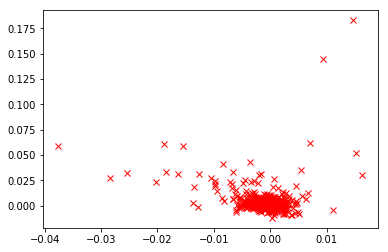

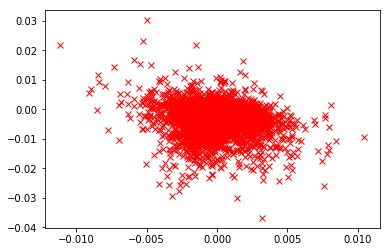

In [2]:
YourStudentID = 20032  


ratings = pd.read_csv("./ml-latest-small/ratings.csv")

indexes_unique_users = ratings['userId'].unique()
n_users = indexes_unique_users.shape[0]
nUsersInExample = n_users
np.random.seed(YourStudentID)
indexes_users = np.random.permutation(n_users)
my_batch_users = indexes_users[0:nUsersInExample]

list_movies_each_user = [[] for _ in range(nUsersInExample)]
list_ratings_each_user = [[] for _ in range(nUsersInExample)]

list_movies = ratings['movieId'][ratings['userId'] == my_batch_users[0]].values
list_movies_each_user[0] = list_movies                    

list_ratings = ratings['rating'][ratings['userId'] == my_batch_users[0]].values
list_ratings_each_user[0] = list_ratings

n_each_user = list_movies.shape[0]
list_users = my_batch_users[0]*np.ones((1, n_each_user))

for i in range(1, nUsersInExample):
    local_list_per_user_movies = ratings['movieId'][ratings['userId'] == my_batch_users[i]].values
    list_movies_each_user[i] = local_list_per_user_movies
    list_movies = np.append(list_movies,local_list_per_user_movies)
                                     
    local_list_per_user_ratings = ratings['rating'][ratings['userId'] == my_batch_users[i]].values
    list_ratings_each_user[i] = local_list_per_user_ratings
    list_ratings = np.append(list_ratings, local_list_per_user_ratings)  
    
    n_each_user = local_list_per_user_movies.shape[0]                                                                               
    local_rep_user =  my_batch_users[i]*np.ones((1, n_each_user))    
    list_users = np.append(list_users, local_rep_user)
indexes_unique_movies = np.unique(list_movies)
n_movies = indexes_unique_movies.shape[0]
p_list_ratings = np.concatenate(list_ratings_each_user).ravel()
p_list_ratings_original = p_list_ratings.tolist()
mean_ratings_train = np.mean(p_list_ratings)
p_list_ratings =  p_list_ratings - mean_ratings_train # remove the mean
p_list_movies = np.concatenate(list_movies_each_user).ravel().tolist()
p_list_users = list_users.tolist()
Y = pd.DataFrame({'users': p_list_users, 'movies': p_list_movies, 'ratingsorig': p_list_ratings_original,'ratings':p_list_ratings.tolist()})
# print(Y)

q = 2
learn_rate = 0.01
U = pd.DataFrame(np.random.normal(size=(nUsersInExample, q))*0.001, index=my_batch_users)
V = pd.DataFrame(np.random.normal(size=(n_movies, q))*0.001, index=indexes_unique_movies)
def stochastic_gradient(Y, U, V):
    gU = pd.DataFrame(np.zeros((U.shape)), index=U.index)
    gV = pd.DataFrame(np.zeros((V.shape)), index=V.index)
    obj = 0.
    nrows = Y.shape[0]
    import random as rd
    i = rd.randint(0,nrows-1)
    row = Y.iloc[i]
    user = row['users']
    film = row['movies']
    rating = row['ratings']
    prediction = np.dot(U.loc[user], V.loc[film]) # vTu
    diff = prediction - rating # vTu - y
    obj += diff*diff
    gU.loc[user] += 2*diff*V.loc[film]
    gV.loc[film] += 2*diff*U.loc[user]
    return obj, gU, gV
iterations = 400000
for i in range(iterations):
    obj, gU, gV = stochastic_gradient(Y, U, V)
    U -= learn_rate*gU
    V -= learn_rate*gV
    print('no.',i,'objective function = ',obj)
import pylab as plt
plt.plot(U[0],U[1],'rx')
plt.figure()
plt.plot(V[0],V[1],'rx')